# Creating the DNN Model for Genre Detection

## Importing the required files 

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn 
import librosa
import librosa.display
import tensorflow as tf
import keras as k
from sklearn.model_selection import train_test_split
import scipy.io as sio
import numpy as np
import seaborn as sns
from sklearn.svm import SVC
from sklearn import svm
from sklearn.metrics import accuracy_score 
from matplotlib.pyplot import figure
from sklearn import metrics
import sklearn.preprocessing as skp
from keras.models import Sequential
from keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, AveragePooling2D, Flatten
from sklearn.model_selection import GridSearchCV
from keras.wrappers.scikit_learn import KerasClassifier

### Importing the full dataset and Preprocessing

In [2]:
df = pd.read_csv('features_3_sec.csv')
df

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.0.wav,66149,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,blues.00000.1.wav,66149,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,blues.00000.2.wav,66149,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,blues.00000.3.wav,66149,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,blues.00000.4.wav,66149,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9985,rock.00099.5.wav,66149,0.349126,0.080515,0.050019,0.000097,1499.083005,164266.886443,1718.707215,85931.574523,...,42.485981,-9.094270,38.326839,-4.246976,31.049839,-5.625813,48.804092,1.818823,38.966969,rock
9986,rock.00099.6.wav,66149,0.372564,0.082626,0.057897,0.000088,1847.965128,281054.935973,1906.468492,99727.037054,...,32.415203,-12.375726,66.418587,-3.081278,54.414265,-11.960546,63.452255,0.428857,18.697033,rock
9987,rock.00099.7.wav,66149,0.347481,0.089019,0.052403,0.000701,1346.157659,662956.246325,1561.859087,138762.841945,...,78.228149,-2.524483,21.778994,4.809936,25.980829,1.775686,48.582378,-0.299545,41.586990,rock
9988,rock.00099.8.wav,66149,0.387527,0.084815,0.066430,0.000320,2084.515327,203891.039161,2018.366254,22860.992562,...,28.323744,-5.363541,17.209942,6.462601,21.442928,2.354765,24.843613,0.675824,12.787750,rock


In [3]:
# Dropping columns that are not required as features as they don't have any meaning
df.drop('filename', inplace=True, axis=1)
df.drop('length', inplace=True, axis=1)
df

,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,rolloff_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,3714.560359,1.080790e+06,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,blues
1,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,3869.682242,6.722448e+05,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,blues
2,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,3997.639160,7.907127e+05,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,blues
3,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,3568.300218,9.216524e+05,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,blues
4,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,3469.992864,6.102111e+05,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,blues
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9985,0.349126,0.080515,0.050019,0.000097,1499.083005,164266.886443,1718.707215,85931.574523,3015.559458,8.479527e+05,...,42.485981,-9.094270,38.326839,-4.246976,31.049839,-5.625813,48.804092,1.818823,38.966969,rock
9986,0.372564,0.082626,0.057897,0.000088,1847.965128,281054.935973,1906.468492,99727.037054,3746.694524,1.170890e+06,...,32.415203,-12.375726,66.418587,-3.081278,54.414265,-11.960546,63.452255,0.428857,18.697033,rock
9987,0.347481,0.089019,0.052403,0.000701,1346.157659,662956.246325,1561.859087,138762.841945,2442.362154,2.602871e+06,...,78.228149,-2.524483,21.778994,4.809936,25.980829,1.775686,48.582378,-0.299545,41.586990,rock
9988,0.387527,0.084815,0.066430,0.000320,2084.515327,203891.039161,2018.366254,22860.992562,4313.266226,4.968878e+05,...,28.323744,-5.363541,17.209942,6.462601,21.442928,2.354765,24.843613,0.675824,12.787750,rock


<AxesSubplot: title={'center': 'Number of audio files per Genre'}>

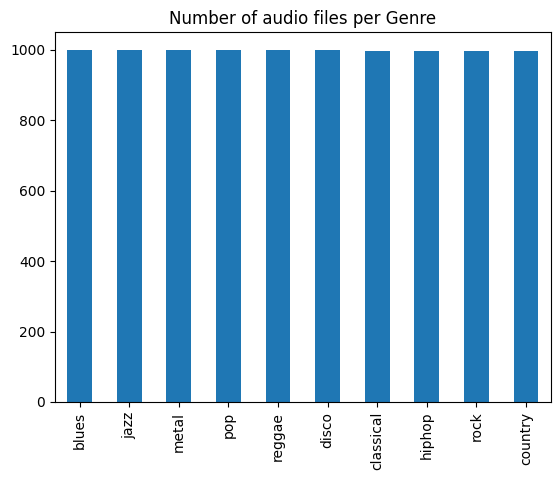

In [4]:
# As we can see from the data below, each genre has an equal number of audio files/data attached to them 
# Thus making this a fair dataset.
df.label.value_counts().plot(kind='bar', title='Number of audio files per Genre')

## Label Encoding and making all labels into integers

In [5]:
label_to_index = {}
index_to_label = {}

for i, j in enumerate(df.label.unique()):
    label_to_index[j] = i
    index_to_label[i] = j

print(label_to_index)
print(index_to_label)

{'blues': 0, 'classical': 1, 'country': 2, 'disco': 3, 'hiphop': 4, 'jazz': 5, 'metal': 6, 'pop': 7, 'reggae': 8, 'rock': 9}
{0: 'blues', 1: 'classical', 2: 'country', 3: 'disco', 4: 'hiphop', 5: 'jazz', 6: 'metal', 7: 'pop', 8: 'reggae', 9: 'rock'}


In [6]:
# Adding each label into the dataset
df.label = [label_to_index[genre] for genre in df.label]

In [7]:
df

,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,rolloff_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,0.335406,0.091048,0.130405,0.003521,1773.065032,167541.630869,1972.744388,117335.771563,3714.560359,1.080790e+06,...,39.687145,-3.241280,36.488243,0.722209,38.099152,-5.050335,33.618073,-0.243027,43.771767,0
1,0.343065,0.086147,0.112699,0.001450,1816.693777,90525.690866,2010.051501,65671.875673,3869.682242,6.722448e+05,...,64.748276,-6.055294,40.677654,0.159015,51.264091,-2.837699,97.030830,5.784063,59.943081,0
2,0.346815,0.092243,0.132003,0.004620,1788.539719,111407.437613,2084.565132,75124.921716,3997.639160,7.907127e+05,...,67.336563,-1.768610,28.348579,2.378768,45.717648,-1.938424,53.050835,2.517375,33.105122,0
3,0.363639,0.086856,0.132565,0.002448,1655.289045,111952.284517,1960.039988,82913.639269,3568.300218,9.216524e+05,...,47.739452,-3.841155,28.337118,1.218588,34.770935,-3.580352,50.836224,3.630866,32.023678,0
4,0.335579,0.088129,0.143289,0.001701,1630.656199,79667.267654,1948.503884,60204.020268,3469.992864,6.102111e+05,...,30.336359,0.664582,45.880913,1.689446,51.363583,-3.392489,26.738789,0.536961,29.146694,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9985,0.349126,0.080515,0.050019,0.000097,1499.083005,164266.886443,1718.707215,85931.574523,3015.559458,8.479527e+05,...,42.485981,-9.094270,38.326839,-4.246976,31.049839,-5.625813,48.804092,1.818823,38.966969,9
9986,0.372564,0.082626,0.057897,0.000088,1847.965128,281054.935973,1906.468492,99727.037054,3746.694524,1.170890e+06,...,32.415203,-12.375726,66.418587,-3.081278,54.414265,-11.960546,63.452255,0.428857,18.697033,9
9987,0.347481,0.089019,0.052403,0.000701,1346.157659,662956.246325,1561.859087,138762.841945,2442.362154,2.602871e+06,...,78.228149,-2.524483,21.778994,4.809936,25.980829,1.775686,48.582378,-0.299545,41.586990,9
9988,0.387527,0.084815,0.066430,0.000320,2084.515327,203891.039161,2018.366254,22860.992562,4313.266226,4.968878e+05,...,28.323744,-5.363541,17.209942,6.462601,21.442928,2.354765,24.843613,0.675824,12.787750,9


In [8]:
# Randomly scrambling the data to make sure the train and test data is split fairly
df_dataset = df.sample(frac=1, random_state=1).reset_index(drop=True)
df_dataset

,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,rolloff_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,0.284675,0.100246,0.009927,0.000078,2275.666793,969577.679226,2121.990241,254800.391140,4177.192946,3.951934e+06,...,59.118370,-1.944814,43.121861,2.117370,52.427326,4.168144,43.581429,-10.004635,131.701233,1
1,0.414633,0.076635,0.118032,0.000797,3522.864305,313174.979579,3218.378964,49770.801415,7656.710111,7.451452e+05,...,34.103886,1.529696,47.157738,4.970688,64.642006,0.123925,49.472679,-1.520239,40.111794,9
2,0.253989,0.085844,0.139711,0.001284,1521.659305,187431.229485,2183.633051,88817.592332,3472.891564,1.681458e+06,...,92.804733,-10.312564,92.778374,1.327478,42.726486,-6.202439,41.421989,-5.236426,40.903744,2
3,0.375855,0.080400,0.226780,0.000744,2834.643719,81348.733405,2745.581889,43777.587152,5855.209210,8.265256e+05,...,35.921860,1.721021,40.296246,6.365949,50.890144,1.305882,33.262905,3.345098,26.905224,2
4,0.511877,0.070281,0.128825,0.000488,2375.408395,165294.633580,2179.890641,42374.862596,4721.237605,7.426748e+05,...,22.472206,-10.162963,35.951519,6.471421,22.127131,-2.918051,30.525040,4.361710,21.490948,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9985,0.408131,0.078613,0.183322,0.001352,2028.819767,268629.092013,2114.735151,92542.183853,4221.336013,1.077585e+06,...,29.993439,-11.145785,45.687092,5.493725,21.938625,-5.292254,55.236206,2.256558,32.621216,2
9986,0.405972,0.096391,0.143587,0.000754,2745.937404,389402.726288,3315.159138,154812.732754,7159.210299,3.023859e+06,...,33.132038,2.303370,20.976559,-0.884379,27.286659,-3.395530,41.223114,-3.316266,37.532955,7
9987,0.401803,0.088678,0.131351,0.001733,2024.086609,818749.993571,2119.316715,95483.285406,4261.503718,2.023625e+06,...,59.575848,-12.571102,88.122185,-0.023062,64.975212,3.146915,67.956795,-6.088497,37.966015,0
9988,0.433048,0.097255,0.014672,0.000056,1107.920908,71756.851640,1818.704279,56107.316474,2769.335562,7.147145e+05,...,15.131432,2.908102,26.380617,3.528539,18.682434,2.144094,22.174486,2.244922,24.395102,5


In [9]:
# Diving data into X and Y dataset
df_y = df_dataset.pop('label')
df_x = df_dataset

In [10]:
print(df_y)
df_x

0       1
1       9
2       2
3       2
4       6
       ..
9985    2
9986    7
9987    0
9988    5
9989    0
Name: label, Length: 9990, dtype: int64


,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,rolloff_var,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
0,0.284675,0.100246,0.009927,0.000078,2275.666793,969577.679226,2121.990241,254800.391140,4177.192946,3.951934e+06,...,-3.701673,59.118370,-1.944814,43.121861,2.117370,52.427326,4.168144,43.581429,-10.004635,131.701233
1,0.414633,0.076635,0.118032,0.000797,3522.864305,313174.979579,3218.378964,49770.801415,7656.710111,7.451452e+05,...,5.989784,34.103886,1.529696,47.157738,4.970688,64.642006,0.123925,49.472679,-1.520239,40.111794
2,0.253989,0.085844,0.139711,0.001284,1521.659305,187431.229485,2183.633051,88817.592332,3472.891564,1.681458e+06,...,4.144322,92.804733,-10.312564,92.778374,1.327478,42.726486,-6.202439,41.421989,-5.236426,40.903744
3,0.375855,0.080400,0.226780,0.000744,2834.643719,81348.733405,2745.581889,43777.587152,5855.209210,8.265256e+05,...,6.641064,35.921860,1.721021,40.296246,6.365949,50.890144,1.305882,33.262905,3.345098,26.905224
4,0.511877,0.070281,0.128825,0.000488,2375.408395,165294.633580,2179.890641,42374.862596,4721.237605,7.426748e+05,...,4.394495,22.472206,-10.162963,35.951519,6.471421,22.127131,-2.918051,30.525040,4.361710,21.490948
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9985,0.408131,0.078613,0.183322,0.001352,2028.819767,268629.092013,2114.735151,92542.183853,4221.336013,1.077585e+06,...,6.580052,29.993439,-11.145785,45.687092,5.493725,21.938625,-5.292254,55.236206,2.256558,32.621216
9986,0.405972,0.096391,0.143587,0.000754,2745.937404,389402.726288,3315.159138,154812.732754,7159.210299,3.023859e+06,...,1.188045,33.132038,2.303370,20.976559,-0.884379,27.286659,-3.395530,41.223114,-3.316266,37.532955
9987,0.401803,0.088678,0.131351,0.001733,2024.086609,818749.993571,2119.316715,95483.285406,4261.503718,2.023625e+06,...,8.204830,59.575848,-12.571102,88.122185,-0.023062,64.975212,3.146915,67.956795,-6.088497,37.966015
9988,0.433048,0.097255,0.014672,0.000056,1107.920908,71756.851640,1818.704279,56107.316474,2769.335562,7.147145e+05,...,0.621950,15.131432,2.908102,26.380617,3.528539,18.682434,2.144094,22.174486,2.244922,24.395102


## Splitting the data in Training, Validation and Testing set

In [11]:
# Training Set = 80% of Original
# Validation + Test = 20% of Original
# - Validation = 66% / 13.2% of the Original
# - Test = 33% / 6.8% of the Original

# Train and Test dataset
X_train, X_init_test, y_train, y_init_test = train_test_split(df_x, df_y, test_size=0.2, random_state=42, stratify=df_y)

# Dev set 
X_val, X_test, y_val, y_test = train_test_split(X_init_test, y_init_test, test_size = 0.33, random_state=42, stratify=y_init_test)





### Normalizing the X_data

In [12]:
normalizer = skp.StandardScaler()
X_train = pd.DataFrame(normalizer.fit_transform(X_train), columns=X_train.columns)
X_val = pd.DataFrame(normalizer.fit_transform(X_val), columns=X_val.columns)
X_test = pd.DataFrame(normalizer.fit_transform(X_test), columns=X_test.columns)

In [13]:
def plotData(model_fit):
    """
    Creates the plot containing the differnt losses during the fitting of the model
    
    """
    print("Final Validation:",max(model_fit.history["val_accuracy"]))
    pd.DataFrame(model_fit.history).plot(figsize=(12,6))
    plt.show()

In [14]:
def create_model(hidden_layers, neuron_array, dropout_rate):
    """
    Creates a Sequential keras model that can create n hidden layers with the given neurons from the array,
    with the given dropout rate.
    
    """
    
    
    model = k.models.Sequential()
    
    model.add(k.layers.Dense(neuron_array[0], activation='relu', input_shape=(57,)))
    model.add(k.layers.Dropout(rate=dropout_rate))
    for i in range(hidden_layers):
        model.add(k.layers.Dense(neuron_array[i+1], activation='relu'))
        model.add(k.layers.Dropout(rate=dropout_rate))
    
    model.add(k.layers.Dense(10, activation='softmax'))
    
    model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

              
    return model

## Creating a model without searching for best parameters

In [15]:
dnn_original = create_model(2, [256, 128, 64], 0.1)
dnn_original.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               14848     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 128)               32896     
                                                                 
 dropout_1 (Dropout)         (None, 128)               0         
                                                                 
 dense_2 (Dense)             (None, 64)                8256      
                                                                 
 dropout_2 (Dropout)         (None, 64)                0         
                                                                 
 dense_3 (Dense)             (None, 10)                6

In [16]:
dnn_original_fit = dnn_original.fit(X_train, y_train, epochs=100, batch_size=16)

Epoch 1/100


2022-12-16 02:44:18.777888: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


500/500 [==============================] - 1s 1ms/step - loss: 1.2041 - accuracy: 0.5791 - val_loss: 0.8220 - val_accuracy: 0.7182
Epoch 2/100
500/500 [==============================] - 0s 900us/step - loss: 0.7993 - accuracy: 0.7231 - val_loss: 0.6408 - val_accuracy: 0.7825
Epoch 3/100
500/500 [==============================] - 0s 878us/step - loss: 0.6343 - accuracy: 0.7808 - val_loss: 0.6163 - val_accuracy: 0.7885
Epoch 4/100
500/500 [==============================] - 0s 871us/step - loss: 0.5474 - accuracy: 0.8114 - val_loss: 0.4864 - val_accuracy: 0.8386
Epoch 5/100
500/500 [==============================] - 0s 869us/step - loss: 0.4661 - accuracy: 0.8397 - val_loss: 0.5108 - val_accuracy: 0.8318
Epoch 6/100
500/500 [==============================] - 0s 895us/step - loss: 0.4122 - accuracy: 0.8569 - val_loss: 0.4524 - val_accuracy: 0.8445
Epoch 7/100
500/500 [==============================] - 0s 856us/step - loss: 0.3451 - accuracy: 0.8791 - val_loss: 0.4013 - val_accuracy: 0.8610

In [17]:
test_loss, test_acc = dnn_original.evaluate(X_test, y_test, batch_size=128)
print("Original DNN Test Loss:", test_loss)
print("Original DNN Test acc:", test_acc)

6/6 [==============================] - 0s 711us/step - loss: 0.4924 - accuracy: 0.9197
Original DNN Test Loss: 0.4923982620239258
Original DNN Test acc: 0.9196969866752625


Final Validation: 0.9312406778335571


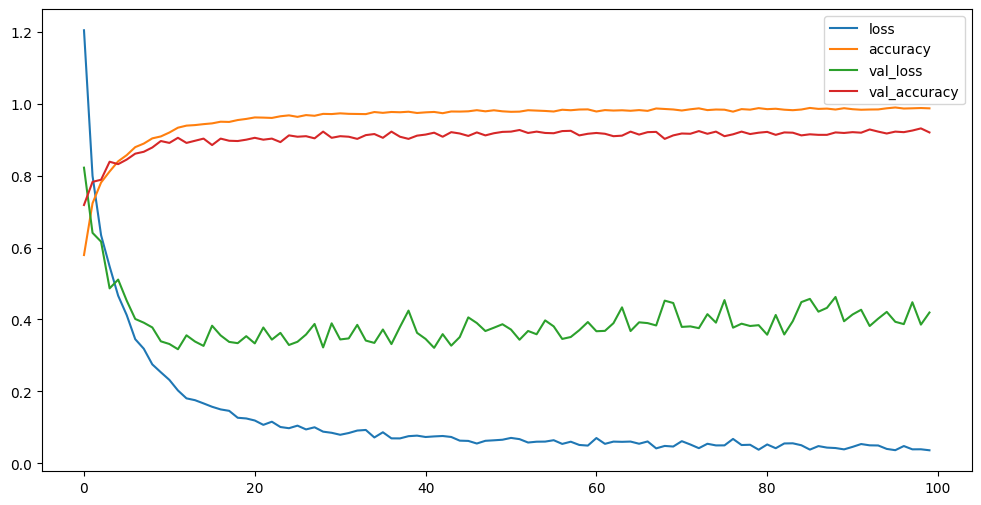

In [18]:
# Plotting results
plotData(dnn_original_fit)

## Using Grid Search to find the parameters

In [19]:
model = KerasClassifier(build_fn=create_model, verbose=1)
# define parameters and values for grid search 
param_grid = {
    'batch_size': [16, 32, 64],
    'epochs': [10, 100, 1000],
    'dropout_rate': [0.0, 0.10, 0.20],
    'hidden_layers': [1, 2],
    'neuron_array': [[256, 128, 64], [128, 64]]
}

/var/folders/pr/rx1rrffd36q4ys1d_2dbyssr0000gn/T/ipykernel_25605/3519077635.py:1: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = KerasClassifier(build_fn=create_model, verbose=1)


In [20]:
grid = GridSearchCV(estimator=model, param_grid=param_grid, n_jobs=-1, cv=10)
grid_result = grid.fit(X_train, y_train)  # fit the full dataset as we are using cross validation 

2022-12-16 02:45:06.203290: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-12-16 02:45:06.204971: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-12-16 02:45:06.206687: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-12-16 02:45:06.219936: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-12-16 02:45:06.223563: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-12-16 02:45:06.229606: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-12-16 02:45:06.237792: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-12-16 02:45:06.290042: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-12-16 02:45:06.310434: W te

Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/100
Epoch 1/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0408 - accuracy: 0.6459
Epoch 2/100
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0505 - accuracy: 0.6413
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0704 - accuracy: 0.6321
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0667 - accuracy: 0.6341
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0746 - accuracy: 0.6263
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0431 - accuracy: 0.6420
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0647 - accuracy: 0.6310
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0569 - accuracy: 0.6276
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0553 - accuracy: 0.9836
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9949
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0521 - accuracy: 0.9842
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9949
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0807 - accuracy: 0.9741
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0740 - accuracy: 0.9748
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9904
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0596 - accuracy: 0.9840
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9930
Epoch 17/100
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0463

450/450 [==============================] - 1s 2ms/step - loss: 0.0124 - accuracy: 0.9969
Epoch 24/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0111 - accuracy: 0.9981
Epoch 24/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1380 - accuracy: 0.9569
Epoch 24/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9964
Epoch 24/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0412 - accuracy: 0.9883
Epoch 24/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9936
Epoch 25/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9981
Epoch 25/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0799 - accuracy: 0.9758
Epoch 25/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9958
Epoch 25/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0067 - accuracy: 0.9985
Epoch 32/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9882
Epoch 32/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0084 - accuracy: 0.9979
Epoch 32/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9962
Epoch 32/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0082 - accuracy: 0.9978
Epoch 32/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0066 - accuracy: 0.9985
Epoch 33/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9922
Epoch 33/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0091 - accuracy: 0.9974
Epoch 33/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0991 - accuracy: 0.9691
Epoch 33/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0103 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0043 - accuracy: 0.9992
Epoch 47/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0103 - accuracy: 0.9964
Epoch 47/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0060 - accuracy: 0.9982
Epoch 47/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9986
Epoch 48/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9961
Epoch 48/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9946
Epoch 48/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0065 - accuracy: 0.9981
Epoch 48/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9983
Epoch 48/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0057 - accuracy: 0.9989
Epoch 47/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0041 - accuracy: 0.9982
Epoch 62/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9986
Epoch 62/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0045 - accuracy: 0.9987
Epoch 62/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9987
Epoch 62/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1170 - accuracy: 0.9680
Epoch 63/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9892
Epoch 62/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0039 - accuracy: 0.9990
Epoch 61/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9929
Epoch 63/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9992
Epoch 63/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0079 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0038 - accuracy: 0.9985
Epoch 70/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0628 - accuracy: 0.9822
Epoch 68/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9986
Epoch 70/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9932
Epoch 70/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9897
Epoch 70/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0083 - accuracy: 0.9979
Epoch 70/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1140 - accuracy: 0.9714
Epoch 71/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0659 - accuracy: 0.9807
Epoch 70/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9990
Epoch 71/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9983
Epoch 78/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9986
Epoch 77/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9990
Epoch 78/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0068 - accuracy: 0.9974
Epoch 78/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 78/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0078 - accuracy: 0.9969
Epoch 76/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9947
Epoch 78/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9950
Epoch 78/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0925 - accuracy: 0.9729
Epoch 78/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0818 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 85/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0112 - accuracy: 0.9962
Epoch 85/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 85/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0137 - accuracy: 0.9939
Epoch 83/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 85/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9990
Epoch 86/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 85/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9957
Epoch 86/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0074 - accuracy: 0.9978
Epoch 86/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 93/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 90/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0037 - accuracy: 0.9987
Epoch 92/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0339 - accuracy: 0.9914
Epoch 93/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0971 - accuracy: 0.9743
Epoch 93/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0517 - accuracy: 0.9830
Epoch 93/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 93/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1088 - accuracy: 0.9744
Epoch 93/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 93/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9985
Epoch 100/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9993
Epoch 100/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 100/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0509 - accuracy: 0.9878
Epoch 98/100
50/50 [==============================] - 0s 1ms/step - loss: 0.6395 - accuracy: 0.9024
Epoch 1/100
450/450 [==============================] - 1s 1ms/step - loss: 0.0430 - accuracy: 0.9876
Epoch 99/100
450/450 [==============================] - 1s 959us/step - loss: 1.1963 - accuracy: 0.5827
Epoch 2/100
450/450 [==============================] - 1s 1ms/step - loss: 1.1916 - accuracy: 0.5866
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0128 - accuracy: 0.9958
Epoch 100/100
450/450 [==============================] - 1s 2ms/step - loss: 1.2116 - accuracy:

450/450 [==============================] - 1s 2ms/step - loss: 0.4253 - accuracy: 0.8576
Epoch 6/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3689 - accuracy: 0.8754
Epoch 7/100
450/450 [==============================] - 1s 2ms/step - loss: 0.7464 - accuracy: 0.7474
Epoch 3/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4110 - accuracy: 0.8631
Epoch 6/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4360 - accuracy: 0.8526
Epoch 6/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3784 - accuracy: 0.8738
Epoch 7/100
450/450 [==============================] - 1s 1ms/step - loss: 0.2799 - accuracy: 0.9107
Epoch 9/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3771 - accuracy: 0.8757
Epoch 7/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3670 - accuracy: 0.8822
Epoch 7/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3668 - accuracy: 0.8757
Ep

450/450 [==============================] - 1s 1ms/step - loss: 0.0380 - accuracy: 0.9911
Epoch 26/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0524 - accuracy: 0.9867
Epoch 21/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0956 - accuracy: 0.9726
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0718 - accuracy: 0.9791
Epoch 21/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0653 - accuracy: 0.9803
Epoch 21/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0694 - accuracy: 0.9800
Epoch 20/100
450/450 [==============================] - 1s 1ms/step - loss: 0.0297 - accuracy: 0.9939
Epoch 27/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0518 - accuracy: 0.9889
Epoch 21/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0689 - accuracy: 0.9800
Epoch 21/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0547 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9978
Epoch 35/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0100 - accuracy: 0.9979
Epoch 35/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9971
Epoch 35/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0106 - accuracy: 0.9982
Epoch 35/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0454 - accuracy: 0.9862
Epoch 36/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9942
Epoch 35/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9968
Epoch 36/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0303 - accuracy: 0.9896
Epoch 36/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0070 - accuracy: 0.9990
Epoch 36/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0090 - accuracy: 0.9979
Epoch 42/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9926
Epoch 42/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0103 - accuracy: 0.9969
Epoch 42/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1073 - accuracy: 0.9657
Epoch 43/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0061 - accuracy: 0.9989
Epoch 42/100
450/450 [==============================] - 1s 1ms/step - loss: 0.0069 - accuracy: 0.9978
Epoch 54/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9935
Epoch 43/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0105 - accuracy: 0.9975
Epoch 43/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9944
Epoch 42/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0175 - accuracy: 0.9940
Epoch 50/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9956
Epoch 50/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0150 - accuracy: 0.9960
Epoch 49/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0066 - accuracy: 0.9989
Epoch 50/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0050 - accuracy: 0.9990
Epoch 50/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0923 - accuracy: 0.9725
Epoch 50/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0088 - accuracy: 0.9979
Epoch 46/100
450/450 [==============================] - 1s 1ms/step - loss: 0.0432 - accuracy: 0.9864
Epoch 64/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9932
Epoch 50/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0072 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0062 - accuracy: 0.9987
Epoch 64/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0078 - accuracy: 0.9983
Epoch 64/100
450/450 [==============================] - 1s 1ms/step - loss: 0.0620 - accuracy: 0.9822
Epoch 82/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9897
Epoch 64/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9961
Epoch 65/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9940
Epoch 65/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0894 - accuracy: 0.9726
Epoch 60/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0650 - accuracy: 0.9815
Epoch 65/100
450/450 [==============================] - 1s 1ms/step - loss: 0.0165 - accuracy: 0.9944
Epoch 83/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0715 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0086 - accuracy: 0.9976
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0902 - accuracy: 0.9743
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0072 - accuracy: 0.9982
Epoch 67/100
450/450 [==============================] - 1s 1ms/step - loss: 0.0114 - accuracy: 0.9967
Epoch 92/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0067 - accuracy: 0.9987
Epoch 71/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0086 - accuracy: 0.9974
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0682 - accuracy: 0.9808
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0071 - accuracy: 0.9982
Epoch 73/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0053 - accuracy: 0.9985
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0120 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0250 - accuracy: 0.9918
Epoch 79/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0712 - accuracy: 0.9782
Epoch 79/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0047 - accuracy: 0.9987
Epoch 78/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0070 - accuracy: 0.9978
Epoch 74/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0054 - accuracy: 0.9981
Epoch 79/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0770 - accuracy: 0.9766
Epoch 79/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9880
Epoch 79/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0051 - accuracy: 0.9986
Epoch 80/100
450/450 [==============================] - 1s 1ms/step - loss: 0.0059 - accuracy: 0.9983
Epoch 80/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0080 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0079 - accuracy: 0.9979
Epoch 81/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9939
Epoch 87/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0175 - accuracy: 0.9946
Epoch 86/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9869
Epoch 87/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1739 - accuracy: 0.9433
Epoch 8/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0041 - accuracy: 0.9986
Epoch 87/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0779 - accuracy: 0.9765
Epoch 87/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9990
Epoch 88/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0098 - accuracy: 0.9969
Epoch 87/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0069 - accuracy: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0047 - accuracy: 0.9986
Epoch 93/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0039 - accuracy: 0.9989
Epoch 94/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0116 - accuracy: 0.9965
Epoch 94/100
Epoch 94/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9993
Epoch 95/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 95/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0070 - accuracy: 0.9974
Epoch 94/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0836 - accuracy: 0.9728
Epoch 95/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0886 - accuracy: 0.9694
Epoch 15/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9986
Epoch 94/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0037

450/450 [==============================] - 1s 1ms/step - loss: 0.0263 - accuracy: 0.9918
Epoch 96/100
50/50 [==============================] - 0s 2ms/step - loss: 0.8873 - accuracy: 0.8686
Epoch 1/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9935
Epoch 22/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0770 - accuracy: 0.6194
Epoch 2/100
450/450 [==============================] - 1s 1ms/step - loss: 0.0103 - accuracy: 0.9962
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0850 - accuracy: 0.6263
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0604 - accuracy: 0.6351
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0980 - accuracy: 0.6142
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0980 - accuracy: 0.6210
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 1.0732 - accuracy: 0.6238
E

450/450 [==============================] - 1s 2ms/step - loss: 0.1756 - accuracy: 0.9430
Epoch 8/100
450/450 [==============================] - 1s 2ms/step - loss: 0.6526 - accuracy: 0.7777
Epoch 3/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1767 - accuracy: 0.9424
Epoch 8/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1294 - accuracy: 0.9561
Epoch 9/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2176 - accuracy: 0.9284
Epoch 7/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1372 - accuracy: 0.9523
Epoch 9/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1721 - accuracy: 0.9445
Epoch 8/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1509 - accuracy: 0.9495
Epoch 9/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1290 - accuracy: 0.9593
Epoch 9/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9958
Ep

450/450 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9930
Epoch 47/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0615 - accuracy: 0.9821
Epoch 23/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0351 - accuracy: 0.9890
Epoch 23/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9867
Epoch 24/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0400 - accuracy: 0.9875
Epoch 23/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9905
Epoch 22/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9857
Epoch 18/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9926
Epoch 48/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9879
Epoch 24/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0605 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.1245 - accuracy: 0.9640
Epoch 37/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0870 - accuracy: 0.9728
Epoch 37/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9930
Epoch 36/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9894
Epoch 37/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9951
Epoch 38/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0128 - accuracy: 0.9958
Epoch 38/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9946
Epoch 32/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0165 - accuracy: 0.9950
Epoch 65/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9917
Epoch 38/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0380 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9925
Epoch 45/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9946
Epoch 39/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9910
Epoch 46/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0804 - accuracy: 0.9776
Epoch 45/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0260 - accuracy: 0.9921
Epoch 45/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9918
Epoch 74/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1044 - accuracy: 0.9696
Epoch 44/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0128 - accuracy: 0.9958
Epoch 45/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9928
Epoch 46/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9857
Epoch 58/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9943
Epoch 59/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0087 - accuracy: 0.9975
Epoch 60/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0105 - accuracy: 0.9964
Epoch 60/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0082 - accuracy: 0.9975
Epoch 61/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0616 - accuracy: 0.9853
Epoch 92/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 60/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0185 - accuracy: 0.9943
Epoch 60/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9957
Epoch 54/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0115 - accuracy: 0.9965
Epoch 68/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1425 - accuracy: 0.9682
Epoch 100/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9946
Epoch 67/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0605 - accuracy: 0.9851
Epoch 66/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9907
Epoch 67/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1016 - accuracy: 0.9676
Epoch 61/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9944
Epoch 67/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 68/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9989
Epoch 69/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy:

450/450 [==============================] - 1s 2ms/step - loss: 0.0091 - accuracy: 0.9962
Epoch 74/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1552 - accuracy: 0.9536
Epoch 74/100
Epoch 9/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 74/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0445 - accuracy: 0.9878
Epoch 68/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9986
Epoch 75/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0122 - accuracy: 0.9960
Epoch 75/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0088 - accuracy: 0.9976
Epoch 74/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9925
Epoch 76/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9939
Epoch 75/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1311

450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 81/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0962 - accuracy: 0.9691
Epoch 18/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0902 - accuracy: 0.9765
Epoch 80/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0072 - accuracy: 0.9979
Epoch 81/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0088 - accuracy: 0.9975
Epoch 82/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9899
Epoch 75/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9912
Epoch 81/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0083 - accuracy: 0.9978
Epoch 83/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0630 - accuracy: 0.9823
Epoch 82/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0746 - accuracy:

450/450 [==============================] - 1s 3ms/step - loss: 0.0901 - accuracy: 0.9750
Epoch 88/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9869
Epoch 90/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0539 - accuracy: 0.9846
Epoch 28/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0557 - accuracy: 0.9853
Epoch 82/100
450/450 [==============================] - 1s 3ms/step - loss: 0.0018 - accuracy: 0.9993
Epoch 89/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0076 - accuracy: 0.9967
Epoch 89/100
450/450 [==============================] - 1s 3ms/step - loss: 0.0028 - accuracy: 0.9986
Epoch 89/100
450/450 [==============================] - 1s 3ms/step - loss: 0.0172 - accuracy: 0.9962
Epoch 88/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9987
Epoch 90/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0557 - accuracy:

450/450 [==============================] - 1s 2ms/step - loss: 0.0048 - accuracy: 0.9982
Epoch 96/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0093 - accuracy: 0.9962
Epoch 95/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0097 - accuracy: 0.9965
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0166 - accuracy: 0.9954
Epoch 39/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0086 - accuracy: 0.9975
Epoch 98/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 96/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0982 - accuracy: 0.9737
Epoch 90/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9985
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy:

450/450 [==============================] - 1s 2ms/step - loss: 1.0444 - accuracy: 0.6334
Epoch 2/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1288 - accuracy: 0.9591
Epoch 10/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2017 - accuracy: 0.9359
Epoch 8/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1605 - accuracy: 0.9491
Epoch 9/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9986
Epoch 56/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1202 - accuracy: 0.9640
Epoch 10/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1009 - accuracy: 0.9715
Epoch 11/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0987 - accuracy: 0.9687
Epoch 12/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0054 - accuracy: 0.9981
Epoch 57/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6490 - accu

450/450 [==============================] - 1s 2ms/step - loss: 0.0376 - accuracy: 0.9904
Epoch 17/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9922
Epoch 18/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9886
Epoch 18/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0525 - accuracy: 0.9854
Epoch 18/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9914
Epoch 65/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0669 - accuracy: 0.9801
Epoch 18/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0619 - accuracy: 0.9798
Epoch 16/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0517 - accuracy: 0.9857
Epoch 17/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1301 - accuracy: 0.9602
Epoch 10/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0319 - a

450/450 [==============================] - 1s 2ms/step - loss: 0.1211 - accuracy: 0.9615
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0081 - accuracy: 0.9981
Epoch 30/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9886
Epoch 24/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0058 - accuracy: 0.9987
Epoch 32/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0057 - accuracy: 0.9989
Epoch 33/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0111 - accuracy: 0.9965
Epoch 34/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0076 - accuracy: 0.9976
Epoch 33/1000
Epoch 33/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9944
Epoch 32/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 83/1000
450/450 [==============================] - 1s 2ms/step - lo

450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 90/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0281 - accuracy: 0.9910
Epoch 38/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9962
Epoch 37/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0053 - accuracy: 0.9982
Epoch 40/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9924
Epoch 39/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0530 - accuracy: 0.9862
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0044 - accuracy: 0.9987
Epoch 41/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0054 - accuracy: 0.9983
Epoch 40/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 91/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0164 - a

450/450 [==============================] - 1s 2ms/step - loss: 0.0087 - accuracy: 0.9981
Epoch 55/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 107/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 0.9981
Epoch 45/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0090 - accuracy: 0.9974
Epoch 54/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0051 - accuracy: 0.9982
Epoch 54/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9985
Epoch 55/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0049 - accuracy: 0.9985
Epoch 53/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9958
Epoch 54/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0050 - accuracy: 0.9985
Epoch 52/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0039 - 

450/450 [==============================] - 1s 1ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 116/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9950
Epoch 60/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9990
Epoch 61/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0128 - accuracy: 0.9956
Epoch 61/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0066 - accuracy: 0.9976
Epoch 62/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9987
Epoch 63/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 0.9953
Epoch 61/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9922
Epoch 62/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9940
Epoch 53/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0789 - accuracy: 0.9782
Epoch 69/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9989
Epoch 60/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9993
Epoch 69/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0108 - accuracy: 0.9968
Epoch 69/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9986
Epoch 71/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0058 - accuracy: 0.9976
Epoch 67/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0039 - accuracy: 0.9983
Epoch 70/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0102 - accuracy: 0.9968
Epoch 69/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0567 - accuracy: 0.9815
Epoch 70/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - a

450/450 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9962
Epoch 76/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9983
Epoch 67/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9924
Epoch 74/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9956
Epoch 76/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 0.9976
Epoch 75/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 78/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 76/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 77/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0054 - accuracy: 0.9983
Epoch 77/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0065 - a

450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9908
Epoch 83/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0919 - accuracy: 0.9773
Epoch 84/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 74/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9893
Epoch 82/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0784 - accuracy: 0.9810
Epoch 81/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9905
Epoch 85/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9924
Epoch 83/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0610 - accuracy: 0.9840
Epoch 142/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9987
Epoch 83/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 90/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 150/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 81/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9989
Epoch 91/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9946
Epoch 90/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9962
Epoch 91/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9979
Epoch 92/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9992
Epoch 93/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 89/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0979 - accuracy: 0.9746
Epoch 98/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 100/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9982
Epoch 99/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 97/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0039 - accuracy: 0.9979
Epoch 98/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0041 - accuracy: 0.9987
Epoch 89/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1442 - accuracy: 0.9668
Epoch 99/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 160/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 101/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 

450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9996
Epoch 105/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0092 - accuracy: 0.9958
Epoch 106/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 104/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 168/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 106/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9985
Epoch 96/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 105/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9986
Epoch 108/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 106/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9946
Epoch 111/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0063 - accuracy: 0.9971
Epoch 110/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 112/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0048 - accuracy: 0.9976
Epoch 176/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 113/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9908
Epoch 115/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 112/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0862 - accuracy: 0.9787
Epoch 103/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9990
Epoch 113/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

Epoch 126/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 128/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9946
Epoch 127/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0070 - accuracy: 0.9979
Epoch 117/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 193/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1086 - accuracy: 0.9743
Epoch 127/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 125/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 126/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9958
Epoch 128/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 130/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 1ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 210/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0069 - accuracy: 0.9981
Epoch 139/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0095 - accuracy: 0.9962
Epoch 141/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0068 - accuracy: 0.9975
Epoch 140/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 142/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0864 - accuracy: 0.9812
Epoch 142/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9985
Epoch 141/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 211/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 145/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0109 - accuracy: 0.9967
Epoch 154/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 158/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9996
Epoch 153/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 154/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0166 - accuracy: 0.9940
Epoch 145/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9986
Epoch 156/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0791 - accuracy: 0.9793
Epoch 157/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 155/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9933
Epoch 158/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9990
Epoch 168/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 172/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9985
Epoch 167/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 243/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 169/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0967 - accuracy: 0.9800
Epoch 170/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0083 - accuracy: 0.9972
Epoch 168/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9982
Epoch 171/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 175/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9994
Epoch 177/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0072 - accuracy: 0.9976
Epoch 174/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 175/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0959 - accuracy: 0.9797
Epoch 178/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9990
Epoch 177/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0047 - accuracy: 0.9976
Epoch 180/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 166/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0096 - accuracy: 0.9965
Epoch 177/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 192/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9993
Epoch 189/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 194/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0115 - accuracy: 0.9956
Epoch 191/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 180/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0889 - accuracy: 0.9811
Epoch 190/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0870 - accuracy: 0.9800
Epoch 191/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9901
Epoch 192/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9975
Epoch 189/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 198/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1019 - accuracy: 0.9784
Epoch 201/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 197/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0117 - accuracy: 0.9957
Epoch 187/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 277/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 196/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 198/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 199/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0103 - accuracy: 0.9971
Epoch 200/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9925
Epoch 205/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 206/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 203/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 204/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0055 - accuracy: 0.9981
Epoch 206/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0086 - accuracy: 0.9967
Epoch 286/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 205/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 209/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 195/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0081 - accuracy: 0.9971
Epoch 294/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 213/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.5882e-04 - accuracy: 0.9997
Epoch 212/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9986
Epoch 202/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 213/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0973 - accuracy: 0.9801
Epoch 214/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0100 - accuracy: 0.9960
Epoch 215/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0068 - accuracy: 0.9974
Epoch 211/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9930
Epoch 212/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 222/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9965
Epoch 220/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9967
Epoch 221/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0658 - accuracy: 0.9855
Epoch 209/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 218/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 303/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 219/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 221/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 220/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0101 - accuracy: 0.9967
Epoch 225/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0488 - accuracy: 0.9937
Epoch 311/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0078 - accuracy: 0.9978
Epoch 231/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 228/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0045 - accuracy: 0.9982
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 229/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9981
Epoch 228/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9957
Epoch 312/1000
Epoch 226/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 217/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 241/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 245/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9982
Epoch 240/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 230/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0108 - accuracy: 0.9978
Epoch 241/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 244/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 242/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 243/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 242/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 248/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 246/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 252/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9958
Epoch 237/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9961
Epoch 247/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0046 - accuracy: 0.9981
Epoch 336/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0081 - accuracy: 0.9965
Epoch 251/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9915
Epoch 248/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0870 - accuracy: 0.9830
Epoch 250/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9992
Epoch 244/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 258/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 255/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 254/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 257/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 256/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 260/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9961
Epoch 256/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9953
Epoch 254/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0090 - accuracy: 0.9969
Epoch 264/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0108 - accuracy: 0.9971
Epoch 352/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0750 - accuracy: 0.9861
Epoch 262/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 267/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 263/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9981
Epoch 263/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 261/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0038 - accuracy: 0.9985
Epoch 252/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9986
Epoch 266/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0084 - accuracy: 0.9974
Epoch 268/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 361/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 273/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0091 - accuracy: 0.9960
Epoch 259/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 269/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 272/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 270/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9982
Epoch 271/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9924
Epoch 271/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0085 - accuracy: 0.9972
Epoch 276/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 282/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9954
Epoch 279/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 266/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0095 - accuracy: 0.9976
Epoch 276/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 281/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9985
Epoch 370/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0037 - accuracy: 0.9979
Epoch 277/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 283/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 282/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 377/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 283/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 286/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 289/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 285/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0166 - accuracy: 0.9961
Epoch 284/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0937 - accuracy: 0.9836
Epoch 273/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 285/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 299/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0049 - accuracy: 0.9975
Epoch 302/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 394/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1032 - accuracy: 0.9829
Epoch 287/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 297/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9957
Epoch 298/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 301/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 304/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0049 - accuracy: 0.9983
Epoch 300/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0513 - accuracy: 0.9918
Epoch 305/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0848 - accuracy: 0.9840
Epoch 306/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 402/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 294/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0083 - accuracy: 0.9979
Epoch 304/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 308/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 305/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 311/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 310/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0184 - accuracy: 0.9957
Epoch 301/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9986
Epoch 312/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0055 - accuracy: 0.9978
Epoch 315/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 318/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 411/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 317/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.4370e-04 - accuracy: 0.9993
Epoch 314/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 314/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 313/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 428/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0108 - accuracy: 0.9969
Epoch 326/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0092 - accuracy: 0.9969
Epoch 316/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0043 - accuracy: 0.9983
Epoch 330/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 333/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 332/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 329/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 328/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 323/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9985
Epoch 340/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0047 - accuracy: 0.9976
Epoch 339/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0920 - accuracy: 0.9858
Epoch 336/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9978
Epoch 336/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0924 - accuracy: 0.9843
Epoch 335/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0049 - accuracy: 0.9976
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0075 - accuracy: 0.9979
Epoch 334/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0051 - accuracy: 0.9976
Epoch 338/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9986
Epoch 349/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 355/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0143 - accuracy: 0.9957
Epoch 354/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 454/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 338/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1292 - accuracy: 0.9816
Epoch 351/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 351/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 350/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 353/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0110 - accuracy: 0.9971
Epoch 364/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 363/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 367/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9907
Epoch 369/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 370/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0128 - accuracy: 0.9969
Epoch 471/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 353/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 366/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0081 - accuracy: 0.9974
Epoch 365/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 378/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0055 - accuracy: 0.9981
Epoch 384/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9907
Epoch 383/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 378/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9954
Epoch 367/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.6781e-04 - accuracy: 0.9993
Epoch 380/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 488/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 382/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0051 - accuracy: 0.9983
Epoch 385/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9982
Epoch 496/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0102 - accuracy: 0.9969
Epoch 385/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 387/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 374/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 389/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0592 - accuracy: 0.9886
Epoch 387/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 391/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0450 - accuracy: 0.9914
Epoch 386/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 497/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9953
Epoch 403/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 401/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0695 - accuracy: 0.9883
Epoch 406/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 405/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0198 - accuracy: 0.9958
Epoch 513/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 399/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 400/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 402/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0065 - accuracy: 0.9983
Epoch 404/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0055 - accuracy: 0.9976
Epoch 419/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 413/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9979
Epoch 402/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 421/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 414/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0705 - accuracy: 0.9903
Epoch 530/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9943
Epoch 416/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9958
Epoch 416/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9951
Epoch 418/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 425/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 421/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9974
Epoch 423/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 423/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 422/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 421/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 539/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9989
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 426/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0105 - accuracy: 0.9964
Epoch 430/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 430/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9976
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0057 - accuracy: 0.9971
Epoch 434/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 547/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 428/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 436/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9969
Epoch 433/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 417/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0782 - accuracy: 0.9890
Epoch 435/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 443/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0274 - accuracy: 0.9944
Epoch 556/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 440/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0089 - accuracy: 0.9979
Epoch 424/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 436/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 438/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0062 - accuracy: 0.9979
Epoch 438/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 442/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 447/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0044 - accuracy: 0.9979
Epoch 431/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.5376e-04 - accuracy: 0.9993
Epoch 445/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0490 - accuracy: 0.9897
Epoch 443/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 445/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0132 - accuracy: 0.9971
Epoch 444/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 565/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0057 - accuracy: 0.9974
Epoch 449/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9981
Epoch 451/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 456/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 452/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 458/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0053 - accuracy: 0.9985
Epoch 450/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 455/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 574/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 439/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.5982e-04 - accuracy: 0.9993
Epoch 453/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 458/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 459/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 457/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0608 - accuracy: 0.9908
Epoch 462/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 582/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.3588e-04 - accuracy: 0.9994
Epoch 460/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0073 - accuracy: 0.9971
Epoch 464/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1015 - accuracy: 0.9885
Epoch 458/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 446/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0069 - accuracy: 0.9979
Epoch 467/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 471/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 473/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 465/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1000 - accuracy: 0.9843
Epoch 453/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 466/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 467/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 591/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0793 - accuracy: 0.9883
Epoch 465/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 472/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0235 - accuracy: 0.9958
Epoch 477/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 481/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.8015e-04 - accuracy: 0.9993
Epoch 475/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 475/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 479/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9944
Epoch 473/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9982
Epoch 600/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 461/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 487/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 492/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9986
Epoch 488/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0108 - accuracy: 0.9983
Epoch 487/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 617/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 496/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 494/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.8280e-04 - accuracy: 0.9993
Epoch 490/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 490/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 499/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 495/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 482/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 503/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 625/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 501/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.3956e-04 - accuracy: 0.9992
Epoch 497/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 495/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 496/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0060 - accuracy: 0.9981
Epoch 501/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0065 - accuracy: 0.9979
Epoch 489/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 510/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 633/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 508/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0053 - accuracy: 0.9979
Epoch 504/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 502/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 507/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 503/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 515/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.5595e-04 - accuracy: 0.9990
Epoch 511/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9944
Epoch 509/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 511/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9964
Epoch 514/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9947
Epoch 510/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 497/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9982
Epoch 518/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 509/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 511/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 524/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 523/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0094 - accuracy: 0.9969
Epoch 530/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.1080e-04 - accuracy: 0.9993
Epoch 526/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 524/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0037 - accuracy: 0.9985
Epoch 529/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 658/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 525/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9962
Epoch 531/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0127 - accuracy: 0.9969
Epoch 518/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 530/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.6666e-04 - accuracy: 0.9994
Epoch 533/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9979
Epoch 531/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 533/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 540/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 536/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9968
Epoch 666/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 545/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0037 - accuracy: 0.9981
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 550/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 547/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0666 - accuracy: 0.9905
Epoch 546/1000
Epoch 552/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1052 - accuracy: 0.9880
Epoch 545/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 533/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 548/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 683/1000
450/450 [==============================] - 1s 3ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0038 - accuracy: 0.9990
Epoch 559/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 699/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.8940e-04 - accuracy: 0.9992
Epoch 562/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 565/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 560/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 562/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0067 - accuracy: 0.9981
Epoch 561/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 700/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 566/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 708/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0418 - accuracy: 0.9950
Epoch 576/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9951
Epoch 572/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.6554e-04 - accuracy: 0.9994
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 567/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9946
Epoch 554/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 574/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 8.7633e-04 - accuracy: 0.9990
Epoch 583/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 583/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 581/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 582/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 568/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9983
Epoch 581/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 591/1000
Epoch 725/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 587/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 584/1000
450/450 [==============================] - 1s

450/450 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9930
Epoch 589/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9958
Epoch 588/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9967
Epoch 575/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0323 - accuracy: 0.9968
Epoch 733/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0056 - accuracy: 0.9992
Epoch 591/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 591/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9958
Epoch 596/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0125 - accuracy: 0.9969
Epoch 589/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0118 - accuracy: 0.9965
Epoch 734/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 605/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9958
Epoch 582/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 601/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 598/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9978
Epoch 603/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 596/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0117 - accuracy: 0.9981
Epoch 598/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 597/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 8.8771e-04 - accuracy: 0.9993
Epoch 612/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 617/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0473 - accuracy: 0.9928
Epoch 612/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0122 - accuracy: 0.9974
Epoch 610/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 620/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 611/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 758/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 610/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9982
Epoch 616/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0114 - accuracy: 0.9978
Epoch 619/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 627/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0097 - accuracy: 0.9974
Epoch 617/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 618/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 617/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0075 - accuracy: 0.9975
Epoch 623/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 604/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 767/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0102 - accuracy: 0.9968
Epoch 620/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 624/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0091 - accuracy: 0.9965
Epoch 624/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 625/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 632/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0062 - accuracy: 0.9983
Epoch 630/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9983
Epoch 611/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.1186e-04 - accuracy: 0.9993
Epoch 627/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 775/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 627/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0783 - accuracy: 0.9872
Epoch 639/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 637/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.7086e-04 - accuracy: 0.9992
Epoch 634/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0065 - accuracy: 0.9981
Epoch 642/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9965
Epoch 634/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 632/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 784/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 632/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 633/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 649/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 792/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 641/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9979
Epoch 639/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 640/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 639/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 647/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 645/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 626/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 648/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0761 - accuracy: 0.9940
Epoch 646/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1062 - accuracy: 0.9899
Epoch 647/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 654/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 633/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 657/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0129 - accuracy: 0.9969
Epoch 649/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 801/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 649/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9983
Epoch 664/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 809/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9979
Epoch 656/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9967
Epoch 640/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 654/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 655/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 654/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 810/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 662/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0105 - accuracy: 0.9981
Epoch 647/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 662/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 661/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9994
Epoch 661/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.1353 - accuracy: 0.9872
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 669/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 672/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 667/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.3670e-04 - accuracy: 0.9990
Epoch 664/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 670/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1011 - accuracy: 0.9904
Epoch 668/1000
Epoch 668/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 669/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 676/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 674/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 679/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.3737e-04 - accuracy: 0.9993
Epoch 671/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 655/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 827/1000
450/450 [==============================] - 1s

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 681/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9982
Epoch 686/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0104 - accuracy: 0.9981
Epoch 678/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0129 - accuracy: 0.9962
Epoch 678/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 662/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 676/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9956
Epoch 684/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 677/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 8.5340e-04 - accuracy: 0.9993
Epoch 685/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 683/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 685/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9942
Epoch 669/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0095 - accuracy: 0.9971
Epoch 844/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9990
Epoch 684/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 683/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0058 - accuracy: 0.9975
Epoch 689/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 694/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 852/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9985
Epoch 690/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0050 - accuracy: 0.9979
Epoch 698/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 692/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 691/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 0.9978
Epoch 701/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 676/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0087 - accuracy: 0.9978
Epoch 690/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0048 - accuracy: 0.9983
Epoch 696/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 703/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 683/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 861/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 700/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 706/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 699/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 698/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9942
Epoch 700/1000
Epoch 709/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 704/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0054 - accuracy: 0.9982
Epoch 706/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 705/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 707/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 705/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 711/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9962
Epoch 691/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0182 - accuracy: 0.9967
Epoch 708/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 870/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0826 - accuracy: 0.9904
Epoch 714/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 715/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 698/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 721/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9982
Epoch 878/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0150 - accuracy: 0.9975
Epoch 724/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9982
Epoch 714/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 719/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 713/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 715/1000
450/450 [==============================] - 1s 2ms/step - loss: 8

Epoch 721/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.2544e-04 - accuracy: 0.9992
Epoch 722/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9968
Epoch 886/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 726/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9947
Epoch 722/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.2658e-04 - accuracy: 0.9990
Epoch 723/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 729/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0117 - accuracy: 0.9976
Epoch 887/1000
450/450 [==============================] 

450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.3213e-04 - accuracy: 0.9993
Epoch 736/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 745/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 902/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9983
Epoch 719/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 734/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 736/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 740/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 734/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 749/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0061 - accuracy: 0.9986
Epoch 752/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0115 - accuracy: 0.9981
Epoch 911/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9979
Epoch 726/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9947
Epoch 743/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9964
Epoch 741/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 747/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 741/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 9.9567e-04 - accuracy: 0.9992
Epoch 757/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 928/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 740/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 757/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 761/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 755/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0113 - accuracy: 0.9972
Epoch 756/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 767/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 764/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 762/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.7304e-04 - accuracy: 0.9993
Epoch 765/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0076 - accuracy: 0.9979
Epoch 938/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 769/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 765/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0121 - accuracy: 0.9975
Epoch 764/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 763/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 748/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9968
Epoch 772/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 946/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.2318e-04 - accuracy: 0.9992
Epoch 772/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 776/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 782/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 770/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 772/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 947/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 771/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0071 - accuracy: 0.9978
Epoch 779/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9962
Epoch 789/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9981
Epoch 779/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9953
Epoch 777/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 955/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9987
Epoch 778/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 786/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0057 - accuracy: 0.9983
Epoch 777/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0073 - accuracy: 0.9983
Epoch 780/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9967
Epoch 790/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 963/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 784/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 793/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0058 - accuracy: 0.9986
Epoch 785/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 784/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.4081e-04 - accuracy: 0.9990
Epoch 787/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9958
Epoch 769/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 797/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0129 - accuracy: 0.9986
Epoch 791/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 8.3111e-04 - accuracy: 0.9994
Epoch 794/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 791/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 972/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9974
Epoch 776/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0185 - accuracy: 0.9974
Epoch 804/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9957
Epoch 792/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 794/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 801/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 793/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9964
Epoch 808/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 805/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 812/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0043 - accuracy: 0.9985
Epoch 790/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0999 - accuracy: 0.9894
Epoch 815/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 806/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 808/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 807/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 804/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 822/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.2963e-04 - accuracy: 0.9990
Epoch 823/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0060 - accuracy: 0.9986
Epoch 833/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 827/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0092 - accuracy: 0.9981
Epoch 821/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9985
Epoch 820/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0419 - accuracy: 0.9954
Epoch 805/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 830/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0069 - accuracy: 0.9983
Epoch 829/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 830/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.4741e-04 - accuracy: 0.9992
Epoch 831/1000
 36/450 [=>............................] - ETA: 0s - loss: 0.0032 - accuracy: 0.9965    

/opt/homebrew/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


450/450 [==============================] - 1s 2ms/step - loss: 0.1100 - accuracy: 0.9882
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 829/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0054 - accuracy: 0.9978
Epoch 828/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 838/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 813/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9978
Epoch 830/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 831/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 842/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.8665e-04 - accuracy: 0.9994
Epoch 832/1000
450/450 [==============================] - 1s 2ms/step - los

2022-12-16 03:01:20.055854: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.9706e-04 - accuracy: 0.9993
Epoch 837/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9986
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 834/1000
Epoch 819/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 844/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 837/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 836/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 848/1000
450/450 [==============================] - 1s

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 848/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 842/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 826/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 844/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0859 - accuracy: 0.9915
Epoch 855/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.9304e-04 - accuracy: 0.9993
Epoch 843/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.2545e-04 - accuracy: 0.9993
Epoch 845/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 849/1000
450/450 [==============================] - 1s 2ms/step -

450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 858/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0044 - accuracy: 0.9987
Epoch 833/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0079 - accuracy: 0.9976
Epoch 851/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9983
Epoch 848/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 862/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9976
Epoch 852/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 850/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 856/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0981 - accuracy: 0.9719
Epoch 17/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0953 - accuracy: 0.9907
Epoch 869/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.1124e-04 - accuracy: 0.9990
Epoch 859/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 857/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 857/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 866/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9896
Epoch 25/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 856/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0086 - accuracy: 0.9981
Epoch 870/1000
450/450 [==============================] - 1s 2ms/step - loss

450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 866/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 864/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 870/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0716 - accuracy: 0.9773
Epoch 32/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 873/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 864/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 866/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9950
Epoch 863/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 877/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 870/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9958
Epoch 40/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0120 - accuracy: 0.9975
Epoch 874/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 855/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0089 - accuracy: 0.9975
Epoch 878/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 872/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 881/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0102 - accuracy: 0.9971
Epoch 872/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 885/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 899/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 886/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 888/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9974
Epoch 885/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0071 - accuracy: 0.9983
Epoch 56/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.2556e-04 - accuracy: 0.9996
Epoch 889/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 893/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0071 - accuracy: 0.9981
Epoch 887/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0096 - accuracy: 0.9983
Epoch 870/1000
450/450 [==============================] - 1s 2ms/step - loss

450/450 [==============================] - 1s 2ms/step - loss: 0.0747 - accuracy: 0.9911
Epoch 901/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9969
Epoch 884/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 914/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 901/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 908/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0088 - accuracy: 0.9983
Epoch 904/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 911/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 900/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0628 - accuracy: 0.9937
Epoch 902/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 8.3229e-04 - accuracy: 0.9990
Epoch 918/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9974
Epoch 917/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 929/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 914/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 916/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 899/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9885
Epoch 88/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 916/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 923/1000
450/450 [==============================] - 1s 2ms/step - loss

450/450 [==============================] - 1s 2ms/step - loss: 0.1244 - accuracy: 0.9880
Epoch 937/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0062 - accuracy: 0.9978
Epoch 103/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9978
Epoch 940/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.8268e-04 - accuracy: 0.9992
Epoch 933/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9979
Epoch 944/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 932/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 931/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 914/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0093 - accuracy: 0.9974
Epoch 938/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9974
Epoch 939/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.6634e-04 - accuracy: 0.9994
Epoch 940/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0092 - accuracy: 0.9976
Epoch 936/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 938/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9990
Epoch 111/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 945/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0159 - accuracy: 0.9967
Epoch 952/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 938/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 948/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9992
Epoch 126/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 952/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 966/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 959/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 935/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 952/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 954/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 951/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9989
Epoch 127/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9975
Epoch 966/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9949
Epoch 142/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 981/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 974/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 967/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0286 - accuracy: 0.9968
Epoch 977/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 969/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.7683e-04 - accuracy: 0.9992
Epoch 970/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0056 - accuracy: 0.9978
Epoch 967/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9993
Epoch 157/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0658 - accuracy: 0.9917
Epoch 981/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9974
Epoch 991/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.4142e-04 - accuracy: 0.9994
Epoch 984/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 964/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9965
Epoch 983/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 981/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 980/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0098 - accuracy: 0.9981
Epoch 989/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 165/1000
450/450 [==============================] - 1s 1ms/step - loss: 1.1877 - accuracy: 0.5937
Epoch 2/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 990/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 988/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 987/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0125 - accuracy: 0.9979
Epoch 996/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 999/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.7647 - accuracy: 0.7417
Epoch 3/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0912 - accuracy: 0.9917
Epoch 972/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.092

450/450 [==============================] - 1s 2ms/step - loss: 8.1144e-04 - accuracy: 0.9990
Epoch 998/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 978/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 997/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 995/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 994/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 0.9981
Epoch 173/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 996/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2420 - accuracy: 0.9245
Epoch 10/1000
450/450 [==============================] - 1s 2ms/step - loss: 1.2431 - accuracy: 0.5736
Epoch 2/1000
450/450 [==============================] - 1s 2ms/step - loss: 

450/450 [==============================] - 1s 1ms/step - loss: 0.1689 - accuracy: 0.9497
Epoch 12/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.6065 - accuracy: 0.7983
Epoch 4/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0218 - accuracy: 0.9929
Epoch 181/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 986/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.2348 - accuracy: 0.9251
Epoch 10/1000
450/450 [==============================] - 1s 2ms/step - loss: 1.1812 - accuracy: 0.5966
Epoch 2/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.1529 - accuracy: 0.9572
Epoch 13/1000
450/450 [==============================] - 1s 2ms/step - loss: 1.2019 - accuracy: 0.5796
Epoch 2/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.5161 - accuracy: 0.8246
Epoch 5/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - acc

450/450 [==============================] - 1s 2ms/step - loss: 0.3830 - accuracy: 0.8717
Epoch 7/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2177 - accuracy: 0.9313
Epoch 11/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1816 - accuracy: 0.9430
Epoch 12/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0899 - accuracy: 0.9790
Epoch 188/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9947
Epoch 25/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0592 - accuracy: 0.9857
Epoch 20/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2860 - accuracy: 0.9091
Epoch 9/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3259 - accuracy: 0.8953
Epoch 8/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1873 - accuracy: 0.9429
Epoch 12/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1540 - acc

450/450 [==============================] - 1s 2ms/step - loss: 0.1110 - accuracy: 0.9677
Epoch 16/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1206 - accuracy: 0.9666
Epoch 15/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 196/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0755 - accuracy: 0.9796
Epoch 19/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0615 - accuracy: 0.9850
Epoch 20/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0095 - accuracy: 0.9982
Epoch 33/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 1000/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9926
Epoch 25/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0710 - accuracy: 0.9785
Epoch 28/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0890 

450/450 [==============================] - 1s 1ms/step - loss: 0.0432 - accuracy: 0.9878
Epoch 24/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4254 - accuracy: 0.8594
Epoch 6/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0418 - accuracy: 0.9908
Epoch 23/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9893
Epoch 28/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0085 - accuracy: 0.9974
Epoch 204/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9875
Epoch 27/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0695 - accuracy: 0.9785
Epoch 25/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0910 - accuracy: 0.9716
Epoch 41/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9890
Epoch 33/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0393 - a

450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9949
Epoch 43/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9957
Epoch 32/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9986
Epoch 212/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0514 - accuracy: 0.9855
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9942
Epoch 36/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1305 - accuracy: 0.9616
Epoch 14/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0097 - accuracy: 0.9974
Epoch 49/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9925
Epoch 33/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0851 - accuracy: 0.9730
Epoch 35/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0164 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0097 - accuracy: 0.9981
Epoch 46/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0094 - accuracy: 0.9969
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9994
Epoch 51/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0063 - accuracy: 0.9981
Epoch 59/1000
Epoch 48/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0112 - accuracy: 0.9965
Epoch 56/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0048 - accuracy: 0.9987
Epoch 64/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0178 - accuracy: 0.9960
Epoch 50/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0171 - accuracy: 0.9971
Epoch 29/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9961
Epoch 48/1000
450/450 [==============================] - 1s 2ms/step - l

450/450 [==============================] - 1s 2ms/step - loss: 0.0083 - accuracy: 0.9982
Epoch 55/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9846
Epoch 36/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9986
Epoch 67/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0208 - accuracy: 0.9936
Epoch 54/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0048 - accuracy: 0.9989
Epoch 72/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0112 - accuracy: 0.9969
Epoch 56/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9926
Epoch 64/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0051 - accuracy: 0.9987
Epoch 59/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0118 - accuracy: 0.9962
Epoch 58/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0062 - a

450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9972
Epoch 71/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0053 - accuracy: 0.9986
Epoch 66/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0066 - accuracy: 0.9985
Epoch 63/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0041 - accuracy: 0.9989
Epoch 65/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0078 - accuracy: 0.9979
Epoch 63/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9982
Epoch 243/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy: 0.9854
Epoch 75/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0117 - accuracy: 0.9971
Epoch 44/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0065 - accuracy: 0.9986
Epoch 62/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0061 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9889
Epoch 82/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0062 - accuracy: 0.9985
Epoch 69/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9924
Epoch 87/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9975
Epoch 79/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9880
Epoch 74/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9990
Epoch 71/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0049 - accuracy: 0.9987
Epoch 73/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9904
Epoch 251/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0087 - accuracy: 0.9975
Epoch 71/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9932
Epoch 94/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1048 - accuracy: 0.9726
Epoch 86/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0719 - accuracy: 0.9776
Epoch 81/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9987
Epoch 78/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0045 - accuracy: 0.9989
Epoch 80/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0086 - accuracy: 0.9972
Epoch 58/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9986
Epoch 258/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9936
Epoch 78/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0508 - accuracy: 0.9836
Epoch 90/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0047 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0060 - accuracy: 0.9985
Epoch 87/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0039 - accuracy: 0.9992
Epoch 88/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0109 - accuracy: 0.9972
Epoch 265/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0645 - accuracy: 0.9810
Epoch 65/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0505 - accuracy: 0.9861
Epoch 85/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0732 - accuracy: 0.9791
Epoch 97/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0044 - accuracy: 0.9990
Epoch 84/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9989
Epoch 94/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0245 - accuracy: 0.9922
Epoch 102/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0079 -

450/450 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9993
Epoch 95/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9992
Epoch 96/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 93/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9990
Epoch 273/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0951 - accuracy: 0.9690
Epoch 73/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0084 - accuracy: 0.9971
Epoch 92/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9860
Epoch 105/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0200 - accuracy: 0.9943
Epoch 102/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0570 - accuracy: 0.9841
Epoch 110/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0142

450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9997
Epoch 107/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0175 - accuracy: 0.9962
Epoch 288/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0598 - accuracy: 0.9812
Epoch 87/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0037 - accuracy: 0.9989
Epoch 110/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9990
Epoch 111/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0550 - accuracy: 0.9828
Epoch 108/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9987
Epoch 120/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9975
Epoch 107/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0843 - accuracy: 0.9759
Epoch 125/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9975
Epoch 117/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9901
Epoch 115/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9982
Epoch 118/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0076 - accuracy: 0.9978
Epoch 114/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9983
Epoch 124/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9985
Epoch 115/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 296/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0726 - accuracy: 0.9794
Epoch 95/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0587 - accuracy: 0.9842
Epoch 118/1000
Epoch 116/1000
450/450 [==============================] - 1s 2ms/

450/450 [==============================] - 1s 1ms/step - loss: 0.0043 - accuracy: 0.9983
Epoch 122/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0147 - accuracy: 0.9951
Epoch 123/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9925
Epoch 125/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9990
Epoch 102/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9918
Epoch 126/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0432 - accuracy: 0.9862
Epoch 122/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0070 - accuracy: 0.9978
Epoch 140/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9983
Epoch 304/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0196 - accuracy: 0.9939
Epoch 132/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0530 - accuracy: 0.9862
Epoch 150/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 319/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0051 - accuracy: 0.9983
Epoch 137/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9989
Epoch 117/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9987
Epoch 147/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0107 - accuracy: 0.9967
Epoch 139/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0706 - accuracy: 0.9833
Epoch 141/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9990
Epoch 142/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 156/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 152/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9915
Epoch 131/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9990
Epoch 155/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0059 - accuracy: 0.9974
Epoch 170/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 165/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9983
Epoch 334/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0065 - accuracy: 0.9981
Epoch 156/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0048 - accuracy: 0.9985
Epoch 152/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9987
Epoch 162/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9986
Epoch 145/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0034 - accuracy: 0.9987
Epoch 166/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 185/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9951
Epoch 167/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0350 - accuracy: 0.9937
Epoch 349/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0051 - accuracy: 0.9978
Epoch 170/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0727 - accuracy: 0.9804
Epoch 168/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9985
Epoch 180/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9983
Epoch 146/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0073 - accuracy: 0.9971
Epoch 152/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9953
Epoch 177/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0063 - accuracy: 0.9981
Epoch 183/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0063 - accuracy: 0.9978
Epoch 192/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 174/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 356/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9879
Epoch 177/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0031 - accuracy: 0.9987
Epoch 175/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9986
Epoch 187/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9892
Epoch 206/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9987
Epoch 166/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0548 - accuracy: 0.9843
Epoch 189/1000
Epoch 188/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 191/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0458 - accuracy: 0.9865
Epoch 201/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 188/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0988 - accuracy: 0.9791
Epoch 198/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 192/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9989
Epoch 167/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9933
Epoch 208/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 205/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9992
Epoch 195/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 199/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9990
Epoch 214/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 378/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9994
Epoch 197/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 196/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0132 - accuracy: 0.9962
Epoch 199/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 385/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 204/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9985
Epoch 203/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9983
Epoch 181/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 216/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 213/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0078 - accuracy: 0.9969
Epoch 222/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0089 - accuracy: 0.9965
Epoch 207/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0539 - accuracy: 0.9872
Epoch 386/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 393/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0070 - accuracy: 0.9985
Epoch 210/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9994
Epoch 214/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0031 - accuracy: 0.9987
Epoch 224/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 212/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 211/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9985
Epoch 221/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 230/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 394/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0041 - accuracy: 0.9981
Epoch 218/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 228/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 237/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 221/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 196/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0058 - accuracy: 0.9972
Epoch 401/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9986
Epoch 218/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 232/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 222/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0063 - accuracy: 0.9971
Epoch 203/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 225/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0051 - accuracy: 0.9974
Epoch 239/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0082 - accuracy: 0.9964
Epoch 226/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0456 - accuracy: 0.9900
Epoch 229/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9907
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0057 - accuracy: 0.9972
Epoch 236/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 229/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 409/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 252/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0072 - accuracy: 0.9971
Epoch 236/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0028 - accuracy: 0.9983
Epoch 233/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0037 - accuracy: 0.9987
Epoch 247/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9914
Epoch 211/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9953
Epoch 234/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 235/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9994
Epoch 237/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0550 - accuracy: 0.9873
Epoch 244/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0549 - accuracy: 0.9897
Epoch 249/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9989
Epoch 225/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 431/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9979
Epoch 267/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 251/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 251/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 262/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9983
Epoch 249/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9982
Epoch 259/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0946 - accuracy: 0.9805
Epoch 269/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0758 - accuracy: 0.9823
Epoch 256/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0121 - accuracy: 0.9964
Epoch 266/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 255/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0370 - accuracy: 0.9918
Epoch 439/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 275/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 257/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9993
Epoch 259/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9960
Epoch 233/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 240/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 266/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 277/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 263/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0083 - accuracy: 0.9974
Epoch 264/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 447/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 265/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0038 - accuracy: 0.9982
Epoch 241/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 267/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 288/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 461/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 297/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 278/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 277/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0754 - accuracy: 0.9825
Epoch 279/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 281/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9953
Epoch 255/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 289/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 299/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 286/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9985
Epoch 288/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 288/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 469/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9986
Epoch 305/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0456 - accuracy: 0.9880
Epoch 296/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9982
Epoch 285/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 286/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 293/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9990
Epoch 269/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0126 - accuracy: 0.9974
Epoch 294/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0127 - accuracy: 0.9961
Epoch 307/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 477/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9961
Epoch 296/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0183 - accuracy: 0.9942
Epoch 296/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0105 - accuracy: 0.9965
Epoch 304/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 293/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 311/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 303/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 301/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 300/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 277/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 302/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 315/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 485/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 304/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 315/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9994
Epoch 318/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 316/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0093 - accuracy: 0.9971
Epoch 330/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 500/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0084 - accuracy: 0.9976
Epoch 317/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9983
Epoch 292/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 336/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 327/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 325/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9956
Epoch 323/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 507/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 337/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0128 - accuracy: 0.9956
Epoch 324/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 343/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0296 - accuracy: 0.9935
Epoch 334/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 299/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 326/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0539 - accuracy: 0.9880
Epoch 350/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0057 - accuracy: 0.9979
Epoch 333/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 514/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 344/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 331/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 341/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0055 - accuracy: 0.9986
Epoch 330/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 331/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 306/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0757 - accuracy: 0.9876
Epoch 338/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9986
Epoch 340/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9940
Epoch 313/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0049 - accuracy: 0.9982
Epoch 522/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 358/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 341/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0605 - accuracy: 0.9858
Epoch 352/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0608 - accuracy: 0.9879
Epoch 339/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 349/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0085 - accuracy: 0.9974
Epoch 320/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9949
Epoch 348/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 346/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9986
Epoch 359/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 345/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 356/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 530/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9985
Epoch 348/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0063 - accuracy: 0.9975
Epoch 366/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 353/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0047 - accuracy: 0.9976
Epoch 366/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 363/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9993
Epoch 352/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9990
Epoch 537/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 355/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 353/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 373/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0455 - accuracy: 0.9885
Epoch 356/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 362/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 360/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 380/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9990
Epoch 363/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0102 - accuracy: 0.9962
Epoch 374/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0052 - accuracy: 0.9972
Epoch 371/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 361/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 360/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 545/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 381/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1192 - accuracy: 0.9782
Epoch 370/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 378/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0069 - accuracy: 0.9976
Epoch 368/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 367/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9960
Epoch 552/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 342/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0424 - accuracy: 0.9903
Epoch 370/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0830 - accuracy: 0.9818
Epoch 388/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0048 - accuracy: 0.9982
Epoch 349/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 375/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 389/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0102 - accuracy: 0.9957
Epoch 378/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0094 - accuracy: 0.9971
Epoch 386/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0949 - accuracy: 0.9805
Epoch 375/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9996
Epoch 376/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 560/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9993
Epoch 378/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0076 - accuracy: 0.9979
Epoch 396/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 385/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 393/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0844 - accuracy: 0.9885
Epoch 567/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 382/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0034 - accuracy: 0.9986
Epoch 403/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 383/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0088 - accuracy: 0.9971
Epoch 383/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.8844e-04 - accuracy: 0.9993
Epoch 385/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 1ms/step - loss: 0.0039 - accuracy: 0.9982
Epoch 410/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0069 - accuracy: 0.9972
Epoch 389/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0499 - accuracy: 0.9911
Epoch 390/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.5321e-04 - accuracy: 0.9993
Epoch 392/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0037 - accuracy: 0.9978
Epoch 364/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 393/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 401/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 575/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 411/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 399/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 400/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 582/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9979
Epoch 411/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 371/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 418/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 397/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 398/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 398/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 9.8780e-04 - accuracy: 0.9994
Epoch 413/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0496 - accuracy: 0.9910
Epoch 422/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9986
Epoch 432/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 412/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 411/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 385/1000
Epoch 412/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 414/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 597/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9928
Epoch 415/1000
450/450 [==============================] - 1s

450/450 [==============================] - 1s 2ms/step - loss: 0.0061 - accuracy: 0.9975
Epoch 420/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0074 - accuracy: 0.9972
Epoch 439/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0130 - accuracy: 0.9975
Epoch 418/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 419/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9987
Epoch 419/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 430/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 433/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9981
Epoch 421/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 422/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 426/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 611/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0896 - accuracy: 0.9829
Epoch 399/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 440/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 447/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 428/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0080 - accuracy: 0.9978
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 427/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 433/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 434/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 619/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 434/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0755 - accuracy: 0.9868
Epoch 445/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 448/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 407/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0252 - accuracy: 0.9943
Epoch 436/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 434/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 452/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 462/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0111 - accuracy: 0.9975
Epoch 455/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 443/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9954
Epoch 441/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 414/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0087 - accuracy: 0.9968
Epoch 444/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 627/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 442/1000
Epoch 442/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0121 - accuracy: 0.9968
Epoch 462/1000
450/450 [==============================] - 1s 1ms/step - loss: 9.6968e-04 - accuracy: 0.9993
Epoch 450/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 448/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 451/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0070 - accuracy: 0.9975
Epoch 634/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 421/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0738 - accuracy: 0.9868
Epoch 449/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0400 - accuracy: 0.9897
Epoch 449/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 460/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 477/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 649/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 463/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 465/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 466/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0108 - accuracy: 0.9968
Epoch 464/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 436/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 485/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 475/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0814 - accuracy: 0.9822
Epoch 442/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 470/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 472/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 471/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9996
Epoch 473/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 471/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0528 - accuracy: 0.9868
Epoch 492/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0055 - accuracy: 0.9976
Epoch 485/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 657/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 449/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 477/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0010 - accuracy: 0.9994
Epoch 479/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 480/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9953
Epoch 478/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 499/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0912 - accuracy: 0.9826
Epoch 478/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 489/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 664/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 492/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 464/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 494/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9986
Epoch 514/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9968
Epoch 507/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 493/1000
Epoch 679/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9958
Epoch 493/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 504/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 493/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0047 - accuracy: 0.9975
Epoch 511/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 514/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 500/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9904
Epoch 500/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 522/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9978
Epoch 472/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 687/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 502/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9947
Epoch 503/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 701/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 536/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 526/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 514/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0092 - accuracy: 0.9978
Epoch 516/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9982
Epoch 529/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 515/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0116 - accuracy: 0.9968
Epoch 517/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9981
Epoch 486/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9987
Epoch 529/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0836 - accuracy: 0.9846
Epoch 500/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 551/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 716/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1007 - accuracy: 0.9814
Epoch 530/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 529/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.3751e-04 - accuracy: 0.9990
Epoch 531/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 541/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 544/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 537/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0084 - accuracy: 0.9974
Epoch 548/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0045 - accuracy: 0.9976
Epoch 551/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 538/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 539/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0591 - accuracy: 0.9892
Epoch 537/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 559/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 724/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 508/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

Epoch 573/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 738/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0132 - accuracy: 0.9956
Epoch 566/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 552/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 522/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 551/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 553/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 554/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 552/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 574/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 559/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 558/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0847 - accuracy: 0.9830
Epoch 529/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0408 - accuracy: 0.9914
Epoch 559/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0041 - accuracy: 0.9979
Epoch 561/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.2575e-04 - accuracy: 0.9993
Epoch 560/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9983
Epoch 581/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 746/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 574/1000
450/450 [==============================] - 1s 1ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9987
Epoch 581/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9965
Epoch 578/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 567/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0081 - accuracy: 0.9972
Epoch 566/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 567/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 568/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 569/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 589/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9937
Epoch 537/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 573/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 574/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0094 - accuracy: 0.9965
Epoch 596/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 761/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0522 - accuracy: 0.9912
Epoch 576/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.9102e-04 - accuracy: 0.9992
Epoch 575/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 544/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 589/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 586/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0038 - accuracy: 0.9979
Epoch 769/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0173 - accuracy: 0.9964
Epoch 597/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0088 - accuracy: 0.9971
Epoch 594/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 583/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0950 - accuracy: 0.9839
Epoch 582/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 605/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 583/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 604/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0770 - accuracy: 0.9855
Epoch 590/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 559/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 601/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0995 - accuracy: 0.9823
Epoch 612/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 589/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 777/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 590/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 592/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 619/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 596/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 597/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9924
Epoch 598/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9968
Epoch 784/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9942
Epoch 612/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9983
Epoch 609/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 567/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 620/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 606/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 619/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 627/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 605/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 616/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0047 - accuracy: 0.9981
Epoch 792/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 574/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 604/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.8870e-04 - accuracy: 0.9993
Epoch 606/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 611/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 581/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9983
Epoch 613/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 612/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 635/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9939
Epoch 614/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 627/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0490 - accuracy: 0.9905
Epoch 800/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 613/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0039 - accuracy: 0.9983
Epoch 807/1000
Epoch 634/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9951
Epoch 620/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 619/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 622/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.2206e-04 - accuracy: 0.9993
Epoch 621/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0559 - accuracy: 0.9892
Epoch 589/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 620/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0111 - accuracy: 0.9981
Epoch 643/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 808/1000
450/450 [==============================] - 1s

450/450 [==============================] - 1s 2ms/step - loss: 0.0083 - accuracy: 0.9979
Epoch 634/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 635/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0351 - accuracy: 0.9939
Epoch 822/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 636/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0845 - accuracy: 0.9872
Epoch 649/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0480 - accuracy: 0.9908
Epoch 603/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 634/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 646/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0055 - accuracy: 0.9986
Epoch 635/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 641/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 829/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 642/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0286 - accuracy: 0.9947
Epoch 643/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 664/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.9778e-04 - accuracy: 0.9993
Epoch 642/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 610/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 641/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0628 - accuracy: 0.9929
Epoch 653/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 663/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 650/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 648/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 660/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 617/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 837/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0726 - accuracy: 0.9853
Epoch 649/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 650/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0105 - accuracy: 0.9974
Epoch 672/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 8.9363e-04 - accuracy: 0.9993
Epoch 657/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 671/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9971
Epoch 845/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 657/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0090 - accuracy: 0.9972
Epoch 668/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 680/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 658/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0730 - accuracy: 0.9858
Epoch 659/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.5536e-04 - accuracy: 0.9996
Epoch 658/1000
450/450 [==============================] - 1s 2ms/step -

450/450 [==============================] - 1s 2ms/step - loss: 0.0794 - accuracy: 0.9848
Epoch 664/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 663/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 852/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 687/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 675/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0013 - accuracy: 0.9994
Epoch 666/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9950
Epoch 665/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 679/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9985
Epoch 632/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 0.9975
Epoch 639/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.4893e-04 - accuracy: 0.9993
Epoch 672/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0549 - accuracy: 0.9896
Epoch 671/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 860/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0083 - accuracy: 0.9968
Epoch 683/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0043 - accuracy: 0.9976
Epoch 674/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0019 - accuracy: 0.9982
Epoch 687/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 673/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.4052e-04 - accuracy: 0.9992
Epoch 673/1000
450/450 [==============================] - 1s 2ms/step -

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 687/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 653/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 701/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9974
Epoch 688/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 686/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 875/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.2014e-04 - accuracy: 0.9992
Epoch 687/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 710/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9987
Epoch 687/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 8.8298e-04 - accuracy: 0.9993
Epoch 717/1000
Epoch 694/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 693/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 694/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0454 - accuracy: 0.9911
Epoch 695/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0021 - accuracy: 0.9982
Epoch 709/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 661/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 696/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0678 - accuracy: 0.9886
Epoch 883/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0038 - accuracy: 0.9981
Epoch 718/1000
450/450 [==============================] - 1s

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 668/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0081 - accuracy: 0.9974
Epoch 703/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 890/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0084 - accuracy: 0.9975
Epoch 725/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9960
Epoch 702/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 701/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 703/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 713/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9953
Epoch 717/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 682/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 715/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 727/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0444 - accuracy: 0.9910
Epoch 905/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0051 - accuracy: 0.9975
Epoch 717/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0447 - accuracy: 0.9919
Epoch 731/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 718/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 740/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.7299e-04 - accuracy: 0.9993
Epoch 717/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 912/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 738/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 725/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 724/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9965
Epoch 747/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0053 - accuracy: 0.9976
Epoch 724/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9947
Epoch 723/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 724/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0128 - accuracy: 0.9960
Epoch 690/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0775 - accuracy: 0.9878
Epoch 920/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 697/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 746/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 733/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0327 - accuracy: 0.9939
Epoch 755/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 732/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 732/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 731/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 732/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 711/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.0252e-04 - accuracy: 0.9994
Epoch 746/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9929
Epoch 745/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 757/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 748/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 761/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0159 - accuracy: 0.9968
Epoch 770/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 747/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 712/1000
450/450 [==============================] - 1s 1ms/step - los

450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 762/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 775/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 784/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 761/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.3655e-04 - accuracy: 0.9992
Epoch 761/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 760/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0106 - accuracy: 0.9974
Epoch 761/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 772/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 950/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0067 - accuracy: 0.9982
Epoch 964/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 786/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 799/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 777/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0094 - accuracy: 0.9968
Epoch 740/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 776/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 776/1000
450/450 [==============================] - 1s 1ms/step - loss: 8.9129e-04 - accuracy: 0.9990
Epoch 776/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9987
Epoch 965/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 791/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9983
Epoch 790/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0103 - accuracy: 0.9983
Epoch 790/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 814/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 754/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 789/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0086 - accuracy: 0.9978
Epoch 801/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 805/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 792/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 829/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 804/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9954
Epoch 805/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9942
Epoch 805/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 769/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0961 - accuracy: 0.9883
Epoch 816/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 807/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 995/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 806/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 812/1000
450/450 [==============================] - 1s 1ms/step - loss: 8.5546e-04 - accuracy: 0.9992
Epoch 812/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 823/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 776/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0035 - accuracy: 0.9989
Epoch 814/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 837/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 813/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0113 - accuracy: 0.9974
Epoch 812/1000
450/450 [==============================] - 1s 1ms/step - loss: 8.5411e-04 - accuracy: 0.9992
Epoch 813/1000
450/450 [==============================] - 1s 1ms/step -

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 783/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0036 - accuracy: 0.9985
Epoch 844/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 821/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 819/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 820/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.2595e-04 - accuracy: 0.9990
Epoch 820/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2275 - accuracy: 0.9214
Epoch 7/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0057 - accuracy: 0.9976
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0841 - accuracy: 0.9889
Epoch 820/1000
450/450 [==============================] - 1s 2ms/step - loss:

450/450 [==============================] - 1s 2ms/step - loss: 0.0772 - accuracy: 0.9734
Epoch 13/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9936
Epoch 838/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 852/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 829/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.8694e-04 - accuracy: 0.9994
Epoch 828/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 828/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 843/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9987
Epoch 828/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0986 - accuracy: 0.9682
Epoch 14/1000
450/450 [==============================] - 1s 2ms/step - loss:

450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 859/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 836/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 798/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 834/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9919
Epoch 850/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.8487e-04 - accuracy: 0.9992
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9983
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 860/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9880
Epoch 26/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0038 - accuracy: 0.9986
Epoch 867/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9978
Epoch 844/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 842/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 843/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9926
Epoch 843/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 806/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 843/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9983
Epoch 854/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9982
Epoch 868/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 820/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 882/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9876
Epoch 39/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9983
Epoch 859/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 873/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 857/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.1545e-04 - accuracy: 0.9994
Epoch 858/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 858/1000
450/450 [==============================] - 1s 2ms/step - loss

450/450 [==============================] - 1s 2ms/step - loss: 0.0538 - accuracy: 0.9857
Epoch 51/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 871/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0113 - accuracy: 0.9965
Epoch 872/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 883/1000
Epoch 872/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 897/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 872/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 888/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 874/1000
450/450 [==============================] - 1s 2ms/

450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9928
Epoch 849/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9961
Epoch 64/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 912/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 887/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 898/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0159 - accuracy: 0.9976
Epoch 887/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 903/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 889/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0675 - accuracy: 0.9914
Epoch 888/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0449 - accuracy: 0.9921
Epoch 906/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 895/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 857/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0038 - accuracy: 0.9981
Epoch 895/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9930
Epoch 71/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0067 - accuracy: 0.9986
Epoch 911/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9947
Epoch 897/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 921/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0676 - accuracy: 0.9896
Epoch 895/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.

450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 910/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9910
Epoch 84/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 910/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 926/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 872/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 936/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 912/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 922/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.7505e-04 - accuracy: 0.9989
Epoch 911/1000
450/450 [==============================] - 1s 2ms/step - loss

450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 918/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0752 - accuracy: 0.9905
Epoch 918/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 934/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9985
Epoch 91/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 918/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 930/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 944/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 880/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 920/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 933/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 104/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 945/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 959/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9953
Epoch 933/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 935/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9978
Epoch 895/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 950/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0067 - accuracy: 0.9986
Epoch 934/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0049 - accuracy: 0.9981
Epoch 941/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9947
Epoch 957/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 941/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 902/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 941/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 111/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 967/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 943/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 953/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0102 - accuracy: 0.9972
Epoch 960/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 965/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.4510e-04 - accuracy: 0.9993
Epoch 949/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9986
Epoch 949/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 910/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9987
Epoch 975/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9978
Epoch 951/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 949/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 118/1000
450/450 [==============================] - 1s 1ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0069 - accuracy: 0.9975
Epoch 963/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 924/1000
Epoch 980/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 130/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 975/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 990/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 964/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0100 - accuracy: 0.9981
Epoch 964/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 964/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9957
Epoch 966/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 997/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.5362e-04 - accuracy: 0.9992
Epoch 971/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 971/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 971/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 988/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 137/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 932/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 998/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0593 - accuracy: 0.9894
Epoch 972/1000
450/450 [==============================] - 1s 2ms/step - los

2022-12-16 03:15:07.588756: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 941/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1194 - accuracy: 0.9711
Epoch 145/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0873 - accuracy: 0.9897
Epoch 981/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0230 - accuracy: 0.9957
Epoch 981/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0067 - accuracy: 0.9983
Epoch 983/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 998/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 993/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 942/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9972
Epoch 982/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 989/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1659 - accuracy: 0.9456
Epoch 8/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0033 - accuracy: 0.9986
Epoch 989/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9981
Epoch 989/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 949/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 989/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 991/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 152/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0453 - accuracy: 0.9929
Epoch 990/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0

2022-12-16 03:15:15.149037: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


450/450 [==============================] - 1s 2ms/step - loss: 0.0071 - accuracy: 0.9979
Epoch 992/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.2456e-04 - accuracy: 0.9992
Epoch 992/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 994/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 952/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0983 - accuracy: 0.9683
Epoch 11/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0122 - accuracy: 0.9958
Epoch 155/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 993/1000
450/450 [==============================] - 1s 1ms/step - loss: 8.4068e-04 - accuracy: 0.9994
Epoch 993/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0036 - accuracy: 0.9979
Epoch 993/1000
450/450 [==============================] - 1s 2ms/step - 

2022-12-16 03:15:17.974528: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 158/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 996/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9974
Epoch 996/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 996/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9946
Epoch 956/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3614 - accuracy: 0.8764
Epoch 5/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0673 - accuracy: 0.9900
Epoch 999/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 997/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0903 - accuracy: 0.9876
Epoch 997/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

2022-12-16 03:15:24.215385: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 965/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0622 - accuracy: 0.9819
Epoch 13/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1506 - accuracy: 0.9501
Epoch 9/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9882
Epoch 23/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0048 - accuracy: 0.9986
Epoch 167/1000
251/450 [===============>..............] - ETA: 0s - loss: 0.0090 - accuracy: 0.9980

2022-12-16 03:15:24.947460: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 966/1000
450/450 [==============================] - 1s 2ms/step - loss: 1.0775 - accuracy: 0.6269
Epoch 2/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0751 - accuracy: 0.9732
Epoch 14/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1310 - accuracy: 0.9550
Epoch 10/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9961
Epoch 24/1000
101/450 [=====>........................] - ETA: 0s - loss: 0.1021 - accuracy: 0.969199

2022-12-16 03:15:25.406996: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


450/450 [==============================] - 1s 2ms/step - loss: 0.0075 - accuracy: 0.9969
Epoch 168/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 967/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6523 - accuracy: 0.7792
Epoch 3/1000
450/450 [==============================] - 1s 2ms/step - loss: 1.1201 - accuracy: 0.6206
Epoch 2/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0879 - accuracy: 0.9700
Epoch 15/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0456 - accuracy: 0.9864
Epoch 25/1000
223/450 [=============>................] - ETA: 0s - loss: 0.0018 - accuracy: 0.9980

2022-12-16 03:15:26.100592: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


450/450 [==============================] - 1s 2ms/step - loss: 0.0054 - accuracy: 0.9981
Epoch 169/1000
450/450 [==============================] - 1s 2ms/step - loss: 1.1062 - accuracy: 0.6128
Epoch 2/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 968/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4847 - accuracy: 0.8308
Epoch 4/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0669 - accuracy: 0.9783
Epoch 16/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6676 - accuracy: 0.7710
Epoch 3/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0661 - accuracy: 0.9789
Epoch 12/1000
 27/450 [>.............................] - ETA: 0s - loss: 0.0493 - accuracy: 0.9838

2022-12-16 03:15:26.839963: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


450/450 [==============================] - 1s 2ms/step - loss: 0.0672 - accuracy: 0.9769
Epoch 26/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0044 - accuracy: 0.9981
Epoch 170/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6446 - accuracy: 0.7774
Epoch 3/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 969/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3618 - accuracy: 0.8784
Epoch 5/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4866 - accuracy: 0.8351
Epoch 4/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0570 - accuracy: 0.9807
Epoch 13/1000
Epoch 17/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0474 - accuracy: 0.9848
Epoch 27/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 171/1000
450/450 [==============================] - 2s 2ms/step - lo

450/450 [==============================] - 1s 2ms/step - loss: 0.0736 - accuracy: 0.9780
Epoch 12/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0454 - accuracy: 0.9857
Epoch 24/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1493 - accuracy: 0.9486
Epoch 9/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1065 - accuracy: 0.9654
Epoch 11/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0830 - accuracy: 0.9737
Epoch 20/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0432 - accuracy: 0.9865
Epoch 34/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 977/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1024 - accuracy: 0.9665
Epoch 11/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 178/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1453 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0453 - accuracy: 0.9848
Epoch 16/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0509 - accuracy: 0.9829
Epoch 18/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0060 - accuracy: 0.9974
Epoch 185/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9897
Epoch 32/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0336 - accuracy: 0.9894
Epoch 20/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0531 - accuracy: 0.9830
Epoch 19/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9933
Epoch 42/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9893
Epoch 28/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 985/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1054 -

450/450 [==============================] - 1s 2ms/step - loss: 0.0779 - accuracy: 0.9769
Epoch 49/1000
Epoch 27/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9872
Epoch 35/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9860
Epoch 24/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9930
Epoch 26/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0698 - accuracy: 0.9780
Epoch 24/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 993/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9887
Epoch 40/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0895 - accuracy: 0.9686
Epoch 27/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9985
Epoch 50/1000
450/450 [==============================] - 1s 2ms/step - l

450/450 [==============================] - 1s 2ms/step - loss: 0.0497 - accuracy: 0.9832
Epoch 42/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0108 - accuracy: 0.9962
Epoch 65/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9872
Epoch 41/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0620 - accuracy: 0.9803
Epoch 39/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0038 - accuracy: 0.9982
Epoch 51/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0805 - accuracy: 0.9783
Epoch 55/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9915
Epoch 43/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 208/1000
162/450 [=========>....................] - ETA: 0s - loss: 0.0188 - accuracy: 0.9931

2022-12-16 03:16:02.749193: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9908
Epoch 40/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9930
Epoch 43/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9929
Epoch 66/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 52/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 0.9901
Epoch 40/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0297 - accuracy: 0.9903
Epoch 42/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0060 - accuracy: 0.9983
Epoch 44/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9939
Epoch 209/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9933
Epoch 41/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.1022 - accuracy: 0.9723
Epoch 59/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9896
Epoch 51/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 216/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0490 - accuracy: 0.9850
Epoch 48/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0185 - accuracy: 0.9939
Epoch 47/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0928 - accuracy: 0.9779
Epoch 64/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9917
Epoch 60/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0544 - accuracy: 0.9860
Epoch 74/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 217/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1410 -

450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9982
Epoch 78/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9864
Epoch 74/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9921
Epoch 65/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0041 - accuracy: 0.9983
Epoch 88/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9912
Epoch 64/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0047 - accuracy: 0.9989
Epoch 66/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9872
Epoch 23/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 231/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9932
Epoch 63/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9983
Epoch 82/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 69/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 73/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9947
Epoch 96/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9958
Epoch 86/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9919
Epoch 72/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0045 - accuracy: 0.9985
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0102 - accuracy: 0.9958
Epoch 71/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0044 - accuracy: 0.9981
Epoch 239/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9990
Epoch 79/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0115 - accuracy: 0.9961
Epoch 38/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9929
Epoch 78/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 246/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9908
Epoch 81/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1136 - accuracy: 0.9722
Epoch 104/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 90/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 94/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 77/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1324 -

450/450 [==============================] - 1s 2ms/step - loss: 0.0091 - accuracy: 0.9972
Epoch 118/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0062 - accuracy: 0.9975
Epoch 92/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0188 - accuracy: 0.9937
Epoch 108/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9926
Epoch 95/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9871
Epoch 104/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0552 - accuracy: 0.9883
Epoch 260/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 91/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0079 - accuracy: 0.9972
Epoch 53/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9925
Epoch 94/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028

450/450 [==============================] - 1s 2ms/step - loss: 0.0785 - accuracy: 0.9819
Epoch 105/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0126 - accuracy: 0.9969
Epoch 108/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0451 - accuracy: 0.9886
Epoch 107/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9903
Epoch 133/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0093 - accuracy: 0.9967
Epoch 119/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0136 - accuracy: 0.9962
Epoch 123/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1366 - accuracy: 0.9726
Epoch 275/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9979
Epoch 110/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0063 - accuracy: 0.9978
Epoch 68/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 3ms/step - loss: 0.0258 - accuracy: 0.9924
Epoch 117/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0577 - accuracy: 0.9835
Epoch 130/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0185 - accuracy: 0.9949
Epoch 282/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0176 - accuracy: 0.9946
Epoch 75/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0188 - accuracy: 0.9956
Epoch 113/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 118/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9937
Epoch 115/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0105 - accuracy: 0.9968
Epoch 116/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0182 - accuracy: 0.9949
Epoch 118/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0501 - accuracy: 0.9823
Epoch 82/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9964
Epoch 289/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 120/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 125/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9911
Epoch 148/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0086 - accuracy: 0.9964
Epoch 122/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9940
Epoch 123/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 134/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0860 - accuracy: 0.9787
Epoch 125/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0053 - accuracy: 0.9983
Epoch 141/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9982
Epoch 145/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 132/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 130/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0642 - accuracy: 0.9812
Epoch 90/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0061 - accuracy: 0.9978
Epoch 133/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 128/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9914
Epoch 156/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 130/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9957
Epoch 147/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0041 - accuracy: 0.9982
Epoch 147/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9982
Epoch 156/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9901
Epoch 144/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9928
Epoch 160/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9957
Epoch 105/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1048 - accuracy: 0.9754
Epoch 145/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0071 - accuracy: 0.9974
Epoch 312/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1044 - accuracy: 0.9815
Epoch 171/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 152/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0452 - accuracy: 0.9900
Epoch 319/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0066 - accuracy: 0.9972
Epoch 178/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 155/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 164/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9942
Epoch 155/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9930
Epoch 113/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 168/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0049 - accuracy: 0.9979
Epoch 152/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0079 - accuracy: 0.9969
Epoch 327/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 186/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 163/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0084 - accuracy: 0.9968
Epoch 121/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0088 - accuracy: 0.9975
Epoch 163/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 176/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0044 - accuracy: 0.9985
Epoch 328/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0089 - accuracy: 0.9964
Epoch 160/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 187/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9954
Epoch 172/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 201/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0198 - accuracy: 0.9942
Epoch 187/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9953
Epoch 178/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9982
Epoch 136/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 178/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0087 - accuracy: 0.9961
Epoch 191/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0212 - accuracy: 0.9946
Epoch 343/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9907
Epoch 173/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 190/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 202/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 193/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9983
Epoch 151/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 193/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 206/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1505 - accuracy: 0.9812
Epoch 358/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0746 - accuracy: 0.9860
Epoch 217/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0109 - accuracy: 0.9968
Epoch 188/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9979
Epoch 166/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0682 - accuracy: 0.9828
Epoch 217/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9981
Epoch 205/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9962
Epoch 202/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 204/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0716 - accuracy: 0.9854
Epoch 208/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0114 - accuracy: 0.9964
Epoch 208/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 221/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0083 - accuracy: 0.9969
Epoch 232/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0445 - accuracy: 0.9918
Epoch 239/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 380/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0911 - accuracy: 0.9828
Epoch 174/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 225/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 213/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 212/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 210/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 216/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 216/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9940
Epoch 247/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 182/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0081 - accuracy: 0.9982
Epoch 388/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 233/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0038 - accuracy: 0.9981
Epoch 218/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0075 - accuracy: 0.9976
Epoch 224/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1031 - accuracy: 0.9785
Epoch 221/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 0.9956
Epoch 220/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0039 - accuracy: 0.9985
Epoch 224/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9958
Epoch 231/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.9923e-04 - accuracy: 0.9993
Epoch 231/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0740 - accuracy: 0.9840
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 228/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 225/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 244/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 255/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0069 - accuracy: 0.9974
Epoch 190/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9956
Epoch 241/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 248/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1326 - accuracy: 0.9786
Epoch 403/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 239/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 239/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 235/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0069 - accuracy: 0.9976
Epoch 236/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0070 - accuracy: 0.9981
Epoch 233/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 198/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 263/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

Epoch 242/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0063 - accuracy: 0.9983
Epoch 270/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 243/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0057 - accuracy: 0.9979
Epoch 259/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0041 - accuracy: 0.9979
Epoch 205/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0578 - accuracy: 0.9885
Epoch 240/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 256/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 411/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 247/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0061 - accuracy: 0.9976
Epoch 247/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 261/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 425/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 220/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9965
Epoch 285/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0376 - accuracy: 0.9919
Epoch 261/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0744 - accuracy: 0.9854
Epoch 258/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0097 - accuracy: 0.9967
Epoch 257/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 274/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 271/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0091 - accuracy: 0.9979
Epoch 272/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 285/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 269/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 300/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 235/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0084 - accuracy: 0.9976
Epoch 440/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0646 - accuracy: 0.9882
Epoch 289/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0120 - accuracy: 0.9964
Epoch 273/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 270/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0521 - accuracy: 0.9908
Epoch 283/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9971
Epoch 296/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0048 - accuracy: 0.9978
Epoch 293/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0117 - accuracy: 0.9972
Epoch 280/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 284/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 308/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9979
Epoch 277/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 243/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0122 - accuracy: 0.9962
Epoch 284/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 294/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 322/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0058 - accuracy: 0.9979
Epoch 257/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 298/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 291/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9982
Epoch 311/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 462/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9960
Epoch 294/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9975
Epoch 308/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9960
Epoch 305/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9922
Epoch 298/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 318/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 469/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 315/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9956
Epoch 301/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9956
Epoch 302/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9983
Epoch 330/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9953
Epoch 306/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0166 - accuracy: 0.9942
Epoch 325/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 0.9982
Epoch 305/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0949 - accuracy: 0.9832
Epoch 322/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0126 - accuracy: 0.9968
Epoch 337/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 309/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 313/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0063 - accuracy: 0.9975
Epoch 272/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0080 - accuracy: 0.9978
Epoch 477/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0065 - accuracy: 0.9978
Epoch 326/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 316/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 333/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 313/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9937
Epoch 320/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0104 - accuracy: 0.9965
Epoch 484/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 330/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 345/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0113 - accuracy: 0.9950
Epoch 316/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 321/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 328/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9954
Epoch 287/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 323/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9960
Epoch 324/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0118 - accuracy: 0.9962
Epoch 341/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 353/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 328/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0056 - accuracy: 0.9976
Epoch 338/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9958
Epoch 492/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0097 - accuracy: 0.9967
Epoch 352/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9983
Epoch 302/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 506/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9978
Epoch 343/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 335/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0494 - accuracy: 0.9925
Epoch 338/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 339/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9961
Epoch 356/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9982
Epoch 368/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 370/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 382/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0630 - accuracy: 0.9893
Epoch 367/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 521/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 357/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 358/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0041 - accuracy: 0.9972
Epoch 353/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 350/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 354/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9937
Epoch 324/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.6039e-04 - accuracy: 0.9994
Epoch 364/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 528/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0044 - accuracy: 0.9982
Epoch 365/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 378/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 360/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 357/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 390/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 361/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 372/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9983
Epoch 397/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 385/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0064 - accuracy: 0.9979
Epoch 367/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1141 - accuracy: 0.9823
Epoch 368/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9949
Epoch 332/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 0.9975
Epoch 382/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 536/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0053 - accuracy: 0.9986
Epoch 372/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 3ms/step - loss: 8.7688e-04 - accuracy: 0.9990
Epoch 379/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0043 - accuracy: 0.9983
Epoch 543/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 380/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 405/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.1034 - accuracy: 0.9825
Epoch 393/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 340/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0861 - accuracy: 0.9855
Epoch 372/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0269 - accuracy: 0.9954
Epoch 390/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0350 - accuracy: 0.9929
Epoch 376/1000
450/450 [==============================] - 1s 3ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0094 - accuracy: 0.9971
Epoch 400/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0043 - accuracy: 0.9981
Epoch 382/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0082 - accuracy: 0.9968
Epoch 347/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9957
Epoch 397/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0073 - accuracy: 0.9978
Epoch 383/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 379/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0056 - accuracy: 0.9976
Epoch 387/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 551/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 388/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 386/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9994
Epoch 394/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9960
Epoch 420/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9961
Epoch 395/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 558/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 355/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9954
Epoch 408/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 405/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 391/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0294 - accuracy: 0.9958
Epoch 435/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9979
Epoch 419/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 409/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 410/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9953
Epoch 401/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 370/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 405/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1153 - accuracy: 0.9843
Epoch 423/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 405/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1252 - accuracy: 0.9832
Epoch 424/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 419/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 415/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 0.9976
Epoch 587/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9986
Epoch 419/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 450/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.3759e-04 - accuracy: 0.9992
Epoch 424/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9951
Epoch 434/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 426/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 431/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0131 - accuracy: 0.9967
Epoch 392/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 441/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 432/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0157 - accuracy: 0.9967
Epoch 427/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0246 - accuracy: 0.9949
Epoch 423/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0462 - accuracy: 0.9919
Epoch 445/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 595/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 448/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0988 - accuracy: 0.9844
Epoch 439/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 430/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9962
Epoch 434/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0118 - accuracy: 0.9962
Epoch 452/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 602/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9985
Epoch 434/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9974
Epoch 439/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 400/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 616/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9976
Epoch 444/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9979
Epoch 448/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0130 - accuracy: 0.9981
Epoch 479/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 414/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 448/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0041 - accuracy: 0.9981
Epoch 463/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.3690e-04 - accuracy: 0.9993
Epoch 453/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0231 - accuracy: 0.9965
Epoch 454/1000
450/450 [==============================] - 1s 3ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 451/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0112 - accuracy: 0.9967
Epoch 455/1000
Epoch 470/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 474/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 456/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 624/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 452/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0304 - accuracy: 0.9949
Epoch 487/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0899 - accuracy: 0.9854
Epoch 422/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 462/1000
450/450 [==============================] - 1s 3ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9986
Epoch 458/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 477/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1127 - accuracy: 0.9853
Epoch 468/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 462/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0866 - accuracy: 0.9860
Epoch 467/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1433 - accuracy: 0.9814
Epoch 481/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0063 - accuracy: 0.9983
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9996
Epoch 463/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 0.9960
Epoch 494/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 476/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 495/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 508/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 443/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 477/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 645/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9949
Epoch 483/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 482/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0049 - accuracy: 0.9981
Epoch 473/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 489/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9990
Epoch 480/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 484/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0132 - accuracy: 0.9971
Epoch 503/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 516/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 451/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 485/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 491/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 653/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 458/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 510/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 523/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 492/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9957
Epoch 498/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 660/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9967
Epoch 507/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 497/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 488/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0081 - accuracy: 0.9976
Epoch 514/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 667/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.8683e-04 - accuracy: 0.9992
Epoch 504/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0430 - accuracy: 0.9917
Epoch 495/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9968
Epoch 466/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 499/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9960
Epoch 518/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9964
Epoch 531/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9972
Epoch 506/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9939
Epoch 506/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 525/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0184 - accuracy: 0.9976
Epoch 513/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 675/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9981
Epoch 522/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9981
Epoch 512/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 474/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 503/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0090 - accuracy: 0.9967
Epoch 507/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0061 - accuracy: 0.9981
Epoch 513/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 520/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 514/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0493 - accuracy: 0.9924
Epoch 529/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 519/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1047 - accuracy: 0.9883
Epoch 481/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0875 - accuracy: 0.9897
Epoch 546/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 510/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 495/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9949
Epoch 696/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 547/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 535/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 524/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9967
Epoch 528/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0064 - accuracy: 0.9985
Epoch 529/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0406 - accuracy: 0.9956
Epoch 561/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0839 - accuracy: 0.9894
Epoch 544/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 531/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1224 - accuracy: 0.9890
Epoch 542/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 535/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9960
Epoch 568/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 536/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 551/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1066 - accuracy: 0.9844
Epoch 503/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9982
Epoch 704/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 555/1000
450/450 [==============================] - 1s 2ms/step - loss: 9

450/450 [==============================] - 1s 2ms/step - loss: 0.0105 - accuracy: 0.9974
Epoch 711/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0074 - accuracy: 0.9979
Epoch 562/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.2925e-04 - accuracy: 0.9993
Epoch 548/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 539/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 576/1000
Epoch 543/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9944
Epoch 511/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9964
Epoch 544/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 559/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9985
Epoch 563/1000
450/450 [==============================] - 1s

450/450 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 553/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 525/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 558/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 573/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9972
Epoch 577/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1116 - accuracy: 0.9883
Epoch 726/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 565/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0188 - accuracy: 0.9968
Epoch 563/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 591/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 733/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.1321e-04 - accuracy: 0.9992
Epoch 570/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 598/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0090 - accuracy: 0.9976
Epoch 533/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9954
Epoch 561/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0495 - accuracy: 0.9933
Epoch 565/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 566/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 585/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 581/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 573/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 592/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 588/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1314 - accuracy: 0.9850
Epoch 580/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9983
Epoch 606/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 741/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0057 - accuracy: 0.9983
Epoch 541/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 573/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 603/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9981
Epoch 583/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9936
Epoch 595/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0098 - accuracy: 0.9971
Epoch 587/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9990
Epoch 588/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0521 - accuracy: 0.9921
Epoch 607/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 0.9965
Epoch 593/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9982
Epoch 756/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 556/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9972
Epoch 595/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 614/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0056 - accuracy: 0.9978
Epoch 600/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 763/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0192 - accuracy: 0.9972
Epoch 563/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0214 - accuracy: 0.9971
Epoch 611/1000
450/450 [==============================] - 2s 4ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 603/1000
450/450 [==============================] - 2s 4ms/step - loss: 0.0249 - accuracy: 0.9965
Epoch 629/1000
450/450 [==============================] - 2s 4ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 591/1000
450/450 [==============================] - 2s 4ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 8.7338e-04 - accuracy: 0.9990
Epoch 607/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 770/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 618/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 636/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 610/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9989
Epoch 603/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9987
Epoch 598/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 602/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 622/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9962
Epoch 629/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0481 - accuracy: 0.9935
Epoch 610/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9958
Epoch 609/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1189 - accuracy: 0.9867
Epoch 615/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 605/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 578/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 0.9983
Epoch 778/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 644/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0069 - accuracy: 0.9975
Epoch 626/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9990
Epoch 651/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 633/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 625/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0260 - accuracy: 0.9969
Epoch 623/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 637/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 618/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 586/1000
Epoch 617/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 613/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 0.9971
Epoch 786/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9978
Epoch 630/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 593/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1183 - accuracy: 0.9871
Epoch 625/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1448 - accuracy: 0.9864
Epoch 624/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9958
Epoch 793/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 659/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9960
Epoch 620/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 633/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0054 - accuracy: 0.9982
Epoch 641/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 627/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 648/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 640/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9969
Epoch 652/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0072 - accuracy: 0.9978
Epoch 638/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9957
Epoch 601/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 667/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0104 - accuracy: 0.9979
Epoch 633/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 632/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 640/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0048 - accuracy: 0.9982
Epoch 808/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 635/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 656/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0546 - accuracy: 0.9928
Epoch 648/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0051 - accuracy: 0.9978
Epoch 660/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 609/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.6301e-04 - accuracy: 0.9992
Epoch 646/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0096 - accuracy: 0.9983
Epoch 675/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9974
Epoch 667/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0885 - accuracy: 0.9862
Epoch 616/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.4513e-04 - accuracy: 0.9992
Epoch 653/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 816/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 648/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 647/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 664/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9967
Epoch 656/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0102 - accuracy: 0.9976
Epoch 671/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9961
Epoch 654/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 663/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0076 - accuracy: 0.9982
Epoch 650/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0044 - accuracy: 0.9975
Epoch 624/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1049 - accuracy: 0.9903
Epoch 690/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9990
Epoch 661/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 824/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0094 - accuracy: 0.9972
Epoch 672/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9958
Epoch 631/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9964
Epoch 697/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0103 - accuracy: 0.9975
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9993
Epoch 668/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 679/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 662/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0038 - accuracy: 0.9981
Epoch 831/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 671/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 663/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 704/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0121 - accuracy: 0.9972
Epoch 689/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9972
Epoch 664/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1021 - accuracy: 0.9893
Epoch 675/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9972
Epoch 686/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9986
Epoch 678/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 838/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0196 - accuracy: 0.9957
Epoch 670/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 639/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9964
Epoch 712/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9962
Epoch 697/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 672/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.3270e-04 - accuracy: 0.9992
Epoch 683/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9972
Epoch 694/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 686/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0671 - accuracy: 0.9928
Epoch 846/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 678/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0103 - accuracy: 0.9975
Epoch 647/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 679/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9985
Epoch 690/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 701/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9976
Epoch 693/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 654/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 685/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9960
Epoch 853/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1013 - accuracy: 0.9900
Epoch 684/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0093 - accuracy: 0.9974
Epoch 700/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 692/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 727/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 691/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 860/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 712/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 698/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0045 - accuracy: 0.9989
Epoch 687/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 709/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 9.2972e-04 - accuracy: 0.9993
Epoch 712/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 715/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0572 - accuracy: 0.9940
Epoch 701/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 723/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 676/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0065 - accuracy: 0.9986
Epoch 707/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9969
Epoch 875/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 727/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9958
Epoch 706/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9965
Epoch 741/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 757/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0086 - accuracy: 0.9983
Epoch 727/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 691/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9965
Epoch 730/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 738/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 716/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 722/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9978
Epoch 721/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 737/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0041 - accuracy: 0.9982
Epoch 745/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 729/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9974
Epoch 723/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 897/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 765/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.5531e-04 - accuracy: 0.9993
Epoch 735/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 699/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9976
Epoch 736/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9971
Epoch 730/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0079 - accuracy: 0.9976
Epoch 735/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9957
Epoch 756/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1125 - accuracy: 0.9879
Epoch 772/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 904/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.1303e-04 - accuracy: 0.9994
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0058 - accuracy: 0.9985
Epoch 706/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9982
Epoch 753/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 760/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1454 - accuracy: 0.9868
Epoch 752/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 744/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 780/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9976
Epoch 738/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0043 - accuracy: 0.9983
Epoch 764/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 743/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0537 - accuracy: 0.9946
Epoch 912/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0067 - accuracy: 0.9982
Epoch 750/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 3ms/step - loss: 0.0353 - accuracy: 0.9937
Epoch 778/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0226 - accuracy: 0.9965
Epoch 728/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 752/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 926/1000
450/450 [==============================] - 1s 3ms/step - loss: 8.6160e-04 - accuracy: 0.9992
Epoch 764/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9985
Epoch 767/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0157 - accuracy: 0.9976
Epoch 758/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9981
Epoch 753/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0101 - accuracy: 0.9971
Epoch 779/1000
450/450 [==============================] - 1s 3ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 782/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 766/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 736/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 765/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 934/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 760/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0576 - accuracy: 0.9933
Epoch 772/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 775/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 783/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9967
Epoch 779/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 774/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0836 - accuracy: 0.9922
Epoch 817/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 797/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 751/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 801/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9992
Epoch 781/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 949/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 790/1000
450/450 [==============================] - 1s 2ms/step - loss: 8

450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 788/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0576 - accuracy: 0.9947
Epoch 956/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0104 - accuracy: 0.9981
Epoch 794/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 787/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 782/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9983
Epoch 805/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 759/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 809/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 2s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 766/1000
450/450 [==============================] - 2s 3ms/step - loss: 0.0030 - accuracy: 0.9982
Epoch 805/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 833/1000
450/450 [==============================] - 2s 4ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 964/1000
450/450 [==============================] - 1s 3ms/step - loss: 8.4844e-04 - accuracy: 0.9990
Epoch 802/1000
450/450 [==============================] - 2s 3ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 796/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 795/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0358 - accuracy: 0.9961
Epoch 790/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 767/1000
450/450 [==============================] - 1s 3ms/step - los

450/450 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 780/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0572 - accuracy: 0.9917
Epoch 819/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 847/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 830/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.4837e-04 - accuracy: 0.9992
Epoch 816/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 809/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0983 - accuracy: 0.9922
Epoch 978/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 827/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 804/1000
450/450 [==============================] - 1s 2ms/step - los

450/450 [==============================] - 1s 2ms/step - loss: 0.1063 - accuracy: 0.9919
Epoch 824/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9972
Epoch 830/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 992/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 795/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9975
Epoch 862/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 845/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 834/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 848/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 869/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 802/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0045 - accuracy: 0.9983
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9962
Epoch 852/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 832/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9965
Epoch 838/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 831/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0400 - accuracy: 0.9954
Epoch 859/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9975
Epoch 845/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 839/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0109 - accuracy: 0.9972
Epoch 838/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9974
Epoch 856/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9968
Epoch 877/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9979
Epoch 810/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 849/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1095 - accuracy: 0.9900
Epoch 833/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 856/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1842 - accuracy: 0.9370
Epoch 13/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 840/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 867/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9976
Epoch 847/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 853/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0062 - accuracy: 0.9985
Epoch 846/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 885/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0698 - accuracy: 0.9780
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9983
Epoch 882/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 855/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0080 - accuracy: 0.9982
Epoch 868/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0831 - accuracy: 0.9911
Epoch 862/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0766 - accuracy: 0.9932
Epoch 861/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9972
Epoch 833/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 900/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 879/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9961
Epoch 890/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 863/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 870/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0091 - accuracy: 0.9983
Epoch 876/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0611 - accuracy: 0.9798
Epoch 37/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 908/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 869/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 880/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 876/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9962
Epoch 898/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0452 - accuracy: 0.9839
Epoch 45/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 871/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.6820e-04 - accuracy: 0.9994
Epoch 884/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0191 - accuracy: 0.9971
Epoch 849/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 916/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9981
Epoch 888/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9975
Epoch 895/1000
450/450 [==============================] - 1s 2ms/step - loss:

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 856/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 923/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 878/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0097 - accuracy: 0.9986
Epoch 891/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 902/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 885/1000
Epoch 895/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0054 - accuracy: 0.9986
Epoch 884/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0434 - accuracy: 0.9837
Epoch 53/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 857/1000
450/450 [==============================] - 1s 2ms/s

450/450 [==============================] - 1s 2ms/step - loss: 0.0143 - accuracy: 0.9978
Epoch 892/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9976
Epoch 891/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0079 - accuracy: 0.9979
Epoch 913/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9867
Epoch 60/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9986
Epoch 931/1000
450/450 [==============================] - 1s 2ms/step - loss: 9.0122e-04 - accuracy: 0.9993
Epoch 899/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 886/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0799 - accuracy: 0.9925
Epoch 910/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 903/1000
450/450 [==============================] - 1s 2ms/step - loss:

450/450 [==============================] - 1s 2ms/step - loss: 0.0472 - accuracy: 0.9862
Epoch 67/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 920/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 938/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0779 - accuracy: 0.9924
Epoch 871/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1010 - accuracy: 0.9908
Epoch 906/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9976
Epoch 893/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0103 - accuracy: 0.9982
Epoch 910/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 917/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9968
Epoch 900/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9908
Epoch 913/1000
Epoch 82/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9956
Epoch 935/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 953/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 886/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.1832e-04 - accuracy: 0.9994
Epoch 921/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 908/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 932/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 915/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9857
Epoch 83/100
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 893/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9976
Epoch 915/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9978
Epoch 90/100
Epoch 928/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 939/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 943/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 921/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9994
Epoch 922/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 961/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 894/1000
450/450 [==============================] - 1s 2ms/s

450/450 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 950/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 928/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 929/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0871 - accuracy: 0.9921
Epoch 968/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0151 - accuracy: 0.9971
Epoch 901/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0236 - accuracy: 0.9912
Epoch 98/100
450/450 [==============================] - 1s 3ms/step - loss: 0.0213 - accuracy: 0.9974
Epoch 940/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.3113e-04 - accuracy: 0.9993
Epoch 936/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0356 - accuracy: 0.9967
Epoch 923/1000
450/450 [==============================] - 1s 2ms/step - loss:

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 947/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6126 - accuracy: 0.7903
Epoch 4/100
450/450 [==============================] - 1s 2ms/step - loss: 8.1210e-04 - accuracy: 0.9993
Epoch 943/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 958/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9975
Epoch 930/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 909/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0104 - accuracy: 0.9978
Epoch 937/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0127 - accuracy: 0.9979
Epoch 976/1000
Epoch 936/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 948/1000
450/450 [==============================] - 1s 2m

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 944/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0842 - accuracy: 0.9917
Epoch 951/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9964
Epoch 950/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 962/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1154 - accuracy: 0.9594
Epoch 19/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9983
Epoch 924/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9958
Epoch 969/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 973/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 991/1000
450/450 [==============================] - 1s 2ms/step - loss: 8.6

450/450 [==============================] - 1s 2ms/step - loss: 0.0075 - accuracy: 0.9981
Epoch 972/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0719 - accuracy: 0.9771
Epoch 34/100
450/450 [==============================] - 1s 2ms/step - loss: 0.6051 - accuracy: 0.7891
Epoch 4/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 965/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 966/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 959/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9967
Epoch 977/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 939/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0114 - accuracy: 0.9974
Epoch 988/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0016

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 984/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0606 - accuracy: 0.9800
Epoch 42/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1996 - accuracy: 0.9317
Epoch 12/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 991/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0215 - accuracy: 0.9964
Epoch 980/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 967/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9979
Epoch 973/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9975
Epoch 974/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 947/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.051

450/450 [==============================] - 1s 2ms/step - loss: 0.0555 - accuracy: 0.9835
Epoch 49/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1183 - accuracy: 0.9598
Epoch 19/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 998/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0080 - accuracy: 0.9981
Epoch 987/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9972
Epoch 980/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0935 - accuracy: 0.9904
Epoch 974/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0473 - accuracy: 0.9961
Epoch 954/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 992/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 981/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.109

450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 981/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 961/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9972
Epoch 987/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0714 - accuracy: 0.9744
Epoch 27/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 999/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 988/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9846
Epoch 57/100
450/450 [==============================] - 1s 2ms/step - loss: 0.5088 - accuracy: 0.8236
Epoch 5/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0098 - accuracy: 0.9982
Epoch 995/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2860 -

450/450 [==============================] - 1s 2ms/step - loss: 0.0535 - accuracy: 0.9826
Epoch 42/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9876
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 996/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3127 - accuracy: 0.8938
Epoch 8/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1089 - accuracy: 0.9629
Epoch 20/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1839 - accuracy: 0.9356
Epoch 13/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0791 - accuracy: 0.9736
Epoch 24/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0619 - accuracy: 0.9822
Epoch 43/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9878
Epoch 73/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy:

450/450 [==============================] - 1s 2ms/step - loss: 0.0570 - accuracy: 0.9805
Epoch 38/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9865
Epoch 57/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2833 - accuracy: 0.9023
Epoch 9/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9876
Epoch 87/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0888 - accuracy: 0.9705
Epoch 23/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 991/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1347 - accuracy: 0.9547
Epoch 16/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1415 - accuracy: 0.9536
Epoch 16/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0810 - accuracy: 0.9715
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0606 - accuracy:

450/450 [==============================] - 1s 2ms/step - loss: 0.0592 - accuracy: 0.9805
Epoch 42/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0457 - accuracy: 0.9839
Epoch 50/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0528 - accuracy: 0.9833
Epoch 38/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0941 - accuracy: 0.9679
Epoch 24/100
450/450 [==============================] - 1s 2ms/step - loss: 0.6553 - accuracy: 0.7724
Epoch 5/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9879
Epoch 73/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0736 - accuracy: 0.9769
Epoch 31/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0456 - accuracy: 0.9848
Epoch 54/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0745 - accuracy: 0.9754
Epoch 31/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0608 - accuracy: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.2543 - accuracy: 0.9106
Epoch 20/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0571 - accuracy: 0.9807
Epoch 45/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9879
Epoch 57/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 0.9904
Epoch 68/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0453 - accuracy: 0.9833
Epoch 45/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3232 - accuracy: 0.8875
Epoch 16/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0465 - accuracy: 0.9844
Epoch 53/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9865
Epoch 88/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0576 - accuracy: 0.9798
Epoch 39/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2390 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.1816 - accuracy: 0.9380
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9864
Epoch 95/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0491 - accuracy: 0.9846
Epoch 60/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0576 - accuracy: 0.9807
Epoch 46/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0522 - accuracy: 0.9832
Epoch 53/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9853
Epoch 65/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9860
Epoch 53/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9889
Epoch 73/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9885
Epoch 76/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2119 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9873
Epoch 68/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0447 - accuracy: 0.9850
Epoch 54/100
450/450 [==============================] - 1s 2ms/step - loss: 1.3165 - accuracy: 0.5343
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1700 - accuracy: 0.9430
Epoch 32/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1526 - accuracy: 0.9465
Epoch 37/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9887
Epoch 84/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0431 - accuracy: 0.9865
Epoch 73/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0424 - accuracy: 0.9857
Epoch 61/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9883
Epoch 81/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.2683 - accuracy: 0.9050
Epoch 18/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9855
Epoch 99/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy: 0.9865
Epoch 69/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9876
Epoch 88/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9885
Epoch 96/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9915
Epoch 76/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1041 - accuracy: 0.9623
Epoch 53/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9901
Epoch 76/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0447 - accuracy: 0.9860
Epoch 84/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 1.3465 - accuracy: 0.5237
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0351 - accuracy: 0.9878
Epoch 83/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2047 - accuracy: 0.9269
Epoch 26/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9867
Epoch 83/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1013 - accuracy: 0.9648
Epoch 56/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1121 - accuracy: 0.9601
Epoch 61/100
450/450 [==============================] - 1s 2ms/step - loss: 0.5980 - accuracy: 0.7902
Epoch 6/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9897
Epoch 91/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9885
Epoch 96/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.4365 - accuracy: 0.8535
Epoch 10/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1570 - accuracy: 0.9493
Epoch 34/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9925
Epoch 98/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0987 - accuracy: 0.9673
Epoch 69/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9889
Epoch 84/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0956 - accuracy: 0.9664
Epoch 64/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3390 - accuracy: 0.8797
Epoch 14/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9896
Epoch 91/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9903
Epoch 91/100
450/450 [==============================] - 2s 2ms/step - loss: 1.2958 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.2645 - accuracy: 0.9080
Epoch 18/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4854 - accuracy: 0.8316
Epoch 9/100
450/450 [==============================] - 1s 2ms/step - loss: 0.7506 - accuracy: 0.7443
Epoch 4/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1315 - accuracy: 0.9543
Epoch 42/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9922
Epoch 91/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0828 - accuracy: 0.9712
Epoch 77/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0304 - accuracy: 0.9886
Epoch 98/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2307 - accuracy: 0.9194
Epoch 22/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2607 - accuracy: 0.9092
Epoch 19/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4439 - accuracy: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.7539 - accuracy: 0.7335
Epoch 4/100
450/450 [==============================] - 1s 1ms/step - loss: 0.0840 - accuracy: 0.9721
Epoch 92/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0727 - accuracy: 0.9751
Epoch 87/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1476 - accuracy: 0.9472
Epoch 37/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1566 - accuracy: 0.9445
Epoch 34/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3820 - accuracy: 0.8678
Epoch 12/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2184 - accuracy: 0.9252
Epoch 25/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3850 - accuracy: 0.8689
Epoch 12/100
450/450 [==============================] - 1s 2ms/step - loss: 0.6806 - accuracy: 0.7669
Epoch 5/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2499 - accuracy: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.1987 - accuracy: 0.9287
Epoch 27/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2692 - accuracy: 0.9080
Epoch 19/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3859 - accuracy: 0.8626
Epoch 12/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0752 - accuracy: 0.9751
Epoch 95/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1189 - accuracy: 0.9595
Epoch 45/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1017 - accuracy: 0.9651
Epoch 66/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1847 - accuracy: 0.9355
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2537 - accuracy: 0.9113
Epoch 20/100
450/450 [==============================] - 1s 1ms/step - loss: 0.3538 - accuracy: 0.8809
Epoch 13/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0789 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.1564 - accuracy: 0.9470
Epoch 34/100
450/450 [==============================] - 1s 1ms/step - loss: 0.2067 - accuracy: 0.9323
Epoch 26/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2540 - accuracy: 0.9155
Epoch 19/100
450/450 [==============================] - 1s 1ms/step - loss: 0.1104 - accuracy: 0.9630
Epoch 52/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1063 - accuracy: 0.9671
Epoch 49/100
450/450 [==============================] - 1s 1ms/step - loss: 0.1521 - accuracy: 0.9494
Epoch 40/100
450/450 [==============================] - 1s 1ms/step - loss: 0.0875 - accuracy: 0.9702
Epoch 73/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2040 - accuracy: 0.9290
Epoch 27/100
450/450 [==============================] - 1s 1ms/step - loss: 0.1583 - accuracy: 0.9444
Epoch 35/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4858 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.1993 - accuracy: 0.9305
Epoch 27/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1040 - accuracy: 0.9629
Epoch 60/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1523 - accuracy: 0.9470
Epoch 34/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1358 - accuracy: 0.9557
Epoch 48/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0813 - accuracy: 0.9702
Epoch 81/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1348 - accuracy: 0.9520
Epoch 43/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1448 - accuracy: 0.9501
Epoch 35/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1927 - accuracy: 0.9341
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1034 - accuracy: 0.9651
Epoch 61/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0970 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0959 - accuracy: 0.9665
Epoch 26/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1119 - accuracy: 0.9620
Epoch 50/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1189 - accuracy: 0.9576
Epoch 21/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1074 - accuracy: 0.9620
Epoch 58/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0988 - accuracy: 0.9657
Epoch 76/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0956 - accuracy: 0.9661
Epoch 64/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1199 - accuracy: 0.9600
Epoch 50/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0795 - accuracy: 0.9733
Epoch 73/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0847 - accuracy: 0.9719
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1390 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0654 - accuracy: 0.9761
Epoch 40/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0882 - accuracy: 0.9694
Epoch 74/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2821 - accuracy: 0.9038
Epoch 10/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0726 - accuracy: 0.9739
Epoch 89/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0834 - accuracy: 0.9741
Epoch 92/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0996 - accuracy: 0.9652
Epoch 80/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0867 - accuracy: 0.9718
Epoch 35/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1044 - accuracy: 0.9640
Epoch 59/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0960 - accuracy: 0.9679
Epoch 66/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0681 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0929 - accuracy: 0.9679
Epoch 66/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0908 - accuracy: 0.9712
Epoch 73/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1584 - accuracy: 0.9473
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0585 - accuracy: 0.9812
Epoch 47/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0744 - accuracy: 0.9746
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0770 - accuracy: 0.9768
Epoch 88/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0842 - accuracy: 0.9711
Epoch 74/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0826 - accuracy: 0.9729
Epoch 82/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0702 - accuracy: 0.9758
Epoch 42/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0815 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.1094 - accuracy: 0.9622
Epoch 24/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0878 - accuracy: 0.9675
Epoch 81/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0920 - accuracy: 0.9682
Epoch 74/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0651 - accuracy: 0.9789
Epoch 54/100
450/450 [==============================] - 1s 2ms/step - loss: 0.8156 - accuracy: 0.7267
Epoch 3/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0870 - accuracy: 0.9709
Epoch 96/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0832 - accuracy: 0.9743
Epoch 82/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0727 - accuracy: 0.9723
Epoch 90/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4742 - accuracy: 0.8391
Epoch 6/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0588 - accuracy: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0849 - accuracy: 0.9725
Epoch 89/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0845 - accuracy: 0.9698
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0617 - accuracy: 0.9814
Epoch 61/100
450/450 [==============================] - 2s 3ms/step - loss: 1.2173 - accuracy: 0.5731
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0852 - accuracy: 0.9701
Epoch 89/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2811 - accuracy: 0.9037
Epoch 10/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0869 - accuracy: 0.9701
Epoch 82/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2201 - accuracy: 0.9237
Epoch 13/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0799 - accuracy: 0.9726
Epoch 32/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0638 - accuracy: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0744 - accuracy: 0.9740
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1311 - accuracy: 0.9533
Epoch 20/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0720 - accuracy: 0.9757
Epoch 39/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0799 - accuracy: 0.9743
Epoch 98/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0526 - accuracy: 0.9853
Epoch 63/100
450/450 [==============================] - 1s 2ms/step - loss: 0.6400 - accuracy: 0.7859
Epoch 4/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1381 - accuracy: 0.9522
Epoch 18/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0537 - accuracy: 0.9833
Epoch 69/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3040 - accuracy: 0.8948
Epoch 10/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0803 - accuracy: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.6493 - accuracy: 0.7769
Epoch 4/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1738 - accuracy: 0.9398
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0895 - accuracy: 0.9712
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0753 - accuracy: 0.9744
Epoch 99/100
450/450 [==============================] - 1s 2ms/step - loss: 0.5461 - accuracy: 0.8141
Epoch 5/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2316 - accuracy: 0.9219
Epoch 12/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0638 - accuracy: 0.9803
Epoch 71/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0632 - accuracy: 0.9811
Epoch 77/100
450/450 [==============================] - 1s 2ms/step - loss: 0.5370 - accuracy: 0.8184
Epoch 5/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1361 - accuracy: 0.9

450/450 [==============================] - 1s 2ms/step - loss: 0.0916 - accuracy: 0.9696
Epoch 33/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0454 - accuracy: 0.9848
Epoch 78/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0474 - accuracy: 0.9843
Epoch 84/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0748 - accuracy: 0.9754
Epoch 36/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0629 - accuracy: 0.9789
Epoch 55/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1120 - accuracy: 0.9602
Epoch 25/100
138/450 [========>.....................] - ETA: 0s - loss: 0.0642 - accuracy: 0.9774450/450 [==============================] - 1s 2ms/step - loss: 0.2084 - accuracy: 0.9308
Epoch 13/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1397 - accuracy: 0.9509
Epoch 20/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4843 - accuracy: 0.8318
Epoch 6/100

450/450 [==============================] - 1s 2ms/step - loss: 0.0984 - accuracy: 0.9698
Epoch 33/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0862 - accuracy: 0.9712
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1172 - accuracy: 0.9583
Epoch 21/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2055 - accuracy: 0.9306
Epoch 14/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9880
Epoch 93/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0449 - accuracy: 0.9843
Epoch 64/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1234 - accuracy: 0.9609
Epoch 21/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0771 - accuracy: 0.9762
Epoch 45/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0815 - accuracy: 0.9733
Epoch 34/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0865 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0996 - accuracy: 0.9648
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9889
Epoch 94/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0641 - accuracy: 0.9783
Epoch 36/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0631 - accuracy: 0.9794
Epoch 50/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0562 - accuracy: 0.9830
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1335 - accuracy: 0.9541
Epoch 22/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0892 - accuracy: 0.9697
Epoch 29/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0603 - accuracy: 0.9791
Epoch 53/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0904 - accuracy: 0.9687
Epoch 29/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0715 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0820 - accuracy: 0.9687
Epoch 29/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3824 - accuracy: 0.8690
Epoch 7/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0702 - accuracy: 0.9754
Epoch 57/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0749 - accuracy: 0.9761
Epoch 36/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0612 - accuracy: 0.9812
Epoch 60/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0662 - accuracy: 0.9778
Epoch 49/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0744 - accuracy: 0.9739
Epoch 36/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0570 - accuracy: 0.9816
Epoch 80/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3124 - accuracy: 0.8932
Epoch 8/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0757 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.3294 - accuracy: 0.8921
Epoch 8/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9878
Epoch 87/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0709 - accuracy: 0.9772
Epoch 51/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0536 - accuracy: 0.9830
Epoch 65/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0962 - accuracy: 0.9698
Epoch 37/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0476 - accuracy: 0.9822
Epoch 68/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0472 - accuracy: 0.9840
Epoch 57/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0806 - accuracy: 0.9746
Epoch 44/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0641 - accuracy: 0.9772
Epoch 44/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2970 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0550 - accuracy: 0.9814
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0609 - accuracy: 0.9805
Epoch 58/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0497 - accuracy: 0.9844
Epoch 75/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0727 - accuracy: 0.9773
Epoch 44/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0615 - accuracy: 0.9810
Epoch 64/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1408 - accuracy: 0.9523
Epoch 16/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0605 - accuracy: 0.9803
Epoch 51/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0626 - accuracy: 0.9798
Epoch 51/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0899 - accuracy: 0.9652
Epoch 23/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0574 - accuracy

450/450 [==============================] - 1s 2ms/step - loss: 0.0453 - accuracy: 0.9848
Epoch 66/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0798 - accuracy: 0.9747
Epoch 24/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0529 - accuracy: 0.9826
Epoch 80/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9851
Epoch 83/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0608 - accuracy: 0.9783
Epoch 52/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0572 - accuracy: 0.9815
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0665 - accuracy: 0.9782
Epoch 59/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0532 - accuracy: 0.9818
Epoch 59/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0762 - accuracy: 0.9768
Epoch 25/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0733 - accuracy

450/450 [==============================] - 1s 2ms/step - loss: 0.0518 - accuracy: 0.9840
Epoch 66/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0558 - accuracy: 0.9829
Epoch 66/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0609 - accuracy: 0.9793
Epoch 32/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2833 - accuracy: 0.9030
Epoch 9/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9857
Epoch 88/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0543 - accuracy: 0.9819
Epoch 74/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0487 - accuracy: 0.9830
Epoch 91/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0635 - accuracy: 0.9780
Epoch 39/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0495 - accuracy: 0.9843
Epoch 60/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0457 - accuracy

450/450 [==============================] - 1s 2ms/step - loss: 0.6077 - accuracy: 0.7942
Epoch 4/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0462 - accuracy: 0.9857
Epoch 48/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0924 - accuracy: 0.9702
Epoch 25/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0554 - accuracy: 0.9826
Epoch 75/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9864
Epoch 95/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9876
Epoch 55/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9890
Epoch 82/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9875
Epoch 82/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0442 - accuracy: 0.9847
Epoch 90/100
450/450 [==============================] - 1s 2ms/step - loss: 0.5114 - accurac

450/450 [==============================] - 1s 2ms/step - loss: 0.0542 - accuracy: 0.9829
Epoch 82/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9887
Epoch 62/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0563 - accuracy: 0.9823
Epoch 56/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1976 - accuracy: 0.9352
Epoch 12/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0636 - accuracy: 0.9789
Epoch 33/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9871
Epoch 89/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0339 - accuracy: 0.9894
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0424 - accuracy: 0.9846
Epoch 89/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2604 - accuracy: 0.9127
Epoch 10/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0373 - accur

450/450 [==============================] - 1s 2ms/step - loss: 0.0608 - accuracy: 0.9785
Epoch 48/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1473 - accuracy: 0.9487
Epoch 16/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0922 - accuracy: 0.9707
Epoch 25/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0601 - accuracy: 0.9830
Epoch 97/100
450/450 [==============================] - 2s 2ms/step - loss: 1.1465 - accuracy: 0.6021
Epoch 2/1000
450/450 [==============================] - 2s 2ms/step - loss: 1.1280 - accuracy: 0.6091
Epoch 2/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2124 - accuracy: 0.9287
Epoch 11/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9879
Epoch 78/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9893
Epoch 72/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0877 - accu

450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9889
Epoch 85/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0608 - accuracy: 0.9796
Epoch 35/1000
450/450 [==============================] - 2s 2ms/step - loss: 1.1367 - accuracy: 0.6006
Epoch 2/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9855
Epoch 56/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0832 - accuracy: 0.9711
Epoch 24/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0664 - accuracy: 0.9766
Epoch 33/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2538 - accuracy: 0.9109
Epoch 10/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2483 - accuracy: 0.9171
Epoch 10/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1152 - accuracy: 0.9626
Epoch 19/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0408 - ac

450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9889
Epoch 94/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9901
Epoch 100/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9860
Epoch 50/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1251 - accuracy: 0.9593
Epoch 17/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9873
Epoch 71/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0537 - accuracy: 0.9811
Epoch 39/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0592 - accuracy: 0.9823
Epoch 48/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0628 - accuracy: 0.9785
Epoch 34/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0856 - accuracy: 0.9728
Epoch 25/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0463 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9872
Epoch 46/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9864
Epoch 55/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0398 - accuracy: 0.9873
Epoch 41/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9897
Epoch 102/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0599 - accuracy: 0.9804
Epoch 32/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0724 - accuracy: 0.9765
Epoch 32/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9907
Epoch 108/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9901
Epoch 79/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9867
Epoch 58/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0420 -

450/450 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9854
Epoch 61/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0481 - accuracy: 0.9848
Epoch 70/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0466 - accuracy: 0.9883
Epoch 117/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0527 - accuracy: 0.9829
Epoch 56/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0500 - accuracy: 0.9821
Epoch 47/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9864
Epoch 73/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0463 - accuracy: 0.9854
Epoch 47/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9896
Epoch 123/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0497 - accuracy: 0.9819
Epoch 62/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 -

450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9904
Epoch 131/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9880
Epoch 70/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9872
Epoch 61/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9912
Epoch 108/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9925
Epoch 137/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0365 - accuracy: 0.9880
Epoch 87/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9879
Epoch 76/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9882
Epoch 61/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9915
Epoch 132/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0335

450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9910
Epoch 144/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 0.9878
Epoch 68/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9910
Epoch 94/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0377 - accuracy: 0.9886
Epoch 92/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9896
Epoch 83/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0416 - accuracy: 0.9876
Epoch 68/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9921
Epoch 139/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0455 - accuracy: 0.9858
Epoch 61/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9915
Epoch 116/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0459 

450/450 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9915
Epoch 146/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9899
Epoch 123/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0414 - accuracy: 0.9872
Epoch 75/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9880
Epoch 85/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9885
Epoch 68/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0337 - accuracy: 0.9900
Epoch 152/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9896
Epoch 76/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9880
Epoch 102/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9886
Epoch 100/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.036

450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9894
Epoch 75/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9907
Epoch 107/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9917
Epoch 159/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9868
Epoch 83/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0545 - accuracy: 0.9853
Epoch 109/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9912
Epoch 98/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9917
Epoch 154/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9932
Epoch 93/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9910
Epoch 131/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.042

450/450 [==============================] - 2s 4ms/step - loss: 0.0316 - accuracy: 0.9892
Epoch 107/1000
450/450 [==============================] - 2s 3ms/step - loss: 0.0340 - accuracy: 0.9885
Epoch 97/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0292 - accuracy: 0.9919
Epoch 122/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0392 - accuracy: 0.9886
Epoch 98/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0349 - accuracy: 0.9894
Epoch 113/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0339 - accuracy: 0.9883
Epoch 90/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0239 - accuracy: 0.9921
Epoch 124/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0190 - accuracy: 0.9940
Epoch 174/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0322 - accuracy: 0.9907
Epoch 169/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.03

450/450 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9901
Epoch 113/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9892
Epoch 139/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0310 - accuracy: 0.9912
Epoch 161/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9919
Epoch 189/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9937
Epoch 184/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9924
Epoch 123/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9893
Epoch 138/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9918
Epoch 113/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9903
Epoch 106/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0215 - accuracy: 0.9942
Epoch 191/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9894
Epoch 130/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0185 - accuracy: 0.9937
Epoch 196/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9929
Epoch 145/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9885
Epoch 120/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9896
Epoch 136/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0274 - accuracy: 0.9921
Epoch 113/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0252 - accuracy: 0.9897
Epoch 121/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9907
Epoch 147/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9897
Epoch 183/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9929
Epoch 145/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9947
Epoch 160/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9937
Epoch 206/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9932
Epoch 211/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9878
Epoch 135/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0304 - accuracy: 0.9914
Epoch 151/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9897
Epoch 136/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9914
Epoch 128/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9918
Epoch 175/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0182 - accuracy: 0.9947
Epoch 160/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9951
Epoch 226/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9937
Epoch 221/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9915
Epoch 166/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0230 - accuracy: 0.9921
Epoch 199/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9912
Epoch 150/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9930
Epoch 177/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9910
Epoch 143/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9918
Epoch 164/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9929
Epoch 191/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9924
Epoch 190/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9944
Epoch 175/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0303 - accuracy: 0.9886
Epoch 157/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9950
Epoch 241/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9928
Epoch 214/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9910
Epoch 181/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0250 - accuracy: 0.9914
Epoch 165/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9918
Epoch 243/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9912
Epoch 164/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0330 - accuracy: 0.9908
Epoch 221/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9929
Epoch 248/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9919
Epoch 188/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9880
Epoch 173/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9908
Epoch 172/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9911
Epoch 198/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9930
Epoch 199/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9926
Epoch 212/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9937
Epoch 258/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9940
Epoch 213/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9930
Epoch 197/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9919
Epoch 236/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9924
Epoch 263/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9932
Epoch 179/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9926
Epoch 203/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9937
Epoch 188/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9928
Epoch 186/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9933
Epoch 220/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0250 - accuracy: 0.9930
Epoch 195/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9935
Epoch 266/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9926
Epoch 244/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9919
Epoch 221/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9942
Epoch 271/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9910
Epoch 205/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9908
Epoch 187/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9919
Epoch 193/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9922
Epoch 217/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 0.9930
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9921
Epoch 251/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9905
Epoch 202/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9901
Epoch 278/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0190 - accuracy: 0.9937
Epoch 273/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 0.9956
Epoch 228/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9926
Epoch 201/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9943
Epoch 288/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9932
Epoch 243/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9925
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9910
Epoch 216/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9918
Epoch 243/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9922
Epoch 267/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9900
Epoch 209/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0297 - accuracy: 0.9919
Epoch 233/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9911
Epoch 218/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9939
Epoch 308/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0310 - accuracy: 0.9894
Epoch 223/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9924
Epoch 232/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9947
Epoch 258/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9924
Epoch 242/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9935
Epoch 282/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9937
Epoch 258/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9936
Epoch 248/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9925
Epoch 304/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9917
Epoch 255/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9932
Epoch 289/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0170 - accuracy: 0.9953
Epoch 265/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9933
Epoch 311/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9929
Epoch 238/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9925
Epoch 316/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9911
Epoch 231/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9940
Epoch 240/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9946
Epoch 266/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9925
Epoch 273/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0165 - accuracy: 0.9953
Epoch 238/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9908
Epoch 263/1000
Epoch 297/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9929
Epoch 273/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9935
Epoch 319/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9957
Epoch 324/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9928
Epoch 246/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0297 - accuracy: 0.9919
Epoch 248/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0196 - accuracy: 0.9942
Epoch 274/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9928
Epoch 253/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9918
Epoch 281/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9929
Epoch 305/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9936
Epoch 281/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9930
Epoch 246/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9943
Epoch 327/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9947
Epoch 332/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9947
Epoch 266/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9919
Epoch 256/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0310 - accuracy: 0.9926
Epoch 295/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 0.9933
Epoch 341/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9937
Epoch 285/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9930
Epoch 260/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9925
Epoch 346/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9929
Epoch 268/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0266 - accuracy: 0.9925
Epoch 296/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0266 - accuracy: 0.9939
Epoch 320/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9936
Epoch 270/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9940
Epoch 300/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9930
Epoch 335/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0128 - accuracy: 0.9953
Epoch 275/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0260 - accuracy: 0.9940
Epoch 361/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9929
Epoch 285/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9917
Epoch 283/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9926
Epoch 311/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9946
Epoch 357/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0212 - accuracy: 0.9930
Epoch 301/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9932
Epoch 315/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9949
Epoch 350/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0212 - accuracy: 0.9940
Epoch 310/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9932
Epoch 326/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9942
Epoch 376/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9940
Epoch 300/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0250 - accuracy: 0.9932
Epoch 372/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9915
Epoch 290/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9922
Epoch 326/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9943
Epoch 330/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9917
Epoch 312/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9932
Epoch 365/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9914
Epoch 341/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9958
Epoch 391/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9943
Epoch 387/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9944
Epoch 315/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9944
Epoch 341/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9922
Epoch 331/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9937
Epoch 348/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9943
Epoch 332/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9930
Epoch 398/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9928
Epoch 394/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9933
Epoch 322/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9939
Epoch 338/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9935
Epoch 348/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9926
Epoch 312/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0447 - accuracy: 0.9904
Epoch 373/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 3ms/step - loss: 0.0179 - accuracy: 0.9942
Epoch 334/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0199 - accuracy: 0.9940
Epoch 326/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0348 - accuracy: 0.9929
Epoch 363/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0408 - accuracy: 0.9943
Epoch 409/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0245 - accuracy: 0.9943
Epoch 413/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0157 - accuracy: 0.9956
Epoch 347/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0307 - accuracy: 0.9914
Epoch 337/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0130 - accuracy: 0.9961
Epoch 388/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0216 - accuracy: 0.9932
Epoch 353/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9933
Epoch 420/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9962
Epoch 354/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0445 - accuracy: 0.9926
Epoch 344/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9944
Epoch 395/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9922
Epoch 370/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9928
Epoch 360/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0260 - accuracy: 0.9929
Epoch 342/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9939
Epoch 371/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9946
Epoch 334/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9957
Epoch 367/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9936
Epoch 377/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9946
Epoch 349/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9925
Epoch 378/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9942
Epoch 424/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9956
Epoch 341/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9929
Epoch 362/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9940
Epoch 403/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9935
Epoch 352/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9939
Epoch 355/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9936
Epoch 366/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9947
Epoch 382/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9932
Epoch 392/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9957
Epoch 393/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9926
Epoch 364/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9944
Epoch 439/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0252 - accuracy: 0.9947
Epoch 443/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9932
Epoch 418/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0170 - accuracy: 0.9950
Epoch 373/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9922
Epoch 399/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9944
Epoch 446/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9951
Epoch 371/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9937
Epoch 425/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9929
Epoch 384/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9956
Epoch 450/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9919
Epoch 363/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0297 - accuracy: 0.9933
Epoch 374/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9960
Epoch 415/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9942
Epoch 414/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9944
Epoch 461/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9950
Epoch 440/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0198 - accuracy: 0.9950
Epoch 386/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9932
Epoch 465/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9940
Epoch 389/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9918
Epoch 405/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0208 - accuracy: 0.9950
Epoch 378/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9947
Epoch 423/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0208 - accuracy: 0.9939
Epoch 385/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9932
Epoch 422/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0196 - accuracy: 0.9939
Epoch 448/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9947
Epoch 469/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0275 - accuracy: 0.9947
Epoch 407/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9947
Epoch 413/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0337 - accuracy: 0.9939
Epoch 394/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9947
Epoch 473/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0095 - accuracy: 0.9971
Epoch 414/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9953
Epoch 420/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9932
Epoch 404/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9929
Epoch 401/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0136 - accuracy: 0.9961
Epoch 431/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9926
Epoch 480/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9944
Epoch 430/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9942
Epoch 393/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0185 - accuracy: 0.9956
Epoch 477/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9962
Epoch 487/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9946
Epoch 408/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9947
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0310 - accuracy: 0.9936
Epoch 484/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0250 - accuracy: 0.9940
Epoch 400/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9940
Epoch 463/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9928
Epoch 422/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0190 - accuracy: 0.9944
Epoch 428/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9956
Epoch 439/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9944
Epoch 446/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9954
Epoch 435/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0208 - accuracy: 0.9944
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9940
Epoch 419/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9951
Epoch 495/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9943
Epoch 416/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9957
Epoch 492/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9914
Epoch 408/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9961
Epoch 471/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0275 - accuracy: 0.9947
Epoch 502/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9936
Epoch 415/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9943
Epoch 454/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9942
Epoch 443/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9930
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9947
Epoch 427/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9942
Epoch 453/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9930
Epoch 424/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9964
Epoch 500/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9918
Epoch 438/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0165 - accuracy: 0.9949
Epoch 441/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0339 - accuracy: 0.9932
Epoch 467/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9935
Epoch 514/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9930
Epoch 517/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0355 - accuracy: 0.9936
Epoch 493/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0166 - accuracy: 0.9962
Epoch 469/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9943
Epoch 452/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9946
Epoch 430/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9942
Epoch 459/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9944
Epoch 465/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9930
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9950
Epoch 449/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9935
Epoch 475/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0198 - accuracy: 0.9949
Epoch 501/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9956
Epoch 522/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0171 - accuracy: 0.9946
Epoch 446/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9942
Epoch 525/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9946
Epoch 532/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0378 - accuracy: 0.9939
Epoch 467/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9944
Epoch 473/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9930
Epoch 445/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9954
Epoch 509/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9954
Epoch 483/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9929
Epoch 530/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9926
Epoch 457/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9933
Epoch 454/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9951
Epoch 464/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9946
Epoch 461/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9950
Epoch 492/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9946
Epoch 540/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9930
Epoch 481/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9933
Epoch 453/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9926
Epoch 517/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9939
Epoch 491/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9942
Epoch 465/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9936
Epoch 488/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9957
Epoch 482/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9932
Epoch 524/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9942
Epoch 472/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9944
Epoch 545/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0336 - accuracy: 0.9943
Epoch 498/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0261 - accuracy: 0.9944
Epoch 460/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9949
Epoch 500/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0260 - accuracy: 0.9930
Epoch 469/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9946
Epoch 483/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9949
Epoch 539/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9944
Epoch 497/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0295 - accuracy: 0.9950
Epoch 515/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9953
Epoch 560/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9946
Epoch 513/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9951
Epoch 487/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9937
Epoch 475/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9954
Epoch 563/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9957
Epoch 522/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9964
Epoch 494/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9956
Epoch 520/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9929
Epoch 482/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0260 - accuracy: 0.9942
Epoch 511/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9949
Epoch 491/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9943
Epoch 547/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9935
Epoch 505/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9954
Epoch 568/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0281 - accuracy: 0.9939
Epoch 518/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9946
Epoch 554/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0258 - accuracy: 0.9930
Epoch 498/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0188 - accuracy: 0.9958
Epoch 512/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0250 - accuracy: 0.9936
Epoch 575/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9957
Epoch 530/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9944
Epoch 502/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9956
Epoch 578/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0149 - accuracy: 0.9961
Epoch 528/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0212 - accuracy: 0.9950
Epoch 589/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0310 - accuracy: 0.9930
Epoch 512/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9940
Epoch 526/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9950
Epoch 544/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9926
Epoch 516/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9961
Epoch 592/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0258 - accuracy: 0.9930
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9947
Epoch 504/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9960
Epoch 590/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0260 - accuracy: 0.9936
Epoch 549/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0252 - accuracy: 0.9943
Epoch 576/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9946
Epoch 540/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9946
Epoch 597/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9951
Epoch 552/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9951
Epoch 520/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9929
Epoch 524/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9960
Epoch 534/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9947
Epoch 600/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9940
Epoch 591/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9937
Epoch 614/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9943
Epoch 555/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9949
Epoch 526/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9932
Epoch 612/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9930
Epoch 539/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9949
Epoch 535/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9943
Epoch 567/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9947
Epoch 565/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9942
Epoch 574/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9944
Epoch 546/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9951
Epoch 542/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9950
Epoch 572/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9957
Epoch 599/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9969
Epoch 556/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0230 - accuracy: 0.9942
Epoch 622/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9967
Epoch 563/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0137 - accuracy: 0.9962
Epoch 620/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9947
Epoch 570/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9964
Epoch 627/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9947
Epoch 541/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9957
Epoch 582/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9911
Epoch 554/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0281 - accuracy: 0.9947
Epoch 580/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9953
Epoch 630/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9958
Epoch 607/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9926
Epoch 550/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9940
Epoch 587/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9940
Epoch 614/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0374 - accuracy: 0.9947
Epoch 637/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0184 - accuracy: 0.9950
Epoch 578/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9956
Epoch 557/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9942
Epoch 635/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9946
Epoch 590/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9949
Epoch 562/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9949
Epoch 549/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

Epoch 652/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9958
Epoch 572/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9953
Epoch 593/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9972
Epoch 650/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9950
Epoch 586/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9951
Epoch 605/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9950
Epoch 577/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9936
Epoch 630/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9953
Epoch 603/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9926
Epoch 564/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9922
Epoch 637/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9950
Epoch 610/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9954
Epoch 571/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9969
Epoch 658/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0129 - accuracy: 0.9968
Epoch 601/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9946
Epoch 580/1000
Epoch 660/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0098 - accuracy: 0.9969
Epoch 613/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9946
Epoch 585/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9962
Epoch 594/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0230 - accuracy: 0.9947
Epoch 620/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9940
Epoch 601/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9953
Epoch 592/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9950
Epoch 645/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9954
Epoch 618/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9951
Epoch 609/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9953
Epoch 666/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9950
Epoch 668/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9951
Epoch 579/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0188 - accuracy: 0.9953
Epoch 595/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0336 - accuracy: 0.9937
Epoch 609/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0100 - accuracy: 0.9967
Epoch 600/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9944
Epoch 653/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0089 - accuracy: 0.9964
Epoch 626/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9957
Epoch 676/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9958
Epoch 674/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9962
Epoch 629/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9967
Epoch 617/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9944
Epoch 610/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9957
Epoch 601/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9950
Epoch 668/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9946
Epoch 615/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9949
Epoch 641/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9960
Epoch 644/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9939
Epoch 689/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9950
Epoch 632/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9926
Epoch 691/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9964
Epoch 639/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0230 - accuracy: 0.9946
Epoch 705/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9960
Epoch 683/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9937
Epoch 625/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9954
Epoch 616/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9936
Epoch 630/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9954
Epoch 659/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9960
Epoch 704/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9946
Epoch 656/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9958
Epoch 663/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9953
Epoch 713/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0230 - accuracy: 0.9936
Epoch 654/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9940
Epoch 647/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9950
Epoch 691/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9954
Epoch 633/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9951
Epoch 624/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9964
Epoch 667/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9964
Epoch 712/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9944
Epoch 671/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9962
Epoch 655/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9953
Epoch 699/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9947
Epoch 662/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9943
Epoch 675/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9956
Epoch 641/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9953
Epoch 632/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9957
Epoch 672/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0171 - accuracy: 0.9961
Epoch 646/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0133 - accuracy: 0.9971
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9950
Epoch 727/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9946
Epoch 639/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9947
Epoch 648/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9944
Epoch 679/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9961
Epoch 653/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0182 - accuracy: 0.9961
Epoch 729/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9939
Epoch 707/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9942
Epoch 663/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 0.9940
Epoch 686/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9944
Epoch 660/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9950
Epoch 736/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0432 - accuracy: 0.9960
Epoch 714/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9964
Epoch 670/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9944
Epoch 677/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0171 - accuracy: 0.9962
Epoch 690/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9954
Epoch 735/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9949
Epoch 647/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9949
Epoch 684/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9943
Epoch 697/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0443 - accuracy: 0.9946
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9933
Epoch 722/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0149 - accuracy: 0.9961
Epoch 663/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9947
Epoch 654/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0337 - accuracy: 0.9936
Epoch 668/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9962
Epoch 744/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9965
Epoch 694/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9961
Epoch 749/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9958
Epoch 729/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9953
Epoch 661/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9940
Epoch 701/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9962
Epoch 685/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9958
Epoch 670/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0303 - accuracy: 0.9942
Epoch 675/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9940
Epoch 751/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9943
Epoch 692/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0175 - accuracy: 0.9956
Epoch 699/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9954
Epoch 712/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0303 - accuracy: 0.9960
Epoch 757/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9943
Epoch 737/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0175 - accuracy: 0.9951
Epoch 669/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9937
Epoch 678/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0136 - accuracy: 0.9960
Epoch 693/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9942
Epoch 759/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9940
Epoch 709/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9939
Epoch 690/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9949
Epoch 766/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9965
Epoch 716/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0297 - accuracy: 0.9950
Epoch 707/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9942
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0115 - accuracy: 0.9975
Epoch 765/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9954
Epoch 745/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9953
Epoch 686/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0258 - accuracy: 0.9942
Epoch 717/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9949
Epoch 714/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9954
Epoch 727/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9937
Epoch 772/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9929
Epoch 752/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0274 - accuracy: 0.9951
Epoch 708/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0129 - accuracy: 0.9965
Epoch 724/1000
Epoch 693/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0170 - accuracy: 0.9953
Epoch 698/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9947
Epoch 774/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9939
Epoch 684/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9958
Epoch 729/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9957
Epoch 788/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9947
Epoch 738/1000
Epoch 712/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9962
Epoch 707/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9974
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9956
Epoch 698/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0230 - accuracy: 0.9957
Epoch 787/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9937
Epoch 723/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9956
Epoch 730/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9917
Epoch 705/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9960
Epoch 794/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9968
Epoch 774/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9957
Epoch 730/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9940
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9961
Epoch 796/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9958
Epoch 746/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0327 - accuracy: 0.9943
Epoch 715/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0261 - accuracy: 0.9954
Epoch 750/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9951
Epoch 781/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0150 - accuracy: 0.9967
Epoch 737/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0258 - accuracy: 0.9958
Epoch 727/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9971
Epoch 744/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9947
Epoch 803/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9956
Epoch 753/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9974
Epoch 757/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0258 - accuracy: 0.9951
Epoch 802/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9953
Epoch 722/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0313 - accuracy: 0.9949
Epoch 760/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9965
Epoch 809/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9956
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0175 - accuracy: 0.9956
Epoch 789/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9949
Epoch 745/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9951
Epoch 811/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9946
Epoch 735/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9956
Epoch 765/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9944
Epoch 752/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0188 - accuracy: 0.9958
Epoch 736/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9939
Epoch 752/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0165 - accuracy: 0.9960
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9957
Epoch 772/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0250 - accuracy: 0.9951
Epoch 759/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9936
Epoch 768/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0421 - accuracy: 0.9935
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9944
Epoch 817/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9947
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0297 - accuracy: 0.9940
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9961
Epoch 767/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9958
Epoch 751/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9960
Epoch 787/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9957
Epoch 833/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0183 - accuracy: 0.9958
Epoch 774/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9950
Epoch 812/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9954
Epoch 757/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0250 - accuracy: 0.9962
Epoch 832/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9957
Epoch 757/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0188 - accuracy: 0.9967
Epoch 802/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9946
Epoch 827/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0159 - accuracy: 0.9962
Epoch 782/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9937
Epoch 766/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9939
Epoch 848/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9958
Epoch 789/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0114 - accuracy: 0.9964
Epoch 798/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9961
Epoch 847/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9949
Epoch 855/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9949
Epoch 854/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0212 - accuracy: 0.9958
Epoch 779/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0137 - accuracy: 0.9968
Epoch 810/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9944
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0230 - accuracy: 0.9965
Epoch 790/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9958
Epoch 856/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9943
Epoch 806/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9960
Epoch 797/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9956
Epoch 869/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0183 - accuracy: 0.9960
Epoch 787/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9942
Epoch 793/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0196 - accuracy: 0.9962
Epoch 824/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9964
Epoch 849/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9950
Epoch 804/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9936
Epoch 820/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9953
Epoch 811/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9954
Epoch 869/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9958
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9956
Epoch 884/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9961
Epoch 793/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9936
Epoch 802/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9956
Epoch 864/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9951
Epoch 808/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9965
Epoch 839/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9958
Epoch 819/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9961
Epoch 884/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9953
Epoch 840/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0337 - accuracy: 0.9947
Epoch 899/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9950
Epoch 808/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9954
Epoch 817/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9936
Epoch 879/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9957
Epoch 899/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9947
Epoch 823/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9950
Epoch 854/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9962
Epoch 834/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0124 - accuracy: 0.9964
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9943
Epoch 857/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9953
Epoch 907/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9953
Epoch 848/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9947
Epoch 887/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9954
Epoch 816/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9946
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9960
Epoch 907/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9961
Epoch 831/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9967
Epoch 869/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9957
Epoch 838/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0304 - accuracy: 0.9958
Epoch 849/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9951
Epoch 865/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9960
Epoch 895/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9950
Epoch 856/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0261 - accuracy: 0.9950
Epoch 824/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9944
Epoch 833/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0374 - accuracy: 0.9943
Epoch 915/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9946
Epoch 838/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9951
Epoch 929/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9951
Epoch 847/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9965
Epoch 884/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9967
Epoch 864/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0258 - accuracy: 0.9944
Epoch 880/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0208 - accuracy: 0.9960
Epoch 853/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9960
Epoch 871/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9933
Epoch 839/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0190 - accuracy: 0.9956
Epoch 862/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0185 - accuracy: 0.9965
Epoch 899/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9960
Epoch 925/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0149 - accuracy: 0.9964
Epoch 879/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9957
Epoch 868/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9946
Epoch 886/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9958
Epoch 945/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9960
Epoch 945/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9956
Epoch 863/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9957
Epoch 875/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0149 - accuracy: 0.9965
Epoch 893/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0250 - accuracy: 0.9957
Epoch 952/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9953
Epoch 952/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9958
Epoch 933/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9950
Epoch 870/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9949
Epoch 887/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9957
Epoch 907/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9956
Epoch 861/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9964
Epoch 883/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9954
Epoch 901/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0190 - accuracy: 0.9956
Epoch 960/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9964
Epoch 960/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9942
Epoch 941/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0376 - accuracy: 0.9943
Epoch 878/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9956
Epoch 915/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9950
Epoch 895/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0400 - accuracy: 0.9947
Epoch 911/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0149 - accuracy: 0.9961
Epoch 948/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9964
Epoch 922/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0336 - accuracy: 0.9949
Epoch 902/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9954
Epoch 918/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9937
Epoch 876/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9944
Epoch 891/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9957
Epoch 968/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9956
Epoch 909/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9954
Epoch 949/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9951
Epoch 883/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9953
Epoch 898/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9946
Epoch 975/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9967
Epoch 916/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0191 - accuracy: 0.9965
Epoch 956/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9950
Epoch 975/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9965
Epoch 893/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0275 - accuracy: 0.9951
Epoch 930/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9958
Epoch 926/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9949
Epoch 900/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9958
Epoch 933/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0294 - accuracy: 0.9961
Epoch 917/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9960
Epoch 983/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9957
Epoch 906/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9957
Epoch 924/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9962
Epoch 983/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9951
Epoch 964/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9967
Epoch 938/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9961
Epoch 913/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9951
Epoch 931/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0212 - accuracy: 0.9962
Epoch 898/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9950
Epoch 971/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9954
Epoch 990/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9942
Epoch 945/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0356 - accuracy: 0.9947
Epoch 908/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9958
Epoch 941/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9956
Epoch 925/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9951
Epoch 986/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9954
Epoch 928/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9940
Epoch 913/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9969
Epoch 960/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9943
Epoch 956/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6689 - accuracy: 0.7650
Epoch 5/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9946
Epoch 923/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.7667 - accuracy: 0.7357
Epoch 4/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9940
Epoch 940/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.033

450/450 [==============================] - 1s 2ms/step - loss: 0.4152 - accuracy: 0.8579
Epoch 11/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9950
Epoch 963/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9964
Epoch 947/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9954
Epoch 994/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9956
Epoch 954/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9957
Epoch 930/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9962
Epoch 921/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9968
Epoch 936/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3611 - accuracy: 0.8721
Epoch 13/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9943
Epoch 944/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0412 - accuracy: 0.9960
Epoch 950/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9969
Epoch 982/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9957
Epoch 935/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1942 - accuracy: 0.9340
Epoch 28/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9961
Epoch 978/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.5122 - accuracy: 0.8209
Epoch 8/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.2038 - accuracy: 0.9305
Epoch 27/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0110 - accuracy: 0.9971
Epoch 962/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.023

450/450 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9971
Epoch 985/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9958
Epoch 969/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9962
Epoch 976/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9954
Epoch 952/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1571 - accuracy: 0.9447
Epoch 36/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1488 - accuracy: 0.9483
Epoch 35/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3029 - accuracy: 0.8961
Epoch 16/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9950
Epoch 990/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0313 - accuracy: 0.9939
Epoch 943/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.02

450/450 [==============================] - 1s 2ms/step - loss: 0.1310 - accuracy: 0.9545
Epoch 42/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2265 - accuracy: 0.9230
Epoch 23/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9957
Epoch 959/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9958
Epoch 997/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9957
Epoch 950/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1354 - accuracy: 0.9516
Epoch 44/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0183 - accuracy: 0.9961
Epoch 965/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1403 - accuracy: 0.9526
Epoch 43/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9960
Epoch 993/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.025

450/450 [==============================] - 1s 2ms/step - loss: 0.0337 - accuracy: 0.9958
Epoch 990/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1162 - accuracy: 0.9598
Epoch 51/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9946
Epoch 966/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1184 - accuracy: 0.9602
Epoch 50/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1653 - accuracy: 0.9411
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9942
Epoch 957/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9951
Epoch 1000/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9961
Epoch 972/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.9025 - accuracy: 0.6935
Epoch 3/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.024

450/450 [==============================] - 1s 2ms/step - loss: 0.1392 - accuracy: 0.9527
Epoch 38/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4277 - accuracy: 0.8475
Epoch 10/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9962
Epoch 964/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6121 - accuracy: 0.7897
Epoch 6/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1086 - accuracy: 0.9620
Epoch 59/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1096 - accuracy: 0.9650
Epoch 58/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9965
Epoch 998/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9964
Epoch 991/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1322 - accuracy: 0.9547
Epoch 39/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4018 -

450/450 [==============================] - 1s 2ms/step - loss: 0.1263 - accuracy: 0.9591
Epoch 46/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2753 - accuracy: 0.9046
Epoch 18/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9954
Epoch 986/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9960
Epoch 998/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.7548 - accuracy: 0.7395
Epoch 4/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3246 - accuracy: 0.8878
Epoch 14/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1000 - accuracy: 0.9648
Epoch 66/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0925 - accuracy: 0.9682
Epoch 67/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9942
Epoch 981/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0213 -

450/450 [==============================] - 1s 2ms/step - loss: 0.7561 - accuracy: 0.7372
Epoch 4/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.1071 - accuracy: 0.9622
Epoch 54/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0266 - accuracy: 0.9960
Epoch 993/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2001 - accuracy: 0.9313
Epoch 26/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9946
Epoch 988/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3750 - accuracy: 0.8678
Epoch 12/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2235 - accuracy: 0.9203
Epoch 22/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0862 - accuracy: 0.9690
Epoch 74/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9957
Epoch 979/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0824 -

450/450 [==============================] - 1s 2ms/step - loss: 0.1593 - accuracy: 0.9452
Epoch 34/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9967
Epoch 995/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9953
Epoch 986/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1699 - accuracy: 0.9380
Epoch 30/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2475 - accuracy: 0.9109
Epoch 20/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0893 - accuracy: 0.9711
Epoch 82/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0784 - accuracy: 0.9729
Epoch 83/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3503 - accuracy: 0.8850
Epoch 13/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1075 - accuracy: 0.9643
Epoch 63/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0257 -

450/450 [==============================] - 1s 2ms/step - loss: 0.4985 - accuracy: 0.8254
Epoch 8/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.1875 - accuracy: 0.9335
Epoch 27/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9957
Epoch 999/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0907 - accuracy: 0.9683
Epoch 77/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1173 - accuracy: 0.9609
Epoch 49/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3441 - accuracy: 0.8781
Epoch 14/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0700 - accuracy: 0.9750
Epoch 97/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0786 - accuracy: 0.9716
Epoch 98/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.1808 - accuracy: 0.9404
Epoch 28/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4734 - a

450/450 [==============================] - 1s 2ms/step - loss: 0.2341 - accuracy: 0.9205
Epoch 21/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6650 - accuracy: 0.7692
Epoch 5/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1318 - accuracy: 0.9566
Epoch 42/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1164 - accuracy: 0.9615
Epoch 52/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0769 - accuracy: 0.9730
Epoch 104/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1541 - accuracy: 0.9501
Epoch 35/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3030 - accuracy: 0.8948
Epoch 16/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0710 - accuracy: 0.9753
Epoch 105/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0795 - accuracy: 0.9725
Epoch 85/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1020 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0860 - accuracy: 0.9712
Epoch 92/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2361 - accuracy: 0.9184
Epoch 23/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1050 - accuracy: 0.9666
Epoch 64/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1799 - accuracy: 0.9365
Epoch 29/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3652 - accuracy: 0.8727
Epoch 13/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1011 - accuracy: 0.9645
Epoch 60/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0712 - accuracy: 0.9761
Epoch 112/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1290 - accuracy: 0.9547
Epoch 43/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0730 - accuracy: 0.9751
Epoch 113/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0656 -

450/450 [==============================] - 1s 2ms/step - loss: 0.1585 - accuracy: 0.9454
Epoch 37/1000
260/450 [================>.............] - ETA: 0s - loss: 0.0844 - accuracy: 0.9714Epoch 43/1000
Epoch 74/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0938 - accuracy: 0.9679
Epoch 64/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1070 - accuracy: 0.9657
Epoch 57/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0603 - accuracy: 0.9794
Epoch 126/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0752 - accuracy: 0.9746
Epoch 127/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1947 - accuracy: 0.9323
Epoch 27/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0837 - accuracy: 0.9711
Epoch 107/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.1466 - accuracy: 0.9493
Epoch 38/1000
450/450 [==============================] - 1s 1ms/step - loss

450/450 [==============================] - 1s 2ms/step - loss: 0.0953 - accuracy: 0.9687
Epoch 81/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1224 - accuracy: 0.9576
Epoch 50/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0565 - accuracy: 0.9783
Epoch 134/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1467 - accuracy: 0.9463
Epoch 34/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0739 - accuracy: 0.9736
Epoch 114/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0796 - accuracy: 0.9736
Epoch 86/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1379 - accuracy: 0.9522
Epoch 45/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0869 - accuracy: 0.9697
Epoch 65/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0900 - accuracy: 0.9686
Epoch 82/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0579 -

450/450 [==============================] - 1s 2ms/step - loss: 0.1166 - accuracy: 0.9591
Epoch 52/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0915 - accuracy: 0.9677
Epoch 72/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0740 - accuracy: 0.9748
Epoch 89/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0630 - accuracy: 0.9778
Epoch 141/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0981 - accuracy: 0.9673
Epoch 58/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0730 - accuracy: 0.9743
Epoch 94/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0745 - accuracy: 0.9747
Epoch 122/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1274 - accuracy: 0.9563
Epoch 42/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1118 - accuracy: 0.9611
Epoch 53/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0983 -

450/450 [==============================] - 1s 2ms/step - loss: 0.1106 - accuracy: 0.9609
Epoch 56/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0826 - accuracy: 0.9721
Epoch 87/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1009 - accuracy: 0.9658
Epoch 67/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0773 - accuracy: 0.9718
Epoch 104/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0569 - accuracy: 0.9796
Epoch 157/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0601 - accuracy: 0.9793
Epoch 156/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0737 - accuracy: 0.9740
Epoch 94/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0622 - accuracy: 0.9766
Epoch 109/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0899 - accuracy: 0.9680
Epoch 73/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0643

450/450 [==============================] - 1s 2ms/step - loss: 0.0787 - accuracy: 0.9736
Epoch 101/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0749 - accuracy: 0.9740
Epoch 144/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0947 - accuracy: 0.9672
Epoch 80/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0787 - accuracy: 0.9751
Epoch 95/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0946 - accuracy: 0.9662
Epoch 64/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0898 - accuracy: 0.9697
Epoch 75/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0658 - accuracy: 0.9778
Epoch 112/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0622 - accuracy: 0.9793
Epoch 164/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0551 - accuracy: 0.9790
Epoch 165/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.071

450/450 [==============================] - 1s 2ms/step - loss: 0.0644 - accuracy: 0.9776
Epoch 131/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0592 - accuracy: 0.9786
Epoch 178/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0751 - accuracy: 0.9766
Epoch 126/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0751 - accuracy: 0.9757
Epoch 78/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0872 - accuracy: 0.9716
Epoch 89/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0613 - accuracy: 0.9780
Epoch 116/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0698 - accuracy: 0.9765
Epoch 159/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0750 - accuracy: 0.9732
Epoch 95/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0699 - accuracy: 0.9750
Epoch 110/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.06

450/450 [==============================] - 1s 2ms/step - loss: 0.0775 - accuracy: 0.9759
Epoch 124/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0557 - accuracy: 0.9814
Epoch 193/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0618 - accuracy: 0.9800
Epoch 141/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0571 - accuracy: 0.9818
Epoch 194/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0606 - accuracy: 0.9782
Epoch 146/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0830 - accuracy: 0.9705
Epoch 93/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0689 - accuracy: 0.9785
Epoch 131/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0524 - accuracy: 0.9822
Epoch 174/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0800 - accuracy: 0.9737
Epoch 110/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0561 - accuracy: 0.9821
Epoch 155/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0599 - accuracy: 0.9815
Epoch 188/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0619 - accuracy: 0.9778
Epoch 145/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0819 - accuracy: 0.9722
Epoch 124/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0713 - accuracy: 0.9744
Epoch 118/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0662 - accuracy: 0.9762
Epoch 107/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0711 - accuracy: 0.9785
Epoch 139/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0537 - accuracy: 0.9823
Epoch 208/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0477 - accuracy: 0.9825
Epoch 209/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0502 - accuracy: 0.9832
Epoch 215/1000
Epoch 114/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0656 - accuracy: 0.9807
Epoch 146/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0642 - accuracy: 0.9791
Epoch 168/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0638 - accuracy: 0.9775
Epoch 216/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0627 - accuracy: 0.9798
Epoch 196/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0586 - accuracy: 0.9801
Epoch 163/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0654 - accuracy: 0.9787
Epoch 153/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0669 - accuracy: 0.9785
Epoch 126/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0670 - accuracy: 0.9798
Epoch 132/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0639 - accuracy: 0.9791
Epoch 170/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0604 - accuracy: 0.9772
Epoch 203/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0744 - accuracy: 0.9740
Epoch 160/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0725 - accuracy: 0.9765
Epoch 139/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0666 - accuracy: 0.9787
Epoch 133/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0652 - accuracy: 0.9779
Epoch 154/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0639 - accuracy: 0.9790
Epoch 223/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0617 - accuracy: 0.9810
Epoch 122/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0468 - accuracy: 0.9840
Epoch 224/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0534 - accuracy: 0.9839
Epoch 237/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0640 - accuracy: 0.9797
Epoch 238/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0545 - accuracy: 0.9814
Epoch 185/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0579 - accuracy: 0.9801
Epoch 218/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0562 - accuracy: 0.9793
Epoch 175/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0581 - accuracy: 0.9796
Epoch 136/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6440 - accuracy: 0.7752
Epoch 4/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0502 - accuracy: 0.9833
Epoch 148/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0608 - accuracy: 0.9803
Epoch 154/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0607 - accuracy: 0.9797
Epoch 198/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2715 - accuracy: 0.9049
Epoch 10/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0751 - accuracy: 0.9754
Epoch 155/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0646 - accuracy: 0.9794
Epoch 143/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0491 - accuracy: 0.9851
Epoch 245/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0584 - accuracy: 0.9814
Epoch 246/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0561 - accuracy: 0.9803
Epoch 193/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0529 - accuracy: 0.9821
Epoch 226/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0602 - accuracy: 0.9783
Epoch 183/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0555 - accuracy: 0.9828
Epoch 200/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0519 - accuracy: 0.9803
Epoch 233/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0552 - accuracy: 0.9808
Epoch 190/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0440 - accuracy: 0.9848
Epoch 253/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0594 - accuracy: 0.9807
Epoch 163/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0527 - accuracy: 0.9814
Epoch 169/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0645 - accuracy: 0.9780
Epoch 151/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0575 - accuracy: 0.9819
Epoch 254/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0544 - accuracy: 0.9822
Epoch 201/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0604 - accuracy: 0.9805
Epoch 165/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0899 - accuracy: 0.9670
Epoch 29/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0650 - accuracy: 0.9794
Epoch 221/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0479 - accuracy: 0.9837
Epoch 205/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0532 - accuracy: 0.9810
Epoch 248/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0468 - accuracy: 0.9854
Epoch 268/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0484 - accuracy: 0.9828
Epoch 269/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0662 - accuracy: 0.9794
Epoch 178/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0566 - accuracy: 0.9811
Epoch 216/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0491 - accuracy: 0.9848
Epoch 276/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0579 - accuracy: 0.9818
Epoch 275/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0527 - accuracy: 0.9810
Epoch 191/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0633 - accuracy: 0.9804
Epoch 223/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0581 - accuracy: 0.9801
Epoch 185/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0547 - accuracy: 0.9812
Epoch 229/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9848
Epoch 256/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0537 - accuracy: 0.9815
Epoch 213/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0587 - accuracy: 0.9811
Epoch 173/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0519 - accuracy: 0.9823
Epoch 284/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0611 - accuracy: 0.9786
Epoch 180/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0716 - accuracy: 0.9779
Epoch 42/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0583 - accuracy: 0.9803
Epoch 199/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0556 - accuracy: 0.9815
Epoch 231/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0596 - accuracy: 0.9833
Epoch 193/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0608 - accuracy: 0.9821
Epoch 237/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0548 - accuracy: 0.9822
Epoch 221/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0499 - accuracy: 0.9836
Epoch 264/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0474 - accuracy: 0.9836
Epoch 299/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9862
Epoch 298/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0620 - accuracy: 0.9794
Epoch 214/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0512 - accuracy: 0.9829
Epoch 195/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0513 - accuracy: 0.9848
Epoch 252/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0517 - accuracy: 0.9829
Epoch 246/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0557 - accuracy: 0.9826
Epoch 208/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0562 - accuracy: 0.9832
Epoch 279/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0467 - accuracy: 0.9858
Epoch 236/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0610 - accuracy: 0.9808
Epoch 229/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9837
Epoch 261/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0555 - accuracy: 0.9822
Epoch 210/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0430 - accuracy: 0.9851
Epoch 251/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9851
Epoch 294/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0543 - accuracy: 0.9811
Epoch 223/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9862
Epoch 315/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0447 - accuracy: 0.9848
Epoch 68/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9862
Epoch 268/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0531 - accuracy: 0.9826
Epoch 237/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0520 - accuracy: 0.9819
Epoch 282/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0479 - accuracy: 0.9837
Epoch 276/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0669 - accuracy: 0.9783
Epoch 244/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0585 - accuracy: 0.9818
Epoch 330/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0461 - accuracy: 0.9851
Epoch 309/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0600 - accuracy: 0.9815
Epoch 80/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9886
Epoch 329/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0559 - accuracy: 0.9815
Epoch 225/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9848
Epoch 245/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0491 - accuracy: 0.9854
Epoch 284/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0471 - accuracy: 0.9846
Epoch 290/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0533 - accuracy: 0.9822
Epoch 252/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0486 - accuracy: 0.9848
Epoch 338/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0492 - accuracy: 0.9836
Epoch 317/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0437 - accuracy: 0.9861
Epoch 337/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0498 - accuracy: 0.9826
Epoch 274/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0544 - accuracy: 0.9830
Epoch 233/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9861
Epoch 281/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0440 - accuracy: 0.9853
Epoch 298/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0551 - accuracy: 0.9807
Epoch 240/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0471 - accuracy: 0.9826
Epoch 253/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0542 - accuracy: 0.9825
Epoch 292/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9858
Epoch 93/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0437 - accuracy: 0.9861
Epoch 346/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0510 - accuracy: 0.9814
Epoch 260/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9862
Epoch 325/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0482 - accuracy: 0.9858
Epoch 289/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0502 - accuracy: 0.9847
Epoch 267/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0447 - accuracy: 0.9850
Epoch 332/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0453 - accuracy: 0.9851
Epoch 352/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0487 - accuracy: 0.9855
Epoch 306/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0520 - accuracy: 0.9829
Epoch 248/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0499 - accuracy: 0.9833
Epoch 300/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0438 - accuracy: 0.9844
Epoch 261/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9861
Epoch 354/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0561 - accuracy: 0.9860
Epoch 307/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0594 - accuracy: 0.9819
Epoch 268/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0403 - accuracy: 0.9878
Epoch 255/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0478 - accuracy: 0.9851
Epoch 361/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0587 - accuracy: 0.9836
Epoch 340/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0548 - accuracy: 0.9819
Epoch 360/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9864
Epoch 106/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0528 - accuracy: 0.9811
Epoch 275/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0485 - accuracy: 0.9864
Epoch 314/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9865
Epoch 112/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0450 - accuracy: 0.9864
Epoch 315/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0506 - accuracy: 0.9848
Epoch 276/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0481 - accuracy: 0.9846
Epoch 369/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0465 - accuracy: 0.9835
Epoch 348/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0440 - accuracy: 0.9861
Epoch 305/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0577 - accuracy: 0.9807
Epoch 283/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0489 - accuracy: 0.9843
Epoch 368/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9848
Epoch 322/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0504 - accuracy: 0.9854
Epoch 125/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0398 - accuracy: 0.9857
Epoch 384/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0501 - accuracy: 0.9840
Epoch 291/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9875
Epoch 330/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9878
Epoch 363/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0539 - accuracy: 0.9835
Epoch 320/1000
Epoch 337/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0440 - accuracy: 0.9868
Epoch 383/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0460 - accuracy: 0.9851
Epoch 298/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0474 - accuracy: 0.9869
Epoch 278/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0523 - accuracy: 0.9841
Epoch 399/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0489 - accuracy: 0.9828
Epoch 292/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0511 - accuracy: 0.9842
Epoch 345/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0465 - accuracy: 0.9860
Epoch 306/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0544 - accuracy: 0.9829
Epoch 352/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9858
Epoch 378/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9868
Epoch 335/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0458 - accuracy: 0.9855
Epoch 398/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0552 - accuracy: 0.9829
Epoch 313/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9875
Epoch 342/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0546 - accuracy: 0.9821
Epoch 405/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9875
Epoch 320/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0455 - accuracy: 0.9855
Epoch 407/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0266 - accuracy: 0.9908
Epoch 144/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0479 - accuracy: 0.9864
Epoch 360/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0479 - accuracy: 0.9840
Epoch 353/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9851
Epoch 300/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0432 - accuracy: 0.9861
Epoch 314/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0453 - accuracy: 0.9865
Epoch 367/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9875
Epoch 393/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0451 - accuracy: 0.9857
Epoch 350/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0509 - accuracy: 0.9836
Epoch 307/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9862
Epoch 321/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9876
Epoch 413/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9871
Epoch 415/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0497 - accuracy: 0.9839
Epoch 328/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0522 - accuracy: 0.9857
Epoch 151/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9855
Epoch 422/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0558 - accuracy: 0.9812
Epoch 335/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9867
Epoch 368/1000
Epoch 375/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0374 - accuracy: 0.9880
Epoch 157/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0444 - accuracy: 0.9857
Epoch 401/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0416 - accuracy: 0.9875
Epoch 421/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9869
Epoch 315/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0478 - accuracy: 0.9843
Epoch 329/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0465 - accuracy: 0.9855
Epoch 358/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0418 - accuracy: 0.9865
Epoch 350/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9869
Epoch 390/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0529 - accuracy: 0.9840
Epoch 383/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0424 - accuracy: 0.9851
Epoch 416/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9887
Epoch 436/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9898
Epoch 170/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0457 - accuracy: 0.9839
Epoch 344/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0440 - accuracy: 0.9844
Epoch 330/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0495 - accuracy: 0.9851
Epoch 351/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9873
Epoch 443/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9890
Epoch 380/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0431 - accuracy: 0.9865
Epoch 176/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0452 - accuracy: 0.9853
Epoch 351/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0424 - accuracy: 0.9868
Epoch 445/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9865
Epoch 337/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9876
Epoch 398/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0459 - accuracy: 0.9853
Epoch 358/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9858
Epoch 391/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9864
Epoch 431/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9882
Epoch 451/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0465 - accuracy: 0.9867
Epoch 388/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9897
Epoch 453/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9905
Epoch 183/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0477 - accuracy: 0.9844
Epoch 406/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0484 - accuracy: 0.9846
Epoch 359/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9882
Epoch 399/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9867
Epoch 345/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0434 - accuracy: 0.9858
Epoch 466/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9869
Epoch 403/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9872
Epoch 421/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0460 - accuracy: 0.9871
Epoch 414/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0440 - accuracy: 0.9860
Epoch 447/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0449 - accuracy: 0.9855
Epoch 374/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0424 - accuracy: 0.9858
Epoch 360/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0486 - accuracy: 0.9858
Epoch 381/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0313 - accuracy: 0.9911
Epoch 196/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9867
Epoch 381/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0430 - accuracy: 0.9840
Epoch 388/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9872
Epoch 474/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9875
Epoch 367/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9869
Epoch 411/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9898
Epoch 202/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9854
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0466 - accuracy: 0.9855
Epoch 455/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9879
Epoch 422/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9851
Epoch 462/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9867
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9900
Epoch 208/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0443 - accuracy: 0.9875
Epoch 482/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0458 - accuracy: 0.9851
Epoch 389/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0472 - accuracy: 0.9858
Epoch 396/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9869
Epoch 484/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9867
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9853
Epoch 375/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9911
Epoch 214/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0386 - accuracy: 0.9878
Epoch 489/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9880
Epoch 491/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9869
Epoch 403/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9885
Epoch 426/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0469 - accuracy: 0.9840
Epoch 382/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9882
Epoch 470/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0440 - accuracy: 0.9871
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9880
Epoch 490/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9858
Epoch 410/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0445 - accuracy: 0.9864
Epoch 433/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9896
Epoch 477/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9886
Epoch 389/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0384 - accuracy: 0.9875
Epoch 444/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9865
Epoch 497/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0513 - accuracy: 0.9835
Epoch 404/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0450 - accuracy: 0.9855
Epoch 452/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0404 - accuracy: 0.9873
Epoch 499/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0418 - accuracy: 0.9861
Epoch 441/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0474 - accuracy: 0.9842
Epoch 411/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0482 - accuracy: 0.9862
Epoch 485/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0406 - accuracy: 0.9860
Epoch 418/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9896
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9887
Epoch 397/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0384 - accuracy: 0.9889
Epoch 452/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9873
Epoch 460/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0491 - accuracy: 0.9841
Epoch 505/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9862
Epoch 456/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0525 - accuracy: 0.9855
Epoch 426/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9905
Epoch 433/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9868
Epoch 467/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9858
Epoch 412/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9883
Epoch 520/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0274 - accuracy: 0.9910
Epoch 240/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0400 - accuracy: 0.9867
Epoch 522/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9887
Epoch 501/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0463 - accuracy: 0.9857
Epoch 529/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0355 - accuracy: 0.9905
Epoch 246/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9882
Epoch 527/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9876
Epoch 508/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0396 - accuracy: 0.9893
Epoch 464/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0444 - accuracy: 0.9862
Epoch 441/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0365 - accuracy: 0.9871
Epoch 434/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0466 - accuracy: 0.9851
Epoch 475/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0464 - accuracy: 0.9853
Epoch 420/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9885
Epoch 542/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0499 - accuracy: 0.9830
Epoch 544/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0319 - accuracy: 0.9883
Epoch 523/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0499 - accuracy: 0.9851
Epoch 434/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0475 - accuracy: 0.9857
Epoch 479/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9889
Epoch 259/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9862
Epoch 456/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9880
Epoch 498/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0473 - accuracy: 0.9839
Epoch 449/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0414 - accuracy: 0.9868
Epoch 552/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9878
Epoch 456/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0452 - accuracy: 0.9864
Epoch 531/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0517 - accuracy: 0.9869
Epoch 550/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0420 - accuracy: 0.9864
Epoch 442/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9865
Epoch 487/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9855
Epoch 464/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0446 - accuracy: 0.9868
Epoch 506/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 0.9897
Epoch 498/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0431 - accuracy: 0.9873
Epoch 494/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9879
Epoch 449/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9855
Epoch 513/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0482 - accuracy: 0.9839
Epoch 471/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9900
Epoch 505/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0476 - accuracy: 0.9876
Epoch 560/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0555 - accuracy: 0.9861
Epoch 539/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0482 - accuracy: 0.9840
Epoch 464/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0444 - accuracy: 0.9865
Epoch 558/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0377 - accuracy: 0.9883
Epoch 509/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0533 - accuracy: 0.9851
Epoch 528/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9949
Epoch 284/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0511 - accuracy: 0.9871
Epoch 486/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9886
Epoch 520/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9883
Epoch 575/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9897
Epoch 479/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9887
Epoch 554/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9887
Epoch 573/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9879
Epoch 561/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9867
Epoch 580/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9868
Epoch 486/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9862
Epoch 536/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9878
Epoch 517/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9854
Epoch 472/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9878
Epoch 528/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9889
Epoch 583/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9861
Epoch 494/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0400 - accuracy: 0.9882
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0304 - accuracy: 0.9918
Epoch 297/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9882
Epoch 588/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0483 - accuracy: 0.9885
Epoch 494/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0422 - accuracy: 0.9876
Epoch 544/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9876
Epoch 525/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9864
Epoch 591/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0355 - accuracy: 0.9883
Epoch 480/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9890
Epoch 536/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0377 - accuracy: 0.9898
Epoch 598/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9883
Epoch 543/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0376 - accuracy: 0.9861
Epoch 487/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0454 - accuracy: 0.9850
Epoch 509/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9861
Epoch 577/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9905
Epoch 596/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9890
Epoch 533/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0404 - accuracy: 0.9875
Epoch 502/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9871
Epoch 552/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9869
Epoch 509/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0261 - accuracy: 0.9922
Epoch 310/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9867
Epoch 551/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9857
Epoch 606/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0460 - accuracy: 0.9853
Epoch 517/1000
Epoch 585/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9879
Epoch 495/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9880
Epoch 560/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9882
Epoch 604/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0462 - accuracy: 0.9848
Epoch 541/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9908
Epoch 592/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9873
Epoch 524/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0480 - accuracy: 0.9848
Epoch 502/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0412 - accuracy: 0.9879
Epoch 567/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9873
Epoch 548/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0424 - accuracy: 0.9861
Epoch 614/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9894
Epoch 559/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9878
Epoch 593/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9914
Epoch 317/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0488 - accuracy: 0.9869
Epoch 539/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0362 - accuracy: 0.9890
Epoch 626/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9929
Epoch 329/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0419 - accuracy: 0.9869
Epoch 629/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9893
Epoch 574/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9878
Epoch 532/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0412 - accuracy: 0.9885
Epoch 608/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0336 - accuracy: 0.9882
Epoch 564/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0451 - accuracy: 0.9867
Epoch 540/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0451 - accuracy: 0.9865
Epoch 582/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0445 - accuracy: 0.9871
Epoch 634/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9892
Epoch 525/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0471 - accuracy: 0.9867
Epoch 637/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9928
Epoch 336/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9887
Epoch 616/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0474 - accuracy: 0.9847
Epoch 540/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9867
Epoch 591/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9887
Epoch 572/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

Epoch 532/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9892
Epoch 644/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9880
Epoch 623/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9917
Epoch 342/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9879
Epoch 598/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9890
Epoch 547/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9858
Epoch 579/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9876
Epoch 590/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0400 - accuracy: 0.9871
Epoch 642/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9872
Epoch 555/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0304 - accuracy: 0.9897
Epoch 597/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9896
Epoch 652/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0493 - accuracy: 0.9846
Epoch 606/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9912
Epoch 631/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9890
Epoch 650/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9869
Epoch 555/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9890
Epoch 587/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0465 - accuracy: 0.9875
Epoch 598/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9915
Epoch 349/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0434 - accuracy: 0.9882
Epoch 659/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9872
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0470 - accuracy: 0.9854
Epoch 613/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9896
Epoch 547/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9914
Epoch 638/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9875
Epoch 562/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0420 - accuracy: 0.9882
Epoch 657/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9867
Epoch 594/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9883
Epoch 605/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0557 - accuracy: 0.9865
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9896
Epoch 667/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9873
Epoch 577/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9908
Epoch 361/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9879
Epoch 621/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0351 - accuracy: 0.9896
Epoch 646/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0418 - accuracy: 0.9857
Epoch 555/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9883
Epoch 613/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0506 - accuracy: 0.9847
Epoch 570/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9883
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9900
Epoch 653/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9885
Epoch 672/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9910
Epoch 620/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9879
Epoch 562/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0477 - accuracy: 0.9864
Epoch 609/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0421 - accuracy: 0.9868
Epoch 577/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9886
Epoch 629/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9889
Epoch 585/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9887
Epoch 616/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9883
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0380 - accuracy: 0.9883
Epoch 636/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9882
Epoch 592/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9914
Epoch 374/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9889
Epoch 661/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9914
Epoch 680/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9878
Epoch 628/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9857
Epoch 570/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9890
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0404 - accuracy: 0.9873
Epoch 631/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9896
Epoch 651/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0304 - accuracy: 0.9900
Epoch 697/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9896
Epoch 599/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9860
Epoch 695/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 0.9900
Epoch 676/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0447 - accuracy: 0.9878
Epoch 607/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0444 - accuracy: 0.9873
Epoch 643/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0377 - accuracy: 0.9872
Epoch 659/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9932
Epoch 393/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9905
Epoch 592/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9892
Epoch 639/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9892
Epoch 703/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9896
Epoch 684/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9886
Epoch 651/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9897
Epoch 607/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9878
Epoch 615/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9889
Epoch 691/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9900
Epoch 614/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9876
Epoch 658/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0510 - accuracy: 0.9858
Epoch 622/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9889
Epoch 647/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9882
Epoch 600/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0136 - accuracy: 0.9956
Epoch 400/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9910
Epoch 711/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9889
Epoch 692/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9875
Epoch 654/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9868
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9871
Epoch 607/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9943
Epoch 406/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9901
Epoch 718/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9886
Epoch 622/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0380 - accuracy: 0.9887
Epoch 675/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0384 - accuracy: 0.9875
Epoch 630/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9878
Epoch 721/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9944
Epoch 412/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9915
Epoch 725/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9882
Epoch 614/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9878
Epoch 706/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0460 - accuracy: 0.9880
Epoch 673/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9876
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0336 - accuracy: 0.9886
Epoch 629/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9883
Epoch 637/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9889
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9893
Epoch 688/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9925
Epoch 425/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9885
Epoch 629/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 0.9900
Epoch 644/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9878
Epoch 677/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9900
Epoch 743/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0355 - accuracy: 0.9901
Epoch 652/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0337 - accuracy: 0.9905
Epoch 741/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9876
Epoch 698/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9887
Epoch 666/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9899
Epoch 736/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9885
Epoch 703/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9903
Epoch 644/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0345 - accuracy: 0.9900
Epoch 756/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9911
Epoch 692/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9882
Epoch 758/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9871
Epoch 713/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9887
Epoch 667/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0414 - accuracy: 0.9892
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9892
Epoch 666/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9880
Epoch 674/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9890
Epoch 744/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0490 - accuracy: 0.9858
Epoch 711/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0294 - accuracy: 0.9905
Epoch 700/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9887
Epoch 764/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9892
Epoch 652/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9933
Epoch 445/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9864
Epoch 707/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9901
Epoch 771/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0418 - accuracy: 0.9886
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0250 - accuracy: 0.9918
Epoch 659/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9889
Epoch 674/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9886
Epoch 719/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0445 - accuracy: 0.9864
Epoch 708/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9889
Epoch 772/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9890
Epoch 729/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9894
Epoch 759/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0313 - accuracy: 0.9886
Epoch 681/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0336 - accuracy: 0.9883
Epoch 726/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9879
Epoch 689/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0355 - accuracy: 0.9873
Epoch 736/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9896
Epoch 779/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9885
Epoch 715/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0345 - accuracy: 0.9896
Epoch 781/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0190 - accuracy: 0.9944
Epoch 458/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9887
Epoch 796/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9907
Epoch 794/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9872
Epoch 730/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0374 - accuracy: 0.9890
Epoch 775/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9930
Epoch 471/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9904
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9889
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9887
Epoch 705/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9894
Epoch 752/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9899
Epoch 759/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9882
Epoch 712/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9875
Epoch 689/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9905
Epoch 704/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0319 - accuracy: 0.9904
Epoch 804/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9903
Epoch 802/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0372 - accuracy: 0.9882
Epoch 738/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9878
Epoch 783/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0230 - accuracy: 0.9944
Epoch 478/1000
Epoch 760/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9900
Epoch 767/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9896
Epoch 757/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9935
Epoch 484/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0351 - accuracy: 0.9887
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9890
Epoch 697/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9908
Epoch 712/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0404 - accuracy: 0.9883
Epoch 812/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9890
Epoch 791/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9904
Epoch 768/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9896
Epoch 704/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9885
Epoch 719/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9879
Epoch 819/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9889
Epoch 775/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9905
Epoch 765/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0412 - accuracy: 0.9887
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9897
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9892
Epoch 705/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9951
Epoch 491/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0291 - accuracy: 0.9898
Epoch 834/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0313 - accuracy: 0.9904
Epoch 832/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9869
Epoch 768/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0275 - accuracy: 0.9930
Epoch 503/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0398 - accuracy: 0.9887
Epoch 719/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0365 - accuracy: 0.9900
Epoch 813/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0493 - accuracy: 0.9871
Epoch 790/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9915
Epoch 780/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0422 - accuracy: 0.9862
Epoch 743/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9911
Epoch 787/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9868
Epoch 750/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9875
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0310 - accuracy: 0.9911
Epoch 842/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0337 - accuracy: 0.9896
Epoch 776/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9898
Epoch 840/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0384 - accuracy: 0.9879
Epoch 798/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9892
Epoch 727/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9878
Epoch 821/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9892
Epoch 828/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9953
Epoch 516/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0474 - accuracy: 0.9887
Epoch 758/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9898
Epoch 850/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9892
Epoch 848/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0420 - accuracy: 0.9867
Epoch 806/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0414 - accuracy: 0.9869
Epoch 750/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9903
Epoch 784/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9876
Epoch 829/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0319 - accuracy: 0.9929
Epoch 529/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9907
Epoch 865/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9904
Epoch 749/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0261 - accuracy: 0.9917
Epoch 863/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0477 - accuracy: 0.9872
Epoch 821/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0400 - accuracy: 0.9905
Epoch 799/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9880
Epoch 773/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0361 - accuracy: 0.9878
Epoch 844/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9886
Epoch 765/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9876
Epoch 828/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9929
Epoch 870/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9883
Epoch 756/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9867
Epoch 851/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0378 - accuracy: 0.9880
Epoch 780/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9893
Epoch 772/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0356 - accuracy: 0.9892
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0351 - accuracy: 0.9896
Epoch 873/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9964
Epoch 536/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9882
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9873
Epoch 836/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9898
Epoch 764/1000
Epoch 878/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9928
Epoch 542/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9900
Epoch 814/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9885
Epoch 859/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0482 - accuracy: 0.9868
Epoch 780/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9875
Epoch 788/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9908
Epoch 881/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9915
Epoch 885/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9893
Epoch 866/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9915
Epoch 548/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0356 - accuracy: 0.9890
Epoch 771/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0418 - accuracy: 0.9873
Epoch 821/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9893
Epoch 787/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0520 - accuracy: 0.9869
Epoch 795/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0337 - accuracy: 0.9894
Epoch 888/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9899
Epoch 844/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9878
Epoch 851/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9917
Epoch 893/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9882
Epoch 874/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0356 - accuracy: 0.9886
Epoch 829/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9893
Epoch 795/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9901
Epoch 896/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9878
Epoch 803/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9896
Epoch 779/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9910
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9886
Epoch 810/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9899
Epoch 859/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9875
Epoch 786/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0385 - accuracy: 0.9890
Epoch 901/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9951
Epoch 561/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0419 - accuracy: 0.9900
Epoch 882/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9876
Epoch 837/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9897
Epoch 904/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9890
Epoch 803/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9942
Epoch 567/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9889
Epoch 889/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9911
Epoch 810/1000
Epoch 844/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9914
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9907
Epoch 856/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9897
Epoch 909/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0319 - accuracy: 0.9915
Epoch 794/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0319 - accuracy: 0.9905
Epoch 890/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9903
Epoch 912/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9915
Epoch 863/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9901
Epoch 916/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9908
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0450 - accuracy: 0.9878
Epoch 801/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9885
Epoch 897/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9892
Epoch 852/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9890
Epoch 919/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9925
Epoch 574/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0266 - accuracy: 0.9899
Epoch 875/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9899
Epoch 882/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0125 - accuracy: 0.9953
Epoch 580/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9879
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0438 - accuracy: 0.9865
Epoch 871/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9867
Epoch 833/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9887
Epoch 924/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9912
Epoch 809/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0319 - accuracy: 0.9898
Epoch 927/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9899
Epoch 860/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9905
Epoch 934/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0313 - accuracy: 0.9905
Epoch 833/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9889
Epoch 867/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9933
Epoch 587/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9896
Epoch 879/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 0.9897
Epoch 932/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9896
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9894
Epoch 913/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9910
Epoch 817/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9879
Epoch 848/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9897
Epoch 898/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9908
Epoch 942/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9876
Epoch 824/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9872
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9882
Epoch 875/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9897
Epoch 887/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9926
Epoch 594/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9901
Epoch 940/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9939
Epoch 606/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9917
Epoch 913/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9900
Epoch 863/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9915
Epoch 935/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9900
Epoch 856/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0377 - accuracy: 0.9901
Epoch 839/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9887
Epoch 890/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9898
Epoch 955/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9910
Epoch 902/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9868
Epoch 846/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9893
Epoch 863/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9907
Epoch 897/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9924
Epoch 962/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9904
Epoch 909/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9936
Epoch 613/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9912
Epoch 965/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9899
Epoch 943/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9903
Epoch 921/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0406 - accuracy: 0.9883
Epoch 878/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9890
Epoch 871/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9903
Epoch 854/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9914
Epoch 917/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9924
Epoch 951/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9899
Epoch 929/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0378 - accuracy: 0.9932
Epoch 620/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9893
Epoch 879/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9899
Epoch 872/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9887
Epoch 943/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0266 - accuracy: 0.9912
Epoch 965/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9896
Epoch 893/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9957
Epoch 632/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9905
Epoch 985/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9897
Epoch 932/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9900
Epoch 869/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9879
Epoch 886/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9880
Epoch 944/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9886
Epoch 876/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0303 - accuracy: 0.9905
Epoch 927/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9904
Epoch 893/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9887
Epoch 951/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9947
Epoch 638/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9892
Epoch 995/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0461 - accuracy: 0.9875
Epoch 973/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9880
Epoch 901/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0327 - accuracy: 0.9904
Epoch 993/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9897
Epoch 908/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0355 - accuracy: 0.9878
Epoch 947/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9905
Epoch 1000/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9883
Epoch 959/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0440 - accuracy: 0.9871
Epoch 935/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9885
Epoch 901/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9876
Epoch 884/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9887
Epoch 981/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9930
Epoch 645/1000
450/450 [==============================] - 1s 2ms/step - loss: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9924
Epoch 988/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9904
Epoch 916/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9894
Epoch 955/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9882
Epoch 967/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3592 - accuracy: 0.8765
Epoch 8/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4630 - accuracy: 0.8426
Epoch 6/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9905
Epoch 943/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0420 - accuracy: 0.9879
Epoch 892/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0190 - accuracy: 0.9946
Epoch 652/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.031

450/450 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9956
Epoch 658/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0345 - accuracy: 0.9894
Epoch 996/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9908
Epoch 950/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9893
Epoch 899/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0478 - accuracy: 0.9882
Epoch 975/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9907
Epoch 963/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9901
Epoch 924/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.1698 - accuracy: 0.9412
Epoch 15/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9914
Epoch 917/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9951
Epoch 665/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9892
Epoch 958/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 0.9887
Epoch 924/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9893
Epoch 983/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0274 - accuracy: 0.9901
Epoch 907/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0403 - accuracy: 0.9880
Epoch 932/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9894
Epoch 971/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1386 - accuracy: 0.9527
Epoch 20/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1183 - accuracy: 0.9583
Epoch 22/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.3045 - accuracy: 0.8970
Epoch 9/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9901
Epoch 914/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9905
Epoch 966/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9892
Epoch 991/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9896
Epoch 932/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9904
Epoch 979/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0999 - accuracy: 0.9645
Epoch 29/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9892
Epoch 915/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9883
Epoch 940/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.01

450/450 [==============================] - 1s 2ms/step - loss: 0.1099 - accuracy: 0.9604
Epoch 23/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9940
Epoch 686/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0684 - accuracy: 0.9772
Epoch 42/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9918
Epoch 947/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9910
Epoch 994/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0281 - accuracy: 0.9905
Epoch 982/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.5356 - accuracy: 0.8118
Epoch 5/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0327 - accuracy: 0.9903
Epoch 955/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0760 - accuracy: 0.9743
Epoch 41/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0151

450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9893
Epoch 937/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0635 - accuracy: 0.9786
Epoch 47/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0846 - accuracy: 0.9718
Epoch 30/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9957
Epoch 693/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0797 - accuracy: 0.9732
Epoch 49/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9896
Epoch 955/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2344 - accuracy: 0.9191
Epoch 12/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9907
Epoch 990/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9897
Epoch 963/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.075

450/450 [==============================] - 1s 2ms/step - loss: 0.0846 - accuracy: 0.9705
Epoch 37/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0755 - accuracy: 0.9779
Epoch 54/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9957
Epoch 700/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0677 - accuracy: 0.9765
Epoch 56/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1480 - accuracy: 0.9508
Epoch 19/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9903
Epoch 945/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3496 - accuracy: 0.8784
Epoch 8/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9879
Epoch 963/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0507 - accuracy: 0.9885
Epoch 971/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 

450/450 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 0.9890
Epoch 953/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0507 - accuracy: 0.9828
Epoch 62/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0743 - accuracy: 0.9769
Epoch 45/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6384 - accuracy: 0.7785
Epoch 4/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9951
Epoch 708/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9921
Epoch 971/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9899
Epoch 979/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1028 - accuracy: 0.9633
Epoch 27/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0454 - accuracy: 0.9835
Epoch 64/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1521 

450/450 [==============================] - 1s 2ms/step - loss: 0.0750 - accuracy: 0.9741
Epoch 34/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9922
Epoch 961/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9904
Epoch 979/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9899
Epoch 987/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0637 - accuracy: 0.9790
Epoch 53/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2311 - accuracy: 0.9234
Epoch 12/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0281 - accuracy: 0.9910
Epoch 962/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1036 - accuracy: 0.9644
Epoch 24/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0523 - accuracy: 0.9840
Epoch 72/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349

450/450 [==============================] - 1s 2ms/step - loss: 0.0509 - accuracy: 0.9853
Epoch 78/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0384 - accuracy: 0.9887
Epoch 969/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9887
Epoch 987/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0506 - accuracy: 0.9846
Epoch 77/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1311 - accuracy: 0.9583
Epoch 19/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9949
Epoch 723/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0559 - accuracy: 0.9823
Epoch 60/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0336 - accuracy: 0.9899
Epoch 995/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0692 - accuracy: 0.9768
Epoch 42/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0907

450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9893
Epoch 977/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0570 - accuracy: 0.9816
Epoch 49/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9889
Epoch 995/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0739 - accuracy: 0.9765
Epoch 38/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0520 - accuracy: 0.9830
Epoch 86/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1053 - accuracy: 0.9645
Epoch 27/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9850
Epoch 85/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0530 - accuracy: 0.9832
Epoch 68/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9936
Epoch 731/1000
450/450 [==============================] - 2s 2ms/step - loss: 1.2114 

450/450 [==============================] - 1s 2ms/step - loss: 0.0445 - accuracy: 0.9853
Epoch 92/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9961
Epoch 738/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0528 - accuracy: 0.9810
Epoch 57/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3098 - accuracy: 0.8950
Epoch 9/1000
450/450 [==============================] - 2s 3ms/step - loss: 1.2358 - accuracy: 0.5703
Epoch 2/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0636 - accuracy: 0.9766
Epoch 46/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0536 - accuracy: 0.9835
Epoch 94/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9892
Epoch 986/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0882 - accuracy: 0.9700
Epoch 35/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0491 - a

450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9876
Epoch 108/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0721 - accuracy: 0.9798
Epoch 49/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9861
Epoch 90/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0577 - accuracy: 0.9815
Epoch 107/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0543 - accuracy: 0.9821
Epoch 72/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9939
Epoch 753/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0651 - accuracy: 0.9779
Epoch 61/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1164 - accuracy: 0.9591
Epoch 24/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1562 - accuracy: 0.9461
Epoch 17/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 

450/450 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9951
Epoch 760/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0492 - accuracy: 0.9832
Epoch 68/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0895 - accuracy: 0.9683
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1256 - accuracy: 0.9568
Epoch 24/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0493 - accuracy: 0.9855
Epoch 116/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0556 - accuracy: 0.9811
Epoch 57/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3587 - accuracy: 0.8797
Epoch 8/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0473 - accuracy: 0.9832
Epoch 80/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0447 - accuracy: 0.9850
Epoch 98/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0424 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0441 - accuracy: 0.9867
Epoch 122/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0948 - accuracy: 0.9664
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9873
Epoch 87/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1928 - accuracy: 0.9352
Epoch 15/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9960
Epoch 768/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0492 - accuracy: 0.9830
Epoch 76/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0774 - accuracy: 0.9746
Epoch 39/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0641 - accuracy: 0.9812
Epoch 65/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9892
Epoch 124/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 

450/450 [==============================] - 1s 2ms/step - loss: 0.0542 - accuracy: 0.9835
Epoch 79/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0582 - accuracy: 0.9837
Epoch 102/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0475 - accuracy: 0.9861
Epoch 120/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0700 - accuracy: 0.9794
Epoch 53/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0377 - accuracy: 0.9878
Epoch 137/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0469 - accuracy: 0.9862
Epoch 138/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9968
Epoch 783/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0635 - accuracy: 0.9786
Epoch 46/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0842 - accuracy: 0.9711
Epoch 30/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.051

450/450 [==============================] - 1s 2ms/step - loss: 0.0668 - accuracy: 0.9771
Epoch 37/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0513 - accuracy: 0.9854
Epoch 98/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0441 - accuracy: 0.9853
Epoch 87/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0486 - accuracy: 0.9848
Epoch 110/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0447 - accuracy: 0.9851
Epoch 128/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0477 - accuracy: 0.9864
Epoch 145/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0532 - accuracy: 0.9815
Epoch 61/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9949
Epoch 791/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0590 - accuracy: 0.9810
Epoch 54/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0393

450/450 [==============================] - 1s 2ms/step - loss: 0.0499 - accuracy: 0.9837
Epoch 68/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9878
Epoch 153/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9889
Epoch 95/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0775 - accuracy: 0.9758
Epoch 45/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9910
Epoch 118/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9904
Epoch 136/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9940
Epoch 799/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9862
Epoch 153/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0607 - accuracy: 0.9808
Epoch 69/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.034

450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9901
Epoch 125/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0453 - accuracy: 0.9865
Epoch 143/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9951
Epoch 806/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9887
Epoch 160/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9868
Epoch 76/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9890
Epoch 161/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0459 - accuracy: 0.9876
Epoch 103/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0672 - accuracy: 0.9794
Epoch 53/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0519 - accuracy: 0.9839
Epoch 114/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9860
Epoch 83/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0587 - accuracy: 0.9807
Epoch 67/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0651 - accuracy: 0.9818
Epoch 158/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0355 - accuracy: 0.9880
Epoch 175/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0535 - accuracy: 0.9867
Epoch 91/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0378 - accuracy: 0.9880
Epoch 118/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9921
Epoch 176/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9897
Epoch 129/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9860
Epoch 141/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.05

450/450 [==============================] - 1s 2ms/step - loss: 0.0432 - accuracy: 0.9862
Epoch 98/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0345 - accuracy: 0.9892
Epoch 125/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9878
Epoch 136/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0339 - accuracy: 0.9904
Epoch 183/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0499 - accuracy: 0.9875
Epoch 148/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9890
Epoch 166/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0493 - accuracy: 0.9839
Epoch 75/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0490 - accuracy: 0.9854
Epoch 91/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0295 - accuracy: 0.9904
Epoch 183/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.01

450/450 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9878
Epoch 105/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9887
Epoch 89/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9954
Epoch 843/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0356 - accuracy: 0.9887
Epoch 113/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9890
Epoch 140/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 0.9903
Epoch 151/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9924
Epoch 198/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9914
Epoch 163/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9900
Epoch 181/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9879
Epoch 120/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9880
Epoch 158/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9883
Epoch 170/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9907
Epoch 205/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0442 - accuracy: 0.9879
Epoch 188/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9882
Epoch 205/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9940
Epoch 851/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9885
Epoch 148/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9885
Epoch 121/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9882
Epoch 177/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0376 - accuracy: 0.9879
Epoch 195/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9925
Epoch 212/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0432 - accuracy: 0.9892
Epoch 212/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9940
Epoch 858/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9850
Epoch 120/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9880
Epoch 104/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9918
Epoch 155/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0434 - accuracy: 0.9885
Epoch 128/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9867
Epoch 127/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0479 - accuracy: 0.9847
Epoch 111/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0258 - accuracy: 0.9910
Epoch 162/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9886
Epoch 173/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9868
Epoch 135/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9908
Epoch 203/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9907
Epoch 185/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0303 - accuracy: 0.9907
Epoch 220/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9905
Epoch 220/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9892
Epoch 192/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9924
Epoch 210/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9919
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9910
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9943
Epoch 873/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0374 - accuracy: 0.9886
Epoch 135/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9914
Epoch 170/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0466 - accuracy: 0.9879
Epoch 181/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0442 - accuracy: 0.9864
Epoch 119/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9922
Epoch 195/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9910
Epoch 207/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9900
Epoch 133/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9867
Epoch 157/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9910
Epoch 242/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9907
Epoch 242/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9953
Epoch 888/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0508 - accuracy: 0.9882
Epoch 185/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0495 - accuracy: 0.9873
Epoch 150/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 0.9876
Epoch 171/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9904
Epoch 147/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9925
Epoch 256/1000
Epoch 256/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9907
Epoch 199/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9924
Epoch 240/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9910
Epoch 210/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9912
Epoch 164/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9951
Epoch 903/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9903
Epoch 172/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0336 - accuracy: 0.9907
Epoch 217/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9911
Epoch 229/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9917
Epoch 247/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9940
Epoch 171/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0121 - accuracy: 0.9964
Epoch 910/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0286 - accuracy: 0.9905
Epoch 264/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9907
Epoch 179/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9924
Epoch 264/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9921
Epoch 207/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9894
Epoch 169/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9921
Epoch 262/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9908
Epoch 232/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9894
Epoch 244/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9901
Epoch 186/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9940
Epoch 925/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9924
Epoch 279/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9914
Epoch 222/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9900
Epoch 194/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9907
Epoch 286/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0208 - accuracy: 0.9940
Epoch 229/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9883
Epoch 201/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9897
Epoch 286/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9914
Epoch 270/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9867
Epoch 177/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9894
Epoch 252/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9936
Epoch 240/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0215 - accuracy: 0.9951
Epoch 933/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9954
Epoch 940/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9908
Epoch 201/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0095 - accuracy: 0.9956
Epoch 294/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9907
Epoch 237/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9880
Epoch 209/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 0.9893
Epoch 260/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9947
Epoch 294/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9936
Epoch 278/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9908
Epoch 185/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9905
Epoch 192/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9960
Epoch 948/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9932
Epoch 301/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9907
Epoch 255/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9903
Epoch 209/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9907
Epoch 302/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9918
Epoch 245/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9907
Epoch 217/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9928
Epoch 286/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9917
Epoch 270/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9915
Epoch 316/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9899
Epoch 207/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0377 - accuracy: 0.9932
Epoch 963/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9917
Epoch 224/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0215 - accuracy: 0.9936
Epoch 260/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9917
Epoch 317/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9935
Epoch 283/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9933
Epoch 301/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9912
Epoch 267/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9885
Epoch 231/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9929
Epoch 324/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9935
Epoch 290/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9925
Epoch 308/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9958
Epoch 971/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9926
Epoch 324/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0443 - accuracy: 0.9885
Epoch 215/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9894
Epoch 239/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9929
Epoch 315/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9954
Epoch 978/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0230 - accuracy: 0.9936
Epoch 285/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9897
Epoch 246/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9921
Epoch 331/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0310 - accuracy: 0.9911
Epoch 222/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0275 - accuracy: 0.9921
Epoch 332/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9939
Epoch 239/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9896
Epoch 298/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9924
Epoch 260/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9946
Epoch 345/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9917
Epoch 236/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9915
Epoch 312/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0449 - accuracy: 0.9908
Epoch 253/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9910
Epoch 330/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9953
Epoch 993/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9932
Epoch 300/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9903
Epoch 261/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0252 - accuracy: 0.9944
Epoch 319/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9954
Epoch 1000/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0252 - accuracy: 0.9917
Epoch 337/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9918
Epoch 260/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9921
Epoch 297/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9926
Epoch 307/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9908
Epoch 268/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0190 - accuracy: 0.9937
Epoch 353/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9921
Epoch 244/1000
450/450 [==============================] - 1s 2ms/step - loss: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9943
Epoch 360/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0274 - accuracy: 0.9911
Epoch 275/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9933
Epoch 361/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9928
Epoch 327/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0182 - accuracy: 0.9933
Epoch 251/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.5517 - accuracy: 0.8135
Epoch 6/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9917
Epoch 345/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9943
Epoch 305/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9915
Epoch 315/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.02

450/450 [==============================] - 1s 2ms/step - loss: 0.0198 - accuracy: 0.9933
Epoch 352/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9926
Epoch 312/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9922
Epoch 258/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9928
Epoch 322/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9926
Epoch 275/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9924
Epoch 368/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0374 - accuracy: 0.9893
Epoch 283/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9924
Epoch 369/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9925
Epoch 335/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9907
Epoch 297/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9912
Epoch 349/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0260 - accuracy: 0.9935
Epoch 383/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9935
Epoch 327/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9929
Epoch 367/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9942
Epoch 337/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9939
Epoch 273/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1392 - accuracy: 0.9523
Epoch 29/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0304 - accuracy: 0.9930
Epoch 290/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.1198 - accuracy: 0.9593
Epoch 36/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9904
Epoch 280/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9910
Epoch 297/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9915
Epoch 391/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9919
Epoch 305/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9939
Epoch 357/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9914
Epoch 335/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9944
Epoch 375/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9935
Epoch 345/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1

450/450 [==============================] - 1s 2ms/step - loss: 0.0235 - accuracy: 0.9940
Epoch 342/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9935
Epoch 397/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1059 - accuracy: 0.9634
Epoch 44/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9947
Epoch 352/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9912
Epoch 288/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9918
Epoch 305/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0196 - accuracy: 0.9937
Epoch 399/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0365 - accuracy: 0.9896
Epoch 313/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9940
Epoch 343/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9922
Epoch 312/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0975 - accuracy: 0.9682
Epoch 52/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9911
Epoch 295/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0327 - accuracy: 0.9907
Epoch 350/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0286 - accuracy: 0.9929
Epoch 406/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9924
Epoch 320/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9937
Epoch 390/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0261 - accuracy: 0.9943
Epoch 372/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9943
Epoch 360/1000
Epoch 405/1000
450/450 [==============================] - 1s 2ms/s

450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9937
Epoch 327/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9930
Epoch 367/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9939
Epoch 412/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0859 - accuracy: 0.9695
Epoch 60/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9933
Epoch 358/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0310 - accuracy: 0.9915
Epoch 303/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9918
Epoch 398/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9915
Epoch 320/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9937
Epoch 414/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9900
Epoch 310/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9950
Epoch 405/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9962
Epoch 421/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9929
Epoch 327/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0274 - accuracy: 0.9912
Epoch 375/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0281 - accuracy: 0.9915
Epoch 335/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9926
Epoch 420/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0585 - accuracy: 0.9797
Epoch 68/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9929
Epoch 406/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9928
Epoch 427/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9932
Epoch 413/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9946
Epoch 395/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9918
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0687 - accuracy: 0.9764
Epoch 76/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9933
Epoch 383/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9928
Epoch 343/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9921
Epoch 318/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0191 - accuracy: 0.9957
Epoch 335/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9939
Epoch 357/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9930
Epoch 332/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9928
Epoch 349/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9933
Epoch 442/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9947
Epoch 388/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9932
Epoch 428/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0635 - accuracy: 0.9789
Epoch 91/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9935
Epoch 410/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9935
Epoch 398/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9951
Epoch 435/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9939
Epoch 417/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9932
Epoch 451/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9928
Epoch 405/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9925
Epoch 365/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9930
Epoch 450/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9939
Epoch 357/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9933
Epoch 340/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0617 - accuracy: 0.9789
Epoch 99/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9929
Epoch 354/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9912
Epoch 464/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9943
Epoch 450/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9936
Epoch 432/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9922
Epoch 466/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9949
Epoch 420/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0351 - accuracy: 0.9930
Epoch 411/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0235 - accuracy: 0.9935
Epoch 372/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9921
Epoch 380/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9950
Epoch 386/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9953
Epoch 447/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9919
Epoch 481/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0386 - accuracy: 0.9910
Epoch 435/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9950
Epoch 426/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1366 - accuracy: 0.9522
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0175 - accuracy: 0.9942
Epoch 395/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9910
Epoch 370/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9942
Epoch 466/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0327 - accuracy: 0.9929
Epoch 433/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9929
Epoch 402/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9943
Epoch 487/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9939
Epoch 377/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0261 - accuracy: 0.9936
Epoch 455/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9918
Epoch 394/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1084 - accuracy: 0.9608
Epoch 36/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9949
Epoch 489/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0215 - accuracy: 0.9932
Epoch 443/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9939
Epoch 496/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9944
Epoch 441/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9929
Epoch 450/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0166 - accuracy: 0.9943
Epoch 463/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9937
Epoch 402/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9935
Epoch 385/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9946
Epoch 481/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0235 - accuracy: 0.9942
Epoch 495/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1004 - accuracy: 0.9641
Epoch 44/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9947
Epoch 495/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9943
Epoch 456/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9935
Epoch 399/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9949
Epoch 416/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9946
Epoch 509/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9925
Epoch 511/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9949
Epoch 465/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0817 - accuracy: 0.9732
Epoch 59/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9946
Epoch 425/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0923 - accuracy: 0.9673
Epoch 66/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9958
Epoch 472/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9930
Epoch 485/1000
Epoch 432/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9928
Epoch 464/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9930
Epoch 503/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9946
Epoch 407/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0286 - accuracy: 0.9928
Epoch 424/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9949
Epoch 517/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0715 - accuracy: 0.9758
Epoch 67/100
450/450 [==============================] - 1s 2ms/ste

450/450 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9946
Epoch 431/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0092 - accuracy: 0.9965
Epoch 524/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9937
Epoch 526/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0112 - accuracy: 0.9965
Epoch 480/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0188 - accuracy: 0.9953
Epoch 440/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9951
Epoch 493/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9911
Epoch 472/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9942
Epoch 511/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0653 - accuracy: 0.9764
Epoch 75/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9930
Epoch 447/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0693 - accuracy: 0.9789
Epoch 82/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9960
Epoch 518/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0196 - accuracy: 0.9942
Epoch 479/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9957
Epoch 500/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9936
Epoch 422/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0184 - accuracy: 0.9954
Epoch 439/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9942
Epoch 532/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0171 - accuracy: 0.9947
Epoch 488/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9930
Epoch 532/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9946
Epoch 514/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0183 - accuracy: 0.9953
Epoch 436/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9933
Epoch 546/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9939
Epoch 502/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0569 - accuracy: 0.9796
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9929
Epoch 453/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9936
Epoch 494/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9965
Epoch 462/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0212 - accuracy: 0.9932
Epoch 501/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9928
Epoch 469/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0133 - accuracy: 0.9949
Epoch 522/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9947
Epoch 540/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6997 - accuracy: 0.7580
Epoch 4/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9953
Epoch 510/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9932
Epoch 554/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9928
Epoch 556/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9935
Epoch 461/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.01

450/450 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9962
Epoch 517/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0150 - accuracy: 0.9953
Epoch 563/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0252 - accuracy: 0.9932
Epoch 451/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9936
Epoch 561/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9936
Epoch 509/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0196 - accuracy: 0.9939
Epoch 468/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9950
Epoch 548/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9950
Epoch 530/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9926
Epoch 477/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9919
Epoch 537/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9951
Epoch 475/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9933
Epoch 555/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2031 - accuracy: 0.9284
Epoch 19/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9919
Epoch 484/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0143 - accuracy: 0.9962
Epoch 525/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9924
Epoch 571/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9918
Epoch 459/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9947
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9940
Epoch 466/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9940
Epoch 576/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0109 - accuracy: 0.9964
Epoch 524/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9930
Epoch 483/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9947
Epoch 563/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1470 - accuracy: 0.9459
Epoch 27/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9935
Epoch 545/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9942
Epoch 492/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9946
Epoch 579/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9937
Epoch 570/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0327 - accuracy: 0.9918
Epoch 490/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1282 - accuracy: 0.9558
Epoch 34/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9954
Epoch 552/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0122 - accuracy: 0.9958
Epoch 499/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9926
Epoch 586/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9937
Epoch 540/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0208 - accuracy: 0.9956
Epoch 532/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0198 - accuracy: 0.9942
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9957
Epoch 598/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9925
Epoch 585/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9947
Epoch 567/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0261 - accuracy: 0.9947
Epoch 505/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9940
Epoch 514/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 0.9943
Epoch 547/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9949
Epoch 555/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0216 - accuracy: 0.9937
Epoch 599/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0196 - accuracy: 0.9946
Epoch 586/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9928
Epoch 512/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0212 - accuracy: 0.9932
Epoch 521/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0817 - accuracy: 0.9691
Epoch 57/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9932
Epoch 554/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9930
Epoch 608/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9951
Epoch 562/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9924
Epoch 606/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9940
Epoch 593/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9937
Epoch 496/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0121 - accuracy: 0.9956
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9946
Epoch 600/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9950
Epoch 582/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9942
Epoch 613/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9919
Epoch 503/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9956
Epoch 520/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9947
Epoch 529/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0235 - accuracy: 0.9944
Epoch 562/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9937
Epoch 616/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0760 - accuracy: 0.9743
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0297 - accuracy: 0.9937
Epoch 620/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9947
Epoch 527/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9930
Epoch 510/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9901
Epoch 536/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9933
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9943
Epoch 623/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9936
Epoch 577/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9957
Epoch 590/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9937
Epoch 543/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9960
Epoch 630/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9950
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0704 - accuracy: 0.9759
Epoch 80/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9929
Epoch 597/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9946
Epoch 615/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9950
Epoch 628/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9942
Epoch 518/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9944
Epoch 577/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9947
Epoch 622/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9949
Epoch 635/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0372 - accuracy: 0.9928
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0275 - accuracy: 0.9944
Epoch 638/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9946
Epoch 525/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9937
Epoch 551/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0844 - accuracy: 0.9726
Epoch 88/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9954
Epoch 542/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9939
Epoch 592/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9936
Epoch 558/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0185 - accuracy: 0.9950
Epoch 549/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9928
Epoch 612/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9944
Epoch 599/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9936
Epoch 630/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9956
Epoch 592/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9928
Epoch 643/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0641 - accuracy: 0.9796
Epoch 96/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9942
Epoch 646/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0137 - accuracy: 0.9950
Epoch 606/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9936
Epoch 637/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9926
Epoch 599/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9936
Epoch 650/1000
450/450 [==============================] - 2s 2ms/step - loss: 1.2388 - accuracy: 0.5657
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9936
Epoch 653/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0166 - accuracy: 0.9935
Epoch 540/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9958
Epoch 620/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9953
Epoch 607/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.03

450/450 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9951
Epoch 634/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9940
Epoch 652/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9965
Epoch 614/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9946
Epoch 621/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2184 - accuracy: 0.9231
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9947
Epoch 571/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9935
Epoch 665/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9930
Epoch 668/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0175 - accuracy: 0.9942
Epoch 581/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9944
Epoch 642/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9930
Epoch 622/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9950
Epoch 588/1000
Epoch 562/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9940
Epoch 660/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1669 - accuracy: 0.9415
Epoch 25/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9943
Epoch 629/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9937
Epoch 579/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9951
Epoch 673/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9943
Epoch 676/1000
450/450 [==============================] - 1s 2ms/s

450/450 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9962
Epoch 636/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9944
Epoch 680/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9936
Epoch 683/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9943
Epoch 586/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1140 - accuracy: 0.9607
Epoch 33/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9958
Epoch 650/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9949
Epoch 630/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0184 - accuracy: 0.9968
Epoch 668/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9942
Epoch 570/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9960
Epoch 651/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0889 - accuracy: 0.9714
Epoch 48/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9946
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9943
Epoch 695/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0303 - accuracy: 0.9937
Epoch 601/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9933
Epoch 645/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9960
Epoch 665/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9939
Epoch 683/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9925
Epoch 699/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9942
Epoch 608/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0133 - accuracy: 0.9962
Epoch 672/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9932
Epoch 690/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0840 - accuracy: 0.9715
Epoch 56/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9951
Epoch 706/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9942
Epoch 618/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9936
Epoch 659/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9962
Epoch 703/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9953
Epoch 592/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9929
Epoch 697/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9930
Epoch 713/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9940
Epoch 666/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9939
Epoch 625/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9958
Epoch 660/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0116 - accuracy: 0.9954
Epoch 710/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0230 - accuracy: 0.9946
Epoch 680/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0811 - accuracy: 0.9723
Epoch 64/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9939
Epoch 599/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9942
Epoch 705/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0330 - accuracy: 0.9935
Epoch 623/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9933
Epoch 606/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9950
Epoch 721/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9944
Epoch 674/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0188 - accuracy: 0.9960
Epoch 633/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0726 - accuracy: 0.9768
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9949
Epoch 668/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0159 - accuracy: 0.9949
Epoch 706/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9940
Epoch 695/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9940
Epoch 725/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9933
Epoch 713/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9944
Epoch 631/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9958
Epoch 729/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9944
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9960
Epoch 676/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9930
Epoch 641/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9950
Epoch 696/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9944
Epoch 690/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9946
Epoch 696/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9950
Epoch 710/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9943
Epoch 655/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9929
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0230 - accuracy: 0.9958
Epoch 740/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9957
Epoch 744/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0150 - accuracy: 0.9957
Epoch 629/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9951
Epoch 646/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0310 - accuracy: 0.9929
Epoch 751/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9942
Epoch 653/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9929
Epoch 636/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9939
Epoch 704/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9939
Epoch 663/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9936
Epoch 736/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9937
Epoch 748/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9956
Epoch 699/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9942
Epoch 637/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0165 - accuracy: 0.9954
Epoch 677/1000
Epoch 750/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0143 - accuracy: 0.9960
Epoch 713/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9960
Epoch 766/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9937
Epoch 762/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9939
Epoch 651/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9950
Epoch 719/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9930
Epoch 668/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2363 - accuracy: 0.9153
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9940
Epoch 733/1000
450/450 [==============================] - 1s 2ms/s

450/450 [==============================] - 1s 2ms/step - loss: 0.1592 - accuracy: 0.9458
Epoch 24/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9933
Epoch 658/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9947
Epoch 726/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9950
Epoch 740/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9949
Epoch 675/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9951
Epoch 721/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9957
Epoch 758/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9937
Epoch 774/1000
Epoch 685/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1586 - accuracy: 0.9469
Epoch 25/100
450/450 [==============================] - 1s 2ms/ste

450/450 [==============================] - 1s 2ms/step - loss: 0.1279 - accuracy: 0.9555
Epoch 31/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9956
Epoch 747/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0171 - accuracy: 0.9947
Epoch 733/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0182 - accuracy: 0.9954
Epoch 665/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9950
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9954
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0127 - accuracy: 0.9961
Epoch 765/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9940
Epoch 781/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9954
Epoch 692/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1

450/450 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9950
Epoch 689/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9956
Epoch 735/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0198 - accuracy: 0.9953
Epoch 788/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1015 - accuracy: 0.9645
Epoch 39/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9944
Epoch 784/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9935
Epoch 673/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0110 - accuracy: 0.9961
Epoch 741/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9946
Epoch 773/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9924
Epoch 690/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0121 - accuracy: 0.9958
Epoch 787/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0873 - accuracy: 0.9709
Epoch 54/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9951
Epoch 687/1000
Epoch 750/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9944
Epoch 704/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0118 - accuracy: 0.9953
Epoch 803/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9946
Epoch 714/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9951
Epoch 799/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9953
Epoch 770/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0171 - accuracy: 0.9958
Epoch 788/1000
450/450 [==============================] - 1s 2ms/s

450/450 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9961
Epoch 765/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9951
Epoch 702/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0089 - accuracy: 0.9968
Epoch 719/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0184 - accuracy: 0.9944
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9961
Epoch 729/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9951
Epoch 785/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9953
Epoch 803/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0184 - accuracy: 0.9943
Epoch 814/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9949
Epoch 766/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9947
Epoch 736/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 0.9961
Epoch 792/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0235 - accuracy: 0.9947
Epoch 810/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9957
Epoch 821/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9949
Epoch 773/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0132 - accuracy: 0.9958
Epoch 778/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0671 - accuracy: 0.9768
Epoch 78/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9951
Epoch 710/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0297 - accuracy: 0.9942
Epoch 826/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9965
Epoch 828/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9960
Epoch 785/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0105 - accuracy: 0.9962
Epoch 717/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9950
Epoch 734/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9949
Epoch 800/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0188 - accuracy: 0.9961
Epoch 744/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0118 - accuracy: 0.9957
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0137 - accuracy: 0.9964
Epoch 781/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0645 - accuracy: 0.9798
Epoch 86/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9951
Epoch 751/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9940
Epoch 788/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0184 - accuracy: 0.9956
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9936
Epoch 836/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9954
Epoch 793/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9949
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9950
Epoch 808/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0215 - accuracy: 0.9940
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0533 - accuracy: 0.9823
Epoch 94/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.4907 - accuracy: 0.8328
Epoch 7/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9949
Epoch 803/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0274 - accuracy: 0.9939
Epoch 756/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0191 - accuracy: 0.9951
Epoch 840/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9954
Epoch 766/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9930
Epoch 808/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0143 - accuracy: 0.9960
Epoch 851/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9956
Epoch 856/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0183 - accuracy: 0.9958
Epoch 823/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.01

450/450 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9961
Epoch 810/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9950
Epoch 763/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0149 - accuracy: 0.9954
Epoch 847/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9953
Epoch 815/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0149 - accuracy: 0.9956
Epoch 773/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9940
Epoch 858/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2581 - accuracy: 0.9117
Epoch 15/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9951
Epoch 863/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9960
Epoch 830/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9965
Epoch 877/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9956
Epoch 844/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9942
Epoch 761/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9933
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1400 - accuracy: 0.9509
Epoch 30/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9964
Epoch 778/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9949
Epoch 862/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9960
Epoch 830/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9946
Epoch 873/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 0.9962
Epoch 869/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9958
Epoch 837/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9939
Epoch 785/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9947
Epoch 880/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9942
Epoch 795/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9960
Epoch 852/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9925
Epoch 885/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1227 - accuracy: 0.9561
Epoch 38/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9940
Epoch 833/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9964
Epoch 859/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9954
Epoch 840/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0130 - accuracy: 0.9962
Epoch 776/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9956
Epoch 877/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9957
Epoch 845/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9942
Epoch 793/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0876 - accuracy: 0.9732
Epoch 46/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9957
Epoch 893/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9954
Epoch 860/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9949
Epoch 783/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0191 - accuracy: 0.9956
Epoch 852/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9933
Epoch 800/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0280 - accuracy: 0.9935
Epoch 900/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0215 - accuracy: 0.9950
Epoch 895/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0164 - accuracy: 0.9951
Epoch 810/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0203 - accuracy: 0.9961
Epoch 848/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0229 - accuracy: 0.9957
Epoch 867/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0820 - accuracy: 0.9722
Epoch 54/100
450/450 [==============================] - 1s 3ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0175 - accuracy: 0.9962
Epoch 874/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9929
Epoch 855/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0744 - accuracy: 0.9768
Epoch 61/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9940
Epoch 892/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9957
Epoch 860/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0188 - accuracy: 0.9951
Epoch 791/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9954
Epoch 908/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9947
Epoch 808/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0184 - accuracy: 0.9956
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9958
Epoch 874/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9954
Epoch 922/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9961
Epoch 805/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9953
Epoch 822/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0684 - accuracy: 0.9747
Epoch 76/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9946
Epoch 870/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0159 - accuracy: 0.9961
Epoch 889/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9962
Epoch 917/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0129 - accuracy: 0.9957
Epoch 907/1000
Epoch 832/1000
450/450 [==============================] - 1s 2ms/s

450/450 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9946
Epoch 914/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9960
Epoch 924/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0198 - accuracy: 0.9947
Epoch 839/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9950
Epoch 882/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0592 - accuracy: 0.9800
Epoch 84/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0117 - accuracy: 0.9956
Epoch 930/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0127 - accuracy: 0.9972
Epoch 878/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9935
Epoch 830/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9944
Epoch 813/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9947
Epoch 827/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0250 - accuracy: 0.9950
Epoch 854/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9962
Epoch 844/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9958
Epoch 939/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9954
Epoch 897/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9967
Epoch 945/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9951
Epoch 930/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0536 - accuracy: 0.9783
Epoch 100/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9960
Epoch 893/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0129 - accuracy: 0.9957
Epoch 904/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0175 - accuracy: 0.9949
Epoch 952/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9956
Epoch 900/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9956
Epoch 937/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9950
Epoch 919/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9944
Epoch 862/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9953
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9953
Epoch 852/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9954
Epoch 947/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9968
Epoch 961/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1841 - accuracy: 0.9381
Epoch 21/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9943
Epoch 919/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9960
Epoch 952/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9958
Epoch 934/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9954
Epoch 915/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9961
Epoch 867/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9944
Epoch 877/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9947
Epoch 850/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1

450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9953
Epoch 922/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1412 - accuracy: 0.9476
Epoch 29/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9953
Epoch 874/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9950
Epoch 884/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0130 - accuracy: 0.9961
Epoch 857/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9960
Epoch 969/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9964
Epoch 927/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9939
Epoch 975/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9957
Epoch 942/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0235 - accuracy: 0.9951
Epoch 976/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9957
Epoch 949/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9947
Epoch 967/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9949
Epoch 930/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9951
Epoch 982/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1153 - accuracy: 0.9593
Epoch 37/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0171 - accuracy: 0.9967
Epoch 892/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0260 - accuracy: 0.9933
Epoch 882/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9956
Epoch 865/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9949
Epoch 899/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9932
Epoch 872/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9950
Epoch 889/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9950
Epoch 957/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0136 - accuracy: 0.9949
Epoch 975/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9943
Epoch 942/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0917 - accuracy: 0.9679
Epoch 45/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9961
Epoch 984/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9953
Epoch 938/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9933
Epoch 907/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0884 - accuracy: 0.9700
Epoch 53/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9943
Epoch 880/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9949
Epoch 897/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9946
Epoch 983/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0159 - accuracy: 0.9962
Epoch 950/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9947
Epoch 946/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9969
Epoch 992/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9940
Epoch 998/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9958
Epoch 999/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0252 - accuracy: 0.9951
Epoch 904/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9937
Epoch 953/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.7126 - accuracy: 0.7553
Epoch 4/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9956
Epoch 957/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0295 - accuracy: 0.9953
Epoch 990/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0765 - accuracy: 0.9741
Epoch 61/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9949
Epoch 915/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0215 - accuracy: 0.9937
Epoch 973/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6142

450/450 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9951
Epoch 997/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0313 - accuracy: 0.9954
Epoch 911/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 0.9943
Epoch 894/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6314 - accuracy: 0.7819
Epoch 5/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0608 - accuracy: 0.9796
Epoch 68/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3242 - accuracy: 0.8904
Epoch 12/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9949
Epoch 922/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9971
Epoch 961/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9953
Epoch 965/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0140 -

450/450 [==============================] - 1s 2ms/step - loss: 0.0681 - accuracy: 0.9758
Epoch 83/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9957
Epoch 936/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9954
Epoch 979/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1376 - accuracy: 0.9523
Epoch 27/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0132 - accuracy: 0.9958
Epoch 909/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9944
Epoch 926/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2016 - accuracy: 0.9292
Epoch 21/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3264 - accuracy: 0.8864
Epoch 12/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0101 - accuracy: 0.9971
Epoch 995/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0194 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0629 - accuracy: 0.9800
Epoch 91/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0198 - accuracy: 0.9951
Epoch 983/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1129 - accuracy: 0.9595
Epoch 35/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0171 - accuracy: 0.9954
Epoch 944/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9940
Epoch 987/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2029 - accuracy: 0.9294
Epoch 20/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9947
Epoch 934/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1403 - accuracy: 0.9508
Epoch 29/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9953
Epoch 917/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0690 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9947
Epoch 924/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1061 - accuracy: 0.9648
Epoch 43/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0235 - accuracy: 0.9957
Epoch 991/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6145 - accuracy: 0.7845
Epoch 9/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1157 - accuracy: 0.9619
Epoch 37/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1443 - accuracy: 0.9488
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0115 - accuracy: 0.9969
Epoch 995/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9951
Epoch 952/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0580 - accuracy: 0.9811
Epoch 100/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1098 - ac

450/450 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9965
Epoch 966/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3519 - accuracy: 0.8774
Epoch 25/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0846 - accuracy: 0.9687
Epoch 52/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4731 - accuracy: 0.8370
Epoch 14/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0833 - accuracy: 0.9698
Epoch 43/100
450/450 [==============================] - 1s 2ms/step - loss: 0.6042 - accuracy: 0.7933
Epoch 9/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0235 - accuracy: 0.9956
Epoch 956/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0330 - accuracy: 0.9943
Epoch 939/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0789 - accuracy: 0.9729
Epoch 59/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3405 - accur

450/450 [==============================] - 1s 2ms/step - loss: 0.3472 - accuracy: 0.8793
Epoch 24/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3912 - accuracy: 0.8660
Epoch 20/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0170 - accuracy: 0.9960
Epoch 953/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9944
Epoch 970/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0709 - accuracy: 0.9744
Epoch 67/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0884 - accuracy: 0.9676
Epoch 58/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0774 - accuracy: 0.9734
Epoch 74/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3133 - accuracy: 0.8879
Epoch 30/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3495 - accuracy: 0.8806
Epoch 25/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3977 - accura

450/450 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9954
Epoch 987/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2951 - accuracy: 0.8999
Epoch 32/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3262 - accuracy: 0.8871
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0813 - accuracy: 0.9728
Epoch 81/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0851 - accuracy: 0.9718
Epoch 65/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0633 - accuracy: 0.9801
Epoch 74/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9932
Epoch 960/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2413 - accuracy: 0.9171
Epoch 49/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2594 - accuracy: 0.9055
Epoch 38/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3200 - accura

450/450 [==============================] - 1s 2ms/step - loss: 0.2017 - accuracy: 0.9298
Epoch 64/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0609 - accuracy: 0.9793
Epoch 96/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9939
Epoch 974/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0702 - accuracy: 0.9771
Epoch 80/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9949
Epoch 991/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2214 - accuracy: 0.9231
Epoch 53/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2521 - accuracy: 0.9123
Epoch 44/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2439 - accuracy: 0.9148
Epoch 48/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0720 - accuracy: 0.9743
Epoch 89/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2019 - accura

450/450 [==============================] - 1s 2ms/step - loss: 0.0750 - accuracy: 0.9739
Epoch 87/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0730 - accuracy: 0.9748
Epoch 96/100
450/450 [==============================] - 1s 2ms/step - loss: 0.6423 - accuracy: 0.7777
Epoch 8/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2437 - accuracy: 0.9184
Epoch 52/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9950
Epoch 981/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2254 - accuracy: 0.9226
Epoch 56/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1889 - accuracy: 0.9344
Epoch 73/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2121 - accuracy: 0.9280
Epoch 61/100
450/450 [==============================] - 1s 2ms/step - loss: 0.9925 - accuracy: 0.6516
Epoch 3/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0857 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.1981 - accuracy: 0.9320
Epoch 68/100
450/450 [==============================] - 1s 2ms/step - loss: 0.5056 - accuracy: 0.8255
Epoch 12/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3494 - accuracy: 0.8764
Epoch 24/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1619 - accuracy: 0.9438
Epoch 89/100
450/450 [==============================] - 1s 1ms/step - loss: 0.1953 - accuracy: 0.9324
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.5581 - accuracy: 0.8105
Epoch 11/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4094 - accuracy: 0.8578
Epoch 19/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9960
Epoch 995/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2092 - accuracy: 0.9253
Epoch 69/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4796 - accuracy

450/450 [==============================] - 1s 2ms/step - loss: 0.4200 - accuracy: 0.8515
Epoch 18/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1813 - accuracy: 0.9367
Epoch 84/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1889 - accuracy: 0.9347
Epoch 76/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3897 - accuracy: 0.8664
Epoch 20/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1754 - accuracy: 0.9405
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2809 - accuracy: 0.9002
Epoch 32/100
450/450 [==============================] - 1s 2ms/step - loss: 0.6064 - accuracy: 0.7885
Epoch 9/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4137 - accuracy: 0.8550
Epoch 19/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1751 - accuracy: 0.9383
Epoch 85/100
450/450 [==============================] - 1s 1ms/step - loss: 0.1888 - accuracy: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1705 - accuracy: 0.9424
Epoch 99/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1690 - accuracy: 0.9390
Epoch 91/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4550 - accuracy: 0.8404
Epoch 15/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1625 - accuracy: 0.9398
Epoch 95/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2782 - accuracy: 0.9049
Epoch 35/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2487 - accuracy: 0.9088
Epoch 42/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2843 - accuracy: 0.8980
Epoch 34/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4626 - accuracy: 0.8401
Epoch 9/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1776 - accuracy: 0.9380
Epoch 92/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4457 - accuracy: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.2579 - accuracy: 0.9098
Epoch 41/100
450/450 [==============================] - 1s 1ms/step - loss: 0.2445 - accuracy: 0.9159
Epoch 49/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2191 - accuracy: 0.9256
Epoch 54/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2346 - accuracy: 0.9170
Epoch 42/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1807 - accuracy: 0.9386
Epoch 99/100
450/450 [==============================] - 1s 2ms/step - loss: 0.7123 - accuracy: 0.7518
Epoch 5/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2993 - accuracy: 0.8963
Epoch 15/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3104 - accuracy: 0.8916
Epoch 32/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3462 - accuracy: 0.8822
Epoch 23/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2258 - accuracy: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1782 - accuracy: 0.9383
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2551 - accuracy: 0.9089
Epoch 38/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2139 - accuracy: 0.9249
Epoch 57/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1888 - accuracy: 0.9329
Epoch 70/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3148 - accuracy: 0.8974
Epoch 15/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2177 - accuracy: 0.9235
Epoch 58/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2020 - accuracy: 0.9298
Epoch 65/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3744 - accuracy: 0.8747
Epoch 12/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2456 - accuracy: 0.9119
Epoch 48/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1698 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.1840 - accuracy: 0.9355
Epoch 29/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2292 - accuracy: 0.9187
Epoch 54/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1885 - accuracy: 0.9372
Epoch 73/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1697 - accuracy: 0.9429
Epoch 86/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1939 - accuracy: 0.9342
Epoch 81/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2033 - accuracy: 0.9303
Epoch 26/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1740 - accuracy: 0.9413
Epoch 33/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1810 - accuracy: 0.9379
Epoch 74/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2076 - accuracy: 0.9273
Epoch 64/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1343 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.1978 - accuracy: 0.9317
Epoch 71/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1697 - accuracy: 0.9401
Epoch 89/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1875 - accuracy: 0.9351
Epoch 81/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1965 - accuracy: 0.9305
Epoch 62/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1675 - accuracy: 0.9422
Epoch 33/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1611 - accuracy: 0.9444
Epoch 94/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1512 - accuracy: 0.9467
Epoch 40/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1717 - accuracy: 0.9402
Epoch 82/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1901 - accuracy: 0.9322
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1276 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.1850 - accuracy: 0.9348
Epoch 87/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1192 - accuracy: 0.9627
Epoch 50/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1011 - accuracy: 0.9662
Epoch 63/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1759 - accuracy: 0.9373
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1658 - accuracy: 0.9429
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 0.9304 - accuracy: 0.6765
Epoch 3/100
450/450 [==============================] - 1s 2ms/step - loss: 0.5670 - accuracy: 0.8052
Epoch 7/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1901 - accuracy: 0.9335
Epoch 78/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1134 - accuracy: 0.9651
Epoch 54/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1774 - accuracy: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.1102 - accuracy: 0.9641
Epoch 54/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4482 - accuracy: 0.8444
Epoch 10/100
450/450 [==============================] - 1s 2ms/step - loss: 0.9527 - accuracy: 0.6725
Epoch 3/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3327 - accuracy: 0.8813
Epoch 14/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1140 - accuracy: 0.9607
Epoch 61/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1795 - accuracy: 0.9391
Epoch 86/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1014 - accuracy: 0.9666
Epoch 58/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0907 - accuracy: 0.9691
Epoch 71/100
450/450 [==============================] - 1s 2ms/step - loss: 0.8096 - accuracy: 0.7258
Epoch 4/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3994 - accuracy: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.1135 - accuracy: 0.9630
Epoch 69/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1136 - accuracy: 0.9622
Epoch 66/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1851 - accuracy: 0.9366
Epoch 95/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3773 - accuracy: 0.8743
Epoch 12/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0919 - accuracy: 0.9704
Epoch 79/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0993 - accuracy: 0.9677
Epoch 63/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2562 - accuracy: 0.9099
Epoch 19/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3687 - accuracy: 0.8752
Epoch 12/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2165 - accuracy: 0.9238
Epoch 23/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1651 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.1798 - accuracy: 0.9372
Epoch 30/100
450/450 [==============================] - 2s 3ms/step - loss: 1.3396 - accuracy: 0.5287
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1045 - accuracy: 0.9650
Epoch 74/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1037 - accuracy: 0.9650
Epoch 77/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2453 - accuracy: 0.9173
Epoch 20/100
450/450 [==============================] - 1s 2ms/step - loss: 0.7147 - accuracy: 0.7575
Epoch 5/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0892 - accuracy: 0.9726
Epoch 87/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2544 - accuracy: 0.9149
Epoch 20/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0993 - accuracy: 0.9679
Epoch 71/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1986 - accuracy: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.1546 - accuracy: 0.9469
Epoch 34/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1489 - accuracy: 0.9477
Epoch 38/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1882 - accuracy: 0.9362
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0880 - accuracy: 0.9723
Epoch 82/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4364 - accuracy: 0.8490
Epoch 10/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0813 - accuracy: 0.9727
Epoch 85/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3621 - accuracy: 0.8802
Epoch 13/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0870 - accuracy: 0.9729
Epoch 95/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0868 - accuracy: 0.9696
Epoch 79/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1786 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0947 - accuracy: 0.9684
Epoch 92/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2681 - accuracy: 0.9082
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.2552 - accuracy: 0.9132
Epoch 20/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0813 - accuracy: 0.9730
Epoch 86/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1485 - accuracy: 0.9488
Epoch 42/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1597 - accuracy: 0.9472
Epoch 35/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1213 - accuracy: 0.9598
Epoch 46/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1542 - accuracy: 0.9484
Epoch 36/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0920 - accuracy: 0.9705
Epoch 90/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0907 - accuracy: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0956 - accuracy: 0.9697
Epoch 97/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1288 - accuracy: 0.9563
Epoch 43/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0815 - accuracy: 0.9751
Epoch 100/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1913 - accuracy: 0.9359
Epoch 28/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1961 - accuracy: 0.9309
Epoch 25/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1180 - accuracy: 0.9608
Epoch 50/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0859 - accuracy: 0.9732
Epoch 94/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1361 - accuracy: 0.9548
Epoch 43/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3885 - accuracy: 0.8678
Epoch 9/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1031 - accuracy:

450/450 [==============================] - 1s 2ms/step - loss: 0.3388 - accuracy: 0.8803
Epoch 11/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1122 - accuracy: 0.9623
Epoch 58/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1634 - accuracy: 0.9410
Epoch 68/100
Epoch 24/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1378 - accuracy: 0.9543
Epoch 43/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0985 - accuracy: 0.9673
Epoch 65/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1116 - accuracy: 0.9626
Epoch 58/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1455 - accuracy: 0.9530
Epoch 40/100
450/450 [==============================] - 1s 2ms/step - loss: 0.4495 - accuracy: 0.8455
Epoch 8/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3120 - accuracy: 0.8916
Epoch 12/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1

450/450 [==============================] - 1s 2ms/step - loss: 0.0890 - accuracy: 0.9704
Epoch 72/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1206 - accuracy: 0.9566
Epoch 47/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1113 - accuracy: 0.9618
Epoch 65/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1722 - accuracy: 0.9390
Epoch 22/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0991 - accuracy: 0.9700
Epoch 66/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1231 - accuracy: 0.9572
Epoch 32/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2488 - accuracy: 0.9141
Epoch 16/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1201 - accuracy: 0.9612
Epoch 51/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0869 - accuracy: 0.9722
Epoch 76/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1992 - accurac

450/450 [==============================] - 1s 2ms/step - loss: 0.0912 - accuracy: 0.9684
Epoch 79/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1140 - accuracy: 0.9583
Epoch 37/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0951 - accuracy: 0.9668
Epoch 47/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0829 - accuracy: 0.9734
Epoch 87/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1023 - accuracy: 0.9664
Epoch 65/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1218 - accuracy: 0.9576
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1164 - accuracy: 0.9576
Epoch 35/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1065 - accuracy: 0.9633
Epoch 62/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0872 - accuracy: 0.9697
Epoch 80/100
450/450 [==============================] - 1s 2ms/step - loss: 0.1159 - accura

450/450 [==============================] - 1s 2ms/step - loss: 0.0923 - accuracy: 0.9682
Epoch 46/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0967 - accuracy: 0.9702
Epoch 76/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0865 - accuracy: 0.9707
Epoch 50/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.8441 - accuracy: 0.7035
Epoch 3/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0872 - accuracy: 0.9726
Epoch 94/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0871 - accuracy: 0.9696
Epoch 80/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0832 - accuracy: 0.9700
Epoch 53/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0814 - accuracy: 0.9721
Epoch 96/100
Epoch 63/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0915 - accuracy: 0.9702
Epoch 47/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0744 - accuracy: 0.9740
Epoch 60/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0725 - accuracy: 0.9741
Epoch 70/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4433 - accuracy: 0.8497
Epoch 8/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0985 - accuracy: 0.9679
Epoch 87/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0843 - accuracy: 0.9701
Epoch 54/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0923 - accuracy: 0.9669
Epoch 58/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3349 - accuracy: 0.8810
Epoch 11/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0836 - accuracy: 0.9714
Epoch 84/100
450/450 [==============================] - 1s 2ms/step - loss: 1.2118 - accuracy: 0.5719
Epoch 2/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0769 - accur

450/450 [==============================] - 1s 2ms/step - loss: 0.4908 - accuracy: 0.8301
Epoch 7/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2266 - accuracy: 0.9206
Epoch 18/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0853 - accuracy: 0.9728
Epoch 94/100
450/450 [==============================] - 1s 2ms/step - loss: 0.3772 - accuracy: 0.8749
Epoch 9/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0690 - accuracy: 0.9757
Epoch 68/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0831 - accuracy: 0.9725
Epoch 78/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0760 - accuracy: 0.9734
Epoch 62/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0694 - accuracy: 0.9747
Epoch 66/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2380 - accuracy: 0.9162
Epoch 16/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0879 - accu

450/450 [==============================] - 1s 2ms/step - loss: 0.1745 - accuracy: 0.9390
Epoch 22/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1283 - accuracy: 0.9541
Epoch 33/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0709 - accuracy: 0.9746
Epoch 83/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1611 - accuracy: 0.9466
Epoch 24/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1341 - accuracy: 0.9523
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0743 - accuracy: 0.9744
Epoch 81/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0596 - accuracy: 0.9803
Epoch 93/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0848 - accuracy: 0.9725
Epoch 77/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4493 - accuracy: 0.8448
Epoch 8/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1191 - ac

450/450 [==============================] - 1s 2ms/step - loss: 0.0654 - accuracy: 0.9754
Epoch 95/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1957 - accuracy: 0.9313
Epoch 18/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0910 - accuracy: 0.9683
Epoch 48/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1167 - accuracy: 0.9582
Epoch 37/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0796 - accuracy: 0.9730
Epoch 98/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0992 - accuracy: 0.9664
Epoch 39/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0677 - accuracy: 0.9780
Epoch 92/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1772 - accuracy: 0.9402
Epoch 23/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0965 - accuracy: 0.9677
Epoch 46/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0629 - a

450/450 [==============================] - 1s 2ms/step - loss: 0.0730 - accuracy: 0.9759
Epoch 60/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0528 - accuracy: 0.9810
Epoch 110/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0543 - accuracy: 0.9797
Epoch 122/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0768 - accuracy: 0.9721
Epoch 63/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1222 - accuracy: 0.9558
Epoch 33/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0615 - accuracy: 0.9815
Epoch 113/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0868 - accuracy: 0.9701
Epoch 52/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1040 - accuracy: 0.9658
Epoch 38/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0763 - accuracy: 0.9729
Epoch 54/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0550 

450/450 [==============================] - 1s 2ms/step - loss: 0.1034 - accuracy: 0.9637
Epoch 40/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0971 - accuracy: 0.9659
Epoch 45/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0809 - accuracy: 0.9743
Epoch 61/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0627 - accuracy: 0.9787
Epoch 114/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0638 - accuracy: 0.9778
Epoch 68/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0655 - accuracy: 0.9800
Epoch 118/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0727 - accuracy: 0.9751
Epoch 71/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0480 - accuracy: 0.9832
Epoch 130/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0498 - accuracy: 0.9836
Epoch 121/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0946

450/450 [==============================] - 1s 2ms/step - loss: 0.0528 - accuracy: 0.9832
Epoch 125/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0614 - accuracy: 0.9804
Epoch 128/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0633 - accuracy: 0.9786
Epoch 78/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0463 - accuracy: 0.9841
Epoch 137/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0929 - accuracy: 0.9689
Epoch 53/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0876 - accuracy: 0.9707
Epoch 48/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0640 - accuracy: 0.9805
Epoch 122/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0751 - accuracy: 0.9730
Epoch 69/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0745 - accuracy: 0.9747
Epoch 76/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0868

450/450 [==============================] - 1s 2ms/step - loss: 0.0817 - accuracy: 0.9722
Epoch 74/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0651 - accuracy: 0.9797
Epoch 133/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0790 - accuracy: 0.9748
Epoch 61/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0518 - accuracy: 0.9843
Epoch 136/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0645 - accuracy: 0.9779
Epoch 86/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0504 - accuracy: 0.9829
Epoch 145/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9846
Epoch 84/1000
Epoch 130/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0890 - accuracy: 0.9680
Epoch 56/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0785 - accuracy: 0.9743
Epoch 75/1000
450/450 [==============================] - 1s 2ms/step 

450/450 [==============================] - 1s 2ms/step - loss: 0.0449 - accuracy: 0.9842
Epoch 140/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0547 - accuracy: 0.9791
Epoch 143/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0680 - accuracy: 0.9797
Epoch 93/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0523 - accuracy: 0.9844
Epoch 152/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0642 - accuracy: 0.9776
Epoch 91/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0518 - accuracy: 0.9837
Epoch 137/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0762 - accuracy: 0.9750
Epoch 63/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0643 - accuracy: 0.9772
Epoch 82/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0772 - accuracy: 0.9759
Epoch 69/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0473

450/450 [==============================] - 1s 2ms/step - loss: 0.0609 - accuracy: 0.9804
Epoch 98/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0454 - accuracy: 0.9860
Epoch 144/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0807 - accuracy: 0.9726
Epoch 76/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0660 - accuracy: 0.9783
Epoch 89/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0502 - accuracy: 0.9848
Epoch 148/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0593 - accuracy: 0.9833
Epoch 160/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0518 - accuracy: 0.9851
Epoch 151/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0690 - accuracy: 0.9757
Epoch 92/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0472 - accuracy: 0.9846
Epoch 145/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.072

450/450 [==============================] - 1s 2ms/step - loss: 0.0608 - accuracy: 0.9789
Epoch 83/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0572 - accuracy: 0.9807
Epoch 155/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0561 - accuracy: 0.9829
Epoch 167/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0670 - accuracy: 0.9783
Epoch 96/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0519 - accuracy: 0.9839
Epoch 158/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0509 - accuracy: 0.9840
Epoch 108/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0683 - accuracy: 0.9779
Epoch 99/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0609 - accuracy: 0.9786
Epoch 106/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0529 - accuracy: 0.9833
Epoch 152/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.06

450/450 [==============================] - 1s 2ms/step - loss: 0.0573 - accuracy: 0.9791
Epoch 103/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0625 - accuracy: 0.9793
Epoch 106/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0538 - accuracy: 0.9811
Epoch 113/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0541 - accuracy: 0.9842
Epoch 159/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0585 - accuracy: 0.9794
Epoch 91/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0555 - accuracy: 0.9828
Epoch 163/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0562 - accuracy: 0.9830
Epoch 175/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0526 - accuracy: 0.9810
Epoch 85/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0543 - accuracy: 0.9830
Epoch 166/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0660 - accuracy: 0.9785
Epoch 98/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0505 - accuracy: 0.9815
Epoch 120/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0593 - accuracy: 0.9819
Epoch 166/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0539 - accuracy: 0.9818
Epoch 170/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0612 - accuracy: 0.9815
Epoch 182/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0468 - accuracy: 0.9851
Epoch 173/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0593 - accuracy: 0.9793
Epoch 92/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0616 - accuracy: 0.9816
Epoch 123/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0584 - accuracy: 0.9783
Epoch 114/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0442 - accuracy: 0.9842
Epoch 180/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0530 - accuracy: 0.9844
Epoch 184/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0336 - accuracy: 0.9890
Epoch 196/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0589 - accuracy: 0.9828
Epoch 187/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0565 - accuracy: 0.9814
Epoch 106/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0645 - accuracy: 0.9791
Epoch 125/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0575 - accuracy: 0.9808
Epoch 128/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0627 - accuracy: 0.9797
Epoch 113/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0483 - accuracy: 0.9842
Epoch 135/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0525 - accuracy: 0.9840
Epoch 135/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0613 - accuracy: 0.9807
Epoch 144/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0607 - accuracy: 0.9810
Epoch 132/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0470 - accuracy: 0.9854
Epoch 188/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0441 - accuracy: 0.9848
Epoch 192/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0537 - accuracy: 0.9851
Epoch 204/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0518 - accuracy: 0.9828
Epoch 143/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0517 - accuracy: 0.9825
Epoch 195/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0630 - accuracy: 0.9787
Epoch 121/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0459 - accuracy: 0.9851
Epoch 211/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0532 - accuracy: 0.9829
Epoch 150/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0455 - accuracy: 0.9861
Epoch 202/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0528 - accuracy: 0.9826
Epoch 143/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0570 - accuracy: 0.9798
Epoch 128/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0571 - accuracy: 0.9803
Epoch 121/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0520 - accuracy: 0.9842
Epoch 152/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0535 - accuracy: 0.9826
Epoch 200/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0520 - accuracy: 0.9846
Epoch 196/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0481 - accuracy: 0.9857
Epoch 159/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0458 - accuracy: 0.9842
Epoch 207/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0491 - accuracy: 0.9839
Epoch 203/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0602 - accuracy: 0.9828
Epoch 128/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0648 - accuracy: 0.9803
Epoch 147/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0490 - accuracy: 0.9843
Epoch 219/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0478 - accuracy: 0.9850
Epoch 158/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0574 - accuracy: 0.9835
Epoch 210/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0570 - accuracy: 0.9810
Epoch 136/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0473 - accuracy: 0.9848
Epoch 218/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0539 - accuracy: 0.9846
Epoch 174/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0514 - accuracy: 0.9860
Epoch 234/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0483 - accuracy: 0.9839
Epoch 162/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0597 - accuracy: 0.9814
Epoch 173/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0463 - accuracy: 0.9864
Epoch 225/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0504 - accuracy: 0.9836
Epoch 151/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0432 - accuracy: 0.9869
Epoch 223/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0527 - accuracy: 0.9830
Epoch 166/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9857
Epoch 180/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0513 - accuracy: 0.9828
Epoch 169/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0475 - accuracy: 0.9844
Epoch 158/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0424 - accuracy: 0.9862
Epoch 232/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0527 - accuracy: 0.9857
Epoch 230/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0457 - accuracy: 0.9832
Epoch 173/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0487 - accuracy: 0.9848
Epoch 226/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0483 - accuracy: 0.9839
Epoch 182/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0594 - accuracy: 0.9804
Epoch 151/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0469 - accuracy: 0.9850
Epoch 237/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9848
Epoch 189/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9846
Epoch 233/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0309 - accuracy: 0.9894
Epoch 249/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0491 - accuracy: 0.9850
Epoch 188/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0479 - accuracy: 0.9844
Epoch 166/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9858
Epoch 177/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0509 - accuracy: 0.9853
Epoch 240/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0488 - accuracy: 0.9867
Epoch 181/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy: 0.9880
Epoch 247/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0561 - accuracy: 0.9832
Epoch 188/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0492 - accuracy: 0.9846
Epoch 184/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9889
Epoch 245/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0449 - accuracy: 0.9853
Epoch 241/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0498 - accuracy: 0.9847
Epoch 197/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9880
Epoch 257/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0493 - accuracy: 0.9836
Epoch 174/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0560 - accuracy: 0.9818
Epoch 166/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0459 - accuracy: 0.9847
Epoch 191/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0611 - accuracy: 0.9823
Epoch 248/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0476 - accuracy: 0.9844
Epoch 181/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0556 - accuracy: 0.9835
Epoch 204/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0634 - accuracy: 0.9816
Epoch 203/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0438 - accuracy: 0.9873
Epoch 264/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0416 - accuracy: 0.9853
Epoch 173/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0412 - accuracy: 0.9886
Epoch 253/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0442 - accuracy: 0.9844
Epoch 255/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0504 - accuracy: 0.9846
Epoch 196/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9872
Epoch 263/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9861
Epoch 206/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9858
Epoch 218/1000
Epoch 279/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0572 - accuracy: 0.9842
Epoch 268/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9887
Epoch 270/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0552 - accuracy: 0.9839
Epoch 188/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0424 - accuracy: 0.9854
Epoch 211/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0464 - accuracy: 0.9875
Epoch 197/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9879
Epoch 275/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0396 - accuracy: 0.9882
Epoch 218/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0453 - accuracy: 0.9857
Epoch 204/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0527 - accuracy: 0.9847
Epoch 214/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0419 - accuracy: 0.9858
Epoch 195/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0542 - accuracy: 0.9844
Epoch 271/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0437 - accuracy: 0.9839
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0501 - accuracy: 0.9846
Epoch 226/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0403 - accuracy: 0.9861
Epoch 287/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0542 - accuracy: 0.9850
Epoch 282/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9861
Epoch 211/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0522 - accuracy: 0.9847
Epoch 225/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0438 - accuracy: 0.9868
Epoch 284/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0412 - accuracy: 0.9867
Epoch 221/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0467 - accuracy: 0.9844
Epoch 202/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9860
Epoch 234/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0493 - accuracy: 0.9857
Epoch 233/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0484 - accuracy: 0.9865
Epoch 294/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9860
Epoch 285/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0530 - accuracy: 0.9842
Epoch 228/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0497 - accuracy: 0.9857
Epoch 241/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0432 - accuracy: 0.9885
Epoch 209/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0518 - accuracy: 0.9837
Epoch 240/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0518 - accuracy: 0.9861
Epoch 301/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0416 - accuracy: 0.9858
Epoch 219/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9868
Epoch 233/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0545 - accuracy: 0.9832
Epoch 290/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9854
Epoch 226/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9880
Epoch 240/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0460 - accuracy: 0.9855
Epoch 299/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0461 - accuracy: 0.9865
Epoch 293/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0541 - accuracy: 0.9855
Epoch 236/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0459 - accuracy: 0.9867
Epoch 249/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0438 - accuracy: 0.9867
Epoch 248/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0497 - accuracy: 0.9839
Epoch 217/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0480 - accuracy: 0.9862
Epoch 309/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0529 - accuracy: 0.9837
Epoch 255/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9889
Epoch 312/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9869
Epoch 308/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0422 - accuracy: 0.9883
Epoch 314/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0465 - accuracy: 0.9857
Epoch 264/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9880
Epoch 263/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0506 - accuracy: 0.9848
Epoch 242/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0449 - accuracy: 0.9844
Epoch 251/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0619 - accuracy: 0.9814
Epoch 232/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0488 - accuracy: 0.9844
Epoch 277/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0577 - accuracy: 0.9864
Epoch 265/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0554 - accuracy: 0.9839
Epoch 270/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0446 - accuracy: 0.9864
Epoch 338/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0541 - accuracy: 0.9844
Epoch 327/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9869
Epoch 246/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0416 - accuracy: 0.9901
Epoch 323/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0512 - accuracy: 0.9862
Epoch 329/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9889
Epoch 257/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9885
Epoch 330/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0562 - accuracy: 0.9857
Epoch 253/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0476 - accuracy: 0.9860
Epoch 264/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0464 - accuracy: 0.9872
Epoch 336/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0440 - accuracy: 0.9880
Epoch 278/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0442 - accuracy: 0.9861
Epoch 285/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9854
Epoch 286/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0521 - accuracy: 0.9868
Epoch 273/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0469 - accuracy: 0.9882
Epoch 346/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0432 - accuracy: 0.9878
Epoch 285/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0485 - accuracy: 0.9846
Epoch 292/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9882
Epoch 293/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0432 - accuracy: 0.9885
Epoch 353/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0504 - accuracy: 0.9851
Epoch 280/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0510 - accuracy: 0.9860
Epoch 342/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0458 - accuracy: 0.9865
Epoch 338/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0464 - accuracy: 0.9862
Epoch 272/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0480 - accuracy: 0.9872
Epoch 261/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0485 - accuracy: 0.9875
Epoch 349/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9890
Epoch 345/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0468 - accuracy: 0.9848
Epoch 287/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0516 - accuracy: 0.9860
Epoch 351/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9897
Epoch 268/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0479 - accuracy: 0.9867
Epoch 279/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0446 - accuracy: 0.9865
Epoch 293/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0452 - accuracy: 0.9882
Epoch 301/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0496 - accuracy: 0.9873
Epoch 300/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9867
Epoch 308/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0553 - accuracy: 0.9857
Epoch 307/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9868
Epoch 357/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0372 - accuracy: 0.9914
Epoch 353/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9883
Epoch 295/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0437 - accuracy: 0.9872
Epoch 287/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0404 - accuracy: 0.9897
Epoch 359/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9865
Epoch 276/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0454 - accuracy: 0.9857
Epoch 301/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0398 - accuracy: 0.9880
Epoch 373/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0453 - accuracy: 0.9862
Epoch 309/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0517 - accuracy: 0.9850
Epoch 315/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0521 - accuracy: 0.9861
Epoch 290/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0467 - accuracy: 0.9879
Epoch 323/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0462 - accuracy: 0.9875
Epoch 372/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0460 - accuracy: 0.9872
Epoch 302/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0449 - accuracy: 0.9875
Epoch 383/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9894
Epoch 368/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 0.9901
Epoch 330/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0516 - accuracy: 0.9867
Epoch 379/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0384 - accuracy: 0.9889
Epoch 375/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0494 - accuracy: 0.9873
Epoch 309/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0355 - accuracy: 0.9892
Epoch 390/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0374 - accuracy: 0.9880
Epoch 381/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9871
Epoch 317/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0457 - accuracy: 0.9853
Epoch 298/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9878
Epoch 331/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0467 - accuracy: 0.9875
Epoch 324/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0472 - accuracy: 0.9868
Epoch 390/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9885
Epoch 405/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0515 - accuracy: 0.9880
Epoch 396/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0606 - accuracy: 0.9865
Epoch 332/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9896
Epoch 338/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0456 - accuracy: 0.9867
Epoch 395/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0365 - accuracy: 0.9892
Epoch 346/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0483 - accuracy: 0.9865
Epoch 325/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0380 - accuracy: 0.9892
Epoch 420/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0452 - accuracy: 0.9869
Epoch 327/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9880
Epoch 411/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9893
Epoch 347/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0422 - accuracy: 0.9879
Epoch 410/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0471 - accuracy: 0.9883
Epoch 353/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0509 - accuracy: 0.9868
Epoch 360/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9892
Epoch 406/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9899
Epoch 361/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0450 - accuracy: 0.9885
Epoch 413/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0516 - accuracy: 0.9864
Epoch 428/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9887
Epoch 335/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9889
Epoch 419/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0492 - accuracy: 0.9867
Epoch 355/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 0.9886
Epoch 418/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0445 - accuracy: 0.9875
Epoch 348/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0421 - accuracy: 0.9880
Epoch 368/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9885
Epoch 361/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0558 - accuracy: 0.9855
Epoch 368/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0473 - accuracy: 0.9871
Epoch 421/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0529 - accuracy: 0.9858
Epoch 436/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0532 - accuracy: 0.9864
Epoch 427/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0398 - accuracy: 0.9871
Epoch 343/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9871
Epoch 356/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0462 - accuracy: 0.9872
Epoch 426/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9893
Epoch 363/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0398 - accuracy: 0.9893
Epoch 377/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9885
Epoch 433/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0419 - accuracy: 0.9869
Epoch 384/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0455 - accuracy: 0.9871
Epoch 376/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9893
Epoch 370/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy: 0.9873
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9898
Epoch 444/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0376 - accuracy: 0.9892
Epoch 435/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9873
Epoch 364/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9885
Epoch 351/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0437 - accuracy: 0.9867
Epoch 391/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0480 - accuracy: 0.9883
Epoch 378/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0438 - accuracy: 0.9887
Epoch 452/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9896
Epoch 443/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9878
Epoch 359/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9882
Epoch 442/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9899
Epoch 393/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0441 - accuracy: 0.9899
Epoch 438/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0376 - accuracy: 0.9914
Epoch 385/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0473 - accuracy: 0.9879
Epoch 467/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0560 - accuracy: 0.9873
Epoch 393/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9885
Epoch 387/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0517 - accuracy: 0.9875
Epoch 458/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0339 - accuracy: 0.9908
Epoch 408/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0438 - accuracy: 0.9872
Epoch 374/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0412 - accuracy: 0.9892
Epoch 457/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9893
Epoch 407/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9894
Epoch 400/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0386 - accuracy: 0.9889
Epoch 407/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9865
Epoch 381/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9893
Epoch 414/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9893
Epoch 464/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9879
Epoch 395/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9900
Epoch 475/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0501 - accuracy: 0.9885
Epoch 401/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0459 - accuracy: 0.9889
Epoch 466/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0420 - accuracy: 0.9882
Epoch 461/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0468 - accuracy: 0.9869
Epoch 482/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0563 - accuracy: 0.9847
Epoch 408/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0374 - accuracy: 0.9880
Epoch 473/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9893
Epoch 468/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9905
Epoch 423/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9886
Epoch 415/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9904
Epoch 472/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9897
Epoch 403/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0356 - accuracy: 0.9908
Epoch 389/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9905
Epoch 430/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9876
Epoch 410/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9878
Epoch 422/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9882
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0449 - accuracy: 0.9882
Epoch 396/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 0.9893
Epoch 490/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0475 - accuracy: 0.9903
Epoch 416/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9907
Epoch 481/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9893
Epoch 431/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9876
Epoch 436/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0416 - accuracy: 0.9876
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0444 - accuracy: 0.9904
Epoch 497/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9886
Epoch 403/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9889
Epoch 423/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9907
Epoch 483/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9889
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9886
Epoch 430/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0458 - accuracy: 0.9873
Epoch 498/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0536 - accuracy: 0.9867
Epoch 501/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9899
Epoch 451/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy: 0.9878
Epoch 444/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9882
Epoch 512/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9889
Epoch 498/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9889
Epoch 433/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0345 - accuracy: 0.9887
Epoch 418/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0437 - accuracy: 0.9900
Epoch 503/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9917
Epoch 453/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9890
Epoch 505/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9917
Epoch 510/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9905
Epoch 460/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9886
Epoch 425/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0461 - accuracy: 0.9901
Epoch 509/1000
Epoch 459/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9926
Epoch 452/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0345 - accuracy: 0.9887
Epoch 520/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9901
Epoch 441/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9903
Epoch 506/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0466 - accuracy: 0.9871
Epoch 459/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9883
Epoch 448/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9892
Epoch 527/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0446 - accuracy: 0.9887
Epoch 513/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9910
Epoch 518/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9878
Epoch 517/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9907
Epoch 468/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0403 - accuracy: 0.9896
Epoch 467/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0551 - accuracy: 0.9872
Epoch 433/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9908
Epoch 481/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9904
Epoch 482/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9911
Epoch 474/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 0.9894
Epoch 463/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9892
Epoch 447/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0576 - accuracy: 0.9876
Epoch 467/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9894
Epoch 542/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0522 - accuracy: 0.9882
Epoch 528/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9901
Epoch 533/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9905
Epoch 474/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9876
Epoch 535/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9889
Epoch 540/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9893
Epoch 490/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0502 - accuracy: 0.9882
Epoch 489/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0380 - accuracy: 0.9903
Epoch 471/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9905
Epoch 482/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0453 - accuracy: 0.9896
Epoch 550/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0488 - accuracy: 0.9875
Epoch 455/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 0.9912
Epoch 557/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9907
Epoch 489/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0398 - accuracy: 0.9882
Epoch 543/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9907
Epoch 482/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9925
Epoch 547/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9907
Epoch 548/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9882
Epoch 479/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0507 - accuracy: 0.9880
Epoch 498/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0319 - accuracy: 0.9905
Epoch 497/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0430 - accuracy: 0.9882
Epoch 486/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0515 - accuracy: 0.9865
Epoch 504/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0506 - accuracy: 0.9892
Epoch 505/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0496 - accuracy: 0.9892
Epoch 565/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0400 - accuracy: 0.9897
Epoch 497/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9904
Epoch 551/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9894
Epoch 470/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0303 - accuracy: 0.9896
Epoch 490/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0438 - accuracy: 0.9869
Epoch 556/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9905
Epoch 511/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9892
Epoch 565/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0384 - accuracy: 0.9883
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9897
Epoch 570/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9908
Epoch 501/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9890
Epoch 484/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0511 - accuracy: 0.9867
Epoch 504/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0404 - accuracy: 0.9899
Epoch 519/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9904
Epoch 520/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9897
Epoch 534/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9887
Epoch 594/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9915
Epoch 526/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9900
Epoch 516/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9912
Epoch 580/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9925
Epoch 585/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9878
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9892
Epoch 499/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0351 - accuracy: 0.9904
Epoch 519/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0483 - accuracy: 0.9855
Epoch 531/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9900
Epoch 595/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9905
Epoch 599/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0454 - accuracy: 0.9876
Epoch 549/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0437 - accuracy: 0.9883
Epoch 534/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9924
Epoch 550/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9918
Epoch 610/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9903
Epoch 514/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0403 - accuracy: 0.9914
Epoch 542/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0424 - accuracy: 0.9893
Epoch 615/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9915
Epoch 610/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9900
Epoch 614/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0345 - accuracy: 0.9919
Epoch 564/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0461 - accuracy: 0.9873
Epoch 625/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9882
Epoch 547/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9894
Epoch 549/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9894
Epoch 529/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9894
Epoch 557/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9876
Epoch 571/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0345 - accuracy: 0.9917
Epoch 554/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9911
Epoch 572/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9914
Epoch 632/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0376 - accuracy: 0.9905
Epoch 556/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0437 - accuracy: 0.9886
Epoch 623/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9911
Epoch 564/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9901
Epoch 536/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9915
Epoch 622/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9893
Epoch 586/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0522 - accuracy: 0.9885
Epoch 550/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0450 - accuracy: 0.9883
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9911
Epoch 647/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9935
Epoch 587/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0442 - accuracy: 0.9890
Epoch 633/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9910
Epoch 637/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9905
Epoch 638/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9917
Epoch 579/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9900
Epoch 647/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0460 - accuracy: 0.9886
Epoch 651/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9907
Epoch 652/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9903
Epoch 593/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9900
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0445 - accuracy: 0.9894
Epoch 601/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9915
Epoch 585/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9893
Epoch 565/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0356 - accuracy: 0.9897
Epoch 662/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9901
Epoch 579/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9924
Epoch 616/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0406 - accuracy: 0.9887
Epoch 662/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9907
Epoch 676/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9897
Epoch 666/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0505 - accuracy: 0.9892
Epoch 667/1000


450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9912
Epoch 608/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0498 - accuracy: 0.9871
Epoch 616/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9908
Epoch 599/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0431 - accuracy: 0.9893
Epoch 600/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9914
Epoch 580/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9901
Epoch 617/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9904
Epoch 677/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0458 - accuracy: 0.9892
Epoch 663/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0482 - accuracy: 0.9879
Epoch 600/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0404 - accuracy: 0.9901
Epoch 631/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9914
Epoch 677/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9893
Epoch 691/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9917
Epoch 614/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9899
Epoch 615/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0374 - accuracy: 0.9910
Epoch 683/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9890
Epoch 595/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9894
Epoch 632/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9907
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9900
Epoch 630/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0422 - accuracy: 0.9904
Epoch 638/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9903
Epoch 689/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9925
Epoch 690/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9885
Epoch 622/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0398 - accuracy: 0.9886
Epoch 602/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9898
Epoch 699/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9925
Epoch 639/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9910
Epoch 622/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9907
Epoch 697/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0475 - accuracy: 0.9889
Epoch 609/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9905
Epoch 692/1000
Epoch 646/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9915
Epoch 706/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0372 - accuracy: 0.9899
Epoch 629/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9907
Epoch 638/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9900
Epoch 646/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0483 - accuracy: 0.9878
Epoch 697/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9900
Epoch 698/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9921
Epoch 712/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9912
Epoch 707/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0491 - accuracy: 0.9901
Epoch 711/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0486 - accuracy: 0.9875
Epoch 721/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9912
Epoch 624/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0471 - accuracy: 0.9893
Epoch 644/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9907
Epoch 653/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9919
Epoch 661/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0356 - accuracy: 0.9914
Epoch 661/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0441 - accuracy: 0.9883
Epoch 652/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9900
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9914
Epoch 715/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9905
Epoch 719/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9921
Epoch 632/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9910
Epoch 669/1000
Epoch 661/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9900
Epoch 669/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9901
Epoch 652/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9883
Epoch 721/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9915
Epoch 659/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9922
Epoch 737/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9907
Epoch 727/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9915
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9899
Epoch 723/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9910
Epoch 677/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9922
Epoch 677/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9910
Epoch 669/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9897
Epoch 640/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9912
Epoch 691/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9901
Epoch 683/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9904
Epoch 675/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9899
Epoch 674/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9907
Epoch 654/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9926
Epoch 743/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9903
Epoch 752/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0260 - accuracy: 0.9922
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9896
Epoch 738/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0351 - accuracy: 0.9905
Epoch 690/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9897
Epoch 706/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9908
Epoch 706/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0406 - accuracy: 0.9896
Epoch 698/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9905
Epoch 669/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9911
Epoch 767/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9900
Epoch 689/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0319 - accuracy: 0.9926
Epoch 758/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9903
Epoch 757/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0515 - accuracy: 0.9912
Epoch 705/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0404 - accuracy: 0.9905
Epoch 696/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9918
Epoch 676/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9929
Epoch 774/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0483 - accuracy: 0.9890
Epoch 698/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0365 - accuracy: 0.9901
Epoch 764/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9901
Epoch 714/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0355 - accuracy: 0.9905
Epoch 760/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0355 - accuracy: 0.9908
Epoch 714/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0434 - accuracy: 0.9883
Epoch 767/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0377 - accuracy: 0.9912
Epoch 721/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0420 - accuracy: 0.9905
Epoch 713/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0510 - accuracy: 0.9894
Epoch 721/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0387 - accuracy: 0.9915
Epoch 684/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0321 - accuracy: 0.9918
Epoch 773/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0345 - accuracy: 0.9897
Epoch 772/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0411 - accuracy: 0.9896
Epoch 782/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0418 - accuracy: 0.9908
Epoch 704/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 3ms/step - loss: 0.0350 - accuracy: 0.9910
Epoch 780/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0356 - accuracy: 0.9892
Epoch 691/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0377 - accuracy: 0.9903
Epoch 779/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0421 - accuracy: 0.9905
Epoch 713/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0385 - accuracy: 0.9910
Epoch 775/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0380 - accuracy: 0.9905
Epoch 711/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0316 - accuracy: 0.9932
Epoch 789/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0361 - accuracy: 0.9907
Epoch 729/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0311 - accuracy: 0.9910
Epoch 721/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9922
Epoch 736/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9914
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0455 - accuracy: 0.9911
Epoch 788/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0474 - accuracy: 0.9889
Epoch 721/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9921
Epoch 787/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0438 - accuracy: 0.9900
Epoch 783/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9899
Epoch 699/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9901
Epoch 797/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0471 - accuracy: 0.9880
Epoch 737/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9914
Epoch 726/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9914
Epoch 744/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9919
Epoch 729/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0473 - accuracy: 0.9894
Epoch 795/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9929
Epoch 796/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0474 - accuracy: 0.9894
Epoch 791/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9908
Epoch 745/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9914
Epoch 805/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9915
Epoch 707/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9915
Epoch 798/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9928
Epoch 744/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0336 - accuracy: 0.9919
Epoch 752/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0294 - accuracy: 0.9908
Epoch 714/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9901
Epoch 734/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9908
Epoch 737/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0441 - accuracy: 0.9912
Epoch 804/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9917
Epoch 813/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9897
Epoch 803/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9918
Epoch 767/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9944
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0275 - accuracy: 0.9929
Epoch 827/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9894
Epoch 759/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9914
Epoch 813/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9905
Epoch 752/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9903
Epoch 729/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9914
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9932
Epoch 768/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9905
Epoch 759/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9919
Epoch 736/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0327 - accuracy: 0.9915
Epoch 756/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0396 - accuracy: 0.9928
Epoch 775/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9904
Epoch 826/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9911
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0434 - accuracy: 0.9892
Epoch 767/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0295 - accuracy: 0.9925
Epoch 821/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9925
Epoch 760/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9903
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0396 - accuracy: 0.9919
Epoch 789/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9925
Epoch 751/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9919
Epoch 840/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0499 - accuracy: 0.9900
Epoch 790/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9910
Epoch 850/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0261 - accuracy: 0.9925
Epoch 775/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0437 - accuracy: 0.9907
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0372 - accuracy: 0.9910
Epoch 782/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9893
Epoch 797/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9893
Epoch 778/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0377 - accuracy: 0.9904
Epoch 848/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0294 - accuracy: 0.9910
Epoch 782/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0380 - accuracy: 0.9914
Epoch 857/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0319 - accuracy: 0.9930
Epoch 789/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9918
Epoch 843/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0491 - accuracy: 0.9908
Epoch 797/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9912
Epoch 848/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9907
Epoch 796/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0471 - accuracy: 0.9912
Epoch 850/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9921
Epoch 855/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9903
Epoch 790/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9929
Epoch 865/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9925
Epoch 856/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9918
Epoch 786/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9928
Epoch 766/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9925
Epoch 805/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9905
Epoch 872/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9915
Epoch 812/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0386 - accuracy: 0.9904
Epoch 773/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9912
Epoch 858/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0508 - accuracy: 0.9894
Epoch 804/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9911
Epoch 812/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0547 - accuracy: 0.9882
Epoch 798/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9912
Epoch 863/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9918
Epoch 864/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9914
Epoch 865/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0509 - accuracy: 0.9910
Epoch 811/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0628 - accuracy: 0.9885
Epoch 805/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0359 - accuracy: 0.9917
Epoch 870/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0258 - accuracy: 0.9935
Epoch 819/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0395 - accuracy: 0.9900
Epoch 820/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0298 - accuracy: 0.9921
Epoch 801/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0316 - accuracy: 0.9915
Epoch 781/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0324 - accuracy: 0.9926
Epoch 866/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0416 - accuracy: 0.9903
Epoch 877/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy: 0.9917
Epoch 887/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9935
Epoch 826/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9919
Epoch 827/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9897
Epoch 788/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9914
Epoch 873/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9899
Epoch 819/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9908
Epoch 813/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9921
Epoch 879/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0406 - accuracy: 0.9896
Epoch 892/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0451 - accuracy: 0.9910
Epoch 842/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9932
Epoch 893/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0374 - accuracy: 0.9901
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9917
Epoch 902/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9897
Epoch 828/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0419 - accuracy: 0.9907
Epoch 888/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9914
Epoch 834/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9907
Epoch 823/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9905
Epoch 830/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9907
Epoch 810/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0416 - accuracy: 0.9908
Epoch 900/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9911
Epoch 850/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9903
Epoch 836/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9907
Epoch 910/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9928
Epoch 901/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9926
Epoch 849/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9910
Epoch 842/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9905
Epoch 907/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0442 - accuracy: 0.9903
Epoch 843/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9907
Epoch 857/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9915
Epoch 856/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9914
Epoch 917/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9925
Epoch 908/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9914
Epoch 903/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9940
Epoch 849/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9915
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0434 - accuracy: 0.9904
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9911
Epoch 915/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9922
Epoch 845/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9918
Epoch 865/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9910
Epoch 851/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9926
Epoch 925/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0372 - accuracy: 0.9921
Epoch 864/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9904
Epoch 911/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9905
Epoch 916/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 0.9915
Epoch 918/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9932
Epoch 871/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0372 - accuracy: 0.9921
Epoch 932/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9917
Epoch 923/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9921
Epoch 864/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9925
Epoch 833/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9894
Epoch 923/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0451 - accuracy: 0.9900
Epoch 873/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9900
Epoch 853/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9925
Epoch 867/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9910
Epoch 879/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9910
Epoch 947/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9918
Epoch 938/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9915
Epoch 938/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9929
Epoch 886/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9933
Epoch 874/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9908
Epoch 888/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0535 - accuracy: 0.9887
Epoch 848/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9922
Epoch 945/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9908
Epoch 945/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9911
Epoch 881/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9926
Epoch 893/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9925
Epoch 895/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9912
Epoch 855/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9912
Epoch 941/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9922
Epoch 875/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9908
Epoch 955/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9935
Epoch 948/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0470 - accuracy: 0.9905
Epoch 902/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9918
Epoch 862/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0374 - accuracy: 0.9908
Epoch 882/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9930
Epoch 894/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0419 - accuracy: 0.9905
Epoch 953/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9914
Epoch 953/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 0.9924
Epoch 889/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9912
Epoch 901/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9929
Epoch 960/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9930
Epoch 896/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0457 - accuracy: 0.9917
Epoch 960/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9910
Epoch 956/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9926
Epoch 910/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9914
Epoch 890/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9911
Epoch 902/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9924
Epoch 970/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9937
Epoch 909/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9912
Epoch 975/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9929
Epoch 923/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0431 - accuracy: 0.9925
Epoch 971/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0339 - accuracy: 0.9918
Epoch 975/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0422 - accuracy: 0.9919
Epoch 912/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0313 - accuracy: 0.9915
Epoch 905/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9921
Epoch 985/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9904
Epoch 885/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9907
Epoch 917/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9932
Epoch 892/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9935
Epoch 924/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9933
Epoch 912/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9919
Epoch 992/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9914
Epoch 933/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9905
Epoch 983/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9914
Epoch 983/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9924
Epoch 931/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9929
Epoch 979/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9926
Epoch 927/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9919
Epoch 1000/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9904
Epoch 920/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9907
Epoch 932/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0260 - accuracy: 0.9921
Epoch 991/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0504 - accuracy: 0.9901
Epoch 991/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0466 - accuracy: 0.9901
Epoch 987/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9930
Epoch 939/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9912
Epoch 941/1000
450/450 [==============================] - 1s 2ms/step - loss: 

450/450 [==============================] - 1s 2ms/step - loss: 0.0281 - accuracy: 0.9925
Epoch 994/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9901
Epoch 948/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.7285 - accuracy: 0.7492
Epoch 6/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9907
Epoch 935/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0380 - accuracy: 0.9917
Epoch 946/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9922
Epoch 908/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9917
Epoch 940/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0330 - accuracy: 0.9922
Epoch 999/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9922
Epoch 999/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6

450/450 [==============================] - 1s 2ms/step - loss: 0.8681 - accuracy: 0.7005
Epoch 4/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4784 - accuracy: 0.8320
Epoch 14/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0294 - accuracy: 0.9925
Epoch 915/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9912
Epoch 956/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9911
Epoch 935/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.8017 - accuracy: 0.7169
Epoch 5/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.7855 - accuracy: 0.7256
Epoch 5/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9912
Epoch 943/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9912
Epoch 954/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4571 -

450/450 [==============================] - 1s 2ms/step - loss: 0.5092 - accuracy: 0.8193
Epoch 12/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.5469 - accuracy: 0.8116
Epoch 12/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0319 - accuracy: 0.9914
Epoch 922/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9914
Epoch 954/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0440 - accuracy: 0.9912
Epoch 963/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9935
Epoch 961/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9930
Epoch 942/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3774 - accuracy: 0.8676
Epoch 22/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6135 - accuracy: 0.7845
Epoch 9/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4847

450/450 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9918
Epoch 929/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3937 - accuracy: 0.8611
Epoch 20/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9919
Epoch 968/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3913 - accuracy: 0.8635
Epoch 21/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4299 - accuracy: 0.8522
Epoch 17/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2976 - accuracy: 0.8945
Epoch 30/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9912
Epoch 971/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9917
Epoch 962/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3883 - accuracy: 0.8608
Epoch 21/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346

450/450 [==============================] - 1s 2ms/step - loss: 0.0437 - accuracy: 0.9900
Epoch 963/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2749 - accuracy: 0.9057
Epoch 35/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9929
Epoch 972/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2792 - accuracy: 0.8986
Epoch 36/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0454 - accuracy: 0.9910
Epoch 976/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2426 - accuracy: 0.9177
Epoch 45/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9933
Epoch 985/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2935 - accuracy: 0.8963
Epoch 32/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9932
Epoch 983/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.273

450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9933
Epoch 990/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9919
Epoch 971/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2370 - accuracy: 0.9150
Epoch 44/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9922
Epoch 951/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2571 - accuracy: 0.9139
Epoch 40/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9925
Epoch 984/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2298 - accuracy: 0.9177
Epoch 53/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0378 - accuracy: 0.9929
Epoch 980/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2497 - accuracy: 0.9098
Epoch 44/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.032

450/450 [==============================] - 1s 2ms/step - loss: 1.0303 - accuracy: 0.6437
Epoch 3/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2231 - accuracy: 0.9221
Epoch 55/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9936
Epoch 965/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2151 - accuracy: 0.9238
Epoch 59/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0455 - accuracy: 0.9912
Epoch 985/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9921
Epoch 994/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.7250 - accuracy: 0.7500
Epoch 6/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9907
Epoch 998/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1889 - accuracy: 0.9351
Epoch 68/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2077 -

450/450 [==============================] - 1s 2ms/step - loss: 0.0327 - accuracy: 0.9918
Epoch 992/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.8955 - accuracy: 0.6947
Epoch 4/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2111 - accuracy: 0.9242
Epoch 67/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2004 - accuracy: 0.9303
Epoch 67/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4851 - accuracy: 0.8289
Epoch 14/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9917
Epoch 973/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9922
Epoch 5/1000
Epoch 993/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2010 - accuracy: 0.9301
Epoch 68/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1977 - accuracy: 0.9295
Epoch 64/1000
450/450 [==============================] - 1s 2ms/step - l

450/450 [==============================] - 1s 2ms/step - loss: 0.1759 - accuracy: 0.9402
Epoch 83/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3766 - accuracy: 0.8704
Epoch 21/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9917
Epoch 979/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9919
Epoch 999/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.5291 - accuracy: 0.8198
Epoch 12/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1962 - accuracy: 0.9305
Epoch 71/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1818 - accuracy: 0.9397
Epoch 75/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1838 - accuracy: 0.9326
Epoch 75/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6530 - accuracy: 0.7717
Epoch 8/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4082 - 

450/450 [==============================] - 1s 2ms/step - loss: 0.1715 - accuracy: 0.9398
Epoch 91/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9919
Epoch 986/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3384 - accuracy: 0.8814
Epoch 26/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3106 - accuracy: 0.8917
Epoch 29/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.8006 - accuracy: 0.7246
Epoch 5/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3883 - accuracy: 0.8633
Epoch 20/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1864 - accuracy: 0.9345
Epoch 79/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1786 - accuracy: 0.9386
Epoch 83/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4520 - accuracy: 0.8378
Epoch 16/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1767 - a

450/450 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9929
Epoch 993/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1835 - accuracy: 0.9355
Epoch 99/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1604 - accuracy: 0.9455
Epoch 90/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1606 - accuracy: 0.9415
Epoch 90/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2991 - accuracy: 0.8925
Epoch 34/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.5133 - accuracy: 0.8218
Epoch 13/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3220 - accuracy: 0.8898
Epoch 28/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1569 - accuracy: 0.9413
Epoch 100/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1724 - accuracy: 0.9390
Epoch 87/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3526 -

450/450 [==============================] - 1s 2ms/step - loss: 0.2571 - accuracy: 0.9062
Epoch 41/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4101 - accuracy: 0.8592
Epoch 20/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9911
Epoch 1000/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1665 - accuracy: 0.9410
Epoch 107/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3059 - accuracy: 0.8917
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1706 - accuracy: 0.9409
Epoch 94/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1758 - accuracy: 0.9381
Epoch 98/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2493 - accuracy: 0.9098
Epoch 42/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3993 - accuracy: 0.8589
Epoch 21/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2727 

450/450 [==============================] - 1s 2ms/step - loss: 0.2650 - accuracy: 0.9067
Epoch 45/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2373 - accuracy: 0.9170
Epoch 49/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1578 - accuracy: 0.9483
Epoch 108/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2002 - accuracy: 0.9297
Epoch 59/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1441 - accuracy: 0.9491
Epoch 112/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4950 - accuracy: 0.8294
Epoch 13/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.1497 - accuracy: 0.9480
Epoch 112/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2943 - accuracy: 0.8992
Epoch 35/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2383 - accuracy: 0.9170
Epoch 46/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2355 

450/450 [==============================] - 1s 2ms/step - loss: 0.1734 - accuracy: 0.9394
Epoch 74/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1997 - accuracy: 0.9317
Epoch 64/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2461 - accuracy: 0.9156
Epoch 49/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1506 - accuracy: 0.9470
Epoch 123/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1359 - accuracy: 0.9545
Epoch 127/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1415 - accuracy: 0.9499
Epoch 127/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.3280 - accuracy: 0.8831
Epoch 28/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1787 - accuracy: 0.9387
Epoch 71/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2157 - accuracy: 0.9263
Epoch 61/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2353 

450/450 [==============================] - 1s 2ms/step - loss: 0.1449 - accuracy: 0.9490
Epoch 134/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1397 - accuracy: 0.9516
Epoch 134/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1327 - accuracy: 0.9580
Epoch 144/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2862 - accuracy: 0.8977
Epoch 35/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2013 - accuracy: 0.9301
Epoch 68/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1876 - accuracy: 0.9320
Epoch 78/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1872 - accuracy: 0.9390
Epoch 72/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1797 - accuracy: 0.9392
Epoch 82/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2221 - accuracy: 0.9213
Epoch 57/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1467 

450/450 [==============================] - 1s 2ms/step - loss: 0.2041 - accuracy: 0.9280
Epoch 64/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1446 - accuracy: 0.9516
Epoch 142/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1380 - accuracy: 0.9509
Epoch 152/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1910 - accuracy: 0.9315
Epoch 76/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1722 - accuracy: 0.9412
Epoch 86/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1641 - accuracy: 0.9419
Epoch 90/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1816 - accuracy: 0.9391
Epoch 80/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1468 - accuracy: 0.9490
Epoch 139/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1958 - accuracy: 0.9302
Epoch 65/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1449 

450/450 [==============================] - 1s 2ms/step - loss: 0.1649 - accuracy: 0.9415
Epoch 94/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1821 - accuracy: 0.9366
Epoch 100/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1283 - accuracy: 0.9566
Epoch 153/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1287 - accuracy: 0.9558
Epoch 157/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1870 - accuracy: 0.9362
Epoch 79/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1293 - accuracy: 0.9545
Epoch 157/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1345 - accuracy: 0.9522
Epoch 167/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1748 - accuracy: 0.9387
Epoch 91/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2016 - accuracy: 0.9299
Epoch 58/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.146

450/450 [==============================] - 1s 2ms/step - loss: 0.2122 - accuracy: 0.9253
Epoch 65/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1650 - accuracy: 0.9420
Epoch 102/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1323 - accuracy: 0.9550
Epoch 161/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1664 - accuracy: 0.9433
Epoch 108/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1720 - accuracy: 0.9440
Epoch 99/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1624 - accuracy: 0.9422
Epoch 87/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1419 - accuracy: 0.9502
Epoch 165/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1351 - accuracy: 0.9551
Epoch 175/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1422 - accuracy: 0.9505
Epoch 113/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.19

450/450 [==============================] - 1s 2ms/step - loss: 0.1626 - accuracy: 0.9461
Epoch 94/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1488 - accuracy: 0.9497
Epoch 120/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1929 - accuracy: 0.9327
Epoch 73/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1463 - accuracy: 0.9488
Epoch 110/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1592 - accuracy: 0.9433
Epoch 116/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1340 - accuracy: 0.9557
Epoch 173/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1441 - accuracy: 0.9508
Epoch 169/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1598 - accuracy: 0.9449
Epoch 107/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1279 - accuracy: 0.9576
Epoch 183/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1

450/450 [==============================] - 1s 2ms/step - loss: 0.1290 - accuracy: 0.9569
Epoch 180/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1438 - accuracy: 0.9531
Epoch 190/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1611 - accuracy: 0.9449
Epoch 114/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1498 - accuracy: 0.9443
Epoch 102/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1795 - accuracy: 0.9372
Epoch 81/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1489 - accuracy: 0.9498
Epoch 128/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1294 - accuracy: 0.9569
Epoch 177/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1532 - accuracy: 0.9501
Epoch 124/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1454 - accuracy: 0.9526
Epoch 118/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.1240 - accuracy: 0.9587
Epoch 197/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1256 - accuracy: 0.9584
Epoch 187/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1414 - accuracy: 0.9522
Epoch 135/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1660 - accuracy: 0.9434
Epoch 109/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1311 - accuracy: 0.9544
Epoch 184/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1927 - accuracy: 0.9326
Epoch 88/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1572 - accuracy: 0.9461
Epoch 122/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1492 - accuracy: 0.9497
Epoch 125/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1383 - accuracy: 0.9522
Epoch 131/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.1276 - accuracy: 0.9587
Epoch 191/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1577 - accuracy: 0.9451
Epoch 129/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1648 - accuracy: 0.9404
Epoch 95/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1331 - accuracy: 0.9541
Epoch 132/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1203 - accuracy: 0.9609
Epoch 205/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1526 - accuracy: 0.9477
Epoch 138/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1374 - accuracy: 0.9524
Epoch 195/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1358 - accuracy: 0.9543
Epoch 143/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1478 - accuracy: 0.9468
Epoch 117/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.1575 - accuracy: 0.9476
Epoch 103/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1503 - accuracy: 0.9463
Epoch 124/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1188 - accuracy: 0.9584
Epoch 199/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1212 - accuracy: 0.9608
Epoch 203/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1305 - accuracy: 0.9587
Epoch 140/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1495 - accuracy: 0.9509
Epoch 146/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1201 - accuracy: 0.9586
Epoch 203/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1253 - accuracy: 0.9559
Epoch 213/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1274 - accuracy: 0.9569
Epoch 151/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1553 - accuracy: 0.9493
Epoch 144/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1292 - accuracy: 0.9579
Epoch 158/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1275 - accuracy: 0.9561
Epoch 220/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1443 - accuracy: 0.9522
Epoch 147/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1133 - accuracy: 0.9630
Epoch 210/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1434 - accuracy: 0.9520
Epoch 153/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1608 - accuracy: 0.9424
Epoch 111/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1361 - accuracy: 0.9538
Epoch 132/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1208 - accuracy: 0.9590
Epoch 207/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1184 - accuracy: 0.9602
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1214 - accuracy: 0.9572
Epoch 217/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1675 - accuracy: 0.9427
Epoch 118/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1316 - accuracy: 0.9588
Epoch 218/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1222 - accuracy: 0.9600
Epoch 166/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1543 - accuracy: 0.9445
Epoch 214/1000
Epoch 139/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1445 - accuracy: 0.9481
Epoch 155/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1278 - accuracy: 0.9568
Epoch 152/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1295 - accuracy: 0.9531
Epoch 228/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.1247 - accuracy: 0.9576
Epoch 235/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1143 - accuracy: 0.9600
Epoch 225/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1279 - accuracy: 0.9526
Epoch 146/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1311 - accuracy: 0.9531
Epoch 168/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1406 - accuracy: 0.9526
Epoch 160/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1317 - accuracy: 0.9519
Epoch 174/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1283 - accuracy: 0.9536
Epoch 163/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1228 - accuracy: 0.9591
Epoch 226/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1401 - accuracy: 0.9523
Epoch 126/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1302 - accuracy: 0.9561
Epoch 181/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1347 - accuracy: 0.9534
Epoch 170/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1159 - accuracy: 0.9641
Epoch 243/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1363 - accuracy: 0.9554
Epoch 167/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1069 - accuracy: 0.9643
Epoch 233/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1202 - accuracy: 0.9577
Epoch 233/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1411 - accuracy: 0.9516
Epoch 154/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1305 - accuracy: 0.9562
Epoch 176/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1389 - accuracy: 0.9518
Epoch 171/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1379 - accuracy: 0.9531
Epoch 182/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1107 - accuracy: 0.9664
Epoch 244/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1159 - accuracy: 0.9601
Epoch 196/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1162 - accuracy: 0.9615
Epoch 258/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1209 - accuracy: 0.9614
Epoch 185/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1294 - accuracy: 0.9576
Epoch 248/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1440 - accuracy: 0.9519
Epoch 191/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1215 - accuracy: 0.9601
Epoch 169/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1395 - accuracy: 0.9523
Epoch 148/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1290 - accuracy: 0.9583
Epoch 255/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1114 - accuracy: 0.9625
Epoch 255/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.1422 - accuracy: 0.9511
Epoch 155/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1351 - accuracy: 0.9587
Epoch 176/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1157 - accuracy: 0.9583
Epoch 198/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1221 - accuracy: 0.9591
Epoch 190/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1205 - accuracy: 0.9607
Epoch 204/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1118 - accuracy: 0.9608
Epoch 252/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1225 - accuracy: 0.9590
Epoch 266/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1254 - accuracy: 0.9558
Epoch 205/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1167 - accuracy: 0.9597
Epoch 183/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1346 - accuracy: 0.9519
Epoch 197/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1103 - accuracy: 0.9627
Epoch 211/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1057 - accuracy: 0.9647
Epoch 259/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1141 - accuracy: 0.9619
Epoch 273/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1202 - accuracy: 0.9591
Epoch 200/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1152 - accuracy: 0.9612
Epoch 263/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1108 - accuracy: 0.9601
Epoch 263/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1126 - accuracy: 0.9616
Epoch 270/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1157 - accuracy: 0.9590
Epoch 207/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1268 - accuracy: 0.9563
Epoch 170/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1126 - accuracy: 0.9605
Epoch 213/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1278 - accuracy: 0.9562
Epoch 191/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1304 - accuracy: 0.9584
Epoch 219/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1028 - accuracy: 0.9647
Epoch 267/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.1233 - accuracy: 0.9565
Epoch 208/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1199 - accuracy: 0.9597
Epoch 281/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1405 - accuracy: 0.9552
Epoch 198/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1182 - accuracy: 0.9614
Epoch 215/1000
Epoch 212/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1236 - accuracy: 0.9587
Epoch 226/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1145 - accuracy: 0.9629
Epoch 274/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1065 - accuracy: 0.9661
Epoch 288/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1001 - accuracy: 0.9671
Epoch 278/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1218 - accuracy: 0.9619
Epoch 278/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1231 - accuracy: 0.9558
Epoch 178/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1415 - accuracy: 0.9512
Epoch 221/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.1005 - accuracy: 0.9651
Epoch 281/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1177 - accuracy: 0.9604
Epoch 295/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1094 - accuracy: 0.9654
Epoch 285/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1087 - accuracy: 0.9641
Epoch 285/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1299 - accuracy: 0.9559
Epoch 185/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1174 - accuracy: 0.9587
Epoch 228/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1286 - accuracy: 0.9563
Epoch 220/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1076 - accuracy: 0.9650
Epoch 223/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1231 - accuracy: 0.9584
Epoch 206/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1243 - accuracy: 0.9580
Epoch 192/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1260 - accuracy: 0.9561
Epoch 235/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1337 - accuracy: 0.9538
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1206 - accuracy: 0.9623
Epoch 303/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1173 - accuracy: 0.9616
Epoch 230/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0978 - accuracy: 0.9683
Epoch 289/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1182 - accuracy: 0.9579
Epoch 293/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1245 - accuracy: 0.9594
Epoch 213/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1187 - accuracy: 0.9597
Epoch 293/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1233 - accuracy: 0.9583
Epoch 220/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1064 - accuracy: 0.9636
Epoch 300/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1270 - accuracy: 0.9555
Epoch 200/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1225 - accuracy: 0.9584
Epoch 235/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.1180 - accuracy: 0.9611
Epoch 243/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1201 - accuracy: 0.9594
Epoch 238/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1016 - accuracy: 0.9668
Epoch 311/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1181 - accuracy: 0.9626
Epoch 249/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.1082 - accuracy: 0.9640
Epoch 297/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1162 - accuracy: 0.9605
Epoch 308/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1116 - accuracy: 0.9622
Epoch 228/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1191 - accuracy: 0.9607
Epoch 243/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1134 - accuracy: 0.9644
Epoch 319/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1085 - accuracy: 0.9645
Epoch 251/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1297 - accuracy: 0.9586
Epoch 208/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1146 - accuracy: 0.9619
Epoch 257/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1051 - accuracy: 0.9637
Epoch 305/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1100 - accuracy: 0.9657
Epoch 309/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1219 - accuracy: 0.9608
Epoch 258/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1117 - accuracy: 0.9618
Epoch 316/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1161 - accuracy: 0.9604
Epoch 316/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1227 - accuracy: 0.9602
Epoch 236/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1028 - accuracy: 0.9658
Epoch 327/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1185 - accuracy: 0.9595
Epoch 254/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1135 - accuracy: 0.9591
Epoch 251/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0984 - accuracy: 0.9693
Epoch 313/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1251 - accuracy: 0.9559
Epoch 216/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1154 - accuracy: 0.9623
Epoch 272/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1122 - accuracy: 0.9627
Epoch 320/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1101 - accuracy: 0.9629
Epoch 324/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1232 - accuracy: 0.9573
Epoch 223/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1117 - accuracy: 0.9614
Epoch 266/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1007 - accuracy: 0.9669
Epoch 324/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1072 - accuracy: 0.9619
Epoch 335/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1139 - accuracy: 0.9600
Epoch 244/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1122 - accuracy: 0.9611
Epoch 259/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1166 - accuracy: 0.9597
Epoch 269/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1236 - accuracy: 0.9601
Epoch 266/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1095 - accuracy: 0.9657
Epoch 328/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1183 - accuracy: 0.9587
Epoch 251/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1102 - accuracy: 0.9637
Epoch 280/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1031 - accuracy: 0.9658
Epoch 332/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1245 - accuracy: 0.9573
Epoch 231/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1165 - accuracy: 0.9623
Epoch 274/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1127 - accuracy: 0.9638
Epoch 332/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1153 - accuracy: 0.9623
Epoch 258/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.1183 - accuracy: 0.9605
Epoch 339/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1200 - accuracy: 0.9615
Epoch 238/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1083 - accuracy: 0.9627
Epoch 281/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1010 - accuracy: 0.9682
Epoch 350/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0993 - accuracy: 0.9661
Epoch 339/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1052 - accuracy: 0.9671
Epoch 336/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1181 - accuracy: 0.9625
Epoch 277/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0915 - accuracy: 0.9701
Epoch 288/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0961 - accuracy: 0.9689
Epoch 343/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1102 - accuracy: 0.9641
Epoch 284/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1281 - accuracy: 0.9577
Epoch 281/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1110 - accuracy: 0.9623
Epoch 295/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1147 - accuracy: 0.9602
Epoch 266/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0992 - accuracy: 0.9677
Epoch 347/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1139 - accuracy: 0.9633
Epoch 246/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1134 - accuracy: 0.9632
Epoch 358/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1020 - accuracy: 0.9648
Epoch 289/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0977 - accuracy: 0.9659
Epoch 365/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1210 - accuracy: 0.9591
Epoch 253/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1133 - accuracy: 0.9619
Epoch 296/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0940 - accuracy: 0.9687
Epoch 354/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0957 - accuracy: 0.9677
Epoch 351/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1109 - accuracy: 0.9630
Epoch 292/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1205 - accuracy: 0.9623
Epoch 289/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1146 - accuracy: 0.9629
Epoch 303/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1085 - accuracy: 0.9648
Epoch 355/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1002 - accuracy: 0.9659
Epoch 299/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1002 - accuracy: 0.9657
Epoch 362/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1122 - accuracy: 0.9619
Epoch 281/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1136 - accuracy: 0.9637
Epoch 310/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1024 - accuracy: 0.9676
Epoch 373/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1255 - accuracy: 0.9555
Epoch 261/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0958 - accuracy: 0.9669
Epoch 362/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1032 - accuracy: 0.9659
Epoch 304/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1063 - accuracy: 0.9648
Epoch 359/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1025 - accuracy: 0.9640
Epoch 318/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0997 - accuracy: 0.9647
Epoch 381/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1177 - accuracy: 0.9590
Epoch 289/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0971 - accuracy: 0.9661
Epoch 370/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1141 - accuracy: 0.9612
Epoch 269/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1009 - accuracy: 0.9629
Epoch 308/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1116 - accuracy: 0.9661
Epoch 305/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1023 - accuracy: 0.9651
Epoch 367/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1154 - accuracy: 0.9609
Epoch 312/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1003 - accuracy: 0.9657
Epoch 326/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0921 - accuracy: 0.9705
Epoch 381/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1019 - accuracy: 0.9662
Epoch 322/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1242 - accuracy: 0.9587
Epoch 319/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1098 - accuracy: 0.9623
Epoch 283/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1030 - accuracy: 0.9671
Epoch 333/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1080 - accuracy: 0.9672
Epoch 396/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1136 - accuracy: 0.9615
Epoch 385/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1103 - accuracy: 0.9643
Epoch 327/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1079 - accuracy: 0.9644
Epoch 290/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1130 - accuracy: 0.9691
Epoch 403/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1130 - accuracy: 0.9661
Epoch 340/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0972 - accuracy: 0.9641
Epoch 392/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0987 - accuracy: 0.9698
Epoch 392/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0845 - accuracy: 0.9712
Epoch 389/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1066 - accuracy: 0.9645
Epoch 334/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1051 - accuracy: 0.9648
Epoch 330/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0983 - accuracy: 0.9666
Epoch 311/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1038 - accuracy: 0.9612
Epoch 325/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1045 - accuracy: 0.9662
Epoch 344/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0939 - accuracy: 0.9702
Epoch 418/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1028 - accuracy: 0.9657
Epoch 355/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1114 - accuracy: 0.9627
Epoch 305/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0987 - accuracy: 0.9662
Epoch 407/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0957 - accuracy: 0.9715
Epoch 404/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0945 - accuracy: 0.9677
Epoch 407/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0980 - accuracy: 0.9689
Epoch 349/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0902 - accuracy: 0.9671
Epoch 362/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0997 - accuracy: 0.9643
Epoch 414/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1032 - accuracy: 0.9626
Epoch 312/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0959 - accuracy: 0.9671
Epoch 411/1000
Epoch 349/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1121 - accuracy: 0.9626
Epoch 356/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0992 - accuracy: 0.9694
Epoch 414/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1097 - accuracy: 0.9604
Epoch 333/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1199 - accuracy: 0.9626
Epoch 352/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0815 - accuracy: 0.9725
Epoch 426/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.1015 - accuracy: 0.9637
Epoch 421/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1053 - accuracy: 0.9637
Epoch 359/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0990 - accuracy: 0.9673
Epoch 370/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1086 - accuracy: 0.9664
Epoch 422/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1057 - accuracy: 0.9636
Epoch 357/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0976 - accuracy: 0.9661
Epoch 320/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0906 - accuracy: 0.9696
Epoch 419/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1302 - accuracy: 0.9602
Epoch 364/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0957 - accuracy: 0.9697
Epoch 434/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0978 - accuracy: 0.9682
Epoch 426/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1042 - accuracy: 0.9636
Epoch 327/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0959 - accuracy: 0.9677
Epoch 441/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1100 - accuracy: 0.9647
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1046 - accuracy: 0.9650
Epoch 367/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1017 - accuracy: 0.9689
Epoch 371/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0958 - accuracy: 0.9662
Epoch 348/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0955 - accuracy: 0.9677
Epoch 378/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1084 - accuracy: 0.9640
Epoch 365/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1127 - accuracy: 0.9645
Epoch 372/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0932 - accuracy: 0.9680
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0879 - accuracy: 0.9716
Epoch 434/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0842 - accuracy: 0.9725
Epoch 449/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1094 - accuracy: 0.9619
Epoch 335/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0854 - accuracy: 0.9707
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1091 - accuracy: 0.9672
Epoch 375/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0928 - accuracy: 0.9679
Epoch 386/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1042 - accuracy: 0.9626
Epoch 379/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0942 - accuracy: 0.9684
Epoch 382/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1157 - accuracy: 0.9620
Epoch 363/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0918 - accuracy: 0.9711
Epoch 393/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1081 - accuracy: 0.9630
Epoch 380/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0982 - accuracy: 0.9650
Epoch 445/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0984 - accuracy: 0.9682
Epoch 442/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1064 - accuracy: 0.9665
Epoch 457/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1067 - accuracy: 0.9650
Epoch 343/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0917 - accuracy: 0.9687
Epoch 445/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0997 - accuracy: 0.9650
Epoch 393/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0995 - accuracy: 0.9658
Epoch 370/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1147 - accuracy: 0.9622
Epoch 387/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0917 - accuracy: 0.9694
Epoch 452/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0953 - accuracy: 0.9679
Epoch 449/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0989 - accuracy: 0.9677
Epoch 452/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1018 - accuracy: 0.9665
Epoch 350/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0972 - accuracy: 0.9677
Epoch 390/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1043 - accuracy: 0.9630
Epoch 401/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0967 - accuracy: 0.9684
Epoch 397/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1041 - accuracy: 0.9658
Epoch 395/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0935 - accuracy: 0.9682
Epoch 459/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0966 - accuracy: 0.9677
Epoch 408/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0914 - accuracy: 0.9705
Epoch 357/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1007 - accuracy: 0.9668
Epoch 401/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1045 - accuracy: 0.9651
Epoch 378/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0916 - accuracy: 0.9707
Epoch 457/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0967 - accuracy: 0.9698
Epoch 472/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1055 - accuracy: 0.9664
Epoch 486/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0911 - accuracy: 0.9691
Epoch 423/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1029 - accuracy: 0.9669
Epoch 410/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0813 - accuracy: 0.9729
Epoch 474/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0834 - accuracy: 0.9711
Epoch 412/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0959 - accuracy: 0.9673
Epoch 372/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0989 - accuracy: 0.9672
Epoch 416/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1078 - accuracy: 0.9645
Epoch 393/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0831 - accuracy: 0.9696
Epoch 472/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0992 - accuracy: 0.9634
Epoch 379/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1150 - accuracy: 0.9632
Epoch 423/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0936 - accuracy: 0.9700
Epoch 482/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0921 - accuracy: 0.9725
Epoch 479/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0899 - accuracy: 0.9702
Epoch 494/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1084 - accuracy: 0.9658
Epoch 400/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1070 - accuracy: 0.9677
Epoch 482/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1005 - accuracy: 0.9677
Epoch 418/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1022 - accuracy: 0.9652
Epoch 431/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1144 - accuracy: 0.9654
Epoch 425/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1010 - accuracy: 0.9641
Epoch 407/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0930 - accuracy: 0.9687
Epoch 489/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0823 - accuracy: 0.9732
Epoch 427/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0899 - accuracy: 0.9693
Epoch 438/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0958 - accuracy: 0.9689
Epoch 431/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0961 - accuracy: 0.9705
Epoch 490/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0905 - accuracy: 0.9702
Epoch 487/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0958 - accuracy: 0.9676
Epoch 502/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1013 - accuracy: 0.9654
Epoch 394/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0836 - accuracy: 0.9737
Epoch 509/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1071 - accuracy: 0.9658
Epoch 438/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0883 - accuracy: 0.9721
Epoch 497/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0893 - accuracy: 0.9707
Epoch 433/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0946 - accuracy: 0.9689
Epoch 446/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0995 - accuracy: 0.9698
Epoch 497/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0961 - accuracy: 0.9696
Epoch 395/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0996 - accuracy: 0.9652
Epoch 439/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0896 - accuracy: 0.9716
Epoch 516/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0970 - accuracy: 0.9700
Epoch 401/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0939 - accuracy: 0.9684
Epoch 445/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0946 - accuracy: 0.9697
Epoch 504/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0972 - accuracy: 0.9708
Epoch 501/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1038 - accuracy: 0.9672
Epoch 453/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0978 - accuracy: 0.9676
Epoch 442/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0958 - accuracy: 0.9677
Epoch 504/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1092 - accuracy: 0.9661
Epoch 422/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0991 - accuracy: 0.9643
Epoch 508/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0918 - accuracy: 0.9707
Epoch 511/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1034 - accuracy: 0.9664
Epoch 449/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0910 - accuracy: 0.9702
Epoch 429/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0976 - accuracy: 0.9664
Epoch 524/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0983 - accuracy: 0.9689
Epoch 448/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0950 - accuracy: 0.9696
Epoch 512/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1072 - accuracy: 0.9669
Epoch 409/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0881 - accuracy: 0.9711
Epoch 461/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0923 - accuracy: 0.9730
Epoch 531/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1011 - accuracy: 0.9690
Epoch 519/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1023 - accuracy: 0.9665
Epoch 416/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0876 - accuracy: 0.9714
Epoch 516/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0925 - accuracy: 0.9698
Epoch 519/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1064 - accuracy: 0.9671
Epoch 457/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0967 - accuracy: 0.9657
Epoch 456/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0973 - accuracy: 0.9652
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0884 - accuracy: 0.9721
Epoch 532/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1025 - accuracy: 0.9666
Epoch 423/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1001 - accuracy: 0.9662
Epoch 463/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1104 - accuracy: 0.9655
Epoch 464/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0968 - accuracy: 0.9686
Epoch 539/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0959 - accuracy: 0.9655
Epoch 444/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0991 - accuracy: 0.9682
Epoch 527/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0830 - accuracy: 0.9734
Epoch 476/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0951 - accuracy: 0.9669
Epoch 468/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0896 - accuracy: 0.9704
Epoch 424/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0895 - accuracy: 0.9701
Epoch 546/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1044 - accuracy: 0.9666
Epoch 471/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0894 - accuracy: 0.9680
Epoch 451/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1083 - accuracy: 0.9661
Epoch 475/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0950 - accuracy: 0.9691
Epoch 483/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0856 - accuracy: 0.9702
Epoch 534/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0953 - accuracy: 0.9712
Epoch 471/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0849 - accuracy: 0.9739
Epoch 531/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0881 - accuracy: 0.9691
Epoch 534/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0929 - accuracy: 0.9693
Epoch 478/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0867 - accuracy: 0.9700
Epoch 538/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0858 - accuracy: 0.9693
Epoch 541/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0929 - accuracy: 0.9729
Epoch 554/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1016 - accuracy: 0.9661
Epoch 438/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0931 - accuracy: 0.9677
Epoch 479/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0866 - accuracy: 0.9714
Epoch 459/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0903 - accuracy: 0.9700
Epoch 491/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0866 - accuracy: 0.9708
Epoch 483/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0888 - accuracy: 0.9691
Epoch 486/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0947 - accuracy: 0.9684
Epoch 445/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0961 - accuracy: 0.9675
Epoch 466/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0764 - accuracy: 0.9746
Epoch 549/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1037 - accuracy: 0.9677
Epoch 486/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0948 - accuracy: 0.9725
Epoch 490/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0937 - accuracy: 0.9732
Epoch 549/1000
Epoch 546/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0977 - accuracy: 0.9698
Epoch 487/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0945 - accuracy: 0.9680
Epoch 446/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0903 - accuracy: 0.9700
Epoch 505/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0924 - accuracy: 0.9705
Epoch 556/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0981 - accuracy: 0.9669
Epoch 493/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0875 - accuracy: 0.9697
Epoch 473/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0755 - accuracy: 0.9748
Epoch 553/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0906 - accuracy: 0.9708
Epoch 497/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0996 - accuracy: 0.9679
Epoch 556/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0958 - accuracy: 0.9689
Epoch 494/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0871 - accuracy: 0.9704
Epoch 453/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0873 - accuracy: 0.9721
Epoch 501/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1029 - accuracy: 0.9657
Epoch 460/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0889 - accuracy: 0.9704
Epoch 501/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0860 - accuracy: 0.9715
Epoch 513/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0977 - accuracy: 0.9668
Epoch 481/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0928 - accuracy: 0.9696
Epoch 564/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0747 - accuracy: 0.9728
Epoch 561/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1066 - accuracy: 0.9676
Epoch 505/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0921 - accuracy: 0.9691
Epoch 564/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0785 - accuracy: 0.9739
Epoch 509/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0995 - accuracy: 0.9664
Epoch 521/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0953 - accuracy: 0.9691
Epoch 468/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0998 - accuracy: 0.9671
Epoch 509/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0809 - accuracy: 0.9726
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0880 - accuracy: 0.9722
Epoch 489/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0916 - accuracy: 0.9704
Epoch 572/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0903 - accuracy: 0.9664
Epoch 513/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0866 - accuracy: 0.9714
Epoch 585/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0846 - accuracy: 0.9727
Epoch 579/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0915 - accuracy: 0.9711
Epoch 576/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0863 - accuracy: 0.9719
Epoch 592/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0957 - accuracy: 0.9704
Epoch 579/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0947 - accuracy: 0.9697
Epoch 496/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0968 - accuracy: 0.9684
Epoch 520/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0985 - accuracy: 0.9701
Epoch 517/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0865 - accuracy: 0.9689
Epoch 529/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0898 - accuracy: 0.9687
Epoch 476/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0868 - accuracy: 0.9707
Epoch 543/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0906 - accuracy: 0.9718
Epoch 594/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0869 - accuracy: 0.9683
Epoch 490/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0972 - accuracy: 0.9698
Epoch 591/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0926 - accuracy: 0.9719
Epoch 594/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0880 - accuracy: 0.9725
Epoch 607/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0921 - accuracy: 0.9708
Epoch 535/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1025 - accuracy: 0.9715
Epoch 532/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0854 - accuracy: 0.9708
Epoch 511/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0893 - accuracy: 0.9709
Epoch 601/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0968 - accuracy: 0.9690
Epoch 539/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0886 - accuracy: 0.9701
Epoch 539/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0900 - accuracy: 0.9684
Epoch 518/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0965 - accuracy: 0.9684
Epoch 602/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0901 - accuracy: 0.9702
Epoch 551/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0849 - accuracy: 0.9743
Epoch 599/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0953 - accuracy: 0.9694
Epoch 498/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0871 - accuracy: 0.9707
Epoch 615/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0903 - accuracy: 0.9701
Epoch 532/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1004 - accuracy: 0.9675
Epoch 613/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0952 - accuracy: 0.9671
Epoch 616/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0942 - accuracy: 0.9690
Epoch 512/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0913 - accuracy: 0.9704
Epoch 554/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0897 - accuracy: 0.9696
Epoch 557/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0858 - accuracy: 0.9698
Epoch 554/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0843 - accuracy: 0.9712
Epoch 630/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0832 - accuracy: 0.9737
Epoch 566/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0821 - accuracy: 0.9702
Epoch 564/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0833 - accuracy: 0.9726
Epoch 624/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0803 - accuracy: 0.9729
Epoch 573/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0963 - accuracy: 0.9683
Epoch 540/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0872 - accuracy: 0.9730
Epoch 621/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0877 - accuracy: 0.9722
Epoch 520/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0992 - accuracy: 0.9684
Epoch 562/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0889 - accuracy: 0.9707
Epoch 638/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0946 - accuracy: 0.9707
Epoch 562/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0753 - accuracy: 0.9743
Epoch 631/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1051 - accuracy: 0.9666
Epoch 547/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0945 - accuracy: 0.9696
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0819 - accuracy: 0.9727
Epoch 645/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0979 - accuracy: 0.9715
Epoch 572/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0879 - accuracy: 0.9715
Epoch 569/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0828 - accuracy: 0.9748
Epoch 581/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0953 - accuracy: 0.9693
Epoch 632/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0886 - accuracy: 0.9708
Epoch 629/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0883 - accuracy: 0.9714
Epoch 579/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0777 - accuracy: 0.9718
Epoch 576/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0793 - accuracy: 0.9729
Epoch 588/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0858 - accuracy: 0.9712
Epoch 639/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0763 - accuracy: 0.9733
Epoch 636/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1022 - accuracy: 0.9666
Epoch 555/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0916 - accuracy: 0.9689
Epoch 577/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0817 - accuracy: 0.9712
Epoch 653/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0803 - accuracy: 0.9725
Epoch 535/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0824 - accuracy: 0.9726
Epoch 646/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0964 - accuracy: 0.9673
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1034 - accuracy: 0.9673
Epoch 562/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0812 - accuracy: 0.9739
Epoch 660/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0910 - accuracy: 0.9677
Epoch 542/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0904 - accuracy: 0.9700
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0836 - accuracy: 0.9739
Epoch 596/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0907 - accuracy: 0.9712
Epoch 644/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0892 - accuracy: 0.9677
Epoch 587/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0847 - accuracy: 0.9694
Epoch 594/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0880 - accuracy: 0.9722
Epoch 654/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0946 - accuracy: 0.9695
Epoch 654/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0795 - accuracy: 0.9744
Epoch 668/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0873 - accuracy: 0.9721
Epoch 570/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0934 - accuracy: 0.9694
Epoch 604/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0908 - accuracy: 0.9707
Epoch 550/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0771 - accuracy: 0.9733
Epoch 652/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0875 - accuracy: 0.9702
Epoch 592/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0851 - accuracy: 0.9714
Epoch 599/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0901 - accuracy: 0.9694
Epoch 675/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0908 - accuracy: 0.9715
Epoch 611/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0718 - accuracy: 0.9759
Epoch 659/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0954 - accuracy: 0.9698
Epoch 577/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0934 - accuracy: 0.9712
Epoch 599/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0921 - accuracy: 0.9714
Epoch 557/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0890 - accuracy: 0.9711
Epoch 662/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0822 - accuracy: 0.9732
Epoch 662/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.1009 - accuracy: 0.9705
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0815 - accuracy: 0.9726
Epoch 606/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0917 - accuracy: 0.9694
Epoch 618/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0762 - accuracy: 0.9730
Epoch 666/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0831 - accuracy: 0.9721
Epoch 606/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0893 - accuracy: 0.9715
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0925 - accuracy: 0.9691
Epoch 669/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0826 - accuracy: 0.9712
Epoch 564/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1009 - accuracy: 0.9698
Epoch 669/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0824 - accuracy: 0.9718
Epoch 676/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0862 - accuracy: 0.9698
Epoch 616/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0960 - accuracy: 0.9675
Epoch 614/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0898 - accuracy: 0.9709
Epoch 690/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0792 - accuracy: 0.9715
Epoch 626/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0865 - accuracy: 0.9715
Epoch 674/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0936 - accuracy: 0.9711
Epoch 592/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0847 - accuracy: 0.9725
Epoch 614/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0784 - accuracy: 0.9744
Epoch 677/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0820 - accuracy: 0.9733
Epoch 681/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0822 - accuracy: 0.9722
Epoch 621/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0765 - accuracy: 0.9757
Epoch 684/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0912 - accuracy: 0.9707
Epoch 622/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0781 - accuracy: 0.9718
Epoch 579/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0847 - accuracy: 0.9716
Epoch 624/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0866 - accuracy: 0.9709
Epoch 698/1000
450/450 [==============================] - 1s 1ms/step - loss: 0.0733 - accuracy: 0.9755
Epoch 634/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0821 - accuracy: 0.9734
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0877 - accuracy: 0.9718
Epoch 688/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0910 - accuracy: 0.9722
Epoch 691/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0829 - accuracy: 0.9743
Epoch 628/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0861 - accuracy: 0.9728
Epoch 606/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0858 - accuracy: 0.9698
Epoch 691/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0967 - accuracy: 0.9691
Epoch 586/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0795 - accuracy: 0.9753
Epoch 629/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0958 - accuracy: 0.9702
Epoch 631/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0859 - accuracy: 0.9680
Epoch 705/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0892 - accuracy: 0.9714
Epoch 636/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0885 - accuracy: 0.9715
Epoch 638/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0839 - accuracy: 0.9730
Epoch 712/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0904 - accuracy: 0.9704
Epoch 648/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0786 - accuracy: 0.9766
Epoch 696/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0859 - accuracy: 0.9728
Epoch 636/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0850 - accuracy: 0.9746
Epoch 699/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0914 - accuracy: 0.9682
Epoch 699/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0786 - accuracy: 0.9740
Epoch 594/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0819 - accuracy: 0.9740
Epoch 711/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0849 - accuracy: 0.9716
Epoch 714/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0815 - accuracy: 0.9748
Epoch 651/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0834 - accuracy: 0.9707
Epoch 714/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0944 - accuracy: 0.9694
Epoch 609/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0893 - accuracy: 0.9694
Epoch 629/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0809 - accuracy: 0.9733
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0910 - accuracy: 0.9698
Epoch 652/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0886 - accuracy: 0.9723
Epoch 664/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0748 - accuracy: 0.9765
Epoch 666/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0884 - accuracy: 0.9696
Epoch 729/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0922 - accuracy: 0.9689
Epoch 743/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0762 - accuracy: 0.9736
Epoch 729/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0893 - accuracy: 0.9711
Epoch 679/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0924 - accuracy: 0.9715
Epoch 624/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0884 - accuracy: 0.9711
Epoch 669/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0835 - accuracy: 0.9725
Epoch 730/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0867 - accuracy: 0.9722
Epoch 667/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0884 - accuracy: 0.9722
Epoch 674/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0787 - accuracy: 0.9734
Epoch 686/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0837 - accuracy: 0.9730
Epoch 734/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0848 - accuracy: 0.9734
Epoch 676/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0792 - accuracy: 0.9758
Epoch 674/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0820 - accuracy: 0.9708
Epoch 631/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0785 - accuracy: 0.9744
Epoch 737/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0835 - accuracy: 0.9743
Epoch 751/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0892 - accuracy: 0.9734
Epoch 737/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0799 - accuracy: 0.9747
Epoch 681/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0827 - accuracy: 0.9728
Epoch 744/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0828 - accuracy: 0.9733
Epoch 758/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0762 - accuracy: 0.9741
Epoch 744/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1041 - accuracy: 0.9694
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0848 - accuracy: 0.9728
Epoch 694/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0813 - accuracy: 0.9734
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0935 - accuracy: 0.9696
Epoch 659/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0755 - accuracy: 0.9766
Epoch 639/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0804 - accuracy: 0.9702
Epoch 699/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0862 - accuracy: 0.9721
Epoch 654/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0746 - accuracy: 0.9754
Epoch 697/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0921 - accuracy: 0.9721
Epoch 760/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0835 - accuracy: 0.9737
Epoch 774/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0791 - accuracy: 0.9748
Epoch 758/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0884 - accuracy: 0.9712
Epoch 698/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0785 - accuracy: 0.9736
Epoch 760/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0789 - accuracy: 0.9743
Epoch 710/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0810 - accuracy: 0.9746
Epoch 704/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0724 - accuracy: 0.9758
Epoch 781/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0789 - accuracy: 0.9751
Epoch 681/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0729 - accuracy: 0.9764
Epoch 767/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0745 - accuracy: 0.9766
Epoch 765/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0749 - accuracy: 0.9748
Epoch 661/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0872 - accuracy: 0.9732
Epoch 705/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0788 - accuracy: 0.9766
Epoch 767/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0826 - accuracy: 0.9734
Epoch 705/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0855 - accuracy: 0.9725
Epoch 781/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0897 - accuracy: 0.9733
Epoch 796/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0666 - accuracy: 0.9755
Epoch 782/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0765 - accuracy: 0.9758
Epoch 719/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0779 - accuracy: 0.9740
Epoch 780/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0917 - accuracy: 0.9697
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0811 - accuracy: 0.9736
Epoch 732/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0936 - accuracy: 0.9718
Epoch 696/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0789 - accuracy: 0.9740
Epoch 676/1000
450/450 [==============================] - 1s 1ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0851 - accuracy: 0.9732
Epoch 703/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0727 - accuracy: 0.9751
Epoch 683/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0808 - accuracy: 0.9741
Epoch 789/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0813 - accuracy: 0.9751
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0686 - accuracy: 0.9771
Epoch 740/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0822 - accuracy: 0.9755
Epoch 790/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0857 - accuracy: 0.9726
Epoch 804/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0902 - accuracy: 0.9729
Epoch 727/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0711 - accuracy: 0.9768
Epoch 704/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0780 - accuracy: 0.9761
Epoch 797/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1012 - accuracy: 0.9695
Epoch 811/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0720 - accuracy: 0.9771
Epoch 747/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0779 - accuracy: 0.9753
Epoch 795/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0886 - accuracy: 0.9734
Epoch 734/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0740 - accuracy: 0.9754
Epoch 735/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0802 - accuracy: 0.9730
Epoch 711/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0763 - accuracy: 0.9744
Epoch 797/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0896 - accuracy: 0.9716
Epoch 736/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0804 - accuracy: 0.9723
Epoch 697/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0882 - accuracy: 0.9701
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0825 - accuracy: 0.9744
Epoch 718/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0846 - accuracy: 0.9708
Epoch 805/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0835 - accuracy: 0.9726
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0751 - accuracy: 0.9751
Epoch 755/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0740 - accuracy: 0.9765
Epoch 803/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0861 - accuracy: 0.9714
Epoch 743/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0880 - accuracy: 0.9718
Epoch 819/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0747 - accuracy: 0.9748
Epoch 749/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0742 - accuracy: 0.9762
Epoch 810/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0800 - accuracy: 0.9743
Epoch 762/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0909 - accuracy: 0.9740
Epoch 812/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0774 - accuracy: 0.9741
Epoch 826/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0889 - accuracy: 0.9712
Epoch 750/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0813 - accuracy: 0.9750
Epoch 750/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0792 - accuracy: 0.9757
Epoch 705/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0829 - accuracy: 0.9743
Epoch 812/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0775 - accuracy: 0.9750
Epoch 757/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0740 - accuracy: 0.9748
Epoch 733/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0734 - accuracy: 0.9744
Epoch 819/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0781 - accuracy: 0.9773
Epoch 820/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0758 - accuracy: 0.9764
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0806 - accuracy: 0.9739
Epoch 770/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0839 - accuracy: 0.9726
Epoch 758/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0714 - accuracy: 0.9753
Epoch 834/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0895 - accuracy: 0.9719
Epoch 713/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0857 - accuracy: 0.9737
Epoch 785/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0748 - accuracy: 0.9744
Epoch 849/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0807 - accuracy: 0.9725
Epoch 773/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0720 - accuracy: 0.9762
Epoch 748/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0918 - accuracy: 0.9729
Epoch 773/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0809 - accuracy: 0.9748
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0796 - accuracy: 0.9773
Epoch 834/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0751 - accuracy: 0.9751
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0754 - accuracy: 0.9750
Epoch 786/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0725 - accuracy: 0.9751
Epoch 849/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0808 - accuracy: 0.9743
Epoch 787/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0916 - accuracy: 0.9719
Epoch 788/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0722 - accuracy: 0.9778
Epoch 800/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0785 - accuracy: 0.9750
Epoch 788/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1023 - accuracy: 0.9686
Epoch 763/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0742 - accuracy: 0.9764
Epoch 849/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0815 - accuracy: 0.9723
Epoch 743/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0924 - accuracy: 0.9704
Epoch 865/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0611 - accuracy: 0.9779
Epoch 864/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0743 - accuracy: 0.9741
Epoch 803/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0820 - accuracy: 0.9741
Epoch 866/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0759 - accuracy: 0.9748
Epoch 880/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0858 - accuracy: 0.9714
Epoch 778/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0911 - accuracy: 0.9705
Epoch 865/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0810 - accuracy: 0.9733
Epoch 804/1000
Epoch 803/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0795 - accuracy: 0.9748
Epoch 816/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0767 - accuracy: 0.9748
Epoch 758/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0687 - accuracy: 0.9776
Epoch 880/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0788 - accuracy: 0.9772
Epoch 817/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0680 - accuracy: 0.9761
Epoch 818/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0711 - accuracy: 0.9757
Epoch 817/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0855 - accuracy: 0.9746
Epoch 830/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0814 - accuracy: 0.9729
Epoch 792/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0778 - accuracy: 0.9753
Epoch 879/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0808 - accuracy: 0.9748
Epoch 772/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0639 - accuracy: 0.9786
Epoch 879/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0724 - accuracy: 0.9728
Epoch 779/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0768 - accuracy: 0.9758
Epoch 886/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0777 - accuracy: 0.9743
Epoch 902/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0759 - accuracy: 0.9762
Epoch 888/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0815 - accuracy: 0.9750
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0857 - accuracy: 0.9718
Epoch 826/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0731 - accuracy: 0.9743
Epoch 838/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0933 - accuracy: 0.9702
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0745 - accuracy: 0.9762
Epoch 800/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0909 - accuracy: 0.9711
Epoch 833/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0858 - accuracy: 0.9715
Epoch 845/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0678 - accuracy: 0.9754
Epoch 832/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0747 - accuracy: 0.9758
Epoch 807/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0838 - accuracy: 0.9743
Epoch 894/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0859 - accuracy: 0.9719
Epoch 894/1000
177/450 [==========>...................] - ETA: 0s - loss: 0.0618 - accuracy: 0.9781Epoch 910/1000
Epoch 787/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0807 - accuracy: 0.9734
Epoch 833/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0834 - accuracy: 0.9709
Epoch 834/1000
450/450 [==============================] - 1s 2ms/step

450/450 [==============================] - 1s 2ms/step - loss: 0.0728 - accuracy: 0.9772
Epoch 814/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0838 - accuracy: 0.9757
Epoch 839/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0871 - accuracy: 0.9747
Epoch 901/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0780 - accuracy: 0.9748
Epoch 901/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0737 - accuracy: 0.9758
Epoch 794/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0746 - accuracy: 0.9765
Epoch 917/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0742 - accuracy: 0.9755
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0759 - accuracy: 0.9773
Epoch 840/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0671 - accuracy: 0.9776
Epoch 903/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0744 - accuracy: 0.9747
Epoch 808/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0902 - accuracy: 0.9711
Epoch 854/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0699 - accuracy: 0.9764
Epoch 916/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0677 - accuracy: 0.9761
Epoch 829/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0757 - accuracy: 0.9740
Epoch 916/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0786 - accuracy: 0.9758
Epoch 932/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0848 - accuracy: 0.9728
Epoch 856/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0736 - accuracy: 0.9778
Epoch 868/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0770 - accuracy: 0.9748
Epoch 918/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0720 - accuracy: 0.9762
Epoch 939/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0742 - accuracy: 0.9755
Epoch 862/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0805 - accuracy: 0.9751
Epoch 863/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0695 - accuracy: 0.9764
Epoch 875/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0894 - accuracy: 0.9726
Epoch 862/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0796 - accuracy: 0.9743
Epoch 925/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0868 - accuracy: 0.9728
Epoch 816/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0683 - accuracy: 0.9783
Epoch 837/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0718 - accuracy: 0.9780
Epoch 924/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0782 - accuracy: 0.9734
Epoch 932/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0774 - accuracy: 0.9746
Epoch 823/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0724 - accuracy: 0.9773
Epoch 869/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0769 - accuracy: 0.9751
Epoch 947/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0651 - accuracy: 0.9796
Epoch 931/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0690 - accuracy: 0.9790
Epoch 844/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0700 - accuracy: 0.9761
Epoch 931/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0766 - accuracy: 0.9746
Epoch 870/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0797 - accuracy: 0.9771
Epoch 883/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

Epoch 877/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0920 - accuracy: 0.9708
Epoch 938/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0863 - accuracy: 0.9743
Epoch 851/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0721 - accuracy: 0.9766
Epoch 878/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0683 - accuracy: 0.9782
Epoch 890/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0773 - accuracy: 0.9737
Epoch 940/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0817 - accuracy: 0.9726
Epoch 955/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0719 - accuracy: 0.9747
Epoch 939/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0836 - accuracy: 0.9751
Epoch 878/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0840 - accuracy: 0.9725
Epoch 877/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0677 - accuracy: 0.9778
Epoch 969/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0874 - accuracy: 0.9754
Epoch 954/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0746 - accuracy: 0.9772
Epoch 953/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0768 - accuracy: 0.9758
Epoch 845/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0786 - accuracy: 0.9747
Epoch 892/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0807 - accuracy: 0.9764
Epoch 953/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0847 - accuracy: 0.9730
Epoch 891/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0792 - accuracy: 0.9741
Epoch 893/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0861 - accuracy: 0.9736
Epoch 905/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 1ms/step - loss: 0.0899 - accuracy: 0.9719
Epoch 898/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0760 - accuracy: 0.9747
Epoch 899/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0771 - accuracy: 0.9732
Epoch 852/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0713 - accuracy: 0.9769
Epoch 960/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0775 - accuracy: 0.9746
Epoch 900/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0709 - accuracy: 0.9780
Epoch 912/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0793 - accuracy: 0.9755
Epoch 977/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0801 - accuracy: 0.9739
Epoch 873/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0709 - accuracy: 0.9747
Epoch 962/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0846 - accuracy: 0.9729
Epoch 984/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0870 - accuracy: 0.9716
Epoch 880/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0695 - accuracy: 0.9782
Epoch 968/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0790 - accuracy: 0.9748
Epoch 907/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0749 - accuracy: 0.9773
Epoch 968/1000
Epoch 920/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0882 - accuracy: 0.9716
Epoch 908/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0808 - accuracy: 0.9718
Epoch 985/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0764 - accuracy: 0.9753
Epoch 881/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0680 - accuracy: 0.9758
Epoch 908/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0794 - accuracy: 0.9733
Epoch 915/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0684 - accuracy: 0.9768
Epoch 975/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0720 - accuracy: 0.9769
Epoch 927/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0664 - accuracy: 0.9776
Epoch 867/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0743 - accuracy: 0.9773
Epoch 913/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0826 - accuracy: 0.9751
Epoch 992/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0689 - accuracy: 0.9773
Epoch 977/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0724 - accuracy: 0.9769
Epoch 888/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0797 - accuracy: 0.9729
Epoch 976/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0836 - accuracy: 0.9746
Epoch 999/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0697 - accuracy: 0.9786
Epoch 983/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0689 - accuracy: 0.9790
Epoch 922/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0846 - accuracy: 0.9722
Epoch 984/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0789 - accuracy: 0.9736
Epoch 895/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0808 - accuracy: 0.9740
Epoch 923/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0723 - accuracy: 0.9759
Epoch 935/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0747 - accuracy: 0.9765
Epoch 875/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0873 - accuracy: 0.9733
Epoch 921/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.8061 - accuracy: 0.7266
Epoch 4/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0733 - accuracy: 0.9761
Epoch 942/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0750 - accuracy: 0.9753
Epoch 882/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0796 - accuracy: 0.9757
Epoch 990/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0789 - accuracy: 0.9753
Epoch 928/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0720 - accuracy: 0.9747
Epoch 991/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0683 - accuracy: 0.9787
Epoch 930/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0720 - accuracy: 0.9754
Epoch 992/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0820 - accuracy: 0.9739
Epoch 931/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0739 - accuracy: 0.9747
Epoch 998/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0795 - accuracy: 0.9732
Epoch 937/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0796 - accuracy: 0.9726
Epoch 938/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0756 - accuracy: 0.9761
Epoch 998/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0839 - accuracy: 0.9740
Epoch 950/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0679 - accuracy: 0.9761
Epoch 890/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0764 - accuracy: 0.9730
Epoch 936/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.3917 - accuracy: 0.8653
Epoch 11/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0692 - accuracy: 0.9766
Epoch 1000/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.2663 - accuracy: 0.9114
Epoch 17/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0725 - accuracy: 0.9755
Epoch 945/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.7975 - accuracy: 0.7270
Epoch 4/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0892 - accuracy: 0.9701
Epoch 946/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0766 - accuracy: 0.9765
Epoch 958/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.8065 - accuracy: 0.7233
Epoch 4/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0756 - accuracy: 0.9759
Epoch 918/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0778 - accuracy: 0.9744
Epoch 944/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0849 - accuracy: 0.9719
Epoch 898/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.7094

450/450 [==============================] - 1s 2ms/step - loss: 0.2954 - accuracy: 0.9000
Epoch 17/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0818 - accuracy: 0.9725
Epoch 973/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2666 - accuracy: 0.9092
Epoch 18/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0819 - accuracy: 0.9740
Epoch 959/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0782 - accuracy: 0.9772
Epoch 962/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0725 - accuracy: 0.9759
Epoch 933/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1709 - accuracy: 0.9385
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2791 - accuracy: 0.9016
Epoch 18/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0739 - accuracy: 0.9757
Epoch 961/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.067

450/450 [==============================] - 1s 2ms/step - loss: 0.0763 - accuracy: 0.9743
Epoch 976/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0784 - accuracy: 0.9762
Epoch 974/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1717 - accuracy: 0.9419
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0760 - accuracy: 0.9748
Epoch 928/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1325 - accuracy: 0.9569
Epoch 44/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0813 - accuracy: 0.9743
Epoch 948/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1625 - accuracy: 0.9451
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0674 - accuracy: 0.9776
Epoch 929/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1635 - accuracy: 0.9449
Epoch 32/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.127

450/450 [==============================] - 1s 2ms/step - loss: 0.1489 - accuracy: 0.9470
Epoch 37/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0811 - accuracy: 0.9734
Epoch 955/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0755 - accuracy: 0.9769
Epoch 982/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0843 - accuracy: 0.9726
Epoch 985/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1248 - accuracy: 0.9607
Epoch 51/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0708 - accuracy: 0.9746
Epoch 984/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0730 - accuracy: 0.9768
Epoch 936/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0730 - accuracy: 0.9778
Epoch 997/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1507 - accuracy: 0.9506
Epoch 39/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.07

450/450 [==============================] - 1s 2ms/step - loss: 0.0793 - accuracy: 0.9753
Epoch 991/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0746 - accuracy: 0.9755
Epoch 943/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1274 - accuracy: 0.9556
Epoch 45/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1139 - accuracy: 0.9607
Epoch 44/1000
450/450 [==============================] - 2s 2ms/step - loss: 1.3526 - accuracy: 0.5244
Epoch 2/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0824 - accuracy: 0.9751
Epoch 990/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0703 - accuracy: 0.9766
Epoch 963/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0712 - accuracy: 0.9762
Epoch 993/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1453 - accuracy: 0.9515
Epoch 45/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0694

450/450 [==============================] - 1s 2ms/step - loss: 0.1245 - accuracy: 0.9583
Epoch 52/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0751 - accuracy: 0.9746
Epoch 951/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4760 - accuracy: 0.8371
Epoch 9/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1155 - accuracy: 0.9609
Epoch 51/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0824 - accuracy: 0.9737
Epoch 971/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1078 - accuracy: 0.9669
Epoch 52/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1035 - accuracy: 0.9665
Epoch 65/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0675 - accuracy: 0.9772
Epoch 1000/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0855 - accuracy: 0.9729
Epoch 952/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.4373

450/450 [==============================] - 1s 2ms/step - loss: 0.0644 - accuracy: 0.9773
Epoch 979/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1164 - accuracy: 0.9634
Epoch 59/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1038 - accuracy: 0.9654
Epoch 72/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1087 - accuracy: 0.9627
Epoch 60/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0819 - accuracy: 0.9730
Epoch 960/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.8088 - accuracy: 0.7267
Epoch 4/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2843 - accuracy: 0.9055
Epoch 17/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.5684 - accuracy: 0.8073
Epoch 7/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1040 - accuracy: 0.9630
Epoch 59/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.6141 - a

450/450 [==============================] - 1s 3ms/step - loss: 0.1730 - accuracy: 0.9408
Epoch 31/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2762 - accuracy: 0.9062
Epoch 18/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0975 - accuracy: 0.9672
Epoch 73/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0685 - accuracy: 0.9783
Epoch 976/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2283 - accuracy: 0.9208
Epoch 21/1000
Epoch 20/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0724 - accuracy: 0.9772
Epoch 996/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0850 - accuracy: 0.9707
Epoch 87/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0978 - accuracy: 0.9702
Epoch 75/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1626 - accuracy: 0.9459
Epoch 32/1000
450/450 [==============================] - 1s 2ms/step - 

450/450 [==============================] - 1s 2ms/step - loss: 0.0950 - accuracy: 0.9683
Epoch 81/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0903 - accuracy: 0.9693
Epoch 82/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0728 - accuracy: 0.9762
Epoch 94/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1371 - accuracy: 0.9588
Epoch 39/1000
450/450 [==============================] - 2s 2ms/step - loss: 1.3625 - accuracy: 0.5161
Epoch 2/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1762 - accuracy: 0.9420
Epoch 29/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0763 - accuracy: 0.9766
Epoch 985/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1905 - accuracy: 0.9363
Epoch 26/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.1799 - accuracy: 0.9395
Epoch 28/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0859 - a

450/450 [==============================] - 1s 2ms/step - loss: 0.4726 - accuracy: 0.8380
Epoch 9/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0770 - accuracy: 0.9761
Epoch 88/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1437 - accuracy: 0.9502
Epoch 35/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0663 - accuracy: 0.9775
Epoch 993/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1672 - accuracy: 0.9433
Epoch 33/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0736 - accuracy: 0.9773
Epoch 89/1000
Epoch 102/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0781 - accuracy: 0.9750
Epoch 90/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1328 - accuracy: 0.9544
Epoch 47/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1574 - accuracy: 0.9480
Epoch 37/1000
450/450 [==============================] - 1s 2ms/step - l

450/450 [==============================] - 1s 2ms/step - loss: 0.0836 - accuracy: 0.9729
Epoch 97/1000
Epoch 109/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1183 - accuracy: 0.9600
Epoch 54/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1260 - accuracy: 0.9588
Epoch 44/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.2946 - accuracy: 0.8981
Epoch 17/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1485 - accuracy: 0.9501
Epoch 41/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1207 - accuracy: 0.9607
Epoch 43/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0943 - accuracy: 0.9719
Epoch 98/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0910 - accuracy: 0.9695
Epoch 110/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0714 - accuracy: 0.9772
Epoch 97/1000
450/450 [==============================] - 1s 2ms/step - 

450/450 [==============================] - 1s 2ms/step - loss: 0.2178 - accuracy: 0.9260
Epoch 24/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.5747 - accuracy: 0.7995
Epoch 7/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1028 - accuracy: 0.9680
Epoch 103/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1334 - accuracy: 0.9569
Epoch 48/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1128 - accuracy: 0.9622
Epoch 50/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0884 - accuracy: 0.9708
Epoch 105/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0806 - accuracy: 0.9754
Epoch 104/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1089 - accuracy: 0.9619
Epoch 52/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0763 - accuracy: 0.9764
Epoch 117/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1105 

450/450 [==============================] - 1s 2ms/step - loss: 0.2261 - accuracy: 0.9230
Epoch 22/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1055 - accuracy: 0.9652
Epoch 65/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0711 - accuracy: 0.9757
Epoch 118/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1534 - accuracy: 0.9497
Epoch 39/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1082 - accuracy: 0.9641
Epoch 67/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0666 - accuracy: 0.9784
Epoch 132/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0756 - accuracy: 0.9761
Epoch 120/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0663 - accuracy: 0.9782
Epoch 119/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0985 - accuracy: 0.9682
Epoch 77/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1120

450/450 [==============================] - 1s 2ms/step - loss: 0.0948 - accuracy: 0.9679
Epoch 71/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1909 - accuracy: 0.9333
Epoch 30/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1041 - accuracy: 0.9671
Epoch 73/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1357 - accuracy: 0.9552
Epoch 47/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0736 - accuracy: 0.9759
Epoch 75/1000
Epoch 126/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0886 - accuracy: 0.9721
Epoch 85/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0785 - accuracy: 0.9765
Epoch 128/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0631 - accuracy: 0.9808
Epoch 140/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1146 - accuracy: 0.9651
Epoch 72/1000
450/450 [==============================] - 1s 2ms/step -

450/450 [==============================] - 1s 2ms/step - loss: 0.0843 - accuracy: 0.9718
Epoch 82/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0585 - accuracy: 0.9789
Epoch 133/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0685 - accuracy: 0.9768
Epoch 134/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0846 - accuracy: 0.9740
Epoch 135/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0656 - accuracy: 0.9786
Epoch 147/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0848 - accuracy: 0.9740
Epoch 92/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0884 - accuracy: 0.9701
Epoch 81/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1511 - accuracy: 0.9480
Epoch 38/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0908 - accuracy: 0.9702
Epoch 79/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0745

450/450 [==============================] - 1s 2ms/step - loss: 0.0639 - accuracy: 0.9793
Epoch 142/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0504 - accuracy: 0.9839
Epoch 154/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0900 - accuracy: 0.9698
Epoch 99/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0760 - accuracy: 0.9778
Epoch 141/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0928 - accuracy: 0.9704
Epoch 88/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0904 - accuracy: 0.9715
Epoch 90/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1496 - accuracy: 0.9537
Epoch 45/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0971 - accuracy: 0.9673
Epoch 86/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0700 - accuracy: 0.9794
Epoch 141/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0700

450/450 [==============================] - 1s 2ms/step - loss: 0.0864 - accuracy: 0.9737
Epoch 97/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1192 - accuracy: 0.9572
Epoch 52/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0819 - accuracy: 0.9762
Epoch 95/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0781 - accuracy: 0.9768
Epoch 107/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0864 - accuracy: 0.9708
Epoch 93/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0638 - accuracy: 0.9801
Epoch 148/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0628 - accuracy: 0.9818
Epoch 162/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0791 - accuracy: 0.9734
Epoch 149/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0914 - accuracy: 0.9730
Epoch 150/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.083

450/450 [==============================] - 1s 2ms/step - loss: 0.0655 - accuracy: 0.9790
Epoch 112/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0721 - accuracy: 0.9773
Epoch 122/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0641 - accuracy: 0.9785
Epoch 110/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1017 - accuracy: 0.9648
Epoch 67/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0776 - accuracy: 0.9759
Epoch 108/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0931 - accuracy: 0.9711
Epoch 84/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0525 - accuracy: 0.9829
Epoch 163/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0569 - accuracy: 0.9818
Epoch 165/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0613 - accuracy: 0.9798
Epoch 164/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0

450/450 [==============================] - 1s 2ms/step - loss: 0.0873 - accuracy: 0.9722
Epoch 91/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0675 - accuracy: 0.9782
Epoch 172/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0534 - accuracy: 0.9819
Epoch 171/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0683 - accuracy: 0.9789
Epoch 130/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0750 - accuracy: 0.9766
Epoch 120/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0866 - accuracy: 0.9751
Epoch 118/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0650 - accuracy: 0.9811
Epoch 185/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0863 - accuracy: 0.9736
Epoch 116/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0731 - accuracy: 0.9797
Epoch 171/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 3ms/step - loss: 0.0610 - accuracy: 0.9810
Epoch 187/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0810 - accuracy: 0.9755
Epoch 145/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0601 - accuracy: 0.9807
Epoch 135/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0567 - accuracy: 0.9814
Epoch 186/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0672 - accuracy: 0.9785
Epoch 133/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0555 - accuracy: 0.9832
Epoch 200/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0966 - accuracy: 0.9676
Epoch 90/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0709 - accuracy: 0.9748
Epoch 131/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0960 - accuracy: 0.9700
Epoch 107/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0623 - accuracy: 0.9833
Epoch 207/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.1008 - accuracy: 0.9675
Epoch 114/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0704 - accuracy: 0.9789
Epoch 193/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0756 - accuracy: 0.9758
Epoch 138/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0884 - accuracy: 0.9723
Epoch 97/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0563 - accuracy: 0.9807
Epoch 195/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0553 - accuracy: 0.9826
Epoch 194/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0673 - accuracy: 0.9772
Epoch 153/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0682 - accuracy: 0.9786
Epoch 143/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.

450/450 [==============================] - 1s 2ms/step - loss: 0.0734 - accuracy: 0.9762
Epoch 150/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0543 - accuracy: 0.9840
Epoch 148/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0666 - accuracy: 0.9808
Epoch 215/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0827 - accuracy: 0.9737
Epoch 122/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9857
Epoch 201/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0598 - accuracy: 0.9791
Epoch 161/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0756 - accuracy: 0.9744
Epoch 105/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0588 - accuracy: 0.9819
Epoch 146/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0581 - accuracy: 0.9826
Epoch 203/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0551 - accuracy: 0.9818
Epoch 156/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0537 - accuracy: 0.9832
Epoch 209/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0511 - accuracy: 0.9839
Epoch 223/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0531 - accuracy: 0.9814
Epoch 169/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0511 - accuracy: 0.9823
Epoch 209/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0740 - accuracy: 0.9772
Epoch 130/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0619 - accuracy: 0.9816
Epoch 159/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0536 - accuracy: 0.9830
Epoch 211/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0622 - accuracy: 0.9790
Epoch 157/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0744 - accuracy: 0.9793
Epoch 171/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0501 - accuracy: 0.9829
Epoch 224/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0614 - accuracy: 0.9801
Epoch 144/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0554 - accuracy: 0.9833
Epoch 225/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0583 - accuracy: 0.9796
Epoch 168/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0774 - accuracy: 0.9762
Epoch 127/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0462 - accuracy: 0.9853
Epoch 238/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0611 - accuracy: 0.9801
Epoch 184/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0711 - accuracy: 0.9778
Epoch 174/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0505 - accuracy: 0.9860
Epoch 245/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0479 - accuracy: 0.9846
Epoch 191/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0672 - accuracy: 0.9800
Epoch 181/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0541 - accuracy: 0.9833
Epoch 231/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0519 - accuracy: 0.9815
Epoch 179/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0662 - accuracy: 0.9785
Epoch 152/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0605 - accuracy: 0.9804
Epoch 232/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0642 - accuracy: 0.9776
Epoch 135/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0574 - accuracy: 0.9822
Epoch 176/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0621 - accuracy: 0.9798
Epoch 183/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0620 - accuracy: 0.9798
Epoch 199/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0628 - accuracy: 0.9825
Epoch 253/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0640 - accuracy: 0.9808
Epoch 189/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0628 - accuracy: 0.9822
Epoch 187/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0541 - accuracy: 0.9833
Epoch 239/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0572 - accuracy: 0.9830
Epoch 241/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0718 - accuracy: 0.9765
Epoch 143/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0404 - accuracy: 0.9873
Epoch 240/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0430 - accuracy: 0.9867
Epoch 246/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0527 - accuracy: 0.9828
Epoch 247/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0682 - accuracy: 0.9821
Epoch 150/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0609 - accuracy: 0.9812
Epoch 248/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0676 - accuracy: 0.9794
Epoch 167/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0611 - accuracy: 0.9828
Epoch 207/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0610 - accuracy: 0.9800
Epoch 191/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0524 - accuracy: 0.9830
Epoch 261/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0552 - accuracy: 0.9835
Epoch 195/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9857
Epoch 214/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0489 - accuracy: 0.9854
Epoch 198/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0557 - accuracy: 0.9829
Epoch 268/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0553 - accuracy: 0.9846
Epoch 204/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0660 - accuracy: 0.9810
Epoch 254/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0536 - accuracy: 0.9844
Epoch 256/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0520 - accuracy: 0.9840
Epoch 255/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0745 - accuracy: 0.9772
Epoch 175/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0545 - accuracy: 0.9832
Epoch 215/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0657 - accuracy: 0.9791
Epoch 209/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0484 - accuracy: 0.9833
Epoch 261/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0613 - accuracy: 0.9825
Epoch 263/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0573 - accuracy: 0.9798
Epoch 262/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0482 - accuracy: 0.9865
Epoch 222/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0660 - accuracy: 0.9810
Epoch 165/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0561 - accuracy: 0.9805
Epoch 182/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0492 - accuracy: 0.9844
Epoch 276/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0680 - accuracy: 0.9798
Epoch 206/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0545 - accuracy: 0.9840
Epoch 270/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0654 - accuracy: 0.9814
Epoch 229/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9853
Epoch 269/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0558 - accuracy: 0.9825
Epoch 189/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0646 - accuracy: 0.9801
Epoch 172/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0584 - accuracy: 0.9839
Epoch 283/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0637 - accuracy: 0.9804
Epoch 219/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0500 - accuracy: 0.9821
Epoch 213/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0555 - accuracy: 0.9840
Epoch 217/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0566 - accuracy: 0.9828
Epoch 224/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0562 - accuracy: 0.9844
Epoch 276/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0634 - accuracy: 0.9823
Epoch 237/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0526 - accuracy: 0.9860
Epoch 278/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0598 - accuracy: 0.9832
Epoch 277/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0449 - accuracy: 0.9850
Epoch 227/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0441 - accuracy: 0.9865
Epoch 291/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0680 - accuracy: 0.9789
Epoch 180/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0570 - accuracy: 0.9835
Epoch 197/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0537 - accuracy: 0.9855
Epoch 285/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0547 - accuracy: 0.9823
Epoch 234/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0556 - accuracy: 0.9825
Epoch 298/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0607 - accuracy: 0.9812
Epoch 232/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0536 - accuracy: 0.9821
Epoch 187/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0624 - accuracy: 0.9821
Epoch 228/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0421 - accuracy: 0.9873
Epoch 284/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0508 - accuracy: 0.9861
Epoch 245/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0450 - accuracy: 0.9855
Epoch 286/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 3ms/step - loss: 0.0416 - accuracy: 0.9854
Epoch 246/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0498 - accuracy: 0.9850
Epoch 259/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0458 - accuracy: 0.9853
Epoch 242/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0622 - accuracy: 0.9811
Epoch 201/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0502 - accuracy: 0.9843
Epoch 218/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0540 - accuracy: 0.9850
Epoch 298/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0454 - accuracy: 0.9864
Epoch 300/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0503 - accuracy: 0.9850
Epoch 249/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0587 - accuracy: 0.9835
Epoch 299/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 3ms/step - loss: 0.0603 - accuracy: 0.9843
Epoch 261/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0524 - accuracy: 0.9861
Epoch 313/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0441 - accuracy: 0.9854
Epoch 327/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0542 - accuracy: 0.9861
Epoch 274/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0657 - accuracy: 0.9823
Epoch 233/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0537 - accuracy: 0.9836
Epoch 216/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0509 - accuracy: 0.9847
Epoch 257/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0466 - accuracy: 0.9851
Epoch 313/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0472 - accuracy: 0.9848
Epoch 315/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0492 - accuracy: 0.9861
Epoch 289/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0540 - accuracy: 0.9840
Epoch 276/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9851
Epoch 328/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0505 - accuracy: 0.9835
Epoch 231/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0517 - accuracy: 0.9842
Epoch 248/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9869
Epoch 328/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9865
Epoch 279/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9885
Epoch 330/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0432 - accuracy: 0.9879
Epoch 343/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0466 - accuracy: 0.9861
Epoch 342/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0577 - accuracy: 0.9833
Epoch 286/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0444 - accuracy: 0.9875
Epoch 304/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0537 - accuracy: 0.9847
Epoch 357/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0526 - accuracy: 0.9862
Epoch 344/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0657 - accuracy: 0.9807
Epoch 291/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9873
Epoch 343/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0473 - accuracy: 0.9868
Epoch 294/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0584 - accuracy: 0.9840
Epoch 263/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9871
Epoch 350/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0668 - accuracy: 0.9837
Epoch 301/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0545 - accuracy: 0.9833
Epoch 270/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0586 - accuracy: 0.9814
Epoch 253/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0512 - accuracy: 0.9865
Epoch 350/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0467 - accuracy: 0.9855
Epoch 294/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0450 - accuracy: 0.9848
Epoch 352/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0534 - accuracy: 0.9854
Epoch 299/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0588 - accuracy: 0.9846
Epoch 351/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 3ms/step - loss: 0.0372 - accuracy: 0.9892
Epoch 357/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0546 - accuracy: 0.9839
Epoch 260/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0547 - accuracy: 0.9837
Epoch 301/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy: 0.9865
Epoch 372/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0514 - accuracy: 0.9843
Epoch 359/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9875
Epoch 306/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0442 - accuracy: 0.9876
Epoch 358/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0510 - accuracy: 0.9858
Epoch 309/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0532 - accuracy: 0.9839
Epoch 278/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0492 - accuracy: 0.9871
Epoch 316/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0477 - accuracy: 0.9869
Epoch 324/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0480 - accuracy: 0.9857
Epoch 373/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0441 - accuracy: 0.9872
Epoch 335/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0488 - accuracy: 0.9840
Epoch 293/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0477 - accuracy: 0.9854
Epoch 276/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0395 - accuracy: 0.9875
Epoch 322/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0411 - accuracy: 0.9868
Epoch 375/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0445 - accuracy: 0.9871
Epoch 388/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0575 - accuracy: 0.9842
Epoch 331/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9855
Epoch 350/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9890
Epoch 388/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0568 - accuracy: 0.9851
Epoch 403/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9869
Epoch 337/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0511 - accuracy: 0.9854
Epoch 308/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0530 - accuracy: 0.9861
Epoch 390/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0492 - accuracy: 0.9837
Epoch 291/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0557 - accuracy: 0.9837
Epoch 332/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0654 - accuracy: 0.9844
Epoch 338/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0492 - accuracy: 0.9846
Epoch 297/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0430 - accuracy: 0.9864
Epoch 315/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9882
Epoch 410/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0445 - accuracy: 0.9869
Epoch 358/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0553 - accuracy: 0.9855
Epoch 397/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0587 - accuracy: 0.9861
Epoch 339/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0528 - accuracy: 0.9842
Epoch 298/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0553 - accuracy: 0.9855
Epoch 396/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0501 - accuracy: 0.9836
Epoch 304/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0468 - accuracy: 0.9857
Epoch 345/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9864
Epoch 402/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0549 - accuracy: 0.9862
Epoch 401/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0468 - accuracy: 0.9861
Epoch 354/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9889
Epoch 322/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0361 - accuracy: 0.9903
Epoch 351/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0412 - accuracy: 0.9872
Epoch 365/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0468 - accuracy: 0.9864
Epoch 404/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0525 - accuracy: 0.9848
Epoch 368/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0567 - accuracy: 0.9868
Epoch 415/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9901
Epoch 379/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0547 - accuracy: 0.9847
Epoch 336/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9912
Epoch 418/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0420 - accuracy: 0.9860
Epoch 360/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0487 - accuracy: 0.9851
Epoch 417/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0505 - accuracy: 0.9879
Epoch 432/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0457 - accuracy: 0.9865
Epoch 369/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9887
Epoch 422/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9872
Epoch 386/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0501 - accuracy: 0.9850
Epoch 343/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9892
Epoch 424/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9904
Epoch 425/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0420 - accuracy: 0.9876
Epoch 367/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0461 - accuracy: 0.9865
Epoch 373/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0459 - accuracy: 0.9878
Epoch 376/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9879
Epoch 423/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0404 - accuracy: 0.9887
Epoch 439/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9878
Epoch 438/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0487 - accuracy: 0.9889
Epoch 381/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0471 - accuracy: 0.9871
Epoch 357/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy: 0.9858
Epoch 340/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0447 - accuracy: 0.9882
Epoch 387/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0414 - accuracy: 0.9883
Epoch 401/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9869
Epoch 453/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0452 - accuracy: 0.9854
Epoch 437/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9851
Epoch 446/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0539 - accuracy: 0.9847
Epoch 388/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9871
Epoch 364/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9897
Epoch 445/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0461 - accuracy: 0.9876
Epoch 347/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9889
Epoch 397/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0471 - accuracy: 0.9887
Epoch 408/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0482 - accuracy: 0.9867
Epoch 394/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9872
Epoch 460/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9860
Epoch 474/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0437 - accuracy: 0.9871
Epoch 458/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9869
Epoch 423/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0475 - accuracy: 0.9882
Epoch 460/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0456 - accuracy: 0.9867
Epoch 412/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0452 - accuracy: 0.9872
Epoch 379/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9887
Epoch 409/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9886
Epoch 362/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9868
Epoch 403/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0365 - accuracy: 0.9872
Epoch 417/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0466 - accuracy: 0.9883
Epoch 438/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0492 - accuracy: 0.9873
Epoch 473/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9894
Epoch 476/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9876
Epoch 475/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0372 - accuracy: 0.9892
Epoch 424/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0564 - accuracy: 0.9865
Epoch 427/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0506 - accuracy: 0.9860
Epoch 394/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0493 - accuracy: 0.9860
Epoch 377/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0508 - accuracy: 0.9875
Epoch 432/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0480 - accuracy: 0.9862
Epoch 453/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9873
Epoch 488/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0493 - accuracy: 0.9854
Epoch 491/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9921
Epoch 439/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9873
Epoch 442/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9878
Epoch 490/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9901
Epoch 505/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy: 0.9862
Epoch 409/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9885
Epoch 468/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0406 - accuracy: 0.9879
Epoch 406/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9858
Epoch 447/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0420 - accuracy: 0.9894
Epoch 503/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0422 - accuracy: 0.9875
Epoch 454/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0423 - accuracy: 0.9882
Epoch 457/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0449 - accuracy: 0.9864
Epoch 505/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9896
Epoch 424/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9886
Epoch 469/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9894
Epoch 534/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9885
Epoch 519/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0493 - accuracy: 0.9871
Epoch 483/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0470 - accuracy: 0.9867
Epoch 438/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9869
Epoch 421/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0496 - accuracy: 0.9862
Epoch 462/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0372 - accuracy: 0.9889
Epoch 518/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9879
Epoch 469/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0376 - accuracy: 0.9883
Epoch 521/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0519 - accuracy: 0.9861
Epoch 476/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9890
Epoch 532/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0454 - accuracy: 0.9880
Epoch 535/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9875
Epoch 486/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0488 - accuracy: 0.9873
Epoch 534/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9900
Epoch 498/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0484 - accuracy: 0.9867
Epoch 453/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9889
Epoch 484/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0445 - accuracy: 0.9869
Epoch 533/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9879
Epoch 460/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0458 - accuracy: 0.9894
Epoch 491/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9889
Epoch 443/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9894
Epoch 540/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0355 - accuracy: 0.9897
Epoch 543/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9862
Epoch 484/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0443 - accuracy: 0.9889
Epoch 494/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0556 - accuracy: 0.9871
Epoch 557/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0356 - accuracy: 0.9887
Epoch 542/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9886
Epoch 498/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0433 - accuracy: 0.9865
Epoch 450/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0356 - accuracy: 0.9882
Epoch 491/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9880
Epoch 501/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0439 - accuracy: 0.9875
Epoch 550/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0406 - accuracy: 0.9899
Epoch 513/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9896
Epoch 549/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 0.9890
Epoch 468/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0488 - accuracy: 0.9857
Epoch 499/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0313 - accuracy: 0.9897
Epoch 520/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9887
Epoch 571/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9890
Epoch 554/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0384 - accuracy: 0.9886
Epoch 556/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0473 - accuracy: 0.9879
Epoch 475/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0380 - accuracy: 0.9903
Epoch 506/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0414 - accuracy: 0.9860
Epoch 458/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9901
Epoch 499/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0509 - accuracy: 0.9876
Epoch 509/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 3ms/step - loss: 0.0316 - accuracy: 0.9903
Epoch 565/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0512 - accuracy: 0.9875
Epoch 506/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0530 - accuracy: 0.9882
Epoch 516/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0474 - accuracy: 0.9873
Epoch 579/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0450 - accuracy: 0.9894
Epoch 562/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0496 - accuracy: 0.9889
Epoch 564/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0439 - accuracy: 0.9872
Epoch 483/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0358 - accuracy: 0.9897
Epoch 514/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0353 - accuracy: 0.9910
Epoch 529/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9897
Epoch 571/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0367 - accuracy: 0.9904
Epoch 569/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0446 - accuracy: 0.9871
Epoch 490/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9897
Epoch 521/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0470 - accuracy: 0.9880
Epoch 536/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0356 - accuracy: 0.9901
Epoch 473/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9901
Epoch 514/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9890
Epoch 573/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9879
Epoch 524/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 3ms/step - loss: 0.0394 - accuracy: 0.9903
Epoch 521/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0318 - accuracy: 0.9901
Epoch 531/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0413 - accuracy: 0.9907
Epoch 580/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0392 - accuracy: 0.9893
Epoch 480/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0389 - accuracy: 0.9901
Epoch 594/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9886
Epoch 579/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9915
Epoch 577/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9908
Epoch 529/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9905
Epoch 544/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9900
Epoch 601/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0435 - accuracy: 0.9878
Epoch 586/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9900
Epoch 536/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9890
Epoch 584/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0304 - accuracy: 0.9910
Epoch 505/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0445 - accuracy: 0.9897
Epoch 588/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9912
Epoch 539/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9883
Epoch 488/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0462 - accuracy: 0.9854
Epoch 529/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0414 - accuracy: 0.9876
Epoch 553/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0481 - accuracy: 0.9878
Epoch 502/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0418 - accuracy: 0.9889
Epoch 601/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9890
Epoch 543/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0507 - accuracy: 0.9887
Epoch 616/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0414 - accuracy: 0.9897
Epoch 566/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0475 - accuracy: 0.9869
Epoch 551/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0514 - accuracy: 0.9885
Epoch 599/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9897
Epoch 603/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9886
Epoch 623/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9922
Epoch 558/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9893
Epoch 610/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 0.9905
Epoch 606/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0420 - accuracy: 0.9869
Epoch 527/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9907
Epoch 574/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0471 - accuracy: 0.9882
Epoch 624/1000
Epoch 609/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9917
Epoch 559/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9890
Epoch 611/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9892
Epoch 565/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9908
Epoch 613/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0456 - accuracy: 0.9889
Epoch 534/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0377 - accuracy: 0.9897
Epoch 568/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0404 - accuracy: 0.9878
Epoch 581/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0359 - accuracy: 0.9911
Epoch 558/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0432 - accuracy: 0.9883
Epoch 616/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0465 - accuracy: 0.9872
Epoch 631/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0301 - accuracy: 0.9908
Epoch 517/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0365 - accuracy: 0.9908
Epoch 531/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0430 - accuracy: 0.9885
Epoch 580/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0400 - accuracy: 0.9908
Epoch 596/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9897
Epoch 632/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9900
Epoch 583/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy: 0.9887
Epoch 631/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9889
Epoch 549/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0351 - accuracy: 0.9912
Epoch 646/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9887
Epoch 532/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9887
Epoch 546/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9911
Epoch 611/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0496 - accuracy: 0.9880
Epoch 643/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0346 - accuracy: 0.9893
Epoch 588/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0368 - accuracy: 0.9892
Epoch 647/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0426 - accuracy: 0.9887
Epoch 661/1000
Epoch 564/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0320 - accuracy: 0.9915
Epoch 646/1000
450/450 [==============================] - 2s 3ms/step - loss: 0.0330 - accuracy: 0.9901
Epoch 596/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0406 - accuracy: 0.9908
Epoch 547/1000
450/450 [==============================] - 2s 3ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0419 - accuracy: 0.9896
Epoch 554/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0499 - accuracy: 0.9894
Epoch 619/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0420 - accuracy: 0.9900
Epoch 651/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0580 - accuracy: 0.9889
Epoch 606/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0378 - accuracy: 0.9903
Epoch 596/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0216 - accuracy: 0.9930
Epoch 654/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0354 - accuracy: 0.9910
Epoch 655/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0385 - accuracy: 0.9898
Epoch 669/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0398 - accuracy: 0.9897
Epoch 604/1000
450/450 [==============================] - 2s 4ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9922
Epoch 626/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0408 - accuracy: 0.9900
Epoch 561/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9901
Epoch 658/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9903
Epoch 613/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0483 - accuracy: 0.9880
Epoch 661/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9904
Epoch 662/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9890
Epoch 676/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9893
Epoch 603/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0457 - accuracy: 0.9876
Epoch 579/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9904
Epoch 618/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0371 - accuracy: 0.9901
Epoch 586/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0414 - accuracy: 0.9897
Epoch 621/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0295 - accuracy: 0.9910
Epoch 669/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0350 - accuracy: 0.9892
Epoch 666/1000
450/450 [==============================] - 2s 3ms/step - loss: 0.0432 - accuracy: 0.9897
Epoch 670/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0356 - accuracy: 0.9887
Epoch 611/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0354 - accuracy: 0.9900
Epoch 619/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0365 - accuracy: 0.9907
Epoch 587/1000
450/450 [==============================] - 2s 4ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9921
Epoch 635/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9899
Epoch 633/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9903
Epoch 680/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0372 - accuracy: 0.9893
Epoch 625/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0447 - accuracy: 0.9885
Epoch 684/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9879
Epoch 601/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0441 - accuracy: 0.9897
Epoch 649/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0313 - accuracy: 0.9917
Epoch 699/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9903
Epoch 684/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9886
Epoch 632/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0499 - accuracy: 0.9885
Epoch 608/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0416 - accuracy: 0.9894
Epoch 656/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9894
Epoch 591/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0372 - accuracy: 0.9908
Epoch 706/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0416 - accuracy: 0.9901
Epoch 643/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0330 - accuracy: 0.9901
Epoch 688/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9885
Epoch 633/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9904
Epoch 692/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 2s 4ms/step - loss: 0.0424 - accuracy: 0.9911
Epoch 694/1000
450/450 [==============================] - 2s 4ms/step - loss: 0.0313 - accuracy: 0.9889
Epoch 639/1000
450/450 [==============================] - 2s 4ms/step - loss: 0.0411 - accuracy: 0.9896
Epoch 615/1000
Epoch 663/1000
450/450 [==============================] - 2s 4ms/step - loss: 0.0446 - accuracy: 0.9894
Epoch 698/1000
450/450 [==============================] - 2s 4ms/step - loss: 0.0354 - accuracy: 0.9908
Epoch 648/1000
450/450 [==============================] - 2s 4ms/step - loss: 0.0399 - accuracy: 0.9899
Epoch 650/1000
450/450 [==============================] - 2s 4ms/step - loss: 0.0423 - accuracy: 0.9885
Epoch 598/1000
450/450 [==============================] - 2s 4ms/step - loss: 0.0342 - accuracy: 0.9894
Epoch 695/1000
450/450 [==============================] - 2s 4ms/step - loss: 0.0374 - accuracy: 0.9897
Epoch 616/1000
450/450 [==============================] - 2s 4ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9919
Epoch 670/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9880
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0400 - accuracy: 0.9905
Epoch 655/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0299 - accuracy: 0.9914
Epoch 605/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0499 - accuracy: 0.9883
Epoch 657/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0481 - accuracy: 0.9871
Epoch 702/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0455 - accuracy: 0.9885
Epoch 647/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0345 - accuracy: 0.9908
Epoch 706/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9905
Epoch 623/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9893
Epoch 664/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0356 - accuracy: 0.9887
Epoch 612/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9918
Epoch 713/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9918
Epoch 709/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0455 - accuracy: 0.9901
Epoch 630/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9912
Epoch 678/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0404 - accuracy: 0.9911
Epoch 654/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accuracy: 0.9901
Epoch 728/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9880
Epoch 665/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9873
Epoch 619/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0384 - accuracy: 0.9898
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9910
Epoch 716/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0507 - accuracy: 0.9897
Epoch 735/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy: 0.9885
Epoch 720/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0327 - accuracy: 0.9907
Epoch 672/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9897
Epoch 686/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0422 - accuracy: 0.9883
Epoch 620/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9898
Epoch 721/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9907
Epoch 734/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9894
Epoch 684/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9904
Epoch 749/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9901
Epoch 686/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9900
Epoch 700/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9894
Epoch 735/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9904
Epoch 634/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 0.9901
Epoch 652/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9894
Epoch 731/1000
Epoch 676/1000
450/450 [==============================] - 1s 2ms

450/450 [==============================] - 1s 2ms/step - loss: 0.0477 - accuracy: 0.9878
Epoch 641/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0419 - accuracy: 0.9885
Epoch 659/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9883
Epoch 683/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9893
Epoch 738/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9896
Epoch 757/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9901
Epoch 742/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9910
Epoch 692/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9889
Epoch 694/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9898
Epoch 743/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9894
Epoch 656/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9904
Epoch 757/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9922
Epoch 753/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0345 - accuracy: 0.9905
Epoch 674/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9903
Epoch 698/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0376 - accuracy: 0.9897
Epoch 709/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9901
Epoch 757/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9904
Epoch 772/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9912
Epoch 707/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9910
Epoch 716/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9912
Epoch 764/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0493 - accuracy: 0.9897
Epoch 779/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9951
Epoch 730/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9899
Epoch 664/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9911
Epoch 765/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0403 - accuracy: 0.9897
Epoch 706/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9876
Epoch 682/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 0.9905
Epoch 761/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0286 - accuracy: 0.9925
Epoch 689/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9872
Epoch 713/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9893
Epoch 724/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9900
Epoch 768/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9919
Epoch 722/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0297 - accuracy: 0.9911
Epoch 772/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9921
Epoch 787/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 0.9914
Epoch 738/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9912
Epoch 672/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9908
Epoch 704/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9910
Epoch 783/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0297 - accuracy: 0.9918
Epoch 787/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0380 - accuracy: 0.9896
Epoch 737/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9917
Epoch 802/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9896
Epoch 788/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9901
Epoch 687/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9912
Epoch 740/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9885
Epoch 729/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9905
Epoch 802/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0307 - accuracy: 0.9901
Epoch 798/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9890
Epoch 719/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9921
Epoch 817/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0418 - accuracy: 0.9893
Epoch 755/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9908
Epoch 702/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9905
Epoch 803/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9900
Epoch 744/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0386 - accuracy: 0.9905
Epoch 799/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9892
Epoch 709/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0356 - accuracy: 0.9912
Epoch 810/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9890
Epoch 751/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9899
Epoch 776/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9904
Epoch 806/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0420 - accuracy: 0.9899
Epoch 810/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9903
Epoch 760/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9915
Epoch 727/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9912
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9919
Epoch 774/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9926
Epoch 839/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9900
Epoch 741/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0377 - accuracy: 0.9905
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9900
Epoch 724/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9907
Epoch 791/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9907
Epoch 766/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0339 - accuracy: 0.9900
Epoch 825/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9915
Epoch 778/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9911
Epoch 792/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0325 - accuracy: 0.9901
Epoch 780/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9899
Epoch 789/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0481 - accuracy: 0.9897
Epoch 854/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0325 - accuracy: 0.9908
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9939
Epoch 840/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0318 - accuracy: 0.9918
Epoch 756/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0232 - accuracy: 0.9921
Epoch 739/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9894
Epoch 793/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9922
Epoch 854/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9921
Epoch 753/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0384 - accuracy: 0.9903
Epoch 804/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9910
Epoch 795/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9919
Epoch 869/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9905
Epoch 850/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9905
Epoch 855/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9907
Epoch 771/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9929
Epoch 821/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9917
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0351 - accuracy: 0.9908
Epoch 822/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0500 - accuracy: 0.9878
Epoch 785/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9911
Epoch 819/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9900
Epoch 768/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9904
Epoch 884/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9910
Epoch 810/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9918
Epoch 865/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9907
Epoch 870/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9900
Epoch 782/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9900
Epoch 824/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9896
Epoch 898/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9903
Epoch 837/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9935
Epoch 879/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0404 - accuracy: 0.9904
Epoch 834/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0288 - accuracy: 0.9928
Epoch 884/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9925
Epoch 884/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9892
Epoch 783/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9897
Epoch 886/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9910
Epoch 891/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9924
Epoch 841/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0397 - accuracy: 0.9892
Epoch 807/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9912
Epoch 891/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9889
Epoch 845/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9908
Epoch 790/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9898
Epoch 906/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 0.9903
Epoch 858/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9928
Epoch 906/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0469 - accuracy: 0.9873
Epoch 822/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9922
Epoch 860/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9894
Epoch 873/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9892
Epoch 921/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9908
Epoch 805/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9908
Epoch 902/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9912
Epoch 847/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0292 - accuracy: 0.9937
Epoch 857/1000
450/450 [==============================] - 1s 3ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9904
Epoch 854/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9921
Epoch 914/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9919
Epoch 914/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9900
Epoch 830/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9910
Epoch 868/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0450 - accuracy: 0.9889
Epoch 881/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0344 - accuracy: 0.9897
Epoch 929/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9893
Epoch 813/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9933
Epoch 865/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9910
Epoch 888/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9905
Epoch 875/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9907
Epoch 820/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0289 - accuracy: 0.9912
Epoch 872/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0319 - accuracy: 0.9925
Epoch 922/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9912
Epoch 922/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9930
Epoch 862/1000
450/450 [==============================] - 1s 3ms/step - loss: 0.0271 - accuracy: 0.9917
Epoch 838/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9905
Epoch 889/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9921
Epoch 943/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0339 - accuracy: 0.9914
Epoch 879/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0479 - accuracy: 0.9880
Epoch 827/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0507 - accuracy: 0.9904
Epoch 929/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0525 - accuracy: 0.9890
Epoch 929/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9907
Epoch 924/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9912
Epoch 869/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9889
Epoch 845/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9910
Epoch 883/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9901
Epoch 890/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9911
Epoch 852/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9925
Epoch 903/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0477 - accuracy: 0.9886
Epoch 951/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0319 - accuracy: 0.9922
Epoch 887/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0442 - accuracy: 0.9926
Epoch 937/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9924
Epoch 835/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0412 - accuracy: 0.9899
Epoch 937/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9907
Epoch 877/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9940
Epoch 905/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9921
Epoch 918/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9917
Epoch 946/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9910
Epoch 891/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9908
Epoch 867/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9933
Epoch 902/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9900
Epoch 850/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0418 - accuracy: 0.9905
Epoch 952/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9922
Epoch 906/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0380 - accuracy: 0.9904
Epoch 973/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9915
Epoch 909/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9912
Epoch 959/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9910
Epoch 959/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0420 - accuracy: 0.9896
Epoch 857/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0372 - accuracy: 0.9904
Epoch 913/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0451 - accuracy: 0.9907
Epoch 926/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0458 - accuracy: 0.9882
Epoch 954/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9907
Epoch 899/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9918
Epoch 933/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 0.9911
Epoch 864/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0378 - accuracy: 0.9901
Epoch 920/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9921
Epoch 882/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9918
Epoch 906/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9910
Epoch 917/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9914
Epoch 981/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0339 - accuracy: 0.9908
Epoch 967/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9900
Epoch 967/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0396 - accuracy: 0.9907
Epoch 924/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0294 - accuracy: 0.9914
Epoch 988/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9924
Epoch 974/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9894
Epoch 974/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0616 - accuracy: 0.9889
Epoch 928/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9917
Epoch 941/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9911
Epoch 872/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0462 - accuracy: 0.9885
Epoch 890/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0386 - accuracy: 0.9899
Epoch 914/1000
450/450 [==============================] - 1s 2ms/step - loss: 0

450/450 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9928
Epoch 939/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9908
Epoch 928/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9911
Epoch 943/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9925
Epoch 989/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9917
Epoch 956/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9921
Epoch 989/1000
225/225 [==============================] - 1s 2ms/step - loss: 1.1392 - accuracy: 0.6098
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9922
Epoch 887/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0361 - accuracy: 0.9917
Epoch 929/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.03

450/450 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9911
Epoch 950/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0303 - accuracy: 0.9915
Epoch 911/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9922
Epoch 996/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9933
Epoch 963/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0457 - accuracy: 0.9914
Epoch 996/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0663 - accuracy: 0.9839
Epoch 16/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0451 - accuracy: 0.9900
Epoch 894/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0434 - accuracy: 0.9907
Epoch 17/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9935
Epoch 947/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.033

225/225 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9951
Epoch 40/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9905
Epoch 923/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9907
Epoch 975/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0770 - accuracy: 0.9811
Epoch 14/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0804 - accuracy: 0.9801
Epoch 14/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9982
Epoch 41/100
225/225 [==============================] - 1s 2ms/step - loss: 1.1366 - accuracy: 0.6092
Epoch 2/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9893
Epoch 959/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9921
Epoch 906/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0637 - acc

225/225 [==============================] - 0s 2ms/step - loss: 0.0979 - accuracy: 0.9708
Epoch 24/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9981
Epoch 51/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0723 - accuracy: 0.9784
Epoch 25/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1115 - accuracy: 0.9711
Epoch 12/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0701 - accuracy: 0.9751
Epoch 25/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0390 - accuracy: 0.9901
Epoch 964/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2026 - accuracy: 0.9466
Epoch 52/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9942
Epoch 968/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0422 - accuracy: 0.9897
Epoch 911/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0282 - accu

225/225 [==============================] - 0s 2ms/step - loss: 0.0393 - accuracy: 0.9878
Epoch 35/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0043 - accuracy: 0.9983
Epoch 62/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9929
Epoch 969/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9914
Epoch 973/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9921
Epoch 916/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9987
Epoch 36/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9953
Epoch 23/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9935
Epoch 986/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9950
Epoch 36/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0292 - ac

225/225 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9987
Epoch 57/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0327 - accuracy: 0.9908
Epoch 968/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9982
Epoch 84/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0330 - accuracy: 0.9897
Epoch 944/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0064 - accuracy: 0.9981
Epoch 58/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0072 - accuracy: 0.9987
Epoch 45/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9905
Epoch 980/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0048 - accuracy: 0.9989
Epoch 58/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 85/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0388 - accu

225/225 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9986
Epoch 56/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0048 - accuracy: 0.9986
Epoch 69/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0044 - accuracy: 0.9987
Epoch 69/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9986
Epoch 96/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9922
Epoch 932/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9907
Epoch 950/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0398 - accuracy: 0.9905
Epoch 974/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1536 - accuracy: 0.9659
Epoch 70/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0872 - accuracy: 0.9787
Epoch 57/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0033 - accu

225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9987
Epoch 79/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0386 - accuracy: 0.9899
Epoch 994/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5615 - accuracy: 0.8106
Epoch 4/100
Epoch 67/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9986
Epoch 80/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9917
Epoch 979/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9919
Epoch 955/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1121 - accuracy: 0.9693
Epoch 12/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4407 - accuracy: 0.8515
Epoch 5/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0676 - accuracy: 0.9778
Epoch 68/100
450/450 [==============================] - 1s 2ms/step - loss: 0.

225/225 [==============================] - 1s 2ms/step - loss: 0.0940 - accuracy: 0.9754
Epoch 13/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9914
Epoch 995/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9915
Epoch 999/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9949
Epoch 21/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9989
Epoch 77/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9990
Epoch 90/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9987
Epoch 90/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0883 - accuracy: 0.9748
Epoch 14/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9912
Epoch 942/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0044 - accu

225/225 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9990
Epoch 32/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9987
Epoch 40/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3566 - accuracy: 0.8847
Epoch 6/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9992
Epoch 96/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2872 - accuracy: 0.9084
Epoch 7/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0793 - accuracy: 0.9800
Epoch 14/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2955 - accuracy: 0.9049
Epoch 7/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9899
Epoch 951/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0059 - accuracy: 0.9989
Epoch 33/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0734 - accuracy: 0.9814
Epoch 15/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9921
Epoch 955/1000
450/450 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9900
Epoch 997/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0557 - accuracy: 0.9876
Epoch 16/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9907
Epoch 973/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9986
Epoch 23/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0537 - accuracy: 0.9886
Epoch 16/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0048 - accuracy: 0.9983
Epoch 42/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0053 - accuracy: 0.9983
Epoch 50/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0539 - accu

225/225 [==============================] - 0s 2ms/step - loss: 0.2378 - accuracy: 0.9289
Epoch 12/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0159 - accuracy: 0.9971
Epoch 24/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1217 - accuracy: 0.9615
Epoch 25/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0115 - accuracy: 0.9974
Epoch 32/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0067 - accuracy: 0.9982
Epoch 51/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9978
Epoch 25/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2125 - accuracy: 0.9356
Epoch 13/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9964
Epoch 25/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0441 - accuracy: 0.9873
Epoch 26/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9978
Epoch 33/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9986
Epoch 34/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3844 - accuracy: 0.8736
Epoch 8/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0753 - accuracy: 0.9840
Epoch 22/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0083 - accuracy: 0.9986
Epoch 34/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0114 - accuracy: 0.9978
Epoch 41/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0529 - accuracy: 0.9835
Epoch 60/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9990
Epoch 68/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9897
Epoch 964/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0115 - accuracy:

225/225 [==============================] - 1s 2ms/step - loss: 0.0061 - accuracy: 0.9979
Epoch 41/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9986
Epoch 42/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9987
Epoch 68/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9994
Epoch 76/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9946
Epoch 31/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0051 - accuracy: 0.9987
Epoch 43/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0082 - accuracy: 0.9969
Epoch 42/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1177 - accuracy: 0.9690
Epoch 50/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9914
Epoch 968/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1982 - accuracy

225/225 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9933
Epoch 34/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9992
Epoch 59/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0078 - accuracy: 0.9986
Epoch 48/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1107 - accuracy: 0.9641
Epoch 58/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0046 - accuracy: 0.9992
Epoch 66/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9986
Epoch 85/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9992
Epoch 59/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9993
Epoch 93/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9986
Epoch 60/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0450 - accuracy: 

225/225 [==============================] - 1s 3ms/step - loss: 0.0359 - accuracy: 0.9878
Epoch 67/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0042 - accuracy: 0.9992
Epoch 66/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0038 - accuracy: 0.9987
Epoch 74/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0126 - accuracy: 0.9983
Epoch 43/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0068 - accuracy: 0.9983
Epoch 57/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9989
Epoch 93/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0044 - accuracy: 0.9990
Epoch 67/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9992
Epoch 67/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0145 - accuracy: 0.9958
Epoch 68/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0473 - accuracy: 

225/225 [==============================] - 1s 3ms/step - loss: 0.0035 - accuracy: 0.9986
Epoch 83/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4493 - accuracy: 0.8493
Epoch 7/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9910
Epoch 987/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0061 - accuracy: 0.9985
Epoch 74/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3786 - accuracy: 0.8732
Epoch 8/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1467 - accuracy: 0.9584
Epoch 16/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0075 - accuracy: 0.9983
Epoch 61/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9986
Epoch 84/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9990
Epoch 91/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3953 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0073 - accuracy: 0.9987
Epoch 69/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9989
Epoch 91/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1604 - accuracy: 0.9540
Epoch 16/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9983
Epoch 91/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0047 - accuracy: 0.9985
Epoch 83/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0545 - accuracy: 0.9894
Epoch 25/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0059 - accuracy: 0.9978
Epoch 92/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9918
Epoch 991/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 99/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1286 - accuracy

225/225 [==============================] - 0s 2ms/step - loss: 0.0495 - accuracy: 0.9905
Epoch 25/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9990
Epoch 100/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9989
Epoch 78/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0608 - accuracy: 0.9876
Epoch 25/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5920 - accuracy: 0.8049
Epoch 5/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9985
Epoch 92/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0414 - accuracy: 0.9892
Epoch 34/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9986
Epoch 100/100
450/450 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9907
Epoch 995/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0056 - accurac

225/225 [==============================] - 0s 2ms/step - loss: 0.0121 - accuracy: 0.9981
Epoch 42/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0059 - accuracy: 0.9986
Epoch 100/100
225/225 [==============================] - 0s 1ms/step - loss: 0.0376 - accuracy: 0.9918
Epoch 34/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9918
Epoch 34/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5817 - accuracy: 0.8061
Epoch 5/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5001 - accuracy: 0.8339
Epoch 6/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2064 - accuracy: 0.9374
Epoch 14/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9936
Epoch 43/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4360 - accuracy: 0.8521
Epoch 7/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9976
Epoch 42/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9990
Epoch 95/100
225/225 [==============================] - 0s 1ms/step - loss: 0.1889 - accuracy: 0.9463
Epoch 14/100
225/225 [==============================] - 0s 1ms/step - loss: 0.4988 - accuracy: 0.8368
Epoch 6/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2244 - accuracy: 0.9281
Epoch 13/100
225/225 [==============================] - 0s 1ms/step - loss: 0.1720 - accuracy: 0.9518
Epoch 15/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0843 - accuracy: 0.9828
Epoch 22/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0082 - accuracy: 0.9983
Epoch 51/100
225/225 [==============================] - 0s 1ms/step - loss: 0.0336 - accuracy: 0.9917
Epoch 43/100
225/225 [==============================] - 0s 1ms/step - loss: 0.0104 - accuracy: 0

225/225 [==============================] - 0s 1ms/step - loss: 0.0238 - accuracy: 0.9937
Epoch 50/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2716 - accuracy: 0.9096
Epoch 7/100
225/225 [==============================] - 0s 1ms/step - loss: 0.0396 - accuracy: 0.9925
Epoch 30/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0768 - accuracy: 0.9840
Epoch 22/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1949 - accuracy: 0.9440
Epoch 14/100
225/225 [==============================] - 0s 1ms/step - loss: 0.0913 - accuracy: 0.9790
Epoch 21/100
225/225 [==============================] - 0s 1ms/step - loss: 0.0122 - accuracy: 0.9975
Epoch 59/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0728 - accuracy: 0.9842
Epoch 23/100
225/225 [==============================] - 0s 1ms/step - loss: 0.0067 - accuracy: 0.9986
Epoch 51/100
225/225 [==============================] - 0s 1ms/step - loss: 0.0087 - accuracy: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0077 - accuracy: 0.9979
Epoch 58/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9982
Epoch 38/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2563 - accuracy: 0.9166
Epoch 7/100
225/225 [==============================] - 0s 1ms/step - loss: 0.0120 - accuracy: 0.9965
Epoch 67/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0437 - accuracy: 0.9903
Epoch 29/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9944
Epoch 30/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0804 - accuracy: 0.9822
Epoch 22/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0406 - accuracy: 0.9911
Epoch 31/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0068 - accuracy: 0.9989
Epoch 59/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0597 - accuracy: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9957
Epoch 21/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0114 - accuracy: 0.9968
Epoch 76/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0428 - accuracy: 0.9922
Epoch 31/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0053 - accuracy: 0.9982
Epoch 67/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0105 - accuracy: 0.9987
Epoch 39/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0497 - accuracy: 0.9855
Epoch 47/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0061 - accuracy: 0.9989
Epoch 68/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9971
Epoch 38/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0676 - accuracy: 0.9783
Epoch 15/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0155 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9989
Epoch 55/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0157 - accuracy: 0.9971
Epoch 39/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9944
Epoch 75/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0089 - accuracy: 0.9987
Epoch 47/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0063 - accuracy: 0.9982
Epoch 84/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9983
Epoch 46/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9996
Epoch 76/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0111 - accuracy: 0.9978
Epoch 48/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9939
Epoch 22/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0076 - accuracy: 0.9985
Epoch 64/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0075 - accuracy: 0.9985
Epoch 48/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9986
Epoch 93/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9983
Epoch 84/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0115 - accuracy: 0.9981
Epoch 55/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0087 - accuracy: 0.9974
Epoch 57/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0057 - accuracy: 0.9987
Epoch 85/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9992
Epoch 65/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1588 - accuracy: 0.9495
Epoch 30/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0200 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.1217 - accuracy: 0.9668
Epoch 65/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0057 - accuracy: 0.9987
Epoch 64/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9994
Epoch 93/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9983
Epoch 73/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0038 - accuracy: 0.9987
Epoch 93/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9985
Epoch 57/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0465 - accuracy: 0.9861
Epoch 64/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0057 - accuracy: 0.9985
Epoch 37/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0115 - accuracy: 0.9965
Epoch 43/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0383 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.3023 - accuracy: 0.9005
Epoch 6/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9989
Epoch 81/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0083 - accuracy: 0.9978
Epoch 74/100
Epoch 65/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9992
Epoch 50/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9985
Epoch 73/100
225/225 [==============================] - 0s 1ms/step - loss: 0.0036 - accuracy: 0.9994
Epoch 82/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2416 - accuracy: 0.9195
Epoch 7/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0095 - accuracy: 0.9971
Epoch 73/100
225/225 [==============================] - 0s 1ms/step - loss: 0.0196 - accuracy: 0.9942
Epoch 66/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0043 -

225/225 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9985
Epoch 80/100
225/225 [==============================] - 1s 2ms/step - loss: 0.3333 - accuracy: 0.8907
Epoch 6/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0077 - accuracy: 0.9982
Epoch 81/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0041 - accuracy: 0.9989
Epoch 51/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0071 - accuracy: 0.9989
Epoch 74/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0416 - accuracy: 0.9878
Epoch 57/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0062 - accuracy: 0.9985
Epoch 83/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9990
Epoch 90/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0901 - accuracy: 0.9708
Epoch 14/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0046 - accuracy: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9986
Epoch 89/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0838 - accuracy: 0.9733
Epoch 13/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0135 - accuracy: 0.9965
Epoch 58/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0493 - accuracy: 0.9822
Epoch 82/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0789 - accuracy: 0.9779
Epoch 91/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9985
Epoch 64/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1359 - accuracy: 0.9600
Epoch 21/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9982
Epoch 90/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9982
Epoch 59/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0122 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9987
Epoch 99/100
225/225 [==============================] - 1s 3ms/step - loss: 1.1454 - accuracy: 0.6025
Epoch 2/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0047 - accuracy: 0.9987
Epoch 97/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0511 - accuracy: 0.9833
Epoch 28/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1348 - accuracy: 0.9634
Epoch 71/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0057 - accuracy: 0.9986
Epoch 98/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0825 - accuracy: 0.9769
Epoch 21/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9985
Epoch 66/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0087 - accuracy: 0.9974
Epoch 91/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.1286 - accuracy: 0.9612
Epoch 10/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0055 - accuracy: 0.9985
Epoch 36/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1177 - accuracy: 0.9639
Epoch 29/100
225/225 [==============================] - 1s 2ms/step - loss: 0.5331 - accuracy: 0.8155
Epoch 4/100
225/225 [==============================] - 1s 2ms/step - loss: 0.4179 - accuracy: 0.8583
Epoch 5/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0297 - accuracy: 0.9911
Epoch 29/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0044 - accuracy: 0.9987
Epoch 100/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9992
Epoch 74/100
225/225 [==============================] - 1s 2ms/step - loss: 0.5423 - accuracy: 0.8223
Epoch 4/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1133 - accuracy: 0.

225/225 [==============================] - 1s 2ms/step - loss: 0.0533 - accuracy: 0.9842
Epoch 37/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1015 - accuracy: 0.9689
Epoch 12/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3947 - accuracy: 0.8693
Epoch 5/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0068 - accuracy: 0.9978
Epoch 87/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0805 - accuracy: 0.9765
Epoch 13/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0047 - accuracy: 0.9986
Epoch 37/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0747 - accuracy: 0.9801
Epoch 82/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0991 - accuracy: 0.9708
Epoch 12/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0392 - accuracy: 0.9899
Epoch 19/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9899
Epoch 26/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0714 - accuracy: 0.9803
Epoch 13/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 95/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9892
Epoch 21/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0045 - accuracy: 0.9982
Epoch 45/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9903
Epoch 20/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0096 - accuracy: 0.9979
Epoch 45/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0030 - accuracy: 0.9989
Epoch 90/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0077 - accuracy: 0.9975
Epoch 53/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9986
Epoch 97/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0691 - accuracy: 0.9796
Epoch 34/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9928
Epoch 21/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9939
Epoch 29/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy: 0.9871
Epoch 28/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9897
Epoch 28/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9983
Epoch 61/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9989
Epoch 53/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9982
Epoch 53/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0099 - accuracy: 

225/225 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9958
Epoch 37/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0098 - accuracy: 0.9972
Epoch 36/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0046 - accuracy: 0.9985
Epoch 36/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1646 - accuracy: 0.9502
Epoch 69/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5639 - accuracy: 0.8112
Epoch 4/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.2398 - accuracy: 0.9273
Epoch 8/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9983
Epoch 61/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9861
Epoch 43/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0051 - accuracy: 0.9982
Epoch 30/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0070 - accuracy: 

225/225 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9994
Epoch 68/100
Epoch 68/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0045 - accuracy: 0.9982
Epoch 50/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9954
Epoch 44/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0072 - accuracy: 0.9981
Epoch 45/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1082 - accuracy: 0.9725
Epoch 12/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0075 - accuracy: 0.9975
Epoch 37/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0495 - accuracy: 0.9903
Epoch 16/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9940
Epoch 77/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9905
Epoch 44/100
225/225 [==============================] - 0s 2ms/step - loss: 0.00

225/225 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9958
Epoch 23/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9908
Epoch 84/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9986
Epoch 51/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9950
Epoch 20/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0276 - accuracy: 0.9922
Epoch 76/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9992
Epoch 58/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0754 - accuracy: 0.9759
Epoch 52/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0113 - accuracy: 0.9962
Epoch 76/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1125 - accuracy: 0.9673
Epoch 53/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1744 - accuracy

225/225 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 60/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9992
Epoch 83/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 92/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0104 - accuracy: 0.9981
Epoch 28/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0061 - accuracy: 0.9976
Epoch 59/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0166 - accuracy: 0.9943
Epoch 60/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9936
Epoch 84/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9926
Epoch 66/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9958
Epoch 32/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy

225/225 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9986
Epoch 91/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0103 - accuracy: 0.9981
Epoch 39/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0062 - accuracy: 0.9974
Epoch 68/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9985
Epoch 73/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9961
Epoch 36/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0697 - accuracy: 0.9785
Epoch 60/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0429 - accuracy: 0.9865
Epoch 100/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0037 - accuracy: 0.9989
Epoch 67/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0117 - accuracy: 0.9968
Epoch 40/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0054 - accura

225/225 [==============================] - 0s 2ms/step - loss: 0.1127 - accuracy: 0.9708
Epoch 12/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9990
Epoch 88/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 83/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5599 - accuracy: 0.8127
Epoch 4/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9979
Epoch 82/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0033 - accuracy: 0.9990
Epoch 75/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0047 - accuracy: 0.9989
Epoch 55/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.4425 - accuracy: 0.8522
Epoch 5/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 83/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0969 - accuracy

225/225 [==============================] - 0s 2ms/step - loss: 0.0038 - accuracy: 0.9992
Epoch 59/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1605 - accuracy: 0.9575
Epoch 82/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0115 - accuracy: 0.9960
Epoch 62/1000
Epoch 89/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1142 - accuracy: 0.9708
Epoch 12/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9964
Epoch 90/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0950 - accuracy: 0.9711
Epoch 20/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 91/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 96/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1094 - accuracy: 0.9697
Epoch 12/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 97/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0097 - accuracy: 0.9971
Epoch 98/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9989
Epoch 67/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9951
Epoch 20/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 70/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0114 - accuracy: 0.9978
Epoch 28/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1134 - accuracy: 0.9686
Epoch 97/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9983
Epoch 90/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9958
Epoch 20/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0050 - accur

225/225 [==============================] - 0s 2ms/step - loss: 0.0097 - accuracy: 0.9965
Epoch 97/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9978
Epoch 27/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5439 - accuracy: 0.8145
Epoch 4/1000
225/225 [==============================] - 1s 2ms/step - loss: 1.1287 - accuracy: 0.6110
Epoch 2/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9992
Epoch 75/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1266 - accuracy: 0.9623
Epoch 78/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0117 - accuracy: 0.9975
Epoch 28/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9982
Epoch 36/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6870 - accuracy: 0.7733
Epoch 3/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1983 - accur

225/225 [==============================] - 0s 2ms/step - loss: 0.1615 - accuracy: 0.9530
Epoch 10/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0753 - accuracy: 0.9816
Epoch 16/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9943
Epoch 44/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9986
Epoch 83/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1646 - accuracy: 0.9538
Epoch 10/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9939
Epoch 36/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9981
Epoch 86/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1103 - accuracy: 0.9719
Epoch 12/1000
225/225 [==============================] - 1s 3ms/step - loss: 1.1378 - accuracy: 0.6042
Epoch 2/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1375 - ac

225/225 [==============================] - 0s 2ms/step - loss: 0.1989 - accuracy: 0.9422
Epoch 9/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0563 - accuracy: 0.9854
Epoch 19/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9987
Epoch 93/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0624 - accuracy: 0.9846
Epoch 18/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0359 - accuracy: 0.9897
Epoch 24/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0053 - accuracy: 0.9986
Epoch 52/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9985
Epoch 43/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0373 - accuracy: 0.9937
Epoch 18/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0073 - accuracy: 0.9975
Epoch 44/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0031 - ac

225/225 [==============================] - 1s 2ms/step - loss: 0.1711 - accuracy: 0.9518
Epoch 59/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9905
Epoch 50/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0137 - accuracy: 0.9974
Epoch 25/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0089 - accuracy: 0.9982
Epoch 27/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0476 - accuracy: 0.9892
Epoch 17/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9986
Epoch 51/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0933 - accuracy: 0.9690
Epoch 32/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9946
Epoch 26/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0585 - accuracy: 0.9819
Epoch 101/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0486 - 

225/225 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9986
Epoch 67/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0103 - accuracy: 0.9971
Epoch 58/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9967
Epoch 35/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 106/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9986
Epoch 59/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1340 - accuracy: 0.9555
Epoch 33/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0513 - accuracy: 0.9836
Epoch 40/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9903
Epoch 34/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 109/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0060 -

225/225 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9987
Epoch 41/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1451 - accuracy: 0.9654
Epoch 116/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0092 - accuracy: 0.9979
Epoch 33/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9953
Epoch 43/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9987
Epoch 67/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0545 - accuracy: 0.9855
Epoch 41/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9987
Epoch 48/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 114/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9993
Epoch 66/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0443 -

225/225 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9990
Epoch 48/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9986
Epoch 55/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9947
Epoch 121/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9939
Epoch 73/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9989
Epoch 49/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 83/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 124/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1330 - accuracy: 0.9584
Epoch 41/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1383 - accuracy: 0.9607
Epoch 75/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0047 -

225/225 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9911
Epoch 56/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0549 - accuracy: 0.9814
Epoch 90/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 131/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9989
Epoch 82/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9990
Epoch 58/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0067 - accuracy: 0.9983
Epoch 48/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1680 - accuracy: 0.9530
Epoch 56/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9957
Epoch 63/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9985
Epoch 81/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0021 - 

225/225 [==============================] - 1s 3ms/step - loss: 0.0038 - accuracy: 0.9985
Epoch 70/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0036 - accuracy: 0.9992
Epoch 65/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0322 - accuracy: 0.9892
Epoch 55/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0204 - accuracy: 0.9930
Epoch 63/1000
Epoch 88/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0030 - accuracy: 0.9983
Epoch 136/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0027 - accuracy: 0.9990
Epoch 98/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0052 - accuracy: 0.9983
Epoch 64/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0436 - accuracy: 0.9860
Epoch 90/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0036 - accuracy: 0.9987
Epoch 66/1000
225/225 [==============================] - 1s 2ms/step - l

225/225 [==============================] - 1s 4ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 143/1000
225/225 [==============================] - 1s 4ms/step - loss: 0.0056 - accuracy: 0.9981
Epoch 105/1000
225/225 [==============================] - 1s 4ms/step - loss: 0.0124 - accuracy: 0.9958
Epoch 71/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0047 - accuracy: 0.9985
Epoch 63/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0028 - accuracy: 0.9983
Epoch 97/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0035 - accuracy: 0.9989
Epoch 73/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0336 - accuracy: 0.9890
Epoch 71/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 146/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1684 - accuracy: 0.9550
Epoch 78/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0022 

225/225 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9992
Epoch 78/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9989
Epoch 85/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0057 - accuracy: 0.9985
Epoch 103/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 151/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9987
Epoch 113/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9985
Epoch 79/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0064 - accuracy: 0.9983
Epoch 71/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9981
Epoch 105/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1480 - accuracy: 0.9601
Epoch 81/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0041

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9994
Epoch 110/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 120/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0130 - accuracy: 0.9961
Epoch 86/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9990
Epoch 112/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9986
Epoch 93/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9994
Epoch 88/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1502 - accuracy: 0.9570
Epoch 86/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 161/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9990
Epoch 79/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018

225/225 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9987
Epoch 118/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9990
Epoch 86/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 166/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 128/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9985
Epoch 94/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9983
Epoch 120/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9987
Epoch 101/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1210 - accuracy: 0.9680
Epoch 96/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 94/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.001

225/225 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9985
Epoch 143/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9983
Epoch 109/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0135 - accuracy: 0.9961
Epoch 111/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 109/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 102/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 117/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 184/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 182/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9974
Epoch 136/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0046 - accuracy: 0.9986
Epoch 126/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0083 - accuracy: 0.9979
Epoch 124/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 158/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9994
Epoch 132/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 151/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9986
Epoch 197/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0034 - accuracy: 0.9989
Epoch 117/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 149/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9990
Epoch 127/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 204/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0063 - accuracy: 0.9981
Epoch 132/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1223 - accuracy: 0.9690
Epoch 156/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 134/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 206/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 132/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 166/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9986
Epoch 140/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 159/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0065 - accuracy: 0.9978
Epoch 173/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9896
Epoch 166/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 132/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 212/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 140/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 142/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9994
Epoch 164/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 148/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 214/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 147/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 147/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 149/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 171/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 181/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 174/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 155/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 221/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 220/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 227/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 155/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1223 - accuracy: 0.9709
Epoch 155/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0111 - accuracy: 0.9965
Epoch 179/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9978
Epoch 189/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 157/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 182/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 163/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 148/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 196/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 162/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0101 - accuracy: 0.9971
Epoch 243/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 242/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9983
Epoch 204/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9972
Epoch 194/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9994
Epoch 172/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 178/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 197/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 249/1000
Epoch 201/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 179/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 177/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9985
Epoch 185/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 204/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 170/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 251/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 212/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 178/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9947
Epoch 177/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 219/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0161 - accuracy: 0.9965
Epoch 185/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 258/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9978
Epoch 257/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9985
Epoch 209/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 193/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 185/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9994
Epoch 187/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 226/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0260 - accuracy: 0.9912
Epoch 265/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9983
Epoch 192/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 264/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 200/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9982
Epoch 194/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 216/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0121 - accuracy: 0.9958
Epoch 192/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 219/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 223/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9982
Epoch 201/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 199/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0799 - accuracy: 0.9800
Epoch 192/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 226/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0079 - accuracy: 0.9983
Epoch 234/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 273/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 272/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 200/1000
Epoch 208/1000
225/225 [==============================] - 1s 3ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9982
Epoch 241/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 280/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 215/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 279/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 207/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 207/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 231/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 234/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 200/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 214/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 286/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 241/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0593 - accuracy: 0.9833
Epoch 214/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 238/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1173 - accuracy: 0.9719
Epoch 207/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9982
Epoch 249/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1470 - accuracy: 0.9700
Epoch 288/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 223/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 223/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0827 - accuracy: 0.9766
Epoch 256/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9985
Epoch 222/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 295/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 230/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 222/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 249/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 246/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 215/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 256/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 229/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 253/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 222/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 264/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 231/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 303/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 230/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 238/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9981
Epoch 237/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9985
Epoch 309/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 264/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0069 - accuracy: 0.9972
Epoch 230/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0071 - accuracy: 0.9974
Epoch 261/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 272/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1161 - accuracy: 0.9732
Epoch 239/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 246/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 238/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0102 - accuracy: 0.9967
Epoch 253/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 246/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9986
Epoch 245/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 318/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 245/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 272/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 238/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9983
Epoch 280/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 254/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 324/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 252/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 245/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 279/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 261/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 287/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 276/1000
Epoch 253/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 254/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9990
Epoch 326/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 283/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 261/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 260/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 332/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9976
Epoch 333/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 260/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0612 - accuracy: 0.9865
Epoch 287/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0462 - accuracy: 0.9858
Epoch 253/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 269/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 296/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 262/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 342/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 269/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 304/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 278/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 271/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.5936e-04 - accuracy: 0.9993
Epoch 293/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 342/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 285/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 311/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 277/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0340 - accuracy: 0.9907
Epoch 278/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9993
Epoch 300/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 349/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9981
Epoch 304/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 270/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9987
Epoch 350/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 277/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 284/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9981
Epoch 356/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0087 - accuracy: 0.9962
Epoch 357/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0846 - accuracy: 0.9810
Epoch 293/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1250 - accuracy: 0.9761
Epoch 319/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 285/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 286/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 308/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 293/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9954
Epoch 315/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 319/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 364/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 285/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 292/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 301/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 365/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9982
Epoch 327/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9979
Epoch 292/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 299/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9942
Epoch 371/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 308/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 372/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 301/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 300/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 323/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 293/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9978
Epoch 348/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 307/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 386/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 337/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 386/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 323/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0105 - accuracy: 0.9974
Epoch 314/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 342/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 315/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 349/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 356/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 323/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 394/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0062 - accuracy: 0.9979
Epoch 345/1000
Epoch 331/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0083 - accuracy: 0.9968
Epoch 394/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9985
Epoch 323/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 350/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 357/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 338/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 401/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 401/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 329/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 330/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 352/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 357/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 364/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 323/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 346/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 338/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9976
Epoch 337/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.9357e-04 - accuracy: 0.9994
Epoch 360/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 409/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 409/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 365/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0081 - accuracy: 0.9969
Epoch 372/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 331/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9946
Epoch 338/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 346/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 354/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 346/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9943
Epoch 417/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 345/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0075 - accuracy: 0.9978
Epoch 368/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 417/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 380/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 375/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 424/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 380/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 387/1000
225/225 [==============================] - 1s 4ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 346/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 425/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0620 - accuracy: 0.9876
Epoch 353/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 376/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 354/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 353/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0192 - accuracy: 0.9960
Epoch 432/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 361/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 361/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 360/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 383/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 369/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9979
Epoch 388/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 395/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9983
Epoch 361/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 369/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9911
Epoch 369/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 440/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9985
Epoch 368/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.2392e-04 - accuracy: 0.9990
Epoch 391/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0081 - accuracy: 0.9978
Epoch 377/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 403/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 396/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0405 - accuracy: 0.9900
Epoch 375/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 384/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 410/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 403/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 398/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 447/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 369/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 377/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 377/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 454/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 376/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 384/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 455/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 383/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 392/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9981
Epoch 418/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 411/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 406/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0156 - accuracy: 0.9958
Epoch 399/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 390/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 425/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 418/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 462/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 413/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1002 - accuracy: 0.9786
Epoch 384/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9986
Epoch 400/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 463/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9996
Epoch 420/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 470/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 391/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0170 - accuracy: 0.9943
Epoch 399/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 407/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 433/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 398/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 426/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 470/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 405/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 433/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 399/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 477/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.0629e-04 - accuracy: 0.9993
Epoch 428/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 478/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 407/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 407/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 415/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 412/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 440/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0082 - accuracy: 0.9969
Epoch 406/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.8274e-04 - accuracy: 0.9992
Epoch 435/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 485/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0051 - accuracy: 0.9974
Epoch 484/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 414/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0044 - accuracy: 0.9983
Epoch 414/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 422/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9981
Epoch 455/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 448/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 420/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 414/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 492/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 422/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 493/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.4866e-04 - accuracy: 0.9993
Epoch 443/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 430/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 500/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 499/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 437/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 429/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 450/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0092 - accuracy: 0.9971
Epoch 429/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 463/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 456/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 428/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 470/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 435/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 429/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 437/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 508/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 445/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0470 - accuracy: 0.9897
Epoch 507/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 458/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 437/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 478/1000
225/225 [==============================] - 1s 3ms/step - loss: 9.0949e-04 - accuracy: 0.9992
Epoch 465/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 444/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 443/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0060 - accuracy: 0.9976
Epoch 437/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 453/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 479/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 445/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 444/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0074 - accuracy: 0.9978
Epoch 460/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 444/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0067 - accuracy: 0.9969
Epoch 478/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 523/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 522/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 452/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 486/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0027 - accuracy: 0.9982
Epoch 473/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 451/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 459/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 493/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 529/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.1243e-04 - accuracy: 0.9993
Epoch 480/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9942
Epoch 459/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 458/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 452/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 486/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 531/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 466/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 493/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 467/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9983
Epoch 501/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 476/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9985
Epoch 537/1000
225/225 [==============================] - 1s 2ms/step - loss: 9.1439e-04 - accuracy: 0.9992
Epoch 488/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 460/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 466/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0580 - accuracy: 0.9868
Epoch 467/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 473/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 544/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 495/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 474/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 475/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 546/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 509/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 484/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 481/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 482/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 552/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.7466e-04 - accuracy: 0.9992
Epoch 503/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 483/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 517/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 554/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 492/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 476/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 517/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0373 - accuracy: 0.9890
Epoch 490/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 499/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 489/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 483/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9921
Epoch 525/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.4952e-04 - accuracy: 0.9994
Epoch 511/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 491/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 560/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 532/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9932
Epoch 518/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 567/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 507/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9976
Epoch 491/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 525/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 569/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 498/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 497/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 505/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 498/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 532/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 574/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 576/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 505/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 504/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 540/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 526/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 512/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 511/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.8196e-04 - accuracy: 0.9993
Epoch 533/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 513/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 506/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 522/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 540/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 513/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 582/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 598/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 520/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 596/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 526/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9983
Epoch 548/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 555/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 528/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 537/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 528/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 8.8618e-04 - accuracy: 0.9994
Epoch 555/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 562/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9981
Epoch 544/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 535/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 528/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 535/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9944
Epoch 570/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 606/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 604/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 577/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 542/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0960 - accuracy: 0.9833
Epoch 613/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 611/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 541/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 543/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 570/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 536/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 578/1000
225/225 [==============================] - 0s 2ms/step - loss: 8

225/225 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9971
Epoch 548/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 550/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 577/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 618/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 559/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 550/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.4343e-04 - accuracy: 0.9994
Epoch 570/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 543/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 621/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 628/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 556/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1494 - accuracy: 0.9758
Epoch 585/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 558/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 626/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9962
Epoch 567/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 593/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 551/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 558/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 8.9888e-04 - accuracy: 0.9993
Epoch 585/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 564/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 636/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 566/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 593/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 575/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 634/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0094 - accuracy: 0.9971
Epoch 601/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9987
Epoch 566/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9985
Epoch 582/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 573/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 566/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 641/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.5359e-04 - accuracy: 0.9994
Epoch 593/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9979
Epoch 574/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9987
Epoch 644/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9933
Epoch 572/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 601/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 622/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 615/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 588/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 658/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.6309e-04 - accuracy: 0.9993
Epoch 607/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 586/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 597/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 588/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 581/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 665/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 604/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 595/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 588/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 663/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9950
Epoch 623/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 630/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 596/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 594/1000
225/225 [==============================] - 1s 2ms/step - loss: 8

225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 630/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.5339e-04 - accuracy: 0.9990
Epoch 622/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1130 - accuracy: 0.9790
Epoch 637/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 612/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0087 - accuracy: 0.9968
Epoch 673/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 601/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 603/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 603/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 596/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 638/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 609/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 645/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0827 - accuracy: 0.9867
Epoch 630/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9976
Epoch 620/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 611/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0060 - accuracy: 0.9976
Epoch 678/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 611/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 604/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 653/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 628/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 689/1000
225/225 [==============================] - 1s 2ms/step - loss: 9.4967e-04 - accuracy: 0.9993
Epoch 638/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 619/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 647/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 612/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 619/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 618/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 8.4505e-04 - accuracy: 0.9990
Epoch 645/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9971
Epoch 654/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 619/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 626/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 625/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 661/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0112 - accuracy: 0.9960
Epoch 627/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 636/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 655/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 634/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 704/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 653/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 627/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 634/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 701/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 644/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 635/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 705/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 9.8472e-04 - accuracy: 0.9993
Epoch 660/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 641/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 669/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 634/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 640/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9930
Epoch 651/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 641/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 712/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 708/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0520 - accuracy: 0.9925
Epoch 655/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9943
Epoch 726/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 654/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 684/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 722/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9982
Epoch 656/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 649/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.2369e-04 - accuracy: 0.9992
Epoch 675/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 691/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 691/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 663/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 729/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0079 - accuracy: 0.9971
Epoch 656/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 663/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 673/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0461 - accuracy: 0.9939
Epoch 698/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 664/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 662/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 8.8004e-04 - accuracy: 0.9993
Epoch 689/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 680/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0097 - accuracy: 0.9967
Epoch 669/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 671/1000
Epoch 741/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 699/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 664/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 737/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 671/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 681/1000
225/225 [==============================] - 0s

225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 671/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 678/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 688/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 744/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 677/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.3430e-04 - accuracy: 0.9993
Epoch 697/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 713/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 679/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 749/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0213 - accuracy: 0.9954
Epoch 679/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 686/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 696/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 752/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.2114e-04 - accuracy: 0.9994
Epoch 705/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 721/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9987
Epoch 757/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9976
Epoch 680/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 687/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 703/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 692/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 759/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9987
Epoch 712/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 728/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 764/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 722/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 687/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0725 - accuracy: 0.9887
Epoch 694/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 736/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 708/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 773/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 701/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 718/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 708/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 707/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.4353e-04 - accuracy: 0.9994
Epoch 727/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0133 - accuracy: 0.9967
Epoch 779/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 780/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 725/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 715/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 714/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 744/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.5528e-04 - accuracy: 0.9990
Epoch 734/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 786/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 716/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 759/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 729/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 724/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 801/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.8184e-04 - accuracy: 0.9992
Epoch 749/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 765/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0130 - accuracy: 0.9962
Epoch 731/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 731/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 796/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9990
Epoch 755/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 745/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9982
Epoch 774/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 810/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 816/1000
Epoch 744/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 780/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 746/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.6555e-04 - accuracy: 0.9993
Epoch 764/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 756/1000
225/225 [==============================] - 0s

225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 751/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 817/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 787/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 753/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 763/1000
225/225 [==============================] - 1s 3ms/step - loss: 8.4387e-04 - accuracy: 0.9992
Epoch 771/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9974
Epoch 753/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 782/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 747/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 831/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9960
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 795/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 761/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 771/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.2088e-04 - accuracy: 0.9992
Epoch 779/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 761/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9983
Epoch 755/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 790/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0085 - accuracy: 0.9969
Epoch 802/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0683 - accuracy: 0.9887
Epoch 786/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 797/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 839/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 768/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 767/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 833/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9982
Epoch 803/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0053 - accuracy: 0.9983
Epoch 779/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 774/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0074 - accuracy: 0.9968
Epoch 769/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 840/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 776/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 810/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.5566e-04 - accuracy: 0.9993
Epoch 794/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 786/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9981
Epoch 805/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9986
Epoch 847/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 8.6716e-04 - accuracy: 0.9993
Epoch 801/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 783/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 793/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 812/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0549 - accuracy: 0.9876
Epoch 782/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 777/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 818/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 848/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 784/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 789/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 784/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 855/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 791/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.0936e-04 - accuracy: 0.9992
Epoch 809/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 820/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 801/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 791/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 804/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0032 - accuracy: 0.9982
Epoch 806/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 870/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0792 - accuracy: 0.9872
Epoch 835/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 824/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 877/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 806/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 816/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 841/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 855/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 821/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9982
Epoch 850/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.2596e-04 - accuracy: 0.9993
Epoch 839/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 885/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 820/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 815/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 892/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 831/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 828/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 858/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9985
Epoch 828/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 823/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 893/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0105 - accuracy: 0.9978
Epoch 847/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 864/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0096 - accuracy: 0.9986
Epoch 839/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 830/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 907/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 835/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.5713e-04 - accuracy: 0.9994
Epoch 854/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 900/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 871/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9987
Epoch 836/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9939
Epoch 837/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 866/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 836/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 8.3435e-04 - accuracy: 0.9989
Epoch 861/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 878/1000
225/225 [==============================] - 1s 3ms/step - loss: 9.9262e-04 - accuracy: 0.9993
Epoch 843/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0025 - accuracy: 0.9990
Epoch 907/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 844/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1113 - accuracy: 0.9812
Epoch 873/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 843/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 915/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 838/1000
225/225 [==============================] - 1s 3ms/step -

225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 850/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 845/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 922/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 851/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 915/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 861/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 886/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0489 - accuracy: 0.9912
Epoch 869/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 881/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9971
Epoch 893/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1137 - accuracy: 0.9830
Epoch 922/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.5413e-04 - accuracy: 0.9994
Epoch 876/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 888/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 859/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 930/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 853/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 858/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 859/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 865/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 866/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 876/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 901/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.1053e-04 - accuracy: 0.9994
Epoch 884/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 930/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 896/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 938/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 861/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9983
Epoch 868/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 874/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 884/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 909/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 938/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.0757e-04 - accuracy: 0.9992
Epoch 892/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0596 - accuracy: 0.9907
Epoch 946/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 904/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 875/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 945/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.2701e-04 - accuracy: 0.9990
Epoch 899/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9985
Epoch 953/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 876/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 882/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 881/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0445 - accuracy: 0.9908
Epoch 911/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 892/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 882/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 918/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 889/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 924/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 953/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 961/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0168 - accuracy: 0.9947
Epoch 884/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.1321e-04 - accuracy: 0.9994
Epoch 907/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0691 - accuracy: 0.9871
Epoch 890/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 900/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 898/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 914/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 903/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 933/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 939/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 904/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 976/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 968/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 905/1000
225/225 [==============================] - 1s 2ms/step - loss: 8

225/225 [==============================] - 0s 2ms/step - loss: 8.1613e-04 - accuracy: 0.9993
Epoch 929/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 975/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 906/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 922/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 941/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 911/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 913/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 976/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 984/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 918/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 920/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0383 - accuracy: 0.9942
Epoch 914/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 983/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 930/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 991/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.5400e-04 - accuracy: 0.9990
Epoch 937/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 955/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9982
Epoch 949/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 998/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 927/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 937/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 956/1000
225/225 [==============================] - 1s 3ms/step - loss: 9.2465e-04 - accuracy: 0.9993
Epoch 944/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 926/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 927/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 999/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 928/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 2s 2ms/step - loss: 1.3259 - accuracy: 0.5474
Epoch 2/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.3234e-04 - accuracy: 0.9993
Epoch 951/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 933/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 945/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 935/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 929/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 934/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 998/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 970/1000
225/225 [==============================] - 0s 2ms/step - loss:

225/225 [==============================] - 0s 2ms/step - loss: 0.8189 - accuracy: 0.7195
Epoch 3/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.1930e-04 - accuracy: 0.9992
Epoch 959/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 953/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 941/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 943/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2700 - accuracy: 0.9152
Epoch 11/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6699 - accuracy: 0.7713
Epoch 4/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 972/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.2173e-04 - accuracy: 0.9993
Epoch 960/1000
225/225 [==============================] - 1s 2ms/step - loss

225/225 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9949
Epoch 948/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 984/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1163 - accuracy: 0.9716
Epoch 18/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.2856e-04 - accuracy: 0.9992
Epoch 966/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 960/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9978
Epoch 948/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9957
Epoch 950/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 944/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2696 - accuracy: 0.9137
Epoch 11/1000
225/225 [==============================] - 0s 2ms/step - loss:

225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 967/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 957/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 986/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 951/1000
 56/225 [======>.......................] - ETA: 0s - loss: 0.0014 - accuracy: 0.9989Epoch 26/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 992/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9994
Epoch 956/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1073 - accuracy: 0.9753
Epoch 19/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.0802e-04 - accuracy: 0.9996
Epoch 974/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 968/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 956/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 958/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0451 - accuracy: 0.9915
Epoch 27/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 987/1000
225/225 [==============================] - 0s 2ms/step - loss:

225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 965/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 994/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9935
Epoch 959/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 1000/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 964/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9961
Epoch 35/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.4734e-04 - accuracy: 0.9993
Epoch 982/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9958
Epoch 976/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0470 - accuracy: 0.9903
Epoch 28/1000
225/225 [==============================] - 0s 2ms/step - loss

225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 983/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.4137e-04 - accuracy: 0.9993
Epoch 989/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5025 - accuracy: 0.8328
Epoch 6/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 973/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 972/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 967/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 971/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0150 - accuracy: 0.9982
Epoch 36/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 984/1000
225/225 [==============================] - 0s 2ms/step - loss: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9936
Epoch 981/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 986/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0051 - accuracy: 0.9986
Epoch 58/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 998/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9956
Epoch 51/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 988/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1595 - accuracy: 0.9526
Epoch 16/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 986/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0776 - accuracy: 0.9861
Epoch 982/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.00

225/225 [==============================] - 0s 2ms/step - loss: 0.3348 - accuracy: 0.8881
Epoch 9/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0473 - accuracy: 0.9886
Epoch 30/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9990
Epoch 67/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 994/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6659 - accuracy: 0.7819
Epoch 4/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0375 - accuracy: 0.9900
Epoch 60/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 990/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0624 - accuracy: 0.9862
Epoch 25/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 995/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2961 - 

225/225 [==============================] - 0s 1ms/step - loss: 0.0280 - accuracy: 0.9947
Epoch 33/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 997/1000
225/225 [==============================] - 1s 2ms/step - loss: 1.3099 - accuracy: 0.5471
Epoch 2/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0143 - accuracy: 0.9982
Epoch 39/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.1231 - accuracy: 0.9673
Epoch 18/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0070 - accuracy: 0.9981
Epoch 69/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9974
Epoch 76/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9940
Epoch 34/1000
225/225 [==============================] - 1s 2ms/step - loss: 1.3094 - accuracy: 0.5418
Epoch 2/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.8322 - ac

225/225 [==============================] - 0s 2ms/step - loss: 0.3466 - accuracy: 0.8881
Epoch 9/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3806 - accuracy: 0.8743
Epoch 8/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3025 - accuracy: 0.9088
Epoch 10/1000
225/225 [==============================] - 1s 2ms/step - loss: 1.3285 - accuracy: 0.5429
Epoch 2/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0885 - accuracy: 0.9804
Epoch 21/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0451 - accuracy: 0.9922
Epoch 27/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9951
Epoch 77/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 0.9971
Epoch 42/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.3047 - accuracy: 0.9041
Epoch 10/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.3404 - accu

225/225 [==============================] - 0s 2ms/step - loss: 0.0447 - accuracy: 0.9919
Epoch 28/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9956
Epoch 34/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9989
Epoch 84/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1153 - accuracy: 0.9732
Epoch 18/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1319 - accuracy: 0.9664
Epoch 17/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9968
Epoch 91/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1536 - accuracy: 0.9580
Epoch 16/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.3080 - accuracy: 0.9010
Epoch 10/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0074 - accuracy: 0.9985
Epoch 55/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - a

225/225 [==============================] - 0s 2ms/step - loss: 0.0818 - accuracy: 0.9751
Epoch 56/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0571 - accuracy: 0.9886
Epoch 25/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9986
Epoch 98/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1381 - accuracy: 0.9619
Epoch 17/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0079 - accuracy: 0.9979
Epoch 62/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0419 - accuracy: 0.9886
Epoch 42/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9990
Epoch 92/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0195 - accuracy: 0.9969
Epoch 36/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0042 - accuracy: 0.9985
Epoch 99/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0168 - a

225/225 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9932
Epoch 50/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0048 - accuracy: 0.9985
Epoch 100/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0130 - accuracy: 0.9978
Epoch 44/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9944
Epoch 33/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9924
Epoch 32/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9986
Epoch 107/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0723 - accuracy: 0.9782
Epoch 65/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0537 - accuracy: 0.9846
Epoch 34/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0202 - accuracy: 0.9943
Epoch 71/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0518 -

225/225 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9950
Epoch 39/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9944
Epoch 41/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9986
Epoch 78/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9926
Epoch 33/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9993
Epoch 114/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 108/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0068 - accuracy: 0.9981
Epoch 58/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0085 - accuracy: 0.9983
Epoch 52/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9901
Epoch 41/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0124 -

225/225 [==============================] - 0s 2ms/step - loss: 0.1175 - accuracy: 0.9675
Epoch 121/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9976
Epoch 115/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9990
Epoch 59/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9944
Epoch 65/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9982
Epoch 86/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0127 - accuracy: 0.9978
Epoch 47/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9990
Epoch 49/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0079 - accuracy: 0.9979
Epoch 80/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9971
Epoch 41/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0109 -

225/225 [==============================] - 1s 3ms/step - loss: 0.0029 - accuracy: 0.9989
Epoch 123/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0073 - accuracy: 0.9983
Epoch 55/1000
Epoch 56/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0053 - accuracy: 0.9992
Epoch 57/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0613 - accuracy: 0.9811
Epoch 94/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9868
Epoch 88/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0199 - accuracy: 0.9943
Epoch 68/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9986
Epoch 74/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9985
Epoch 124/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9990
Epoch 130/1000
225/225 [==============================] - 0s 2ms/step -

225/225 [==============================] - 1s 3ms/step - loss: 0.0066 - accuracy: 0.9982
Epoch 71/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0051 - accuracy: 0.9983
Epoch 102/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0067 - accuracy: 0.9986
Epoch 64/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0858 - accuracy: 0.9740
Epoch 88/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9992
Epoch 138/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9990
Epoch 144/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0057 - accuracy: 0.9982
Epoch 71/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9986
Epoch 109/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9993
Epoch 72/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0797

225/225 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9986
Epoch 110/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9992
Epoch 90/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0135 - accuracy: 0.9967
Epoch 72/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0499 - accuracy: 0.9844
Epoch 152/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0051 - accuracy: 0.9986
Epoch 78/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9990
Epoch 146/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9992
Epoch 79/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9985
Epoch 117/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9992
Epoch 80/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0059

225/225 [==============================] - 0s 2ms/step - loss: 0.1038 - accuracy: 0.9701
Epoch 87/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0199 - accuracy: 0.9942
Epoch 118/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9986
Epoch 80/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 160/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0044 - accuracy: 0.9982
Epoch 125/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1107 - accuracy: 0.9701
Epoch 104/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0450 - accuracy: 0.9858
Epoch 86/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9996
Epoch 154/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9982
Epoch 119/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.00

225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9990
Epoch 118/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0096 - accuracy: 0.9971
Epoch 95/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0088 - accuracy: 0.9974
Epoch 113/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0139 - accuracy: 0.9968
Epoch 102/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9986
Epoch 140/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9949
Epoch 103/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 175/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9990
Epoch 101/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9978
Epoch 134/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.0122 - accuracy: 0.9958
Epoch 141/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 176/1000
Epoch 182/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9997
Epoch 126/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0054 - accuracy: 0.9983
Epoch 121/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9992
Epoch 110/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9993
Epoch 111/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9987
Epoch 148/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0114 - accuracy: 0.9964
Epoch 109/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0046 - accuracy: 0.9987
Epoch 104/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 1s 2ms/step - loss: 0.1316 - accuracy: 0.9652
Epoch 128/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9989
Epoch 117/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9993
Epoch 155/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9992
Epoch 118/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9996
Epoch 116/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 190/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0072 - accuracy: 0.9978
Epoch 184/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 149/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9949
Epoch 134/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9990
Epoch 124/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0152 - accuracy: 0.9939
Epoch 197/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0642 - accuracy: 0.9779
Epoch 156/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9990
Epoch 191/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0040 - accuracy: 0.9986
Epoch 118/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9982
Epoch 136/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 126/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9983
Epoch 163/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0577 - accuracy: 0.9833
Epoch 124/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 132/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0032 - accuracy: 0.9990
Epoch 155/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0036 - accuracy: 0.9990
Epoch 150/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0028 - accuracy: 0.9992
Epoch 140/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9985
Epoch 139/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0044 - accuracy: 0.9987
Epoch 138/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0033 - accuracy: 0.9989
Epoch 171/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0112 - accuracy: 0.9961
Epoch 212/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9989
Epoch 133/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 146/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9992
Epoch 178/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 219/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9987
Epoch 158/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 140/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9987
Epoch 163/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9987
Epoch 185/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9918
Epoch 148/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9989
Epoch 146/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9993
Epoch 148/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1172 - accuracy: 0.9682
Epoch 166/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9989
Epoch 171/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9946
Epoch 227/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 193/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9990
Epoch 154/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9983
Epoch 187/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9986
Epoch 155/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9989
Epoch 156/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 163/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9985
Epoch 162/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 228/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9990
Epoch 156/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 201/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 174/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0051 - accuracy: 0.9983
Epoch 179/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 235/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1042 - accuracy: 0.9759
Epoch 195/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9987
Epoch 169/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9985
Epoch 208/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 236/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 171/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 170/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 164/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 243/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9993
Epoch 187/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9986
Epoch 170/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 171/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 216/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9904
Epoch 250/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9989
Epoch 210/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9992
Epoch 194/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1077 - accuracy: 0.9716
Epoch 177/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9986
Epoch 189/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1111 - accuracy: 0.9715
Epoch 244/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0133 - accuracy: 0.9962
Epoch 172/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 252/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9929
Epoch 186/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 180/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0037 - accuracy: 0.9986
Epoch 186/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9994
Epoch 203/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 219/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9985
Epoch 198/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 259/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 188/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9989
Epoch 210/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9981
Epoch 232/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0879 - accuracy: 0.9805
Epoch 205/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9985
Epoch 226/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9987
Epoch 193/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9922
Epoch 195/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0106 - accuracy: 0.9962
Epoch 187/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 266/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 194/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 267/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 240/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9990
Epoch 218/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 201/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9983
Epoch 234/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 213/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9986
Epoch 202/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9982
Epoch 274/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 203/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 221/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 242/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9982
Epoch 209/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9979
Epoch 226/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9989
Epoch 211/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 276/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 282/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 210/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0686 - accuracy: 0.9798
Epoch 203/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9985
Epoch 256/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 219/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9985
Epoch 218/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 217/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9990
Epoch 250/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 284/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9894
Epoch 290/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9992
Epoch 234/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9992
Epoch 211/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 264/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9992
Epoch 237/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9983
Epoch 227/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9992
Epoch 226/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 258/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 292/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9919
Epoch 225/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 298/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9967
Epoch 242/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 226/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9993
Epoch 234/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9994
Epoch 232/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 299/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 265/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 249/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 305/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 272/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9985
Epoch 245/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 235/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9965
Epoch 242/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9979
Epoch 243/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 274/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9989
Epoch 241/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 308/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0492 - accuracy: 0.9842
Epoch 258/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 314/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 281/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 288/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 265/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 261/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 243/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 251/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 282/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 250/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 249/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 316/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 259/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0082 - accuracy: 0.9972
Epoch 269/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 258/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9985
Epoch 257/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9904
Epoch 290/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 251/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0644 - accuracy: 0.9805
Epoch 330/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 324/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 260/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 297/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 331/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 281/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 304/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 267/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9993
Epoch 266/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 277/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9983
Epoch 259/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 265/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 266/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 284/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 272/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 305/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 345/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9919
Epoch 289/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 312/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 275/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 339/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 282/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 346/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9983
Epoch 281/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 292/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9875
Epoch 274/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9978
Epoch 313/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 353/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9887
Epoch 280/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9994
Epoch 297/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 281/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 320/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 304/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 327/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 290/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 287/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9985
Epoch 289/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0484 - accuracy: 0.9896
Epoch 354/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 300/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9997
Epoch 311/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 296/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 297/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 294/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 307/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 361/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 328/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 368/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9982
Epoch 335/1000
225/225 [==============================] - 0s 2ms/step - loss: 9

225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 346/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 379/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 323/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 306/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 308/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 373/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 340/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 301/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 319/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 313/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 347/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 308/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 380/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0529 - accuracy: 0.9841
Epoch 387/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9981
Epoch 354/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 331/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 327/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0835 - accuracy: 0.9793
Epoch 348/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 324/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9935
Epoch 321/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 323/1000
Epoch 338/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 334/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 355/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 388/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 316/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9982
Epoch 362/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 395/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 402/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 346/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 332/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 363/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9936
Epoch 331/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0088 - accuracy: 0.9965
Epoch 396/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 329/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 324/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 403/1000
225/225 [==============================] - 0s 1ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 350/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 340/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 339/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 378/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 404/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0147 - accuracy: 0.9949
Epoch 337/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0765 - accuracy: 0.9789
Epoch 332/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0192 - accuracy: 0.9932
Epoch 411/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 351/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 378/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 411/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 339/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 358/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 418/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 362/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0870 - accuracy: 0.9798
Epoch 386/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9992
Epoch 347/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 379/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1066 - accuracy: 0.9768
Epoch 432/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 372/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 361/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9994
Epoch 376/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 359/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0038 - accuracy: 0.9979
Epoch 393/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 354/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 401/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 363/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 401/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 367/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0786 - accuracy: 0.9815
Epoch 434/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9987
Epoch 409/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 381/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 371/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 441/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 370/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9993
Epoch 385/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 377/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 375/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 409/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 379/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 442/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 370/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 417/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 389/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 449/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 449/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 424/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 396/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0913 - accuracy: 0.9764
Epoch 456/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 385/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 400/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 417/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 387/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 383/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 407/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 463/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9982
Epoch 392/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 424/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0946 - accuracy: 0.9778
Epoch 394/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 385/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9979
Epoch 457/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 390/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0071 - accuracy: 0.9978
Epoch 408/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 464/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 415/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 439/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0121 - accuracy: 0.9968
Epoch 397/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 471/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 400/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9964
Epoch 411/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 402/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 432/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 393/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 465/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 416/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0887 - accuracy: 0.9769
Epoch 398/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 440/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 472/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0868 - accuracy: 0.9772
Epoch 412/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 479/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 447/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 419/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 408/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 401/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 410/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0038 - accuracy: 0.9979
Epoch 440/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 473/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.8463e-04 - accuracy: 0.9996
Epoch 424/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 417/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 480/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 431/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1106 - accuracy: 0.9734
Epoch 455/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 427/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9993
Epoch 416/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 487/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 414/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 409/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0053 - accuracy: 0.9981
Epoch 421/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9883
Epoch 416/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 425/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 455/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 488/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 463/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9946
Epoch 424/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 435/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 439/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 502/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 442/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 424/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 429/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 433/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 463/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 432/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0112 - accuracy: 0.9958
Epoch 447/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 503/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 440/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 470/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9983
Epoch 478/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 439/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 454/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 503/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 510/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0663 - accuracy: 0.9830
Epoch 450/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 437/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 510/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 444/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 457/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0075 - accuracy: 0.9971
Epoch 517/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0914 - accuracy: 0.9782
Epoch 439/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9944
Epoch 448/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 478/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9982
Epoch 486/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 462/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0077 - accuracy: 0.9972
Epoch 518/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 493/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 469/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 452/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 447/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 525/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 465/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 456/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 486/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 455/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9982
Epoch 494/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0680 - accuracy: 0.9818
Epoch 519/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 470/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 453/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 448/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 466/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 460/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 533/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9994
Epoch 464/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 463/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 494/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0162 - accuracy: 0.9937
Epoch 502/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 478/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 461/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 456/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9983
Epoch 471/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 510/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0038 - accuracy: 0.9982
Epoch 502/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9937
Epoch 486/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 464/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 535/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0987 - accuracy: 0.9807
Epoch 469/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 482/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 542/1000
225/225 [==============================] - 0s 1ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 510/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 549/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 480/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 479/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9982
Epoch 518/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0693 - accuracy: 0.9850
Epoch 543/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 494/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 477/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 490/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 556/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 550/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 479/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 501/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9935
Epoch 497/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 518/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 526/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 488/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 484/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 525/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 495/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0689 - accuracy: 0.9835
Epoch 491/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 533/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9979
Epoch 494/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 564/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 558/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 487/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 509/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 501/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 571/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 494/1000
225/225 [==============================] - 0s 1ms/step - loss: 9.9598e-04 - accuracy: 0.9994
Epoch 516/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 565/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 533/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 512/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 499/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 541/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 1ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 510/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 509/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 579/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 502/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0075 - accuracy: 0.9986
Epoch 573/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 541/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 507/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 549/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 520/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 587/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 510/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 581/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 532/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 549/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 519/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 515/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0051 - accuracy: 0.9978
Epoch 557/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 518/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9982
Epoch 564/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 525/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 595/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 518/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0933 - accuracy: 0.9812
Epoch 557/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0796 - accuracy: 0.9853
Epoch 527/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 540/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 536/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 523/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9975
Epoch 533/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 526/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 565/1000
225/225 [==============================] - 0s 1ms/step - loss: 8.6493e-04 - accuracy: 0.9996
Epoch 548/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 531/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 597/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 535/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 573/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 544/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0724 - accuracy: 0.9828
Epoch 538/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 541/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 534/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9983
Epoch 573/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 543/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 611/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9985
Epoch 581/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 552/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 556/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 9.8471e-04 - accuracy: 0.9993
Epoch 570/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 566/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0164 - accuracy: 0.9956
Epoch 556/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9912
Epoch 626/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 549/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 620/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9921
Epoch 588/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 558/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 596/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 564/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 596/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 566/1000
  1/225 [..............................] - ETA: 0s - loss: 1.2384e-04 - accuracy: 1.0000Epoch 557/1000
Epoch 628/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 579/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 575/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0128 - accuracy: 0.9958
Epoch 562/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 565/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 635/1000
225/225 [==============================] - 0s 2ms/

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 571/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 641/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 573/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 564/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 611/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 586/1000


225/225 [==============================] - 0s 1ms/step - loss: 0.0192 - accuracy: 0.9947
Epoch 635/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 569/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 572/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 604/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 642/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 565/1000
Epoch 574/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 587/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9981
Epoch 612/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9983
Epoch 636/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 586/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0192 - accuracy: 0.9946
Epoch 577/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 654/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 648/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 624/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0127 - accuracy: 0.9967
Epoch 595/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 599/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 585/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9949
Epoch 617/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 624/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 594/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 662/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 656/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 585/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1068 - accuracy: 0.9787
Epoch 632/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0576 - accuracy: 0.9871
Epoch 607/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 593/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9986
Epoch 590/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 597/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 602/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 632/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 611/1000
Epoch 615/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 664/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 640/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 601/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 598/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 603/1000
225/225 [==============================] - 0s 1ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 600/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 647/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 618/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 671/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 622/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 605/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9987
Epoch 610/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 640/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 678/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 615/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0589 - accuracy: 0.9857
Epoch 612/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 685/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 608/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 617/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9983
Epoch 626/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0949 - accuracy: 0.9776
Epoch 655/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 647/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 679/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9982
Epoch 662/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 654/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0093 - accuracy: 0.9971
Epoch 686/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 623/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 620/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 693/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 625/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 616/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 634/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 631/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 694/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 628/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 633/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 701/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 642/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 624/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0460 - accuracy: 0.9908
Epoch 646/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 671/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 9.3925e-04 - accuracy: 0.9990
Epoch 653/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0949 - accuracy: 0.9787
Epoch 636/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 702/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 641/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 632/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 671/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.4236e-04 - accuracy: 0.9993
Epoch 654/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 679/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 640/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9958
Epoch 637/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 703/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 642/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 645/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9986
Epoch 711/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 659/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 641/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 718/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 651/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 688/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 649/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.3214e-04 - accuracy: 0.9994
Epoch 663/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 688/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 659/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 696/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 671/1000
Epoch 657/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 654/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 650/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 720/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 668/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 727/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 657/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 661/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 727/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 734/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 667/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 696/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0741 - accuracy: 0.9835
Epoch 704/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.4369e-04 - accuracy: 0.9994
Epoch 679/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 665/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 711/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 672/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 683/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0067 - accuracy: 0.9979
Epoch 665/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 669/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 735/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 742/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 712/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 673/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 682/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 742/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 749/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 680/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 719/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 691/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.2053e-04 - accuracy: 0.9993
Epoch 694/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 673/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9918
Epoch 677/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 687/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 756/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.7537e-04 - accuracy: 0.9990
Epoch 701/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 680/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 684/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 698/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9993
Epoch 690/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 719/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 750/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 697/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 705/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 757/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 695/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 734/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 764/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 692/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9994
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9978
Epoch 688/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 733/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 741/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 764/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 771/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 695/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.3742e-04 - accuracy: 0.9992
Epoch 716/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 705/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1072 - accuracy: 0.9801
Epoch 713/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 699/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0669 - accuracy: 0.9822
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 748/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 712/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 771/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.9511e-04 - accuracy: 0.9992
Epoch 723/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 778/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 720/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 702/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 706/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 778/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 785/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 713/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 727/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 748/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 717/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0502 - accuracy: 0.9910
Epoch 756/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 720/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0118 - accuracy: 0.9962
Epoch 717/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 793/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 756/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9910
Epoch 735/1000
Epoch 721/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 786/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 725/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 764/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.7563e-04 - accuracy: 0.9994
Epoch 739/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9981
Epoch 718/1000
225/225 [==============================] - 0s

225/225 [==============================] - 1s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 735/1000
225/225 [==============================] - 1s 3ms/step - loss: 8.9267e-04 - accuracy: 0.9992
Epoch 746/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0076 - accuracy: 0.9978
Epoch 794/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 725/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 743/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 729/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 772/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 736/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 747/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 772/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 779/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9981
Epoch 743/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 802/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.4510e-04 - accuracy: 0.9994
Epoch 754/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 733/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 751/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 737/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 741/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 773/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 780/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 744/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 803/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.8846e-04 - accuracy: 0.9992
Epoch 755/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 734/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 751/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 787/1000
225/225 [==============================] - 1s 3ms/step - loss: 8.7634e-04 - accuracy: 0.9993
Epoch 762/1000
225/225 [==============================] - 1s 4ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 810/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 741/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 759/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 749/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 817/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 781/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9967
Epoch 752/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 788/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 759/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0852 - accuracy: 0.9826
Epoch 749/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 818/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 767/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 757/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 760/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 756/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.1082e-04 - accuracy: 0.9993
Epoch 777/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9943
Epoch 764/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 832/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 774/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0151 - accuracy: 0.9958
Epoch 767/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 803/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 796/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9989
Epoch 785/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 775/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 778/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9982
Epoch 814/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 807/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 771/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 768/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 837/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.9450e-04 - accuracy: 0.9994
Epoch 789/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 9.2257e-04 - accuracy: 0.9992
Epoch 798/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 795/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 785/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9983
Epoch 853/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 824/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 781/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 817/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 788/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 847/1000
225/225 [==============================] - 0s 2ms/step - los

Epoch 793/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 796/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9979
Epoch 861/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 789/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 855/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.0896e-04 - accuracy: 0.9992
Epoch 807/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1351 - accuracy: 0.9793
Epoch 786/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 833/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 804/1000
225/225 [==============================] - 0s

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 862/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 801/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 840/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 804/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.7314e-04 - accuracy: 0.9994
Epoch 814/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 869/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 811/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 793/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9986
Epoch 833/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 809/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 870/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 848/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0683 - accuracy: 0.9850
Epoch 822/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 877/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 801/1000
Epoch 841/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0469 - accuracy: 0.9878
Epoch 819/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0048 - accuracy: 0.9983
Epoch 805/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 810/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9987
Epoch 813/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 849/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 802/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0073 - accuracy: 0.9969
Epoch 823/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 878/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9953
Epoch 820/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 812/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 817/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9979
Epoch 878/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 856/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 885/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 809/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 813/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0839 - accuracy: 0.9830
Epoch 818/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 821/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 856/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 820/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 828/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 886/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.5598e-04 - accuracy: 0.9994
Epoch 838/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 864/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 835/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 893/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 817/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 835/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 893/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.6929e-04 - accuracy: 0.9989
Epoch 845/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0033 - accuracy: 0.9986
Epoch 900/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 842/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 824/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 864/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0737 - accuracy: 0.9833
Epoch 828/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 836/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 878/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 835/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 831/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 843/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 901/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 840/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 879/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0843 - accuracy: 0.9816
Epoch 853/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 872/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 842/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9987
Epoch 850/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0602 - accuracy: 0.9882
Epoch 838/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0123 - accuracy: 0.9956
Epoch 908/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9979
Epoch 847/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0534 - accuracy: 0.9873
Epoch 886/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 857/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 860/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 879/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 858/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 916/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 855/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 865/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 887/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 894/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.5465e-04 - accuracy: 0.9989
Epoch 868/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 847/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 851/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 872/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 894/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 901/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 930/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.3908e-04 - accuracy: 0.9992
Epoch 875/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 854/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0586 - accuracy: 0.9857
Epoch 858/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 863/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 924/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 909/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 938/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.2560e-04 - accuracy: 0.9996
Epoch 883/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9979
Epoch 932/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 862/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0563 - accuracy: 0.9861
Epoch 871/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 874/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9987
Epoch 881/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 903/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 910/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 939/1000
225/225 [==============================] - 0s 1ms/step - loss: 8.7550e-04 - accuracy: 0.9993
Epoch 884/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 867/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9987
Epoch 933/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 874/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 940/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 870/1000
225/225 [==============================] - 0s 2ms/step - loss: 9.0682e-04 - accuracy: 0.9993
Epoch 891/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 879/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 882/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9981
Epoch 911/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 918/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0047 - accuracy: 0.9975
Epoch 947/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 925/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 954/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 878/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 882/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9951
Epoch 948/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 890/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 887/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9983
Epoch 919/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 897/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 962/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0527 - accuracy: 0.9896
Epoch 913/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 911/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 901/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 933/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 940/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 897/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 893/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 905/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 912/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 904/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0135 - accuracy: 0.9967
Epoch 900/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0443 - accuracy: 0.9912
Epoch 909/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 941/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 919/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 970/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 948/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0036 - accuracy: 0.9985
Epoch 901/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0084 - accuracy: 0.9967
Epoch 955/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 920/1000
Epoch 912/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 908/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 984/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 949/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 927/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 978/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9982
Epoch 956/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 913/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0432 - accuracy: 0.9943
Epoch 921/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 909/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 937/1000
Epoch 929/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 986/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 993/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 917/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 936/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 958/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 926/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 930/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 987/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 1000/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 928/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 937/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 943/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 933/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9982
Epoch 972/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 924/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0137 - accuracy: 0.9971
Epoch 965/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 994/1000
225/225 [==============================] - 0s 2ms/step - loss: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 979/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 952/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 936/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 951/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 945/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 941/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4125 - accuracy: 0.8601
Epoch 5/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 980/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 973/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0

225/225 [==============================] - 0s 1ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 944/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0228 - accuracy: 0.9922
Epoch 959/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 953/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 981/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9979
Epoch 949/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 940/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 988/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.2467e-04 - accuracy: 0.9994
Epoch 961/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3272 - accuracy: 0.8877
Epoch 6/1000
225/225 [==============================] - 0s 2ms/step - loss:

225/225 [==============================] - 0s 2ms/step - loss: 0.0394 - accuracy: 0.9885
Epoch 19/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 960/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.0646e-04 - accuracy: 0.9993
Epoch 976/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 969/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 965/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 956/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9949
Epoch 25/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 997/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 961/1000
225/225 [==============================] - 0s 2ms/step - loss:

225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 964/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 984/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0095 - accuracy: 0.9972
Epoch 985/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0121 - accuracy: 0.9967
Epoch 32/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 969/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 978/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 974/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0587 - accuracy: 0.9784
Epoch 27/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6901 - accuracy: 0.7600
Epoch 3/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.001

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 992/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 972/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.5970e-04 - accuracy: 0.9992
Epoch 993/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 986/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9917
Epoch 34/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 978/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1233 - accuracy: 0.9630
Epoch 10/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 973/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 993/1000
225/225 [==============================] - 0s 2ms/step - loss:

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 985/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0646 - accuracy: 0.9797
Epoch 16/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 980/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 1000/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 994/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9990
Epoch 46/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 990/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 986/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9993
Epoch 41/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0096 - accuracy: 0.9976
Epoch 47/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 988/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4070 - accuracy: 0.8617
Epoch 5/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9924
Epoch 29/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 998/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 994/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0052 - accuracy: 0.9981
Epoch 53/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 989/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3147 - accuracy: 0.8943
Epoch 6/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0055 -

225/225 [==============================] - 0s 2ms/step - loss: 0.1309 - accuracy: 0.9609
Epoch 55/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.7083 - accuracy: 0.7614
Epoch 3/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0793 - accuracy: 0.9754
Epoch 13/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0937 - accuracy: 0.9715
Epoch 13/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9957
Epoch 37/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 998/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9990
Epoch 61/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5443 - accuracy: 0.8138
Epoch 4/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0506 - accuracy: 0.9846
Epoch 56/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0949 - ac

225/225 [==============================] - 1s 2ms/step - loss: 0.0064 - accuracy: 0.9978
Epoch 44/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.2452 - accuracy: 0.9202
Epoch 7/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0710 - accuracy: 0.9789
Epoch 13/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.6912 - accuracy: 0.7678
Epoch 3/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0148 - accuracy: 0.9957
Epoch 39/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1020 - accuracy: 0.9683
Epoch 11/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0581 - accuracy: 0.9797
Epoch 21/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 63/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0766 - accuracy: 0.9753
Epoch 21/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0149 - acc

225/225 [==============================] - 1s 3ms/step - loss: 0.1046 - accuracy: 0.9641
Epoch 28/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0113 - accuracy: 0.9968
Epoch 70/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0028 - accuracy: 0.9983
Epoch 75/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0313 - accuracy: 0.9893
Epoch 52/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0609 - accuracy: 0.9835
Epoch 15/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0552 - accuracy: 0.9826
Epoch 21/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0878 - accuracy: 0.9718
Epoch 29/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0237 - accuracy: 0.9942
Epoch 19/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0764 - accuracy: 0.9748
Epoch 29/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0066 - a

225/225 [==============================] - 0s 2ms/step - loss: 0.0062 - accuracy: 0.9978
Epoch 36/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9893
Epoch 26/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9983
Epoch 78/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0049 - accuracy: 0.9986
Epoch 36/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9958
Epoch 60/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 83/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0043 - accuracy: 0.9983
Epoch 55/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9985
Epoch 29/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0566 - accuracy: 0.9816
Epoch 19/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0370 - a

225/225 [==============================] - 1s 2ms/step - loss: 0.0058 - accuracy: 0.9978
Epoch 62/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9986
Epoch 44/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0444 - accuracy: 0.9880
Epoch 26/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0092 - accuracy: 0.9976
Epoch 34/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 86/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9993
Epoch 44/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0128 - accuracy: 0.9947
Epoch 63/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0076 - accuracy: 0.9975
Epoch 91/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0104 - accuracy: 0.9974
Epoch 31/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0454 - a

225/225 [==============================] - 1s 2ms/step - loss: 0.0537 - accuracy: 0.9836
Epoch 93/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9960
Epoch 70/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0513 - accuracy: 0.9832
Epoch 51/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 98/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9946
Epoch 75/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0038 - accuracy: 0.9989
Epoch 38/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0034 - accuracy: 0.9987
Epoch 52/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0377 - accuracy: 0.9879
Epoch 44/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1077 - accuracy: 0.9640
Epoch 34/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1758 - a

225/225 [==============================] - 1s 3ms/step - loss: 0.0036 - accuracy: 0.9985
Epoch 82/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 58/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0064 - accuracy: 0.9974
Epoch 51/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0065 - accuracy: 0.9975
Epoch 105/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9986
Epoch 49/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9985
Epoch 41/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 101/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 60/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0030 - accuracy: 0.9986
Epoch 78/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0055 -

225/225 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 85/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 108/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1487 - accuracy: 0.9575
Epoch 90/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0139 - accuracy: 0.9947
Epoch 53/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9990
Epoch 59/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0143 - accuracy: 0.9960
Epoch 66/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9987
Epoch 49/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0756 - accuracy: 0.9775
Epoch 113/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0035 - accuracy: 0.9985
Epoch 57/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 -

225/225 [==============================] - 1s 3ms/step - loss: 0.0366 - accuracy: 0.9911
Epoch 64/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0068 - accuracy: 0.9982
Epoch 75/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 116/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9986
Epoch 61/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 98/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0057 - accuracy: 0.9982
Epoch 74/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 121/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 57/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9953
Epoch 94/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1447 -

225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 81/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0036 - accuracy: 0.9993
Epoch 74/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1478 - accuracy: 0.9611
Epoch 128/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1244 - accuracy: 0.9675
Epoch 64/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0019 - accuracy: 0.9994
Epoch 101/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0030 - accuracy: 0.9986
Epoch 72/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 83/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 124/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0059 - accuracy: 0.9981
Epoch 106/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0036

225/225 [==============================] - 1s 3ms/step - loss: 0.0023 - accuracy: 0.9981
Epoch 113/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0587 - accuracy: 0.9814
Epoch 76/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 82/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0077 - accuracy: 0.9972
Epoch 89/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 91/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9986
Epoch 72/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 136/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0059 - accuracy: 0.9979
Epoch 109/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1547 - accuracy: 0.9566
Epoch 80/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0023 

225/225 [==============================] - 1s 2ms/step - loss: 0.0522 - accuracy: 0.9839
Epoch 96/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 87/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9986
Epoch 79/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 143/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 84/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 139/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0104 - accuracy: 0.9964
Epoch 121/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9982
Epoch 117/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 99/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0066

225/225 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 106/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0376 - accuracy: 0.9883
Epoch 104/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 97/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0391 - accuracy: 0.9878
Epoch 87/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0212 - accuracy: 0.9937
Epoch 95/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 151/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 92/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 129/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1173 - accuracy: 0.9695
Epoch 147/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.007

225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 154/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0837 - accuracy: 0.9775
Epoch 132/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 114/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 103/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 112/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9983
Epoch 95/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0117 - accuracy: 0.9958
Epoch 105/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 159/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0836 - accuracy: 0.9783
Epoch 100/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.

225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9996
Epoch 126/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9982
Epoch 151/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 173/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9981
Epoch 147/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 169/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 118/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 110/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0071 - accuracy: 0.9978
Epoch 115/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 127/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 134/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9928
Epoch 129/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 124/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9996
Epoch 141/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1461 - accuracy: 0.9632
Epoch 162/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9918
Epoch 166/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 144/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 188/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0045 - accuracy: 0.9982
Epoch 133/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 173/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 151/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 195/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 191/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 140/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 132/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 142/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 137/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 149/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 209/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 154/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0029 - accuracy: 0.9985
Epoch 146/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9987
Epoch 184/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 205/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 151/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 163/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 156/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 166/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 177/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 180/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1378 - accuracy: 0.9655
Epoch 202/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9914
Epoch 170/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 169/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9873
Epoch 199/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 224/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 166/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9947
Epoch 161/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 206/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0157 - accuracy: 0.9949
Epoch 231/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0959 - accuracy: 0.9764
Epoch 173/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0085 - accuracy: 0.9964
Epoch 188/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 227/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9996
Epoch 185/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 210/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 168/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9981
Epoch 177/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9878
Epoch 246/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 188/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 225/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 183/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0179 - accuracy: 0.9949
Epoch 203/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 200/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 242/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9935
Epoch 192/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 193/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 203/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0095 - accuracy: 0.9974
Epoch 218/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 240/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 261/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 237/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9926
Epoch 207/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 257/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 198/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 215/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 214/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 264/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 205/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 222/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 215/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 226/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 211/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 245/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 248/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 222/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9912
Epoch 229/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 233/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 218/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9967
Epoch 255/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1288 - accuracy: 0.9719
Epoch 252/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0035 - accuracy: 0.9985
Epoch 222/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 276/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 272/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 237/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 244/1000
Epoch 286/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 227/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 248/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 233/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 270/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9990
Epoch 237/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 291/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0616 - accuracy: 0.9853
Epoch 245/1000
225/225 [==============================] - 1s 2ms

225/225 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 274/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 277/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 244/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 298/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1227 - accuracy: 0.9700
Epoch 245/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 256/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 294/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 235/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1146 - accuracy: 0.9705
Epoch 241/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 252/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 263/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 301/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 305/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 242/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 282/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.9513e-04 - accuracy: 0.9990
Epoch 259/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 248/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 252/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 255/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 292/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 260/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 271/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 290/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 313/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 309/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9983
Epoch 267/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1658 - accuracy: 0.9601
Epoch 250/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 286/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 275/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 305/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 328/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 271/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0064 - accuracy: 0.9971
Epoch 324/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 308/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9904
Epoch 275/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 265/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 272/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 282/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9976
Epoch 294/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 289/1000
Epoch 313/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 283/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 279/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 332/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0175 - accuracy: 0.9944
Epoch 316/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0504 - accuracy: 0.9857
Epoch 336/1000
225/225 [==============================] - 1s 2ms

225/225 [==============================] - 1s 2ms/step - loss: 9.1476e-04 - accuracy: 0.9993
Epoch 296/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9951
Epoch 286/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 343/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9982
Epoch 323/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 280/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 339/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 290/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 302/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.9314e-04 - accuracy: 0.9993
Epoch 297/1000
225/225 [==============================] - 1s 2ms/step -

225/225 [==============================] - 1s 3ms/step - loss: 0.0225 - accuracy: 0.9919
Epoch 294/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 316/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0194 - accuracy: 0.9937
Epoch 335/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 305/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 301/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 305/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1340 - accuracy: 0.9711
Epoch 311/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1289 - accuracy: 0.9722
Epoch 338/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 354/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 308/1000
225/225 [==============================] - 1s 2ms/step - loss: 9.6255e-04 - accuracy: 0.9993
Epoch 318/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 312/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 345/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0755 - accuracy: 0.9832
Epoch 324/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 343/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 302/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 313/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 365/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 331/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 320/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 372/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 316/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0027 - accuracy: 0.9985
Epoch 320/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 353/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9993
Epoch 326/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 351/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 332/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 333/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9985
Epoch 327/1000
Epoch 360/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 358/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 376/1000
Epoch 339/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 328/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 317/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 380/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1141 - accuracy: 0.9733
Epoch 359/1000
225/225 [==============================] - 1s 2ms/step - loss: 9.7736e-04 - accuracy: 0.9993
Epoch 334/1000
225/225 [=====================

225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 338/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 331/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0697 - accuracy: 0.9855
Epoch 373/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9907
Epoch 375/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 354/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 342/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0084 - accuracy: 0.9961
Epoch 394/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 391/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 343/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 349/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 401/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0876 - accuracy: 0.9837
Epoch 398/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 355/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0045 - accuracy: 0.9978
Epoch 339/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 346/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9982
Epoch 381/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 350/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 362/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 405/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 357/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 346/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0748 - accuracy: 0.9807
Epoch 353/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.6516e-04 - accuracy: 0.9993
Epoch 362/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 357/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 388/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 390/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9911
Epoch 409/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0031 - accuracy: 0.9983
Epoch 397/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 413/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 416/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 365/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 361/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 377/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0130 - accuracy: 0.9957
Epoch 370/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0267 - accuracy: 0.9926
Epoch 396/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0072 - accuracy: 0.9965
Epoch 365/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 403/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 377/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 372/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 405/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 421/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 424/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 362/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 385/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 369/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 412/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 379/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 380/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 428/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 392/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 431/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 369/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 411/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.7077e-04 - accuracy: 0.9990
Epoch 385/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 418/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 438/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 420/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0636 - accuracy: 0.9893
Epoch 392/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 387/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 388/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 384/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 436/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 400/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 426/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0053 - accuracy: 0.9979
Epoch 384/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0311 - accuracy: 0.9921
Epoch 443/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 391/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 407/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 446/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0444 - accuracy: 0.9917
Epoch 428/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 400/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 396/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 453/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.6148e-04 - accuracy: 0.9993
Epoch 407/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 403/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 435/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 434/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 399/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 451/1000
225/225 [==============================] - 1s 4ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 392/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0677 - accuracy: 0.9865
Epoch 415/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 417/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 448/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 465/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 413/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 429/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 406/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 450/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.1219e-04 - accuracy: 0.9993
Epoch 422/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 417/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 413/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 472/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0032 - accuracy: 0.9982
Epoch 457/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 424/1000
225/225 [==============================] - 1s 3ms/step - loss: 9.4272e-04 - accuracy: 0.9993
Epoch 429/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 456/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 475/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 425/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 437/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 431/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.4018e-04 - accuracy: 0.9992
Epoch 436/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 482/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9914
Epoch 463/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9939
Epoch 444/1000
Epoch 432/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1381 - accuracy: 0.9733
Epoch 428/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 480/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 465/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0045 - accuracy: 0.9975
Epoch 421/1000
225/225 [==============================] - 1s

225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 472/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0108 - accuracy: 0.9958
Epoch 487/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 435/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9907
Epoch 439/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 428/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 471/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 440/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0400 - accuracy: 0.9917
Epoch 452/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0041 - accuracy: 0.9990
Epoch 444/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 9.0531e-04 - accuracy: 0.9992
Epoch 451/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 443/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 495/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 480/1000
Epoch 447/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 436/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 479/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 460/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 448/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 498/1000
225/225 [==============================] - 1s

225/225 [==============================] - 1s 2ms/step - loss: 0.0379 - accuracy: 0.9922
Epoch 455/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 505/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.9889e-04 - accuracy: 0.9989
Epoch 459/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 451/1000
Epoch 503/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 455/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 488/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 444/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 487/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 468/1000
225/225 [==============================] - 1s

Epoch 475/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 463/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 452/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 513/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 467/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 511/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 459/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 495/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 464/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 476/1000
225/225 [==============================] - 1s 2ms

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 520/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 459/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9947
Epoch 483/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 502/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 471/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 504/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 471/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 467/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 519/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 8.5077e-04 - accuracy: 0.9993
Epoch 481/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 509/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 478/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 467/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 511/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 474/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9961
Epoch 526/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 491/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 528/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9922
Epoch 485/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9954
Epoch 518/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 474/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 498/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0044 - accuracy: 0.9979
Epoch 481/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 517/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 489/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 535/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1503 - accuracy: 0.9721
Epoch 486/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 542/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 493/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 493/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 526/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 489/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 506/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 525/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 541/1000
225/225 [==============================] - 1s 2ms/step - loss: 9.0534e-04 - accuracy: 0.9993
Epoch 497/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 500/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 500/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 533/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 496/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 513/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 532/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 489/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 548/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 550/1000
225/225 [==============================] - 1s 2ms/step - loss: 8

225/225 [==============================] - 1s 2ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 557/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 508/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 508/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.3695e-04 - accuracy: 0.9994
Epoch 511/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0087 - accuracy: 0.9961
Epoch 504/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1176 - accuracy: 0.9772
Epoch 541/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 540/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9937
Epoch 497/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 556/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 548/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 511/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 528/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 504/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 565/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0859 - accuracy: 0.9832
Epoch 516/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0092 - accuracy: 0.9968
Epoch 516/1000
225/225 [==============================] - 1s 3ms/step - loss: 8.2088e-04 - accuracy: 0.9989
Epoch 519/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 548/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 511/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 570/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 523/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 572/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0641 - accuracy: 0.9836
Epoch 526/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 523/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 556/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 555/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 536/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 562/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 530/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 543/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 526/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0044 - accuracy: 0.9978
Epoch 578/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0181 - accuracy: 0.9943
Epoch 519/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 563/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.7729e-04 - accuracy: 0.9992
Epoch 531/1000
Epoch 534/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1088 - accuracy: 0.9780
Epoch 580/1000
225/225 [==============================] - 1s

225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 586/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 533/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 526/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 585/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 538/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 570/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.2464e-04 - accuracy: 0.9993
Epoch 541/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 571/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 538/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 545/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 578/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 548/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9925
Epoch 577/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 558/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 545/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 541/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 594/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 593/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 584/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.8759e-04 - accuracy: 0.9992
Epoch 555/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 565/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 552/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9962
Epoch 548/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9946
Epoch 601/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9962
Epoch 600/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0197 - accuracy: 0.9951
Epoch 541/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 553/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 560/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 592/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 548/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 563/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 573/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 556/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 609/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 560/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 608/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0038 - accuracy: 0.9983
Epoch 569/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 618/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9943
Epoch 602/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0098 - accuracy: 0.9969
Epoch 603/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 573/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 570/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0073 - accuracy: 0.9969
Epoch 558/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9946
Epoch 566/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 583/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 577/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 625/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 610/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 626/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 611/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 578/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.7589e-04 - accuracy: 0.9993
Epoch 581/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 591/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 566/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0839 - accuracy: 0.9821
Epoch 625/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 640/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 641/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 626/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 593/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 589/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 593/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0848 - accuracy: 0.9843
Epoch 596/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0364 - accuracy: 0.9919
Epoch 626/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 633/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0478 - accuracy: 0.9904
Epoch 648/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0587 - accuracy: 0.9893
Epoch 596/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 613/1000
225/225 [==============================] - 1s 2ms/step - loss: 9.1480e-04 - accuracy: 0.9992
Epoch 603/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 600/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 600/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 633/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 588/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0071 - accuracy: 0.9976
Epoch 595/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 655/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 604/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 656/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 621/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 608/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 641/1000
225/225 [==============================] - 1s 3ms/step - loss: 8.2573e-04 - accuracy: 0.9994
Epoch 611/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9982
Epoch 596/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 622/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0566 - accuracy: 0.9875
Epoch 655/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 622/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 610/1000
225/225 [==============================] - 1s 3ms/step - loss: 8.6477e-04 - accuracy: 0.9992
Epoch 625/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 636/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 656/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 619/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0042 - accuracy: 0.9978
Epoch 671/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 650/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 685/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 637/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 637/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 625/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0082 - accuracy: 0.9975
Epoch 634/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 685/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.1247e-04 - accuracy: 0.9993
Epoch 640/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9942
Epoch 671/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 677/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 644/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0297 - accuracy: 0.9928
Epoch 692/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 632/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 641/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 692/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 678/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0078 - accuracy: 0.9985
Epoch 647/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 658/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 685/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1258 - accuracy: 0.9775
Epoch 639/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.5639e-04 - accuracy: 0.9992
Epoch 654/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 685/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 652/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 700/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 649/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 666/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 652/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 647/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 693/1000
225/225 [==============================] - 1s 3ms/step - loss: 8.3592e-04 - accuracy: 0.9996
Epoch 662/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 693/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0157 - accuracy: 0.9964
Epoch 660/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 708/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 674/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 660/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 657/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 708/1000
225/225 [==============================] - 1s 3ms/step - loss: 8.1381e-04 - accuracy: 0.9992
Epoch 677/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 675/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 689/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 672/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 675/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 663/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0020 - accuracy: 0.9983
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 723/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 679/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 716/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 670/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 730/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 682/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 716/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.0969e-04 - accuracy: 0.9992
Epoch 685/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 697/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0075 - accuracy: 0.9979
Epoch 683/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 689/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0166 - accuracy: 0.9949
Epoch 677/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 737/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 723/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 737/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 704/1000
225/225 [==============================] - 1s 2ms/step - loss: 9.2988e-04 - accuracy: 0.9992
Epoch 692/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 690/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 724/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 697/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0056 - accuracy: 0.9982
Epoch 694/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 731/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.6936e-04 - accuracy: 0.9993
Epoch 699/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 697/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 731/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 685/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 745/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 712/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 8.2524e-04 - accuracy: 0.9992
Epoch 706/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 704/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 692/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 752/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 719/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 752/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 702/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 705/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9929
Epoch 739/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 712/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1189 - accuracy: 0.9818
Epoch 760/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 727/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0128 - accuracy: 0.9964
Epoch 760/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 747/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0057 - accuracy: 0.9979
Epoch 710/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0717 - accuracy: 0.9879
Epoch 747/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 713/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9968
Epoch 715/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 767/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 720/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 754/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 717/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 754/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1050 - accuracy: 0.9825
Epoch 720/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 735/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 768/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0010 - accuracy: 0.9994
Epoch 722/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 761/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 761/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0091 - accuracy: 0.9978
Epoch 742/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 775/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 715/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.4010e-04 - accuracy: 0.9992
Epoch 729/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 728/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 775/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 725/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 782/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0805 - accuracy: 0.9844
Epoch 722/1000
225/225 [==============================] - 1s 3ms/step - loss: 8.6046e-04 - accuracy: 0.9992
Epoch 736/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0132 - accuracy: 0.9954
Epoch 782/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0816 - accuracy: 0.9829
Epoch 735/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 732/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0062 - accuracy: 0.9978
Epoch 769/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 769/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 750/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 776/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 757/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 742/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 790/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 730/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 790/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 743/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0572 - accuracy: 0.9883
Epoch 777/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.1257e-04 - accuracy: 0.9994
Epoch 744/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 804/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 757/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 805/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 745/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 792/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 773/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0797 - accuracy: 0.9850
Epoch 792/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 755/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9978
Epoch 759/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 765/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9933
Epoch 752/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 812/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 780/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 799/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0060 - accuracy: 0.9986
Epoch 799/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 762/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.3044e-04 - accuracy: 0.9990
Epoch 766/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 765/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 8.2335e-04 - accuracy: 0.9993
Epoch 773/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 819/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 772/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 773/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 788/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 760/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 807/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 770/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 820/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 826/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 795/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9964
Epoch 780/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 767/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 827/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9982
Epoch 814/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 814/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 777/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9958
Epoch 781/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 787/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 834/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 784/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.1603e-04 - accuracy: 0.9994
Epoch 788/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0680 - accuracy: 0.9864
Epoch 834/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 787/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 822/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 788/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 775/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 782/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0070 - accuracy: 0.9976
Epoch 829/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 792/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0099 - accuracy: 0.9981
Epoch 842/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.0035e-04 - accuracy: 0.9993
Epoch 796/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 842/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 830/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 795/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 811/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9939
Epoch 803/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 818/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 802/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 849/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 837/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 803/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9950
Epoch 790/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 800/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 850/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 8.2324e-04 - accuracy: 0.9992
Epoch 810/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 844/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 857/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 807/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0801 - accuracy: 0.9897
Epoch 845/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0182 - accuracy: 0.9967
Epoch 826/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 810/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 811/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 857/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 814/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 864/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 833/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9925
Epoch 817/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 852/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 864/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 818/1000
225/225 [==============================] - 1s 3ms/step - loss: 8.2377e-04 - accuracy: 0.9993
Epoch 818/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 865/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 840/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 859/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 859/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0089 - accuracy: 0.9975
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 822/1000
225/225 [==============================] - 1s 3ms/step - loss: 8.2256e-04 - accuracy: 0.9990
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 812/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 872/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 841/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 829/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.3693e-04 - accuracy: 0.9993
Epoch 832/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 879/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 819/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 848/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 867/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 832/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 867/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 833/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 840/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 874/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 886/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 837/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0030 - accuracy: 0.9986
Epoch 887/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1375 - accuracy: 0.9818
Epoch 827/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 856/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 875/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 840/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0636 - accuracy: 0.9918
Epoch 863/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 894/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 834/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 882/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 848/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0075 - accuracy: 0.9974
Epoch 882/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 845/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0048 - accuracy: 0.9974
Epoch 847/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 894/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0076 - accuracy: 0.9979
Epoch 855/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1473 - accuracy: 0.9796
Epoch 852/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9953
Epoch 901/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 889/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 854/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 871/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.3320e-04 - accuracy: 0.9993
Epoch 855/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 902/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 890/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0062 - accuracy: 0.9981
Epoch 909/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 863/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 860/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0621 - accuracy: 0.9887
Epoch 897/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 862/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 909/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 879/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 863/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 850/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 905/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 917/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.3846e-04 - accuracy: 0.9992
Epoch 870/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 871/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 868/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 905/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 870/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 917/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 887/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0072 - accuracy: 0.9975
Epoch 901/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 919/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 872/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 932/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 920/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 931/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 886/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0880 - accuracy: 0.9887
Epoch 885/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0033 - accuracy: 0.9982
Epoch 883/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 945/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 900/1000
225/225 [==============================] - 0s 2ms/step - loss: 8.9880e-04 - accuracy: 0.9994
Epoch 899/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 916/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 934/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 897/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 899/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 935/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 947/1000
225/225 [==============================] - 1s 3ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 904/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 906/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 942/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 894/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 953/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 954/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.4632e-04 - accuracy: 0.9992
Epoch 907/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 924/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 908/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 931/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 949/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.5469e-04 - accuracy: 0.9992
Epoch 914/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 912/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 914/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0040 - accuracy: 0.9981
Epoch 950/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 902/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 961/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0852 - accuracy: 0.9862
Epoch 962/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0281 - accuracy: 0.9935
Epoch 956/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.1240e-04 - accuracy: 0.9993
Epoch 921/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 919/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 922/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 921/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 957/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 968/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 939/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 969/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 934/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 937/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.1330e-04 - accuracy: 0.9993
Epoch 936/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 972/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0035 - accuracy: 0.9982
Epoch 954/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 972/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 984/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 937/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 924/1000
225/225 [==============================] - 1s 2ms/step - los

225/225 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9950
Epoch 943/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 979/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 961/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 979/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0063 - accuracy: 0.9975
Epoch 990/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 991/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9965
Epoch 942/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9983
Epoch 944/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 945/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 949/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 952/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 951/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.9164e-04 - accuracy: 0.9993
Epoch 951/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 969/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1060 - accuracy: 0.9844
Epoch 999/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 987/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 998/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 950/1000
225/225 [==============================] - 0s 2ms/step - los

225/225 [==============================] - 0s 2ms/step - loss: 0.8055 - accuracy: 0.7264
Epoch 3/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 995/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 977/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.7994 - accuracy: 0.7298
Epoch 3/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 995/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 958/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 960/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 961/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 947/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0016 

225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 965/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9979
Epoch 967/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 968/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 954/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9950
Epoch 985/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2687 - accuracy: 0.9118
Epoch 11/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0589 - accuracy: 0.9901
Epoch 967/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2801 - accuracy: 0.9084
Epoch 11/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 966/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.001

225/225 [==============================] - 0s 2ms/step - loss: 0.3802 - accuracy: 0.8728
Epoch 8/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0664 - accuracy: 0.9867
Epoch 973/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 975/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 993/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1269 - accuracy: 0.9819
Epoch 976/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.3902 - accuracy: 0.8681
Epoch 8/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1365 - accuracy: 0.9530
Epoch 19/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 962/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 975/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1417 - 

225/225 [==============================] - 0s 2ms/step - loss: 0.0900 - accuracy: 0.9722
Epoch 26/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 983/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 969/1000
225/225 [==============================] - 1s 2ms/step - loss: 8.1896e-04 - accuracy: 0.9992
Epoch 982/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1710 - accuracy: 0.9440
Epoch 16/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 983/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 981/1000
Epoch 16/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0924 - accuracy: 0.9709
Epoch 27/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 970/1000
225/225 [==============================] - 0s 2ms/ste

225/225 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9953
Epoch 997/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9986
Epoch 998/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0766 - accuracy: 0.9766
Epoch 31/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 996/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0161 - accuracy: 0.9965
Epoch 999/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0569 - accuracy: 0.9815
Epoch 42/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0576 - accuracy: 0.9791
Epoch 42/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 985/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0688 - accuracy: 0.9783
Epoch 32/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0030 - 

225/225 [==============================] - 0s 2ms/step - loss: 0.1188 - accuracy: 0.9611
Epoch 21/100
225/225 [==============================] - 0s 2ms/step - loss: 0.6625 - accuracy: 0.7764
Epoch 4/100
225/225 [==============================] - 0s 2ms/step - loss: 0.6541 - accuracy: 0.7801
Epoch 4/100
225/225 [==============================] - 0s 2ms/step - loss: 0.8057 - accuracy: 0.7243
Epoch 3/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0531 - accuracy: 0.9825
Epoch 39/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0477 - accuracy: 0.9850
Epoch 50/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0569 - accuracy: 0.9814
Epoch 40/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0501 - accuracy: 0.9826
Epoch 50/100
225/225 [==============================] - 1s 3ms/step - loss: 1.2405 - accuracy: 0.5671
Epoch 2/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1070 - accuracy: 0.96

225/225 [==============================] - 0s 2ms/step - loss: 0.1508 - accuracy: 0.9495
Epoch 18/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1687 - accuracy: 0.9445
Epoch 17/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0431 - accuracy: 0.9843
Epoch 55/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0452 - accuracy: 0.9829
Epoch 65/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5625 - accuracy: 0.8044
Epoch 5/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0340 - accuracy: 0.9892
Epoch 65/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1218 - accuracy: 0.9588
Epoch 20/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1340 - accuracy: 0.9570
Epoch 19/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1503 - accuracy: 0.9533
Epoch 18/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0489 - accuracy: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0877 - accuracy: 0.9701
Epoch 27/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9903
Epoch 72/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0989 - accuracy: 0.9661
Epoch 26/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0917 - accuracy: 0.9701
Epoch 25/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9887
Epoch 63/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9858
Epoch 62/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0497 - accuracy: 0.9840
Epoch 45/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2281 - accuracy: 0.9241
Epoch 13/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9878
Epoch 73/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0851 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9879
Epoch 60/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9873
Epoch 77/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0509 - accuracy: 0.9844
Epoch 43/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0823 - accuracy: 0.9744
Epoch 28/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0410 - accuracy: 0.9862
Epoch 43/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0317 - accuracy: 0.9898
Epoch 88/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0521 - accuracy: 0.9837
Epoch 41/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0613 - accuracy: 0.9790
Epoch 42/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9878
Epoch 79/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9935
Epoch 95/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9908
Epoch 85/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9900
Epoch 68/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0423 - accuracy: 0.9861
Epoch 51/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0473 - accuracy: 0.9843
Epoch 51/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0611 - accuracy: 0.9801
Epoch 36/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0442 - accuracy: 0.9840
Epoch 49/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0468 - accuracy: 0.9847
Epoch 50/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9919
Epoch 96/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9919
Epoch 93/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9926
Epoch 76/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9896
Epoch 59/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9860
Epoch 59/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0479 - accuracy: 0.9860
Epoch 57/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0485 - accuracy: 0.9826
Epoch 44/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9868
Epoch 58/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9901
Epoch 95/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9907
Epoch 94/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9869
Epoch 67/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9890
Epoch 67/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0402 - accuracy: 0.9864
Epoch 65/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0394 - accuracy: 0.9861
Epoch 52/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9882
Epoch 66/100
225/225 [==============================] - 0s 1ms/step - loss: 0.4899 - accuracy: 0.8290
Epoch 10/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4900 - accuracy: 0.8362
Epoch 10/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9910
Epoch 85/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9911
Epoch 68/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.3130 - accuracy: 0.8953
Epoch 18/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9905
Epoch 73/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5696 - accuracy: 0.8051
Epoch 8/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9894
Epoch 75/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3288 - accuracy: 0.8882
Epoch 18/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9857
Epoch 60/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0430 - accuracy: 0.9861
Epoch 74/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5656 - accuracy: 0.8049
Epoch 8/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9901
Epoch 93/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3077 - accuracy: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.2325 - accuracy: 0.9192
Epoch 26/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9921
Epoch 100/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2416 - accuracy: 0.9174
Epoch 26/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9875
Epoch 81/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9893
Epoch 83/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9868
Epoch 81/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9889
Epoch 83/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3419 - accuracy: 0.8849
Epoch 17/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0363 - accuracy: 0.9879
Epoch 68/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2262 - accuracy:

225/225 [==============================] - 0s 2ms/step - loss: 0.1929 - accuracy: 0.9320
Epoch 34/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9890
Epoch 89/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2465 - accuracy: 0.9169
Epoch 25/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9915
Epoch 91/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9919
Epoch 89/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9889
Epoch 91/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1713 - accuracy: 0.9422
Epoch 35/100
225/225 [==============================] - 0s 2ms/step - loss: 0.6744 - accuracy: 0.7710
Epoch 6/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9896
Epoch 76/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2398 - accuracy: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1543 - accuracy: 0.9462
Epoch 42/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9896
Epoch 98/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1846 - accuracy: 0.9349
Epoch 33/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9886
Epoch 98/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1884 - accuracy: 0.9366
Epoch 32/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0317 - accuracy: 0.9893
Epoch 96/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9919
Epoch 83/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1515 - accuracy: 0.9454
Epoch 43/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4028 - accuracy: 0.8601
Epoch 14/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0340 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.1278 - accuracy: 0.9563
Epoch 48/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1155 - accuracy: 0.9609
Epoch 58/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1292 - accuracy: 0.9529
Epoch 49/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5336 - accuracy: 0.8158
Epoch 9/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4642 - accuracy: 0.8425
Epoch 11/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0184 - accuracy: 0.9944
Epoch 97/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4516 - accuracy: 0.8442
Epoch 12/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2155 - accuracy: 0.9255
Epoch 30/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1160 - accuracy: 0.9618
Epoch 59/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5341 - accuracy: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1012 - accuracy: 0.9673
Epoch 66/100
225/225 [==============================] - 0s 1ms/step - loss: 0.1172 - accuracy: 0.9584
Epoch 57/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3188 - accuracy: 0.8884
Epoch 19/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3408 - accuracy: 0.8825
Epoch 17/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3205 - accuracy: 0.8892
Epoch 20/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1780 - accuracy: 0.9383
Epoch 38/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1135 - accuracy: 0.9611
Epoch 57/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1023 - accuracy: 0.9665
Epoch 67/100
225/225 [==============================] - 1s 2ms/step - loss: 1.4328 - accuracy: 0.4927
Epoch 2/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1046 - accuracy: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.2301 - accuracy: 0.9192
Epoch 27/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5233 - accuracy: 0.8197
Epoch 9/100
225/225 [==============================] - 0s 1ms/step - loss: 0.2434 - accuracy: 0.9151
Epoch 25/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2314 - accuracy: 0.9233
Epoch 28/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0992 - accuracy: 0.9676
Epoch 74/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1420 - accuracy: 0.9511
Epoch 46/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1021 - accuracy: 0.9651
Epoch 65/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2555 - accuracy: 0.9117
Epoch 25/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1028 - accuracy: 0.9625
Epoch 75/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1120 - accuracy: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.2036 - accuracy: 0.9283
Epoch 32/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0889 - accuracy: 0.9712
Epoch 73/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1889 - accuracy: 0.9340
Epoch 35/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3462 - accuracy: 0.8827
Epoch 17/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1858 - accuracy: 0.9381
Epoch 36/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1851 - accuracy: 0.9374
Epoch 33/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0962 - accuracy: 0.9661
Epoch 73/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1183 - accuracy: 0.9608
Epoch 54/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1954 - accuracy: 0.9308
Epoch 33/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0972 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0866 - accuracy: 0.9683
Epoch 81/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1559 - accuracy: 0.9472
Epoch 43/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0811 - accuracy: 0.9730
Epoch 90/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1565 - accuracy: 0.9452
Epoch 41/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1540 - accuracy: 0.9465
Epoch 44/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0920 - accuracy: 0.9655
Epoch 81/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0853 - accuracy: 0.9705
Epoch 90/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1074 - accuracy: 0.9643
Epoch 62/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2411 - accuracy: 0.9151
Epoch 25/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1618 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0798 - accuracy: 0.9705
Epoch 89/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1311 - accuracy: 0.9530
Epoch 51/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0728 - accuracy: 0.9750
Epoch 98/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0809 - accuracy: 0.9715
Epoch 89/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0854 - accuracy: 0.9732
Epoch 98/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1338 - accuracy: 0.9525
Epoch 52/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1348 - accuracy: 0.9575
Epoch 49/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1908 - accuracy: 0.9354
Epoch 33/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0835 - accuracy: 0.9729
Epoch 90/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1369 - accuracy: 

225/225 [==============================] - 1s 3ms/step - loss: 1.3262 - accuracy: 0.5401
Epoch 2/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1124 - accuracy: 0.9600
Epoch 67/100
225/225 [==============================] - 1s 2ms/step - loss: 0.3482 - accuracy: 0.8828
Epoch 9/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0880 - accuracy: 0.9698
Epoch 86/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1050 - accuracy: 0.9633
Epoch 68/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1071 - accuracy: 0.9677
Epoch 65/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3150 - accuracy: 0.8917
Epoch 10/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1333 - accuracy: 0.9552
Epoch 49/100
225/225 [==============================] - 0s 2ms/step - loss: 0.8426 - accuracy: 0.7050
Epoch 3/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0763 - accuracy: 0.9

225/225 [==============================] - 0s 2ms/step - loss: 0.1030 - accuracy: 0.9645
Epoch 75/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3389 - accuracy: 0.8817
Epoch 9/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0737 - accuracy: 0.9754
Epoch 94/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3710 - accuracy: 0.8739
Epoch 9/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1011 - accuracy: 0.9645
Epoch 76/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0966 - accuracy: 0.9669
Epoch 73/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1736 - accuracy: 0.9404
Epoch 16/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0916 - accuracy: 0.9664
Epoch 73/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1281 - accuracy: 0.9562
Epoch 57/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0901 - accuracy: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.1838 - accuracy: 0.9373
Epoch 16/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0908 - accuracy: 0.9690
Epoch 84/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0883 - accuracy: 0.9708
Epoch 81/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0924 - accuracy: 0.9677
Epoch 81/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1060 - accuracy: 0.9602
Epoch 65/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1275 - accuracy: 0.9580
Epoch 23/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0811 - accuracy: 0.9736
Epoch 84/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1053 - accuracy: 0.9636
Epoch 24/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0915 - accuracy: 0.9694
Epoch 85/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1761 - accuracy: 

225/225 [==============================] - 1s 2ms/step - loss: 0.0666 - accuracy: 0.9768
Epoch 37/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0842 - accuracy: 0.9725
Epoch 98/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0777 - accuracy: 0.9750
Epoch 31/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0762 - accuracy: 0.9736
Epoch 98/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0775 - accuracy: 0.9726
Epoch 31/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0825 - accuracy: 0.9722
Epoch 82/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0740 - accuracy: 0.9776
Epoch 39/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0738 - accuracy: 0.9750
Epoch 99/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1975 - accuracy: 0.9333
Epoch 15/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0835 - accuracy: 

225/225 [==============================] - 1s 2ms/step - loss: 0.0958 - accuracy: 0.9644
Epoch 30/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0434 - accuracy: 0.9848
Epoch 54/100
225/225 [==============================] - 1s 2ms/step - loss: 0.2157 - accuracy: 0.9283
Epoch 14/100
225/225 [==============================] - 1s 2ms/step - loss: 0.2091 - accuracy: 0.9274
Epoch 14/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0607 - accuracy: 0.9805
Epoch 47/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0610 - accuracy: 0.9794
Epoch 47/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0566 - accuracy: 0.9811
Epoch 53/100
225/225 [==============================] - 1s 2ms/step - loss: 0.2620 - accuracy: 0.9102
Epoch 12/100
225/225 [==============================] - 1s 2ms/step - loss: 0.2359 - accuracy: 0.9203
Epoch 13/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0734 - accuracy: 

225/225 [==============================] - 1s 2ms/step - loss: 0.0535 - accuracy: 0.9812
Epoch 54/100
225/225 [==============================] - 1s 3ms/step - loss: 0.1259 - accuracy: 0.9551
Epoch 21/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0440 - accuracy: 0.9847
Epoch 54/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1548 - accuracy: 0.9459
Epoch 19/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1472 - accuracy: 0.9479
Epoch 20/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1306 - accuracy: 0.9569
Epoch 22/100
225/225 [==============================] - 1s 2ms/step - loss: 0.7013 - accuracy: 0.7564
Epoch 4/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0776 - accuracy: 0.9732
Epoch 38/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0519 - accuracy: 0.9823
Epoch 62/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.1013 - accuracy: 0.9664
Epoch 29/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0579 - accuracy: 0.9807
Epoch 62/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0995 - accuracy: 0.9650
Epoch 28/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9841
Epoch 68/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0683 - accuracy: 0.9780
Epoch 46/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0859 - accuracy: 0.9707
Epoch 30/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0492 - accuracy: 0.9840
Epoch 70/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0937 - accuracy: 0.9679
Epoch 27/100
225/225 [==============================] - 1s 3ms/step - loss: 0.2736 - accuracy: 0.9105
Epoch 12/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0545 - accuracy: 

225/225 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9851
Epoch 70/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1470 - accuracy: 0.9513
Epoch 19/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0831 - accuracy: 0.9723
Epoch 37/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0562 - accuracy: 0.9807
Epoch 70/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0779 - accuracy: 0.9726
Epoch 36/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0509 - accuracy: 0.9843
Epoch 54/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0532 - accuracy: 0.9818
Epoch 76/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0685 - accuracy: 0.9748
Epoch 38/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0693 - accuracy: 0.9765
Epoch 35/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0520 - accuracy: 

225/225 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9894
Epoch 85/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0479 - accuracy: 0.9844
Epoch 69/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0721 - accuracy: 0.9762
Epoch 51/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0395 - accuracy: 0.9864
Epoch 91/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0590 - accuracy: 0.9800
Epoch 53/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0607 - accuracy: 0.9804
Epoch 53/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0448 - accuracy: 0.9862
Epoch 86/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0680 - accuracy: 0.9786
Epoch 35/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0650 - accuracy: 0.9783
Epoch 50/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0466 - accuracy: 

225/225 [==============================] - 1s 2ms/step - loss: 0.0662 - accuracy: 0.9748
Epoch 42/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0526 - accuracy: 0.9836
Epoch 57/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9854
Epoch 93/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0479 - accuracy: 0.9839
Epoch 77/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0522 - accuracy: 0.9830
Epoch 59/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0431 - accuracy: 0.9872
Epoch 94/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0315 - accuracy: 0.9897
Epoch 99/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9855
Epoch 61/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0535 - accuracy: 0.9833
Epoch 61/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0734 - accuracy: 

225/225 [==============================] - 1s 3ms/step - loss: 0.0383 - accuracy: 0.9879
Epoch 85/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0386 - accuracy: 0.9868
Epoch 65/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0355 - accuracy: 0.9880
Epoch 67/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5765 - accuracy: 0.7998
Epoch 5/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0420 - accuracy: 0.9857
Epoch 69/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0413 - accuracy: 0.9873
Epoch 69/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4813 - accuracy: 0.8383
Epoch 6/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0698 - accuracy: 0.9789
Epoch 51/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9867
Epoch 86/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0424 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0478 - accuracy: 0.9855
Epoch 58/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2318 - accuracy: 0.9214
Epoch 13/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9886
Epoch 93/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4198 - accuracy: 0.8603
Epoch 7/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0443 - accuracy: 0.9843
Epoch 73/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0393 - accuracy: 0.9871
Epoch 75/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1955 - accuracy: 0.9367
Epoch 14/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3686 - accuracy: 0.8761
Epoch 8/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0459 - accuracy: 0.9822
Epoch 77/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0414 - accuracy

225/225 [==============================] - 1s 2ms/step - loss: 0.0376 - accuracy: 0.9889
Epoch 91/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9879
Epoch 87/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1050 - accuracy: 0.9652
Epoch 23/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0774 - accuracy: 0.9739
Epoch 29/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4863 - accuracy: 0.8264
Epoch 6/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0868 - accuracy: 0.9723
Epoch 29/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1139 - accuracy: 0.9618
Epoch 23/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0469 - accuracy: 0.9823
Epoch 73/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9858
Epoch 90/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1034 - accura

225/225 [==============================] - 1s 3ms/step - loss: 0.0308 - accuracy: 0.9894
Epoch 98/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0745 - accuracy: 0.9741
Epoch 30/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0680 - accuracy: 0.9779
Epoch 31/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0602 - accuracy: 0.9801
Epoch 36/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9885
Epoch 80/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0384 - accuracy: 0.9860
Epoch 97/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9873
Epoch 99/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0822 - accuracy: 0.9721
Epoch 31/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0566 - accuracy: 0.9816
Epoch 37/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0244 - accur

225/225 [==============================] - 0s 2ms/step - loss: 0.0507 - accuracy: 0.9829
Epoch 46/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0525 - accuracy: 0.9823
Epoch 52/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0509 - accuracy: 0.9854
Epoch 47/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0737 - accuracy: 0.9755
Epoch 30/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0513 - accuracy: 0.9833
Epoch 52/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2420 - accuracy: 0.9192
Epoch 12/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.3186 - accuracy: 0.8957
Epoch 10/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2486 - accuracy: 0.9166
Epoch 12/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3705 - accuracy: 0.8768
Epoch 8/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0322 - ac

225/225 [==============================] - 0s 2ms/step - loss: 0.1507 - accuracy: 0.9525
Epoch 18/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1661 - accuracy: 0.9474
Epoch 16/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1299 - accuracy: 0.9582
Epoch 20/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0445 - accuracy: 0.9846
Epoch 56/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9872
Epoch 55/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0548 - accuracy: 0.9828
Epoch 39/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1201 - accuracy: 0.9600
Epoch 21/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0400 - accuracy: 0.9857
Epoch 61/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1435 - accuracy: 0.9530
Epoch 19/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1624 - a

225/225 [==============================] - 1s 2ms/step - loss: 0.0912 - accuracy: 0.9718
Epoch 26/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9918
Epoch 68/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0838 - accuracy: 0.9715
Epoch 28/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9882
Epoch 64/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0998 - accuracy: 0.9691
Epoch 24/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0468 - accuracy: 0.9853
Epoch 47/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0419 - accuracy: 0.9865
Epoch 63/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0774 - accuracy: 0.9753
Epoch 29/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9894
Epoch 69/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0960 - a

225/225 [==============================] - 0s 2ms/step - loss: 0.0427 - accuracy: 0.9851
Epoch 54/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0410 - accuracy: 0.9868
Epoch 70/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0639 - accuracy: 0.9803
Epoch 36/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0365 - accuracy: 0.9867
Epoch 76/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1788 - accuracy: 0.9390
Epoch 16/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9907
Epoch 76/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0709 - accuracy: 0.9761
Epoch 34/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0587 - accuracy: 0.9801
Epoch 36/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0661 - accuracy: 0.9787
Epoch 32/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9886
Epoch 55/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9875
Epoch 71/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0638 - accuracy: 0.9783
Epoch 37/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9907
Epoch 77/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1702 - accuracy: 0.9423
Epoch 17/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0636 - accuracy: 0.9773
Epoch 35/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0304 - accuracy: 0.9894
Epoch 77/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0441 - a

225/225 [==============================] - 0s 2ms/step - loss: 0.1037 - accuracy: 0.9665
Epoch 24/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9889
Epoch 84/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0620 - accuracy: 0.9798
Epoch 42/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9914
Epoch 84/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0359 - accuracy: 0.9869
Epoch 80/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0494 - accuracy: 0.9844
Epoch 44/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0561 - accuracy: 0.9812
Epoch 40/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9867
Epoch 63/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0479 - accuracy: 0.9835
Epoch 45/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0299 - a

225/225 [==============================] - 0s 2ms/step - loss: 0.0321 - accuracy: 0.9886
Epoch 91/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0436 - accuracy: 0.9853
Epoch 49/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9918
Epoch 91/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0471 - accuracy: 0.9842
Epoch 51/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0470 - accuracy: 0.9840
Epoch 47/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9917
Epoch 87/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0489 - accuracy: 0.9855
Epoch 52/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9893
Epoch 70/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9907
Epoch 86/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0791 - a

225/225 [==============================] - 0s 2ms/step - loss: 0.0560 - accuracy: 0.9828
Epoch 39/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9940
Epoch 99/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9893
Epoch 99/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0641 - accuracy: 0.9786
Epoch 57/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9903
Epoch 95/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0452 - accuracy: 0.9846
Epoch 59/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0441 - accuracy: 0.9853
Epoch 55/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9871
Epoch 60/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9890
Epoch 78/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - a

225/225 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9912
Epoch 102/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9868
Epoch 64/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0288 - accuracy: 0.9900
Epoch 106/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0413 - accuracy: 0.9858
Epoch 67/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9915
Epoch 85/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0341 - accuracy: 0.9892
Epoch 101/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0495 - accuracy: 0.9851
Epoch 47/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9925
Epoch 67/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9925
Epoch 107/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0242

225/225 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9904
Epoch 109/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9871
Epoch 55/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0220 - accuracy: 0.9922
Epoch 111/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9889
Epoch 75/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9918
Epoch 115/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9910
Epoch 115/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9896
Epoch 76/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9901
Epoch 94/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9904
Epoch 71/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0293

225/225 [==============================] - 0s 2ms/step - loss: 0.0177 - accuracy: 0.9933
Epoch 117/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0409 - accuracy: 0.9862
Epoch 63/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9894
Epoch 119/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9896
Epoch 83/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9921
Epoch 102/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9903
Epoch 81/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9910
Epoch 123/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9894
Epoch 84/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9885
Epoch 79/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0310

225/225 [==============================] - 0s 2ms/step - loss: 0.0398 - accuracy: 0.9864
Epoch 77/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9942
Epoch 133/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9915
Epoch 116/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9893
Epoch 98/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9928
Epoch 97/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9914
Epoch 95/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9905
Epoch 137/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9896
Epoch 132/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9932
Epoch 137/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.025

225/225 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 0.9958
Epoch 151/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9919
Epoch 113/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9924
Epoch 112/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9929
Epoch 110/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9918
Epoch 149/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9905
Epoch 147/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9925
Epoch 152/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9905
Epoch 93/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0204 - accuracy: 0.9933
Epoch 132/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.

225/225 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9933
Epoch 156/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0330 - accuracy: 0.9885
Epoch 100/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9922
Epoch 139/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0167 - accuracy: 0.9933
Epoch 115/1000
Epoch 159/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9915
Epoch 159/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9925
Epoch 121/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9915
Epoch 120/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0304 - accuracy: 0.9897
Epoch 118/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9921
Epoch 157/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9929
Epoch 166/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0213 - accuracy: 0.9928
Epoch 127/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9935
Epoch 125/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0215 - accuracy: 0.9929
Epoch 164/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0301 - accuracy: 0.9899
Epoch 108/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9935
Epoch 162/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9922
Epoch 147/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9932
Epoch 123/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9894
Epoch 167/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9944
Epoch 130/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9957
Epoch 174/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9943
Epoch 174/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9924
Epoch 135/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9944
Epoch 170/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9924
Epoch 136/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9896
Epoch 172/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9918
Epoch 116/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9946
Epoch 133/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0268 - accuracy: 0.9915
Epoch 143/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9926
Epoch 181/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0215 - accuracy: 0.9926
Epoch 177/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9946
Epoch 179/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9901
Epoch 123/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9930
Epoch 142/1000
Epoch 162/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9917
Epoch 140/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9919
Epoch 138/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9933
Epoch 182/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0205 - accuracy: 0.9936
Epoch 146/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0127 - accuracy: 0.9961
Epoch 190/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0184 - accuracy: 0.9939
Epoch 188/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0274 - accuracy: 0.9911
Epoch 152/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0156 - accuracy: 0.9956
Epoch 190/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0208 - accuracy: 0.9930
Epoch 151/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9924
Epoch 149/1000
Epoch 132/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9922
Epoch 147/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0115 - accuracy: 0.9964
Epoch 191/1000
225/225 [==============================] - 1s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9924
Epoch 195/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9937
Epoch 197/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9935
Epoch 158/1000
Epoch 156/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0224 - accuracy: 0.9921
Epoch 197/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9946
Epoch 139/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9942
Epoch 154/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9951
Epoch 179/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9930
Epoch 194/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9950
Epoch 196/1000
225/225 [==============================] - 1s 2ms

225/225 [==============================] - 1s 2ms/step - loss: 0.0182 - accuracy: 0.9940
Epoch 168/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9914
Epoch 208/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9947
Epoch 210/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9942
Epoch 174/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9936
Epoch 173/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0147 - accuracy: 0.9949
Epoch 212/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9933
Epoch 154/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9924
Epoch 171/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9942
Epoch 212/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0191 - accuracy: 0.9933
Epoch 176/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0133 - accuracy: 0.9951
Epoch 182/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9936
Epoch 220/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9930
Epoch 162/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9937
Epoch 202/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9936
Epoch 220/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9939
Epoch 181/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9929
Epoch 179/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9946
Epoch 217/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0198 - accuracy: 0.9942
Epoch 190/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9946
Epoch 228/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0133 - accuracy: 0.9949
Epoch 210/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0166 - accuracy: 0.9939
Epoch 170/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9918
Epoch 189/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9928
Epoch 187/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0233 - accuracy: 0.9917
Epoch 225/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9949
Epoch 228/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9921
Epoch 191/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0164 - accuracy: 0.9954
Epoch 192/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9950
Epoch 198/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0209 - accuracy: 0.9937
Epoch 235/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9942
Epoch 178/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0184 - accuracy: 0.9936
Epoch 233/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9946
Epoch 235/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9944
Epoch 197/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0156 - accuracy: 0.9939
Epoch 193/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0179 - accuracy: 0.9937
Epoch 236/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9942
Epoch 207/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9943
Epoch 233/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9951
Epoch 250/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0196 - accuracy: 0.9942
Epoch 250/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9944
Epoch 193/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9932
Epoch 210/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9929
Epoch 212/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0160 - accuracy: 0.9940
Epoch 250/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9940
Epoch 248/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0183 - accuracy: 0.9943
Epoch 219/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0132 - accuracy: 0.9950
Epoch 255/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9946
Epoch 241/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9928
Epoch 215/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9926
Epoch 258/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9940
Epoch 221/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9953
Epoch 258/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9944
Epoch 258/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9932
Epoch 201/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9922
Epoch 249/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0175 - accuracy: 0.9950
Epoch 263/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9925
Epoch 225/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9936
Epoch 227/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9932
Epoch 223/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0115 - accuracy: 0.9967
Epoch 266/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9936
Epoch 229/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9949
Epoch 266/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9924
Epoch 209/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9935
Epoch 216/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9928
Epoch 257/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0180 - accuracy: 0.9932
Epoch 233/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0123 - accuracy: 0.9946
Epoch 273/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0164 - accuracy: 0.9935
Epoch 271/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9940
Epoch 235/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9936
Epoch 231/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0159 - accuracy: 0.9944
Epoch 237/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9943
Epoch 274/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9935
Epoch 281/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9932
Epoch 238/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9933
Epoch 244/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0118 - accuracy: 0.9961
Epoch 281/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0147 - accuracy: 0.9949
Epoch 224/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0102 - accuracy: 0.9969
Epoch 265/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9956
Epoch 281/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9933
Epoch 243/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0134 - accuracy: 0.9953
Epoch 282/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0147 - accuracy: 0.9957
Epoch 272/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0121 - accuracy: 0.9956
Epoch 250/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9926
Epoch 289/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9942
Epoch 246/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9935
Epoch 232/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0118 - accuracy: 0.9947
Epoch 273/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0156 - accuracy: 0.9940
Epoch 289/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0180 - accuracy: 0.9936
Epoch 249/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0192 - accuracy: 0.9935
Epoch 287/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9929
Epoch 255/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9922
Epoch 293/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0163 - accuracy: 0.9951
Epoch 295/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0165 - accuracy: 0.9943
Epoch 295/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0157 - accuracy: 0.9946
Epoch 296/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9936
Epoch 253/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9911
Epoch 280/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0124 - accuracy: 0.9951
Epoch 259/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9950
Epoch 239/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9946
Epoch 267/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9946
Epoch 253/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0112 - accuracy: 0.9953
Epoch 270/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9939
Epoch 308/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0132 - accuracy: 0.9953
Epoch 295/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0132 - accuracy: 0.9951
Epoch 310/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9940
Epoch 272/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9946
Epoch 311/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9936
Epoch 274/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0159 - accuracy: 0.9942
Epoch 324/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9947
Epoch 282/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0145 - accuracy: 0.9944
Epoch 268/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0128 - accuracy: 0.9954
Epoch 310/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0087 - accuracy: 0.9967
Epoch 287/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.9956
Epoch 326/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0170 - accuracy: 0.9933
Epoch 289/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9944
Epoch 325/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0171 - accuracy: 0.9946
Epoch 325/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9953
Epoch 296/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9915
Epoch 290/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9960
Epoch 332/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9933
Epoch 332/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0143 - accuracy: 0.9949
Epoch 331/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9954
Epoch 293/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9956
Epoch 318/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9949
Epoch 276/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0123 - accuracy: 0.9956
Epoch 334/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0156 - accuracy: 0.9951
Epoch 341/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9962
Epoch 302/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9929
Epoch 304/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9942
Epoch 339/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9951
Epoch 340/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0100 - accuracy: 0.9968
Epoch 326/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0137 - accuracy: 0.9942
Epoch 298/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9919
Epoch 301/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9951
Epoch 340/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9937
Epoch 349/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9954
Epoch 312/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0180 - accuracy: 0.9954
Epoch 310/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0135 - accuracy: 0.9958
Epoch 334/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9951
Epoch 347/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0138 - accuracy: 0.9964
Epoch 348/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9940
Epoch 292/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0213 - accuracy: 0.9932
Epoch 309/1000
Epoch 306/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0106 - accuracy: 0.9964
Epoch 348/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9949
Epoch 318/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0159 - accuracy: 0.9951
Epoch 342/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9942
Epoch 355/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9960
Epoch 300/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0186 - accuracy: 0.9933
Epoch 317/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9936
Epoch 356/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9939
Epoch 358/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0140 - accuracy: 0.9947
Epoch 314/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9947
Epoch 321/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

Epoch 324/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9953
Epoch 363/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9947
Epoch 321/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0198 - accuracy: 0.9943
Epoch 328/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9928
Epoch 350/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9940
Epoch 326/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0213 - accuracy: 0.9954
Epoch 363/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9947
Epoch 363/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0150 - accuracy: 0.9953
Epoch 325/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0177 - accuracy: 0.9924
Epoch 366/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9951
Epoch 357/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9960
Epoch 333/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9953
Epoch 370/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9954
Epoch 370/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0177 - accuracy: 0.9947
Epoch 373/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9947
Epoch 315/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9964
Epoch 336/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0115 - accuracy: 0.9961
Epoch 329/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9940
Epoch 332/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9954
Epoch 336/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9924
Epoch 343/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0182 - accuracy: 0.9950
Epoch 365/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0159 - accuracy: 0.9953
Epoch 341/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9949
Epoch 378/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0114 - accuracy: 0.9954
Epoch 378/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9928
Epoch 381/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9951
Epoch 323/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9951
Epoch 340/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0136 - accuracy: 0.9956
Epoch 385/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0130 - accuracy: 0.9953
Epoch 347/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9939
Epoch 373/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9937
Epoch 351/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0180 - accuracy: 0.9947
Epoch 386/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9942
Epoch 389/1000
Epoch 349/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9951
Epoch 386/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0156 - accuracy: 0.9939
Epoch 331/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9950
Epoch 386/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9958
Epoch 393/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0123 - accuracy: 0.9951
Epoch 356/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0139 - accuracy: 0.9958
Epoch 338/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9951
Epoch 393/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9947
Epoch 381/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0163 - accuracy: 0.9957
Epoch 393/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9942
Epoch 355/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9933
Epoch 359/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0104 - accuracy: 0.9956
Epoch 352/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9932
Epoch 366/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9926
Epoch 404/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9951
Epoch 359/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0150 - accuracy: 0.9956
Epoch 401/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0155 - accuracy: 0.9946
Epoch 346/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0137 - accuracy: 0.9956
Epoch 401/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0204 - accuracy: 0.9949
Epoch 363/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9936
Epoch 401/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9939
Epoch 367/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0102 - accuracy: 0.9964
Epoch 408/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0161 - accuracy: 0.9960
Epoch 397/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0192 - accuracy: 0.9936
Epoch 412/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0106 - accuracy: 0.9964
Epoch 374/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0110 - accuracy: 0.9967
Epoch 367/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0104 - accuracy: 0.9953
Epoch 372/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0125 - accuracy: 0.9958
Epoch 409/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0199 - accuracy: 0.9950
Epoch 354/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0092 - accuracy: 0.9969
Epoch 371/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0149 - accuracy: 0.9947
Epoch 361/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0143 - accuracy: 0.9962
Epoch 416/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9939
Epoch 378/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9953
Epoch 405/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0148 - accuracy: 0.9960
Epoch 416/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0139 - accuracy: 0.9953
Epoch 382/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0129 - accuracy: 0.9950
Epoch 420/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.9958
Epoch 380/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9949
Epoch 417/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9943
Epoch 423/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0166 - accuracy: 0.9960
Epoch 412/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9957
Epoch 427/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0125 - accuracy: 0.9962
Epoch 424/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0149 - accuracy: 0.9956
Epoch 423/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9950
Epoch 382/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9942
Epoch 387/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0146 - accuracy: 0.9950
Epoch 389/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9946
Epoch 369/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0135 - accuracy: 0.9957
Epoch 393/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0195 - accuracy: 0.9965
Epoch 420/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9961
Epoch 435/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9939
Epoch 397/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9965
Epoch 431/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9962
Epoch 390/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9937
Epoch 432/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0122 - accuracy: 0.9961
Epoch 395/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9947
Epoch 377/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9961
Epoch 446/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0071 - accuracy: 0.9972
Epoch 447/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9965
Epoch 446/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0165 - accuracy: 0.9951
Epoch 405/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0094 - accuracy: 0.9974
Epoch 436/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9939
Epoch 410/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0180 - accuracy: 0.9951
Epoch 392/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9935
Epoch 451/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9935
Epoch 447/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0198 - accuracy: 0.9935
Epoch 406/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0124 - accuracy: 0.9951
Epoch 465/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0143 - accuracy: 0.9953
Epoch 460/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0129 - accuracy: 0.9949
Epoch 427/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9942
Epoch 462/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9943
Epoch 461/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9971
Epoch 451/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0170 - accuracy: 0.9944
Epoch 420/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0112 - accuracy: 0.9965
Epoch 424/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0102 - accuracy: 0.9962
Epoch 427/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0134 - accuracy: 0.9951
Epoch 432/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0180 - accuracy: 0.9943
Epoch 414/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0129 - accuracy: 0.9953
Epoch 435/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0111 - accuracy: 0.9965
Epoch 468/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9947
Epoch 459/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9949
Epoch 469/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0125 - accuracy: 0.9962
Epoch 428/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0129 - accuracy: 0.9964
Epoch 433/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0098 - accuracy: 0.9967
Epoch 439/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0115 - accuracy: 0.9961
Epoch 442/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9956
Epoch 480/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9950
Epoch 475/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0106 - accuracy: 0.9969
Epoch 466/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9943
Epoch 477/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9962
Epoch 476/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0115 - accuracy: 0.9958
Epoch 435/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0147 - accuracy: 0.9937
Epoch 422/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0145 - accuracy: 0.9964
Epoch 446/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9946
Epoch 429/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0117 - accuracy: 0.9954
Epoch 447/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0215 - accuracy: 0.9953
Epoch 488/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0095 - accuracy: 0.9960
Epoch 450/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0339 - accuracy: 0.9922
Epoch 474/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9957
Epoch 485/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0134 - accuracy: 0.9958
Epoch 483/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9944
Epoch 443/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9943
Epoch 492/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9940
Epoch 490/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9949
Epoch 450/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0132 - accuracy: 0.9957
Epoch 496/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0149 - accuracy: 0.9951
Epoch 454/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0180 - accuracy: 0.9944
Epoch 437/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9939
Epoch 458/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9957
Epoch 491/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0128 - accuracy: 0.9969
Epoch 482/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9939
Epoch 462/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0121 - accuracy: 0.9950
Epoch 500/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0124 - accuracy: 0.9956
Epoch 458/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0110 - accuracy: 0.9961
Epoch 504/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0106 - accuracy: 0.9956
Epoch 462/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9956
Epoch 498/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9947
Epoch 466/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0095 - accuracy: 0.9962
Epoch 490/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0111 - accuracy: 0.9954
Epoch 499/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9925
Epoch 473/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9942
Epoch 465/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9962
Epoch 497/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0143 - accuracy: 0.9949
Epoch 469/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9949
Epoch 505/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0105 - accuracy: 0.9962
Epoch 452/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9956
Epoch 506/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0093 - accuracy: 0.9972
Epoch 470/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0157 - accuracy: 0.9956
Epoch 508/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0096 - accuracy: 0.9964
Epoch 512/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0102 - accuracy: 0.9965
Epoch 477/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9942
Epoch 515/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9954
Epoch 519/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9940
Epoch 505/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0160 - accuracy: 0.9950
Epoch 473/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9930
Epoch 481/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9933
Epoch 460/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0138 - accuracy: 0.9951
Epoch 514/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9947
Epoch 522/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9947
Epoch 526/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0225 - accuracy: 0.9960
Epoch 512/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0128 - accuracy: 0.9960
Epoch 480/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0184 - accuracy: 0.9947
Epoch 488/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0104 - accuracy: 0.9960
Epoch 484/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0161 - accuracy: 0.9953
Epoch 520/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0103 - accuracy: 0.9960
Epoch 521/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9944
Epoch 485/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0095 - accuracy: 0.9967
Epoch 519/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0185 - accuracy: 0.9951
Epoch 487/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9942
Epoch 495/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9944
Epoch 491/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9957
Epoch 474/1000
Epoch 492/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0132 - accuracy: 0.9949
Epoch 527/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0102 - accuracy: 0.9954
Epoch 530/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0100 - accuracy: 0.9962
Epoch 534/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.9951
Epoch 520/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9942
Epoch 541/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9956
Epoch 537/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9947
Epoch 535/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0183 - accuracy: 0.9950
Epoch 503/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9956
Epoch 495/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9943
Epoch 482/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0064 - accuracy: 0.9975
Epoch 535/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9932
Epoch 538/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0127 - accuracy: 0.9956
Epoch 499/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0155 - accuracy: 0.9956
Epoch 535/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9969
Epoch 489/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0124 - accuracy: 0.9961
Epoch 502/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0145 - accuracy: 0.9950
Epoch 507/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9947
Epoch 545/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0139 - accuracy: 0.9950
Epoch 542/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0161 - accuracy: 0.9953
Epoch 549/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0170 - accuracy: 0.9954
Epoch 543/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9950
Epoch 511/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9954
Epoch 550/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0148 - accuracy: 0.9961
Epoch 543/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0125 - accuracy: 0.9957
Epoch 497/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9957
Epoch 510/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9944
Epoch 553/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0137 - accuracy: 0.9962
Epoch 515/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0087 - accuracy: 0.9961
Epoch 514/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0095 - accuracy: 0.9961
Epoch 557/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9947
Epoch 550/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0093 - accuracy: 0.9964
Epoch 564/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9958
Epoch 521/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9964
Epoch 526/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9943
Epoch 557/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0120 - accuracy: 0.9961
Epoch 558/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0148 - accuracy: 0.9946
Epoch 551/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9958
Epoch 505/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0120 - accuracy: 0.9951
Epoch 518/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0107 - accuracy: 0.9962
Epoch 561/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9944
Epoch 559/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0148 - accuracy: 0.9958
Epoch 566/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0129 - accuracy: 0.9962
Epoch 565/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0134 - accuracy: 0.9956
Epoch 513/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0192 - accuracy: 0.9954
Epoch 573/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0165 - accuracy: 0.9946
Epoch 526/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9951
Epoch 569/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9939
Epoch 530/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0135 - accuracy: 0.9954
Epoch 531/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0133 - accuracy: 0.9953
Epoch 580/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0124 - accuracy: 0.9953
Epoch 576/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9953
Epoch 538/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9962
Epoch 567/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0092 - accuracy: 0.9958
Epoch 542/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0118 - accuracy: 0.9962
Epoch 574/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9950
Epoch 573/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0111 - accuracy: 0.9956
Epoch 521/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0128 - accuracy: 0.9960
Epoch 534/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0147 - accuracy: 0.9964
Epoch 549/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0160 - accuracy: 0.9960
Epoch 581/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0163 - accuracy: 0.9951
Epoch 580/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9944
Epoch 528/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9953
Epoch 541/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0186 - accuracy: 0.9956
Epoch 546/1000
Epoch 575/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9942
Epoch 545/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0133 - accuracy: 0.9958
Epoch 550/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0093 - accuracy: 0.9971
Epoch 582/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0145 - accuracy: 0.9961
Epoch 588/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9954
Epoch 587/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9950
Epoch 535/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0088 - accuracy: 0.9962
Epoch 582/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0186 - accuracy: 0.9953
Epoch 595/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9967
Epoch 591/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0111 - accuracy: 0.9965
Epoch 552/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9967
Epoch 557/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0078 - accuracy: 0.9974
Epoch 589/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0093 - accuracy: 0.9975
Epoch 596/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0127 - accuracy: 0.9950
Epoch 543/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9946
Epoch 595/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0162 - accuracy: 0.9954
Epoch 556/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9962
Epoch 590/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0085 - accuracy: 0.9967
Epoch 603/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0123 - accuracy: 0.9967
Epoch 599/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0103 - accuracy: 0.9961
Epoch 561/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0185 - accuracy: 0.9947
Epoch 560/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9951
Epoch 567/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9950
Epoch 568/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0126 - accuracy: 0.9951
Epoch 572/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0133 - accuracy: 0.9953
Epoch 606/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9943
Epoch 604/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9954
Epoch 611/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9950
Epoch 551/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0145 - accuracy: 0.9958
Epoch 598/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9956
Epoch 603/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9946
Epoch 571/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9937
Epoch 576/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0092 - accuracy: 0.9962
Epoch 610/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0190 - accuracy: 0.9946
Epoch 575/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9958
Epoch 614/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 0.9965
Epoch 580/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0131 - accuracy: 0.9947
Epoch 612/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0121 - accuracy: 0.9961
Epoch 619/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0129 - accuracy: 0.9962
Epoch 606/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0177 - accuracy: 0.9954
Epoch 618/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0159 - accuracy: 0.9956
Epoch 579/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9960
Epoch 583/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9932
Epoch 622/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9957
Epoch 588/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0122 - accuracy: 0.9975
Epoch 614/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9951
Epoch 620/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9949
Epoch 627/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9956
Epoch 619/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9943
Epoch 634/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0118 - accuracy: 0.9954
Epoch 595/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0110 - accuracy: 0.9964
Epoch 574/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0191 - accuracy: 0.9958
Epoch 626/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9951
Epoch 587/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0055 - accuracy: 0.9986
Epoch 591/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0093 - accuracy: 0.9964
Epoch 592/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9960
Epoch 630/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9949
Epoch 628/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9943
Epoch 642/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0113 - accuracy: 0.9969
Epoch 599/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0181 - accuracy: 0.9947
Epoch 629/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9950
Epoch 582/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9960
Epoch 634/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.9953
Epoch 595/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9956
Epoch 604/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0159 - accuracy: 0.9967
Epoch 638/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0157 - accuracy: 0.9957
Epoch 636/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9961
Epoch 610/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9964
Epoch 645/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0157 - accuracy: 0.9954
Epoch 658/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0111 - accuracy: 0.9969
Epoch 649/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0204 - accuracy: 0.9946
Epoch 619/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0170 - accuracy: 0.9954
Epoch 615/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9957
Epoch 614/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0186 - accuracy: 0.9942
Epoch 653/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0123 - accuracy: 0.9960
Epoch 598/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9962
Epoch 656/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0114 - accuracy: 0.9964
Epoch 621/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9951
Epoch 658/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0100 - accuracy: 0.9967
Epoch 605/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0123 - accuracy: 0.9968
Epoch 653/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0170 - accuracy: 0.9949
Epoch 618/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9962
Epoch 627/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9964
Epoch 666/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9964
Epoch 657/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0125 - accuracy: 0.9956
Epoch 660/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9958
Epoch 673/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0135 - accuracy: 0.9962
Epoch 634/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0110 - accuracy: 0.9965
Epoch 625/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9953
Epoch 664/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9946
Epoch 668/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0170 - accuracy: 0.9956
Epoch 613/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9958
Epoch 666/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9946
Epoch 629/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9947
Epoch 681/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9965
Epoch 642/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0165 - accuracy: 0.9953
Epoch 676/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9947
Epoch 672/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0121 - accuracy: 0.9961
Epoch 633/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0157 - accuracy: 0.9957
Epoch 638/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9949
Epoch 637/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9962
Epoch 674/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9967
Epoch 669/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0202 - accuracy: 0.9950
Epoch 679/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 0.9958
Epoch 644/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0125 - accuracy: 0.9971
Epoch 676/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0143 - accuracy: 0.9956
Epoch 681/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0085 - accuracy: 0.9967
Epoch 689/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9957
Epoch 650/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0140 - accuracy: 0.9953
Epoch 684/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0123 - accuracy: 0.9969
Epoch 646/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0164 - accuracy: 0.9947
Epoch 641/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0135 - accuracy: 0.9960
Epoch 657/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9958
Epoch 653/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0122 - accuracy: 0.9964
Epoch 636/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9950
Epoch 652/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9957
Epoch 684/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0122 - accuracy: 0.9964
Epoch 648/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0195 - accuracy: 0.9954
Epoch 691/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9958
Epoch 687/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0110 - accuracy: 0.9967
Epoch 689/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9964
Epoch 704/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9964
Epoch 694/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0102 - accuracy: 0.9965
Epoch 696/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0185 - accuracy: 0.9953
Epoch 665/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9949
Epoch 661/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9944
Epoch 656/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9971
Epoch 692/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9937
Epoch 660/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0131 - accuracy: 0.9956
Epoch 644/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0089 - accuracy: 0.9964
Epoch 651/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9965
Epoch 712/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0130 - accuracy: 0.9968
Epoch 673/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0157 - accuracy: 0.9951
Epoch 702/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0165 - accuracy: 0.9951
Epoch 704/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0128 - accuracy: 0.9969
Epoch 700/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9946
Epoch 669/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0148 - accuracy: 0.9951
Epoch 668/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0102 - accuracy: 0.9968
Epoch 664/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0204 - accuracy: 0.9950
Epoch 678/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9949
Epoch 727/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9953
Epoch 688/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0098 - accuracy: 0.9971
Epoch 715/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9949
Epoch 717/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0101 - accuracy: 0.9956
Epoch 722/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9957
Epoch 683/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0131 - accuracy: 0.9972
Epoch 684/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0195 - accuracy: 0.9947
Epoch 728/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0177 - accuracy: 0.9957
Epoch 726/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0123 - accuracy: 0.9962
Epoch 724/1000
Epoch 686/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0148 - accuracy: 0.9958
Epoch 729/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9962
Epoch 691/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0093 - accuracy: 0.9965
Epoch 674/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0159 - accuracy: 0.9957
Epoch 690/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0125 - accuracy: 0.9964
Epoch 735/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9951
Epoch 723/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0147 - accuracy: 0.9958
Epoch 696/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9960
Epoch 703/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9951
Epoch 697/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9947
Epoch 681/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0120 - accuracy: 0.9967
Epoch 734/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0161 - accuracy: 0.9951
Epoch 737/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0095 - accuracy: 0.9961
Epoch 694/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0140 - accuracy: 0.9961
Epoch 732/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0149 - accuracy: 0.9960
Epoch 731/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9960
Epoch 699/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0133 - accuracy: 0.9965
Epoch 738/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0112 - accuracy: 0.9968
Epoch 739/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0093 - accuracy: 0.9965
Epoch 750/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9975
Epoch 706/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9956
Epoch 711/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0112 - accuracy: 0.9967
Epoch 689/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0089 - accuracy: 0.9961
Epoch 705/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0129 - accuracy: 0.9958
Epoch 742/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9960
Epoch 745/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9953
Epoch 718/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0173 - accuracy: 0.9964
Epoch 712/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9957
Epoch 746/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9939
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9964
Epoch 752/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0127 - accuracy: 0.9968
Epoch 749/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0160 - accuracy: 0.9960
Epoch 714/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0168 - accuracy: 0.9957
Epoch 758/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9947
Epoch 747/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0131 - accuracy: 0.9974
Epoch 721/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0144 - accuracy: 0.9953
Epoch 754/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0114 - accuracy: 0.9965
Epoch 704/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0144 - accuracy: 0.9957
Epoch 726/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9950
Epoch 720/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9969
Epoch 754/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0155 - accuracy: 0.9954
Epoch 760/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9950
Epoch 757/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0129 - accuracy: 0.9969
Epoch 717/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0074 - accuracy: 0.9976
Epoch 719/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0150 - accuracy: 0.9967
Epoch 741/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9957
Epoch 769/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9969
Epoch 769/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9962
Epoch 735/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9957
Epoch 732/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0099 - accuracy: 0.9967
Epoch 781/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0083 - accuracy: 0.9968
Epoch 775/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0081 - accuracy: 0.9979
Epoch 772/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9962
Epoch 744/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0068 - accuracy: 0.9969
Epoch 782/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0104 - accuracy: 0.9962
Epoch 779/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0147 - accuracy: 0.9958
Epoch 739/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9953
Epoch 727/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0129 - accuracy: 0.9961
Epoch 777/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9958
Epoch 777/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0198 - accuracy: 0.9953
Epoch 743/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9962
Epoch 783/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0110 - accuracy: 0.9972
Epoch 746/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9961
Epoch 784/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9965
Epoch 756/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9954
Epoch 750/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9947
Epoch 796/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 0.9949
Epoch 784/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9951
Epoch 790/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9965
Epoch 747/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0137 - accuracy: 0.9961
Epoch 735/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9954
Epoch 757/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9954
Epoch 791/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9965
Epoch 797/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0156 - accuracy: 0.9958
Epoch 794/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0128 - accuracy: 0.9953
Epoch 759/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9949
Epoch 764/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.9954
Epoch 792/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9953
Epoch 742/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0164 - accuracy: 0.9965
Epoch 804/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9960
Epoch 798/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9957
Epoch 801/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9960
Epoch 766/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9968
Epoch 799/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0140 - accuracy: 0.9961
Epoch 749/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0168 - accuracy: 0.9954
Epoch 811/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9958
Epoch 761/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0098 - accuracy: 0.9976
Epoch 799/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0125 - accuracy: 0.9958
Epoch 805/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9962
Epoch 773/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9946
Epoch 818/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0105 - accuracy: 0.9968
Epoch 756/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9953
Epoch 768/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9954
Epoch 772/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0102 - accuracy: 0.9974
Epoch 779/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9974
Epoch 812/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9957
Epoch 806/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9968
Epoch 809/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.9958
Epoch 764/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0096 - accuracy: 0.9971
Epoch 776/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9964
Epoch 780/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0137 - accuracy: 0.9964
Epoch 787/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0140 - accuracy: 0.9962
Epoch 820/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0149 - accuracy: 0.9962
Epoch 815/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0185 - accuracy: 0.9946
Epoch 814/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9947
Epoch 817/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9960
Epoch 827/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9956
Epoch 834/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0075 - accuracy: 0.9972
Epoch 789/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9954
Epoch 824/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0093 - accuracy: 0.9967
Epoch 772/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0107 - accuracy: 0.9968
Epoch 784/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9947
Epoch 788/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0168 - accuracy: 0.9956
Epoch 795/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0147 - accuracy: 0.9957
Epoch 828/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0104 - accuracy: 0.9960
Epoch 823/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9960
Epoch 849/1000
Epoch 842/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0101 - accuracy: 0.9967
Epoch 837/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0117 - accuracy: 0.9960
Epoch 839/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0102 - accuracy: 0.9969
Epoch 836/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0079 - accuracy: 0.9965
Epoch 787/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0148 - accuracy: 0.9958
Epoch 810/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9962
Epoch 803/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9957
Epoch 799/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9987
Epoch 850/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9957
Epoch 845/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9953
Epoch 806/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0147 - accuracy: 0.9957
Epoch 810/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0161 - accuracy: 0.9964
Epoch 857/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0111 - accuracy: 0.9964
Epoch 850/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0155 - accuracy: 0.9958
Epoch 818/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0164 - accuracy: 0.9956
Epoch 844/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0110 - accuracy: 0.9965
Epoch 847/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9949
Epoch 795/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0110 - accuracy: 0.9978
Epoch 819/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9964
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0177 - accuracy: 0.9956
Epoch 802/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0070 - accuracy: 0.9972
Epoch 853/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9956
Epoch 851/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9961
Epoch 854/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9971
Epoch 814/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0195 - accuracy: 0.9953
Epoch 818/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0202 - accuracy: 0.9958
Epoch 858/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

Epoch 858/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0112 - accuracy: 0.9967
Epoch 809/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9971
Epoch 860/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0124 - accuracy: 0.9964
Epoch 821/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0184 - accuracy: 0.9953
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9960
Epoch 865/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0114 - accuracy: 0.9967
Epoch 827/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9961
Epoch 810/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0131 - accuracy: 0.9958
Epoch 862/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0164 - accuracy: 0.9957
Epoch 833/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0130 - accuracy: 0.9965
Epoch 868/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9957
Epoch 817/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9961
Epoch 869/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0138 - accuracy: 0.9956
Epoch 840/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0160 - accuracy: 0.9964
Epoch 834/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9962
Epoch 880/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9974
Epoch 829/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9964
Epoch 866/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0105 - accuracy: 0.9967
Epoch 873/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0111 - accuracy: 0.9967
Epoch 841/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9968
Epoch 873/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0134 - accuracy: 0.9962
Epoch 840/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9958
Epoch 880/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0121 - accuracy: 0.9961
Epoch 876/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9954
Epoch 848/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0134 - accuracy: 0.9953
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0112 - accuracy: 0.9968
Epoch 877/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.9961
Epoch 888/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0077 - accuracy: 0.9972
Epoch 883/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0143 - accuracy: 0.9958
Epoch 855/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9965
Epoch 832/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0114 - accuracy: 0.9968
Epoch 884/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0138 - accuracy: 0.9961
Epoch 849/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0046 - accuracy: 0.9981
Epoch 844/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9964
Epoch 848/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9949
Epoch 881/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0085 - accuracy: 0.9967
Epoch 884/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9953
Epoch 840/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0094 - accuracy: 0.9975
Epoch 892/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0133 - accuracy: 0.9961
Epoch 892/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0127 - accuracy: 0.9971
Epoch 896/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0122 - accuracy: 0.9960
Epoch 889/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9972
Epoch 856/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9957
Epoch 904/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0162 - accuracy: 0.9969
Epoch 864/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0186 - accuracy: 0.9954
Epoch 841/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9949
Epoch 849/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9943
Epoch 866/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0115 - accuracy: 0.9972
Epoch 901/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0148 - accuracy: 0.9960
Epoch 905/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0131 - accuracy: 0.9964
Epoch 861/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9962
Epoch 901/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9965
Epoch 898/1000
Epoch 913/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0127 - accuracy: 0.9964
Epoch 865/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0130 - accuracy: 0.9960
Epoch 873/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9971
Epoch 920/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0084 - accuracy: 0.9969
Epoch 916/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0132 - accuracy: 0.9957
Epoch 876/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0124 - accuracy: 0.9958
Epoch 928/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9961
Epoch 864/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0160 - accuracy: 0.9958
Epoch 880/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9960
Epoch 917/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0145 - accuracy: 0.9960
Epoch 888/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0160 - accuracy: 0.9961
Epoch 913/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9968
Epoch 889/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9933
Epoch 928/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0107 - accuracy: 0.9968
Epoch 936/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9951
Epoch 924/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0185 - accuracy: 0.9962
Epoch 884/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9956
Epoch 872/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9954
Epoch 888/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0147 - accuracy: 0.9954
Epoch 925/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0143 - accuracy: 0.9971
Epoch 896/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9951
Epoch 895/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0136 - accuracy: 0.9960
Epoch 931/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9968
Epoch 903/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0156 - accuracy: 0.9954
Epoch 897/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0199 - accuracy: 0.9961
Epoch 928/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0096 - accuracy: 0.9969
Epoch 936/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0156 - accuracy: 0.9958
Epoch 944/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9965
Epoch 892/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9967
Epoch 933/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0114 - accuracy: 0.9964
Epoch 905/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0092 - accuracy: 0.9971
Epoch 944/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0164 - accuracy: 0.9958
Epoch 936/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9953
Epoch 941/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9967
Epoch 900/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9969
Epoch 952/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9964
Epoch 904/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0143 - accuracy: 0.9957
Epoch 888/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9950
Epoch 912/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0209 - accuracy: 0.9950
Epoch 907/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0206 - accuracy: 0.9950
Epoch 959/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9953
Epoch 919/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0147 - accuracy: 0.9958
Epoch 911/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0124 - accuracy: 0.9962
Epoch 895/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9975
Epoch 947/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9965
Epoch 913/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0102 - accuracy: 0.9965
Epoch 952/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0108 - accuracy: 0.9971
Epoch 949/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0072 - accuracy: 0.9974
Epoch 959/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9972
Epoch 951/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9964
Epoch 967/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9961
Epoch 927/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0092 - accuracy: 0.9974
Epoch 919/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0109 - accuracy: 0.9964
Epoch 903/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9958
Epoch 921/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9969
Epoch 955/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0150 - accuracy: 0.9962
Epoch 957/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0061 - accuracy: 0.9985
Epoch 927/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9950
Epoch 974/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0157 - accuracy: 0.9953
Epoch 958/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0134 - accuracy: 0.9974
Epoch 934/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0111 - accuracy: 0.9965
Epoch 922/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0161 - accuracy: 0.9954
Epoch 926/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0098 - accuracy: 0.9968
Epoch 967/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9964
Epoch 964/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9964
Epoch 962/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9972
Epoch 974/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9958
Epoch 935/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9961
Epoch 969/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0111 - accuracy: 0.9968
Epoch 982/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9957
Epoch 966/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0069 - accuracy: 0.9976
Epoch 942/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0067 - accuracy: 0.9976
Epoch 930/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9950
Epoch 918/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9961
Epoch 934/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0111 - accuracy: 0.9974
Epoch 949/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0111 - accuracy: 0.9968
Epoch 973/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9946
Epoch 979/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0106 - accuracy: 0.9969
Epoch 937/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0094 - accuracy: 0.9969
Epoch 925/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0111 - accuracy: 0.9964
Epoch 941/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9964
Epoch 982/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0093 - accuracy: 0.9971
Epoch 943/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9957
Epoch 977/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0117 - accuracy: 0.9968
Epoch 997/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0204 - accuracy: 0.9971
Epoch 950/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9968
Epoch 984/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9960
Epoch 957/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0159 - accuracy: 0.9968
Epoch 987/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9960
Epoch 933/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0097 - accuracy: 0.9968
Epoch 998/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0153 - accuracy: 0.9960
Epoch 951/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0147 - accuracy: 0.9958
Epoch 985/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9939
Epoch 965/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0092 - accuracy: 0.9965
Epoch 999/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0093 - accuracy: 0.9968
Epoch 972/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0144 - accuracy: 0.9958
Epoch 960/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9957
Epoch 948/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0115 - accuracy: 0.9967
Epoch 996/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9958
Epoch 964/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5275 - accuracy: 0.8199
Epoch 9/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0128 - accuracy: 0.9961
Epoch 1000/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.5994 - accuracy: 0.8015
Epoch 7/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9972
Epoch 956/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.7351 - accuracy: 0.7431
Epoch 5/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9949
Epoch 972/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5096 - accuracy: 0.8242
Epoch 10/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0149 - accuracy: 0.9975
Epoch 981/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9961
Epoch 974/1000
225/225 [==============================] - 1s 3ms/step - loss: 1.4604 - accuracy: 0.4814
Epoch 2/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9967
Epoch 969/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3190 -

225/225 [==============================] - 1s 2ms/step - loss: 0.5322 - accuracy: 0.8158
Epoch 9/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2370 - accuracy: 0.9207
Epoch 25/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0138 - accuracy: 0.9964
Epoch 979/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0098 - accuracy: 0.9972
Epoch 981/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3668 - accuracy: 0.8754
Epoch 15/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0121 - accuracy: 0.9956
Epoch 988/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3243 - accuracy: 0.8885
Epoch 13/1000
Epoch 18/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0080 - accuracy: 0.9968
Epoch 976/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0123 - accuracy: 0.9968
Epoch 964/1000
225/225 [==============================] - 0s 1ms/step 

225/225 [==============================] - 0s 2ms/step - loss: 0.1892 - accuracy: 0.9342
Epoch 33/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0103 - accuracy: 0.9967
Epoch 971/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0084 - accuracy: 0.9967
Epoch 983/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2562 - accuracy: 0.9126
Epoch 23/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2226 - accuracy: 0.9262
Epoch 26/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0127 - accuracy: 0.9961
Epoch 987/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1834 - accuracy: 0.9372
Epoch 34/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.2744 - accuracy: 0.9087
Epoch 21/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9964
Epoch 996/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3219

225/225 [==============================] - 0s 2ms/step - loss: 0.0074 - accuracy: 0.9975
Epoch 996/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0068 - accuracy: 0.9975
Epoch 994/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1751 - accuracy: 0.9383
Epoch 34/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2068 - accuracy: 0.9290
Epoch 29/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1578 - accuracy: 0.9444
Epoch 42/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2364 - accuracy: 0.9199
Epoch 26/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9953
Epoch 991/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0082 - accuracy: 0.9976
Epoch 979/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2000 - accuracy: 0.9310
Epoch 32/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1834

225/225 [==============================] - 1s 2ms/step - loss: 1.4319 - accuracy: 0.4931
Epoch 2/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6756 - accuracy: 0.7716
Epoch 6/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1442 - accuracy: 0.9479
Epoch 47/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3832 - accuracy: 0.8674
Epoch 15/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1585 - accuracy: 0.9434
Epoch 41/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1260 - accuracy: 0.9569
Epoch 50/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0120 - accuracy: 0.9969
Epoch 993/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1191 - accuracy: 0.9602
Epoch 58/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1378 - accuracy: 0.9522
Epoch 45/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5409 - ac

225/225 [==============================] - 0s 2ms/step - loss: 0.3892 - accuracy: 0.8650
Epoch 14/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1219 - accuracy: 0.9583
Epoch 52/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3672 - accuracy: 0.8740
Epoch 16/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2750 - accuracy: 0.9052
Epoch 23/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1154 - accuracy: 0.9583
Epoch 55/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4952 - accuracy: 0.8266
Epoch 10/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1129 - accuracy: 0.9591
Epoch 58/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0127 - accuracy: 0.9972
Epoch 1000/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1267 - accuracy: 0.9573
Epoch 49/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3783 -

225/225 [==============================] - 0s 2ms/step - loss: 0.1783 - accuracy: 0.9366
Epoch 38/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4368 - accuracy: 0.8469
Epoch 12/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0971 - accuracy: 0.9672
Epoch 81/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0976 - accuracy: 0.9658
Epoch 68/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2074 - accuracy: 0.9290
Epoch 30/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2039 - accuracy: 0.9259
Epoch 32/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0893 - accuracy: 0.9690
Epoch 74/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1680 - accuracy: 0.9436
Epoch 39/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4172 - accuracy: 0.8544
Epoch 13/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0891 - a

225/225 [==============================] - 0s 2ms/step - loss: 0.0915 - accuracy: 0.9707
Epoch 88/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0979 - accuracy: 0.9662
Epoch 71/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0882 - accuracy: 0.9676
Epoch 75/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0861 - accuracy: 0.9701
Epoch 81/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1584 - accuracy: 0.9456
Epoch 39/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1573 - accuracy: 0.9469
Epoch 46/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1633 - accuracy: 0.9445
Epoch 38/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0922 - accuracy: 0.9686
Epoch 78/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1832 - accuracy: 0.9341
Epoch 33/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3013 - a

225/225 [==============================] - 0s 2ms/step - loss: 0.1298 - accuracy: 0.9527
Epoch 53/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0901 - accuracy: 0.9680
Epoch 85/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1407 - accuracy: 0.9484
Epoch 45/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2324 - accuracy: 0.9201
Epoch 27/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1005 - accuracy: 0.9657
Epoch 79/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0858 - accuracy: 0.9715
Epoch 89/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1631 - accuracy: 0.9451
Epoch 40/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1386 - accuracy: 0.9520
Epoch 47/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0811 - accuracy: 0.9737
Epoch 83/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1228 - a

225/225 [==============================] - 0s 2ms/step - loss: 0.1754 - accuracy: 0.9408
Epoch 36/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0761 - accuracy: 0.9737
Epoch 98/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0835 - accuracy: 0.9689
Epoch 88/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1339 - accuracy: 0.9547
Epoch 49/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0788 - accuracy: 0.9740
Epoch 92/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1117 - accuracy: 0.9598
Epoch 56/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0769 - accuracy: 0.9736
Epoch 95/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1174 - accuracy: 0.9615
Epoch 55/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0743 - accuracy: 0.9768
Epoch 106/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1789 - 

225/225 [==============================] - 0s 2ms/step - loss: 0.0758 - accuracy: 0.9737
Epoch 113/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1089 - accuracy: 0.9630
Epoch 70/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1464 - accuracy: 0.9498
Epoch 44/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1106 - accuracy: 0.9625
Epoch 62/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0722 - accuracy: 0.9754
Epoch 106/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0742 - accuracy: 0.9757
Epoch 100/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0804 - accuracy: 0.9734
Epoch 96/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1172 - accuracy: 0.9612
Epoch 57/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0770 - accuracy: 0.9734
Epoch 103/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1095

225/225 [==============================] - 0s 2ms/step - loss: 0.1029 - accuracy: 0.9632
Epoch 66/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.9736
Epoch 112/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1196 - accuracy: 0.9577
Epoch 54/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0907 - accuracy: 0.9687
Epoch 73/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0980 - accuracy: 0.9652
Epoch 80/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1076 - accuracy: 0.9641
Epoch 72/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0695 - accuracy: 0.9736
Epoch 123/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0763 - accuracy: 0.9737
Epoch 106/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0722 - accuracy: 0.9753
Epoch 110/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1027

225/225 [==============================] - 0s 2ms/step - loss: 0.0802 - accuracy: 0.9722
Epoch 113/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0970 - accuracy: 0.9676
Epoch 80/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0698 - accuracy: 0.9741
Epoch 120/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0665 - accuracy: 0.9775
Epoch 124/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0888 - accuracy: 0.9704
Epoch 88/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0881 - accuracy: 0.9698
Epoch 74/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1123 - accuracy: 0.9616
Epoch 62/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0659 - accuracy: 0.9764
Epoch 131/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0769 - accuracy: 0.9736
Epoch 114/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.067

225/225 [==============================] - 0s 2ms/step - loss: 0.0880 - accuracy: 0.9711
Epoch 88/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0641 - accuracy: 0.9771
Epoch 138/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0703 - accuracy: 0.9754
Epoch 127/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0808 - accuracy: 0.9729
Epoch 81/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0706 - accuracy: 0.9764
Epoch 125/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0659 - accuracy: 0.9791
Epoch 121/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0813 - accuracy: 0.9722
Epoch 96/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0822 - accuracy: 0.9716
Epoch 88/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0629 - accuracy: 0.9786
Epoch 132/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.072

225/225 [==============================] - 0s 2ms/step - loss: 0.0826 - accuracy: 0.9714
Epoch 90/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0697 - accuracy: 0.9768
Epoch 130/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0660 - accuracy: 0.9791
Epoch 148/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0819 - accuracy: 0.9712
Epoch 105/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0575 - accuracy: 0.9808
Epoch 134/1000
Epoch 141/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0985 - accuracy: 0.9657
Epoch 79/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0810 - accuracy: 0.9718
Epoch 97/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0587 - accuracy: 0.9823
Epoch 137/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0726 - accuracy: 0.9747
Epoch 98/1000
225/225 [==============================] - 0s 2ms/ste

225/225 [==============================] - 0s 2ms/step - loss: 0.0828 - accuracy: 0.9733
Epoch 98/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0624 - accuracy: 0.9787
Epoch 149/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0675 - accuracy: 0.9759
Epoch 145/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0631 - accuracy: 0.9804
Epoch 156/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0681 - accuracy: 0.9764
Epoch 138/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0698 - accuracy: 0.9750
Epoch 113/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0614 - accuracy: 0.9797
Epoch 142/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0829 - accuracy: 0.9734
Epoch 87/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0747 - accuracy: 0.9739
Epoch 106/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0

225/225 [==============================] - 0s 2ms/step - loss: 0.0694 - accuracy: 0.9773
Epoch 113/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0749 - accuracy: 0.9766
Epoch 106/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0667 - accuracy: 0.9780
Epoch 153/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0606 - accuracy: 0.9786
Epoch 164/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0643 - accuracy: 0.9771
Epoch 157/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0636 - accuracy: 0.9776
Epoch 121/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0569 - accuracy: 0.9808
Epoch 150/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0786 - accuracy: 0.9734
Epoch 95/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0628 - accuracy: 0.9793
Epoch 113/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.0548 - accuracy: 0.9807
Epoch 157/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0696 - accuracy: 0.9757
Epoch 120/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0642 - accuracy: 0.9798
Epoch 153/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0576 - accuracy: 0.9787
Epoch 121/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0755 - accuracy: 0.9753
Epoch 114/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0525 - accuracy: 0.9808
Epoch 172/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0576 - accuracy: 0.9789
Epoch 161/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0576 - accuracy: 0.9812
Epoch 165/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0710 - accuracy: 0.9755
Epoch 129/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0690 - accuracy: 0.9748
Epoch 121/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0605 - accuracy: 0.9796
Epoch 172/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0560 - accuracy: 0.9825
Epoch 136/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0682 - accuracy: 0.9776
Epoch 180/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0629 - accuracy: 0.9782
Epoch 128/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0659 - accuracy: 0.9783
Epoch 110/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0620 - accuracy: 0.9796
Epoch 169/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0667 - accuracy: 0.9782
Epoch 161/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0730 - accuracy: 0.9750
Epoch 129/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0612 - accuracy: 0.9785
Epoch 117/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0619 - accuracy: 0.9787
Epoch 135/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0562 - accuracy: 0.9807
Epoch 176/1000
Epoch 136/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0624 - accuracy: 0.9797
Epoch 129/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0496 - accuracy: 0.9829
Epoch 180/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0670 - accuracy: 0.9771
Epoch 144/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0583 - accuracy: 0.9801
Epoch 188/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0518 - accuracy: 0.9839
Epoch 173/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0691 - accuracy: 0.9773
Epoch 118/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0572 - accuracy: 0.9797
Epoch 175/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0722 - accuracy: 0.9753
Epoch 151/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0694 - accuracy: 0.9775
Epoch 136/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0525 - accuracy: 0.9807
Epoch 184/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0608 - accuracy: 0.9800
Epoch 125/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0584 - accuracy: 0.9810
Epoch 143/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0640 - accuracy: 0.9785
Epoch 144/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0567 - accuracy: 0.9797
Epoch 176/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0626 - accuracy: 0.9782
Epoch 152/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0533 - accuracy: 0.9815
Epoch 191/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0686 - accuracy: 0.9758
Epoch 132/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0565 - accuracy: 0.9814
Epoch 151/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0515 - accuracy: 0.9830
Epoch 150/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0531 - accuracy: 0.9818
Epoch 195/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0662 - accuracy: 0.9771
Epoch 144/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0534 - accuracy: 0.9822
Epoch 183/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0520 - accuracy: 0.9810
Epoch 203/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0555 - accuracy: 0.9808
Epoch 188/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0594 - accuracy: 0.9776
Epoch 151/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0450 - accuracy: 0.9836
Epoch 210/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0587 - accuracy: 0.9798
Epoch 166/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0550 - accuracy: 0.9815
Epoch 195/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0430 - accuracy: 0.9854
Epoch 199/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0618 - accuracy: 0.9787
Epoch 140/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0588 - accuracy: 0.9766
Epoch 158/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0466 - accuracy: 0.9855
Epoch 203/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0560 - accuracy: 0.9798
Epoch 159/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0575 - accuracy: 0.9807
Epoch 181/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0485 - accuracy: 0.9842
Epoch 210/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9844
Epoch 214/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0568 - accuracy: 0.9810
Epoch 205/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0591 - accuracy: 0.9790
Epoch 166/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0595 - accuracy: 0.9808
Epoch 173/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0617 - accuracy: 0.9780
Epoch 155/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0491 - accuracy: 0.9836
Epoch 226/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0481 - accuracy: 0.9833
Epoch 218/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0500 - accuracy: 0.9816
Epoch 180/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0551 - accuracy: 0.9814
Epoch 233/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0594 - accuracy: 0.9797
Epoch 162/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0602 - accuracy: 0.9807
Epoch 181/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0569 - accuracy: 0.9803
Epoch 189/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0422 - accuracy: 0.9871
Epoch 222/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0502 - accuracy: 0.9832
Epoch 218/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0506 - accuracy: 0.9836
Epoch 213/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0408 - accuracy: 0.9869
Epoch 226/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0445 - accuracy: 0.9847
Epoch 189/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0549 - accuracy: 0.9829
Epoch 170/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0555 - accuracy: 0.9821
Epoch 197/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0510 - accuracy: 0.9821
Epoch 189/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0505 - accuracy: 0.9823
Epoch 230/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0475 - accuracy: 0.9840
Epoch 226/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0414 - accuracy: 0.9860
Epoch 234/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0545 - accuracy: 0.9816
Epoch 242/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0536 - accuracy: 0.9811
Epoch 182/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0569 - accuracy: 0.9826
Epoch 197/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0475 - accuracy: 0.9843
Epoch 228/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0528 - accuracy: 0.9823
Epoch 205/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0583 - accuracy: 0.9800
Epoch 178/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0519 - accuracy: 0.9816
Epoch 197/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0553 - accuracy: 0.9814
Epoch 238/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0428 - accuracy: 0.9861
Epoch 250/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0637 - accuracy: 0.9804
Epoch 190/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0513 - accuracy: 0.9833
Epoch 198/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0479 - accuracy: 0.9842
Epoch 241/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0484 - accuracy: 0.9833
Epoch 205/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0422 - accuracy: 0.9853
Epoch 249/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0539 - accuracy: 0.9811
Epoch 197/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0537 - accuracy: 0.9812
Epoch 213/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0557 - accuracy: 0.9826
Epoch 236/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0501 - accuracy: 0.9825
Epoch 186/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0547 - accuracy: 0.9835
Epoch 205/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0569 - accuracy: 0.9821
Epoch 246/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0487 - accuracy: 0.9847
Epoch 204/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0553 - accuracy: 0.9804
Epoch 243/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0502 - accuracy: 0.9821
Epoch 253/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0569 - accuracy: 0.9826
Epoch 212/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0499 - accuracy: 0.9836
Epoch 193/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0428 - accuracy: 0.9848
Epoch 249/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0425 - accuracy: 0.9860
Epoch 257/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0480 - accuracy: 0.9842
Epoch 221/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0465 - accuracy: 0.9835
Epoch 265/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0510 - accuracy: 0.9830
Epoch 279/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0435 - accuracy: 0.9853
Epoch 227/1000
Epoch 258/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0379 - accuracy: 0.9878
Epoch 264/1000
103/225 [============>.................] - ETA: 0s - loss: 0.0462 - accuracy: 0.9836Epoch 268/1000
Epoch 219/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0527 - accuracy: 0.9829
Epoch 208/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0481 - accuracy: 0.9835
Epoch 228/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0462 - accuracy: 0.9832
Epoch 236/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0497 - accuracy: 0.9832
Epoch 280/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0454 - accuracy: 0.9840
Epoch 259/1000
225/225 [==============================

225/225 [==============================] - 0s 2ms/step - loss: 0.0592 - accuracy: 0.9798
Epoch 276/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0414 - accuracy: 0.9875
Epoch 280/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9869
Epoch 235/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0409 - accuracy: 0.9867
Epoch 272/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0509 - accuracy: 0.9843
Epoch 266/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0483 - accuracy: 0.9842
Epoch 236/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0511 - accuracy: 0.9825
Epoch 216/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0457 - accuracy: 0.9851
Epoch 244/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0535 - accuracy: 0.9819
Epoch 288/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0433 - accuracy: 0.9848
Epoch 251/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0526 - accuracy: 0.9835
Epoch 223/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0479 - accuracy: 0.9841
Epoch 295/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0439 - accuracy: 0.9854
Epoch 243/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0452 - accuracy: 0.9851
Epoch 284/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0489 - accuracy: 0.9833
Epoch 235/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0425 - accuracy: 0.9868
Epoch 288/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0449 - accuracy: 0.9846
Epoch 280/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0400 - accuracy: 0.9848
Epoch 244/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0505 - accuracy: 0.9837
Epoch 259/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0463 - accuracy: 0.9847
Epoch 231/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0437 - accuracy: 0.9865
Epoch 281/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0469 - accuracy: 0.9847
Epoch 303/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9869
Epoch 296/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0434 - accuracy: 0.9861
Epoch 292/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0492 - accuracy: 0.9822
Epoch 251/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0480 - accuracy: 0.9829
Epoch 243/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0424 - accuracy: 0.9872
Epoch 288/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0387 - accuracy: 0.9857
Epoch 303/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0502 - accuracy: 0.9812
Epoch 299/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0457 - accuracy: 0.9837
Epoch 259/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0408 - accuracy: 0.9850
Epoch 250/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0401 - accuracy: 0.9868
Epoch 295/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0488 - accuracy: 0.9835
Epoch 239/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0487 - accuracy: 0.9829
Epoch 267/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0428 - accuracy: 0.9843
Epoch 289/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0438 - accuracy: 0.9839
Epoch 311/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0381 - accuracy: 0.9847
Epoch 296/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0501 - accuracy: 0.9830
Epoch 311/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0456 - accuracy: 0.9847
Epoch 267/1000
Epoch 266/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0545 - accuracy: 0.9815
Epoch 307/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0474 - accuracy: 0.9840
Epoch 303/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0481 - accuracy: 0.9839
Epoch 275/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0434 - accuracy: 0.9865
Epoch 319/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9862
Epoch 297/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0593 - accuracy: 0.9832
Epoch 268/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9885
Epoch 314/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0482 - accuracy: 0.9839
Epoch 274/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0452 - accuracy: 0.9860
Epoch 265/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0434 - accuracy: 0.9844
Epoch 282/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0415 - accuracy: 0.9865
Epoch 310/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0478 - accuracy: 0.9840
Epoch 254/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0400 - accuracy: 0.9857
Epoch 326/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9868
Epoch 319/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9864
Epoch 304/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9869
Epoch 334/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0431 - accuracy: 0.9868
Epoch 312/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0494 - accuracy: 0.9854
Epoch 282/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0480 - accuracy: 0.9847
Epoch 291/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0448 - accuracy: 0.9848
Epoch 283/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0420 - accuracy: 0.9848
Epoch 319/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0498 - accuracy: 0.9839
Epoch 274/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9853
Epoch 328/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0396 - accuracy: 0.9871
Epoch 335/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0388 - accuracy: 0.9864
Epoch 342/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0458 - accuracy: 0.9842
Epoch 288/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0467 - accuracy: 0.9837
Epoch 338/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0443 - accuracy: 0.9851
Epoch 298/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0452 - accuracy: 0.9844
Epoch 334/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0423 - accuracy: 0.9860
Epoch 327/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9850
Epoch 306/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0402 - accuracy: 0.9868
Epoch 350/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9871
Epoch 343/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9868
Epoch 334/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0423 - accuracy: 0.9861
Epoch 357/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0405 - accuracy: 0.9867
Epoch 346/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0460 - accuracy: 0.9836
Epoch 296/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0506 - accuracy: 0.9833
Epoch 306/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0384 - accuracy: 0.9864
Epoch 305/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0435 - accuracy: 0.9840
Epoch 314/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0447 - accuracy: 0.9843
Epoch 286/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0432 - accuracy: 0.9878
Epoch 342/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0420 - accuracy: 0.9851
Epoch 354/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9864
Epoch 304/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0438 - accuracy: 0.9871
Epoch 294/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0491 - accuracy: 0.9828
Epoch 313/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9890
Epoch 350/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0493 - accuracy: 0.9829
Epoch 322/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9873
Epoch 366/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9887
Epoch 314/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0390 - accuracy: 0.9868
Epoch 359/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9883
Epoch 362/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0431 - accuracy: 0.9861
Epoch 350/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0406 - accuracy: 0.9853
Epoch 312/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9868
Epoch 374/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0423 - accuracy: 0.9862
Epoch 367/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0442 - accuracy: 0.9867
Epoch 330/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0461 - accuracy: 0.9840
Epoch 322/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9872
Epoch 321/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0383 - accuracy: 0.9873
Epoch 302/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0510 - accuracy: 0.9837
Epoch 309/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0427 - accuracy: 0.9872
Epoch 370/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9878
Epoch 358/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0426 - accuracy: 0.9855
Epoch 382/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9869
Epoch 366/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0394 - accuracy: 0.9875
Epoch 320/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0427 - accuracy: 0.9882
Epoch 375/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9889
Epoch 338/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9879
Epoch 330/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0411 - accuracy: 0.9867
Epoch 337/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9889
Epoch 383/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0363 - accuracy: 0.9867
Epoch 374/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0365 - accuracy: 0.9868
Epoch 390/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0377 - accuracy: 0.9886
Epoch 346/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9867
Epoch 328/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0432 - accuracy: 0.9858
Epoch 366/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0428 - accuracy: 0.9867
Epoch 337/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0452 - accuracy: 0.9853
Epoch 379/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9878
Epoch 391/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0450 - accuracy: 0.9865
Epoch 398/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9887
Epoch 336/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9873
Epoch 345/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9876
Epoch 354/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9871
Epoch 382/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0402 - accuracy: 0.9862
Epoch 374/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9864
Epoch 326/1000
Epoch 387/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0410 - accuracy: 0.9869
Epoch 346/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9861
Epoch 351/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9875
Epoch 361/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9896
Epoch 389/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0300 - accuracy: 0.9889
Epoch 407/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0373 - accuracy: 0.9868
Epoch 414/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0431 - accuracy: 0.9846
Epoch 403/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9876
Epoch 398/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0390 - accuracy: 0.9858
Epoch 342/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9868
Epoch 361/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9880
Epoch 421/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9875
Epoch 410/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0435 - accuracy: 0.9857
Epoch 349/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0442 - accuracy: 0.9857
Epoch 359/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9875
Epoch 369/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9889
Epoch 415/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0428 - accuracy: 0.9848
Epoch 397/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0366 - accuracy: 0.9879
Epoch 405/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9869
Epoch 422/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0539 - accuracy: 0.9814
Epoch 375/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9889
Epoch 429/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9886
Epoch 376/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9889
Epoch 422/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9904
Epoch 404/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9879
Epoch 366/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0426 - accuracy: 0.9850
Epoch 418/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9876
Epoch 357/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0459 - accuracy: 0.9846
Epoch 385/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0403 - accuracy: 0.9857
Epoch 376/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0443 - accuracy: 0.9855
Epoch 377/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0450 - accuracy: 0.9847
Epoch 367/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0385 - accuracy: 0.9861
Epoch 413/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9876
Epoch 405/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0417 - accuracy: 0.9848
Epoch 419/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0388 - accuracy: 0.9876
Epoch 430/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0397 - accuracy: 0.9883
Epoch 384/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9878
Epoch 420/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9871
Epoch 374/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0393 - accuracy: 0.9872
Epoch 426/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9872
Epoch 365/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0393 - accuracy: 0.9885
Epoch 438/1000
Epoch 431/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9885
Epoch 384/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0382 - accuracy: 0.9897
Epoch 393/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9883
Epoch 372/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0399 - accuracy: 0.9879
Epoch 445/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0451 - accuracy: 0.9850
Epoch 438/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0393 - accuracy: 0.9864
Epoch 400/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9890
Epoch 392/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0395 - accuracy: 0.9878
Epoch 428/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0413 - accuracy: 0.9868
Epoch 382/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0430 - accuracy: 0.9867
Epoch 434/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0355 - accuracy: 0.9873
Epoch 420/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0420 - accuracy: 0.9842
Epoch 399/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0405 - accuracy: 0.9869
Epoch 441/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0355 - accuracy: 0.9882
Epoch 435/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0398 - accuracy: 0.9871
Epoch 389/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9871
Epoch 446/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9908
Epoch 380/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0426 - accuracy: 0.9871
Epoch 427/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0392 - accuracy: 0.9882
Epoch 453/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9876
Epoch 399/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0359 - accuracy: 0.9868
Epoch 407/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0430 - accuracy: 0.9860
Epoch 449/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0388 - accuracy: 0.9861
Epoch 443/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9885
Epoch 454/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0451 - accuracy: 0.9850
Epoch 407/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9879
Epoch 388/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0400 - accuracy: 0.9876
Epoch 397/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0437 - accuracy: 0.9865
Epoch 416/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0455 - accuracy: 0.9857
Epoch 461/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9875
Epoch 415/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0416 - accuracy: 0.9848
Epoch 462/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9876
Epoch 451/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9872
Epoch 415/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0406 - accuracy: 0.9860
Epoch 405/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0398 - accuracy: 0.9867
Epoch 424/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9894
Epoch 443/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9868
Epoch 396/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0383 - accuracy: 0.9890
Epoch 458/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9873
Epoch 422/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9858
Epoch 431/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9883
Epoch 450/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0385 - accuracy: 0.9872
Epoch 465/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0367 - accuracy: 0.9878
Epoch 403/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0399 - accuracy: 0.9878
Epoch 470/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0381 - accuracy: 0.9867
Epoch 423/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9890
Epoch 459/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9897
Epoch 477/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0406 - accuracy: 0.9862
Epoch 431/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9897
Epoch 478/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9875
Epoch 485/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9897
Epoch 467/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0384 - accuracy: 0.9867
Epoch 431/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0367 - accuracy: 0.9868
Epoch 474/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9886
Epoch 440/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9876
Epoch 459/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0382 - accuracy: 0.9871
Epoch 421/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0433 - accuracy: 0.9864
Epoch 438/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0427 - accuracy: 0.9867
Epoch 447/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0409 - accuracy: 0.9875
Epoch 419/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9872
Epoch 439/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0387 - accuracy: 0.9887
Epoch 486/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9867
Epoch 493/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9885
Epoch 475/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0343 - accuracy: 0.9886
Epoch 439/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9919
Epoch 482/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9885
Epoch 441/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9914
Epoch 499/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9854
Epoch 432/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9907
Epoch 452/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0355 - accuracy: 0.9873
Epoch 488/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9886
Epoch 506/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9873
Epoch 495/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0351 - accuracy: 0.9890
Epoch 461/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0410 - accuracy: 0.9862
Epoch 452/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0419 - accuracy: 0.9862
Epoch 459/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9899
Epoch 468/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9893
Epoch 507/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0430 - accuracy: 0.9865
Epoch 440/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9893
Epoch 496/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9898
Epoch 514/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9889
Epoch 449/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9910
Epoch 460/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0417 - accuracy: 0.9864
Epoch 487/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0313 - accuracy: 0.9893
Epoch 467/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0401 - accuracy: 0.9885
Epoch 494/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0393 - accuracy: 0.9862
Epoch 476/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0397 - accuracy: 0.9880
Epoch 467/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0414 - accuracy: 0.9873
Epoch 515/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0379 - accuracy: 0.9873
Epoch 448/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9893
Epoch 457/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0375 - accuracy: 0.9879
Epoch 504/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9903
Epoch 468/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 1ms/step - loss: 0.0313 - accuracy: 0.9901
Epoch 455/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9897
Epoch 522/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0400 - accuracy: 0.9862
Epoch 475/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9890
Epoch 464/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0355 - accuracy: 0.9899
Epoch 518/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0421 - accuracy: 0.9879
Epoch 484/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0317 - accuracy: 0.9905
Epoch 502/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0383 - accuracy: 0.9869
Epoch 475/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0395 - accuracy: 0.9880
Epoch 523/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0383 - accuracy: 0.9873
Epoch 510/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0465 - accuracy: 0.9857
Epoch 531/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9897
Epoch 520/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9882
Epoch 538/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9917
Epoch 484/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9907
Epoch 527/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9879
Epoch 493/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9896
Epoch 484/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9894
Epoch 511/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0420 - accuracy: 0.9867
Epoch 534/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0425 - accuracy: 0.9858
Epoch 480/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9894
Epoch 471/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9886
Epoch 545/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9908
Epoch 527/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9904
Epoch 491/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9901
Epoch 500/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0463 - accuracy: 0.9857
Epoch 491/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0347 - accuracy: 0.9886
Epoch 539/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0411 - accuracy: 0.9858
Epoch 488/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9905
Epoch 499/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0437 - accuracy: 0.9843
Epoch 499/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9894
Epoch 543/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9897
Epoch 526/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0364 - accuracy: 0.9879
Epoch 509/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0399 - accuracy: 0.9873
Epoch 480/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9901
Epoch 536/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0359 - accuracy: 0.9872
Epoch 548/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9896
Epoch 507/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0373 - accuracy: 0.9879
Epoch 507/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9875
Epoch 551/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9892
Epoch 517/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9869
Epoch 534/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9882
Epoch 488/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9883
Epoch 544/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9915
Epoch 556/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9900
Epoch 562/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9908
Epoch 495/1000
Epoch 563/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9885
Epoch 524/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9889
Epoch 551/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9880
Epoch 541/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9900
Epoch 569/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9903
Epoch 504/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0400 - accuracy: 0.9873


Epoch 515/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0381 - accuracy: 0.9869
Epoch 559/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9896
Epoch 496/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9903
Epoch 564/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9912
Epoch 525/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0385 - accuracy: 0.9869
Epoch 552/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9889
Epoch 570/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9883
Epoch 505/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9862
Epoch 516/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0364 - accuracy: 0.9892
Epoch 516/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9903
Epoch 559/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9886
Epoch 577/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9879
Epoch 549/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9887
Epoch 512/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0414 - accuracy: 0.9869
Epoch 523/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0341 - accuracy: 0.9883
Epoch 523/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0386 - accuracy: 0.9869
Epoch 567/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9887
Epoch 533/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0317 - accuracy: 0.9890
Epoch 572/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9890
Epoch 574/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9890
Epoch 579/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9892
Epoch 540/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9904
Epoch 511/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0363 - accuracy: 0.9880
Epoch 557/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0436 - accuracy: 0.9871
Epoch 585/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0359 - accuracy: 0.9886
Epoch 567/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0406 - accuracy: 0.9876
Epoch 520/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9899
Epoch 531/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0397 - accuracy: 0.9872
Epoch 574/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9899
Epoch 538/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9894
Epoch 527/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9894
Epoch 582/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0366 - accuracy: 0.9873
Epoch 564/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9897
Epoch 538/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9894
Epoch 548/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0381 - accuracy: 0.9869
Epoch 593/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0321 - accuracy: 0.9889
Epoch 575/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0340 - accuracy: 0.9890
Epoch 594/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9896
Epoch 555/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0430 - accuracy: 0.9861
Epoch 526/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0321 - accuracy: 0.9903
Epoch 582/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9885
Epoch 535/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9880
Epoch 546/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9871
Epoch 590/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9897
Epoch 546/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9898
Epoch 601/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9886
Epoch 542/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0367 - accuracy: 0.9882
Epoch 608/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9883
Epoch 579/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0382 - accuracy: 0.9890
Epoch 563/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9919
Epoch 602/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9882
Epoch 534/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9880
Epoch 590/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9903
Epoch 598/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9899
Epoch 554/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9908
Epoch 609/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9897
Epoch 570/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9901
Epoch 586/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0340 - accuracy: 0.9890
Epoch 541/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9899
Epoch 561/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9890
Epoch 605/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9867
Epoch 616/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9900
Epoch 561/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0408 - accuracy: 0.9879
Epoch 550/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0301 - accuracy: 0.9910
Epoch 569/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9905
Epoch 613/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9873
Epoch 549/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9873
Epoch 624/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9910
Epoch 618/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9890
Epoch 569/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9893
Epoch 558/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0313 - accuracy: 0.9901
Epoch 605/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9879
Epoch 579/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9887
Epoch 567/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9893
Epoch 623/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9887
Epoch 579/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9905
Epoch 604/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0324 - accuracy: 0.9894
Epoch 628/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0362 - accuracy: 0.9873
Epoch 634/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0384 - accuracy: 0.9882
Epoch 559/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9875
Epoch 615/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9899
Epoch 589/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0278 - accuracy: 0.9901
Epoch 596/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0385 - accuracy: 0.9873
Epoch 586/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0345 - accuracy: 0.9889
Epoch 575/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9905
Epoch 622/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9887
Epoch 631/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9901
Epoch 642/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9905
Epoch 636/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9879
Epoch 612/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0365 - accuracy: 0.9878
Epoch 587/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9893
Epoch 595/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9887
Epoch 605/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9892
Epoch 584/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9896
Epoch 595/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0381 - accuracy: 0.9873
Epoch 651/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9887
Epoch 640/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9907
Epoch 631/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9879
Epoch 621/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9893
Epoch 576/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9889
Epoch 647/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9886
Epoch 628/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9887
Epoch 603/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9889
Epoch 638/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9908
Epoch 583/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9899
Epoch 613/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0380 - accuracy: 0.9873
Epoch 652/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9925
Epoch 603/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9903
Epoch 659/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9899
Epoch 617/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9890
Epoch 662/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9896
Epoch 606/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9892
Epoch 653/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9894
Epoch 618/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9880
Epoch 643/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0364 - accuracy: 0.9882
Epoch 674/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9919
Epoch 667/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9896
Epoch 618/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0384 - accuracy: 0.9867
Epoch 626/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9903
Epoch 661/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0341 - accuracy: 0.9897
Epoch 651/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9910
Epoch 636/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9889
Epoch 682/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9898
Epoch 675/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9878
Epoch 671/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9880
Epoch 615/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9910
Epoch 626/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0385 - accuracy: 0.9867
Epoch 622/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9890
Epoch 634/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9894
Epoch 644/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0413 - accuracy: 0.9858
Epoch 669/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9885
Epoch 690/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9897
Epoch 659/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9890
Epoch 683/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9897
Epoch 679/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9901
Epoch 634/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9907
Epoch 630/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9896
Epoch 642/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9882
Epoch 652/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9867
Epoch 687/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9890
Epoch 691/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9907
Epoch 698/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9880
Epoch 667/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9917
Epoch 642/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0406 - accuracy: 0.9879
Epoch 631/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9883
Epoch 684/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9865
Epoch 705/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0419 - accuracy: 0.9873
Epoch 630/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9901
Epoch 649/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9889
Epoch 674/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9890
Epoch 638/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9905
Epoch 650/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9878
Epoch 660/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9910
Epoch 699/1000
225/225 [==============================] - 0s 1ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9910
Epoch 667/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9897
Epoch 681/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9900
Epoch 706/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9886
Epoch 645/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9905
Epoch 692/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9879
Epoch 713/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9911
Epoch 638/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9892
Epoch 658/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9904
Epoch 657/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9901
Epoch 653/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9889
Epoch 700/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9896
Epoch 689/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9899
Epoch 646/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9903
Epoch 666/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9893
Epoch 665/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9890
Epoch 715/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9912
Epoch 676/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9892
Epoch 711/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9918
Epoch 722/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9900
Epoch 683/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9897
Epoch 718/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9898
Epoch 729/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0394 - accuracy: 0.9880
Epoch 661/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0321 - accuracy: 0.9887
Epoch 697/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0384 - accuracy: 0.9889
Epoch 654/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9907
Epoch 673/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9910
Epoch 708/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0313 - accuracy: 0.9908
Epoch 661/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9905
Epoch 715/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9911
Epoch 681/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9900
Epoch 704/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9889
Epoch 680/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9887
Epoch 730/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9869
Epoch 726/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9903
Epoch 737/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0363 - accuracy: 0.9880
Epoch 691/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9894
Epoch 744/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9901
Epoch 698/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9912
Epoch 676/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9910
Epoch 723/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9907
Epoch 669/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9894
Epoch 738/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9917
Epoch 712/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9894
Epoch 689/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9899
Epoch 688/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9919
Epoch 719/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9897
Epoch 741/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9887
Epoch 695/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9914
Epoch 752/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9901
Epoch 706/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9897
Epoch 684/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9898
Epoch 746/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9928
Epoch 677/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9893
Epoch 720/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9901
Epoch 702/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0383 - accuracy: 0.9889
Epoch 753/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9914
Epoch 713/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9892
Epoch 691/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9900
Epoch 684/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9918
Epoch 704/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9905
Epoch 738/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9887
Epoch 749/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9904
Epoch 727/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9890
Epoch 734/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9901
Epoch 767/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9904
Epoch 710/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9900
Epoch 761/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0383 - accuracy: 0.9885
Epoch 699/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9894
Epoch 692/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9893
Epoch 721/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9897
Epoch 746/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9905
Epoch 712/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9917
Epoch 742/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9911
Epoch 775/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9887
Epoch 718/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9907
Epoch 769/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9885
Epoch 729/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9864
Epoch 707/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9897
Epoch 754/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9893
Epoch 765/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9894
Epoch 720/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0365 - accuracy: 0.9898
Epoch 778/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9892
Epoch 727/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9887
Epoch 738/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9919
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9896
Epoch 716/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9914
Epoch 774/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9889
Epoch 763/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9907
Epoch 729/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9910
Epoch 785/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9899
Epoch 723/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9926
Epoch 770/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9911
Epoch 792/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9910
Epoch 786/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9904
Epoch 735/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9904
Epoch 746/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0290 - accuracy: 0.9900
Epoch 782/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9900
Epoch 717/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9887
Epoch 724/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9917
Epoch 766/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9894
Epoch 742/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9896
Epoch 789/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9917
Epoch 753/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9907
Epoch 724/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9904
Epoch 744/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9918
Epoch 800/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9907
Epoch 731/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9896
Epoch 794/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9905
Epoch 807/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9901
Epoch 801/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9911
Epoch 785/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9880
Epoch 738/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9896
Epoch 797/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9903
Epoch 774/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9873
Epoch 761/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9905
Epoch 750/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0410 - accuracy: 0.9882
Epoch 732/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9899
Epoch 781/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9885
Epoch 739/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9922
Epoch 759/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9900
Epoch 757/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9885
Epoch 815/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9897
Epoch 809/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9900
Epoch 805/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9914
Epoch 746/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0317 - accuracy: 0.9899
Epoch 769/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9900
Epoch 767/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9928
Epoch 765/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9879
Epoch 817/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0386 - accuracy: 0.9872
Epoch 823/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9905
Epoch 813/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0419 - accuracy: 0.9896
Epoch 801/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9911
Epoch 790/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9896
Epoch 748/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9885
Epoch 777/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9885
Epoch 780/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0406 - accuracy: 0.9865
Epoch 828/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9890
Epoch 838/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9930
Epoch 816/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9900
Epoch 792/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9929
Epoch 805/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9901
Epoch 763/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9919
Epoch 769/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9905
Epoch 783/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9908
Epoch 800/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9892
Epoch 771/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9907
Epoch 777/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0376 - accuracy: 0.9873
Epoch 813/1000
Epoch 791/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9911
Epoch 841/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0385 - accuracy: 0.9892
Epoch 837/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9880
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9903
Epoch 847/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9899
Epoch 789/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0225 - accuracy: 0.9917
Epoch 808/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9907
Epoch 849/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9900
Epoch 779/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9899
Epoch 799/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9899
Epoch 785/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9912
Epoch 821/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9880
Epoch 855/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9905
Epoch 833/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9897
Epoch 845/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9921
Epoch 797/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9922
Epoch 809/1000


225/225 [==============================] - 0s 1ms/step - loss: 0.0258 - accuracy: 0.9910
Epoch 780/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9910
Epoch 850/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9914
Epoch 800/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0313 - accuracy: 0.9896
Epoch 786/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9905
Epoch 822/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9897
Epoch 846/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9922
Epoch 856/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9910
Epoch 798/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9908
Epoch 810/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9904
Epoch 863/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9912
Epoch 841/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9904
Epoch 817/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9900
Epoch 858/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0364 - accuracy: 0.9885
Epoch 808/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9892
Epoch 854/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9910
Epoch 794/1000
Epoch 806/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0425 - accuracy: 0.9886
Epoch 842/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9897
Epoch 830/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9899
Epoch 815/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9899
Epoch 861/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9935
Epoch 801/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9917
Epoch 813/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9918
Epoch 871/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9897
Epoch 849/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0261 - accuracy: 0.9912
Epoch 866/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9911
Epoch 816/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0397 - accuracy: 0.9878
Epoch 862/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9900
Epoch 824/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9921
Epoch 804/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9917
Epoch 834/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9918
Epoch 870/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9924
Epoch 880/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9896
Epoch 822/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9894
Epoch 858/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9924
Epoch 810/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9907
Epoch 846/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9911
Epoch 832/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9897
Epoch 853/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9903
Epoch 812/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0264 - accuracy: 0.9915
Epoch 878/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9910
Epoch 842/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9917
Epoch 888/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9912
Epoch 883/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9915
Epoch 830/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0261 - accuracy: 0.9911
Epoch 866/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9899
Epoch 873/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0431 - accuracy: 0.9889
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9887
Epoch 840/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9905
Epoch 861/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9911
Epoch 820/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9904
Epoch 896/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9892
Epoch 886/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9907
Epoch 891/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9917
Epoch 838/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9903
Epoch 868/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9887
Epoch 893/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0364 - accuracy: 0.9896
Epoch 857/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9898
Epoch 903/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9887
Epoch 898/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9936
Epoch 845/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9893
Epoch 848/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9886
Epoch 881/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9921
Epoch 833/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 1ms/step - loss: 0.0275 - accuracy: 0.9918
Epoch 840/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9914
Epoch 852/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9918
Epoch 855/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9919
Epoch 888/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0244 - accuracy: 0.9914
Epoch 901/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9907
Epoch 835/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9898
Epoch 911/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9894
Epoch 865/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9904
Epoch 906/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9893
Epoch 883/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9921
Epoch 848/1000
Epoch 860/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9901
Epoch 896/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9921
Epoch 863/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9893
Epoch 909/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9903
Epoch 843/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9901
Epoch 873/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0366 - accuracy: 0.9875
Epoch 919/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9922
Epoch 914/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9922
Epoch 850/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9908
Epoch 891/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9917
Epoch 917/1000
Epoch 904/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9917
Epoch 868/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9908
Epoch 856/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9925
Epoch 927/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9903
Epoch 881/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9900
Epoch 922/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9924
Epoch 851/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0285 - accuracy: 0.9908
Epoch 899/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9875
Epoch 925/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9912
Epoch 912/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9915
Epoch 876/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9918
Epoch 879/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9914
Epoch 864/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9889
Epoch 889/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9887
Epoch 935/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9901
Epoch 859/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9894
Epoch 871/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9926
Epoch 896/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9917
Epoch 906/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9897
Epoch 937/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9910
Epoch 866/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9890
Epoch 942/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9917
Epoch 887/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9914
Epoch 933/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9897
Epoch 884/1000
225/225 [==============================] - 0s 1ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9914
Epoch 891/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9928
Epoch 927/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9925
Epoch 945/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9914
Epoch 879/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9914
Epoch 904/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0233 - accuracy: 0.9922
Epoch 950/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9912
Epoch 914/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9905
Epoch 874/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9905
Epoch 895/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9910
Epoch 941/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9912
Epoch 892/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9908
Epoch 928/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9911
Epoch 880/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9903
Epoch 905/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9900
Epoch 951/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9892
Epoch 958/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9901
Epoch 912/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9943
Epoch 882/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9924
Epoch 922/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0376 - accuracy: 0.9900
Epoch 887/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0301 - accuracy: 0.9893
Epoch 949/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0301 - accuracy: 0.9907
Epoch 954/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9911
Epoch 900/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9922
Epoch 936/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 1ms/step - loss: 0.0268 - accuracy: 0.9921
Epoch 966/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9896
Epoch 943/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9887
Epoch 920/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9915
Epoch 930/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9918
Epoch 890/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9883
Epoch 895/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9880
Epoch 957/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9886
Epoch 911/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9929
Epoch 908/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9901
Epoch 975/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9929
Epoch 952/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0331 - accuracy: 0.9904
Epoch 899/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9912
Epoch 929/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9911
Epoch 939/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9903
Epoch 920/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9897
Epoch 904/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9903
Epoch 966/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9880
Epoch 971/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9905
Epoch 946/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9903
Epoch 924/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9917
Epoch 911/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9915
Epoch 978/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9912
Epoch 983/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9893
Epoch 960/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9917
Epoch 937/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9908
Epoch 928/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9901
Epoch 907/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9900
Epoch 955/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9900
Epoch 987/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9924
Epoch 933/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9905
Epoch 982/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9914
Epoch 992/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9925
Epoch 916/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9918
Epoch 946/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9901
Epoch 920/1000
Epoch 937/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9904
Epoch 956/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9932
Epoch 923/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9904
Epoch 953/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9925
Epoch 976/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9887
Epoch 944/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9908
Epoch 927/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0199 - accuracy: 0.9919
Epoch 995/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9921
Epoch 941/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9907
Epoch 1000/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9901
Epoch 963/1000
225/225 [==============================] - 0s 2ms/step - loss: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9878
Epoch 948/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9893
Epoch 997/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9914
Epoch 931/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6887 - accuracy: 0.7674
Epoch 4/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0202 - accuracy: 0.9932
Epoch 961/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0236 - accuracy: 0.9917
Epoch 952/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9903
Epoch 984/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0202 - accuracy: 0.9930
Epoch 935/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9917
Epoch 949/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0

225/225 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9908
Epoch 956/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.3187 - accuracy: 0.8896
Epoch 10/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.8683 - accuracy: 0.6985
Epoch 978/1000
Epoch 3/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9907
Epoch 969/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9901
Epoch 939/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0363 - accuracy: 0.9901
Epoch 960/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9892
Epoch 992/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4617 - accuracy: 0.8430
Epoch 7/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9918
Epoch 943/1000
225/225 [==============================] - 0s 2ms/step

225/225 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9919
Epoch 958/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9918
Epoch 985/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0220 - accuracy: 0.9930
Epoch 955/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6087 - accuracy: 0.7881
Epoch 5/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9919
Epoch 994/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9926
Epoch 976/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.1208 - accuracy: 0.9570
Epoch 24/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9911
Epoch 973/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1763 - accuracy: 0.9381
Epoch 17/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0162 - accuracy: 0.9944
Epoch 959/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1472 - accuracy: 0.9492
Epoch 21/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9904
Epoch 986/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9917
Epoch 956/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9922
Epoch 977/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9921
Epoch 995/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.02

225/225 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9889
Epoch 974/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1023 - accuracy: 0.9634
Epoch 31/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0740 - accuracy: 0.9754
Epoch 38/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9896
Epoch 972/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9904
Epoch 993/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9919
Epoch 990/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4428 - accuracy: 0.8487
Epoch 7/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9908
Epoch 35/1000
Epoch 975/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0941 - accuracy: 0.9687
Epoch 32/1000
225/225 [==============================] - 0s 2ms/step 

225/225 [==============================] - 1s 2ms/step - loss: 0.4579 - accuracy: 0.8446
Epoch 7/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0365 - accuracy: 0.9873
Epoch 983/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2250 - accuracy: 0.9237
Epoch 14/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0687 - accuracy: 0.9773
Epoch 42/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9910
Epoch 998/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0773 - accuracy: 0.9748
Epoch 39/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1020 - accuracy: 0.9629
Epoch 27/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0514 - accuracy: 0.9815
Epoch 46/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3920 - accuracy: 0.8676
Epoch 8/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0299 - a

225/225 [==============================] - 0s 2ms/step - loss: 0.0501 - accuracy: 0.9830
Epoch 46/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9914
Epoch 989/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0549 - accuracy: 0.9807
Epoch 53/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0834 - accuracy: 0.9725
Epoch 34/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9918
Epoch 992/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0671 - accuracy: 0.9771
Epoch 50/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.4459 - accuracy: 0.8483
Epoch 7/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.6989 - accuracy: 0.7589
Epoch 4/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1283 - accuracy: 0.9547
Epoch 22/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0478 - a

225/225 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9905
Epoch 997/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0449 - accuracy: 0.9833
Epoch 60/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0580 - accuracy: 0.9814
Epoch 41/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9915
Epoch 1000/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1172 - accuracy: 0.9612
Epoch 22/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.2129 - accuracy: 0.9267
Epoch 14/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1013 - accuracy: 0.9666
Epoch 29/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0502 - accuracy: 0.9843
Epoch 57/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0571 - accuracy: 0.9814
Epoch 54/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.2855 

225/225 [==============================] - 1s 2ms/step - loss: 0.2376 - accuracy: 0.9196
Epoch 13/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0495 - accuracy: 0.9830
Epoch 76/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0436 - accuracy: 0.9848
Epoch 57/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9847
Epoch 73/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0715 - accuracy: 0.9758
Epoch 38/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.2827 - accuracy: 0.9037
Epoch 11/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9814
Epoch 70/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1049 - accuracy: 0.9637
Epoch 27/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0886 - accuracy: 0.9693
Epoch 30/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.2124 - a

225/225 [==============================] - 1s 2ms/step - loss: 0.1004 - accuracy: 0.9677
Epoch 28/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0274 - accuracy: 0.9898
Epoch 91/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0437 - accuracy: 0.9847
Epoch 85/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0442 - accuracy: 0.9840
Epoch 53/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0558 - accuracy: 0.9810
Epoch 42/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9862
Epoch 72/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9867
Epoch 88/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1135 - accuracy: 0.9607
Epoch 26/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0569 - accuracy: 0.9810
Epoch 45/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0424 - a

225/225 [==============================] - 1s 3ms/step - loss: 0.0529 - accuracy: 0.9826
Epoch 49/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9864
Epoch 79/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0784 - accuracy: 0.9728
Epoch 33/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0566 - accuracy: 0.9814
Epoch 67/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0536 - accuracy: 0.9828
Epoch 52/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9925
Epoch 99/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0346 - accuracy: 0.9880
Epoch 93/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0769 - accuracy: 0.9739
Epoch 36/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0592 - accuracy: 0.9794
Epoch 61/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0403 - a

225/225 [==============================] - 1s 2ms/step - loss: 0.0592 - accuracy: 0.9790
Epoch 43/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0463 - accuracy: 0.9858
Epoch 103/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0258 - accuracy: 0.9911
Epoch 100/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9860
Epoch 87/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0477 - accuracy: 0.9839
Epoch 68/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0606 - accuracy: 0.9800
Epoch 41/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9879
Epoch 75/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9892
Epoch 107/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0465 - accuracy: 0.9826
Epoch 60/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0652 

225/225 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9861
Epoch 82/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0281 - accuracy: 0.9883
Epoch 114/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0357 - accuracy: 0.9887
Epoch 111/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9869
Epoch 108/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9885
Epoch 76/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0499 - accuracy: 0.9823
Epoch 51/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0487 - accuracy: 0.9839
Epoch 49/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0510 - accuracy: 0.9833
Epoch 65/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9872
Epoch 83/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0286 

225/225 [==============================] - 1s 3ms/step - loss: 0.0419 - accuracy: 0.9851
Epoch 75/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0439 - accuracy: 0.9868
Epoch 119/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9887
Epoch 116/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0449 - accuracy: 0.9855
Epoch 84/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0435 - accuracy: 0.9857
Epoch 103/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0566 - accuracy: 0.9825
Epoch 57/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9898
Epoch 123/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0344 - accuracy: 0.9899
Epoch 73/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9875
Epoch 91/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0394

225/225 [==============================] - 1s 2ms/step - loss: 0.0422 - accuracy: 0.9853
Epoch 91/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9896
Epoch 110/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0492 - accuracy: 0.9825
Epoch 80/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0563 - accuracy: 0.9808
Epoch 64/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0198 - accuracy: 0.9933
Epoch 130/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9887
Epoch 83/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9861
Epoch 98/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9879
Epoch 127/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0340 - accuracy: 0.9900
Epoch 124/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0378

225/225 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9912
Epoch 134/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9889
Epoch 131/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9850
Epoch 99/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9876
Epoch 74/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0421 - accuracy: 0.9868
Epoch 118/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0312 - accuracy: 0.9892
Epoch 88/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0593 - accuracy: 0.9810
Epoch 72/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9921
Epoch 106/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0396 - accuracy: 0.9869
Epoch 91/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0243

225/225 [==============================] - 1s 3ms/step - loss: 0.0339 - accuracy: 0.9893
Epoch 106/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0252 - accuracy: 0.9918
Epoch 125/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0512 - accuracy: 0.9837
Epoch 81/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0363 - accuracy: 0.9882
Epoch 145/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9861
Epoch 79/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0404 - accuracy: 0.9872
Epoch 95/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9896
Epoch 113/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9860
Epoch 98/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0294 - accuracy: 0.9898
Epoch 142/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.038

225/225 [==============================] - 1s 2ms/step - loss: 0.0313 - accuracy: 0.9889
Epoch 146/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0371 - accuracy: 0.9879
Epoch 114/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9922
Epoch 153/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9887
Epoch 133/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0405 - accuracy: 0.9857
Epoch 89/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9892
Epoch 106/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0336 - accuracy: 0.9893
Epoch 150/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9873
Epoch 121/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9919
Epoch 147/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.

225/225 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9924
Epoch 128/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0346 - accuracy: 0.9896
Epoch 96/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0197 - accuracy: 0.9924
Epoch 154/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9893
Epoch 122/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9892
Epoch 95/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9921
Epoch 161/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9864
Epoch 111/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9918
Epoch 141/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0351 - accuracy: 0.9887
Epoch 114/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9918
Epoch 155/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9875
Epoch 128/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9896
Epoch 169/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9886
Epoch 176/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0374 - accuracy: 0.9885
Epoch 111/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9914
Epoch 137/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9894
Epoch 126/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9872
Epoch 173/1000
Epoch 110/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9899
Epoch 156/1000
225/225 [==============================] - 1s 2ms

225/225 [==============================] - 1s 3ms/step - loss: 0.0343 - accuracy: 0.9887
Epoch 187/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0293 - accuracy: 0.9900
Epoch 143/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0339 - accuracy: 0.9897
Epoch 158/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0338 - accuracy: 0.9886
Epoch 140/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0195 - accuracy: 0.9925
Epoch 170/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0261 - accuracy: 0.9911
Epoch 191/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0287 - accuracy: 0.9901
Epoch 126/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0225 - accuracy: 0.9928
Epoch 184/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9910
Epoch 152/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0293 - accuracy: 0.9915
Epoch 165/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0307 - accuracy: 0.9894
Epoch 147/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0256 - accuracy: 0.9924
Epoch 177/1000
225/225 [==============================] - 1s 4ms/step - loss: 0.0239 - accuracy: 0.9921
Epoch 198/1000
225/225 [==============================] - 1s 4ms/step - loss: 0.0270 - accuracy: 0.9915
Epoch 133/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0232 - accuracy: 0.9926
Epoch 159/1000
225/225 [==============================] - 1s 4ms/step - loss: 0.0262 - accuracy: 0.9924
Epoch 191/1000
225/225 [==============================] - 1s 4ms/step - loss: 0.0238 - accuracy: 0.9915
Epoch 195/1000
225/225 [==============================] - 1s 4ms/step - loss: 0.0313 - accuracy: 0.9903
Epoch 132/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0263 - accuracy: 0.9911
Epoch 173/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0212 - accuracy: 0.9928
Epoch 209/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0312 - accuracy: 0.9901
Epoch 165/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0381 - accuracy: 0.9867
Epoch 180/1000
Epoch 146/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0221 - accuracy: 0.9925
Epoch 206/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0239 - accuracy: 0.9919
Epoch 213/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0227 - accuracy: 0.9926
Epoch 148/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0176 - accuracy: 0.9940
Epoch 210/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0274 - accuracy: 0.9911
Epoch 193/1000
225/225 [==============================] - 1s 3ms

225/225 [==============================] - 1s 3ms/step - loss: 0.0270 - accuracy: 0.9911
Epoch 153/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0210 - accuracy: 0.9932
Epoch 213/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0253 - accuracy: 0.9910
Epoch 169/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0306 - accuracy: 0.9894
Epoch 217/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0258 - accuracy: 0.9919
Epoch 181/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0293 - accuracy: 0.9915
Epoch 155/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0234 - accuracy: 0.9936
Epoch 173/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0273 - accuracy: 0.9915
Epoch 188/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0314 - accuracy: 0.9903
Epoch 200/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9900
Epoch 162/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9928
Epoch 180/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9936
Epoch 195/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9926
Epoch 221/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9903
Epoch 225/1000
Epoch 207/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0447 - accuracy: 0.9858
Epoch 161/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9949
Epoch 228/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0279 - accuracy: 0.9904
Epoch 177/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9901
Epoch 189/1000
225/225 [==============================] - 1s 2ms

225/225 [==============================] - 1s 3ms/step - loss: 0.0138 - accuracy: 0.9949
Epoch 196/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0252 - accuracy: 0.9924
Epoch 170/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9935
Epoch 188/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9921
Epoch 229/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9949
Epoch 203/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0308 - accuracy: 0.9903
Epoch 233/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9918
Epoch 215/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9915
Epoch 236/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9911
Epoch 185/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0219 - accuracy: 0.9929
Epoch 240/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0278 - accuracy: 0.9922
Epoch 210/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9917
Epoch 243/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9921
Epoch 192/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9926
Epoch 222/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0275 - accuracy: 0.9910
Epoch 176/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9930
Epoch 178/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9912
Epoch 237/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0235 - accuracy: 0.9935
Epoch 241/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9928
Epoch 185/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9935
Epoch 203/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9919
Epoch 244/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0165 - accuracy: 0.9944
Epoch 251/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9929
Epoch 200/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9929
Epoch 248/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9922
Epoch 230/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9940
Epoch 218/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9925
Epoch 184/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0244 - accuracy: 0.9915
Epoch 255/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0136 - accuracy: 0.9950
Epoch 237/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0206 - accuracy: 0.9936
Epoch 225/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0212 - accuracy: 0.9922
Epoch 191/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0260 - accuracy: 0.9918
Epoch 252/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0292 - accuracy: 0.9896
Epoch 193/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0192 - accuracy: 0.9929
Epoch 211/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9937
Epoch 259/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9946
Epoch 208/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9903
Epoch 206/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9921
Epoch 267/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9928
Epoch 226/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9904
Epoch 208/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0172 - accuracy: 0.9947
Epoch 274/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9935
Epoch 271/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0180 - accuracy: 0.9936
Epoch 223/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9925
Epoch 253/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9914
Epoch 235/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9928
Epoch 230/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9936
Epoch 248/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9926
Epoch 260/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9917
Epoch 214/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9926
Epoch 242/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9937
Epoch 234/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0294 - accuracy: 0.9917
Epoch 282/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9929
Epoch 216/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9944
Epoch 249/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9957
Epoch 255/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9929
Epoch 221/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0149 - accuracy: 0.9949
Epoch 282/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9921
Epoch 249/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9947
Epoch 289/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9932
Epoch 241/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9928
Epoch 286/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9924
Epoch 223/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9919
Epoch 238/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0364 - accuracy: 0.9890
Epoch 230/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0252 - accuracy: 0.9910
Epoch 245/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9929
Epoch 263/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0199 - accuracy: 0.9928
Epoch 257/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9926
Epoch 290/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9924
Epoch 229/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9930
Epoch 249/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9882
Epoch 275/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9919
Epoch 294/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9914
Epoch 297/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9921
Epoch 256/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9935
Epoch 301/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9946
Epoch 282/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9924
Epoch 304/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9940
Epoch 238/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9939
Epoch 253/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9929
Epoch 271/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0260 - accuracy: 0.9918
Epoch 265/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9929
Epoch 313/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0171 - accuracy: 0.9936
Epoch 265/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9932
Epoch 291/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9944
Epoch 262/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9944
Epoch 247/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0330 - accuracy: 0.9917
Epoch 274/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9950
Epoch 280/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0281 - accuracy: 0.9928
Epoch 246/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9915
Epoch 307/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0275 - accuracy: 0.9910
Epoch 314/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9932
Epoch 287/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0266 - accuracy: 0.9930
Epoch 273/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0202 - accuracy: 0.9929
Epoch 318/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0179 - accuracy: 0.9937
Epoch 321/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0136 - accuracy: 0.9946
Epoch 299/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9933
Epoch 270/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9944
Epoch 255/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0205 - accuracy: 0.9933
Epoch 282/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0168 - accuracy: 0.9937
Epoch 306/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9932
Epoch 262/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9935
Epoch 289/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9928
Epoch 322/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0252 - accuracy: 0.9926
Epoch 329/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9912
Epoch 295/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9937
Epoch 326/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0171 - accuracy: 0.9943
Epoch 281/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9905
Epoch 261/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0162 - accuracy: 0.9935
Epoch 268/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0149 - accuracy: 0.9954
Epoch 302/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0281 - accuracy: 0.9911
Epoch 288/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9935
Epoch 285/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0179 - accuracy: 0.9951
Epoch 333/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0165 - accuracy: 0.9949
Epoch 314/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0173 - accuracy: 0.9947
Epoch 270/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0154 - accuracy: 0.9944
Epoch 297/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0252 - accuracy: 0.9919
Epoch 330/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0198 - accuracy: 0.9929
Epoch 304/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9908
Epoch 277/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9943
Epoch 344/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0208 - accuracy: 0.9940
Epoch 337/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9943
Epoch 341/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9947
Epoch 293/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9925
Epoch 276/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0130 - accuracy: 0.9956
Epoch 310/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0181 - accuracy: 0.9933
Epoch 322/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0118 - accuracy: 0.9960
Epoch 348/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0128 - accuracy: 0.9940
Epoch 300/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9925
Epoch 317/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0215 - accuracy: 0.9936
Epoch 303/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0212 - accuracy: 0.9936
Epoch 283/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9936
Epoch 329/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0210 - accuracy: 0.9928
Epoch 312/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9929
Epoch 345/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0202 - accuracy: 0.9937
Epoch 285/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9936
Epoch 366/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9919
Epoch 363/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9928
Epoch 315/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0178 - accuracy: 0.9935
Epoch 332/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9919
Epoch 318/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9924
Epoch 298/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0185 - accuracy: 0.9937
Epoch 327/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9943
Epoch 344/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0276 - accuracy: 0.9932
Epoch 300/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0124 - accuracy: 0.9949
Epoch 378/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9926
Epoch 330/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9946
Epoch 333/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9936
Epoch 347/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9921
Epoch 313/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9957
Epoch 315/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0159 - accuracy: 0.9949
Epoch 359/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9930
Epoch 342/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9939
Epoch 375/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0141 - accuracy: 0.9951
Epoch 386/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9937
Epoch 338/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0153 - accuracy: 0.9942
Epoch 341/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9921
Epoch 383/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9926
Epoch 350/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0122 - accuracy: 0.9957
Epoch 367/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9944
Epoch 323/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9936
Epoch 355/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9942
Epoch 390/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9940
Epoch 394/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9951
Epoch 346/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9953
Epoch 349/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9917
Epoch 375/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9930
Epoch 391/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9917
Epoch 358/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0390 - accuracy: 0.9900
Epoch 398/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9926
Epoch 329/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9943
Epoch 395/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0191 - accuracy: 0.9940
Epoch 354/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0221 - accuracy: 0.9932
Epoch 357/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0188 - accuracy: 0.9947
Epoch 383/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0295 - accuracy: 0.9924
Epoch 399/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0153 - accuracy: 0.9956
Epoch 406/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9951
Epoch 366/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0171 - accuracy: 0.9943
Epoch 371/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9939
Epoch 337/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9928
Epoch 403/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9947
Epoch 346/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9928
Epoch 362/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9925
Epoch 414/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9954
Epoch 365/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9942
Epoch 407/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9944
Epoch 411/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0120 - accuracy: 0.9961
Epoch 391/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9929
Epoch 374/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9939
Epoch 345/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0168 - accuracy: 0.9943
Epoch 369/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9940
Epoch 372/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0184 - accuracy: 0.9954
Epoch 418/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9929
Epoch 381/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0143 - accuracy: 0.9949
Epoch 398/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9937
Epoch 414/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9928
Epoch 352/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9947
Epoch 386/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9940
Epoch 354/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9933
Epoch 421/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9947
Epoch 379/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9930
Epoch 405/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9935
Epoch 359/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0212 - accuracy: 0.9946
Epoch 393/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0177 - accuracy: 0.9957
Epoch 361/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0137 - accuracy: 0.9957
Epoch 377/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9933
Epoch 389/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0258 - accuracy: 0.9925
Epoch 426/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0161 - accuracy: 0.9953
Epoch 400/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0196 - accuracy: 0.9942
Epoch 368/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0189 - accuracy: 0.9942
Epoch 396/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0234 - accuracy: 0.9935
Epoch 384/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0180 - accuracy: 0.9943
Epoch 433/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9930
Epoch 436/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0190 - accuracy: 0.9942
Epoch 429/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9935
Epoch 387/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9936
Epoch 401/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9930
Epoch 391/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9957
Epoch 403/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9936
Epoch 436/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9944
Epoch 443/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9949
Epoch 394/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9933
Epoch 420/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9940
Epoch 408/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0108 - accuracy: 0.9967
Epoch 374/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0143 - accuracy: 0.9939
Epoch 376/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0217 - accuracy: 0.9930
Epoch 399/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0252 - accuracy: 0.9929
Epoch 383/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9932
Epoch 448/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9943
Epoch 444/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9964
Epoch 402/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9940
Epoch 416/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0317 - accuracy: 0.9924
Epoch 428/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9939
Epoch 382/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0208 - accuracy: 0.9939
Epoch 384/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9936
Epoch 409/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9951
Epoch 435/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0248 - accuracy: 0.9930
Epoch 389/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0133 - accuracy: 0.9957
Epoch 423/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9930
Epoch 407/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9960
Epoch 391/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9950
Epoch 419/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9958
Epoch 452/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9940
Epoch 456/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9946
Epoch 463/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9956
Epoch 459/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9947
Epoch 466/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9942
Epoch 417/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9953
Epoch 443/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0168 - accuracy: 0.9942
Epoch 397/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9935
Epoch 415/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9932
Epoch 427/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9960
Epoch 399/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0215 - accuracy: 0.9937
Epoch 467/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0089 - accuracy: 0.9967
Epoch 438/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9947
Epoch 474/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9932
Epoch 425/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9919
Epoch 451/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9939
Epoch 405/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0127 - accuracy: 0.9956
Epoch 423/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9935
Epoch 435/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0182 - accuracy: 0.9937
Epoch 468/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0165 - accuracy: 0.9949
Epoch 432/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0185 - accuracy: 0.9946
Epoch 412/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0242 - accuracy: 0.9925
Epoch 430/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9929
Epoch 475/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0127 - accuracy: 0.9954
Epoch 458/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9956
Epoch 442/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0110 - accuracy: 0.9961
Epoch 479/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 0.9924
Epoch 482/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9936
Epoch 414/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9964
Epoch 447/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0150 - accuracy: 0.9944
Epoch 490/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9918
Epoch 427/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9960
Epoch 445/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9954
Epoch 457/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0106 - accuracy: 0.9960
Epoch 497/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0224 - accuracy: 0.9939
Epoch 494/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0108 - accuracy: 0.9956
Epoch 473/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0140 - accuracy: 0.9960
Epoch 461/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9935
Epoch 480/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9935
Epoch 468/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9939
Epoch 436/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9942
Epoch 455/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9950
Epoch 498/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0129 - accuracy: 0.9961
Epoch 453/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9956
Epoch 465/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0142 - accuracy: 0.9954
Epoch 505/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0196 - accuracy: 0.9949
Epoch 502/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9932
Epoch 449/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0292 - accuracy: 0.9924
Epoch 479/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0213 - accuracy: 0.9929
Epoch 483/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9949
Epoch 495/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0166 - accuracy: 0.9946
Epoch 513/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0184 - accuracy: 0.9950
Epoch 470/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9940
Epoch 468/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9944
Epoch 520/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9958
Epoch 451/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0154 - accuracy: 0.9949
Epoch 475/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9961
Epoch 527/1000
Epoch 477/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9926
Epoch 458/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9943
Epoch 524/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9939
Epoch 457/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9942
Epoch 487/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9928
Epoch 521/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9950
Epoch 491/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0148 - accuracy: 0.9951
Epoch 503/1000
225/225 [==============================] - 1s 2ms

225/225 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9957
Epoch 484/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9940
Epoch 467/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9943
Epoch 533/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0172 - accuracy: 0.9940
Epoch 466/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9956
Epoch 496/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9946
Epoch 530/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0230 - accuracy: 0.9935
Epoch 537/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9953
Epoch 512/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9947
Epoch 500/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9940
Epoch 507/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9940
Epoch 492/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0147 - accuracy: 0.9951
Epoch 544/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9932
Epoch 519/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9944
Epoch 475/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0098 - accuracy: 0.9969
Epoch 541/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0217 - accuracy: 0.9925
Epoch 494/1000


225/225 [==============================] - 1s 2ms/step - loss: 0.0159 - accuracy: 0.9953
Epoch 538/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9943
Epoch 474/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9953
Epoch 504/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9943
Epoch 508/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9942
Epoch 520/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9958
Epoch 545/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9940
Epoch 495/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9940
Epoch 476/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9940
Epoch 542/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9929
Epoch 534/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9942
Epoch 490/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0119 - accuracy: 0.9954
Epoch 553/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9926
Epoch 489/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0145 - accuracy: 0.9954
Epoch 519/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0274 - accuracy: 0.9944
Epoch 557/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9954
Epoch 523/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9943
Epoch 560/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9947
Epoch 508/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0142 - accuracy: 0.9949
Epoch 549/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0116 - accuracy: 0.9958
Epoch 504/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0140 - accuracy: 0.9958
Epoch 572/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9951
Epoch 575/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9946
Epoch 523/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0241 - accuracy: 0.9928
Epoch 538/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9949
Epoch 569/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0109 - accuracy: 0.9961
Epoch 525/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0163 - accuracy: 0.9947
Epoch 535/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0088 - accuracy: 0.9969
Epoch 576/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9951
Epoch 530/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9961
Epoch 513/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9950
Epoch 532/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0166 - accuracy: 0.9947
Epoch 542/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0183 - accuracy: 0.9953
Epoch 557/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9949
Epoch 583/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0129 - accuracy: 0.9956
Epoch 577/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9956
Epoch 531/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9953
Epoch 591/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9957
Epoch 545/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9951
Epoch 528/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0109 - accuracy: 0.9972
Epoch 547/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0209 - accuracy: 0.9950
Epoch 557/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9956
Epoch 560/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9951
Epoch 527/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9968
Epoch 598/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0149 - accuracy: 0.9951
Epoch 572/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0176 - accuracy: 0.9946
Epoch 564/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9947
Epoch 602/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0177 - accuracy: 0.9949
Epoch 605/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9921
Epoch 534/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9946
Epoch 579/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9950
Epoch 567/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9935
Epoch 599/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0133 - accuracy: 0.9951
Epoch 536/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0163 - accuracy: 0.9946
Epoch 565/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0171 - accuracy: 0.9950
Epoch 575/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0133 - accuracy: 0.9964
Epoch 607/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0222 - accuracy: 0.9947
Epoch 544/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9946
Epoch 573/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9939
Epoch 611/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9949
Epoch 561/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9958
Epoch 563/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0115 - accuracy: 0.9960
Epoch 614/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0110 - accuracy: 0.9960
Epoch 543/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0128 - accuracy: 0.9962
Epoch 570/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9953
Epoch 595/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9953
Epoch 583/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0171 - accuracy: 0.9943
Epoch 615/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9949
Epoch 619/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0196 - accuracy: 0.9949
Epoch 552/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0108 - accuracy: 0.9967
Epoch 581/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9956
Epoch 569/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0121 - accuracy: 0.9960
Epoch 551/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9953
Epoch 598/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0125 - accuracy: 0.9951
Epoch 596/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0165 - accuracy: 0.9944
Epoch 567/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9953
Epoch 584/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9949
Epoch 634/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9944
Epoch 586/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0114 - accuracy: 0.9961
Epoch 637/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9933
Epoch 566/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0115 - accuracy: 0.9960
Epoch 611/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9950
Epoch 618/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0116 - accuracy: 0.9953
Epoch 606/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9943
Epoch 638/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0173 - accuracy: 0.9946
Epoch 604/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9951
Epoch 642/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9950
Epoch 575/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9949
Epoch 594/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9953
Epoch 592/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0110 - accuracy: 0.9967
Epoch 574/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0108 - accuracy: 0.9969
Epoch 589/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9947
Epoch 659/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9958
Epoch 588/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0183 - accuracy: 0.9944
Epoch 606/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0190 - accuracy: 0.9943
Epoch 656/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0144 - accuracy: 0.9950
Epoch 653/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0089 - accuracy: 0.9967
Epoch 619/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0189 - accuracy: 0.9950
Epoch 621/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0141 - accuracy: 0.9956
Epoch 633/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0160 - accuracy: 0.9949
Epoch 626/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0179 - accuracy: 0.9940
Epoch 628/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0135 - accuracy: 0.9958
Epoch 640/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0131 - accuracy: 0.9957
Epoch 667/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9957
Epoch 597/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9957
Epoch 664/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0192 - accuracy: 0.9949
Epoch 596/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9944
Epoch 614/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0166 - accuracy: 0.9942
Epoch 616/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0177 - accuracy: 0.9937
Epoch 604/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9956
Epoch 621/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9956
Epoch 623/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0129 - accuracy: 0.9954
Epoch 603/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0193 - accuracy: 0.9951
Epoch 671/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0159 - accuracy: 0.9950
Epoch 668/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0085 - accuracy: 0.9968
Epoch 636/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0166 - accuracy: 0.9960
Epoch 675/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0091 - accuracy: 0.9968
Epoch 648/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9954
Epoch 643/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9956
Epoch 682/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0159 - accuracy: 0.9949
Epoch 655/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0203 - accuracy: 0.9933
Epoch 629/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0114 - accuracy: 0.9957
Epoch 679/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0118 - accuracy: 0.9960
Epoch 612/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0144 - accuracy: 0.9951
Epoch 631/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0158 - accuracy: 0.9954
Epoch 611/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9947
Epoch 642/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0111 - accuracy: 0.9950
Epoch 683/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0257 - accuracy: 0.9930
Epoch 686/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0175 - accuracy: 0.9949
Epoch 618/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9964
Epoch 649/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0196 - accuracy: 0.9956
Epoch 619/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9933
Epoch 690/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9947
Epoch 651/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9935
Epoch 663/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9956
Epoch 637/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0131 - accuracy: 0.9964
Epoch 701/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9954
Epoch 664/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0238 - accuracy: 0.9944
Epoch 633/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9932
Epoch 705/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9953
Epoch 634/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0165 - accuracy: 0.9964
Epoch 666/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9950
Epoch 699/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9965
Epoch 652/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9950
Epoch 654/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0062 - accuracy: 0.9976
Epoch 640/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0136 - accuracy: 0.9950
Epoch 712/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0074 - accuracy: 0.9965
Epoch 671/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9953
Epoch 641/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0185 - accuracy: 0.9949
Epoch 673/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0218 - accuracy: 0.9947
Epoch 659/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0085 - accuracy: 0.9967
Epoch 706/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0181 - accuracy: 0.9946
Epoch 685/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0115 - accuracy: 0.9962
Epoch 661/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0087 - accuracy: 0.9972
Epoch 679/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0087 - accuracy: 0.9967
Epoch 720/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0133 - accuracy: 0.9957
Epoch 648/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0102 - accuracy: 0.9967
Epoch 649/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0109 - accuracy: 0.9964
Epoch 681/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0181 - accuracy: 0.9946
Epoch 714/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0140 - accuracy: 0.9964
Epoch 669/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0151 - accuracy: 0.9960
Epoch 717/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0141 - accuracy: 0.9950
Epoch 693/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0084 - accuracy: 0.9969
Epoch 688/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0131 - accuracy: 0.9958
Epoch 674/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9949
Epoch 721/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0226 - accuracy: 0.9943
Epoch 724/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0122 - accuracy: 0.9957
Epoch 676/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9951
Epoch 700/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0171 - accuracy: 0.9940
Epoch 687/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9940
Epoch 728/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0164 - accuracy: 0.9946
Epoch 656/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0139 - accuracy: 0.9947
Epoch 671/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9954
Epoch 670/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0090 - accuracy: 0.9961
Epoch 736/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0132 - accuracy: 0.9957
Epoch 703/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9950
Epoch 739/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9957
Epoch 691/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0133 - accuracy: 0.9965
Epoch 689/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9942
Epoch 743/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0096 - accuracy: 0.9969
Epoch 702/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9951
Epoch 709/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9958
Epoch 679/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0163 - accuracy: 0.9946
Epoch 744/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0127 - accuracy: 0.9962
Epoch 678/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0121 - accuracy: 0.9962
Epoch 747/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9954
Epoch 711/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0190 - accuracy: 0.9946
Epoch 697/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0109 - accuracy: 0.9962
Epoch 699/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0072 - accuracy: 0.9965
Epoch 751/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0114 - accuracy: 0.9954
Epoch 686/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0065 - accuracy: 0.9969
Epoch 751/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0141 - accuracy: 0.9953
Epoch 685/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0070 - accuracy: 0.9978
Epoch 718/1000
Epoch 758/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0143 - accuracy: 0.9957
Epoch 704/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0123 - accuracy: 0.9962
Epoch 706/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0116 - accuracy: 0.9957
Epoch 717/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0157 - accuracy: 0.9957
Epoch 730/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0150 - accuracy: 0.9958
Epoch 687/1000
225/225 [==============================] - 1s 3ms

225/225 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9962
Epoch 711/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0149 - accuracy: 0.9951
Epoch 713/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9960
Epoch 724/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9962
Epoch 737/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9944
Epoch 759/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9965
Epoch 762/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0112 - accuracy: 0.9957
Epoch 694/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9954
Epoch 693/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0136 - accuracy: 0.9958
Epoch 766/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0256 - accuracy: 0.9925
Epoch 744/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0136 - accuracy: 0.9968
Epoch 766/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0179 - accuracy: 0.9944
Epoch 769/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9962
Epoch 773/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9935
Epoch 700/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9944
Epoch 701/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9946
Epoch 719/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0110 - accuracy: 0.9961
Epoch 733/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0095 - accuracy: 0.9972
Epoch 732/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0103 - accuracy: 0.9968
Epoch 726/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9961
Epoch 739/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9947
Epoch 728/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0173 - accuracy: 0.9953
Epoch 740/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0167 - accuracy: 0.9940
Epoch 752/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9958
Epoch 774/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0224 - accuracy: 0.9937
Epoch 777/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9954
Epoch 709/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9943
Epoch 708/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0148 - accuracy: 0.9957
Epoch 759/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9949
Epoch 715/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9950
Epoch 747/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0207 - accuracy: 0.9947
Epoch 734/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0154 - accuracy: 0.9961
Epoch 736/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9942
Epoch 782/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9956
Epoch 785/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9946
Epoch 760/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0108 - accuracy: 0.9968
Epoch 717/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0190 - accuracy: 0.9943
Epoch 755/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0103 - accuracy: 0.9961
Epoch 796/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9946
Epoch 789/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9961
Epoch 792/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9954
Epoch 767/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0172 - accuracy: 0.9950
Epoch 724/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0122 - accuracy: 0.9954
Epoch 723/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0124 - accuracy: 0.9957
Epoch 755/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0160 - accuracy: 0.9954
Epoch 742/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0190 - accuracy: 0.9962
Epoch 753/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0085 - accuracy: 0.9968
Epoch 806/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0075 - accuracy: 0.9971
Epoch 799/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9956
Epoch 802/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0135 - accuracy: 0.9960
Epoch 765/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9949
Epoch 734/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0177 - accuracy: 0.9958
Epoch 733/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0184 - accuracy: 0.9957
Epoch 777/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0158 - accuracy: 0.9960
Epoch 765/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0140 - accuracy: 0.9954
Epoch 772/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0107 - accuracy: 0.9958
Epoch 761/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0117 - accuracy: 0.9958
Epoch 814/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0169 - accuracy: 0.9954
Epoch 810/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9962
Epoch 807/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0152 - accuracy: 0.9964
Epoch 773/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0140 - accuracy: 0.9954
Epoch 742/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0102 - accuracy: 0.9956
Epoch 741/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0081 - accuracy: 0.9965
Epoch 785/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9947
Epoch 775/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0190 - accuracy: 0.9947
Epoch 821/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0113 - accuracy: 0.9957
Epoch 824/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0147 - accuracy: 0.9953
Epoch 755/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0130 - accuracy: 0.9962
Epoch 787/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9958
Epoch 756/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0185 - accuracy: 0.9957
Epoch 774/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0111 - accuracy: 0.9964
Epoch 787/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9961
Epoch 799/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0135 - accuracy: 0.9957
Epoch 836/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0210 - accuracy: 0.9949
Epoch 790/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0132 - accuracy: 0.9962
Epoch 839/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0148 - accuracy: 0.9956
Epoch 770/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0084 - accuracy: 0.9971
Epoch 802/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0127 - accuracy: 0.9971
Epoch 789/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0156 - accuracy: 0.9961
Epoch 771/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9953
Epoch 844/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0220 - accuracy: 0.9956
Epoch 814/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0123 - accuracy: 0.9960
Epoch 821/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0084 - accuracy: 0.9957
Epoch 844/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9953
Epoch 798/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0097 - accuracy: 0.9962
Epoch 847/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0100 - accuracy: 0.9974
Epoch 810/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9964
Epoch 810/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0108 - accuracy: 0.9954
Epoch 778/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9942
Epoch 797/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0262 - accuracy: 0.9929
Epoch 779/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0160 - accuracy: 0.9960
Epoch 859/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0093 - accuracy: 0.9969
Epoch 786/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0108 - accuracy: 0.9964
Epoch 829/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0089 - accuracy: 0.9974
Epoch 852/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0101 - accuracy: 0.9967
Epoch 806/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0223 - accuracy: 0.9950
Epoch 855/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0167 - accuracy: 0.9949
Epoch 805/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0085 - accuracy: 0.9972
Epoch 818/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0131 - accuracy: 0.9965
Epoch 786/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0133 - accuracy: 0.9965
Epoch 874/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9943
Epoch 801/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0242 - accuracy: 0.9943
Epoch 844/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0147 - accuracy: 0.9957
Epoch 800/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0105 - accuracy: 0.9960
Epoch 867/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0133 - accuracy: 0.9950
Epoch 870/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0164 - accuracy: 0.9954
Epoch 820/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0088 - accuracy: 0.9967
Epoch 821/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0180 - accuracy: 0.9953
Epoch 833/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0115 - accuracy: 0.9961
Epoch 882/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0135 - accuracy: 0.9960
Epoch 875/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0102 - accuracy: 0.9965
Epoch 808/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0194 - accuracy: 0.9947
Epoch 852/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0171 - accuracy: 0.9956
Epoch 878/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0154 - accuracy: 0.9957
Epoch 809/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0151 - accuracy: 0.9960
Epoch 840/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0179 - accuracy: 0.9958
Epoch 828/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0158 - accuracy: 0.9954
Epoch 841/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9964
Epoch 836/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0221 - accuracy: 0.9949
Epoch 848/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0104 - accuracy: 0.9965
Epoch 883/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0099 - accuracy: 0.9954
Epoch 860/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0133 - accuracy: 0.9961
Epoch 816/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0119 - accuracy: 0.9953
Epoch 890/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0191 - accuracy: 0.9956
Epoch 886/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0087 - accuracy: 0.9974
Epoch 848/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0209 - accuracy: 0.9943
Epoch 836/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0144 - accuracy: 0.9954
Epoch 823/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0146 - accuracy: 0.9962
Epoch 843/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0137 - accuracy: 0.9957
Epoch 855/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0124 - accuracy: 0.9961
Epoch 844/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0120 - accuracy: 0.9961
Epoch 824/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0155 - accuracy: 0.9947
Epoch 891/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0117 - accuracy: 0.9974
Epoch 856/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0108 - accuracy: 0.9968
Epoch 894/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0139 - accuracy: 0.9964
Epoch 898/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9965
Epoch 863/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0118 - accuracy: 0.9964
Epoch 905/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0125 - accuracy: 0.9964
Epoch 901/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0173 - accuracy: 0.9953
Epoch 875/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0104 - accuracy: 0.9964
Epoch 851/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0180 - accuracy: 0.9961
Epoch 831/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0153 - accuracy: 0.9957
Epoch 852/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0073 - accuracy: 0.9972
Epoch 832/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0128 - accuracy: 0.9954
Epoch 899/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0082 - accuracy: 0.9965
Epoch 908/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0210 - accuracy: 0.9946
Epoch 882/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0095 - accuracy: 0.9965
Epoch 859/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0235 - accuracy: 0.9944
Epoch 838/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0132 - accuracy: 0.9954
Epoch 858/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9965
Epoch 839/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0095 - accuracy: 0.9960
Epoch 906/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9964
Epoch 870/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0101 - accuracy: 0.9976
Epoch 871/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0087 - accuracy: 0.9969
Epoch 878/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0171 - accuracy: 0.9951
Epoch 920/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0134 - accuracy: 0.9960
Epoch 916/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9951
Epoch 890/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0181 - accuracy: 0.9960
Epoch 867/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9944
Epoch 866/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0172 - accuracy: 0.9946
Epoch 846/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0130 - accuracy: 0.9954
Epoch 914/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9944
Epoch 847/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0132 - accuracy: 0.9954
Epoch 921/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0096 - accuracy: 0.9968
Epoch 854/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0077 - accuracy: 0.9972
Epoch 885/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0170 - accuracy: 0.9951
Epoch 886/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0101 - accuracy: 0.9967
Epoch 928/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0170 - accuracy: 0.9951
Epoch 924/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0099 - accuracy: 0.9969
Epoch 875/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0104 - accuracy: 0.9960
Epoch 898/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9944
Epoch 874/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0151 - accuracy: 0.9958
Epoch 931/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0189 - accuracy: 0.9961
Epoch 882/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0167 - accuracy: 0.9951
Epoch 881/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0250 - accuracy: 0.9954
Epoch 929/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0144 - accuracy: 0.9957
Epoch 905/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9957
Epoch 861/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0118 - accuracy: 0.9967
Epoch 893/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0108 - accuracy: 0.9962
Epoch 862/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9946
Epoch 932/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0121 - accuracy: 0.9961
Epoch 942/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0141 - accuracy: 0.9958
Epoch 868/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9960
Epoch 938/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0103 - accuracy: 0.9964
Epoch 889/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0174 - accuracy: 0.9953
Epoch 936/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9956
Epoch 912/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0160 - accuracy: 0.9951
Epoch 868/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0185 - accuracy: 0.9953
Epoch 901/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0130 - accuracy: 0.9967
Epoch 900/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9947
Epoch 919/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0117 - accuracy: 0.9958
Epoch 895/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0151 - accuracy: 0.9954
Epoch 908/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0169 - accuracy: 0.9949
Epoch 875/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0107 - accuracy: 0.9969
Epoch 907/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0125 - accuracy: 0.9958
Epoch 946/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0164 - accuracy: 0.9954
Epoch 897/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0189 - accuracy: 0.9949
Epoch 920/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0240 - accuracy: 0.9947
Epoch 909/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0142 - accuracy: 0.9956
Epoch 957/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0153 - accuracy: 0.9954
Epoch 914/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0102 - accuracy: 0.9971
Epoch 953/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0084 - accuracy: 0.9968
Epoch 951/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0178 - accuracy: 0.9964
Epoch 904/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0139 - accuracy: 0.9960
Epoch 927/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0197 - accuracy: 0.9961
Epoch 916/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0151 - accuracy: 0.9956
Epoch 903/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0132 - accuracy: 0.9958
Epoch 883/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0125 - accuracy: 0.9967
Epoch 911/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0161 - accuracy: 0.9951
Epoch 934/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0118 - accuracy: 0.9960
Epoch 910/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0110 - accuracy: 0.9969
Epoch 890/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0097 - accuracy: 0.9965
Epoch 923/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0092 - accuracy: 0.9964
Epoch 965/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0106 - accuracy: 0.9960
Epoch 961/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0144 - accuracy: 0.9950
Epoch 922/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0105 - accuracy: 0.9964
Epoch 891/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0105 - accuracy: 0.9968
Epoch 966/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0140 - accuracy: 0.9951
Epoch 929/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0200 - accuracy: 0.9953
Epoch 898/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0161 - accuracy: 0.9961
Epoch 918/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0123 - accuracy: 0.9969
Epoch 919/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0174 - accuracy: 0.9960
Epoch 942/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0123 - accuracy: 0.9961
Epoch 931/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0117 - accuracy: 0.9968
Epoch 898/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0130 - accuracy: 0.9964
Epoch 973/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0113 - accuracy: 0.9965
Epoch 980/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0113 - accuracy: 0.9974
Epoch 976/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0150 - accuracy: 0.9951
Epoch 974/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9962
Epoch 937/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0171 - accuracy: 0.9960
Epoch 906/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0121 - accuracy: 0.9965
Epoch 926/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0105 - accuracy: 0.9967
Epoch 927/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0176 - accuracy: 0.9946
Epoch 906/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0149 - accuracy: 0.9956
Epoch 950/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0109 - accuracy: 0.9962
Epoch 933/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0158 - accuracy: 0.9960
Epoch 944/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0097 - accuracy: 0.9969
Epoch 934/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9964
Epoch 957/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0092 - accuracy: 0.9974
Epoch 913/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0188 - accuracy: 0.9942
Epoch 982/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0201 - accuracy: 0.9946
Epoch 988/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0079 - accuracy: 0.9969
Epoch 984/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0169 - accuracy: 0.9965
Epoch 914/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9953
Epoch 921/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0139 - accuracy: 0.9960
Epoch 941/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0094 - accuracy: 0.9974
Epoch 942/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0083 - accuracy: 0.9971
Epoch 952/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0095 - accuracy: 0.9960
Epoch 965/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0148 - accuracy: 0.9960
Epoch 996/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0114 - accuracy: 0.9958
Epoch 921/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0108 - accuracy: 0.9971
Epoch 954/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0140 - accuracy: 0.9961
Epoch 990/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9965
Epoch 961/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9960
Epoch 997/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9961
Epoch 999/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0097 - accuracy: 0.9965
Epoch 949/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9965
Epoch 929/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0172 - accuracy: 0.9953
Epoch 960/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9961
Epoch 950/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9949
Epoch 973/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0112 - accuracy: 0.9967
Epoch 929/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

Epoch 969/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.8823 - accuracy: 0.6986
Epoch 3/100
225/225 [==============================] - 1s 2ms/step - loss: 0.4552 - accuracy: 0.8409
Epoch 9/100
225/225 [==============================] - 0s 2ms/step - loss: 0.6691 - accuracy: 0.7689
Epoch 5/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0072 - accuracy: 0.9972
Epoch 937/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0155 - accuracy: 0.9946
Epoch 957/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0111 - accuracy: 0.9971
Epoch 958/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0146 - accuracy: 0.9950
Epoch 968/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0154 - accuracy: 0.9957
Epoch 981/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.7520 - accuracy: 0.7402
Epoch 4/100
225/225 [==============================] - 1s 3ms/step - loss

225/225 [==============================] - 1s 3ms/step - loss: 0.0162 - accuracy: 0.9954
Epoch 964/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0237 - accuracy: 0.9944
Epoch 988/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0168 - accuracy: 0.9960
Epoch 977/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.3419 - accuracy: 0.8821
Epoch 13/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2693 - accuracy: 0.9070
Epoch 17/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3482 - accuracy: 0.8824
Epoch 12/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0126 - accuracy: 0.9961
Epoch 966/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9957
Epoch 976/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0120 - accuracy: 0.9961
Epoch 945/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0103 

225/225 [==============================] - 0s 2ms/step - loss: 0.1839 - accuracy: 0.9342
Epoch 24/100
225/225 [==============================] - 1s 2ms/step - loss: 0.2282 - accuracy: 0.9212
Epoch 19/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0090 - accuracy: 0.9968
Epoch 952/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0145 - accuracy: 0.9956
Epoch 973/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0104 - accuracy: 0.9965
Epoch 972/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0091 - accuracy: 0.9967
Epoch 983/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0162 - accuracy: 0.9957
Epoch 996/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2096 - accuracy: 0.9301
Epoch 21/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9953
Epoch 985/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1773 

225/225 [==============================] - 1s 2ms/step - loss: 0.0110 - accuracy: 0.9971
Epoch 959/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1466 - accuracy: 0.9516
Epoch 29/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1309 - accuracy: 0.9572
Epoch 33/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9960
Epoch 960/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9971
Epoch 981/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1607 - accuracy: 0.9441
Epoch 28/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0070 - accuracy: 0.9974
Epoch 991/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0116 - accuracy: 0.9958
Epoch 980/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9961
Epoch 993/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1495 

225/225 [==============================] - 1s 2ms/step - loss: 0.0135 - accuracy: 0.9960
Epoch 966/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0095 - accuracy: 0.9968
Epoch 988/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0103 - accuracy: 0.9960
Epoch 987/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0152 - accuracy: 0.9953
Epoch 967/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0094 - accuracy: 0.9968
Epoch 998/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0104 - accuracy: 0.9972
Epoch 1000/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1135 - accuracy: 0.9623
Epoch 37/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1257 - accuracy: 0.9566
Epoch 36/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5006 - accuracy: 0.8296
Epoch 8/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1049 

225/225 [==============================] - 1s 2ms/step - loss: 0.0173 - accuracy: 0.9961
Epoch 974/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6703 - accuracy: 0.7685
Epoch 5/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2986 - accuracy: 0.8924
Epoch 15/100
225/225 [==============================] - 0s 2ms/step - loss: 0.8816 - accuracy: 0.6929
Epoch 3/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0985 - accuracy: 0.9682
Epoch 45/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0112 - accuracy: 0.9964
Epoch 995/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0072 - accuracy: 0.9971
Epoch 996/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1095 - accuracy: 0.9641
Epoch 44/100
225/225 [==============================] - 1s 3ms/step - loss: 0.1013 - accuracy: 0.9647
Epoch 49/100
225/225 [==============================] - 1s 3ms/step - loss: 0.6053 - accura

225/225 [==============================] - 0s 2ms/step - loss: 0.0160 - accuracy: 0.9958
Epoch 981/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4244 - accuracy: 0.8492
Epoch 10/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0858 - accuracy: 0.9719
Epoch 52/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0817 - accuracy: 0.9723
Epoch 56/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1893 - accuracy: 0.9354
Epoch 23/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0965 - accuracy: 0.9683
Epoch 51/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3369 - accuracy: 0.8842
Epoch 13/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9960
Epoch 981/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0156 - accuracy: 0.9951
Epoch 982/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0874 - accu

225/225 [==============================] - 1s 2ms/step - loss: 0.5899 - accuracy: 0.7977
Epoch 6/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0710 - accuracy: 0.9746
Epoch 60/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0118 - accuracy: 0.9951
Epoch 989/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2431 - accuracy: 0.9158
Epoch 59/100
Epoch 18/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2063 - accuracy: 0.9287
Epoch 21/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1446 - accuracy: 0.9491
Epoch 31/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5438 - accuracy: 0.8138
Epoch 7/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0701 - accuracy: 0.9755
Epoch 19/100
Epoch 61/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0144 - accuracy: 0.9953
Epoch 990/1000
225/225 [==============================] - 0s 2ms/step

225/225 [==============================] - 1s 3ms/step - loss: 0.0182 - accuracy: 0.9961
Epoch 996/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0783 - accuracy: 0.9722
Epoch 67/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0698 - accuracy: 0.9762
Epoch 68/100
225/225 [==============================] - 1s 3ms/step - loss: 0.3273 - accuracy: 0.8868
Epoch 14/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0702 - accuracy: 0.9741
Epoch 72/100
225/225 [==============================] - 1s 3ms/step - loss: 0.1726 - accuracy: 0.9420
Epoch 26/100
225/225 [==============================] - 1s 4ms/step - loss: 0.2683 - accuracy: 0.9095
Epoch 16/100
225/225 [==============================] - 1s 4ms/step - loss: 0.0142 - accuracy: 0.9958
Epoch 996/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1109 - accuracy: 0.9616
Epoch 39/100
225/225 [==============================] - 1s 3ms/step - loss: 0.1476 - accura

225/225 [==============================] - 0s 2ms/step - loss: 0.2162 - accuracy: 0.9253
Epoch 22/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0733 - accuracy: 0.9747
Epoch 76/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1949 - accuracy: 0.9374
Epoch 24/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1303 - accuracy: 0.9570
Epoch 34/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0705 - accuracy: 0.9765
Epoch 80/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0985 - accuracy: 0.9658
Epoch 47/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1181 - accuracy: 0.9614
Epoch 37/100
225/225 [==============================] - 1s 2ms/step - loss: 1.3130 - accuracy: 0.5334
Epoch 2/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1962 - accuracy: 0.9342
Epoch 23/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0726 - accuracy: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.4644 - accuracy: 0.8401
Epoch 9/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1463 - accuracy: 0.9505
Epoch 30/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0678 - accuracy: 0.9773
Epoch 83/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1401 - accuracy: 0.9547
Epoch 32/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0612 - accuracy: 0.9780
Epoch 84/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1089 - accuracy: 0.9637
Epoch 42/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4617 - accuracy: 0.8408
Epoch 9/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0606 - accuracy: 0.9779
Epoch 88/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0802 - accuracy: 0.9730
Epoch 55/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0914 - accuracy: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.0885 - accuracy: 0.9680
Epoch 52/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0769 - accuracy: 0.9732
Epoch 62/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0624 - accuracy: 0.9785
Epoch 91/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1165 - accuracy: 0.9583
Epoch 38/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0584 - accuracy: 0.9810
Epoch 92/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2623 - accuracy: 0.9089
Epoch 17/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1104 - accuracy: 0.9650
Epoch 40/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0900 - accuracy: 0.9701
Epoch 50/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0612 - accuracy: 0.9783
Epoch 96/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2705 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.1889 - accuracy: 0.9355
Epoch 24/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1025 - accuracy: 0.9655
Epoch 47/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0732 - accuracy: 0.9744
Epoch 57/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0771 - accuracy: 0.9748
Epoch 60/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1877 - accuracy: 0.9347
Epoch 24/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0676 - accuracy: 0.9759
Epoch 70/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0551 - accuracy: 0.9808
Epoch 99/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1012 - accuracy: 0.9661
Epoch 46/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0574 - accuracy: 0.9812
Epoch 100/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1927 - accuracy:

225/225 [==============================] - 0s 2ms/step - loss: 0.8667 - accuracy: 0.6954
Epoch 5/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0811 - accuracy: 0.9712
Epoch 55/100
225/225 [==============================] - 0s 2ms/step - loss: 1.1099 - accuracy: 0.6124
Epoch 3/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1513 - accuracy: 0.9465
Epoch 32/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0744 - accuracy: 0.9743
Epoch 65/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0633 - accuracy: 0.9780
Epoch 68/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1440 - accuracy: 0.9488
Epoch 32/100
225/225 [==============================] - 0s 2ms/step - loss: 0.6665 - accuracy: 0.7750
Epoch 9/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0623 - accuracy: 0.9793
Epoch 78/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0895 - accuracy: 0.9

225/225 [==============================] - 0s 2ms/step - loss: 0.6168 - accuracy: 0.7816
Epoch 11/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1118 - accuracy: 0.9630
Epoch 39/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0699 - accuracy: 0.9797
Epoch 75/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5526 - accuracy: 0.8069
Epoch 13/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0657 - accuracy: 0.9768
Epoch 72/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1172 - accuracy: 0.9605
Epoch 39/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0787 - accuracy: 0.9728
Epoch 61/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0575 - accuracy: 0.9815
Epoch 85/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4750 - accuracy: 0.8377
Epoch 17/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0761 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.4133 - accuracy: 0.8564
Epoch 21/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0553 - accuracy: 0.9822
Epoch 83/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1058 - accuracy: 0.9620
Epoch 47/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3970 - accuracy: 0.8655
Epoch 25/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4385 - accuracy: 0.8487
Epoch 20/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1008 - accuracy: 0.9676
Epoch 47/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0703 - accuracy: 0.9758
Epoch 80/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4078 - accuracy: 0.8555
Epoch 22/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0684 - accuracy: 0.9751
Epoch 69/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0777 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.3194 - accuracy: 0.8870
Epoch 33/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0513 - accuracy: 0.9822
Epoch 87/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0589 - accuracy: 0.9801
Epoch 76/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3694 - accuracy: 0.8739
Epoch 28/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0655 - accuracy: 0.9794
Epoch 78/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3365 - accuracy: 0.8811
Epoch 30/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0844 - accuracy: 0.9694
Epoch 55/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0850 - accuracy: 0.9704
Epoch 55/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0518 - accuracy: 0.9814
Epoch 91/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3203 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 1.0934 - accuracy: 0.6178
Epoch 3/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0567 - accuracy: 0.9818
Epoch 93/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5498 - accuracy: 0.8118
Epoch 14/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2486 - accuracy: 0.9127
Epoch 50/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0550 - accuracy: 0.9804
Epoch 70/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0771 - accuracy: 0.9718
Epoch 70/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2665 - accuracy: 0.9018
Epoch 45/100
225/225 [==============================] - 0s 1ms/step - loss: 0.2637 - accuracy: 0.9120
Epoch 47/100
225/225 [==============================] - 0s 2ms/step - loss: 0.9499 - accuracy: 0.6697
Epoch 4/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0527 - accuracy: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.4191 - accuracy: 0.8542
Epoch 22/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5948 - accuracy: 0.7970
Epoch 11/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2166 - accuracy: 0.9230
Epoch 58/100
225/225 [==============================] - 0s 2ms/step - loss: 0.7085 - accuracy: 0.7507
Epoch 8/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2466 - accuracy: 0.9156
Epoch 53/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0573 - accuracy: 0.9800
Epoch 99/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2314 - accuracy: 0.9187
Epoch 55/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0667 - accuracy: 0.9765
Epoch 78/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0718 - accuracy: 0.9766
Epoch 78/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5720 - accuracy: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.2105 - accuracy: 0.9288
Epoch 70/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1931 - accuracy: 0.9306
Epoch 74/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5789 - accuracy: 0.8015
Epoch 12/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3776 - accuracy: 0.8703
Epoch 27/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0575 - accuracy: 0.9804
Epoch 92/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2022 - accuracy: 0.9315
Epoch 69/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3154 - accuracy: 0.8889
Epoch 38/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3959 - accuracy: 0.8621
Epoch 24/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1968 - accuracy: 0.9270
Epoch 71/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1943 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.4179 - accuracy: 0.8551
Epoch 21/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1828 - accuracy: 0.9363
Epoch 78/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0526 - accuracy: 0.9808
Epoch 99/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3430 - accuracy: 0.8788
Epoch 31/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1832 - accuracy: 0.9365
Epoch 82/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1955 - accuracy: 0.9324
Epoch 77/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4420 - accuracy: 0.8458
Epoch 20/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3130 - accuracy: 0.8911
Epoch 35/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0643 - accuracy: 0.9780
Epoch 99/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2636 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.2509 - accuracy: 0.9135
Epoch 53/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1868 - accuracy: 0.9319
Epoch 86/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3528 - accuracy: 0.8764
Epoch 29/100
225/225 [==============================] - 0s 2ms/step - loss: 0.9571 - accuracy: 0.6618
Epoch 4/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1765 - accuracy: 0.9395
Epoch 90/100
225/225 [==============================] - 0s 2ms/step - loss: 0.9402 - accuracy: 0.6737
Epoch 4/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2954 - accuracy: 0.8918
Epoch 39/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2748 - accuracy: 0.9082
Epoch 43/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1671 - accuracy: 0.9402
Epoch 85/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3456 - accuracy: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.1701 - accuracy: 0.9402
Epoch 98/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2698 - accuracy: 0.9088
Epoch 47/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1745 - accuracy: 0.9391
Epoch 93/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2475 - accuracy: 0.9123
Epoch 51/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3155 - accuracy: 0.8884
Epoch 36/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2113 - accuracy: 0.9256
Epoch 62/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1611 - accuracy: 0.9454
Epoch 95/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2954 - accuracy: 0.8974
Epoch 38/100
225/225 [==============================] - 0s 1ms/step - loss: 0.2728 - accuracy: 0.9021
Epoch 48/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5487 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.2037 - accuracy: 0.9274
Epoch 70/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2591 - accuracy: 0.9062
Epoch 46/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4420 - accuracy: 0.8485
Epoch 21/100
225/225 [==============================] - 0s 1ms/step - loss: 0.2331 - accuracy: 0.9162
Epoch 56/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4333 - accuracy: 0.8485
Epoch 21/100
225/225 [==============================] - 0s 1ms/step - loss: 0.2350 - accuracy: 0.9160
Epoch 60/100
225/225 [==============================] - 0s 2ms/step - loss: 0.8540 - accuracy: 0.7132
Epoch 4/100
225/225 [==============================] - 0s 1ms/step - loss: 0.2722 - accuracy: 0.9037
Epoch 45/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2050 - accuracy: 0.9309
Epoch 71/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2591 - accuracy: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.2358 - accuracy: 0.9160
Epoch 55/100
225/225 [==============================] - 0s 2ms/step - loss: 0.6212 - accuracy: 0.7877
Epoch 7/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3517 - accuracy: 0.8739
Epoch 30/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3432 - accuracy: 0.8796
Epoch 30/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2067 - accuracy: 0.9292
Epoch 7/100
Epoch 69/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2415 - accuracy: 0.9141
Epoch 54/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2267 - accuracy: 0.9233
Epoch 65/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2264 - accuracy: 0.9210
Epoch 56/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1914 - accuracy: 0.9352
Epoch 80/100
225/225 [==============================] - 1s 2ms/step - loss: 0.4139 -

225/225 [==============================] - 0s 2ms/step - loss: 0.1828 - accuracy: 0.9374
Epoch 87/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2039 - accuracy: 0.9277
Epoch 63/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1951 - accuracy: 0.9345
Epoch 77/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2257 - accuracy: 0.9228
Epoch 62/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2785 - accuracy: 0.9032
Epoch 18/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2921 - accuracy: 0.8977
Epoch 38/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2926 - accuracy: 0.8957
Epoch 38/100
225/225 [==============================] - 0s 2ms/step - loss: 0.3730 - accuracy: 0.8752
Epoch 14/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1989 - accuracy: 0.9301
Epoch 73/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1770 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.1892 - accuracy: 0.9330
Epoch 80/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1727 - accuracy: 0.9411
Epoch 95/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2058 - accuracy: 0.9259
Epoch 71/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2542 - accuracy: 0.9112
Epoch 21/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1817 - accuracy: 0.9345
Epoch 85/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2749 - accuracy: 0.9038
Epoch 46/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2185 - accuracy: 0.9196
Epoch 70/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2612 - accuracy: 0.9073
Epoch 46/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2438 - accuracy: 0.9177
Epoch 21/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2116 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.1863 - accuracy: 0.9352
Epoch 79/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1865 - accuracy: 0.9338
Epoch 78/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1801 - accuracy: 0.9351
Epoch 93/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1908 - accuracy: 0.9356
Epoch 28/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2318 - accuracy: 0.9195
Epoch 54/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1918 - accuracy: 0.9338
Epoch 89/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2048 - accuracy: 0.9313
Epoch 28/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1642 - accuracy: 0.9434
Epoch 32/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1863 - accuracy: 0.9349
Epoch 80/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2022 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.2279 - accuracy: 0.9226
Epoch 62/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1636 - accuracy: 0.9488
Epoch 35/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1744 - accuracy: 0.9408
Epoch 97/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2215 - accuracy: 0.9216
Epoch 62/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1820 - accuracy: 0.9369
Epoch 88/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1498 - accuracy: 0.9500
Epoch 35/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1478 - accuracy: 0.9497
Epoch 39/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1816 - accuracy: 0.9379
Epoch 87/100
225/225 [==============================] - 0s 2ms/step - loss: 0.5597 - accuracy: 0.8075
Epoch 8/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2202 - accuracy: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1786 - accuracy: 0.9369
Epoch 95/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1350 - accuracy: 0.9572
Epoch 42/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2174 - accuracy: 0.9248
Epoch 71/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1327 - accuracy: 0.9572
Epoch 46/100
225/225 [==============================] - 1s 2ms/step - loss: 0.3483 - accuracy: 0.8802
Epoch 15/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1617 - accuracy: 0.9417
Epoch 97/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2085 - accuracy: 0.9272
Epoch 71/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1262 - accuracy: 0.9558
Epoch 43/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1717 - accuracy: 0.9399
Epoch 96/100
225/225 [==============================] - 0s 2ms/step - loss: 0.9967 - accuracy: 

225/225 [==============================] - 1s 3ms/step - loss: 0.1130 - accuracy: 0.9640
Epoch 57/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1025 - accuracy: 0.9661
Epoch 61/100
225/225 [==============================] - 1s 2ms/step - loss: 0.5329 - accuracy: 0.8198
Epoch 9/100
225/225 [==============================] - 1s 3ms/step - loss: 0.4737 - accuracy: 0.8394
Epoch 10/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1762 - accuracy: 0.9398
Epoch 88/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1821 - accuracy: 0.9347
Epoch 30/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0975 - accuracy: 0.9677
Epoch 58/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1782 - accuracy: 0.9392
Epoch 89/100
225/225 [==============================] - 1s 2ms/step - loss: 0.2250 - accuracy: 0.9231
Epoch 22/100
225/225 [==============================] - 1s 2ms/step - loss: 0.2890 - accuracy: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.2944 - accuracy: 0.8999
Epoch 17/100
225/225 [==============================] - 1s 3ms/step - loss: 0.1545 - accuracy: 0.9525
Epoch 37/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0984 - accuracy: 0.9675
Epoch 65/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1734 - accuracy: 0.9395
Epoch 97/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1607 - accuracy: 0.9415
Epoch 96/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1021 - accuracy: 0.9661
Epoch 65/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1779 - accuracy: 0.9390
Epoch 29/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0897 - accuracy: 0.9711
Epoch 69/100
225/225 [==============================] - 1s 2ms/step - loss: 0.3105 - accuracy: 0.8936
Epoch 17/100
225/225 [==============================] - 1s 3ms/step - loss: 0.2104 - accuracy: 

225/225 [==============================] - 1s 3ms/step - loss: 0.2131 - accuracy: 0.9280
Epoch 24/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0939 - accuracy: 0.9709
Epoch 76/100
225/225 [==============================] - 1s 3ms/step - loss: 1.4504 - accuracy: 0.4805
Epoch 2/100
225/225 [==============================] - 1s 3ms/step - loss: 0.1799 - accuracy: 0.9398
Epoch 25/100
Epoch 32/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0979 - accuracy: 0.9700
Epoch 73/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0822 - accuracy: 0.9730
Epoch 73/100
225/225 [==============================] - 1s 3ms/step - loss: 1.0200 - accuracy: 0.6473
Epoch 3/100
225/225 [==============================] - 1s 3ms/step - loss: 0.1432 - accuracy: 0.9518
Epoch 37/100
225/225 [==============================] - 1s 3ms/step - loss: 0.2203 - accuracy: 0.9269
Epoch 25/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0842 -

225/225 [==============================] - 1s 3ms/step - loss: 0.3080 - accuracy: 0.8953
Epoch 17/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0749 - accuracy: 0.9747
Epoch 91/100
225/225 [==============================] - 1s 2ms/step - loss: 0.3061 - accuracy: 0.8938
Epoch 17/100
225/225 [==============================] - 1s 3ms/step - loss: 0.1289 - accuracy: 0.9595
Epoch 40/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1372 - accuracy: 0.9548
Epoch 39/100
225/225 [==============================] - 1s 3ms/step - loss: 0.1302 - accuracy: 0.9562
Epoch 47/100
225/225 [==============================] - 1s 3ms/step - loss: 0.1095 - accuracy: 0.9629
Epoch 52/100
225/225 [==============================] - 1s 3ms/step - loss: 0.1137 - accuracy: 0.9620
Epoch 60/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0934 - accuracy: 0.9707
Epoch 88/100
225/225 [==============================] - 1s 3ms/step - loss: 0.2880 - accuracy: 

225/225 [==============================] - 1s 2ms/step - loss: 0.1274 - accuracy: 0.9590
Epoch 46/100
225/225 [==============================] - 1s 2ms/step - loss: 0.2278 - accuracy: 0.9215
Epoch 24/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1200 - accuracy: 0.9580
Epoch 47/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0636 - accuracy: 0.9783
Epoch 95/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1157 - accuracy: 0.9616
Epoch 54/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1103 - accuracy: 0.9641
Epoch 59/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0717 - accuracy: 0.9768
Epoch 95/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0680 - accuracy: 0.9761
Epoch 99/100
225/225 [==============================] - 1s 2ms/step - loss: 0.2060 - accuracy: 0.9284
Epoch 25/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1139 - accuracy: 

225/225 [==============================] - 0s 2ms/step - loss: 0.1036 - accuracy: 0.9654
Epoch 66/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0801 - accuracy: 0.9722
Epoch 74/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1162 - accuracy: 0.9602
Epoch 54/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1777 - accuracy: 0.9376
Epoch 32/100
225/225 [==============================] - 0s 2ms/step - loss: 0.7409 - accuracy: 0.7486
Epoch 4/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1077 - accuracy: 0.9671
Epoch 55/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1815 - accuracy: 0.9386
Epoch 32/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0928 - accuracy: 0.9691
Epoch 67/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0801 - accuracy: 0.9743
Epoch 75/100
225/225 [==============================] - 1s 2ms/step - loss: 1.3189 - accuracy: 

225/225 [==============================] - 1s 2ms/step - loss: 0.1405 - accuracy: 0.9509
Epoch 39/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0906 - accuracy: 0.9684
Epoch 62/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1463 - accuracy: 0.9488
Epoch 39/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4656 - accuracy: 0.8400
Epoch 9/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0946 - accuracy: 0.9680
Epoch 69/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0813 - accuracy: 0.9719
Epoch 74/100
225/225 [==============================] - 1s 2ms/step - loss: 0.3573 - accuracy: 0.8757
Epoch 12/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0837 - accuracy: 0.9707
Epoch 82/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1095 - accuracy: 0.9615
Epoch 62/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1383 - accuracy:

225/225 [==============================] - 1s 3ms/step - loss: 0.0948 - accuracy: 0.9691
Epoch 69/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0813 - accuracy: 0.9759
Epoch 81/100
225/225 [==============================] - 1s 2ms/step - loss: 0.2708 - accuracy: 0.9073
Epoch 17/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0909 - accuracy: 0.9715
Epoch 70/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0901 - accuracy: 0.9718
Epoch 89/100
225/225 [==============================] - 1s 3ms/step - loss: 0.1261 - accuracy: 0.9561
Epoch 47/100
225/225 [==============================] - 1s 3ms/step - loss: 0.1283 - accuracy: 0.9598
Epoch 47/100
225/225 [==============================] - 1s 3ms/step - loss: 0.2341 - accuracy: 0.9194
Epoch 20/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.2625 - accuracy: 0.9081
Epoch 17/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0861 - accurac

225/225 [==============================] - 0s 2ms/step - loss: 0.1896 - accuracy: 0.9344
Epoch 24/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1097 - accuracy: 0.9641
Epoch 54/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0838 - accuracy: 0.9722
Epoch 84/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0934 - accuracy: 0.9708
Epoch 77/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1525 - accuracy: 0.9449
Epoch 28/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0942 - accuracy: 0.9693
Epoch 78/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0812 - accuracy: 0.9722
Epoch 97/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1794 - accuracy: 0.9402
Epoch 25/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1086 - accuracy: 0.9645
Epoch 55/100
225/225 [==============================] - 1s 2ms/step - loss: 0.1140 - accurac

225/225 [==============================] - 0s 2ms/step - loss: 0.0923 - accuracy: 0.9708
Epoch 85/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1392 - accuracy: 0.9533
Epoch 33/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1049 - accuracy: 0.9655
Epoch 62/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0934 - accuracy: 0.9672
Epoch 62/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0722 - accuracy: 0.9755
Epoch 92/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1401 - accuracy: 0.9500
Epoch 33/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1135 - accuracy: 0.9598
Epoch 36/1000
225/225 [==============================] - 1s 3ms/step - loss: 1.3142 - accuracy: 0.5415
Epoch 2/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0909 - accuracy: 0.9711
Epoch 85/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0776 - accurac

225/225 [==============================] - 0s 2ms/step - loss: 0.0765 - accuracy: 0.9754
Epoch 93/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1057 - accuracy: 0.9632
Epoch 41/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0943 - accuracy: 0.9679
Epoch 44/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0856 - accuracy: 0.9732
Epoch 70/100
225/225 [==============================] - 0s 2ms/step - loss: 0.1054 - accuracy: 0.9634
Epoch 42/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4242 - accuracy: 0.8517
Epoch 10/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1000 - accuracy: 0.9636
Epoch 70/100
225/225 [==============================] - 1s 2ms/step - loss: 1.3199 - accuracy: 0.5387
Epoch 2/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0749 - accuracy: 0.9757
Epoch 100/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0842 - accur

225/225 [==============================] - 0s 2ms/step - loss: 0.0814 - accuracy: 0.9753
Epoch 52/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0974 - accuracy: 0.9659
Epoch 49/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0714 - accuracy: 0.9733
Epoch 100/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0927 - accuracy: 0.9687
Epoch 50/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6718 - accuracy: 0.7694
Epoch 5/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2535 - accuracy: 0.9105
Epoch 18/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0753 - accuracy: 0.9736
Epoch 78/100
225/225 [==============================] - 0s 2ms/step - loss: 0.4049 - accuracy: 0.8618
Epoch 10/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0873 - accuracy: 0.9708
Epoch 78/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0809 - accu

225/225 [==============================] - 0s 2ms/step - loss: 0.0795 - accuracy: 0.9744
Epoch 85/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2469 - accuracy: 0.9146
Epoch 18/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4978 - accuracy: 0.8314
Epoch 8/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0798 - accuracy: 0.9726
Epoch 58/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0759 - accuracy: 0.9743
Epoch 59/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0773 - accuracy: 0.9740
Epoch 61/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3196 - accuracy: 0.8916
Epoch 14/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0842 - accuracy: 0.9718
Epoch 86/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0837 - accuracy: 0.9728
Epoch 86/100
225/225 [==============================] - 0s 2ms/step - loss: 0.2414 - accur

225/225 [==============================] - 0s 2ms/step - loss: 0.1422 - accuracy: 0.9531
Epoch 31/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0605 - accuracy: 0.9784
Epoch 78/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1258 - accuracy: 0.9576
Epoch 36/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1729 - accuracy: 0.9381
Epoch 26/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0977 - accuracy: 0.9679
Epoch 44/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0644 - accuracy: 0.9779
Epoch 77/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0742 - accuracy: 0.9748
Epoch 76/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1478 - accuracy: 0.9506
Epoch 32/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0609 - accuracy: 0.9798
Epoch 79/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1216 - a

225/225 [==============================] - 0s 2ms/step - loss: 0.4886 - accuracy: 0.8319
Epoch 8/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5027 - accuracy: 0.8275
Epoch 8/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0511 - accuracy: 0.9808
Epoch 87/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1132 - accuracy: 0.9616
Epoch 40/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0974 - accuracy: 0.9673
Epoch 45/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1190 - accuracy: 0.9600
Epoch 35/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0562 - accuracy: 0.9801
Epoch 85/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0899 - accuracy: 0.9693
Epoch 53/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4454 - accuracy: 0.8446
Epoch 9/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4538 - accu

225/225 [==============================] - 0s 2ms/step - loss: 0.0904 - accuracy: 0.9680
Epoch 48/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0533 - accuracy: 0.9819
Epoch 95/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0519 - accuracy: 0.9832
Epoch 43/1000
Epoch 94/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0786 - accuracy: 0.9730
Epoch 53/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0597 - accuracy: 0.9772
Epoch 93/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2728 - accuracy: 0.9031
Epoch 17/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0779 - accuracy: 0.9733
Epoch 61/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2661 - accuracy: 0.9074
Epoch 17/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0496 - accuracy: 0.9815
Epoch 96/1000
225/225 [==============================] - 0s 2ms/step - lo

225/225 [==============================] - 0s 2ms/step - loss: 0.0954 - accuracy: 0.9679
Epoch 51/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0433 - accuracy: 0.9840
Epoch 102/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0900 - accuracy: 0.9694
Epoch 56/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0478 - accuracy: 0.9825
Epoch 101/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9734
Epoch 69/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1714 - accuracy: 0.9441
Epoch 25/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1910 - accuracy: 0.9388
Epoch 25/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0429 - accuracy: 0.9851
Epoch 104/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0813 - accuracy: 0.9716
Epoch 52/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0795 

225/225 [==============================] - 0s 2ms/step - loss: 0.0810 - accuracy: 0.9714
Epoch 64/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0508 - accuracy: 0.9833
Epoch 110/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0591 - accuracy: 0.9823
Epoch 109/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0683 - accuracy: 0.9775
Epoch 69/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0710 - accuracy: 0.9771
Epoch 77/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1428 - accuracy: 0.9527
Epoch 33/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1377 - accuracy: 0.9530
Epoch 33/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0560 - accuracy: 0.9807
Epoch 112/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0835 - accuracy: 0.9728
Epoch 65/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0631 

225/225 [==============================] - 0s 2ms/step - loss: 0.0724 - accuracy: 0.9758
Epoch 67/1000
Epoch 1/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0482 - accuracy: 0.9839
Epoch 119/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0603 - accuracy: 0.9787
Epoch 77/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1116 - accuracy: 0.9618
Epoch 41/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0585 - accuracy: 0.9803
Epoch 85/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1112 - accuracy: 0.9627
Epoch 41/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0542 - accuracy: 0.9818
Epoch 118/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0633 - accuracy: 0.9765
Epoch 73/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0440 - accuracy: 0.9858
Epoch 119/1000
225/225 [==============================] - 0s 2ms/step - 

225/225 [==============================] - 0s 2ms/step - loss: 0.0511 - accuracy: 0.9828
Epoch 126/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0479 - accuracy: 0.9851
Epoch 127/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0658 - accuracy: 0.9778
Epoch 75/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4952 - accuracy: 0.8307
Epoch 8/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0537 - accuracy: 0.9825
Epoch 92/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0638 - accuracy: 0.9814
Epoch 85/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0581 - accuracy: 0.9801
Epoch 80/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0451 - accuracy: 0.9841
Epoch 127/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4506 - accuracy: 0.8447
Epoch 9/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0952 - 

225/225 [==============================] - 1s 2ms/step - loss: 0.0532 - accuracy: 0.9814
Epoch 99/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0448 - accuracy: 0.9847
Epoch 134/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0697 - accuracy: 0.9769
Epoch 87/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0480 - accuracy: 0.9812
Epoch 92/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0805 - accuracy: 0.9748
Epoch 56/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0502 - accuracy: 0.9828
Epoch 134/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0662 - accuracy: 0.9786
Epoch 83/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0474 - accuracy: 0.9826
Epoch 133/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0924 - accuracy: 0.9680
Epoch 56/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.2842 

225/225 [==============================] - 0s 2ms/step - loss: 0.0516 - accuracy: 0.9828
Epoch 141/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0735 - accuracy: 0.9736
Epoch 63/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0427 - accuracy: 0.9853
Epoch 140/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0530 - accuracy: 0.9815
Epoch 90/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0666 - accuracy: 0.9772
Epoch 63/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0454 - accuracy: 0.9857
Epoch 142/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1864 - accuracy: 0.9341
Epoch 23/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0576 - accuracy: 0.9822
Epoch 100/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0584 - accuracy: 0.9793
Epoch 95/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0475

225/225 [==============================] - 1s 2ms/step - loss: 0.0471 - accuracy: 0.9846
Epoch 114/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0471 - accuracy: 0.9835
Epoch 107/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0565 - accuracy: 0.9805
Epoch 102/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0443 - accuracy: 0.9844
Epoch 149/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0421 - accuracy: 0.9861
Epoch 148/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0616 - accuracy: 0.9791
Epoch 71/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0656 - accuracy: 0.9780
Epoch 98/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9853
Epoch 150/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0699 - accuracy: 0.9768
Epoch 71/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.13

225/225 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9854
Epoch 156/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0635 - accuracy: 0.9789
Epoch 78/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0491 - accuracy: 0.9844
Epoch 105/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0656 - accuracy: 0.9790
Epoch 78/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1217 - accuracy: 0.9590
Epoch 38/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0398 - accuracy: 0.9867
Epoch 157/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0475 - accuracy: 0.9851
Epoch 122/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0489 - accuracy: 0.9826
Epoch 115/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0508 - accuracy: 0.9814
Epoch 110/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.03

225/225 [==============================] - 0s 2ms/step - loss: 0.0938 - accuracy: 0.9687
Epoch 45/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0712 - accuracy: 0.9783
Epoch 85/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0542 - accuracy: 0.9821
Epoch 122/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0479 - accuracy: 0.9828
Epoch 117/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0411 - accuracy: 0.9840
Epoch 164/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0463 - accuracy: 0.9844
Epoch 163/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0438 - accuracy: 0.9848
Epoch 113/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0935 - accuracy: 0.9652
Epoch 46/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9855
Epoch 165/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.05

225/225 [==============================] - 1s 3ms/step - loss: 0.0466 - accuracy: 0.9833
Epoch 173/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0861 - accuracy: 0.9701
Epoch 54/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0550 - accuracy: 0.9818
Epoch 94/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0423 - accuracy: 0.9855
Epoch 131/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0507 - accuracy: 0.9835
Epoch 173/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0427 - accuracy: 0.9867
Epoch 138/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0364 - accuracy: 0.9880
Epoch 172/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0485 - accuracy: 0.9815
Epoch 95/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0614 - accuracy: 0.9801
Epoch 122/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0421 - accuracy: 0.9860
Epoch 174/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0397 - accuracy: 0.9872
Epoch 174/1000
Epoch 139/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0397 - accuracy: 0.9861
Epoch 173/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0457 - accuracy: 0.9832
Epoch 132/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0610 - accuracy: 0.9815
Epoch 123/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0574 - accuracy: 0.9804
Epoch 96/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9872
Epoch 175/1000
225/225 [==============================] - 1s 2ms/s

225/225 [==============================] - 1s 2ms/step - loss: 0.0745 - accuracy: 0.9722
Epoch 62/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9873
Epoch 181/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0510 - accuracy: 0.9835
Epoch 102/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0432 - accuracy: 0.9853
Epoch 181/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0482 - accuracy: 0.9835
Epoch 139/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0460 - accuracy: 0.9851
Epoch 180/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0454 - accuracy: 0.9825
Epoch 146/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0473 - accuracy: 0.9851
Epoch 134/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0422 - accuracy: 0.9858
Epoch 130/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.0462 - accuracy: 0.9865
Epoch 153/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9876
Epoch 137/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0559 - accuracy: 0.9812
Epoch 110/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9892
Epoch 189/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9878
Epoch 189/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0502 - accuracy: 0.9830
Epoch 147/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0440 - accuracy: 0.9854
Epoch 142/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0411 - accuracy: 0.9847
Epoch 138/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0454 - accuracy: 0.9843
Epoch 111/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0460 - accuracy: 0.9851
Epoch 154/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0493 - accuracy: 0.9846
Epoch 149/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0403 - accuracy: 0.9873
Epoch 145/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0498 - accuracy: 0.9830
Epoch 161/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0645 - accuracy: 0.9776
Epoch 78/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9869
Epoch 196/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0532 - accuracy: 0.9836
Epoch 118/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0411 - accuracy: 0.9869
Epoch 197/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0483 - accuracy: 0.9846
Epoch 155/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.0516 - accuracy: 0.9816
Epoch 132/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9857
Epoch 132/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9876
Epoch 160/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0441 - accuracy: 0.9854
Epoch 176/1000
Epoch 164/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0544 - accuracy: 0.9830
Epoch 93/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0456 - accuracy: 0.9844
Epoch 170/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0405 - accuracy: 0.9872
Epoch 212/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0491 - accuracy: 0.9836
Epoch 133/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0556 - accuracy: 0.9816
Epoch 133/1000
225/225 [==============================] - 0s 2ms/

225/225 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9864
Epoch 219/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9900
Epoch 177/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0490 - accuracy: 0.9835
Epoch 140/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0530 - accuracy: 0.9810
Epoch 140/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0522 - accuracy: 0.9847
Epoch 168/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0515 - accuracy: 0.9830
Epoch 172/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0533 - accuracy: 0.9815
Epoch 101/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0422 - accuracy: 0.9865
Epoch 220/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9864
Epoch 219/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0406 - accuracy: 0.9850
Epoch 175/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0571 - accuracy: 0.9804
Epoch 108/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0464 - accuracy: 0.9850
Epoch 191/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0440 - accuracy: 0.9875
Epoch 226/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0428 - accuracy: 0.9875
Epoch 179/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9862
Epoch 227/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9885
Epoch 227/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9890
Epoch 185/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0439 - accuracy: 0.9855
Epoch 148/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0413 - accuracy: 0.9864
Epoch 192/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0434 - accuracy: 0.9850
Epoch 155/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9862
Epoch 183/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0445 - accuracy: 0.9853
Epoch 155/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0411 - accuracy: 0.9873
Epoch 234/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0572 - accuracy: 0.9826
Epoch 116/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9901
Epoch 235/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0422 - accuracy: 0.9861
Epoch 235/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0506 - accuracy: 0.9836
Epoch 187/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0443 - accuracy: 0.9858
Epoch 123/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0376 - accuracy: 0.9875
Epoch 194/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9892
Epoch 242/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9885
Epoch 206/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0401 - accuracy: 0.9872
Epoch 200/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0443 - accuracy: 0.9835
Epoch 163/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0410 - accuracy: 0.9868
Epoch 191/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0366 - accuracy: 0.9878
Epoch 242/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0376 - accuracy: 0.9875
Epoch 243/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0473 - accuracy: 0.9853
Epoch 250/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9892
Epoch 170/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0442 - accuracy: 0.9853
Epoch 131/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9875
Epoch 250/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9858
Epoch 202/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9894
Epoch 208/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9875
Epoch 214/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9871
Epoch 199/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0406 - accuracy: 0.9867
Epoch 171/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9896
Epoch 258/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0505 - accuracy: 0.9835
Epoch 178/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0446 - accuracy: 0.9843
Epoch 139/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9886
Epoch 210/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0439 - accuracy: 0.9855
Epoch 207/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0401 - accuracy: 0.9871
Epoch 222/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9880
Epoch 258/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0355 - accuracy: 0.9893
Epoch 259/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0479 - accuracy: 0.9846
Epoch 179/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0303 - accuracy: 0.9883
Epoch 221/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9908
Epoch 230/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0362 - accuracy: 0.9873
Epoch 272/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9904
Epoch 273/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9880
Epoch 236/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9862
Epoch 154/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9887
Epoch 273/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0572 - accuracy: 0.9826
Epoch 193/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0416 - accuracy: 0.9855
Epoch 225/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9889
Epoch 280/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9861
Epoch 200/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0363 - accuracy: 0.9889
Epoch 243/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9907
Epoch 280/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0373 - accuracy: 0.9865
Epoch 161/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0373 - accuracy: 0.9869
Epoch 200/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9899
Epoch 232/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9892
Epoch 229/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0382 - accuracy: 0.9867
Epoch 280/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 3ms/step - loss: 0.0368 - accuracy: 0.9885
Epoch 245/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0452 - accuracy: 0.9857
Epoch 208/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9875
Epoch 251/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0313 - accuracy: 0.9892
Epoch 288/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0457 - accuracy: 0.9854
Epoch 169/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0355 - accuracy: 0.9873
Epoch 237/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0398 - accuracy: 0.9871
Epoch 240/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9908
Epoch 288/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9889
Epoch 208/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9886
Epoch 295/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0422 - accuracy: 0.9879
Epoch 296/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9897
Epoch 247/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9890
Epoch 215/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9871
Epoch 253/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0464 - accuracy: 0.9861
Epoch 216/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9893
Epoch 259/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0464 - accuracy: 0.9848
Epoch 177/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9876
Epoch 296/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0355 - accuracy: 0.9873
Epoch 224/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0414 - accuracy: 0.9861
Epoch 185/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0386 - accuracy: 0.9865
Epoch 253/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9922
Epoch 305/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0382 - accuracy: 0.9869
Epoch 267/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0254 - accuracy: 0.9919
Epoch 304/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9864
Epoch 224/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0341 - accuracy: 0.9883
Epoch 256/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0353 - accuracy: 0.9893
Epoch 262/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0364 - accuracy: 0.9892
Epoch 320/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9876
Epoch 268/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0373 - accuracy: 0.9889
Epoch 319/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9846
Epoch 282/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9914
Epoch 277/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9887
Epoch 271/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9892
Epoch 239/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0446 - accuracy: 0.9858
Epoch 201/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0450 - accuracy: 0.9865
Epoch 240/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9890
Epoch 289/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0379 - accuracy: 0.9872
Epoch 278/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9900
Epoch 284/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9896
Epoch 246/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9887
Epoch 328/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0461 - accuracy: 0.9864
Epoch 247/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9892
Epoch 208/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9908
Epoch 327/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9890
Epoch 327/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9893
Epoch 292/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0401 - accuracy: 0.9896
Epoch 297/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9907
Epoch 286/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9886
Epoch 254/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9905
Epoch 336/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9886
Epoch 255/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9894
Epoch 216/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0423 - accuracy: 0.9886
Epoch 335/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0432 - accuracy: 0.9879
Epoch 284/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9872
Epoch 223/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9899
Epoch 342/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0285 - accuracy: 0.9904
Epoch 342/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9907
Epoch 300/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0340 - accuracy: 0.9880
Epoch 294/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0379 - accuracy: 0.9872
Epoch 262/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9896
Epoch 305/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9898
Epoch 344/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0409 - accuracy: 0.9873
Epoch 263/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0413 - accuracy: 0.9885
Epoch 301/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9904
Epoch 312/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0364 - accuracy: 0.9871
Epoch 231/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9908
Epoch 270/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0340 - accuracy: 0.9889
Epoch 350/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9901
Epoch 350/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0439 - accuracy: 0.9871
Epoch 299/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9899
Epoch 308/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9894
Epoch 270/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9901
Epoch 364/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9897
Epoch 322/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9910
Epoch 313/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9924
Epoch 366/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9875
Epoch 284/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9896
Epoch 316/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9875
Epoch 327/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9899
Epoch 285/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9904
Epoch 365/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9897
Epoch 291/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9903
Epoch 323/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9883
Epoch 253/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9879
Epoch 334/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9893
Epoch 372/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9872
Epoch 292/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9890
Epoch 321/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9911
Epoch 330/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0221 - accuracy: 0.9928
Epoch 374/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9914
Epoch 341/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9921
Epoch 328/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9917
Epoch 337/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9914
Epoch 381/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9875
Epoch 261/1000
Epoch 299/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9875
Epoch 380/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9919
Epoch 380/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9892
Epoch 331/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0321 - accuracy: 0.9887
Epoch 300/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0387 - accuracy: 0.9893
Epoch 387/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0301 - accuracy: 0.9917
Epoch 268/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9900
Epoch 338/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9893
Epoch 387/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9890
Epoch 307/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9894
Epoch 306/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9905
Epoch 336/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0310 - accuracy: 0.9890
Epoch 349/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0373 - accuracy: 0.9897
Epoch 389/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0449 - accuracy: 0.9861
Epoch 277/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9932
Epoch 396/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9900
Epoch 396/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9908
Epoch 316/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9892
Epoch 315/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9890
Epoch 347/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9897
Epoch 345/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9882
Epoch 358/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9897
Epoch 354/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9935
Epoch 360/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9912
Epoch 362/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9897
Epoch 369/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9904
Epoch 413/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9880
Epoch 412/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9915
Epoch 373/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9885
Epoch 293/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9907
Epoch 412/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9897
Epoch 332/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9887
Epoch 338/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9897
Epoch 370/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9889
Epoch 421/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9929
Epoch 377/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9894
Epoch 420/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0367 - accuracy: 0.9885
Epoch 301/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9924
Epoch 420/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9918
Epoch 369/1000
Epoch 381/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9907
Epoch 340/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0375 - accuracy: 0.9879
Epoch 308/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9898
Epoch 427/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0362 - accuracy: 0.9882
Epoch 376/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9899
Epoch 388/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9930
Epoch 347/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0399 - accuracy: 0.9882
Epoch 429/1000
Epoch 346/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9887
Epoch 378/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9897
Epoch 385/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9912
Epoch 428/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9885
Epoch 385/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9901
Epoch 316/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9893
Epoch 355/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9911
Epoch 396/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9922
Epoch 435/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9918
Epoch 437/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9886
Epoch 354/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0315 - accuracy: 0.9901
Epoch 393/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9901
Epoch 436/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9908
Epoch 403/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9897
Epoch 361/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9910
Epoch 443/1000
Epoch 400/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9911
Epoch 393/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0393 - accuracy: 0.9875
Epoch 324/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9914
Epoch 363/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9887
Epoch 392/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9915
Epoch 443/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9911
Epoch 404/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 1s 2ms/step - loss: 0.0250 - accuracy: 0.9905
Epoch 400/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0247 - accuracy: 0.9917
Epoch 452/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0448 - accuracy: 0.9861
Epoch 331/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9933
Epoch 399/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9917
Epoch 370/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0194 - accuracy: 0.9943
Epoch 450/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9887
Epoch 411/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9930
Epoch 408/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9897
Epoch 451/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9917
Epoch 408/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9875
Epoch 460/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9876
Epoch 339/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9914
Epoch 407/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9907
Epoch 378/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9910
Epoch 419/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9893
Epoch 459/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9924
Epoch 416/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9914
Epoch 377/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9890
Epoch 422/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9894
Epoch 423/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9914
Epoch 393/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9907
Epoch 434/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9915
Epoch 431/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9894
Epoch 355/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9908
Epoch 476/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9876
Epoch 392/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9919
Epoch 423/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9914
Epoch 399/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9922
Epoch 431/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0348 - accuracy: 0.9915
Epoch 430/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0285 - accuracy: 0.9903
Epoch 482/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9905
Epoch 481/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9900
Epoch 442/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0394 - accuracy: 0.9886
Epoch 401/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9918
Epoch 439/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9907
Epoch 484/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9908
Epoch 438/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0383 - accuracy: 0.9862
Epoch 407/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0315 - accuracy: 0.9907
Epoch 439/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9911
Epoch 490/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9922
Epoch 489/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9925
Epoch 492/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0439 - accuracy: 0.9878
Epoch 409/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9905
Epoch 447/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9897
Epoch 450/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9915
Epoch 416/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9932
Epoch 457/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9929
Epoch 446/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9921
Epoch 415/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9905
Epoch 498/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0393 - accuracy: 0.9903
Epoch 447/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9904
Epoch 497/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9901
Epoch 500/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9926
Epoch 455/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9928
Epoch 462/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9885
Epoch 424/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9921
Epoch 454/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9896
Epoch 465/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9893
Epoch 386/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9911
Epoch 455/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9908
Epoch 423/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9910
Epoch 506/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9921
Epoch 505/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9926
Epoch 431/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0229 - accuracy: 0.9928
Epoch 461/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9914
Epoch 515/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9915
Epoch 512/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9917
Epoch 462/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9896
Epoch 430/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0213 - accuracy: 0.9919
Epoch 513/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9925
Epoch 470/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9890
Epoch 394/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9924
Epoch 477/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9919
Epoch 401/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0252 - accuracy: 0.9911
Epoch 469/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9905
Epoch 480/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9905
Epoch 439/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9911
Epoch 523/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9894
Epoch 521/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9912
Epoch 470/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0275 - accuracy: 0.9911
Epoch 438/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9915
Epoch 487/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9924
Epoch 476/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9930
Epoch 446/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0402 - accuracy: 0.9896
Epoch 527/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9898
Epoch 530/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9921
Epoch 528/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9924
Epoch 477/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9905
Epoch 485/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9904
Epoch 445/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9915
Epoch 492/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9922
Epoch 484/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9924
Epoch 416/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9912
Epoch 454/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9903
Epoch 538/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9887
Epoch 495/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9919
Epoch 535/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9925
Epoch 536/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9905
Epoch 493/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0420 - accuracy: 0.9896
Epoch 461/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0156 - accuracy: 0.9946
Epoch 500/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0365 - accuracy: 0.9912
Epoch 492/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9907
Epoch 460/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9912
Epoch 424/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9936
Epoch 492/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9925
Epoch 544/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9922
Epoch 546/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9922
Epoch 503/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0261 - accuracy: 0.9921
Epoch 550/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9935
Epoch 469/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9904
Epoch 468/1000
Epoch 500/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9901
Epoch 508/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9915
Epoch 432/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9896
Epoch 552/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9899
Epoch 511/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9912
Epoch 500/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9924
Epoch 554/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9905
Epoch 477/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9917
Epoch 476/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9890
Epoch 440/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9914
Epoch 516/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0315 - accuracy: 0.9896
Epoch 508/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9922
Epoch 562/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9919
Epoch 560/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9914
Epoch 559/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9928
Epoch 519/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9915
Epoch 567/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9928
Epoch 566/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9908
Epoch 526/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0369 - accuracy: 0.9893
Epoch 515/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9900
Epoch 485/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0359 - accuracy: 0.9903
Epoch 448/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9905
Epoch 524/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9897
Epoch 484/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9907
Epoch 570/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9925
Epoch 523/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9905
Epoch 574/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9914
Epoch 534/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9904
Epoch 493/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9918
Epoch 456/1000
Epoch 492/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9901
Epoch 532/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9905
Epoch 578/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9924
Epoch 524/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9914
Epoch 576/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9924
Epoch 539/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9921
Epoch 583/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9905
Epoch 499/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9912
Epoch 531/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0285 - accuracy: 0.9919
Epoch 542/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9935
Epoch 582/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0195 - accuracy: 0.9932
Epoch 501/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9919
Epoch 586/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0364 - accuracy: 0.9908
Epoch 464/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9937
Epoch 597/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9925
Epoch 601/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9904
Epoch 516/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9911
Epoch 479/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0261 - accuracy: 0.9919
Epoch 555/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9911
Epoch 547/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9912
Epoch 515/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0220 - accuracy: 0.9928
Epoch 547/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9928
Epoch 598/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9911
Epoch 612/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9905
Epoch 561/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9918
Epoch 616/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0257 - accuracy: 0.9936
Epoch 561/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9915
Epoch 531/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9926
Epoch 494/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0185 - accuracy: 0.9933
Epoch 614/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0365 - accuracy: 0.9903
Epoch 570/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9897
Epoch 530/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9910
Epoch 629/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9928
Epoch 576/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9917
Epoch 576/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9922
Epoch 585/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9910
Epoch 587/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0387 - accuracy: 0.9890
Epoch 509/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9903
Epoch 546/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9939
Epoch 545/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9907
Epoch 628/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9918
Epoch 583/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9917
Epoch 553/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9908
Epoch 552/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9911
Epoch 637/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9911
Epoch 635/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9912
Epoch 593/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9919
Epoch 595/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9908
Epoch 584/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9933
Epoch 554/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9915
Epoch 591/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9908
Epoch 602/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9901
Epoch 524/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9905
Epoch 647/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9928
Epoch 643/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9911
Epoch 592/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9915
Epoch 560/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9912
Epoch 601/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0221 - accuracy: 0.9937
Epoch 592/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9911
Epoch 599/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9904
Epoch 610/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9918
Epoch 532/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9919
Epoch 569/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9947
Epoch 655/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9932
Epoch 600/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9915
Epoch 653/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9910
Epoch 651/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9925
Epoch 568/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9907
Epoch 575/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0205 - accuracy: 0.9933
Epoch 608/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9924
Epoch 540/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9930
Epoch 663/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9912
Epoch 607/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9896
Epoch 577/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0182 - accuracy: 0.9924
Epoch 661/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9898
Epoch 659/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0295 - accuracy: 0.9911
Epoch 618/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9917
Epoch 625/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9924
Epoch 624/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9950
Epoch 583/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9925
Epoch 616/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9926
Epoch 548/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9922
Epoch 671/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9905
Epoch 669/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9924
Epoch 585/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9925
Epoch 615/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9924
Epoch 555/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0285 - accuracy: 0.9915
Epoch 622/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9915
Epoch 592/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9886
Epoch 633/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9915
Epoch 632/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9926
Epoch 624/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9918
Epoch 591/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9919
Epoch 677/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9908
Epoch 679/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9925
Epoch 570/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9930
Epoch 689/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9928
Epoch 637/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9921
Epoch 607/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9908
Epoch 639/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9925
Epoch 648/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9928
Epoch 692/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9932
Epoch 647/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0317 - accuracy: 0.9912
Epoch 694/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9905
Epoch 578/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9930
Epoch 645/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9922
Epoch 615/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9940
Epoch 697/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9933
Epoch 647/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9925
Epoch 700/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9919
Epoch 655/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9912
Epoch 702/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9921
Epoch 614/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0317 - accuracy: 0.9917
Epoch 663/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9922
Epoch 621/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9910
Epoch 586/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9912
Epoch 623/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9935
Epoch 653/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9918
Epoch 705/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9921
Epoch 655/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9928
Epoch 708/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9939
Epoch 663/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9928
Epoch 670/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9915
Epoch 629/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9910
Epoch 671/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9908
Epoch 594/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9925
Epoch 663/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9910
Epoch 631/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9911
Epoch 713/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9924
Epoch 718/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9915
Epoch 716/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0180 - accuracy: 0.9940
Epoch 725/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0327 - accuracy: 0.9905
Epoch 668/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9926
Epoch 723/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9926
Epoch 678/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9926
Epoch 637/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9928
Epoch 679/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9918
Epoch 671/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9944
Epoch 721/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9919
Epoch 726/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9919
Epoch 644/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9914
Epoch 609/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9915
Epoch 728/1000
Epoch 686/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9942
Epoch 646/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9919
Epoch 678/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9915
Epoch 733/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9912
Epoch 731/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0212 - accuracy: 0.9943
Epoch 676/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9936
Epoch 686/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0221 - accuracy: 0.9939
Epoch 693/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9930
Epoch 652/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9926
Epoch 617/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9940
Epoch 736/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9924
Epoch 694/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9930
Epoch 686/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9912
Epoch 654/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0220 - accuracy: 0.9926
Epoch 739/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9949
Epoch 741/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9926
Epoch 701/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9919
Epoch 660/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9928
Epoch 625/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9943
Epoch 662/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9933
Epoch 702/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9899
Epoch 747/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9924
Epoch 694/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9924
Epoch 749/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9907
Epoch 692/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9910
Epoch 669/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9922
Epoch 754/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9905
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9903
Epoch 701/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9930
Epoch 756/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9914
Epoch 699/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9926
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9900
Epoch 633/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9893
Epoch 668/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9930
Epoch 764/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9922
Epoch 677/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9926
Epoch 759/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9929
Epoch 717/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9949
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9928
Epoch 762/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9924
Epoch 707/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9932
Epoch 641/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0184 - accuracy: 0.9944
Epoch 717/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9919
Epoch 769/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9918
Epoch 714/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9932
Epoch 648/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9911
Epoch 724/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9918
Epoch 683/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9926
Epoch 767/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0166 - accuracy: 0.9946
Epoch 717/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9921
Epoch 685/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9921
Epoch 772/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9932
Epoch 777/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9930
Epoch 732/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0185 - accuracy: 0.9925
Epoch 690/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9925
Epoch 692/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9932
Epoch 722/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9928
Epoch 732/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9925
Epoch 656/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0355 - accuracy: 0.9917
Epoch 780/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0366 - accuracy: 0.9896
Epoch 775/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9921
Epoch 663/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9937
Epoch 787/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9939
Epoch 732/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9928
Epoch 782/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9929
Epoch 785/1000
Epoch 740/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0186 - accuracy: 0.9937
Epoch 698/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9905
Epoch 700/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9939
Epoch 730/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9936
Epoch 740/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9914
Epoch 788/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9926
Epoch 783/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0248 - accuracy: 0.9915
Epoch 664/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0400 - accuracy: 0.9918
Epoch 733/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9911
Epoch 786/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0216 - accuracy: 0.9933
Epoch 741/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9928
Epoch 790/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9925
Epoch 740/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9932
Epoch 748/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9911
Epoch 706/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9924
Epoch 708/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9942
Epoch 738/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9924
Epoch 748/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0198 - accuracy: 0.9939
Epoch 796/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0363 - accuracy: 0.9904
Epoch 672/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9915
Epoch 810/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9921
Epoch 762/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9930
Epoch 686/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9915
Epoch 752/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9928
Epoch 805/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9929
Epoch 808/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9897
Epoch 755/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9915
Epoch 763/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9926
Epoch 721/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9905
Epoch 812/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9928
Epoch 759/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9935
Epoch 762/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9914
Epoch 815/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9915
Epoch 728/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9935
Epoch 770/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9922
Epoch 818/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0165 - accuracy: 0.9947
Epoch 730/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9925
Epoch 694/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9900
Epoch 777/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9911
Epoch 737/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9930
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9925
Epoch 701/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0290 - accuracy: 0.9921
Epoch 820/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9922
Epoch 770/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9936
Epoch 767/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9929
Epoch 823/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9936
Epoch 736/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0199 - accuracy: 0.9943
Epoch 784/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0294 - accuracy: 0.9922
Epoch 830/1000
Epoch 777/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9930
Epoch 774/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9915
Epoch 743/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9912
Epoch 785/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9929
Epoch 833/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9926
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9942
Epoch 828/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9935
Epoch 831/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0221 - accuracy: 0.9925
Epoch 837/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9908
Epoch 784/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9932
Epoch 781/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9935
Epoch 750/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9904
Epoch 752/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0204 - accuracy: 0.9935
Epoch 792/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9929
Epoch 716/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9935
Epoch 792/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9928
Epoch 835/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9917
Epoch 765/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9928
Epoch 855/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9925
Epoch 731/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9930
Epoch 853/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9925
Epoch 850/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9954
Epoch 807/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9932
Epoch 807/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9921
Epoch 800/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9930
Epoch 797/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9946
Epoch 814/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9921
Epoch 804/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9937
Epoch 863/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0199 - accuracy: 0.9935
Epoch 773/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9939
Epoch 861/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9918
Epoch 739/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9914
Epoch 775/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9921
Epoch 858/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9910
Epoch 815/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9930
Epoch 746/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9924
Epoch 868/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0220 - accuracy: 0.9933
Epoch 782/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9929
Epoch 822/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0365 - accuracy: 0.9905
Epoch 865/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9921
Epoch 815/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9925
Epoch 822/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9932
Epoch 871/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9935
Epoch 812/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9933
Epoch 819/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9911
Epoch 788/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9930
Epoch 754/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0164 - accuracy: 0.9946
Epoch 876/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9943
Epoch 790/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9914
Epoch 830/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9910
Epoch 823/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9919
Epoch 879/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9928
Epoch 820/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0208 - accuracy: 0.9926
Epoch 826/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9912
Epoch 836/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9907
Epoch 761/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0228 - accuracy: 0.9939
Epoch 883/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9925
Epoch 837/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9915
Epoch 830/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0259 - accuracy: 0.9926
Epoch 797/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9932
Epoch 886/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0214 - accuracy: 0.9935
Epoch 837/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9930
Epoch 893/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9933
Epoch 804/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9946
Epoch 837/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0205 - accuracy: 0.9937
Epoch 887/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0212 - accuracy: 0.9933
Epoch 834/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9939
Epoch 803/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0198 - accuracy: 0.9929
Epoch 891/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9932
Epoch 769/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9907
Epoch 894/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9936
Epoch 894/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9926
Epoch 898/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9935
Epoch 851/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0225 - accuracy: 0.9930
Epoch 810/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9925
Epoch 776/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9929
Epoch 841/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9937
Epoch 901/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9918
Epoch 845/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0143 - accuracy: 0.9951
Epoch 852/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9933
Epoch 852/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9915
Epoch 859/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0370 - accuracy: 0.9912
Epoch 819/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9930
Epoch 902/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9921
Epoch 906/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9929
Epoch 909/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9929
Epoch 859/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9936
Epoch 849/1000
Epoch 784/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9922
Epoch 818/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 1s 2ms/step - loss: 0.0161 - accuracy: 0.9937
Epoch 832/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9937
Epoch 798/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0139 - accuracy: 0.9940
Epoch 917/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9936
Epoch 874/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9940
Epoch 867/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9922
Epoch 924/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9932
Epoch 834/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9929
Epoch 921/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9935
Epoch 874/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9921
Epoch 928/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9928
Epoch 881/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9915
Epoch 871/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9924
Epoch 925/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9932
Epoch 806/1000
Epoch 882/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9912
Epoch 840/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9933
Epoch 875/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9922
Epoch 932/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9942
Epoch 842/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9921
Epoch 940/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9933
Epoch 821/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9958
Epoch 886/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0185 - accuracy: 0.9937
Epoch 896/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9939
Epoch 897/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9930
Epoch 890/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9929
Epoch 947/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0198 - accuracy: 0.9929
Epoch 857/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9911
Epoch 944/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9940
Epoch 897/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9918
Epoch 864/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0164 - accuracy: 0.9950
Epoch 951/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9932
Epoch 862/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9911
Epoch 948/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9917
Epoch 904/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9930
Epoch 898/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9921
Epoch 829/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9942
Epoch 905/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9914
Epoch 910/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9944
Epoch 871/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9932
Epoch 958/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9930
Epoch 869/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0213 - accuracy: 0.9935
Epoch 955/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9921
Epoch 962/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9939
Epoch 836/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9930
Epoch 905/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9925
Epoch 912/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9908
Epoch 969/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0213 - accuracy: 0.9928
Epoch 962/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9944
Epoch 912/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9937
Epoch 918/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9933
Epoch 919/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9928
Epoch 966/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9932
Epoch 879/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9904
Epoch 908/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9915
Epoch 877/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9935
Epoch 925/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9935
Epoch 973/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9925
Epoch 886/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0212 - accuracy: 0.9926
Epoch 884/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9900
Epoch 977/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9908
Epoch 970/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9919
Epoch 851/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9939
Epoch 920/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9929
Epoch 927/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9922
Epoch 865/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9929
Epoch 984/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9939
Epoch 934/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9944
Epoch 941/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9910
Epoch 988/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0192 - accuracy: 0.9933
Epoch 940/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9943
Epoch 901/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9946
Epoch 992/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9915
Epoch 930/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9956
Epoch 908/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9946
Epoch 937/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9932
Epoch 873/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9939
Epoch 906/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9928
Epoch 992/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9926
Epoch 942/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9928
Epoch 949/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9925
Epoch 1000/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9925
Epoch 948/1000
225/225 [==============================] - 0s 2ms/step - loss: 

225/225 [==============================] - 0s 2ms/step - loss: 0.0198 - accuracy: 0.9942
Epoch 921/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9937
Epoch 957/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9930
Epoch 953/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9915
Epoch 964/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.8422 - accuracy: 0.7115
Epoch 5/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9932
Epoch 963/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9928
Epoch 924/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9904
Epoch 889/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6476 - accuracy: 0.7759
Epoch 10/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.55

225/225 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9942
Epoch 896/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9932
Epoch 931/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5661 - accuracy: 0.7997
Epoch 13/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9914
Epoch 929/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4200 - accuracy: 0.8555
Epoch 21/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4872 - accuracy: 0.8325
Epoch 18/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0145 - accuracy: 0.9950
Epoch 965/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0253 - accuracy: 0.9933
Epoch 972/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0224 - accuracy: 0.9933
Epoch 961/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.02

225/225 [==============================] - 0s 2ms/step - loss: 0.3570 - accuracy: 0.8775
Epoch 29/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9935
Epoch 978/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0274 - accuracy: 0.9933
Epoch 968/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9933
Epoch 904/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9915
Epoch 939/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4155 - accuracy: 0.8547
Epoch 22/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0184 - accuracy: 0.9937
Epoch 937/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9937
Epoch 973/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0135 - accuracy: 0.9962
Epoch 980/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0

225/225 [==============================] - 0s 2ms/step - loss: 0.3169 - accuracy: 0.8900
Epoch 37/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9911
Epoch 951/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9926
Epoch 994/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.2881 - accuracy: 0.8986
Epoch 42/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2673 - accuracy: 0.9055
Epoch 45/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0220 - accuracy: 0.9930
Epoch 983/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9925
Epoch 919/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0162 - accuracy: 0.9956
Epoch 993/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9939
Epoch 954/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.30

225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9915
Epoch 926/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2761 - accuracy: 0.9013
Epoch 45/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2403 - accuracy: 0.9093
Epoch 53/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9930
Epoch 990/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2555 - accuracy: 0.9105
Epoch 50/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0190 - accuracy: 0.9926
Epoch 1000/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9939
Epoch 961/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9914
Epoch 959/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0195 - accuracy: 0.9950
Epoch 995/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2

225/225 [==============================] - 0s 2ms/step - loss: 0.7569 - accuracy: 0.7413
Epoch 7/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9925
Epoch 966/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.8572 - accuracy: 0.7068
Epoch 5/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2440 - accuracy: 0.9126
Epoch 54/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9925
Epoch 934/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2304 - accuracy: 0.9174
Epoch 59/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9939
Epoch 998/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9933
Epoch 969/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.7098 - accuracy: 0.7567
Epoch 8/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0206 - 

225/225 [==============================] - 0s 2ms/step - loss: 0.0170 - accuracy: 0.9946
Epoch 976/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2210 - accuracy: 0.9221
Epoch 62/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9926
Epoch 974/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.7201 - accuracy: 0.7495
Epoch 8/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2044 - accuracy: 0.9294
Epoch 70/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5020 - accuracy: 0.8264
Epoch 16/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9928
Epoch 942/1000
225/225 [==============================] - 0s 2ms/step - loss: 1.0867 - accuracy: 0.6203
Epoch 3/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5303 - accuracy: 0.8162
Epoch 14/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0139 - 

225/225 [==============================] - 0s 2ms/step - loss: 0.1949 - accuracy: 0.9295
Epoch 77/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5322 - accuracy: 0.8119
Epoch 15/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4091 - accuracy: 0.8578
Epoch 23/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9924
Epoch 983/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6289 - accuracy: 0.7799
Epoch 10/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4293 - accuracy: 0.8453
Epoch 21/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1984 - accuracy: 0.9319
Epoch 75/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9936
Epoch 981/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9907
Epoch 949/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5112 

225/225 [==============================] - 0s 2ms/step - loss: 0.1850 - accuracy: 0.9352
Epoch 77/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9937
Epoch 990/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1743 - accuracy: 0.9370
Epoch 85/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4207 - accuracy: 0.8550
Epoch 23/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9926
Epoch 988/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3342 - accuracy: 0.8827
Epoch 31/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9932
Epoch 956/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4706 - accuracy: 0.8358
Epoch 18/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2079 - accuracy: 0.9297
Epoch 78/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4055 

225/225 [==============================] - 0s 2ms/step - loss: 0.2643 - accuracy: 0.9095
Epoch 46/1000
225/225 [==============================] - 1s 2ms/step - loss: 1.5719 - accuracy: 0.4477
Epoch 2/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9925
Epoch 970/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3303 - accuracy: 0.8841
Epoch 33/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.1730 - accuracy: 0.9392
Epoch 93/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2523 - accuracy: 0.9106
Epoch 44/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1679 - accuracy: 0.9441
Epoch 99/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1620 - accuracy: 0.9420
Epoch 101/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3011 - accuracy: 0.8949
Epoch 39/1000
225/225 [==============================] - 0s 1ms/step - loss: 1.1232 - 

225/225 [==============================] - 0s 2ms/step - loss: 0.1641 - accuracy: 0.9415
Epoch 106/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1523 - accuracy: 0.9480
Epoch 108/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2316 - accuracy: 0.9201
Epoch 51/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2711 - accuracy: 0.9028
Epoch 46/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.7445 - accuracy: 0.7461
Epoch 7/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9915
Epoch 977/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2300 - accuracy: 0.9181
Epoch 54/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1788 - accuracy: 0.9367
Epoch 101/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2855 - accuracy: 0.8980
Epoch 41/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6496 

225/225 [==============================] - 0s 2ms/step - loss: 0.2188 - accuracy: 0.9248
Epoch 58/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5269 - accuracy: 0.8200
Epoch 14/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9940
Epoch 983/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.2115 - accuracy: 0.9230
Epoch 61/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1632 - accuracy: 0.9452
Epoch 108/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.4883 - accuracy: 0.8279
Epoch 17/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1616 - accuracy: 0.9440
Epoch 116/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1595 - accuracy: 0.9456
Epoch 114/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2481 - accuracy: 0.9159
Epoch 54/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2204

225/225 [==============================] - 0s 2ms/step - loss: 0.2203 - accuracy: 0.9209
Epoch 61/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1555 - accuracy: 0.9455
Epoch 22/1000
Epoch 121/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9929
Epoch 990/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2038 - accuracy: 0.9288
Epoch 66/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1998 - accuracy: 0.9306
Epoch 69/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3913 - accuracy: 0.8608
Epoch 25/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1519 - accuracy: 0.9501
Epoch 124/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2182 - accuracy: 0.9242
Epoch 62/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9922
Epoch 991/1000
225/225 [==============================] - 0s 2ms/step 

225/225 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9936
Epoch 997/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1486 - accuracy: 0.9491
Epoch 129/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3303 - accuracy: 0.8873
Epoch 32/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2064 - accuracy: 0.9267
Epoch 69/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2046 - accuracy: 0.9310
Epoch 63/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1889 - accuracy: 0.9330
Epoch 74/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3450 - accuracy: 0.8795
Epoch 30/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1463 - accuracy: 0.9481
Epoch 131/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1935 - accuracy: 0.9340
Epoch 77/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1413 

225/225 [==============================] - 0s 2ms/step - loss: 0.6840 - accuracy: 0.7605
Epoch 9/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2529 - accuracy: 0.9099
Epoch 48/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1833 - accuracy: 0.9398
Epoch 85/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1395 - accuracy: 0.9506
Epoch 147/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1759 - accuracy: 0.9401
Epoch 93/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1960 - accuracy: 0.9335
Epoch 79/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2640 - accuracy: 0.9063
Epoch 46/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1409 - accuracy: 0.9545
Epoch 140/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1696 - accuracy: 0.9404
Epoch 90/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2562 - 

225/225 [==============================] - 0s 2ms/step - loss: 0.1320 - accuracy: 0.9547
Epoch 154/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1753 - accuracy: 0.9377
Epoch 97/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1390 - accuracy: 0.9537
Epoch 153/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1827 - accuracy: 0.9377
Epoch 86/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1450 - accuracy: 0.9519
Epoch 147/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.4894 - accuracy: 0.8273
Epoch 17/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2377 - accuracy: 0.9158
Epoch 56/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1673 - accuracy: 0.9419
Epoch 93/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2392 - accuracy: 0.9162
Epoch 54/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1774 

225/225 [==============================] - 1s 2ms/step - loss: 0.2143 - accuracy: 0.9227
Epoch 66/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2184 - accuracy: 0.9213
Epoch 64/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1353 - accuracy: 0.9529
Epoch 165/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1552 - accuracy: 0.9456
Epoch 111/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1325 - accuracy: 0.9554
Epoch 164/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1361 - accuracy: 0.9520
Epoch 158/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1751 - accuracy: 0.9391
Epoch 97/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1592 - accuracy: 0.9451
Epoch 108/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3624 - accuracy: 0.8760
Epoch 28/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.213

225/225 [==============================] - 1s 2ms/step - loss: 0.1476 - accuracy: 0.9481
Epoch 118/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1564 - accuracy: 0.9452
Epoch 104/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1536 - accuracy: 0.9472
Epoch 115/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3147 - accuracy: 0.8925
Epoch 35/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.1292 - accuracy: 0.9568
Epoch 173/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1530 - accuracy: 0.9498
Epoch 111/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1999 - accuracy: 0.9291
Epoch 74/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1351 - accuracy: 0.9530
Epoch 172/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1321 - accuracy: 0.9545
Epoch 166/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1

225/225 [==============================] - 0s 2ms/step - loss: 0.1601 - accuracy: 0.9447
Epoch 118/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1866 - accuracy: 0.9334
Epoch 81/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1257 - accuracy: 0.9547
Epoch 173/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1424 - accuracy: 0.9490
Epoch 126/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1513 - accuracy: 0.9458
Epoch 112/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2733 - accuracy: 0.9025
Epoch 43/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1490 - accuracy: 0.9476
Epoch 123/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1867 - accuracy: 0.9331
Epoch 80/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1261 - accuracy: 0.9570
Epoch 181/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.16

225/225 [==============================] - 1s 2ms/step - loss: 0.1513 - accuracy: 0.9493
Epoch 119/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1250 - accuracy: 0.9575
Epoch 188/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.1702 - accuracy: 0.9430
Epoch 87/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1499 - accuracy: 0.9483
Epoch 130/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1740 - accuracy: 0.9412
Epoch 89/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1344 - accuracy: 0.9516
Epoch 181/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1193 - accuracy: 0.9591
Epoch 187/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2407 - accuracy: 0.9148
Epoch 51/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1455 - accuracy: 0.9498
Epoch 134/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.14

225/225 [==============================] - 0s 2ms/step - loss: 0.1292 - accuracy: 0.9566
Epoch 188/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1378 - accuracy: 0.9536
Epoch 141/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2299 - accuracy: 0.9189
Epoch 58/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1441 - accuracy: 0.9525
Epoch 127/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1520 - accuracy: 0.9470
Epoch 134/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1201 - accuracy: 0.9595
Epoch 196/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1398 - accuracy: 0.9525
Epoch 138/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1210 - accuracy: 0.9566
Epoch 195/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1733 - accuracy: 0.9412
Epoch 97/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1

225/225 [==============================] - 0s 2ms/step - loss: 0.1319 - accuracy: 0.9543
Epoch 141/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1469 - accuracy: 0.9500
Epoch 145/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1163 - accuracy: 0.9591
Epoch 202/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1621 - accuracy: 0.9438
Epoch 104/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1317 - accuracy: 0.9554
Epoch 149/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1179 - accuracy: 0.9580
Epoch 196/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2053 - accuracy: 0.9292
Epoch 66/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1434 - accuracy: 0.9506
Epoch 135/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1614 - accuracy: 0.9437
Epoch 103/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.1167 - accuracy: 0.9584
Epoch 203/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1506 - accuracy: 0.9493
Epoch 111/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2016 - accuracy: 0.9316
Epoch 73/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1160 - accuracy: 0.9588
Epoch 211/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1652 - accuracy: 0.9438
Epoch 110/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1130 - accuracy: 0.9590
Epoch 210/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1460 - accuracy: 0.9481
Epoch 149/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1350 - accuracy: 0.9534
Epoch 153/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1278 - accuracy: 0.9536
Epoch 157/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.1194 - accuracy: 0.9595
Epoch 219/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1440 - accuracy: 0.9483
Epoch 118/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1861 - accuracy: 0.9319
Epoch 81/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1558 - accuracy: 0.9481
Epoch 119/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1307 - accuracy: 0.9529
Epoch 150/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1389 - accuracy: 0.9540
Epoch 157/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1096 - accuracy: 0.9601
Epoch 218/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1347 - accuracy: 0.9506
Epoch 161/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1358 - accuracy: 0.9522
Epoch 165/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.1134 - accuracy: 0.9605
Epoch 225/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1369 - accuracy: 0.9519
Epoch 164/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1269 - accuracy: 0.9561
Epoch 168/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1178 - accuracy: 0.9597
Epoch 227/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1123 - accuracy: 0.9630
Epoch 219/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1528 - accuracy: 0.9420
Epoch 126/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1817 - accuracy: 0.9386
Epoch 89/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1449 - accuracy: 0.9509
Epoch 127/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1144 - accuracy: 0.9611
Epoch 226/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.

225/225 [==============================] - 1s 3ms/step - loss: 0.1400 - accuracy: 0.9515
Epoch 165/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1124 - accuracy: 0.9619
Epoch 233/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1401 - accuracy: 0.9529
Epoch 172/1000


225/225 [==============================] - 1s 3ms/step - loss: 0.1183 - accuracy: 0.9593
Epoch 180/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1257 - accuracy: 0.9583
Epoch 176/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1209 - accuracy: 0.9577
Epoch 227/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1207 - accuracy: 0.9591
Epoch 235/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1721 - accuracy: 0.9398
Epoch 97/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1589 - accuracy: 0.9448
Epoch 134/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1285 - accuracy: 0.9554
Epoch 166/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1125 - accuracy: 0.9613
Epoch 234/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1481 - accuracy: 0.9470
Epoch 135/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.

225/225 [==============================] - 0s 2ms/step - loss: 0.1293 - accuracy: 0.9547
Epoch 142/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1132 - accuracy: 0.9632
Epoch 242/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1062 - accuracy: 0.9629
Epoch 236/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1219 - accuracy: 0.9586
Epoch 181/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1205 - accuracy: 0.9593
Epoch 244/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1121 - accuracy: 0.9615
Epoch 185/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1222 - accuracy: 0.9590
Epoch 189/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1476 - accuracy: 0.9469
Epoch 106/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1177 - accuracy: 0.9591
Epoch 175/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1408 - accuracy: 0.9518
Epoch 152/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1486 - accuracy: 0.9500
Epoch 115/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1104 - accuracy: 0.9611
Epoch 246/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1095 - accuracy: 0.9634
Epoch 254/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1000 - accuracy: 0.9650
Epoch 252/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1246 - accuracy: 0.9588
Epoch 184/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1200 - accuracy: 0.9609
Epoch 191/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1164 - accuracy: 0.9598
Epoch 199/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1228 - accuracy: 0.9572
Epoch 195/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0957 - accuracy: 0.9669
Epoch 262/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1191 - accuracy: 0.9586
Epoch 199/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1125 - accuracy: 0.9600
Epoch 192/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1210 - accuracy: 0.9559
Epoch 207/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1157 - accuracy: 0.9640
Epoch 203/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1131 - accuracy: 0.9591
Epoch 255/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1425 - accuracy: 0.9534
Epoch 124/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0943 - accuracy: 0.9670
Epoch 263/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1267 - accuracy: 0.9570
Epoch 162/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1137 - accuracy: 0.9616
Epoch 210/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1251 - accuracy: 0.9576
Epoch 262/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1168 - accuracy: 0.9618
Epoch 268/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1456 - accuracy: 0.9501
Epoch 131/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1044 - accuracy: 0.9633
Epoch 270/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1315 - accuracy: 0.9568
Epoch 168/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1357 - accuracy: 0.9533
Epoch 169/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1231 - accuracy: 0.9570
Epoch 207/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1075 - accuracy: 0.9632
Epoch 215/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1275 - accuracy: 0.9530
Epoch 214/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1227 - accuracy: 0.9597
Epoch 176/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1155 - accuracy: 0.9583
Epoch 207/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.1151 - accuracy: 0.9644
Epoch 270/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1086 - accuracy: 0.9625
Epoch 218/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1253 - accuracy: 0.9570
Epoch 222/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0966 - accuracy: 0.9644
Epoch 276/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1083 - accuracy: 0.9643
Epoch 278/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1406 - accuracy: 0.9488
Epoch 139/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1341 - accuracy: 0.9541
Epoch 146/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1298 - accuracy: 0.9545
Epoch 183/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1400 - accuracy: 0.9526
Epoch 184/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1237 - accuracy: 0.9582
Epoch 222/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1128 - accuracy: 0.9605
Epoch 278/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1190 - accuracy: 0.9590
Epoch 215/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1066 - accuracy: 0.9625
Epoch 230/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1144 - accuracy: 0.9602
Epoch 226/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1008 - accuracy: 0.9637
Epoch 284/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1060 - accuracy: 0.9637
Epoch 286/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1174 - accuracy: 0.9583
Epoch 223/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1228 - accuracy: 0.9587
Epoch 192/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1134 - accuracy: 0.9629
Epoch 292/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1033 - accuracy: 0.9657
Epoch 238/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1369 - accuracy: 0.9570
Epoch 155/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1305 - accuracy: 0.9575
Epoch 192/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1277 - accuracy: 0.9562
Epoch 231/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1101 - accuracy: 0.9634
Epoch 287/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1187 - accuracy: 0.9593
Epoch 199/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1231 - accuracy: 0.9568
Epoch 162/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1084 - accuracy: 0.9643
Epoch 238/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1077 - accuracy: 0.9626
Epoch 294/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1129 - accuracy: 0.9611
Epoch 231/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1089 - accuracy: 0.9634
Epoch 246/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1021 - accuracy: 0.9648
Epoch 300/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1032 - accuracy: 0.9647
Epoch 242/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1200 - accuracy: 0.9580
Epoch 200/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1085 - accuracy: 0.9640
Epoch 307/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1074 - accuracy: 0.9629
Epoch 249/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1321 - accuracy: 0.9584
Epoch 207/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0997 - accuracy: 0.9640
Epoch 309/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1227 - accuracy: 0.9568
Epoch 170/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1041 - accuracy: 0.9626
Epoch 302/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1132 - accuracy: 0.9608
Epoch 239/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1187 - accuracy: 0.9580
Epoch 246/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1082 - accuracy: 0.9623
Epoch 207/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1063 - accuracy: 0.9629
Epoch 309/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.1037 - accuracy: 0.9643
Epoch 261/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1059 - accuracy: 0.9636
Epoch 246/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1079 - accuracy: 0.9650
Epoch 253/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0969 - accuracy: 0.9689
Epoch 315/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1152 - accuracy: 0.9590
Epoch 214/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0997 - accuracy: 0.9654
Epoch 317/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0970 - accuracy: 0.9691
Epoch 257/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1190 - accuracy: 0.9600
Epoch 178/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1028 - accuracy: 0.9664
Epoch 254/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1084 - accuracy: 0.9634
Epoch 222/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1005 - accuracy: 0.9657
Epoch 325/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1052 - accuracy: 0.9637
Epoch 261/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1097 - accuracy: 0.9605
Epoch 265/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1319 - accuracy: 0.9529
Epoch 186/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1139 - accuracy: 0.9618
Epoch 223/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1171 - accuracy: 0.9591
Epoch 270/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0969 - accuracy: 0.9644
Epoch 324/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0977 - accuracy: 0.9672
Epoch 269/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1239 - accuracy: 0.9582
Epoch 194/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1047 - accuracy: 0.9659
Epoch 273/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1253 - accuracy: 0.9598
Epoch 231/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0993 - accuracy: 0.9675
Epoch 332/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1020 - accuracy: 0.9651
Epoch 278/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1043 - accuracy: 0.9605
Epoch 326/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1129 - accuracy: 0.9620
Epoch 231/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1106 - accuracy: 0.9636
Epoch 263/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0990 - accuracy: 0.9644
Epoch 341/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1138 - accuracy: 0.9622
Epoch 270/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1206 - accuracy: 0.9587
Epoch 238/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1221 - accuracy: 0.9594
Epoch 277/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1006 - accuracy: 0.9661
Epoch 281/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1232 - accuracy: 0.9580
Epoch 202/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0976 - accuracy: 0.9662
Epoch 334/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1150 - accuracy: 0.9590
Epoch 239/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1036 - accuracy: 0.9630
Epoch 286/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0938 - accuracy: 0.9683
Epoch 347/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0965 - accuracy: 0.9690
Epoch 288/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1241 - accuracy: 0.9570
Epoch 209/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1129 - accuracy: 0.9630
Epoch 246/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0927 - accuracy: 0.9680
Epoch 293/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1032 - accuracy: 0.9636
Epoch 246/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0950 - accuracy: 0.9683
Epoch 349/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1019 - accuracy: 0.9639
Epoch 285/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1113 - accuracy: 0.9645
Epoch 278/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1073 - accuracy: 0.9629
Epoch 287/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1064 - accuracy: 0.9636
Epoch 357/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1137 - accuracy: 0.9602
Epoch 219/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0936 - accuracy: 0.9673
Epoch 351/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0963 - accuracy: 0.9669
Epoch 298/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1166 - accuracy: 0.9595
Epoch 256/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1010 - accuracy: 0.9658
Epoch 303/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1019 - accuracy: 0.9658
Epoch 359/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0882 - accuracy: 0.9691
Epoch 256/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 1ms/step - loss: 0.0981 - accuracy: 0.9666
Epoch 310/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0983 - accuracy: 0.9627
Epoch 302/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0992 - accuracy: 0.9657
Epoch 366/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0938 - accuracy: 0.9686
Epoch 365/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1132 - accuracy: 0.9632
Epoch 263/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0981 - accuracy: 0.9672
Epoch 295/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1031 - accuracy: 0.9652
Epoch 359/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1087 - accuracy: 0.9627
Epoch 227/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1069 - accuracy: 0.9626
Epoch 264/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1122 - accuracy: 0.9600
Epoch 234/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0929 - accuracy: 0.9689
Epoch 271/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1042 - accuracy: 0.9651
Epoch 313/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0930 - accuracy: 0.9677
Epoch 374/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1049 - accuracy: 0.9672
Epoch 318/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0982 - accuracy: 0.9664
Epoch 310/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1009 - accuracy: 0.9659
Epoch 303/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1052 - accuracy: 0.9664
Epoch 367/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0978 - accuracy: 0.9693
Epoch 373/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1100 - accuracy: 0.9650
Epoch 317/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0911 - accuracy: 0.9697
Epoch 374/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0977 - accuracy: 0.9659
Epoch 278/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0915 - accuracy: 0.9696
Epoch 310/1000
Epoch 380/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1174 - accuracy: 0.9612
Epoch 242/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1175 - accuracy: 0.9598
Epoch 279/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1011 - accuracy: 0.9645
Epoch 321/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0919 - accuracy: 0.9669
Epoch 326/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1042 - accuracy: 0.9661
Epoch 382/1000
225/225 [==============================] - 0s 1ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0930 - accuracy: 0.9683
Epoch 285/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1070 - accuracy: 0.9622
Epoch 286/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0997 - accuracy: 0.9675
Epoch 389/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0957 - accuracy: 0.9687
Epoch 328/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1038 - accuracy: 0.9620
Epoch 325/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0889 - accuracy: 0.9683
Epoch 382/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0974 - accuracy: 0.9707


Epoch 388/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0930 - accuracy: 0.9680
Epoch 318/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1142 - accuracy: 0.9615
Epoch 250/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0998 - accuracy: 0.9655
Epoch 334/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1001 - accuracy: 0.9668
Epoch 286/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0976 - accuracy: 0.9658
Epoch 287/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0935 - accuracy: 0.9697
Epoch 390/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0964 - accuracy: 0.9676
Epoch 326/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0951 - accuracy: 0.9690
Epoch 329/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0880 - accuracy: 0.9702
Epoch 383/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0991 - accuracy: 0.9673
Epoch 390/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1088 - accuracy: 0.9645
Epoch 333/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1083 - accuracy: 0.9622
Epoch 326/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0934 - accuracy: 0.9693
Epoch 336/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1101 - accuracy: 0.9634
Epoch 258/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1029 - accuracy: 0.9679
Epoch 398/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0969 - accuracy: 0.9680
Epoch 294/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0945 - accuracy: 0.9668
Epoch 397/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1043 - accuracy: 0.9648
Epoch 295/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1050 - accuracy: 0.9645
Epoch 265/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0940 - accuracy: 0.9677
Epoch 349/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0884 - accuracy: 0.9673
Epoch 405/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0973 - accuracy: 0.9690
Epoch 404/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1045 - accuracy: 0.9657
Epoch 301/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1101 - accuracy: 0.9614
Epoch 302/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1091 - accuracy: 0.9626
Epoch 398/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0871 - accuracy: 0.9726
Epoch 341/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1003 - accuracy: 0.9659
Epoch 334/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0865 - accuracy: 0.9726
Epoch 413/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1101 - accuracy: 0.9629
Epoch 310/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0929 - accuracy: 0.9686
Epoch 349/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1128 - accuracy: 0.9648
Epoch 342/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0988 - accuracy: 0.9658
Epoch 352/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0898 - accuracy: 0.9672
Epoch 413/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0981 - accuracy: 0.9664
Epoch 274/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0940 - accuracy: 0.9687
Epoch 414/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0968 - accuracy: 0.9677
Epoch 310/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1028 - accuracy: 0.9658
Epoch 317/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0957 - accuracy: 0.9683
Epoch 357/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1027 - accuracy: 0.9672
Epoch 318/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0963 - accuracy: 0.9687
Epoch 350/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0870 - accuracy: 0.9694
Epoch 360/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0949 - accuracy: 0.9693
Epoch 421/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0913 - accuracy: 0.9686
Epoch 366/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1034 - accuracy: 0.9648
Epoch 282/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0839 - accuracy: 0.9704
Epoch 415/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0964 - accuracy: 0.9686
Epoch 328/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0980 - accuracy: 0.9651
Epoch 368/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0970 - accuracy: 0.9677
Epoch 432/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1024 - accuracy: 0.9669
Epoch 329/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0989 - accuracy: 0.9659
Epoch 361/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1006 - accuracy: 0.9677
Epoch 377/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0915 - accuracy: 0.9680
Epoch 371/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0963 - accuracy: 0.9665
Epoch 426/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1034 - accuracy: 0.9643
Epoch 293/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1003 - accuracy: 0.9657
Epoch 376/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0968 - accuracy: 0.9677
Epoch 336/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0920 - accuracy: 0.9676
Epoch 440/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0898 - accuracy: 0.9705
Epoch 337/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0797 - accuracy: 0.9712
Epoch 369/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0942 - accuracy: 0.9690
Epoch 385/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0856 - accuracy: 0.9694
Epoch 441/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0906 - accuracy: 0.9683
Epoch 379/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1029 - accuracy: 0.9636
Epoch 301/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0975 - accuracy: 0.9657
Epoch 384/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0757 - accuracy: 0.9715
Epoch 448/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0993 - accuracy: 0.9693
Epoch 344/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0971 - accuracy: 0.9648
Epoch 442/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0895 - accuracy: 0.9716
Epoch 449/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0888 - accuracy: 0.9705
Epoch 377/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0843 - accuracy: 0.9729
Epoch 393/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0969 - accuracy: 0.9665
Epoch 309/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1027 - accuracy: 0.9675
Epoch 387/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0946 - accuracy: 0.9682
Epoch 455/1000
Epoch 351/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0968 - accuracy: 0.9690
Epoch 449/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0996 - accuracy: 0.9665
Epoch 384/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0886 - accuracy: 0.9694
Epoch 456/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0939 - accuracy: 0.9694
Epoch 352/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.1048 - accuracy: 0.9644
Epoch 316/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0925 - accuracy: 0.9704
Epoch 400/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0911 - accuracy: 0.9673
Epoch 392/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0870 - accuracy: 0.9719
Epoch 394/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0774 - accuracy: 0.9740
Epoch 456/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1034 - accuracy: 0.9657
Epoch 352/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1011 - accuracy: 0.9687
Epoch 450/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0843 - accuracy: 0.9709
Epoch 457/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0917 - accuracy: 0.9698
Epoch 385/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0883 - accuracy: 0.9714
Epoch 408/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0990 - accuracy: 0.9672
Epoch 360/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0931 - accuracy: 0.9683
Epoch 392/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0924 - accuracy: 0.9693
Epoch 402/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0917 - accuracy: 0.9683
Epoch 400/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1010 - accuracy: 0.9719
Epoch 464/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0924 - accuracy: 0.9686
Epoch 360/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0920 - accuracy: 0.9672
Epoch 465/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0867 - accuracy: 0.9714
Epoch 458/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0848 - accuracy: 0.9719
Epoch 472/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0923 - accuracy: 0.9686
Epoch 409/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0860 - accuracy: 0.9702
Epoch 465/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0878 - accuracy: 0.9686
Epoch 416/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0963 - accuracy: 0.9675
Epoch 332/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0928 - accuracy: 0.9666
Epoch 368/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0837 - accuracy: 0.9702
Epoch 400/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0952 - accuracy: 0.9672
Epoch 368/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0757 - accuracy: 0.9759
Epoch 472/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1015 - accuracy: 0.9639
Epoch 340/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0769 - accuracy: 0.9721
Epoch 417/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0812 - accuracy: 0.9695
Epoch 480/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0822 - accuracy: 0.9702
Epoch 376/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0881 - accuracy: 0.9696
Epoch 376/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0860 - accuracy: 0.9719
Epoch 408/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1020 - accuracy: 0.9677
Epoch 416/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0864 - accuracy: 0.9705
Epoch 481/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0917 - accuracy: 0.9702
Epoch 341/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.1011 - accuracy: 0.9671
Epoch 384/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1004 - accuracy: 0.9698
Epoch 416/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0847 - accuracy: 0.9690
Epoch 489/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0835 - accuracy: 0.9697
Epoch 482/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0859 - accuracy: 0.9709
Epoch 424/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0980 - accuracy: 0.9659
Epoch 349/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1018 - accuracy: 0.9665
Epoch 433/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0948 - accuracy: 0.9709
Epoch 426/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0800 - accuracy: 0.9705
Epoch 489/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0821 - accuracy: 0.9711
Epoch 392/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0836 - accuracy: 0.9696
Epoch 392/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0926 - accuracy: 0.9686
Epoch 497/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0976 - accuracy: 0.9672
Epoch 432/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1040 - accuracy: 0.9664
Epoch 441/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0815 - accuracy: 0.9707
Epoch 490/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0875 - accuracy: 0.9686
Epoch 357/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0914 - accuracy: 0.9698
Epoch 424/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0920 - accuracy: 0.9704
Epoch 434/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0943 - accuracy: 0.9696
Epoch 439/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0885 - accuracy: 0.9707
Epoch 441/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0766 - accuracy: 0.9755
Epoch 504/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0914 - accuracy: 0.9702
Epoch 431/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0887 - accuracy: 0.9700
Epoch 400/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1006 - accuracy: 0.9654
Epoch 400/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0842 - accuracy: 0.9722
Epoch 449/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0865 - accuracy: 0.9716
Epoch 505/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0875 - accuracy: 0.9711
Epoch 365/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0964 - accuracy: 0.9669
Epoch 407/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0812 - accuracy: 0.9740
Epoch 456/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0879 - accuracy: 0.9723
Epoch 505/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0810 - accuracy: 0.9732
Epoch 512/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0966 - accuracy: 0.9679
Epoch 372/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0730 - accuracy: 0.9768
Epoch 512/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0865 - accuracy: 0.9725
Epoch 447/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0878 - accuracy: 0.9711
Epoch 449/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0810 - accuracy: 0.9732
Epoch 439/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0950 - accuracy: 0.9679
Epoch 415/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0882 - accuracy: 0.9712
Epoch 446/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0963 - accuracy: 0.9659
Epoch 415/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0885 - accuracy: 0.9712
Epoch 513/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0791 - accuracy: 0.9715
Epoch 520/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0868 - accuracy: 0.9716
Epoch 455/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0787 - accuracy: 0.9729
Epoch 380/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0946 - accuracy: 0.9707
Epoch 457/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0883 - accuracy: 0.9690
Epoch 447/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0831 - accuracy: 0.9732
Epoch 527/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0853 - accuracy: 0.9714
Epoch 527/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0961 - accuracy: 0.9686
Epoch 462/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0857 - accuracy: 0.9690
Epoch 387/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0881 - accuracy: 0.9690
Epoch 464/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0799 - accuracy: 0.9734
Epoch 423/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0796 - accuracy: 0.9729
Epoch 454/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0882 - accuracy: 0.9709
Epoch 521/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0821 - accuracy: 0.9721
Epoch 472/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0884 - accuracy: 0.9697
Epoch 528/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0980 - accuracy: 0.9666
Epoch 430/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0762 - accuracy: 0.9737
Epoch 535/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0923 - accuracy: 0.9687
Epoch 470/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0821 - accuracy: 0.9729
Epoch 535/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0961 - accuracy: 0.9680
Epoch 395/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0916 - accuracy: 0.9708
Epoch 472/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0857 - accuracy: 0.9712
Epoch 462/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0860 - accuracy: 0.9718
Epoch 480/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0953 - accuracy: 0.9659
Epoch 402/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0755 - accuracy: 0.9755
Epoch 479/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0892 - accuracy: 0.9687
Epoch 469/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0844 - accuracy: 0.9732
Epoch 536/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0876 - accuracy: 0.9697
Epoch 487/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1005 - accuracy: 0.9669
Epoch 438/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0885 - accuracy: 0.9721
Epoch 478/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0867 - accuracy: 0.9686
Epoch 543/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0839 - accuracy: 0.9711
Epoch 438/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0808 - accuracy: 0.9733
Epoch 550/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0916 - accuracy: 0.9677
Epoch 445/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0768 - accuracy: 0.9744
Epoch 550/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0899 - accuracy: 0.9702
Epoch 410/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0811 - accuracy: 0.9722
Epoch 495/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0791 - accuracy: 0.9709
Epoch 487/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0876 - accuracy: 0.9729
Epoch 446/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0837 - accuracy: 0.9719
Epoch 544/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0831 - accuracy: 0.9725
Epoch 486/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0811 - accuracy: 0.9715
Epoch 551/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0901 - accuracy: 0.9686
Epoch 493/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0803 - accuracy: 0.9748
Epoch 494/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0851 - accuracy: 0.9719
Epoch 484/1000
Epoch 558/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0892 - accuracy: 0.9704
Epoch 453/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0860 - accuracy: 0.9705
Epoch 558/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0834 - accuracy: 0.9721
Epoch 418/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0834 - accuracy: 0.9712
Epoch 453/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0972 - accuracy: 0.9682
Epoch 503/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0932 - accuracy: 0.9704
Epoch 501/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0773 - accuracy: 0.9761
Epoch 565/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0828 - accuracy: 0.9709
Epoch 491/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0915 - accuracy: 0.9707
Epoch 460/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0853 - accuracy: 0.9700
Epoch 425/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0777 - accuracy: 0.9733
Epoch 565/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0829 - accuracy: 0.9715
Epoch 510/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0878 - accuracy: 0.9718
Epoch 559/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0849 - accuracy: 0.9707
Epoch 501/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0883 - accuracy: 0.9700
Epoch 467/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0926 - accuracy: 0.9680
Epoch 517/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0908 - accuracy: 0.9705
Epoch 566/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0838 - accuracy: 0.9708
Epoch 508/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0892 - accuracy: 0.9672
Epoch 509/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0741 - accuracy: 0.9754
Epoch 499/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0777 - accuracy: 0.9740
Epoch 573/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0827 - accuracy: 0.9721
Epoch 468/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0872 - accuracy: 0.9698
Epoch 433/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0826 - accuracy: 0.9708
Epoch 516/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0838 - accuracy: 0.9730
Epoch 506/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0773 - accuracy: 0.9719
Epoch 580/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0834 - accuracy: 0.9712
Epoch 475/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0977 - accuracy: 0.9682
Epoch 440/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0867 - accuracy: 0.9711
Epoch 525/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0907 - accuracy: 0.9662
Epoch 574/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0885 - accuracy: 0.9719
Epoch 581/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0756 - accuracy: 0.9754
Epoch 507/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0781 - accuracy: 0.9741
Epoch 482/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0816 - accuracy: 0.9725
Epoch 581/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0837 - accuracy: 0.9712
Epoch 523/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0761 - accuracy: 0.9732
Epoch 588/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0934 - accuracy: 0.9697
Epoch 524/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0906 - accuracy: 0.9709
Epoch 588/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0899 - accuracy: 0.9726
Epoch 514/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0889 - accuracy: 0.9705
Epoch 448/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0857 - accuracy: 0.9705
Epoch 533/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0886 - accuracy: 0.9702
Epoch 455/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1008 - accuracy: 0.9690
Epoch 521/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0807 - accuracy: 0.9744
Epoch 540/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0818 - accuracy: 0.9725
Epoch 490/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0953 - accuracy: 0.9690
Epoch 490/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0837 - accuracy: 0.9694
Epoch 589/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0818 - accuracy: 0.9747
Epoch 596/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0765 - accuracy: 0.9751
Epoch 531/1000
Epoch 596/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0859 - accuracy: 0.9712
Epoch 532/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0834 - accuracy: 0.9719
Epoch 536/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0796 - accuracy: 0.9734
Epoch 505/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0829 - accuracy: 0.9723
Epoch 604/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0867 - accuracy: 0.9721
Epoch 546/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0862 - accuracy: 0.9700
Epoch 611/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0844 - accuracy: 0.9708
Epoch 471/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0760 - accuracy: 0.9709
Epoch 611/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0854 - accuracy: 0.9741
Epoch 506/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0822 - accuracy: 0.9721
Epoch 537/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0865 - accuracy: 0.9723
Epoch 479/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0817 - accuracy: 0.9712
Epoch 564/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0782 - accuracy: 0.9737
Epoch 555/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1003 - accuracy: 0.9676
Epoch 545/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0858 - accuracy: 0.9711
Epoch 514/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0934 - accuracy: 0.9694
Epoch 514/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0848 - accuracy: 0.9694
Epoch 613/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0806 - accuracy: 0.9716
Epoch 620/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0926 - accuracy: 0.9691
Epoch 480/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0769 - accuracy: 0.9732
Epoch 570/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0822 - accuracy: 0.9714
Epoch 529/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0727 - accuracy: 0.9746
Epoch 635/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0773 - accuracy: 0.9737
Epoch 560/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0883 - accuracy: 0.9715
Epoch 570/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0890 - accuracy: 0.9728
Epoch 628/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0868 - accuracy: 0.9733
Epoch 529/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0932 - accuracy: 0.9697
Epoch 635/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0761 - accuracy: 0.9744
Epoch 580/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0716 - accuracy: 0.9764
Epoch 642/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0803 - accuracy: 0.9698
Epoch 643/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0837 - accuracy: 0.9719
Epoch 537/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0801 - accuracy: 0.9746
Epoch 578/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.9739
Epoch 568/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0811 - accuracy: 0.9725
Epoch 578/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0857 - accuracy: 0.9736
Epoch 636/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0915 - accuracy: 0.9721
Epoch 537/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0883 - accuracy: 0.9730
Epoch 588/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0833 - accuracy: 0.9715
Epoch 544/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0822 - accuracy: 0.9715
Epoch 650/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0932 - accuracy: 0.9716
Epoch 510/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0700 - accuracy: 0.9775
Epoch 651/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0782 - accuracy: 0.9740
Epoch 586/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0950 - accuracy: 0.9668
Epoch 586/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0936 - accuracy: 0.9690
Epoch 576/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0740 - accuracy: 0.9772
Epoch 545/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0805 - accuracy: 0.9733
Epoch 644/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0826 - accuracy: 0.9722
Epoch 552/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0799 - accuracy: 0.9729
Epoch 658/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0845 - accuracy: 0.9718
Epoch 518/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0804 - accuracy: 0.9727
Epoch 659/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0830 - accuracy: 0.9708
Epoch 594/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0783 - accuracy: 0.9741
Epoch 594/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.9757
Epoch 604/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0719 - accuracy: 0.9765
Epoch 652/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0799 - accuracy: 0.9739
Epoch 553/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0764 - accuracy: 0.9733
Epoch 591/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0891 - accuracy: 0.9711
Epoch 560/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0867 - accuracy: 0.9712
Epoch 601/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0867 - accuracy: 0.9722
Epoch 560/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0834 - accuracy: 0.9716
Epoch 666/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0903 - accuracy: 0.9682
Epoch 526/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0810 - accuracy: 0.9741
Epoch 667/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0776 - accuracy: 0.9741
Epoch 602/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0959 - accuracy: 0.9709
Epoch 660/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0867 - accuracy: 0.9712
Epoch 670/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0848 - accuracy: 0.9718
Epoch 612/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0709 - accuracy: 0.9764
Epoch 677/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0880 - accuracy: 0.9730
Epoch 622/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0790 - accuracy: 0.9719
Epoch 602/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0753 - accuracy: 0.9762
Epoch 612/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0816 - accuracy: 0.9747
Epoch 571/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0836 - accuracy: 0.9690
Epoch 537/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0862 - accuracy: 0.9723
Epoch 677/1000
Epoch 571/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0733 - accuracy: 0.9762
Epoch 630/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0890 - accuracy: 0.9709
Epoch 578/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0765 - accuracy: 0.9729
Epoch 685/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0863 - accuracy: 0.9704
Epoch 545/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0885 - accuracy: 0.9705
Epoch 610/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0716 - accuracy: 0.9754
Epoch 579/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0866 - accuracy: 0.9702
Epoch 620/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0790 - accuracy: 0.9746
Epoch 686/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0834 - accuracy: 0.9725
Epoch 621/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0861 - accuracy: 0.9712
Epoch 686/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0754 - accuracy: 0.9736
Epoch 617/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0721 - accuracy: 0.9737
Epoch 586/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0926 - accuracy: 0.9707
Epoch 628/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0818 - accuracy: 0.9732
Epoch 638/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0873 - accuracy: 0.9741
Epoch 693/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0763 - accuracy: 0.9734
Epoch 553/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0854 - accuracy: 0.9716
Epoch 586/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0866 - accuracy: 0.9725
Epoch 628/1000
225/225 [==============================] - 0s 1ms/step - loss: 0

Epoch 593/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0811 - accuracy: 0.9729
Epoch 625/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0752 - accuracy: 0.9746
Epoch 635/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0798 - accuracy: 0.9755
Epoch 701/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0832 - accuracy: 0.9743
Epoch 694/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0905 - accuracy: 0.9716
Epoch 594/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0774 - accuracy: 0.9754
Epoch 636/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0803 - accuracy: 0.9733
Epoch 646/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0776 - accuracy: 0.9733
Epoch 701/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0875 - accuracy: 0.9715
Epoch 561/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0866 - accuracy: 0.9698
Epoch 601/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0824 - accuracy: 0.9753
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9748
Epoch 643/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0787 - accuracy: 0.9739
Epoch 633/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0726 - accuracy: 0.9748
Epoch 702/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0804 - accuracy: 0.9718
Epoch 568/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0797 - accuracy: 0.9755
Epoch 602/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0743 - accuracy: 0.9741
Epoch 644/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0741 - accuracy: 0.9744
Epoch 654/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0788 - accuracy: 0.9732
Epoch 609/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0774 - accuracy: 0.9743
Epoch 661/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0850 - accuracy: 0.9714
Epoch 651/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0756 - accuracy: 0.9741
Epoch 716/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0829 - accuracy: 0.9716
Epoch 717/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0778 - accuracy: 0.9744
Epoch 609/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0805 - accuracy: 0.9730
Epoch 710/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0774 - accuracy: 0.9726
Epoch 576/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0681 - accuracy: 0.9785
Epoch 641/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0701 - accuracy: 0.9765
Epoch 724/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0795 - accuracy: 0.9751
Epoch 725/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0812 - accuracy: 0.9733
Epoch 617/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0759 - accuracy: 0.9748
Epoch 584/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0791 - accuracy: 0.9736
Epoch 618/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0744 - accuracy: 0.9751
Epoch 649/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0766 - accuracy: 0.9751
Epoch 659/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0823 - accuracy: 0.9718
Epoch 718/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0873 - accuracy: 0.9725
Epoch 670/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0707 - accuracy: 0.9747
Epoch 666/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0780 - accuracy: 0.9764
Epoch 625/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0855 - accuracy: 0.9716
Epoch 725/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0640 - accuracy: 0.9773
Epoch 656/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0800 - accuracy: 0.9721
Epoch 677/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0813 - accuracy: 0.9707
Epoch 667/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0771 - accuracy: 0.9741
Epoch 732/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0782 - accuracy: 0.9729
Epoch 733/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0759 - accuracy: 0.9744
Epoch 625/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0854 - accuracy: 0.9715
Epoch 601/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0754 - accuracy: 0.9732
Epoch 676/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0807 - accuracy: 0.9733
Epoch 735/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0700 - accuracy: 0.9754
Epoch 634/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0684 - accuracy: 0.9771
Epoch 635/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0796 - accuracy: 0.9746
Epoch 666/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0669 - accuracy: 0.9776
Epoch 742/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0692 - accuracy: 0.9734
Epoch 743/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0801 - accuracy: 0.9737
Epoch 687/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0706 - accuracy: 0.9748
Epoch 742/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0677 - accuracy: 0.9782
Epoch 608/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0769 - accuracy: 0.9768
Epoch 683/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0737 - accuracy: 0.9761
Epoch 750/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0787 - accuracy: 0.9746
Epoch 749/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0705 - accuracy: 0.9754
Epoch 673/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0878 - accuracy: 0.9722
Epoch 694/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0806 - accuracy: 0.9716
Epoch 642/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0910 - accuracy: 0.9712
Epoch 684/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 1ms/step - loss: 0.0859 - accuracy: 0.9730
Epoch 648/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0788 - accuracy: 0.9733
Epoch 649/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0735 - accuracy: 0.9748
Epoch 691/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0818 - accuracy: 0.9729
Epoch 616/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.9741
Epoch 750/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0831 - accuracy: 0.9736
Epoch 757/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0781 - accuracy: 0.9747
Epoch 758/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0795 - accuracy: 0.9732
Epoch 691/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0726 - accuracy: 0.9773
Epoch 681/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0786 - accuracy: 0.9748
Epoch 764/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0844 - accuracy: 0.9721
Epoch 698/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0771 - accuracy: 0.9753
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9759
Epoch 765/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0827 - accuracy: 0.9718
Epoch 656/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0806 - accuracy: 0.9739
Epoch 699/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0748 - accuracy: 0.9744
Epoch 657/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0827 - accuracy: 0.9737
Epoch 758/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0787 - accuracy: 0.9743
Epoch 624/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0782 - accuracy: 0.9753
Epoch 664/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0874 - accuracy: 0.9707
Epoch 707/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0758 - accuracy: 0.9750
Epoch 665/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0690 - accuracy: 0.9754
Epoch 766/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0755 - accuracy: 0.9748
Epoch 632/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0814 - accuracy: 0.9727
Epoch 773/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0655 - accuracy: 0.9786
Epoch 697/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0812 - accuracy: 0.9729
Epoch 718/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0793 - accuracy: 0.9737
Epoch 707/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0688 - accuracy: 0.9762
Epoch 787/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0854 - accuracy: 0.9748
Epoch 788/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0785 - accuracy: 0.9748
Epoch 711/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0810 - accuracy: 0.9730
Epoch 721/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0876 - accuracy: 0.9746
Epoch 679/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0740 - accuracy: 0.9758
Epoch 722/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0753 - accuracy: 0.9757
Epoch 781/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0860 - accuracy: 0.9711
Epoch 680/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0746 - accuracy: 0.9751
Epoch 733/1000
225/225 [==============================] - 0s 1ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0732 - accuracy: 0.9744
Epoch 687/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0797 - accuracy: 0.9753
Epoch 796/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0690 - accuracy: 0.9782
Epoch 740/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0817 - accuracy: 0.9718
Epoch 719/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0778 - accuracy: 0.9740
Epoch 795/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0727 - accuracy: 0.9739
Epoch 788/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0755 - accuracy: 0.9757
Epoch 654/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0776 - accuracy: 0.9741
Epoch 729/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.9744
Epoch 730/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0736 - accuracy: 0.9754
Epoch 736/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0778 - accuracy: 0.9743
Epoch 737/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0798 - accuracy: 0.9729
Epoch 748/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0802 - accuracy: 0.9732
Epoch 694/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0676 - accuracy: 0.9798
Epoch 804/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0797 - accuracy: 0.9729
Epoch 695/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0759 - accuracy: 0.9736
Epoch 796/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0758 - accuracy: 0.9719
Epoch 662/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0779 - accuracy: 0.9730
Epoch 803/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

Epoch 811/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0721 - accuracy: 0.9747
Epoch 803/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0711 - accuracy: 0.9768
Epoch 744/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0697 - accuracy: 0.9772
Epoch 734/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0768 - accuracy: 0.9766
Epoch 745/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0715 - accuracy: 0.9762
Epoch 702/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0760 - accuracy: 0.9734
Epoch 703/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0802 - accuracy: 0.9751
Epoch 670/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0662 - accuracy: 0.9789
Epoch 812/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0793 - accuracy: 0.9746
Epoch 804/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0721 - accuracy: 0.9765
Epoch 741/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0793 - accuracy: 0.9730
Epoch 710/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0700 - accuracy: 0.9771
Epoch 763/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0840 - accuracy: 0.9736
Epoch 709/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0743 - accuracy: 0.9761
Epoch 819/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0654 - accuracy: 0.9768
Epoch 677/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0721 - accuracy: 0.9734
Epoch 818/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0824 - accuracy: 0.9757
Epoch 752/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0813 - accuracy: 0.9711
Epoch 742/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0765 - accuracy: 0.9754
Epoch 684/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0668 - accuracy: 0.9769
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0948 - accuracy: 0.9707
Epoch 760/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0661 - accuracy: 0.9780
Epoch 759/1000
Epoch 749/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0729 - accuracy: 0.9759
Epoch 771/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0848 - accuracy: 0.9721
Epoch 718/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0585 - accuracy: 0.9786
Epoch 827/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0773 - accuracy: 0.9740
Epoch 717/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0722 - accuracy: 0.9747
Epoch 819/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0781 - accuracy: 0.9723
Epoch 692/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0690 - accuracy: 0.9778
Epoch 833/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0824 - accuracy: 0.9729
Epoch 768/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0806 - accuracy: 0.9740
Epoch 767/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0673 - accuracy: 0.9773
Epoch 757/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0675 - accuracy: 0.9772
Epoch 835/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0834 - accuracy: 0.9753
Epoch 779/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0636 - accuracy: 0.9785
Epoch 827/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0827 - accuracy: 0.9708
Epoch 726/1000
225/225 [==============================] - 0s 1ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0685 - accuracy: 0.9743
Epoch 776/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0695 - accuracy: 0.9758
Epoch 775/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0733 - accuracy: 0.9753
Epoch 787/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0644 - accuracy: 0.9786
Epoch 843/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0801 - accuracy: 0.9740
Epoch 765/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0833 - accuracy: 0.9723
Epoch 835/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0905 - accuracy: 0.9712
Epoch 734/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0756 - accuracy: 0.9740
Epoch 842/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0677 - accuracy: 0.9772
Epoch 733/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0788 - accuracy: 0.9744
Epoch 791/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0786 - accuracy: 0.9737
Epoch 858/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0718 - accuracy: 0.9753
Epoch 802/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0735 - accuracy: 0.9754
Epoch 780/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0666 - accuracy: 0.9779
Epoch 857/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0812 - accuracy: 0.9764
Epoch 749/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0833 - accuracy: 0.9736
Epoch 748/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0639 - accuracy: 0.9762
Epoch 716/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0752 - accuracy: 0.9766
Epoch 859/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0789 - accuracy: 0.9751
Epoch 812/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0764 - accuracy: 0.9750
Epoch 757/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0745 - accuracy: 0.9768
Epoch 801/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0691 - accuracy: 0.9759
Epoch 868/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0680 - accuracy: 0.9769
Epoch 867/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0720 - accuracy: 0.9759
Epoch 860/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0721 - accuracy: 0.9743
Epoch 790/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9766
Epoch 726/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0780 - accuracy: 0.9736
Epoch 759/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0822 - accuracy: 0.9715
Epoch 820/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0788 - accuracy: 0.9734
Epoch 733/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0834 - accuracy: 0.9736
Epoch 809/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0647 - accuracy: 0.9780
Epoch 766/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9757
Epoch 876/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0682 - accuracy: 0.9764
Epoch 798/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0695 - accuracy: 0.9773
Epoch 868/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0783 - accuracy: 0.9755
Epoch 765/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0677 - accuracy: 0.9772
Epoch 875/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0723 - accuracy: 0.9747
Epoch 875/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.9729
Epoch 882/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0769 - accuracy: 0.9766
Epoch 805/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0707 - accuracy: 0.9761
Epoch 815/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0812 - accuracy: 0.9743
Epoch 772/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0718 - accuracy: 0.9765
Epoch 741/1000


225/225 [==============================] - 0s 1ms/step - loss: 0.0661 - accuracy: 0.9786
Epoch 884/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0747 - accuracy: 0.9748
Epoch 817/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9758
Epoch 828/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0847 - accuracy: 0.9733
Epoch 774/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0753 - accuracy: 0.9746
Epoch 876/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0742 - accuracy: 0.9741
Epoch 883/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0723 - accuracy: 0.9765
Epoch 806/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0637 - accuracy: 0.9791
Epoch 816/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0671 - accuracy: 0.9758
Epoch 773/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0816 - accuracy: 0.9730
Epoch 780/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0698 - accuracy: 0.9776
Epoch 823/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0697 - accuracy: 0.9758
Epoch 892/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0894 - accuracy: 0.9761
Epoch 825/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0709 - accuracy: 0.9794
Epoch 749/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0737 - accuracy: 0.9758
Epoch 884/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0775 - accuracy: 0.9729
Epoch 836/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9754
Epoch 782/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0719 - accuracy: 0.9769
Epoch 891/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0725 - accuracy: 0.9769
Epoch 821/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0695 - accuracy: 0.9757
Epoch 788/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0779 - accuracy: 0.9757
Epoch 831/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0801 - accuracy: 0.9768
Epoch 900/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0872 - accuracy: 0.9719
Epoch 757/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0743 - accuracy: 0.9754
Epoch 833/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0678 - accuracy: 0.9782
Epoch 844/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0693 - accuracy: 0.9765
Epoch 892/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0778 - accuracy: 0.9754
Epoch 899/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0738 - accuracy: 0.9743
Epoch 908/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0766 - accuracy: 0.9734
Epoch 796/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0724 - accuracy: 0.9766
Epoch 839/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0728 - accuracy: 0.9757
Epoch 765/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0701 - accuracy: 0.9782
Epoch 841/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0655 - accuracy: 0.9768
Epoch 907/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0683 - accuracy: 0.9759
Epoch 900/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0798 - accuracy: 0.9750
Epoch 852/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0744 - accuracy: 0.9748
Epoch 830/1000
Epoch 798/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0678 - accuracy: 0.9778
Epoch 837/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0761 - accuracy: 0.9753
Epoch 805/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0688 - accuracy: 0.9783
Epoch 847/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9764
Epoch 849/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0753 - accuracy: 0.9747
Epoch 773/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0755 - accuracy: 0.9739
Epoch 915/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0814 - accuracy: 0.9743
Epoch 860/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9733
Epoch 908/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0718 - accuracy: 0.9764
Epoch 917/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0744 - accuracy: 0.9750
Epoch 812/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0733 - accuracy: 0.9773
Epoch 854/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0732 - accuracy: 0.9739
Epoch 856/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0764 - accuracy: 0.9754
Epoch 780/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0700 - accuracy: 0.9778
Epoch 922/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0728 - accuracy: 0.9757
Epoch 811/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0808 - accuracy: 0.9773
Epoch 915/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.9764
Epoch 867/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0816 - accuracy: 0.9759
Epoch 924/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0726 - accuracy: 0.9775
Epoch 852/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0641 - accuracy: 0.9779
Epoch 864/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0803 - accuracy: 0.9728
Epoch 862/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0747 - accuracy: 0.9765
Epoch 930/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0754 - accuracy: 0.9746
Epoch 923/1000
Epoch 788/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0786 - accuracy: 0.9739
Epoch 875/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0763 - accuracy: 0.9755
Epoch 932/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0789 - accuracy: 0.9758
Epoch 821/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0650 - accuracy: 0.9787
Epoch 865/1000
225/225 [==============================] - 0s 2ms

225/225 [==============================] - 0s 2ms/step - loss: 0.0695 - accuracy: 0.9769
Epoch 826/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0686 - accuracy: 0.9790
Epoch 828/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0671 - accuracy: 0.9782
Epoch 860/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0787 - accuracy: 0.9761
Epoch 872/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0772 - accuracy: 0.9743
Epoch 796/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0732 - accuracy: 0.9796
Epoch 870/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0736 - accuracy: 0.9747
Epoch 883/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0657 - accuracy: 0.9786
Epoch 931/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0665 - accuracy: 0.9782
Epoch 827/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0746 - accuracy: 0.9736
Epoch 945/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0713 - accuracy: 0.9750
Epoch 867/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0698 - accuracy: 0.9772
Epoch 877/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0695 - accuracy: 0.9750
Epoch 890/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0757 - accuracy: 0.9737
Epoch 833/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0708 - accuracy: 0.9737
Epoch 938/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0767 - accuracy: 0.9758
Epoch 879/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0615 - accuracy: 0.9801
Epoch 947/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0787 - accuracy: 0.9736
Epoch 836/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0662 - accuracy: 0.9804
Epoch 954/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0780 - accuracy: 0.9748
Epoch 842/1000
Epoch 844/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0603 - accuracy: 0.9791
Epoch 947/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0728 - accuracy: 0.9765
Epoch 812/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0652 - accuracy: 0.9768
Epoch 886/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0757 - accuracy: 0.9743
Epoch 899/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0760 - accuracy: 0.9764
Epoch 876/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0738 - accuracy: 0.9769
Epoch 888/1000


225/225 [==============================] - 0s 2ms/step - loss: 0.0690 - accuracy: 0.9768
Epoch 956/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0773 - accuracy: 0.9766
Epoch 955/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0720 - accuracy: 0.9771
Epoch 845/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0803 - accuracy: 0.9757
Epoch 843/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0719 - accuracy: 0.9785
Epoch 813/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0730 - accuracy: 0.9765
Epoch 948/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0616 - accuracy: 0.9790
Epoch 877/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0679 - accuracy: 0.9766
Epoch 889/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0646 - accuracy: 0.9794
Epoch 887/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0637 - accuracy: 0.9783
Epoch 964/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0745 - accuracy: 0.9761
Epoch 853/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0641 - accuracy: 0.9793
Epoch 963/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0745 - accuracy: 0.9764
Epoch 821/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0674 - accuracy: 0.9778
Epoch 956/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0703 - accuracy: 0.9766
Epoch 851/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0778 - accuracy: 0.9743
Epoch 897/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0724 - accuracy: 0.9773
Epoch 895/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0666 - accuracy: 0.9769
Epoch 908/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0737 - accuracy: 0.9764
Epoch 902/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0696 - accuracy: 0.9771
Epoch 915/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0658 - accuracy: 0.9789
Epoch 972/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0695 - accuracy: 0.9758
Epoch 892/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0708 - accuracy: 0.9766
Epoch 861/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0667 - accuracy: 0.9796
Epoch 971/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0759 - accuracy: 0.9754
Epoch 829/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0753 - accuracy: 0.9757
Epoch 964/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0673 - accuracy: 0.9776
Epoch 859/1000
225/225 [==============================] - 0s 1ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0736 - accuracy: 0.9769
Epoch 980/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0634 - accuracy: 0.9804
Epoch 910/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0653 - accuracy: 0.9773
Epoch 900/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0671 - accuracy: 0.9762
Epoch 979/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0625 - accuracy: 0.9782
Epoch 869/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0743 - accuracy: 0.9743
Epoch 837/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0687 - accuracy: 0.9783
Epoch 972/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0848 - accuracy: 0.9748
Epoch 867/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0730 - accuracy: 0.9755
Epoch 913/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0751 - accuracy: 0.9736
Epoch 920/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0723 - accuracy: 0.9771
Epoch 918/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0804 - accuracy: 0.9743
Epoch 988/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0635 - accuracy: 0.9790
Epoch 987/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0719 - accuracy: 0.9779
Epoch 908/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0698 - accuracy: 0.9762
Epoch 877/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0670 - accuracy: 0.9771
Epoch 980/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0732 - accuracy: 0.9778
Epoch 932/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0731 - accuracy: 0.9751
Epoch 875/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 0s 2ms/step - loss: 0.0787 - accuracy: 0.9751
Epoch 889/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0691 - accuracy: 0.9775
Epoch 933/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0747 - accuracy: 0.9766
Epoch 995/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0621 - accuracy: 0.9789
Epoch 923/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0674 - accuracy: 0.9769
Epoch 860/1000
Epoch 1/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0639 - accuracy: 0.9793
Epoch 947/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0831 - accuracy: 0.9723
Epoch 936/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0618 - accuracy: 0.9778
Epoch 892/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0712 - accuracy: 0.9758
Epoch 890/1000
225/225 [==============================] - 0s 1ms/s

225/225 [==============================] - 0s 2ms/step - loss: 0.0727 - accuracy: 0.9747
Epoch 868/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0803 - accuracy: 0.9715
Epoch 897/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0793 - accuracy: 0.9773
Epoch 931/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0689 - accuracy: 0.9776
Epoch 944/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0612 - accuracy: 0.9816
Epoch 955/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0720 - accuracy: 0.9743
Epoch 900/1000
225/225 [==============================] - 0s 1ms/step - loss: 0.0779 - accuracy: 0.9755
Epoch 942/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6837 - accuracy: 0.7685
Epoch 6/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6052 - accuracy: 0.7935
Epoch 7/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.066

225/225 [==============================] - 0s 2ms/step - loss: 0.0695 - accuracy: 0.9773
Epoch 963/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0647 - accuracy: 0.9789
Epoch 952/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0693 - accuracy: 0.9766
Epoch 939/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0763 - accuracy: 0.9755
Epoch 908/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3652 - accuracy: 0.8781
Epoch 14/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6749 - accuracy: 0.7730
Epoch 6/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3858 - accuracy: 0.8667
Epoch 13/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0723 - accuracy: 0.9773
Epoch 906/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9771
Epoch 877/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.068

225/225 [==============================] - 1s 2ms/step - loss: 0.2692 - accuracy: 0.9114
Epoch 21/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0669 - accuracy: 0.9771
Epoch 885/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3937 - accuracy: 0.8643
Epoch 13/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0777 - accuracy: 0.9751
Epoch 914/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0730 - accuracy: 0.9751
Epoch 972/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0767 - accuracy: 0.9768
Epoch 948/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0731 - accuracy: 0.9780
Epoch 917/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0745 - accuracy: 0.9748
Epoch 959/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2530 - accuracy: 0.9121
Epoch 22/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.06

225/225 [==============================] - 0s 2ms/step - loss: 0.0677 - accuracy: 0.9783
Epoch 893/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1956 - accuracy: 0.9355
Epoch 28/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0761 - accuracy: 0.9757
Epoch 969/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0743 - accuracy: 0.9751
Epoch 980/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0713 - accuracy: 0.9761
Epoch 922/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0667 - accuracy: 0.9768
Epoch 956/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.2496 - accuracy: 0.9137
Epoch 20/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1986 - accuracy: 0.9327
Epoch 27/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0719 - accuracy: 0.9754
Epoch 925/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.06

225/225 [==============================] - 0s 2ms/step - loss: 0.0663 - accuracy: 0.9783
Epoch 974/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0788 - accuracy: 0.9739
Epoch 901/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1559 - accuracy: 0.9452
Epoch 35/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9757
Epoch 977/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0744 - accuracy: 0.9771
Epoch 964/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0611 - accuracy: 0.9796
Epoch 988/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0711 - accuracy: 0.9758
Epoch 930/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0816 - accuracy: 0.9747
Epoch 933/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1999 - accuracy: 0.9320
Epoch 27/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1

225/225 [==============================] - 0s 2ms/step - loss: 0.0592 - accuracy: 0.9800
Epoch 982/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1306 - accuracy: 0.9548
Epoch 40/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1529 - accuracy: 0.9481
Epoch 42/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0628 - accuracy: 0.9791
Epoch 985/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9759
Epoch 996/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9758
Epoch 941/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0631 - accuracy: 0.9801
Epoch 972/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0667 - accuracy: 0.9769
Epoch 938/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0805 - accuracy: 0.9744
Epoch 910/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0

225/225 [==============================] - 0s 2ms/step - loss: 0.1072 - accuracy: 0.9643
Epoch 47/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1443 - accuracy: 0.9509
Epoch 40/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1199 - accuracy: 0.9613
Epoch 49/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0697 - accuracy: 0.9758
Epoch 949/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0669 - accuracy: 0.9782
Epoch 980/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0788 - accuracy: 0.9740
Epoch 946/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0765 - accuracy: 0.9762
Epoch 918/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0683 - accuracy: 0.9772
Epoch 991/1000
225/225 [==============================] - 1s 3ms/step - loss: 1.4744 - accuracy: 0.4834
Epoch 2/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1214

225/225 [==============================] - 0s 2ms/step - loss: 0.1142 - accuracy: 0.9620
Epoch 47/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0725 - accuracy: 0.9776
Epoch 988/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0746 - accuracy: 0.9765
Epoch 957/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0690 - accuracy: 0.9757
Epoch 926/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0674 - accuracy: 0.9771
Epoch 954/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0645 - accuracy: 0.9765
Epoch 999/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.5099 - accuracy: 0.8246
Epoch 9/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1100 - accuracy: 0.9629
Epoch 57/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1221 - accuracy: 0.9602
Epoch 55/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0748

225/225 [==============================] - 1s 2ms/step - loss: 0.8503 - accuracy: 0.7089
Epoch 4/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.3236 - accuracy: 0.8893
Epoch 16/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1040 - accuracy: 0.9641
Epoch 64/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0684 - accuracy: 0.9764
Epoch 997/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0685 - accuracy: 0.9765
Epoch 935/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.6714 - accuracy: 0.7673
Epoch 6/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1068 - accuracy: 0.9630
Epoch 62/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0614 - accuracy: 0.9786
Epoch 966/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0970 - accuracy: 0.9696
Epoch 55/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0701 - 

Epoch 23/1000
225/225 [==============================] - 1s 3ms/step - loss: 1.4371 - accuracy: 0.4937
Epoch 2/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.3884 - accuracy: 0.8639
Epoch 13/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0954 - accuracy: 0.9683
Epoch 69/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0685 - accuracy: 0.9757
Epoch 971/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0824 - accuracy: 0.9747
Epoch 974/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1082 - accuracy: 0.9623
Epoch 62/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.4135 - accuracy: 0.8571
Epoch 12/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0662 - accuracy: 0.9801
Epoch 944/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0860 - accuracy: 0.9723
Epoch 24/1000
Epoch 72/1000
225/225 [==============================] - 

225/225 [==============================] - 1s 3ms/step - loss: 0.1033 - accuracy: 0.9672
Epoch 69/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0687 - accuracy: 0.9753
Epoch 952/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0941 - accuracy: 0.9687
Epoch 79/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1682 - accuracy: 0.9444
Epoch 31/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0723 - accuracy: 0.9776
Epoch 980/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.2698 - accuracy: 0.9071
Epoch 19/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.4764 - accuracy: 0.8366
Epoch 10/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0945 - accuracy: 0.9686
Epoch 70/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0561 - accuracy: 0.9794
Epoch 953/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0649 

225/225 [==============================] - 1s 2ms/step - loss: 0.0826 - accuracy: 0.9718
Epoch 86/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1507 - accuracy: 0.9491
Epoch 38/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1908 - accuracy: 0.9354
Epoch 28/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0690 - accuracy: 0.9787
Epoch 988/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0653 - accuracy: 0.9800
Epoch 991/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0769 - accuracy: 0.9765
Epoch 961/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.2053 - accuracy: 0.9288
Epoch 26/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0795 - accuracy: 0.9743
Epoch 84/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.3022 - accuracy: 0.8973
Epoch 17/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0884 

225/225 [==============================] - 0s 2ms/step - loss: 0.0653 - accuracy: 0.9776
Epoch 999/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0694 - accuracy: 0.9779
Epoch 969/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1790 - accuracy: 0.9373
Epoch 33/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.2277 - accuracy: 0.9216
Epoch 24/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0866 - accuracy: 0.9705
Epoch 84/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0780 - accuracy: 0.9725
Epoch 94/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1302 - accuracy: 0.9569
Epoch 46/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0730 - accuracy: 0.9755
Epoch 970/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0697 - accuracy: 0.9783
Epoch 997/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1540

225/225 [==============================] - 1s 2ms/step - loss: 0.1028 - accuracy: 0.9637
Epoch 53/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.1241 - accuracy: 0.9576
Epoch 43/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0677 - accuracy: 0.9769
Epoch 978/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.8499 - accuracy: 0.7080
Epoch 4/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0671 - accuracy: 0.9786
Epoch 99/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1631 - accuracy: 0.9419
Epoch 32/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1370 - accuracy: 0.9531
Epoch 41/1000
225/225 [==============================] - 1s 2ms/step - loss: 1.4659 - accuracy: 0.4762
Epoch 2/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1095 - accuracy: 0.9648
Epoch 54/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0685 - ac

225/225 [==============================] - 1s 3ms/step - loss: 0.0681 - accuracy: 0.9765
Epoch 99/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1372 - accuracy: 0.9544
Epoch 39/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0767 - accuracy: 0.9782
Epoch 109/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.5318 - accuracy: 0.8158
Epoch 9/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1057 - accuracy: 0.9665
Epoch 61/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1236 - accuracy: 0.9593
Epoch 51/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.4175 - accuracy: 0.8565
Epoch 12/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0703 - accuracy: 0.9768
Epoch 107/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1114 - accuracy: 0.9627
Epoch 49/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0799 - 

225/225 [==============================] - 1s 2ms/step - loss: 0.0809 - accuracy: 0.9747
Epoch 114/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0723 - accuracy: 0.9778
Epoch 117/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1102 - accuracy: 0.9622
Epoch 47/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1056 - accuracy: 0.9634
Epoch 56/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0876 - accuracy: 0.9691
Epoch 69/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0605 - accuracy: 0.9791
Epoch 996/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.3073 - accuracy: 0.8949
Epoch 17/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0904 - accuracy: 0.9671
Epoch 59/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0694 - accuracy: 0.9775
Epoch 115/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0647

225/225 [==============================] - 1s 2ms/step - loss: 0.0894 - accuracy: 0.9698
Epoch 63/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0892 - accuracy: 0.9689
Epoch 76/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.2085 - accuracy: 0.9298
Epoch 27/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0702 - accuracy: 0.9787
Epoch 122/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0841 - accuracy: 0.9702
Epoch 66/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0582 - accuracy: 0.9819
Epoch 125/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0602 - accuracy: 0.9803
Epoch 115/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1078 - accuracy: 0.9629
Epoch 55/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0840 - accuracy: 0.9708
Epoch 77/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0960 

225/225 [==============================] - 1s 2ms/step - loss: 0.1432 - accuracy: 0.9505
Epoch 39/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0879 - accuracy: 0.9697
Epoch 69/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0603 - accuracy: 0.9794
Epoch 137/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.3201 - accuracy: 0.8882
Epoch 16/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0766 - accuracy: 0.9755
Epoch 91/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0786 - accuracy: 0.9719
Epoch 78/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1371 - accuracy: 0.9544
Epoch 42/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0573 - accuracy: 0.9815
Epoch 140/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0808 - accuracy: 0.9747
Epoch 81/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0747 -

225/225 [==============================] - 1s 2ms/step - loss: 0.0659 - accuracy: 0.9790
Epoch 138/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1183 - accuracy: 0.9616
Epoch 48/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0672 - accuracy: 0.9794
Epoch 100/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.2118 - accuracy: 0.9288
Epoch 25/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0853 - accuracy: 0.9716
Epoch 78/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0559 - accuracy: 0.9839
Epoch 146/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.1136 - accuracy: 0.9622
Epoch 51/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0562 - accuracy: 0.9839
Epoch 149/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0902 - accuracy: 0.9726
Epoch 90/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0597

225/225 [==============================] - 1s 3ms/step - loss: 0.0669 - accuracy: 0.9769
Epoch 101/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0679 - accuracy: 0.9775
Epoch 115/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0589 - accuracy: 0.9815
Epoch 164/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1007 - accuracy: 0.9690
Epoch 63/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0688 - accuracy: 0.9780
Epoch 93/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0952 - accuracy: 0.9701
Epoch 66/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0646 - accuracy: 0.9789
Epoch 105/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0555 - accuracy: 0.9808
Epoch 161/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0756 - accuracy: 0.9766
Epoch 102/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.04

225/225 [==============================] - 1s 2ms/step - loss: 0.0515 - accuracy: 0.9839
Epoch 179/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0639 - accuracy: 0.9775
Epoch 116/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0489 - accuracy: 0.9826
Epoch 168/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0619 - accuracy: 0.9789
Epoch 130/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0793 - accuracy: 0.9721
Epoch 78/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.1088 - accuracy: 0.9630
Epoch 55/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0512 - accuracy: 0.9833
Epoch 176/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0803 - accuracy: 0.9711
Epoch 81/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0689 - accuracy: 0.9775
Epoch 120/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.06

225/225 [==============================] - 1s 2ms/step - loss: 0.0638 - accuracy: 0.9803
Epoch 127/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0410 - accuracy: 0.9860
Epoch 187/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0573 - accuracy: 0.9825
Epoch 138/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0565 - accuracy: 0.9825
Epoch 124/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3753 - accuracy: 0.8764
Epoch 7/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0615 - accuracy: 0.9814
Epoch 184/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0797 - accuracy: 0.9721
Epoch 86/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0830 - accuracy: 0.9746
Epoch 89/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0775 - accuracy: 0.9776
Epoch 116/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3243

225/225 [==============================] - 1s 2ms/step - loss: 0.0650 - accuracy: 0.9780
Epoch 122/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0513 - accuracy: 0.9914
Epoch 20/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0624 - accuracy: 0.9818
Epoch 134/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0487 - accuracy: 0.9837
Epoch 194/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0544 - accuracy: 0.9822
Epoch 145/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0492 - accuracy: 0.9921
Epoch 21/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0845 - accuracy: 0.9708
Epoch 93/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0403 - accuracy: 0.9865
Epoch 191/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0557 - accuracy: 0.9814
Epoch 131/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0915

225/225 [==============================] - 1s 2ms/step - loss: 0.0682 - accuracy: 0.9790
Epoch 129/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0140 - accuracy: 0.9972
Epoch 34/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0543 - accuracy: 0.9821
Epoch 152/1000
Epoch 141/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0467 - accuracy: 0.9829
Epoch 138/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0398 - accuracy: 0.9879
Epoch 198/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9981
Epoch 35/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0927 - accuracy: 0.9697
Epoch 77/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0860 - accuracy: 0.9708
Epoch 100/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0796 - accuracy: 0.9739
Epoch 103/1000
225/225 [==============================] - 1s 2ms/step

225/225 [==============================] - 1s 2ms/step - loss: 0.0687 - accuracy: 0.9769
Epoch 144/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0765 - accuracy: 0.9748
Epoch 83/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0649 - accuracy: 0.9796
Epoch 109/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0076 - accuracy: 0.9982
Epoch 48/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0778 - accuracy: 0.9758
Epoch 106/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0534 - accuracy: 0.9840
Epoch 208/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0572 - accuracy: 0.9793
Epoch 159/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0451 - accuracy: 0.9862
Epoch 205/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0620 - accuracy: 0.9801
Epoch 148/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.00

225/225 [==============================] - 1s 3ms/step - loss: 0.0577 - accuracy: 0.9798
Epoch 119/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0068 - accuracy: 0.9987
Epoch 75/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0510 - accuracy: 0.9848
Epoch 218/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0536 - accuracy: 0.9847
Epoch 172/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0541 - accuracy: 0.9832
Epoch 161/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0540 - accuracy: 0.9825
Epoch 158/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0810 - accuracy: 0.9728
Epoch 97/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9986
Epoch 76/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0628 - accuracy: 0.9811
Epoch 123/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0641

225/225 [==============================] - 1s 2ms/step - loss: 0.0555 - accuracy: 0.9828
Epoch 179/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0491 - accuracy: 0.9840
Epoch 225/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0576 - accuracy: 0.9830
Epoch 168/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9985
Epoch 90/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0622 - accuracy: 0.9805
Epoch 165/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0752 - accuracy: 0.9743
Epoch 104/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0696 - accuracy: 0.9775
Epoch 130/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0522 - accuracy: 0.9818
Epoch 229/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0601 - accuracy: 0.9818
Epoch 157/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0

225/225 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9876
Epoch 236/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0593 - accuracy: 0.9816
Epoch 137/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9854
Epoch 172/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0754 - accuracy: 0.9759
Epoch 111/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0559 - accuracy: 0.9812
Epoch 164/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0535 - accuracy: 0.9830
Epoch 134/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0539 - accuracy: 0.9815
Epoch 233/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0413 - accuracy: 0.9875
Epoch 176/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0566 - accuracy: 0.9836
Epoch 237/1000
225/225 [==============================] - 1s 3ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0587 - accuracy: 0.9800
Epoch 140/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0427 - accuracy: 0.9861
Epoch 193/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0556 - accuracy: 0.9833
Epoch 170/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1434 - accuracy: 0.9602
Epoch 13/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9890
Epoch 182/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0578 - accuracy: 0.9814
Epoch 243/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0650 - accuracy: 0.9782
Epoch 144/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1153 - accuracy: 0.9732
Epoch 14/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0629 - accuracy: 0.9778
Epoch 118/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.055

225/225 [==============================] - 1s 2ms/step - loss: 0.0572 - accuracy: 0.9825
Epoch 131/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0473 - accuracy: 0.9843
Epoch 184/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0081 - accuracy: 0.9990
Epoch 40/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0400 - accuracy: 0.9873
Epoch 253/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0648 - accuracy: 0.9789
Epoch 154/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0503 - accuracy: 0.9848
Epoch 196/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0530 - accuracy: 0.9851
Epoch 257/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0057 - accuracy: 0.9989
Epoch 41/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0573 - accuracy: 0.9805
Epoch 158/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.066

225/225 [==============================] - 1s 3ms/step - loss: 0.0674 - accuracy: 0.9796
Epoch 164/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0399 - accuracy: 0.9865
Epoch 138/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0488 - accuracy: 0.9850
Epoch 214/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1132 - accuracy: 0.9643
Epoch 54/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0477 - accuracy: 0.9847
Epoch 191/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0435 - accuracy: 0.9858
Epoch 260/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0565 - accuracy: 0.9837
Epoch 161/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0441 - accuracy: 0.9851
Epoch 199/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0352 - accuracy: 0.9875
Epoch 264/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0

225/225 [==============================] - 1s 3ms/step - loss: 0.0622 - accuracy: 0.9796
Epoch 171/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0555 - accuracy: 0.9836
Epoch 221/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0544 - accuracy: 0.9821
Epoch 145/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9985
Epoch 68/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0440 - accuracy: 0.9862
Epoch 267/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0427 - accuracy: 0.9865
Epoch 198/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0494 - accuracy: 0.9840
Epoch 168/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0384 - accuracy: 0.9876
Epoch 271/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0053 - accuracy: 0.9986
Epoch 69/100
225/225 [==============================] - 1s 3ms/step - loss: 0.050

225/225 [==============================] - 1s 2ms/step - loss: 0.0503 - accuracy: 0.9853
Epoch 228/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0545 - accuracy: 0.9825
Epoch 152/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0566 - accuracy: 0.9835
Epoch 274/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0492 - accuracy: 0.9844
Epoch 205/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0470 - accuracy: 0.9851
Epoch 175/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0419 - accuracy: 0.9872
Epoch 278/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0460 - accuracy: 0.9851
Epoch 179/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0391 - accuracy: 0.9869
Epoch 217/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0422 - accuracy: 0.9847
Epoch 213/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9993
Epoch 96/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0422 - accuracy: 0.9869
Epoch 219/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0523 - accuracy: 0.9839
Epoch 159/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0453 - accuracy: 0.9862
Epoch 235/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0400 - accuracy: 0.9860
Epoch 281/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0042 - accuracy: 0.9989
Epoch 97/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0569 - accuracy: 0.9830
Epoch 182/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0549 - accuracy: 0.9832
Epoch 212/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0446 - accuracy: 0.9867
Epoch 224/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.048

225/225 [==============================] - 1s 3ms/step - loss: 0.0433 - accuracy: 0.9867
Epoch 288/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0336 - accuracy: 0.9890
Epoch 292/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0542 - accuracy: 0.9825
Epoch 189/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4426 - accuracy: 0.8562
Epoch 6/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0467 - accuracy: 0.9858
Epoch 231/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0552 - accuracy: 0.9808
Epoch 193/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0557 - accuracy: 0.9828
Epoch 167/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3711 - accuracy: 0.8829
Epoch 7/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0343 - accuracy: 0.9878
Epoch 289/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0351 

225/225 [==============================] - 1s 3ms/step - loss: 0.0503 - accuracy: 0.9847
Epoch 173/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0502 - accuracy: 0.9843
Epoch 249/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0403 - accuracy: 0.9857
Epoch 233/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0394 - accuracy: 0.9855
Epoch 295/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0426 - accuracy: 0.9873
Epoch 299/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0514 - accuracy: 0.9917
Epoch 20/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0458 - accuracy: 0.9840
Epoch 196/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0566 - accuracy: 0.9815
Epoch 226/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0498 - accuracy: 0.9853
Epoch 238/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9886
Epoch 302/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0139 - accuracy: 0.9979
Epoch 34/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0443 - accuracy: 0.9873
Epoch 306/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0410 - accuracy: 0.9868
Epoch 245/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0439 - accuracy: 0.9848
Epoch 203/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0432 - accuracy: 0.9880
Epoch 233/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9981
Epoch 35/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0456 - accuracy: 0.9851
Epoch 207/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0342 - accuracy: 0.9900
Epoch 257/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.049

113/113 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9987
Epoch 61/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0381 - accuracy: 0.9875
Epoch 258/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0413 - accuracy: 0.9853
Epoch 216/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0433 - accuracy: 0.9855
Epoch 246/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0495 - accuracy: 0.9833
Epoch 220/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0059 - accuracy: 0.9981
Epoch 62/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0587 - accuracy: 0.9815
Epoch 194/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0393 - accuracy: 0.9868
Epoch 254/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0355 - accuracy: 0.9875
Epoch 316/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.005

113/113 [==============================] - 0s 3ms/step - loss: 0.0071 - accuracy: 0.9974
Epoch 74/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0357 - accuracy: 0.9886
Epoch 326/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0397 - accuracy: 0.9907
Epoch 260/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0416 - accuracy: 0.9869
Epoch 322/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0341 - accuracy: 0.9905
Epoch 265/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0458 - accuracy: 0.9860
Epoch 223/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1894 - accuracy: 0.9455
Epoch 75/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0398 - accuracy: 0.9865
Epoch 253/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0517 - accuracy: 0.9862
Epoch 227/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.039

113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9986
Epoch 88/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9861
Epoch 207/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0478 - accuracy: 0.9851
Epoch 333/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0475 - accuracy: 0.9855
Epoch 329/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0392 - accuracy: 0.9882
Epoch 272/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0516 - accuracy: 0.9835
Epoch 267/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0038 - accuracy: 0.9987
Epoch 89/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0434 - accuracy: 0.9853
Epoch 230/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0497 - accuracy: 0.9848
Epoch 234/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.043

225/225 [==============================] - 1s 3ms/step - loss: 0.0358 - accuracy: 0.9894
Epoch 221/1000
Epoch 343/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2385 - accuracy: 0.9288
Epoch 10/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0418 - accuracy: 0.9865
Epoch 244/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0312 - accuracy: 0.9879
Epoch 281/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1998 - accuracy: 0.9445
Epoch 11/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0441 - accuracy: 0.9854
Epoch 248/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0425 - accuracy: 0.9872
Epoch 274/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0420 - accuracy: 0.9897
Epoch 348/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0345 - accuracy: 0.9880
Epoch 344/1000
225/225 [==============================] - 1s 3ms/ste

225/225 [==============================] - 1s 3ms/step - loss: 0.0491 - accuracy: 0.9835
Epoch 250/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0424 - accuracy: 0.9865
Epoch 254/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0443 - accuracy: 0.9853
Epoch 280/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0348 - accuracy: 0.9958
Epoch 23/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0355 - accuracy: 0.9886
Epoch 354/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0510 - accuracy: 0.9844
Epoch 304/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0386 - accuracy: 0.9883
Epoch 350/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0490 - accuracy: 0.9840
Epoch 228/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0387 - accuracy: 0.9873
Epoch 251/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9879
Epoch 234/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0335 - accuracy: 0.9897
Epoch 356/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0428 - accuracy: 0.9869
Epoch 299/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0129 - accuracy: 0.9969
Epoch 36/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9885
Epoch 257/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9885
Epoch 361/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9924
Epoch 37/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0350 - accuracy: 0.9901
Epoch 294/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9880
Epoch 287/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.039

225/225 [==============================] - 1s 3ms/step - loss: 0.0377 - accuracy: 0.9879
Epoch 317/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0451 - accuracy: 0.9844
Epoch 241/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0314 - accuracy: 0.9904
Epoch 363/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0061 - accuracy: 0.9987
Epoch 50/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0437 - accuracy: 0.9864
Epoch 306/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9872
Epoch 264/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0421 - accuracy: 0.9873
Epoch 368/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9982
Epoch 51/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9880
Epoch 318/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.036

225/225 [==============================] - 1s 3ms/step - loss: 0.0405 - accuracy: 0.9871
Epoch 277/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9989
Epoch 77/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0415 - accuracy: 0.9878
Epoch 381/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9885
Epoch 331/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0466 - accuracy: 0.9844
Epoch 281/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9875
Epoch 255/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0083 - accuracy: 0.9979
Epoch 78/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0375 - accuracy: 0.9887
Epoch 314/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9883
Epoch 307/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.027

225/225 [==============================] - 1s 3ms/step - loss: 0.0352 - accuracy: 0.9882
Epoch 313/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0416 - accuracy: 0.9864
Epoch 284/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0464 - accuracy: 0.9867
Epoch 91/100
Epoch 388/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9904
Epoch 338/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0461 - accuracy: 0.9848
Epoch 288/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0046 - accuracy: 0.9985
Epoch 92/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0465 - accuracy: 0.9860
Epoch 262/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0367 - accuracy: 0.9890
Epoch 384/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0401 - accuracy: 0.9867
Epoch 327/1000
225/225 [==============================] - 1s 3ms/ste

225/225 [==============================] - 1s 3ms/step - loss: 0.0343 - accuracy: 0.9883
Epoch 298/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0417 - accuracy: 0.9865
Epoch 334/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9880
Epoch 352/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0465 - accuracy: 0.9868
Epoch 302/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1016 - accuracy: 0.9783
Epoch 15/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0418 - accuracy: 0.9867
Epoch 398/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0352 - accuracy: 0.9897
Epoch 341/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9904
Epoch 328/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9890
Epoch 403/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

225/225 [==============================] - 1s 3ms/step - loss: 0.0359 - accuracy: 0.9887
Epoch 305/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0160 - accuracy: 0.9979
Epoch 28/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0470 - accuracy: 0.9865
Epoch 341/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0424 - accuracy: 0.9848
Epoch 359/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0459 - accuracy: 0.9862
Epoch 309/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0492 - accuracy: 0.9851
Epoch 283/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0402 - accuracy: 0.9892
Epoch 348/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9879
Epoch 405/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0395 - accuracy: 0.9889
Epoch 410/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0452 - accuracy: 0.9865
Epoch 416/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9922
Epoch 411/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0426 - accuracy: 0.9865
Epoch 341/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0073 - accuracy: 0.9987
Epoch 42/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0420 - accuracy: 0.9867
Epoch 366/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9878
Epoch 316/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0408 - accuracy: 0.9889
Epoch 348/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9872
Epoch 290/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0044 - accuracy: 0.9993
Epoch 43/100
225/225 [==============================] - 1s 3ms/step - loss: 0.038

Epoch 296/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0304 - accuracy: 0.9903
Epoch 418/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0335 - accuracy: 0.9907
Epoch 361/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0057 - accuracy: 0.9989
Epoch 55/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9858
Epoch 348/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0385 - accuracy: 0.9899
Epoch 373/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0407 - accuracy: 0.9880
Epoch 355/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0446 - accuracy: 0.9851
Epoch 323/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9994
Epoch 56/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9896
Epoch 424/1000
225/225 [==============================] - 1s 2ms/ste

225/225 [==============================] - 1s 3ms/step - loss: 0.0391 - accuracy: 0.9889
Epoch 303/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9880
Epoch 326/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9894
Epoch 425/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0389 - accuracy: 0.9885
Epoch 368/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0423 - accuracy: 0.9885
Epoch 355/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0047 - accuracy: 0.9990
Epoch 69/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0396 - accuracy: 0.9880
Epoch 380/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0384 - accuracy: 0.9875
Epoch 330/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0361 - accuracy: 0.9882
Epoch 362/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9876
Epoch 375/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0399 - accuracy: 0.9872
Epoch 340/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0029 - accuracy: 0.9992
Epoch 96/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9907
Epoch 394/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0333 - accuracy: 0.9903
Epoch 382/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0351 - accuracy: 0.9901
Epoch 369/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9889
Epoch 445/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9992
Epoch 97/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0482 - accuracy: 0.9876
Epoch 344/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.030

225/225 [==============================] - 1s 3ms/step - loss: 0.0432 - accuracy: 0.9868
Epoch 376/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9907
Epoch 452/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4325 - accuracy: 0.8579
Epoch 6/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0402 - accuracy: 0.9857
Epoch 351/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0363 - accuracy: 0.9900
Epoch 325/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9880
Epoch 348/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9905
Epoch 383/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9880
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3763 - accuracy: 0.8789
Epoch 7/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0247 

225/225 [==============================] - 1s 3ms/step - loss: 0.0257 - accuracy: 0.9919
Epoch 396/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0410 - accuracy: 0.9872
Epoch 453/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0374 - accuracy: 0.9872
Epoch 459/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0283 - accuracy: 0.9921
Epoch 383/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0483 - accuracy: 0.9855
Epoch 358/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0461 - accuracy: 0.9943
Epoch 20/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0379 - accuracy: 0.9871
Epoch 332/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0358 - accuracy: 0.9892
Epoch 355/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9889
Epoch 409/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0128 - accuracy: 0.9975
Epoch 33/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9904
Epoch 466/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9900
Epoch 365/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0332 - accuracy: 0.9897
Epoch 390/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9885
Epoch 339/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0142 - accuracy: 0.9974
Epoch 34/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0403 - accuracy: 0.9858
Epoch 362/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0346 - accuracy: 0.9890
Epoch 416/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0310 - accuracy: 0.9905
Epoch 404/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.032

225/225 [==============================] - 1s 3ms/step - loss: 0.0447 - accuracy: 0.9865
Epoch 397/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9875
Epoch 372/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0046 - accuracy: 0.9994
Epoch 48/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0326 - accuracy: 0.9907
Epoch 423/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0384 - accuracy: 0.9873
Epoch 346/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0428 - accuracy: 0.9885
Epoch 369/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9885
Epoch 411/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0072 - accuracy: 0.9987
Epoch 49/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0260 - accuracy: 0.9911
Epoch 404/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.031

225/225 [==============================] - 1s 3ms/step - loss: 0.0397 - accuracy: 0.9882
Epoch 430/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9986
Epoch 62/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0434 - accuracy: 0.9890
Epoch 353/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9893
Epoch 418/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9932
Epoch 481/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9990
Epoch 63/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0273 - accuracy: 0.9901
Epoch 411/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0367 - accuracy: 0.9897
Epoch 475/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0403 - accuracy: 0.9872
Epoch 380/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.042

113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9986
Epoch 89/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0297 - accuracy: 0.9901
Epoch 431/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0253 - accuracy: 0.9910
Epoch 393/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0381 - accuracy: 0.9886
Epoch 488/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0403 - accuracy: 0.9879
Epoch 444/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0314 - accuracy: 0.9900
Epoch 418/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0041 - accuracy: 0.9985
Epoch 90/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0325 - accuracy: 0.9897
Epoch 424/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9900
Epoch 390/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.035

225/225 [==============================] - 1s 2ms/step - loss: 0.0398 - accuracy: 0.9882
Epoch 438/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9908
Epoch 495/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9885
Epoch 400/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9900
Epoch 451/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9903
Epoch 502/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0408 - accuracy: 0.9882
Epoch 425/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9897
Epoch 374/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9893
Epoch 397/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9900
Epoch 431/1000
225/225 [==============================] - 0s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9894
Epoch 444/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9951
Epoch 27/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9894
Epoch 465/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0364 - accuracy: 0.9878
Epoch 414/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0329 - accuracy: 0.9898
Epoch 509/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9919
Epoch 516/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0368 - accuracy: 0.9890
Epoch 439/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9914
Epoch 411/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9967
Epoch 28/100
225/225 [==============================] - 1s 3ms/step - loss: 0.033

225/225 [==============================] - 1s 2ms/step - loss: 0.0365 - accuracy: 0.9883
Epoch 516/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0280 - accuracy: 0.9904
Epoch 523/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0367 - accuracy: 0.9885
Epoch 418/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9912
Epoch 446/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0061 - accuracy: 0.9990
Epoch 42/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0343 - accuracy: 0.9889
Epoch 395/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0368 - accuracy: 0.9896
Epoch 460/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0066 - accuracy: 0.9985
Epoch 43/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9908
Epoch 452/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.047

225/225 [==============================] - 1s 3ms/step - loss: 0.0337 - accuracy: 0.9911
Epoch 425/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0385 - accuracy: 0.9882
Epoch 453/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0345 - accuracy: 0.9889
Epoch 467/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0330 - accuracy: 0.9900
Epoch 402/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0374 - accuracy: 0.9900
Epoch 480/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0366 - accuracy: 0.9903
Epoch 531/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0391 - accuracy: 0.9883
Epoch 429/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0286 - accuracy: 0.9911
Epoch 459/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0231 - accuracy: 0.9922
Epoch 524/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0036 - accuracy: 0.9990
Epoch 70/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0300 - accuracy: 0.9892
Epoch 530/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0250 - accuracy: 0.9933
Epoch 465/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0257 - accuracy: 0.9917
Epoch 432/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0046 - accuracy: 0.9987
Epoch 71/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0334 - accuracy: 0.9900
Epoch 460/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0328 - accuracy: 0.9889
Epoch 409/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0393 - accuracy: 0.9899
Epoch 474/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9900
Epoch 538/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.035

225/225 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9885
Epoch 544/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9989
Epoch 99/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9892
Epoch 446/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0305 - accuracy: 0.9886
Epoch 479/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0405 - accuracy: 0.9868
Epoch 423/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9900
Epoch 552/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0388 - accuracy: 0.9880
Epoch 501/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0032 - accuracy: 0.9990
Epoch 100/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9901
Epoch 474/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.02

113/113 [==============================] - 0s 2ms/step - loss: 0.2766 - accuracy: 0.9148
Epoch 9/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9886
Epoch 453/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0346 - accuracy: 0.9899
Epoch 486/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9901
Epoch 430/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9914
Epoch 508/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0382 - accuracy: 0.9892
Epoch 481/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2398 - accuracy: 0.9297
Epoch 10/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9903
Epoch 457/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0345 - accuracy: 0.9883
Epoch 495/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0378

113/113 [==============================] - 0s 3ms/step - loss: 0.0337 - accuracy: 0.9957
Epoch 23/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0421 - accuracy: 0.9886
Epoch 566/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9900
Epoch 437/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0270 - accuracy: 0.9914
Epoch 493/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9968
Epoch 24/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0333 - accuracy: 0.9896
Epoch 488/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0417 - accuracy: 0.9883
Epoch 464/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9915
Epoch 502/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9908
Epoch 559/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.053

225/225 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9908
Epoch 573/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0347 - accuracy: 0.9879
Epoch 444/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1725 - accuracy: 0.9451
Epoch 38/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9904
Epoch 500/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0294 - accuracy: 0.9912
Epoch 495/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0310 - accuracy: 0.9907
Epoch 471/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9900
Epoch 509/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0444 - accuracy: 0.9864
Epoch 39/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0302 - accuracy: 0.9901
Epoch 566/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.038

225/225 [==============================] - 1s 2ms/step - loss: 0.0354 - accuracy: 0.9887
Epoch 580/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0246 - accuracy: 0.9925
Epoch 474/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0363 - accuracy: 0.9885
Epoch 451/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0065 - accuracy: 0.9986
Epoch 52/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9897
Epoch 529/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0418 - accuracy: 0.9890
Epoch 478/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0343 - accuracy: 0.9904
Epoch 573/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9987
Epoch 53/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9890
Epoch 516/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.042

113/113 [==============================] - 0s 3ms/step - loss: 0.0053 - accuracy: 0.9987
Epoch 66/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0436 - accuracy: 0.9873
Epoch 458/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0280 - accuracy: 0.9924
Epoch 580/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9892
Epoch 536/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0378 - accuracy: 0.9886
Epoch 485/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0182 - accuracy: 0.9936
Epoch 523/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0053 - accuracy: 0.9986
Epoch 67/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9915
Epoch 509/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9904
Epoch 588/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.032

113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9982
Epoch 80/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0360 - accuracy: 0.9896
Epoch 465/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0336 - accuracy: 0.9901
Epoch 492/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9967
Epoch 81/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0320 - accuracy: 0.9911
Epoch 516/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0278 - accuracy: 0.9904
Epoch 489/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9914
Epoch 530/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9925
Epoch 595/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0387 - accuracy: 0.9886
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.128

225/225 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9911
Epoch 527/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0464 - accuracy: 0.9868
Epoch 495/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9986
Epoch 94/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9910
Epoch 550/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0392 - accuracy: 0.9880
Epoch 472/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9904
Epoch 594/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9922
Epoch 499/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0359 - accuracy: 0.9894
Epoch 523/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0321 - accuracy: 0.9880
Epoch 602/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0244 - accuracy: 0.9905
Epoch 557/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0261 - accuracy: 0.9915
Epoch 479/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9921
Epoch 601/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0384 - accuracy: 0.9903
Epoch 506/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.6383 - accuracy: 0.7866
Epoch 4/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0323 - accuracy: 0.9918
Epoch 544/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0305 - accuracy: 0.9915
Epoch 609/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9901
Epoch 530/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9922
Epoch 503/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.02

225/225 [==============================] - 1s 2ms/step - loss: 0.0425 - accuracy: 0.9899
Epoch 543/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0184 - accuracy: 0.9974
Epoch 30/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0373 - accuracy: 0.9887
Epoch 516/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0301 - accuracy: 0.9905
Epoch 571/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9936
Epoch 31/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0409 - accuracy: 0.9875
Epoch 493/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9919
Epoch 615/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0405 - accuracy: 0.9883
Epoch 520/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0291 - accuracy: 0.9915
Epoch 558/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.026

225/225 [==============================] - 1s 2ms/step - loss: 0.0445 - accuracy: 0.9883
Epoch 526/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0280 - accuracy: 0.9921
Epoch 564/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0085 - accuracy: 0.9986
Epoch 44/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0300 - accuracy: 0.9894
Epoch 550/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0221 - accuracy: 0.9930
Epoch 523/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0361 - accuracy: 0.9887
Epoch 578/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0318 - accuracy: 0.9896
Epoch 555/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9914
Epoch 630/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0063 - accuracy: 0.9992
Epoch 45/100
225/225 [==============================] - 1s 3ms/step - loss: 0.034

113/113 [==============================] - 0s 3ms/step - loss: 0.0080 - accuracy: 0.9981
Epoch 58/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0310 - accuracy: 0.9905
Epoch 557/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0298 - accuracy: 0.9899
Epoch 530/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9905
Epoch 585/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0341 - accuracy: 0.9908
Epoch 562/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0218 - accuracy: 0.9926
Epoch 629/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9905
Epoch 637/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0288 - accuracy: 0.9905
Epoch 507/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0060 - accuracy: 0.9989
Epoch 59/100
225/225 [==============================] - 1s 2ms/step - loss: 0.032

225/225 [==============================] - 1s 3ms/step - loss: 0.0227 - accuracy: 0.9929
Epoch 578/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9925
Epoch 537/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9985
Epoch 72/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9917
Epoch 564/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0339 - accuracy: 0.9904
Epoch 644/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0349 - accuracy: 0.9899
Epoch 514/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0333 - accuracy: 0.9897
Epoch 636/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0309 - accuracy: 0.9893
Epoch 541/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0329 - accuracy: 0.9901
Epoch 569/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

225/225 [==============================] - 1s 3ms/step - loss: 0.0279 - accuracy: 0.9918
Epoch 642/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0351 - accuracy: 0.9901
Epoch 520/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0334 - accuracy: 0.9911
Epoch 547/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0334 - accuracy: 0.9911
Epoch 575/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0045 - accuracy: 0.9986
Epoch 85/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0303 - accuracy: 0.9907
Epoch 585/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9987
Epoch 86/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0272 - accuracy: 0.9915
Epoch 651/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0344 - accuracy: 0.9911
Epoch 544/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0362 - accuracy: 0.9899
Epoch 571/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0297 - accuracy: 0.9897
Epoch 599/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0255 - accuracy: 0.9937
Epoch 643/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0362 - accuracy: 0.9900
Epoch 548/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0297 - accuracy: 0.9905
Epoch 521/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0287 - accuracy: 0.9911
Epoch 576/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

225/225 [==============================] - 1s 4ms/step - loss: 0.0243 - accuracy: 0.9926
Epoch 527/1000
225/225 [==============================] - 1s 4ms/step - loss: 0.0349 - accuracy: 0.9921
Epoch 649/1000
225/225 [==============================] - 1s 4ms/step - loss: 0.0227 - accuracy: 0.9921
Epoch 577/1000
225/225 [==============================] - 1s 4ms/step - loss: 0.0301 - accuracy: 0.9919
Epoch 554/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0293 - accuracy: 0.9917
Epoch 582/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1232 - accuracy: 0.9627
Epoch 99/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0253 - accuracy: 0.9917
Epoch 592/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0389 - accuracy: 0.9892
Epoch 658/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9917
Epoch 551/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9914
Epoch 619/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0309 - accuracy: 0.9896
Epoch 663/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9950
Epoch 22/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0337 - accuracy: 0.9903
Epoch 541/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0241 - accuracy: 0.9926
Epoch 568/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9922
Epoch 591/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9905
Epoch 672/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0282 - accuracy: 0.9930
Epoch 606/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0343 - accuracy: 0.9949
Epoch 23/100
225/225 [==============================] - 1s 2ms/step - loss: 0.027

113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9974
Epoch 35/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9893
Epoch 626/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0277 - accuracy: 0.9905
Epoch 571/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0093 - accuracy: 0.9986
Epoch 36/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9915
Epoch 670/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9922
Epoch 679/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9894
Epoch 598/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9933
Epoch 613/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0321 - accuracy: 0.9894
Epoch 548/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.009

225/225 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9935
Epoch 633/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0240 - accuracy: 0.9919
Epoch 609/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9918
Epoch 578/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9983
Epoch 50/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9924
Epoch 677/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9908
Epoch 686/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9925
Epoch 605/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0295 - accuracy: 0.9905
Epoch 555/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0342 - accuracy: 0.9911
Epoch 620/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0358 - accuracy: 0.9893
Epoch 585/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0345 - accuracy: 0.9900
Epoch 640/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9989
Epoch 64/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0221 - accuracy: 0.9928
Epoch 693/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0295 - accuracy: 0.9919
Epoch 684/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0255 - accuracy: 0.9912
Epoch 589/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9912
Epoch 612/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0295 - accuracy: 0.9919
Epoch 627/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9989
Epoch 65/100
225/225 [==============================] - 1s 3ms/step - loss: 0.035

225/225 [==============================] - 1s 3ms/step - loss: 0.0258 - accuracy: 0.9925
Epoch 595/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0403 - accuracy: 0.9890
Epoch 618/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9924
Epoch 633/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0231 - accuracy: 0.9942
Epoch 77/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0224 - accuracy: 0.9921
Epoch 568/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0268 - accuracy: 0.9919
Epoch 592/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0269 - accuracy: 0.9912
Epoch 647/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9910
Epoch 700/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0333 - accuracy: 0.9889
Epoch 623/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

225/225 [==============================] - 1s 3ms/step - loss: 0.0216 - accuracy: 0.9929
Epoch 697/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9919
Epoch 640/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9918
Epoch 625/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 91/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0282 - accuracy: 0.9912
Epoch 654/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0295 - accuracy: 0.9918
Epoch 707/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9986
Epoch 92/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0383 - accuracy: 0.9892
Epoch 603/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9910
Epoch 630/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.023

225/225 [==============================] - 1s 2ms/step - loss: 0.0250 - accuracy: 0.9922
Epoch 609/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0423 - accuracy: 0.9893
Epoch 704/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9919
Epoch 647/1000
113/113 [==============================] - 1s 3ms/step - loss: 1.4431 - accuracy: 0.4947
Epoch 2/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9907
Epoch 632/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0303 - accuracy: 0.9918
Epoch 582/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9904
Epoch 606/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9905
Epoch 714/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0260 - accuracy: 0.9918
Epoch 661/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.92

225/225 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9928
Epoch 720/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2296 - accuracy: 0.9326
Epoch 16/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0332 - accuracy: 0.9912
Epoch 612/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0327 - accuracy: 0.9905
Epoch 588/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9921
Epoch 667/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9919
Epoch 616/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2115 - accuracy: 0.9404
Epoch 17/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9928
Epoch 643/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0275 - accuracy: 0.9917
Epoch 654/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.023

225/225 [==============================] - 1s 2ms/step - loss: 0.0274 - accuracy: 0.9921
Epoch 680/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0345 - accuracy: 0.9905
Epoch 601/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0282 - accuracy: 0.9912
Epoch 629/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9914
Epoch 667/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9900
Epoch 724/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0258 - accuracy: 0.9924
Epoch 656/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9942
Epoch 734/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0203 - accuracy: 0.9976
Epoch 47/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0215 - accuracy: 0.9936
Epoch 652/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9914
Epoch 662/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9912
Epoch 632/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0306 - accuracy: 0.9915
Epoch 658/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0277 - accuracy: 0.9922
Epoch 608/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9911
Epoch 687/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9981
Epoch 61/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9919
Epoch 674/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0337 - accuracy: 0.9899
Epoch 636/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0332 - accuracy: 0.9907
Epoch 731/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9930
Epoch 747/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0675 - accuracy: 0.9794
Epoch 76/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0322 - accuracy: 0.9918
Epoch 639/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0419 - accuracy: 0.9897
Epoch 665/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9926
Epoch 669/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy: 0.9940
Epoch 694/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9921
Epoch 615/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0249 - accuracy: 0.9921
Epoch 681/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0212 - accuracy: 0.9932
Epoch 643/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0212 - accuracy: 0.9937
Epoch 687/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9905
Epoch 621/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9986
Epoch 90/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0252 - accuracy: 0.9921
Epoch 744/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9903
Epoch 649/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0072 - accuracy: 0.9982
Epoch 91/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9908
Epoch 754/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9926
Epoch 646/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0185 - accuracy: 0.9942
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.005

225/225 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9894
Epoch 760/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9921
Epoch 707/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9933
Epoch 694/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9908
Epoch 652/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9912
Epoch 678/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9914
Epoch 682/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9933
Epoch 628/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9919
Epoch 751/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9912
Epoch 656/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.2366 - accuracy: 0.9309
Epoch 15/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9911
Epoch 685/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0290 - accuracy: 0.9904
Epoch 659/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9900
Epoch 689/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9922
Epoch 635/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9907
Epoch 758/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0252 - accuracy: 0.9925
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2165 - accuracy: 0.9404
Epoch 16/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9910
Epoch 663/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.031

225/225 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9917
Epoch 669/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9922
Epoch 774/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0638 - accuracy: 0.9887
Epoch 30/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0297 - accuracy: 0.9912
Epoch 692/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0595 - accuracy: 0.9898
Epoch 31/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9918
Epoch 765/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9900
Epoch 696/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9917
Epoch 721/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0298 - accuracy: 0.9914
Epoch 708/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.025

113/113 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9978
Epoch 45/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0258 - accuracy: 0.9929
Epoch 648/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9915
Epoch 672/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0288 - accuracy: 0.9911
Epoch 676/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0198 - accuracy: 0.9930
Epoch 781/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9982
Epoch 46/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0308 - accuracy: 0.9921
Epoch 699/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9922
Epoch 772/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9921
Epoch 715/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.035

225/225 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9914
Epoch 788/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0092 - accuracy: 0.9982
Epoch 61/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9917
Epoch 655/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0077 - accuracy: 0.9989
Epoch 62/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0188 - accuracy: 0.9940
Epoch 779/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9919
Epoch 706/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0338 - accuracy: 0.9903
Epoch 722/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9930
Epoch 735/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9901
Epoch 680/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.030

225/225 [==============================] - 1s 2ms/step - loss: 0.0352 - accuracy: 0.9890
Epoch 716/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0348 - accuracy: 0.9899
Epoch 686/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9908
Epoch 662/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0044 - accuracy: 0.9986
Epoch 77/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0244 - accuracy: 0.9928
Epoch 786/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0284 - accuracy: 0.9930
Epoch 729/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0367 - accuracy: 0.9885
Epoch 742/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0054 - accuracy: 0.9987
Epoch 78/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0354 - accuracy: 0.9899
Epoch 713/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.034

225/225 [==============================] - 1s 2ms/step - loss: 0.0294 - accuracy: 0.9904
Epoch 693/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9915
Epoch 697/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9928
Epoch 719/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0202 - accuracy: 0.9932
Epoch 723/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0046 - accuracy: 0.9987
Epoch 92/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0333 - accuracy: 0.9899
Epoch 669/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9928
Epoch 793/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9925
Epoch 736/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0254 - accuracy: 0.9922
Epoch 749/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0300 - accuracy: 0.9903
Epoch 704/1000
113/113 [==============================] - 1s 3ms/step - loss: 1.4758 - accuracy: 0.4869
Epoch 2/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9922
Epoch 730/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9917
Epoch 676/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9917
Epoch 800/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9928
Epoch 756/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9929
Epoch 810/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0157 - accuracy: 0.9950
Epoch 743/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.9466 - accuracy: 0.6836
Epoch 3/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0283 

225/225 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9908
Epoch 707/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9915
Epoch 733/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9908
Epoch 711/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9901
Epoch 737/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1837 - accuracy: 0.9511
Epoch 18/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9911
Epoch 807/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9910
Epoch 683/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9942
Epoch 750/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0279 - accuracy: 0.9911
Epoch 817/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0

225/225 [==============================] - 1s 2ms/step - loss: 0.0368 - accuracy: 0.9900
Epoch 714/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9922
Epoch 740/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9915
Epoch 814/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9926
Epoch 744/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0263 - accuracy: 0.9929
Epoch 690/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0337 - accuracy: 0.9917
Epoch 824/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9932
Epoch 757/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0484 - accuracy: 0.9924
Epoch 34/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9908
Epoch 770/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

113/113 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9961
Epoch 48/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9910
Epoch 725/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9925
Epoch 721/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9968
Epoch 49/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0238 - accuracy: 0.9921
Epoch 821/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9914
Epoch 747/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9917
Epoch 697/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9921
Epoch 751/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0204 - accuracy: 0.9936
Epoch 764/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.019

225/225 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9928
Epoch 728/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9979
Epoch 64/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0225 - accuracy: 0.9935
Epoch 828/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9933
Epoch 754/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9912
Epoch 704/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9911
Epoch 784/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9936
Epoch 838/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0415 - accuracy: 0.9889
Epoch 758/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0131 - accuracy: 0.9967
Epoch 65/100
225/225 [==============================] - 1s 2ms/step - loss: 0.028

113/113 [==============================] - 0s 2ms/step - loss: 0.0044 - accuracy: 0.9987
Epoch 79/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9925
Epoch 739/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9949
Epoch 835/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0085 - accuracy: 0.9976
Epoch 80/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9919
Epoch 711/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0339 - accuracy: 0.9900
Epoch 791/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9932
Epoch 761/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9928
Epoch 845/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0295 - accuracy: 0.9908
Epoch 765/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.007

225/225 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9910
Epoch 717/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9917
Epoch 94/100
Epoch 797/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9911
Epoch 767/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0331 - accuracy: 0.9910
Epoch 784/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0345 - accuracy: 0.9899
Epoch 771/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9933
Epoch 851/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0051 - accuracy: 0.9982
Epoch 95/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0296 - accuracy: 0.9915
Epoch 746/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0240 - accuracy: 0.9936
Epoch 742/1000
225/225 [==============================] - 1s 2ms/ste

225/225 [==============================] - 1s 3ms/step - loss: 0.0326 - accuracy: 0.9915
Epoch 724/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0295 - accuracy: 0.9917
Epoch 804/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0221 - accuracy: 0.9924
Epoch 858/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0216 - accuracy: 0.9930
Epoch 774/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0223 - accuracy: 0.9930
Epoch 791/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0152 - accuracy: 0.9950
Epoch 778/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6033 - accuracy: 0.8048
Epoch 6/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9901
Epoch 753/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0325 - accuracy: 0.9911
Epoch 749/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.01

225/225 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9907
Epoch 785/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0307 - accuracy: 0.9918
Epoch 756/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1274 - accuracy: 0.9700
Epoch 22/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9937
Epoch 760/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0193 - accuracy: 0.9939
Epoch 856/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9924
Epoch 866/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0171 - accuracy: 0.9937
Epoch 812/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1161 - accuracy: 0.9732
Epoch 23/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0297 - accuracy: 0.9914
Epoch 732/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.026

225/225 [==============================] - 1s 2ms/step - loss: 0.0286 - accuracy: 0.9912
Epoch 792/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9962
Epoch 37/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0293 - accuracy: 0.9921
Epoch 763/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0243 - accuracy: 0.9926
Epoch 863/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9971
Epoch 38/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0264 - accuracy: 0.9914
Epoch 739/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9919
Epoch 873/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0249 - accuracy: 0.9915
Epoch 819/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0234 - accuracy: 0.9925
Epoch 806/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.018

225/225 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9929
Epoch 67/100
Epoch 832/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9908
Epoch 886/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0223 - accuracy: 0.9926
Epoch 819/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0089 - accuracy: 0.9979
Epoch 68/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0269 - accuracy: 0.9928
Epoch 877/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0309 - accuracy: 0.9915
Epoch 802/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0138 - accuracy: 0.9944
Epoch 806/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9922
Epoch 781/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0197 - accuracy: 0.9929
Epoch 777/1000
113/113 [==============================] - 0s 3ms/ste

225/225 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9921
Epoch 883/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9929
Epoch 783/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0273 - accuracy: 0.9924
Epoch 812/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9911
Epoch 808/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9914
Epoch 787/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9985
Epoch 82/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0265 - accuracy: 0.9925
Epoch 839/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0239 - accuracy: 0.9922
Epoch 826/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9926
Epoch 893/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

Epoch 845/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9914
Epoch 899/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9933
Epoch 832/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9982
Epoch 96/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0197 - accuracy: 0.9929
Epoch 765/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0246 - accuracy: 0.9930
Epoch 890/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0062 - accuracy: 0.9983
Epoch 97/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0324 - accuracy: 0.9919
Epoch 790/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0267 - accuracy: 0.9925
Epoch 794/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0170 - accuracy: 0.9939
Epoch 819/1000
225/225 [==============================] - 1s 2ms/ste

225/225 [==============================] - 1s 3ms/step - loss: 0.0351 - accuracy: 0.9917
Epoch 828/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1189 - accuracy: 0.9726
Epoch 23/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9935
Epoch 904/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0218 - accuracy: 0.9929
Epoch 846/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0287 - accuracy: 0.9921
Epoch 779/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1072 - accuracy: 0.9751
Epoch 24/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0236 - accuracy: 0.9926
Epoch 914/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9922
Epoch 808/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0261 - accuracy: 0.9925
Epoch 804/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.031

225/225 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9918
Epoch 835/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9928
Epoch 866/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0302 - accuracy: 0.9925
Epoch 911/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9981
Epoch 39/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9894
Epoch 853/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0219 - accuracy: 0.9936
Epoch 786/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9967
Epoch 40/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0198 - accuracy: 0.9940
Epoch 815/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0356 - accuracy: 0.9904
Epoch 811/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.025

113/113 [==============================] - 0s 1ms/step - loss: 0.0586 - accuracy: 0.9840
Epoch 54/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0261 - accuracy: 0.9926
Epoch 821/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0233 - accuracy: 0.9925
Epoch 817/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9926
Epoch 918/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0296 - accuracy: 0.9903
Epoch 846/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0201 - accuracy: 0.9942
Epoch 860/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0291 - accuracy: 0.9928
Epoch 842/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0558 - accuracy: 0.9840
Epoch 55/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0176 - accuracy: 0.9933
Epoch 793/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.024

225/225 [==============================] - 1s 2ms/step - loss: 0.0223 - accuracy: 0.9933
Epoch 934/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0263 - accuracy: 0.9928
Epoch 852/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9922
Epoch 848/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0232 - accuracy: 0.9940
Epoch 799/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0084 - accuracy: 0.9983
Epoch 69/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9904
Epoch 824/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9994
Epoch 70/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9915
Epoch 828/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9918
Epoch 880/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.019

113/113 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9992
Epoch 86/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0304 - accuracy: 0.9926
Epoch 874/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0374 - accuracy: 0.9900
Epoch 942/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0211 - accuracy: 0.9932
Epoch 807/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0307 - accuracy: 0.9907
Epoch 860/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9987
Epoch 87/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0318 - accuracy: 0.9905
Epoch 832/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9930
Epoch 836/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0226 - accuracy: 0.9929
Epoch 888/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.017

225/225 [==============================] - 1s 2ms/step - loss: 0.0264 - accuracy: 0.9918
Epoch 849/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0289 - accuracy: 0.9922
Epoch 946/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9901
Epoch 901/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0272 - accuracy: 0.9930
Epoch 845/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0206 - accuracy: 0.9926
Epoch 888/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3059 - accuracy: 0.9075
Epoch 13/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9928
Epoch 870/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0335 - accuracy: 0.9918
Epoch 956/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0209 - accuracy: 0.9942
Epoch 821/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2

113/113 [==============================] - 0s 2ms/step - loss: 0.0890 - accuracy: 0.9835
Epoch 27/100
113/113 [==============================] - 0s 1ms/step - loss: 0.0837 - accuracy: 0.9836
Epoch 28/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9917
Epoch 908/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0271 - accuracy: 0.9932
Epoch 880/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9922
Epoch 856/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0294 - accuracy: 0.9915
Epoch 953/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0178 - accuracy: 0.9944
Epoch 895/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0237 - accuracy: 0.9942
Epoch 852/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0284 - accuracy: 0.9910
Epoch 963/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.076

113/113 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9985
Epoch 43/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0249 - accuracy: 0.9918
Epoch 915/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9935
Epoch 863/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9940
Epoch 887/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9929
Epoch 960/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0213 - accuracy: 0.9978
Epoch 44/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9922
Epoch 859/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9932
Epoch 902/1000
Epoch 970/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0204 - accuracy: 0.9939
Epoch 884/1000
113/113 [==============================] - 0s 2ms/ste

225/225 [==============================] - 1s 2ms/step - loss: 0.0299 - accuracy: 0.9912
Epoch 976/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9932
Epoch 893/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0215 - accuracy: 0.9933
Epoch 908/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0231 - accuracy: 0.9928
Epoch 865/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0117 - accuracy: 0.9981
Epoch 58/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0276 - accuracy: 0.9942
Epoch 841/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0229 - accuracy: 0.9926
Epoch 890/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9922
Epoch 922/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9983
Epoch 59/100
225/225 [==============================] - 1s 2ms/step - loss: 0.024

113/113 [==============================] - 0s 2ms/step - loss: 0.0062 - accuracy: 0.9985
Epoch 88/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0187 - accuracy: 0.9933
Epoch 980/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0255 - accuracy: 0.9926
Epoch 883/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0234 - accuracy: 0.9935
Epoch 922/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0213 - accuracy: 0.9939
Epoch 990/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0259 - accuracy: 0.9925
Epoch 907/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9987
Epoch 89/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9921
Epoch 855/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0186 - accuracy: 0.9949
Epoch 904/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.020

225/225 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9928
Epoch 885/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0225 - accuracy: 0.9929
Epoch 861/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9926
Epoch 910/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0312 - accuracy: 0.9911
Epoch 942/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9926
Epoch 987/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0293 - accuracy: 0.9905
Epoch 890/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0228 - accuracy: 0.9935
Epoch 929/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9928
Epoch 886/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9918
Epoch 997/1000
225/225 [==============================] - 1s 2ms/step - loss: 0

225/225 [==============================] - 1s 2ms/step - loss: 0.0243 - accuracy: 0.9926
Epoch 926/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0294 - accuracy: 0.9921
Epoch 874/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2502 - accuracy: 0.9287
Epoch 15/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0190 - accuracy: 0.9939
Epoch 923/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0210 - accuracy: 0.9933
Epoch 1000/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0734 - accuracy: 0.9867
Epoch 28/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2311 - accuracy: 0.9297
Epoch 16/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9904
Epoch 903/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0341 - accuracy: 0.9910
Epoch 899/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0631

225/225 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9926
Epoch 929/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9982
Epoch 41/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9917
Epoch 909/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4778 - accuracy: 0.8454
Epoch 8/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0702 - accuracy: 0.9868
Epoch 30/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9979
Epoch 42/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9914
Epoch 948/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0283 - accuracy: 0.9922
Epoch 905/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4319 - accuracy: 0.8601
Epoch 9/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0308 - accu

113/113 [==============================] - 0s 2ms/step - loss: 0.1597 - accuracy: 0.9597
Epoch 20/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0328 - accuracy: 0.9918
Epoch 953/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0106 - accuracy: 0.9987
Epoch 54/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0211 - accuracy: 0.9936
Epoch 967/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0315 - accuracy: 0.9919
Epoch 886/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1433 - accuracy: 0.9654
Epoch 21/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9936
Epoch 938/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0223 - accuracy: 0.9982
Epoch 43/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0273 - accuracy: 0.9936
Epoch 935/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0104 - 

225/225 [==============================] - 1s 2ms/step - loss: 0.0285 - accuracy: 0.9922
Epoch 891/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9924
Epoch 943/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0511 - accuracy: 0.9933
Epoch 32/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9917
Epoch 940/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9942
Epoch 920/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0073 - accuracy: 0.9989
Epoch 66/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9954
Epoch 54/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0496 - accuracy: 0.9928
Epoch 33/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9990
Epoch 67/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0305 - ac

225/225 [==============================] - 1s 2ms/step - loss: 0.0353 - accuracy: 0.9911
Epoch 945/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9993
Epoch 78/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0213 - accuracy: 0.9971
Epoch 44/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9928
Epoch 964/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9987
Epoch 66/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0225 - accuracy: 0.9926
Epoch 921/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0235 - accuracy: 0.9929
Epoch 978/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9994
Epoch 79/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0195 - accuracy: 0.9985
Epoch 45/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0296 - ac

113/113 [==============================] - 0s 2ms/step - loss: 0.0114 - accuracy: 0.9974
Epoch 90/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0084 - accuracy: 0.9985
Epoch 56/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9937
Epoch 902/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0088 - accuracy: 0.9975
Epoch 78/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0310 - accuracy: 0.9908
Epoch 931/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0242 - accuracy: 0.9922
Epoch 954/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9990
Epoch 91/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0121 - accuracy: 0.9971
Epoch 57/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9987
Epoch 79/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0269 - accu

113/113 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9987
Epoch 91/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9936
Epoch 908/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9915
Epoch 937/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0075 - accuracy: 0.9985
Epoch 70/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0205 - accuracy: 0.9942
Epoch 960/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9987
Epoch 92/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9935
Epoch 957/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0067 - accuracy: 0.9983
Epoch 71/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0341 - accuracy: 0.9904
Epoch 933/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0233 - 

113/113 [==============================] - 0s 2ms/step - loss: 0.3185 - accuracy: 0.8991
Epoch 12/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0363 - accuracy: 0.9901
Epoch 981/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9937
Epoch 914/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9990
Epoch 83/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9935
Epoch 943/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2942 - accuracy: 0.9074
Epoch 13/100
225/225 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9929
Epoch 966/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9939
Epoch 963/1000
225/225 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9925
Epoch 996/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0057 

225/225 [==============================] - 1s 2ms/step - loss: 0.0215 - accuracy: 0.9947
Epoch 993/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2547 - accuracy: 0.9203
Epoch 8/100
113/113 [==============================] - 1s 3ms/step - loss: 1.2562 - accuracy: 0.5665
Epoch 2/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0235 - accuracy: 0.9954
Epoch 22/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0258 - accuracy: 0.9919
Epoch 926/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.7614 - accuracy: 0.7400
Epoch 3/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2072 - accuracy: 0.9399
Epoch 9/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0200 - accuracy: 0.9936
Epoch 955/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9964
Epoch 40/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0205 - accuracy

225/225 [==============================] - 1s 3ms/step - loss: 0.0243 - accuracy: 0.9935
Epoch 956/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0141 - accuracy: 0.9957
Epoch 999/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0415 - accuracy: 0.9892
Epoch 52/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0092 - accuracy: 0.9974
Epoch 33/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0846 - accuracy: 0.9755
Epoch 14/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0472 - accuracy: 0.9876
Epoch 20/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0275 - accuracy: 0.9924
Epoch 932/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0692 - accuracy: 0.9790
Epoch 53/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0256 - accuracy: 0.9910
Epoch 961/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0298 - ac

113/113 [==============================] - 0s 3ms/step - loss: 0.0531 - accuracy: 0.9836
Epoch 29/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0052 - accuracy: 0.9985
Epoch 43/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0242 - accuracy: 0.9922
Epoch 937/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0145 - accuracy: 0.9958
Epoch 64/100
113/113 [==============================] - 0s 3ms/step - loss: 0.7702 - accuracy: 0.7403
Epoch 3/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0281 - accuracy: 0.9918
Epoch 966/1000
225/225 [==============================] - 1s 3ms/step - loss: 0.0245 - accuracy: 0.9933
Epoch 989/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0388 - accuracy: 0.9893
Epoch 24/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0194 - accuracy: 0.9932
Epoch 986/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0038 - acc

113/113 [==============================] - 0s 2ms/step - loss: 0.1099 - accuracy: 0.9689
Epoch 12/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0248 - accuracy: 0.9933
Epoch 942/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0251 - accuracy: 0.9933
Epoch 971/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0077 - accuracy: 0.9985
Epoch 33/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0049 - accuracy: 0.9986
Epoch 39/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0186 - accuracy: 0.9950
Epoch 994/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2333 - accuracy: 0.9294
Epoch 53/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0894 - accuracy: 0.9761
Epoch 13/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0316 - accuracy: 0.9921
Epoch 991/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0085 - ac

113/113 [==============================] - 0s 3ms/step - loss: 0.0049 - accuracy: 0.9990
Epoch 85/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9987
Epoch 48/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0542 - accuracy: 0.9821
Epoch 42/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0033 - accuracy: 0.9990
Epoch 976/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9985
Epoch 86/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0226 - accuracy: 0.9929
Epoch 999/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0049 - accuracy: 0.9987
Epoch 49/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0189 - accuracy: 0.9951
Epoch 972/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9928
Epoch 43/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0119 - accu

225/225 [==============================] - 1s 3ms/step - loss: 0.0301 - accuracy: 0.9910
Epoch 981/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0045 - accuracy: 0.9985
Epoch 58/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0252 - accuracy: 0.9919
Epoch 952/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0053 - accuracy: 0.9983
Epoch 97/100
113/113 [==============================] - 1s 4ms/step - loss: 1.2987 - accuracy: 0.5617
Epoch 2/100


225/225 [==============================] - 1s 3ms/step - loss: 0.0165 - accuracy: 0.9950
Epoch 977/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0041 - accuracy: 0.9986
Epoch 59/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0049 - accuracy: 0.9990
Epoch 98/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0072 - accuracy: 0.9983
Epoch 33/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0040 - accuracy: 0.9992
Epoch 73/100
113/113 [==============================] - 0s 2ms/step - loss: 0.7632 - accuracy: 0.7414
Epoch 3/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0723 - accuracy: 0.9762
Epoch 53/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9983
Epoch 99/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0245 - accuracy: 0.9932
Epoch 982/1000
225/225 [==============================] - 1s 2ms/step - loss: 0.0213 - accurac

225/225 [==============================] - 1s 3ms/step - loss: 0.0232 - accuracy: 0.9936
Epoch 982/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.5822 - accuracy: 0.8079
Epoch 4/100
113/113 [==============================] - 0s 3ms/step - loss: 0.3187 - accuracy: 0.8955
Epoch 7/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0040 - accuracy: 0.9987
Epoch 62/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0054 - accuracy: 0.9983
Epoch 43/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0038 - accuracy: 0.9983
Epoch 69/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0036 - accuracy: 0.9987
Epoch 83/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0242 - accuracy: 0.9932
Epoch 987/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4601 - accuracy: 0.8437
Epoch 5/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2479 - accuracy:

113/113 [==============================] - 0s 3ms/step - loss: 0.0910 - accuracy: 0.9751
Epoch 13/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0437 - accuracy: 0.9869
Epoch 52/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0460 - accuracy: 0.9905
Epoch 16/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0147 - accuracy: 0.9974
Epoch 22/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 92/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0320 - accuracy: 0.9917
Epoch 987/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0033 - accuracy: 0.9989
Epoch 78/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0689 - accuracy: 0.9844
Epoch 14/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0411 - accuracy: 0.9910
Epoch 17/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0190 - accuracy

113/113 [==============================] - 0s 3ms/step - loss: 0.0136 - accuracy: 0.9976
Epoch 22/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0060 - accuracy: 0.9982
Epoch 61/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0087 - accuracy: 0.9981
Epoch 25/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0077 - accuracy: 0.9982
Epoch 31/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0036 - accuracy: 0.9983
Epoch 80/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0270 - accuracy: 0.9930
Epoch 967/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 87/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0227 - accuracy: 0.9926
Epoch 992/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0053 - accuracy: 0.9975
Epoch 62/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0100 - accura

113/113 [==============================] - 0s 3ms/step - loss: 0.0059 - accuracy: 0.9989
Epoch 44/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0233 - accuracy: 0.9928
Epoch 977/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0428 - accuracy: 0.9850
Epoch 41/100
113/113 [==============================] - 0s 3ms/step - loss: 0.7752 - accuracy: 0.7393
Epoch 3/100
113/113 [==============================] - 0s 3ms/step - loss: 0.4822 - accuracy: 0.8414
Epoch 5/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0040 - accuracy: 0.9986
Epoch 81/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0037 - accuracy: 0.9994
Epoch 51/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0028 - accuracy: 0.9986
Epoch 99/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0040 - accuracy: 0.9990
Epoch 45/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0609 - accuracy: 

113/113 [==============================] - 0s 3ms/step - loss: 0.0401 - accuracy: 0.9897
Epoch 24/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0992 - accuracy: 0.9733
Epoch 13/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0032 - accuracy: 0.9989
Epoch 53/100
113/113 [==============================] - 0s 2ms/step - loss: 0.5172 - accuracy: 0.8272
Epoch 5/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1268 - accuracy: 0.9640
Epoch 12/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0035 - accuracy: 0.9987
Epoch 50/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9993
Epoch 60/100
113/113 [==============================] - 0s 2ms/step - loss: 0.5093 - accuracy: 0.8293
Epoch 5/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0650 - accuracy: 0.9789
Epoch 25/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 

113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9986
Epoch 69/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0066 - accuracy: 0.9983
Epoch 63/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0220 - accuracy: 0.9932
Epoch 987/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 100/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0227 - accuracy: 0.9960
Epoch 22/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0235 - accuracy: 0.9950
Epoch 23/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0527 - accuracy: 0.9839
Epoch 60/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1027 - accuracy: 0.9769
Epoch 15/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0039 - accuracy: 0.9987
Epoch 70/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0054 - accura

113/113 [==============================] - 0s 3ms/step - loss: 0.0136 - accuracy: 0.9982
Epoch 32/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 76/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9987
Epoch 39/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0061 - accuracy: 0.9982
Epoch 51/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1261 - accuracy: 0.9676
Epoch 14/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0055 - accuracy: 0.9985
Epoch 38/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9978
Epoch 80/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0150 - accuracy: 0.9972
Epoch 33/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0025 - accuracy: 0.9990
Epoch 86/100
225/225 [==============================] - 1s 3ms/step - loss: 0.0290 - accurac

113/113 [==============================] - 0s 3ms/step - loss: 0.0065 - accuracy: 0.9982
Epoch 47/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0046 - accuracy: 0.9985
Epoch 46/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0388 - accuracy: 0.9867
Epoch 94/100
225/225 [==============================] - 1s 2ms/step - loss: 0.0286 - accuracy: 0.9930
Epoch 1000/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0255 - accuracy: 0.9939
Epoch 41/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9983
Epoch 42/1000
Epoch 23/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0038 - accuracy: 0.9986
Epoch 60/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2306 - accuracy: 0.9331
Epoch 85/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9989
Epoch 48/100
113/113 [==============================] - 0s 3ms/step - loss: 

113/113 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9981
Epoch 31/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9992
Epoch 96/100
Epoch 92/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0070 - accuracy: 0.9979
Epoch 55/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0074 - accuracy: 0.9986
Epoch 50/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0056 - accuracy: 0.9987
Epoch 49/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2184 - accuracy: 0.9399
Epoch 68/100
113/113 [==============================] - 0s 3ms/step - loss: 0.7817 - accuracy: 0.7384
Epoch 3/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9987
Epoch 55/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0127 - accuracy: 0.9981
Epoch 32/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0127 - accuracy: 0.9979
Epoch 39/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2368 - accuracy: 0.9306
Epoch 10/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9997
Epoch 100/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9965
Epoch 62/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0040 - accuracy: 0.9990
Epoch 58/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9958
Epoch 57/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0031 - accuracy: 0.9990
Epoch 63/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0035 - accuracy: 0.9989
Epoch 76/100
113/113 [==============================] - 0s 3ms/step - loss: 0.4314 - accuracy: 0.8597
Epoch 6/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0106 - accur

113/113 [==============================] - 0s 3ms/step - loss: 0.0562 - accuracy: 0.9837
Epoch 66/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0050 - accuracy: 0.9983
Epoch 65/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.6255 - accuracy: 0.7917
Epoch 4/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3279 - accuracy: 0.8975
Epoch 8/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1254 - accuracy: 0.9696
Epoch 14/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0081 - accuracy: 0.9979
Epoch 48/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0034 - accuracy: 0.9986
Epoch 70/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0042 - accuracy: 0.9990
Epoch 71/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0585 - accuracy: 0.9890
Epoch 19/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0125 - accur

113/113 [==============================] - 0s 2ms/step - loss: 0.1151 - accuracy: 0.9711
Epoch 15/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1068 - accuracy: 0.9641
Epoch 55/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0397 - accuracy: 0.9940
Epoch 21/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9993
Epoch 74/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0265 - accuracy: 0.9958
Epoch 26/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9993
Epoch 73/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1788 - accuracy: 0.9512
Epoch 12/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0034 - accuracy: 0.9987
Epoch 77/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 91/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0044 - acc

113/113 [==============================] - 0s 2ms/step - loss: 0.0081 - accuracy: 0.9971
Epoch 98/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0454 - accuracy: 0.9842
Epoch 84/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9989
Epoch 82/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0136 - accuracy: 0.9986
Epoch 29/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0035 - accuracy: 0.9992
Epoch 85/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0069 - accuracy: 0.9983
Epoch 63/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0386 - accuracy: 0.9937
Epoch 23/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0132 - accuracy: 0.9971
Epoch 34/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0996 - accuracy: 0.9686
Epoch 81/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0501 - accu

113/113 [==============================] - 0s 3ms/step - loss: 0.0037 - accuracy: 0.9986
Epoch 88/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9990
Epoch 90/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.7842 - accuracy: 0.7409
Epoch 3/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0086 - accuracy: 0.9989
Epoch 37/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0060 - accuracy: 0.9982
Epoch 71/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1291 - accuracy: 0.9584
Epoch 42/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0139 - accuracy: 0.9979
Epoch 31/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0030 - accuracy: 0.9989
Epoch 92/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0359 - accuracy: 0.9912
Epoch 28/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - acc

113/113 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9982
Epoch 80/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9993
Epoch 46/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1634 - accuracy: 0.9587
Epoch 12/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0071 - accuracy: 0.9982
Epoch 51/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0160 - accuracy: 0.9969
Epoch 37/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2013 - accuracy: 0.9370
Epoch 40/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0439 - accuracy: 0.9847
Epoch 100/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0046 - accuracy: 0.9989
Epoch 98/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9981
Epoch 81/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0054 - 

113/113 [==============================] - 0s 2ms/step - loss: 0.5112 - accuracy: 0.8323
Epoch 5/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5208 - accuracy: 0.8328
Epoch 5/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9961
Epoch 45/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9989
Epoch 108/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0085 - accuracy: 0.9983
Epoch 48/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0134 - accuracy: 0.9949
Epoch 106/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9987
Epoch 89/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0395 - accuracy: 0.9942
Epoch 21/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0077 - accuracy: 0.9983
Epoch 60/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0049 - a

113/113 [==============================] - 0s 2ms/step - loss: 0.1510 - accuracy: 0.9602
Epoch 13/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0873 - accuracy: 0.9736
Epoch 62/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1278 - accuracy: 0.9693
Epoch 13/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0034 - accuracy: 0.9989
Epoch 116/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9992
Epoch 56/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9993
Epoch 114/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9982
Epoch 97/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0184 - accuracy: 0.9972
Epoch 29/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0045 - accuracy: 0.9983
Epoch 68/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1095 - accuracy: 0.9754
Epoch 14/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0699 - accuracy: 0.9765
Epoch 63/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1326 - accuracy: 0.9676
Epoch 14/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 117/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0053 - accuracy: 0.9989
Epoch 54/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9996
Epoch 57/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9985
Epoch 115/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0043 -

113/113 [==============================] - 0s 3ms/step - loss: 0.0034 - accuracy: 0.9986
Epoch 105/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0177 - accuracy: 0.9944
Epoch 76/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0068 - accuracy: 0.9982
Epoch 71/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0357 - accuracy: 0.9953
Epoch 22/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9992
Epoch 62/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0050 - accuracy: 0.9987
Epoch 65/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0855 - accuracy: 0.9722
Epoch 125/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9983
Epoch 106/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 123/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0080

113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9992
Epoch 132/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0064 - accuracy: 0.9981
Epoch 72/1000
Epoch 130/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9989
Epoch 45/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9987
Epoch 84/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0169 - accuracy: 0.9974
Epoch 30/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0119 - accuracy: 0.9958
Epoch 79/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.1169 - accuracy: 0.9644
Epoch 70/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9982
Epoch 114/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0027 - accuracy: 0.9987
Epoch 73/1000
Epoch 133/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 131/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0070 - accuracy: 0.9985
Epoch 46/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0038 - accuracy: 0.9986
Epoch 85/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0217 - accuracy: 0.9956
Epoch 31/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9919
Epoch 71/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9990
Epoch 134/1000
113/113 [==============================] - 0s 3ms/step 

113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9979
Epoch 38/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0036 - accuracy: 0.9992
Epoch 78/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9989
Epoch 54/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9993
Epoch 141/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0039 - accuracy: 0.9987
Epoch 81/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0506 - accuracy: 0.9850
Epoch 39/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 139/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0036 - accuracy: 0.9985
Epoch 93/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9993
Epoch 88/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0079 - accuracy: 0.9992
Epoch 39/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9996
Epoch 79/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9987
Epoch 55/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9985
Epoch 142/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1301 - accuracy: 0.9630
Epoch 123/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 140/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0033

113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9985
Epoch 130/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9974
Epoch 101/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0067 - accuracy: 0.9985
Epoch 47/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0064 - accuracy: 0.9986
Epoch 89/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1719 - accuracy: 0.9587
Epoch 147/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0036 - accuracy: 0.9992
Epoch 87/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9953
Epoch 47/1000
 38/113 [=========>....................] - ETA: 0s - loss: 0.0033 - accuracy: 0.9988Epoch 96/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 150/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9985
Epoch 131/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9985
Epoch 102/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0053 - accuracy: 0.9983
Epoch 63/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9979
Epoch 48/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0041 - accuracy: 0.9986
Epoch 90/1000
 62/113 [===============>..............] - ETA: 0s - loss: 0.0013 - accuracy: 0.9995    Epoch 88/1000
Epoch 148/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9993
Epoch 97/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0082 - accuracy: 0.9987
Epoch 48/1000
113/113 [==============================] - 0s 2ms/step -

113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 158/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0056 - accuracy: 0.9985
Epoch 55/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0031 - accuracy: 0.9987
Epoch 139/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0128 - accuracy: 0.9965
Epoch 71/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9989
Epoch 96/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1649 - accuracy: 0.9545
Epoch 56/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0041 - accuracy: 0.9989
Epoch 98/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9992
Epoch 156/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0319 - accuracy: 0.9893
Epoch 105/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019

113/113 [==============================] - 0s 3ms/step - loss: 0.0056 - accuracy: 0.9983
Epoch 63/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0036 - accuracy: 0.9993
Epoch 112/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 166/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0045 - accuracy: 0.9990
Epoch 63/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9987
Epoch 118/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9996
Epoch 104/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0059 - accuracy: 0.9986
Epoch 64/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9990
Epoch 106/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 167/1000
Epoch 113/1000
113/113 [==============================] - 0s 3ms/st

113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 173/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 176/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 122/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0664 - accuracy: 0.9794
Epoch 115/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9982
Epoch 89/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0034 - accuracy: 0.9987
Epoch 128/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9983
Epoch 74/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0031 - accuracy: 0.9992
Epoch 114/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 157/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9983
Epoch 135/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0038 - accuracy: 0.9986
Epoch 81/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9992
Epoch 184/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1412 - accuracy: 0.9614
Epoch 97/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0155 - accuracy: 0.9958
Epoch 130/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0030 - accuracy: 0.9990
Epoch 181/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0040 - accuracy: 0.9989
Epoch 81/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 123/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0057 - accuracy: 0.9983
Epoch 82/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.013

113/113 [==============================] - 0s 3ms/step - loss: 0.0035 - accuracy: 0.9985
Epoch 142/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 188/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9993
Epoch 137/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0025 - accuracy: 0.9992
Epoch 129/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9986
Epoch 130/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0067 - accuracy: 0.9986
Epoch 89/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0041 - accuracy: 0.9986
Epoch 143/1000
Epoch 105/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 189/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9993
Epoch 138/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 89/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 130/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 173/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 131/1000
113/113 [==============================] - 0s 2ms/s

113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 139/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9987
Epoch 147/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 198/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1761 - accuracy: 0.9515
Epoch 98/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 202/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9982
Epoch 182/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0052 - accuracy: 0.9983
Epoch 153/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 139/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9987
Epoch 140/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9992
Epoch 189/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0027 - accuracy: 0.9987
Epoch 146/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 147/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 160/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 206/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9994
Epoch 123/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 210/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9989
Epoch 106/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 155/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0059 - accuracy: 0.9985
Epoch 162/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 168/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 154/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0036 - accuracy: 0.9989
Epoch 113/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1058 - accuracy: 0.9689
Epoch 114/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9926
Epoch 155/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1771 - accuracy: 0.9576
Epoch 214/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 218/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9992
Epoch 114/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 168/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 168/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 232/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9996
Epoch 176/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9990
Epoch 211/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 182/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 228/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 128/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 145/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 176/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 240/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 219/1000
Epoch 135/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0138 - accuracy: 0.9951
Epoch 190/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 176/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 184/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 153/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 236/1000
  1/113 [..............................] - ETA: 0s - loss: 1.3597e-04 - accuracy: 1.0000Epoch 136/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 177/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 220/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0055 - accuracy: 0.9987
Epoch 136/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9993
Epoch 154/1000
Epoch 177/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9992
Epoch 185/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 237/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 137/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 178/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 242/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9981
Epoch 144/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9994
Epoch 192/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0025 - accuracy: 0.9992
Epoch 143/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9956
Epoch 244/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 185/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 249/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 162/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 199/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0814 - accuracy: 0.9791
Epoch 185/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 235/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 200/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0025 - accuracy: 0.9983
Epoch 152/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9990
Epoch 151/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 252/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 193/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0478 - accuracy: 0.9868
Epoch 170/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0046 - accuracy: 0.9978
Epoch 257/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 207/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 208/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 159/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 160/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0025 - accuracy: 0.9992
Epoch 200/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 260/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 201/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 244/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 215/1000
Epoch 265/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 209/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 2ms/step - loss: 0.1405 - accuracy: 0.9633
Epoch 222/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 216/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 168/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 208/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 268/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 167/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 186/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 209/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 252/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0031 - accuracy: 0.9992
Epoch 273/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0335 - accuracy: 0.9871
Epoch 223/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0034 - accuracy: 0.9989
Epoch 217/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 209/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 169/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 269/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 168/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 197/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0869 - accuracy: 0.9759
Epoch 227/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 220/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 178/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 180/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9983
Epoch 234/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 220/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 280/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 221/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 188/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 228/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 271/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 236/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9993
Epoch 229/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 288/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 293/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9992
Epoch 189/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 207/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 250/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0040 - accuracy: 0.9982
Epoch 300/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 236/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 243/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 196/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 194/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0404 - accuracy: 0.9886
Epoch 236/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 279/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 215/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 201/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 243/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 286/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 258/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 303/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9983
Epoch 222/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 204/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 244/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 308/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 251/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 258/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 266/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 212/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 311/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 251/1000
Epoch 294/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 210/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 230/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 252/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0123 - accuracy: 0.9953
Epoch 220/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 259/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 319/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 324/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 238/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 218/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 260/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 275/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0083 - accuracy: 0.9978
Epoch 267/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 325/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 260/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 320/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 239/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 219/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 261/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9979
Epoch 268/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2008 - accuracy: 0.9502
Epoch 269/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 230/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 227/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 284/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1430 - accuracy: 0.9616
Epoch 334/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 276/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 312/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 269/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 276/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 336/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 292/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 320/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 277/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 342/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 235/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 256/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 284/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 291/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 344/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 284/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 246/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 264/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 300/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 328/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 243/1000
Epoch 350/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 285/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9994
Epoch 298/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 351/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9979
Epoch 291/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 357/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0038 - accuracy: 0.9982
Epoch 253/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 271/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 307/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 250/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 292/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9942
Epoch 335/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 352/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 299/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 292/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 358/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0043 - accuracy: 0.9978
Epoch 254/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 272/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 308/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 315/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 300/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 343/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 307/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0261 - accuracy: 0.9912
Epoch 280/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 366/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 300/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 262/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 273/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9983
Epoch 330/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 358/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 314/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 381/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 295/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9982
Epoch 375/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 277/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 315/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 284/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 338/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 366/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0809 - accuracy: 0.9851
Epoch 322/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 329/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 389/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 303/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0038 - accuracy: 0.9981
Epoch 383/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 322/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0186 - accuracy: 0.9950
Epoch 285/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 282/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 339/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 367/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1692 - accuracy: 0.9598
Epoch 323/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 330/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 390/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 304/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 384/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 283/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 323/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1243 - accuracy: 0.9666
Epoch 286/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 368/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 340/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9917
Epoch 324/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 331/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 391/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 305/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 284/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9882
Epoch 287/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 341/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 294/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 348/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 331/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 291/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 376/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 399/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 332/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 393/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 313/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 388/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 303/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9982
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 343/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 411/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 344/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 351/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 405/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0507 - accuracy: 0.9836
Epoch 325/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 307/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 361/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 304/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 389/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 412/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 345/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 352/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 406/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 413/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 359/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 333/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 397/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 315/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0027 - accuracy: 0.9987
Epoch 369/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 312/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 352/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 414/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 408/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 380/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 323/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0934 - accuracy: 0.9803
Epoch 431/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 364/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 363/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 371/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0333 - accuracy: 0.9889
Epoch 425/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 345/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0173 - accuracy: 0.9954
Epoch 378/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0097 - accuracy: 0.9969
Epoch 334/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 416/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 388/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 331/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 439/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 371/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 372/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 433/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 439/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 423/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 338/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 395/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 446/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 386/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 342/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9969
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 379/1000
Epoch 440/1000
Epoch 378/1000
113/113 [=========================

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 385/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 403/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 431/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 447/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 454/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 346/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 350/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 394/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 368/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 355/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 440/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 412/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 359/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 377/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 396/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 457/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 403/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 413/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 403/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 420/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0107 - accuracy: 0.9968
Epoch 410/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 448/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 471/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 363/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9983
Epoch 367/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9928
Epoch 465/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 385/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 404/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 403/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0032 - accuracy: 0.9985
Epoch 411/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 449/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 421/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 472/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0058 - accuracy: 0.9971
Epoch 466/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 386/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 372/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 419/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 474/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0988 - accuracy: 0.9732
Epoch 394/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 412/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 458/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9992
Epoch 413/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1309 - accuracy: 0.9684
Epoch 481/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1590 - accuracy: 0.9609
Epoch 373/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 420/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 465/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9981
Epoch 437/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 380/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 384/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 482/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 427/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 420/1000
 88/113 [======================>.......] - ETA: 0s - loss: 0.001

113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 428/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 496/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1198 - accuracy: 0.9712
Epoch 473/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9981
Epoch 445/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 435/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 388/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 410/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 428/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 429/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 446/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 393/1000
 64/113 [===============>..............] - ETA: 0s - loss: 0.0014 - accuracy: 0.9988    Epoch 491/1000
Epoch 436/1000
  1/113 [..............................] - ETA: 0s - loss: 1.1983e-05 - accuracy: 1.0000Epoch 474/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 497/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 389/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 411/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9969
Epoch 475/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 430/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 447/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 492/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 437/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 498/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 444/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 454/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 482/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 401/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 499/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 437/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 419/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 397/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 437/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 492/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 464/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 411/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 515/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9992
Epoch 447/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0967 - accuracy: 0.9787
Epoch 454/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 429/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1049 - accuracy: 0.9748
Epoch 509/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 447/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 458/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 521/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0639 - accuracy: 0.9825
Epoch 476/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 441/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 419/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 528/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 424/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 467/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 460/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 536/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 427/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.5039e-04 - accuracy: 0.9992
Epoch 475/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 432/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 485/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 467/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 468/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 513/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 530/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 540/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 460/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 523/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 438/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 443/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.4695e-04 - accuracy: 0.9993
Epoch 486/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 478/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 496/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 479/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 9.4184e-04 - accuracy: 0.9994
Epoch 493/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 485/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 503/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 486/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 531/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 468/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 451/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 555/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 549/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 556/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.3511e-04 - accuracy: 0.9994
Epoch 501/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9982
Epoch 511/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 493/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 459/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 494/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 563/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 539/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 454/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 557/1000
113/113 [==============================] - 0s 2ms/step - loss: 8.8569e-04 - accuracy: 0.9992
Epoch 502/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 495/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 564/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 494/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 540/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 460/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 512/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 455/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 467/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 462/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 510/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 484/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 565/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0135 - accuracy: 0.9965
Epoch 548/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 503/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 502/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 572/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 527/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 475/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 509/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9981
Epoch 573/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 470/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.5177e-04 - accuracy: 0.9992
Epoch 518/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 556/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 511/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0365 - accuracy: 0.9885
Epoch 580/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 485/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 519/1000
 42/113 [==========>...................] - ETA: 0s - loss: 0.0014 - accuracy: 0.9985Epoch 528/1000
Epoch 480/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 583/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 502/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 566/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 538/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 590/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 521/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 486/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0013 - accuracy: 0.9985
Epoch 520/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 584/1000
113/113 [==============================] - 0s 4ms/step - loss: 9.3684e-04 - accuracy: 0.9992
Epoch 529/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 481/1000
113/113 [==============================] - 0s 4ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 591/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0498 - accuracy: 0.9855
Epoch 527/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.0454e-04 - accuracy: 0.9990
Epoch 536/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 510/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 574/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 488/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 546/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 529/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 598/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 592/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0087 - accuracy: 0.9968
Epoch 528/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 575/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.1733e-04 - accuracy: 0.9992
Epoch 537/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0085 - accuracy: 0.9971
Epoch 489/1000
106/113 [===========================>..] - ETA: 0s - loss: 0.0012 - accuracy: 0.9991Epoch 547/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 530/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 599/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 495/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9981
Epoch 529/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 593/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9982
Epoch 576/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1651 - accuracy: 0.9639
Epoch 490/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.7886e-04 - accuracy: 0.9992
Epoch 600/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 512/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 583/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 519/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.3856e-04 - accuracy: 0.9992
Epoch 545/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1278 - accuracy: 0.9698
Epoch 538/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 497/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 607/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 503/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 537/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 601/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 616/1000
Epoch 512/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 554/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 610/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 546/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 593/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0742 - accuracy: 0.9779
Epoch 529/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 507/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 548/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 600/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 536/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 555/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 514/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0862 - accuracy: 0.9787
Epoch 572/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 520/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 618/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.7096e-04 - accuracy: 0.9989
Epoch 562/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1105 - accuracy: 0.9751
Epoch 624/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 544/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 608/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 563/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 580/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 522/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 528/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 626/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 562/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 632/1000


113/113 [==============================] - 0s 3ms/step - loss: 9.2435e-04 - accuracy: 0.9992
Epoch 570/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 545/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 609/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 529/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 564/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 581/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9962
Epoch 627/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 633/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.1480e-04 - accuracy: 0.9993
Epoch 571/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 563/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 546/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 610/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 524/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 565/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 530/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 582/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 537/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 635/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 641/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0121 - accuracy: 0.9956
Epoch 618/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 554/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.9377e-04 - accuracy: 0.9992
Epoch 579/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 571/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 590/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0451 - accuracy: 0.9880
Epoch 538/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 532/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 636/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 573/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 642/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 555/1000
108/113 [===========================>..] - ETA: 0s - loss: 9.5294e-04 - accuracy: 0.9993Epoch 619/1000


113/113 [==============================] - 0s 2ms/step - loss: 9.1706e-04 - accuracy: 0.9993
Epoch 580/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 572/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 591/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 533/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 574/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0711 - accuracy: 0.9826
Epoch 539/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 637/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 643/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 556/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 630/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 653/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 566/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.5045e-04 - accuracy: 0.9990
Epoch 591/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 583/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 602/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9983
Epoch 544/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 550/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 585/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 661/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 638/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 574/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.3050e-04 - accuracy: 0.9993
Epoch 599/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 591/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 656/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 610/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 558/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 593/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 565/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 600/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 559/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 669/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9982
Epoch 646/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9981
Epoch 582/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.5169e-04 - accuracy: 0.9992
Epoch 607/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 599/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 618/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 664/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 566/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 560/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 601/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 670/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 647/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 665/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9983
Epoch 672/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 590/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 615/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 607/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 574/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 568/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 609/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 655/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 627/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.1037 - accuracy: 0.9754
Epoch 581/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 616/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1078 - accuracy: 0.9758
Epoch 662/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 685/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0061 - accuracy: 0.9978
Epoch 680/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 598/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 623/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 634/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 615/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 9.7275e-04 - accuracy: 0.9993
Epoch 630/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 641/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 605/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 622/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 589/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 583/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0367 - accuracy: 0.9915
Epoch 624/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 670/1000
 42/113 [==========>...................] - ETA: 0s - loss: 0.0014 - accuracy: 0.9993Epoch 693/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 688/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.1234e-04 - accuracy: 0.9990
Epoch 631/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 642/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 606/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 590/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0081 - accuracy: 0.9969
Epoch 625/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 584/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 671/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 689/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 632/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 678/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 696/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.2255e-04 - accuracy: 0.9992
Epoch 639/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 614/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 598/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 592/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 702/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9951
Epoch 601/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 711/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 642/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 660/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9979
Epoch 624/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 608/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.9157e-04 - accuracy: 0.9993
Epoch 649/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 689/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 641/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0044 - accuracy: 0.9975
Epoch 696/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 719/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.3317e-04 - accuracy: 0.9993
Epoch 656/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 609/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 648/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 668/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 714/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 650/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 632/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 655/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 616/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 675/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 721/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9987
Epoch 657/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 639/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 623/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 727/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0119 - accuracy: 0.9969
Epoch 664/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 9.6674e-04 - accuracy: 0.9993
Epoch 674/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 714/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0204 - accuracy: 0.9957
Epoch 666/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 737/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 686/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 732/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 627/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 668/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 634/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 685/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 725/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 748/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 743/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 697/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 677/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 679/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9983
Epoch 661/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 726/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 684/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.4269e-04 - accuracy: 0.9994
Epoch 693/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 751/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 733/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 705/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 669/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 687/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 646/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 756/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 694/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 653/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 692/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 741/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.2074e-04 - accuracy: 0.9990
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 759/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 677/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 764/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 661/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 8.8546e-04 - accuracy: 0.9990
Epoch 708/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 668/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 720/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 702/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 749/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 767/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 662/1000
113/113 [==============================] - 0s 2ms/step - loss: 8.4246e-04 - accuracy: 0.9994
Epoch 709/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 772/1000
113/113 [==============================] - 0s 2ms/step -

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 697/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9972
Epoch 721/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 681/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 784/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 715/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 780/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 762/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9982
Epoch 733/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 713/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 682/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 720/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.2832e-04 - accuracy: 0.9993
Epoch 729/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 792/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 788/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 689/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 723/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 770/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9961
Epoch 741/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 717/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 732/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 800/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 804/1000
113/113 [==============================] - 0s 2ms/step - loss: 8.7821e-04 - accuracy: 0.9994
Epoch 741/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 735/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 782/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 753/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 8.8784e-04 - accuracy: 0.9993
Epoch 750/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 741/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 744/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 710/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 809/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 791/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 762/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 704/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 727/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 816/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 769/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 798/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 711/1000
113/113 [==============================] - 0s 2ms/step - loss: 8.5955e-04 - accuracy: 0.9994
Epoch 758/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 734/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 821/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 752/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 749/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 817/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 718/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 770/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 712/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 799/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 735/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.0019e-04 - accuracy: 0.9992
Epoch 759/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 8.2553e-04 - accuracy: 0.9992
Epoch 766/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 806/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 829/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 825/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 757/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9908
Epoch 726/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 778/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 743/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 761/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 768/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.6561e-04 - accuracy: 0.9993
Epoch 774/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 734/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 833/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 837/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 765/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 786/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 728/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 769/1000
Epoch 751/1000
113/113 [==============================] - 0s

113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 844/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 741/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 772/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 840/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 758/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 735/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 822/1000
113/113 [==============================] - 0s 2ms/step - loss: 8.5980e-04 - accuracy: 0.9993
Epoch 782/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 845/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 832/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 752/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 804/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.5978e-04 - accuracy: 0.9993
Epoch 855/1000
Epoch 792/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9908
Epoch 851/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 769/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 787/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 746/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 833/1000
113/113 [==============================] - 0s

113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 797/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 861/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 756/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 763/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0846 - accuracy: 0.9832
Epoch 815/1000
Epoch 843/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 793/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 866/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 780/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 862/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 771/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0036 - accuracy: 0.9982
Epoch 823/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 801/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 874/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 788/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 870/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 852/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 765/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 806/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 795/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.1851e-04 - accuracy: 0.9992
Epoch 818/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 859/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 772/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 877/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9987
Epoch 813/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 831/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 779/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 809/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 796/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 882/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 878/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 860/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.1043e-04 - accuracy: 0.9993
Epoch 819/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 773/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 867/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1331 - accuracy: 0.9741
Epoch 787/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 780/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 839/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0050 - accuracy: 0.9985
Epoch 826/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0102 - accuracy: 0.9969
Epoch 821/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 817/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 886/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 804/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 818/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 854/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 882/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 904/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 795/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.3927e-04 - accuracy: 0.9992
Epoch 841/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 802/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9968
Epoch 901/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 832/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 836/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 819/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 855/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0930 - accuracy: 0.9815
Epoch 883/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9985
Epoch 905/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 803/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.3940e-04 - accuracy: 0.9993
Epoch 842/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9983
Epoch 902/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 892/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 864/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 914/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 812/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 805/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.2803e-04 - accuracy: 0.9990
Epoch 851/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 911/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 842/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 846/1000
113/113 [==============================] - 0s 3ms/step - los

Epoch 858/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 853/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 836/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 900/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9982
Epoch 872/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 849/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 922/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 820/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 813/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 919/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 926/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 844/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.9034e-04 - accuracy: 0.9990
Epoch 866/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0238 - accuracy: 0.9951
Epoch 861/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 880/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 930/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 828/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 821/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 857/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 864/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 828/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 852/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 916/1000
113/113 [==============================] - 0s 2ms/step - loss: 8.5598e-04 - accuracy: 0.9992
Epoch 874/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 869/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 938/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0350 - accuracy: 0.9925
Epoch 888/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 836/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 876/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 843/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 836/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 860/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 942/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 924/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0137 - accuracy: 0.9953
Epoch 872/1000
 94/113 [=======================>......] - ETA: 0s - loss: 0.0016 - accuracy: 0.9985Epoch 946/1000


113/113 [==============================] - 0s 3ms/step - loss: 8.4567e-04 - accuracy: 0.9992
Epoch 882/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 896/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 844/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 877/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 943/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 925/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0073 - accuracy: 0.9974
Epoch 873/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0746 - accuracy: 0.9840
Epoch 947/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 897/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 932/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1315 - accuracy: 0.9746
Epoch 844/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 954/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 880/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 904/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.2766e-04 - accuracy: 0.9993
Epoch 890/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 852/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 885/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 951/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 958/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 859/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 940/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 852/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 962/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9983
Epoch 876/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 888/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 898/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 893/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9983
Epoch 887/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 899/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 871/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.5945e-04 - accuracy: 0.9992
Epoch 909/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 952/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 970/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 904/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 864/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 974/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 959/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 911/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 931/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0131 - accuracy: 0.9960
Epoch 977/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.2178e-04 - accuracy: 0.9992
Epoch 916/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 981/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 871/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0887 - accuracy: 0.9811
Epoch 878/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 895/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 884/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 973/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 925/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 945/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 991/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9983
Epoch 909/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.2018e-04 - accuracy: 0.9993
Epoch 930/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0893 - accuracy: 0.9841
Epoch 995/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 981/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 933/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 928/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 999/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9892
Epoch 917/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 900/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 953/1000
113/113 [==============================] - 0s 2ms/step - loss: 8.5196e-04 - accuracy: 0.9992
Epoch 938/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.1207 - accuracy: 0.9750
Epoch 900/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 941/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 925/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 908/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 936/1000
113/113 [==============================] - 0s 2ms/step - loss: 8.2091e-04 - accuracy: 0.9994
Epoch 946/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.7776 - accuracy: 0.7435
Epoch 4/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.4664 - accuracy: 0.8504
Epoch 8/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 990/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0199 - accuracy: 0.9932
Epoch 901/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 942/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 926/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 909/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 962/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4259 - accuracy: 0.8640
Epoch 9/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 937/1000
Epoch 947/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 991/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9974
Epoch 902/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 943/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 927/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 910/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 963/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3852 - accuracy: 0.8813
Epoch 10/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.5935 - accuracy: 0.8034
Epoch 6/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 938/1000
113/113 [==============================] - 0s 2ms/step - loss: 8.1962e-04 - accuracy: 0.9992
Epoch 948/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 992/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 944/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 903/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 928/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 964/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 11/1000
Epoch 911/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5280 - accuracy: 0.8261
Epoch 7/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 939/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9993
Epoch 949/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 993/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3205 - accuracy: 0.9027
Epoch 12/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 929/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 945/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 904/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4771 - accuracy: 0.8436
Epoch 8/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 912/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 965/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 940/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.00

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 919/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2225 - accuracy: 0.9359
Epoch 16/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 947/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 937/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.0985e-04 - accuracy: 0.9992
Epoch 957/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 953/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1378 - accuracy: 0.9666
Epoch 21/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 912/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 973/1000
113/113 [==============================] - 0s 2ms/step - loss:

113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 960/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.6530 - accuracy: 0.7851
Epoch 5/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 919/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 927/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0660 - accuracy: 0.9907
Epoch 29/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 980/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 955/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0974 - accuracy: 0.9805
Epoch 25/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5780 - accuracy: 0.8087
Epoch 6/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 

113/113 [==============================] - 0s 2ms/step - loss: 0.0075 - accuracy: 0.9974
Epoch 971/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 965/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9975
Epoch 41/1000
113/113 [==============================] - 0s 2ms/step - loss: 8.4299e-04 - accuracy: 0.9992
Epoch 975/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 991/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9967
Epoch 37/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 938/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 930/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 956/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1940 - accuracy: 0.9449
Epoch 18/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9969
Epoch 42/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 972/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 966/1000
113/113 [==============================] - 0s 2ms/step - loss: 8.3644e-04 - accuracy: 0.9994
Epoch 976/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9961
Epoch 38/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9982
Epoch 992/1000
113/113 [==============================] - 0s 2ms/step - loss: 

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 999/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 946/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0138 - accuracy: 0.9987
Epoch 50/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.2417e-04 - accuracy: 0.9992
Epoch 983/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0875 - accuracy: 0.9811
Epoch 27/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 964/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9981
Epoch 46/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 974/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 980/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0128 - accuracy: 0.9985
Epoch 51/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 1000/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0834 - accuracy: 0.9822
Epoch 28/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 965/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 939/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 975/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9986
Epoch 981/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9989
Epoch 52/1000
113/113 [==============================] - 0s 2ms/step - loss: 8.3358e-04 - accuracy: 0.9994
Epoch 985/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 948/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0739 - accuracy: 0.9853
Epoch 29/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 966/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 940/1000
113/113 [==============================] - 0s 2ms/step - loss:

113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 996/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9982
Epoch 999/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0204 - accuracy: 0.9978
Epoch 45/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 954/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 962/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9975
Epoch 64/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3646 - accuracy: 0.8836
Epoch 980/1000
Epoch 11/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 990/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0907 - accuracy: 0.9730
Epoch 69/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 997/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9964
Epoch 46/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0044 - accuracy: 0.9987
Epoch 1000/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 955/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 963/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 981/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9981


Epoch 65/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 991/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3281 - accuracy: 0.8987
Epoch 12/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 998/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9968
Epoch 47/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 956/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 964/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9985
Epoch 66/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 982/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2985 - accuracy: 0.9091
Epoch 13/1000
113/113 [==============================] - 0s 2ms/step

113/113 [==============================] - 0s 2ms/step - loss: 0.6523 - accuracy: 0.7884
Epoch 5/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9940
Epoch 999/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0301 - accuracy: 0.9937
Epoch 55/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 963/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0046 - accuracy: 0.9990
Epoch 971/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.5718 - accuracy: 0.8134
Epoch 6/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9990
Epoch 79/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.9978
Epoch 56/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0078 - accuracy: 0.9974
Epoch 1000/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 

113/113 [==============================] - 0s 2ms/step - loss: 0.2604 - accuracy: 0.9228
Epoch 14/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4783 - accuracy: 0.8468
Epoch 8/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0112 - accuracy: 0.9981
Epoch 64/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0068 - accuracy: 0.9987
Epoch 83/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0059 - accuracy: 0.9979
Epoch 88/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 979/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9857
Epoch 30/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 997/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 971/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.9210 -

113/113 [==============================] - 0s 2ms/step - loss: 0.0038 - accuracy: 0.9990
Epoch 95/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2281 - accuracy: 0.9352
Epoch 15/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 982/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 990/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1490 - accuracy: 0.9607
Epoch 21/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0107 - accuracy: 0.9972
Epoch 77/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6660 - accuracy: 0.7826
Epoch 5/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9947
Epoch 43/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9990


Epoch 101/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9989
Epoch 96/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0827 - accuracy: 0.9830
Epoch 28/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2128 - accuracy: 0.9413
Epoch 16/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 991/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 983/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1388 - accuracy: 0.9637
Epoch 22/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0046 - accuracy: 0.9986
Epoch 102/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5888 - accuracy: 0.8052
Epoch 6/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0047 - accuracy: 0.9989
Epoch 97/1000
113/113 [==============================] - 0s 2ms/step -

113/113 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9985
Epoch 86/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1042 - accuracy: 0.9793
Epoch 24/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 998/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9986
Epoch 110/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9989
Epoch 990/1000
Epoch 105/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0735 - accuracy: 0.9853
Epoch 30/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9956
Epoch 52/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2681 - accuracy: 0.9224
Epoch 14/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0375 - accuracy: 0.9960
Epoch 36/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9982
Epoch 87/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0943 - accuracy: 0.9801
Epoch 25/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9986
Epoch 106/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 999/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0653 - accuracy: 0.9878
Epoch 31/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2447 - accuracy: 0.9278
Epoch 15/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 111/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0134 - accuracy: 0.9985
Epoch 53/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 991/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0352

113/113 [==============================] - 0s 1ms/step - loss: 0.0758 - accuracy: 0.9862
Epoch 28/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5760 - accuracy: 0.8141
Epoch 6/1000
113/113 [==============================] - 0s 998us/step - loss: 0.0078 - accuracy: 0.9985
Epoch 101/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9983
Epoch 50/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9968
Epoch 39/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0096 - accuracy: 0.9985
Epoch 67/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9967
Epoch 45/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9983
Epoch 125/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.5172 - accuracy: 0.8319
Epoch 120/1000
Epoch 7/1000
113/113 [==============================] - 0s 2ms/step -

113/113 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9983
Epoch 102/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9961
Epoch 40/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9981
Epoch 51/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0077 - accuracy: 0.9985
Epoch 126/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9968
Epoch 46/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4674 - accuracy: 0.8501
Epoch 8/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0656 - accuracy: 0.9876
Epoch 30/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0065 - accuracy: 0.9985
Epoch 103/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0252 - accuracy: 0.9972
Epoch 41/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0072 -

113/113 [==============================] - 0s 2ms/step - loss: 0.0098 - accuracy: 0.9990
Epoch 54/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2262 - accuracy: 0.9347
Epoch 16/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0341 - accuracy: 0.9960
Epoch 38/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9987
Epoch 134/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5326 - accuracy: 0.8219
Epoch 7/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0047 - accuracy: 0.9983
Epoch 111/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9990
Epoch 60/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9976
Epoch 49/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0072 - accuracy: 0.9985
Epoch 77/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0776 - accuracy: 0.9768
Epoch 55/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2048 - accuracy: 0.9430
Epoch 17/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0285 - accuracy: 0.9967
Epoch 39/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0045 - accuracy: 0.9986
Epoch 135/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9992
Epoch 130/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4857 - accuracy: 0.8393
Epoch 8/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9983
Epoch 112/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0084 - accuracy: 0.9987
Epoch 61/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0066 - accuracy: 0.9987
Epoch 78/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0764 -

113/113 [==============================] - 0s 1ms/step - loss: 0.0037 - accuracy: 0.9990
Epoch 131/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9967
Epoch 40/1000
Epoch 18/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4366 - accuracy: 0.8588
Epoch 9/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9985
Epoch 113/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0059 - accuracy: 0.9994
Epoch 62/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0548 - accuracy: 0.9835
Epoch 51/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0047 - accuracy: 0.9989
Epoch 79/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9954
Epoch 57/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9985
Epoch 132/1000
113/113 [==============================] - 0s 2ms/step - 

113/113 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9985
Epoch 144/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0037 - accuracy: 0.9987
Epoch 139/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0036 - accuracy: 0.9989
Epoch 121/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0945 - accuracy: 0.9793
Epoch 26/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2143 - accuracy: 0.9354
Epoch 17/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0495 - accuracy: 0.9846
Epoch 87/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0075 - accuracy: 0.9990
Epoch 70/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9985
Epoch 65/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9990
Epoch 140/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0086

113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9992
Epoch 148/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0046 - accuracy: 0.9985
Epoch 95/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1096 - accuracy: 0.9761
Epoch 25/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0084 - accuracy: 0.9990
Epoch 67/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0047 - accuracy: 0.9985
Epoch 153/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0052 - accuracy: 0.9990
Epoch 79/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0420 - accuracy: 0.9954
Epoch 35/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9985
Epoch 57/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9987
Epoch 130/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0075 

113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9983
Epoch 149/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0093 - accuracy: 0.9979
Epoch 68/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0060 - accuracy: 0.9986
Epoch 154/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0100 - accuracy: 0.9986
Epoch 58/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0385 - accuracy: 0.9953
Epoch 36/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9985
Epoch 131/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0564 - accuracy: 0.9818
Epoch 80/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0027 - accuracy: 0.9992
Epoch 27/1000
Epoch 150/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9987
Epoch 75/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0123 - accuracy: 0.9979
Epoch 69/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9987
Epoch 155/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9986
Epoch 59/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9958
Epoch 37/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9971
Epoch 132/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0073 - accuracy: 0.9983
Epoch 76/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0044 - accuracy: 0.9987
Epoch 98/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9985
Epoch 151/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0875 - accuracy: 0.9810
Epoch 28/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0644 - accuracy: 0.9801
Epoch 70/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9986
Epoch 156/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0342 - accuracy: 0.9946
Epoch 38/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0089 - accuracy: 0.9989
Epoch 60/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9919
Epoch 82/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1723 - accuracy: 0.9508
Epoch 133/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0062 - accuracy: 0.9987
Epoch 77/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9985
Epoch 99/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0057 -

113/113 [==============================] - 0s 2ms/step - loss: 0.0581 - accuracy: 0.9815
Epoch 71/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9982
Epoch 61/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9967
Epoch 39/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9986
Epoch 157/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9896
Epoch 134/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0084 - accuracy: 0.9985
Epoch 83/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0094 - accuracy: 0.9979
Epoch 78/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0063 - accuracy: 0.9986
Epoch 100/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9926
Epoch 153/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0731

113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9987
Epoch 144/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9989
Epoch 88/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9993
Epoch 93/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9972
Epoch 40/1000
Epoch 110/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0039 - accuracy: 0.9990
Epoch 163/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 168/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9987
Epoch 82/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9982
Epoch 72/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9985
Epoch 89/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9996
Epoch 94/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0174 - accuracy: 0.9982
Epoch 50/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 164/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9989
Epoch 169/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9992
Epoch 83/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9974
Epoch 73/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9985
Epoch 90/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0038 - accuracy: 0.9985
Epoch 146/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0056 - accuracy: 0.9985
Epoch 112/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0033 - accuracy: 0.9989
Epoch 165/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0033 - accuracy: 0.9987
Epoch 170/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9961
Epoch 42/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0150 - accuracy: 0.9983
Epoch 51/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0838 - accuracy: 0.9723
Epoch 74/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0051 - accuracy: 0.9989
Epoch 91/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9994
Epoch 84/1000
 39/113 [=========>....................] - ETA: 0s - loss: 0.0941 - a

113/113 [==============================] - 0s 1ms/step - loss: 0.0256 - accuracy: 0.9968
Epoch 43/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9986
Epoch 171/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0078 - accuracy: 0.9983
Epoch 113/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0132 - accuracy: 0.9983
Epoch 52/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9989
Epoch 166/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9993
Epoch 85/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9982
Epoch 75/1000
 62/113 [===============>..............] - ETA: 0s - loss: 0.0171 - accuracy: 0.9975Epoch 148/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9986
Epoch 172/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9954
Epoch 44/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9978
Epoch 53/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0044 - accuracy: 0.9992
Epoch 97/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0937 - accuracy: 0.9748
Epoch 114/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9989
Epoch 86/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0261 - accuracy: 0.9921
Epoch 76/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9989
Epoch 93/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9986
Epoch 149/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0852 - accuracy: 0.9736
Epoch 115/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0073 - accuracy: 0.9978
Epoch 98/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9951
Epoch 45/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9926
Epoch 54/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9976
Epoch 77/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0062 - accuracy: 0.9986
Epoch 94/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9989
Epoch 168/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0032 - accuracy: 0.9986
Epoch 150/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9910
Epoch 116/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0038

113/113 [==============================] - 0s 2ms/step - loss: 0.0038 - accuracy: 0.9987
Epoch 103/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0063 - accuracy: 0.9986
Epoch 96/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 183/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0051 - accuracy: 0.9985
Epoch 125/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0301 - accuracy: 0.9932
Epoch 55/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0679 - accuracy: 0.9766
Epoch 108/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0079 - accuracy: 0.9987
Epoch 64/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0046 - accuracy: 0.9987
Epoch 104/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9983
Epoch 87/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9868
Epoch 160/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9992
Epoch 97/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9989
Epoch 178/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9992
Epoch 184/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0217 - accuracy: 0.9937
Epoch 109/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9990
Epoch 126/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0084 - accuracy: 0.9983
Epoch 65/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9987
Epoch 105/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0150 - accuracy: 0.9944
Epoch 161/1000
 38/113 [=========>....................] - ETA: 0s - loss: 0.0055 

113/113 [==============================] - 0s 1ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 179/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0215 - accuracy: 0.9950
Epoch 185/1000
Epoch 57/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9993
Epoch 98/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0053 - accuracy: 0.9979
Epoch 127/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0064 - accuracy: 0.9989
Epoch 66/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0025 - accuracy: 0.9996
Epoch 106/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0055 - accuracy: 0.9989
Epoch 89/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0100 - accuracy: 0.9962
Epoch 162/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9992
Epoch 180/1000
113/113 [==============================] - 0s 2ms/ste

113/113 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9969
Epoch 65/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 193/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0055 - accuracy: 0.9987
Epoch 74/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0112 - accuracy: 0.9971
Epoch 114/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9986
Epoch 135/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9990
Epoch 118/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9986
Epoch 170/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0110 - accuracy: 0.9974
Epoch 66/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9985
Epoch 194/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.00

113/113 [==============================] - 0s 1ms/step - loss: 0.0603 - accuracy: 0.9803
Epoch 81/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9987
Epoch 114/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9987
Epoch 195/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0072 - accuracy: 0.9982
Epoch 73/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9987
Epoch 122/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9985
Epoch 105/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9990
Epoch 126/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9987
Epoch 143/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 178/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

113/113 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9956
Epoch 186/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0038 - accuracy: 0.9985
Epoch 151/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9986
Epoch 113/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9993
Epoch 134/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9987
Epoch 90/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9982
Epoch 210/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9989
Epoch 131/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9993
Epoch 204/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9986
Epoch 82/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9986
Epoch 217/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9992
Epoch 141/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0044 - accuracy: 0.9987
Epoch 138/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0064 - accuracy: 0.9986
Epoch 89/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9983
Epoch 130/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9982
Epoch 194/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9989
Epoch 211/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9985
Epoch 159/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9985
Epoch 121/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 219/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0064 - accuracy: 0.9981
Epoch 167/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9986
Epoch 202/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0045 - accuracy: 0.9987
Epoch 129/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9990
Epoch 106/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9987
Epoch 226/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9993
Epoch 150/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0059 - accuracy: 0.9986
Epoch 98/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9993
Epoch 139/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9990
Epoch 155/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0051 - accuracy: 0.9985
Epoch 106/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9996
Epoch 158/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 228/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0786 - accuracy: 0.9753
Epoch 176/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9981
Epoch 211/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9990
Epoch 147/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9990
Epoch 138/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 235/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9992
Epoch 156/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0044 - accuracy: 0.9989
Epoch 107/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 229/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0469 - accuracy: 0.9843
Epoch 177/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9994
Epoch 159/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9989
Epoch 139/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1332 - accuracy: 0.9590
Epoch 116/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9986
Epoch 148/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 236/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9989
Epoch 155/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0027 - accuracy: 0.9983
Epoch 243/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9987
Epoch 164/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 237/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9994
Epoch 167/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9990
Epoch 124/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9989
Epoch 156/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9983
Epoch 220/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9986
Epoch 244/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0071 - accuracy: 0.9982
Epoch 115/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9985
Epoch 165/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9986
Epoch 186/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9997
Epoch 168/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9987
Epoch 125/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 221/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9989
Epoch 157/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0405 - accuracy: 0.9868
Epoch 148/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9987
Epoch 166/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9986
Epoch 245/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0027 - accuracy: 0.9986
Epoch 239/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0020 - accuracy: 0.9993
Epoch 158/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9983
Epoch 187/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0051 - accuracy: 0.9982
Epoch 126/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9992
Epoch 169/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0722 - accuracy: 0.9818
Epoch 117/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9989
Epoch 222/1000
 67/113 [================>.............] - ETA: 0s - loss: 0.002

113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 246/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9990
Epoch 240/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9993
Epoch 127/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9986
Epoch 188/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9992
Epoch 170/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0643 - accuracy: 0.9779
Epoch 118/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9985
Epoch 223/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0177 - accuracy: 0.9965
Epoch 150/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9993
Epoch 159/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9990
Epoch 247/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9986
Epoch 168/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9985
Epoch 241/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9986
Epoch 189/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9985
Epoch 128/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9996
Epoch 171/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0044 - accuracy: 0.9987
Epoch 151/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9882
Epoch 119/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9983
Epoch 224/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9978
Epoch 254/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 237/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0046 - accuracy: 0.9985
Epoch 132/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1541 - accuracy: 0.9583
Epoch 182/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 173/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9993
Epoch 184/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9985
Epoch 203/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9989
Epoch 165/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0661 - accuracy: 0.9761
Epoch 142/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0421 - accuracy: 0.9844
Epoch 183/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 262/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9992
Epoch 174/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9990
Epoch 185/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9983
Epoch 204/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9986
Epoch 166/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9917
Epoch 143/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0048 - accuracy: 0.9985
Epoch 256/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9990
Epoch 239/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 263/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 175/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9994
Epoch 186/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9985
Epoch 205/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9994
Epoch 167/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9962
Epoch 144/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 240/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9992
Epoch 257/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0047 - accuracy: 0.9985
Epoch 135/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0030 - accuracy: 0.9992
Epoch 152/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9992
Epoch 183/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0029 - accuracy: 0.9989
Epoch 248/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 193/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0783 - accuracy: 0.9765
Epoch 214/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 265/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0038 - accuracy: 0.9989
Epoch 143/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1074 - accuracy: 0.9698
Epoch 195/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9982
Epoch 272/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9987
Epoch 153/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9985
Epoch 249/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9994
Epoch 194/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0097 - accuracy: 0.9965
Epoch 144/1000
Epoch 215/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1479 - accuracy: 0.9657
Epoch 273/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0442 - accuracy: 0.9855
Epoch 196/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9985
Epoch 177/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 185/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 266/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9989
Epoch 154/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9987
Epoch 250/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9985
Epoch 195/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0044 - accuracy: 0.9985
Epoch 216/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0506 - accuracy: 0.9854
Epoch 274/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0048 - accuracy: 0.9985
Epoch 145/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9956
Epoch 197/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0026 - accuracy: 0.9992
Epoch 267/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0100 - accuracy: 0.9969
Epoch 178/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9983
Epoch 223/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9987
Epoch 185/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0077 - accuracy: 0.9979
Epoch 162/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9992
Epoch 204/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9992
Epoch 193/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9900
Epoch 274/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9985
Epoch 258/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9992
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9987
Epoch 153/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9985
Epoch 224/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0692 - accuracy: 0.9798
Epoch 275/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9993
Epoch 205/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 204/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 194/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9969
Epoch 163/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0038 - accuracy: 0.9987
Epoch 186/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9981
Epoch 259/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 283/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9992
Epoch 204/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 269/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9987
Epoch 214/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 285/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9987
Epoch 215/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 196/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9993
Epoch 173/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 293/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9986
Epoch 164/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9990
Epoch 228/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9990
Epoch 228/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9981
Epoch 248/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0756 - accuracy: 0.9762
Epoch 177/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9992
Epoch 299/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9993
Epoch 210/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9987
Epoch 187/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 218/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 283/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0034 - accuracy: 0.9986
Epoch 229/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9996
Epoch 229/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 249/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0138 - accuracy: 0.9956
Epoch 178/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 300/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9992
Epoch 188/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 219/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9993
Epoch 230/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9992
Epoch 230/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9982
Epoch 250/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1108 - accuracy: 0.9697
Epoch 308/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 301/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0072 - accuracy: 0.9972
Epoch 179/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0040 - accuracy: 0.9983
Epoch 212/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 189/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9994
Epoch 220/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9996
Epoch 231/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 251/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9903
Epoch 309/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 231/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9987
Epoch 180/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9990
Epoch 302/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0564 - accuracy: 0.9846
Epoch 213/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9992
Epoch 190/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 221/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9993
Epoch 232/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9986
Epoch 252/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9978
Epoch 310/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 232/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0070 - accuracy: 0.9978
Epoch 181/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9992
Epoch 303/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9993
Epoch 191/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 222/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9981
Epoch 287/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9978
Epoch 259/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9985
Epoch 221/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0038 - accuracy: 0.9985
Epoch 188/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0161 - accuracy: 0.9946
Epoch 310/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9922
Epoch 294/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9994
Epoch 240/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 318/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 260/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9987
Epoch 240/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0034 - accuracy: 0.9989
Epoch 196/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9997
Epoch 237/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 318/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 326/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 302/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 268/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9987
Epoch 207/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0035 - accuracy: 0.9989
Epoch 248/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9983
Epoch 230/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9986
Epoch 197/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0020 - accuracy: 0.9993
Epoch 249/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 303/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9986
Epoch 249/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9994
Epoch 208/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 231/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 320/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9994
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9994
Epoch 239/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0028 - accuracy: 0.9986
Epoch 310/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9990
Epoch 215/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 238/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 327/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0626 - accuracy: 0.9796
Epoch 335/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 246/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 277/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 257/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9982
Epoch 311/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9985
Epoch 216/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 239/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0125 - accuracy: 0.9956
Epoch 336/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0026 - accuracy: 0.9983
Epoch 278/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 247/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 206/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 258/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9987
Epoch 217/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9990
Epoch 240/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 312/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9993
Epoch 258/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9985
Epoch 337/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 329/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9983
Epoch 279/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 248/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9996
Epoch 259/1000
Epoch 207/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0027 - accuracy: 0.9992
Epoch 218/1000
113/113 [==============================] - 0s 1ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9983
Epoch 313/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9993
Epoch 259/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9990
Epoch 338/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9987
Epoch 280/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 249/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9987
Epoch 208/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 260/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0030 - accuracy: 0.9985
Epoch 314/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 219/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 260/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 339/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 331/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9992
Epoch 281/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 250/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 242/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9986
Epoch 209/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 261/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9989
Epoch 220/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9987
Epoch 340/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9993
Epoch 261/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0035 - accuracy: 0.9986
Epoch 243/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 332/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 251/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9992
Epoch 210/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 262/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 221/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0577 - accuracy: 0.9842
Epoch 244/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 333/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9983
Epoch 283/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9992
Epoch 252/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9990
Epoch 211/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0028 - accuracy: 0.9993
Epoch 263/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 317/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9990
Epoch 263/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 245/1000
Epoch 342/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 334/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 284/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9987
Epoch 212/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0938 - accuracy: 0.9747
Epoch 253/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9987
Epoch 264/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9989
Epoch 223/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 343/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9943
Epoch 246/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9994
Epoch 264/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 220/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0100 - accuracy: 0.9967
Epoch 343/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 326/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9993
Epoch 231/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 272/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9986
Epoch 254/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 293/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 351/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0030 - accuracy: 0.9990
Epoch 272/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9985
Epoch 333/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 261/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 280/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 358/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0749 - accuracy: 0.9846
Epoch 279/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 269/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9989
Epoch 228/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 351/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 300/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 239/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 359/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 281/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 270/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 301/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 229/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 352/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1121 - accuracy: 0.9684
Epoch 280/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 335/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 230/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 353/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0131 - accuracy: 0.9957
Epoch 281/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 271/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 302/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 241/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 283/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9985
Epoch 343/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 278/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 309/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9994
Epoch 288/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 248/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9983
Epoch 271/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 368/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9982
Epoch 238/1000
Epoch 344/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.1370 - accuracy: 0.9652
Epoch 376/1000
Epoch 368/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9997
Epoch 296/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9985
Epoch 256/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9993
Epoch 298/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9983
Epoch 352/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 318/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0161 - accuracy: 0.9949
Epoch 280/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 369/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 287/1000
113/113 [==============================] - 0s 2ms

Epoch 297/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9986
Epoch 257/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0038 - accuracy: 0.9986
Epoch 299/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 353/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1292 - accuracy: 0.9664
Epoch 247/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0047 - accuracy: 0.9983
Epoch 281/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 319/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 288/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 370/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 298/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9990
Epoch 300/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9983
Epoch 354/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0558 - accuracy: 0.9840
Epoch 248/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9992
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 320/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 289/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9990
Epoch 379/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9993
Epoch 299/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 371/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 259/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 301/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0024 - accuracy: 0.9982
Epoch 355/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9942
Epoch 249/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9992
Epoch 283/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 321/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 372/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 300/1000
Epoch 380/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 260/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9993
Epoch 362/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0551 - accuracy: 0.9819
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 297/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 387/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0752 - accuracy: 0.9793
Epoch 307/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 267/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 379/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9992
Epoch 309/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 363/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 304/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0038 - accuracy: 0.9982
Epoch 386/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9983
Epoch 316/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 370/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 336/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 264/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9985
Epoch 298/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 395/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9986
Epoch 275/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 377/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0024 - accuracy: 0.9983
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 271/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9990
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 322/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 394/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9992
Epoch 312/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 324/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9981
Epoch 344/1000
 72/113 [==================>...........] - ETA: 0s - loss: 0.002

113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 378/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9983
Epoch 272/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9983
Epoch 403/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9993
Epoch 323/1000
 74/113 [==================>...........] - ETA: 0s - loss: 0.0311 - accuracy: 0.9901Epoch 325/1000
Epoch 313/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 395/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9983
Epoch 345/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9983
Epoch 379/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 307/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 284/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0459 - accuracy: 0.9855
Epoch 273/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 404/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 396/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1048 - accuracy: 0.9754
Epoch 314/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 326/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9983
Epoch 380/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 346/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 308/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0543 - accuracy: 0.9843
Epoch 274/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 285/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 405/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 325/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 327/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0779 - accuracy: 0.9787
Epoch 397/1000
Epoch 315/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9983
Epoch 347/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 381/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 309/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 406/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0221 - accuracy: 0.9924
Epoch 275/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 286/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9993
Epoch 326/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 348/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9967
Epoch 316/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 382/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9993
Epoch 310/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 327/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0081 - accuracy: 0.9971
Epoch 276/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 287/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 383/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 399/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9989
Epoch 317/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9979
Epoch 349/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 329/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 311/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9985
Epoch 277/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9996
Epoch 328/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 288/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 384/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 400/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 350/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 330/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9992
Epoch 318/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9992
Epoch 409/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9992
Epoch 329/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9993
Epoch 289/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 401/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 385/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 351/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 410/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 313/1000
 61/113 [===============>..............] - ETA: 0s - loss: 0.0014 - accuracy: 0.9992    Epoch 330/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 290/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 386/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 352/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 411/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 332/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 280/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9994
Epoch 331/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9979
Epoch 314/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 403/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 387/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9982
Epoch 353/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 333/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 412/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1261 - accuracy: 0.9691
Epoch 315/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 321/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9993
Epoch 281/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9993
Epoch 332/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 388/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9983
Epoch 354/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 404/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 334/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0367 - accuracy: 0.9862
Epoch 316/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 322/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9990
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 333/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 293/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9983
Epoch 389/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 355/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 405/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0054 - accuracy: 0.9978
Epoch 317/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0027 - accuracy: 0.9983
Epoch 283/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 335/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9983
Epoch 414/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9996
Epoch 323/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 334/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9994
Epoch 330/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 342/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 301/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 290/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9993
Epoch 341/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9983
Epoch 363/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9986
Epoch 397/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 325/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 413/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 343/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 302/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9993
Epoch 342/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 291/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 331/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 364/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1343 - accuracy: 0.9707
Epoch 398/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 326/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 303/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 344/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 365/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 292/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0490 - accuracy: 0.9862
Epoch 399/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9996
Epoch 332/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 424/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 327/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 304/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 415/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9987
Epoch 293/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0157 - accuracy: 0.9947
Epoch 400/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 344/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 333/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 366/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 425/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 346/1000
 62/113 [===============>..............] - ETA: 0s - loss: 0.0069 - accuracy: 0.9975Epoch 334/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 416/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 294/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 367/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 305/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9993
Epoch 345/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 426/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0053 - accuracy: 0.9979
Epoch 401/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 329/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 347/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 335/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 295/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 368/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 402/1000
Epoch 346/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 427/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 348/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1293 - accuracy: 0.9708
Epoch 418/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 330/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 336/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 347/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 403/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 428/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9993
Epoch 349/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9994
Epoch 337/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9990
Epoch 297/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 331/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 370/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 308/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 429/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 332/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0086 - accuracy: 0.9967
Epoch 350/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9987
Epoch 298/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 338/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0058 - accuracy: 0.9979
Epoch 420/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9956
Epoch 309/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 405/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9993
Epoch 349/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 430/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 333/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1163 - accuracy: 0.9704
Epoch 351/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 421/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 299/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 339/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9982
Epoch 372/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9993
Epoch 359/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9987
Epoch 307/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 380/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 347/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 414/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 439/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9985
Epoch 341/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 318/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 429/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9982
Epoch 381/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9990
Epoch 348/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 415/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 440/1000
Epoch 319/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 430/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 359/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 309/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 382/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 350/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 448/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 438/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 369/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 424/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0129 - accuracy: 0.9953
Epoch 357/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 367/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 390/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 449/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9992
Epoch 351/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 439/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 318/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 425/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 391/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9994
Epoch 368/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 352/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9992
Epoch 329/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 440/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 319/1000
Epoch 371/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 392/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 369/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 426/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 451/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9994
Epoch 359/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 441/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 372/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 320/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0393 - accuracy: 0.9917
Epoch 427/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 393/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 331/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9992
Epoch 370/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 354/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 373/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9993
Epoch 321/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 394/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 361/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 371/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9986
Epoch 355/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 332/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 453/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 443/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 374/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9985
Epoch 322/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0117 - accuracy: 0.9953
Epoch 429/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9996
Epoch 362/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9983
Epoch 395/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 372/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9993
Epoch 333/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 454/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 444/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9992
Epoch 323/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0052 - accuracy: 0.9979
Epoch 430/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 396/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9993
Epoch 363/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9994
Epoch 373/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1067 - accuracy: 0.9709
Epoch 357/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 455/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 334/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 445/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 324/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 431/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 397/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 364/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9997
Epoch 374/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 335/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0133 - accuracy: 0.9964
Epoch 358/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 446/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9992
Epoch 325/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 377/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 398/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 365/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 375/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 457/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9981
Epoch 359/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 336/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 447/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 326/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 378/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 366/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 458/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 337/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 376/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 448/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 379/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 327/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 367/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 459/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 338/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 434/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9996
Epoch 377/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 361/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 449/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 380/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 401/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 435/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 368/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 460/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 378/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 339/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 362/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 450/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 381/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 369/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 329/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 461/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 340/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 436/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 363/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 379/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 382/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 403/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 462/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 437/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 380/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 364/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 383/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 404/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 371/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 438/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 463/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 331/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9994
Epoch 381/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 365/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9911
Epoch 453/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 384/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 405/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 439/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 332/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 372/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9997
Epoch 382/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 366/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0048 - accuracy: 0.9976
Epoch 454/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0071 - accuracy: 0.9979
Epoch 385/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9987
Epoch 406/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 440/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 373/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 333/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 344/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 367/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0857 - accuracy: 0.9769
Epoch 386/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9994
Epoch 383/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 455/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0952 - accuracy: 0.9797
Epoch 407/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 441/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 374/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 345/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0375 - accuracy: 0.9890
Epoch 466/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 368/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 384/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 456/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0628 - accuracy: 0.9835
Epoch 387/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0483 - accuracy: 0.9864
Epoch 408/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 375/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 442/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 335/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 346/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 463/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 353/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 449/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 382/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 342/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 474/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 395/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 464/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 416/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 383/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 349/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 423/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9993
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 399/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 471/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 390/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9983
Epoch 457/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 361/1000
Epoch 482/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 350/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 403/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 424/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9996
Epoch 400/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9994
Epoch 391/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9982
Epoch 458/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 472/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 483/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 385/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 351/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 404/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9993
Epoch 401/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 425/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 392/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 484/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 473/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 386/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 352/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 405/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 426/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9996
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 393/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 474/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 364/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 485/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 387/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 400/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 481/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9982
Epoch 467/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 371/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9994
Epoch 409/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 413/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0024 - accuracy: 0.9982
Epoch 434/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 401/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 482/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9982
Epoch 468/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 372/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0999 - accuracy: 0.9736
Epoch 395/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9996
Epoch 361/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 414/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 435/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 494/1000
 61/113 [===============>..............] - ETA: 0s - loss: 0.0300 - accuracy: 0.9898Epoch 483/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9983
Epoch 469/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 373/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 411/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9915
Epoch 396/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 415/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9983
Epoch 362/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 436/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0082 - accuracy: 0.9972
Epoch 470/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 484/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9996
Epoch 412/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9969
Epoch 397/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9993
Epoch 416/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9985
Epoch 363/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 437/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 496/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 485/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 375/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 423/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 444/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0429 - accuracy: 0.9871
Epoch 503/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 370/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 478/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 411/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9915
Epoch 492/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 405/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0020 - accuracy: 0.9993
Epoch 424/1000
 32/113 [=======>......................] - ETA: 0s - loss: 0.128

113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 445/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 371/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 383/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 479/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 412/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0852 - accuracy: 0.9782
Epoch 493/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 406/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 421/1000
Epoch 425/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0039 - accuracy: 0.9985
Epoch 505/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 446/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 372/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 384/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 480/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0188 - accuracy: 0.9937
Epoch 494/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1112 - accuracy: 0.9716
Epoch 426/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 447/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9978
Epoch 506/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 373/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 481/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 414/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0046 - accuracy: 0.9978
Epoch 495/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 408/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 423/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 507/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9981
Epoch 448/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 374/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 482/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 386/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 415/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 409/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 424/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9976
Epoch 428/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 449/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 508/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 387/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 483/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 497/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 410/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 429/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 425/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 509/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 450/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9985
Epoch 376/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 388/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 484/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 498/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 417/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 426/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 451/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 430/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 510/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 411/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 485/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 418/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 499/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 427/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 412/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 431/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0128 - accuracy: 0.9953
Epoch 452/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 511/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9990
Epoch 378/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 518/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 459/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0549 - accuracy: 0.9840
Epoch 434/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0414 - accuracy: 0.9868
Epoch 385/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 419/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 493/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 397/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 507/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 439/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 519/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9983
Epoch 460/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0123 - accuracy: 0.9960
Epoch 435/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 420/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 398/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0076 - accuracy: 0.9968
Epoch 386/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 494/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 508/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 440/1000
 29/113 [======>.......................] - ETA: 0s - loss: 5.821

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 461/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 421/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 399/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 509/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9987
Epoch 387/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 495/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 441/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0797 - accuracy: 0.9785
Epoch 428/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 517/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 395/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9994
Epoch 449/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 529/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 470/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 436/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 445/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 408/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 518/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9983
Epoch 396/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9983
Epoch 504/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 450/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 471/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9996
Epoch 431/1000
Epoch 437/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 446/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 409/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 519/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 445/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 417/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 454/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 439/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 479/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 405/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9983
Epoch 513/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 539/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 527/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 418/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9997
Epoch 455/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 440/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 406/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 540/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 480/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 460/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 514/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 528/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9993
Epoch 463/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9939
Epoch 548/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 522/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0117 - accuracy: 0.9953
Epoch 468/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 414/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 536/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 427/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 455/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 489/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0040 - accuracy: 0.9982
Epoch 549/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9987
Epoch 469/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 523/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 415/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 537/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 428/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 456/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 490/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 450/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0027 - accuracy: 0.9987
Epoch 416/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 538/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 550/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 524/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 429/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 457/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 491/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 466/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 551/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 417/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9917
Epoch 539/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 525/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 458/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 492/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 452/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 552/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 467/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 472/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 418/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1037 - accuracy: 0.9750
Epoch 540/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 459/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9989
Epoch 431/1000
Epoch 493/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 453/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 553/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 473/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 527/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0284 - accuracy: 0.9922
Epoch 541/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 432/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9997
Epoch 460/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0988 - accuracy: 0.9757
Epoch 494/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9983
Epoch 454/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1157 - accuracy: 0.9743
Epoch 469/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 554/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 474/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 528/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9982
Epoch 542/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0760 - accuracy: 0.9837
Epoch 461/1000
Epoch 433/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0493 - accuracy: 0.9843
Epoch 495/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 455/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9903
Epoch 470/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 555/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 475/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 543/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 529/1000
Epoch 421/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0598 - accuracy: 0.9829
Epoch 462/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 434/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9968
Epoch 456/1000
Epoch 496/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 556/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0078 - accuracy: 0.9974
Epoch 471/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9994
Epoch 476/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 544/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 530/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 422/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 457/1000
Epoch 497/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0149 - accuracy: 0.9949
Epoch 463/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 435/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 557/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 477/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9992
Epoch 472/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0020 - accuracy: 0.9983
Epoch 531/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 423/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 545/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 498/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 436/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9987
Epoch 464/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9994
Epoch 473/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 546/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 424/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 437/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 465/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 499/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 459/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 559/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 474/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 479/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 547/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 533/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 425/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 438/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 560/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 475/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 480/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 534/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 426/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 548/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 439/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9994
Epoch 461/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 561/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 481/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 535/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 549/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 427/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 468/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 502/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 462/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 440/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 477/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 482/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 536/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 550/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 428/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0105 - accuracy: 0.9968
Epoch 441/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 463/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 503/1000
Epoch 469/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 563/1000
113/113 [==============================] - 0s 1ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9982
Epoch 544/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 490/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 471/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 477/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 511/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 449/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 571/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 558/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 486/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 512/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 450/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 437/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 478/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 559/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 572/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 546/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9994
Epoch 487/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 492/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 513/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 560/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 473/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 451/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 438/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 479/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 573/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 488/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9982
Epoch 547/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 474/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 439/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 480/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 452/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 574/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0023 - accuracy: 0.9983
Epoch 548/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 494/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 515/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 481/1000
Epoch 475/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 575/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 453/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 562/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 549/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 490/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 495/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 516/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 482/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0149 - accuracy: 0.9940
Epoch 556/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 497/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 502/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 523/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 583/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 448/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0149 - accuracy: 0.9939
Epoch 489/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 461/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 570/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 591/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 456/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 497/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 469/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 532/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 506/1000
Epoch 492/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 565/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 592/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 457/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 518/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0073 - accuracy: 0.9972
Epoch 539/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 499/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 464/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 599/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 586/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9994
Epoch 477/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0819 - accuracy: 0.9808
Epoch 513/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 519/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 606/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0796 - accuracy: 0.9790
Epoch 471/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0033 - accuracy: 0.9985
Epoch 484/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9994
Epoch 512/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9985
Epoch 506/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 593/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 520/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 526/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9979
Epoch 607/1000
Epoch 580/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9993
Epoch 507/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0606 - accuracy: 0.9826
Epoch 472/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9990
Epoch 513/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 594/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 527/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 608/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 581/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 508/1000
Epoch 486/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 548/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0139 - accuracy: 0.9950
Epoch 473/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9917
Epoch 514/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 595/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 528/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 522/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 582/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 549/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 487/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 596/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0537 - accuracy: 0.9837
Epoch 515/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 523/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 609/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 529/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 550/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9985
Epoch 583/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 488/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 510/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0161 - accuracy: 0.9943
Epoch 522/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 528/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9985
Epoch 562/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 542/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 596/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 501/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 536/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 488/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 623/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 536/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 604/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 509/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 496/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 544/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9943
Epoch 631/1000
Epoch 617/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 531/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 571/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 537/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 605/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 510/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1011 - accuracy: 0.9732
Epoch 618/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0124 - accuracy: 0.9958
Epoch 632/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 545/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 572/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 552/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 538/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9982
Epoch 606/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 511/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 498/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0053 - accuracy: 0.9976
Epoch 633/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9939
Epoch 619/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 0.9994
Epoch 546/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 533/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 573/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 553/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 607/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 512/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 634/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 534/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9992
Epoch 547/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 574/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 554/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 540/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 608/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 513/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 535/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 500/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 635/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 575/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 548/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 621/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 555/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 514/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 501/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 536/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 636/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9922
Epoch 556/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 576/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 549/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 622/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9982
Epoch 610/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 584/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9989
Epoch 557/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 544/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 630/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 618/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0920 - accuracy: 0.9747
Epoch 523/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 550/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 645/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 517/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 572/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 552/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 531/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 626/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 565/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 653/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 638/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 593/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 558/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 573/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 553/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 532/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 566/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 639/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 654/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 627/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 594/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 554/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 533/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 574/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 655/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 567/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 628/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 595/1000
Epoch 560/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 520/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 575/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0053 - accuracy: 0.9976
Epoch 555/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 568/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 534/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 656/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 629/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 641/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 596/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 561/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9983
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 664/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 529/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9994
Epoch 569/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 649/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 584/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 543/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 605/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 665/1000
Epoch 577/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 530/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 570/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 565/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 650/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 544/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 606/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 666/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 578/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 639/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 571/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 586/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 651/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 545/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 667/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 579/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 640/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 532/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 572/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 567/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 652/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 587/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 546/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 668/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 580/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 608/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 533/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 654/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 682/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 622/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 586/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1196 - accuracy: 0.9719
Epoch 666/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 547/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9992
Epoch 560/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 655/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9907
Epoch 602/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 587/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 683/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9896
Epoch 667/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0545 - accuracy: 0.9836
Epoch 561/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 595/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0998 - accuracy: 0.9776
Epoch 603/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 583/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 656/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 684/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 548/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 588/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 624/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 596/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0716 - accuracy: 0.9779
Epoch 562/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0053 - accuracy: 0.9981
Epoch 668/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 584/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9929
Epoch 604/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 685/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 625/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9947
Epoch 563/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 597/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 669/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 550/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 658/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 590/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 686/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 585/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9940
Epoch 605/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 626/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.9790e-04 - accuracy: 0.9990
Epoch 598/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0041 - accuracy: 0.9983
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 670/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 551/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 586/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 659/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 687/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 565/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 627/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 671/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 599/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 660/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 592/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 552/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 607/1000
Epoch 688/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9982
Epoch 628/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 566/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 600/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 672/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 553/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 608/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 661/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 588/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 593/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 600/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 574/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 669/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 561/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 616/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 697/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 596/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 680/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 608/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9981
Epoch 637/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 698/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 562/1000
Epoch 681/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0025 - accuracy: 0.9986
Epoch 670/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 609/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 597/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 617/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 602/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 576/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9981
Epoch 645/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 583/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 678/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0509 - accuracy: 0.9858
Epoch 605/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 625/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 689/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 609/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 570/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 617/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 646/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 584/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 610/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 679/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 690/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0046 - accuracy: 0.9979
Epoch 606/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 626/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 618/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 647/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 571/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 585/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 708/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 680/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 607/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 627/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 611/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 691/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 572/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 626/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 655/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 593/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 619/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 635/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9917
Epoch 716/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0096 - accuracy: 0.9967
Epoch 688/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 615/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 699/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 594/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 620/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 636/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9972
Epoch 717/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 616/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 656/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0103 - accuracy: 0.9964
Epoch 689/1000
Epoch 700/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 581/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 628/1000
113/113 [==============================] - 0s 1ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 602/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 628/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 725/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0932 - accuracy: 0.9783
Epoch 708/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 697/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 636/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 589/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 625/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 629/1000
  1/113 [..............................] - ETA: 0s - loss: 1.295

113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 726/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 698/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9921
Epoch 709/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 637/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 645/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9905
Epoch 666/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 590/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9994
Epoch 626/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 630/1000
Epoch 727/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 1ms/step - loss: 0.0022 - accuracy: 0.9983
Epoch 706/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 611/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9996
Epoch 645/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 717/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9982
Epoch 674/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 735/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 634/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9982
Epoch 598/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 612/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 747/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 729/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 686/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 665/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 610/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 646/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 624/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 658/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 719/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 657/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 755/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 737/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 694/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 673/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 654/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0621 - accuracy: 0.9846
Epoch 618/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 658/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 666/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 763/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 673/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 665/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 702/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 662/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 681/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 734/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 626/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0052 - accuracy: 0.9985
Epoch 745/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 682/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 703/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 764/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 735/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 663/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0933 - accuracy: 0.9775
Epoch 746/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 627/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0795 - accuracy: 0.9808
Epoch 641/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 667/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 736/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 683/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 704/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 765/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 664/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 675/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 628/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0697 - accuracy: 0.9823
Epoch 642/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 668/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 684/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 705/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9996
Epoch 676/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 665/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 629/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9964
Epoch 643/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 685/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 669/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 738/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 706/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 677/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 666/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9975
Epoch 630/1000
Epoch 749/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 686/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 644/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1109 - accuracy: 0.9751
Epoch 739/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 670/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 707/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 667/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 678/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 750/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 631/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 687/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9889
Epoch 740/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9967
Epoch 671/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 708/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 769/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 679/1000
Epoch 632/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 751/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 646/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9975
Epoch 741/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 688/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0984 - accuracy: 0.9758
Epoch 672/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 709/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 770/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 669/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 680/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 752/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 647/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 742/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 689/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9942
Epoch 673/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 710/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 771/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 670/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 753/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 648/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 690/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0042 - accuracy: 0.9985
Epoch 674/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 743/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 772/1000
Epoch 671/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 711/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 754/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 635/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 678/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 681/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 750/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 761/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 689/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 698/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 656/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 719/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 780/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 751/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 679/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 682/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 762/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 690/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 643/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 699/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 657/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 720/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 752/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9993
Epoch 680/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 763/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 691/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 700/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 658/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 721/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 753/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 782/1000
104/113 [==========================>...] - ETA: 0s - loss: 0.001

113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 684/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 764/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 645/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 692/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 722/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 783/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 754/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0593 - accuracy: 0.9851
Epoch 682/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 765/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 646/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.9920e-04 - accuracy: 0.9994
Epoch 693/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 702/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 660/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 723/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 784/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 686/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 766/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 647/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9994
Epoch 694/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 703/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 661/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 724/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 785/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 687/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 756/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 767/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 648/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 695/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 704/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 662/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 725/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 786/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 688/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 757/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 793/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 695/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 764/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 656/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 692/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 670/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 712/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 733/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 775/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 696/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 657/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 794/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 765/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 671/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 713/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 776/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 704/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 714/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 744/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 805/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 776/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 704/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 707/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 682/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 668/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 724/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 806/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 715/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 777/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 745/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 683/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 708/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 725/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 705/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 669/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 691/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 716/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 713/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 733/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 677/1000
Epoch 796/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 815/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 754/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 786/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 724/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0685 - accuracy: 0.9830
Epoch 692/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 717/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 734/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 714/1000
Epoch 816/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 755/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 797/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 678/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0554 - accuracy: 0.9847
Epoch 693/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 718/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 735/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 715/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 817/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9979
Epoch 756/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 798/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 679/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 726/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0149 - accuracy: 0.9950
Epoch 694/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0518 - accuracy: 0.9904
Epoch 788/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 719/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 736/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 716/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 818/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 757/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 799/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0088 - accuracy: 0.9969
Epoch 695/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0925 - accuracy: 0.9759
Epoch 789/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 737/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9989
Epoch 717/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 819/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 758/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 800/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 681/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 728/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9986
Epoch 696/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0151 - accuracy: 0.9936
Epoch 790/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 718/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 820/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0524 - accuracy: 0.9890
Epoch 801/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 682/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 729/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 697/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9976
Epoch 791/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1110 - accuracy: 0.9782
Epoch 739/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 722/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0704 - accuracy: 0.9835
Epoch 760/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 719/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 821/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 683/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 802/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 698/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.7040e-04 - accuracy: 0.9993
Epoch 730/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 723/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 792/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 822/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9933
Epoch 761/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 803/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 684/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 699/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 724/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 721/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 823/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 731/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0049 - accuracy: 0.9974
Epoch 762/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 793/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 804/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 685/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 700/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 725/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0089 - accuracy: 0.9975
Epoch 742/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 794/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 722/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 805/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 686/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.9740e-04 - accuracy: 0.9993
Epoch 733/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 726/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 795/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 743/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 723/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 825/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 772/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0447 - accuracy: 0.9879
Epoch 833/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 803/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 734/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 695/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 710/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 752/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 814/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 732/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 702/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 759/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 749/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 821/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 739/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 841/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 780/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 742/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 811/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 747/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 757/1000
Epoch 849/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 829/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 788/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9987
Epoch 750/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 711/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 726/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 748/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 850/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 789/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 830/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 820/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 751/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 712/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 727/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 851/1000
Epoch 769/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 749/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 790/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 858/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 758/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 776/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 756/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 766/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 719/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 734/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0035 - accuracy: 0.9981
Epoch 837/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 797/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 835/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 727/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 774/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 764/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 845/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 836/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9983
Epoch 867/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 767/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 805/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 728/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 775/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 765/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 846/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0713 - accuracy: 0.9843
Epoch 743/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 837/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 868/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 806/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 768/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 729/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9982
Epoch 766/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 786/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 776/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 847/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0624 - accuracy: 0.9825
Epoch 744/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 838/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 869/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 787/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 767/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 848/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 777/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0102 - accuracy: 0.9961
Epoch 745/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 839/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 808/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 870/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 770/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 788/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 775/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 855/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 815/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 777/1000
113/113 [==============================] - 0s 967us/step - loss: 0.0013 - accuracy: 0.9993
Epoch 856/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 753/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 785/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1092 - accuracy: 0.9748
Epoch 847/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9982
Epoch 878/1000
Epoch 816/1000
113/113 [==============================] - 0s 2

113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9979
Epoch 776/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 857/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 778/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 879/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.4945e-04 - accuracy: 0.9993
Epoch 786/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0213 - accuracy: 0.9939
Epoch 848/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 817/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 797/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0779 - accuracy: 0.9805
Epoch 777/1000
113/113 [==============================] - 0s 1ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 886/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 784/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 786/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 856/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 865/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0614 - accuracy: 0.9843
Epoch 747/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 805/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 794/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 887/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 825/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 785/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 787/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 866/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 763/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 795/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0895 - accuracy: 0.9790
Epoch 748/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 888/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 857/1000
  1/113 [..............................] - ETA: 0s - loss: 2.695

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 786/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 806/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 788/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9935
Epoch 749/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 858/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 796/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 889/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 827/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 807/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 787/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 765/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 797/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 868/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0099 - accuracy: 0.9962
Epoch 750/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 859/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 890/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 828/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 788/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 766/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 798/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 891/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 790/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 869/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 751/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 809/1000
Epoch 860/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 829/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 789/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 767/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 791/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 752/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 861/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 799/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 892/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 790/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 810/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 830/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 768/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 792/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 893/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 800/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 753/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 862/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 871/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 811/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 791/1000
Epoch 831/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 870/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 761/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9911
Epoch 879/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0079 - accuracy: 0.9976
Epoch 808/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 799/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 819/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 839/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 902/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 801/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 893/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 813/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 916/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 791/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.7238e-04 - accuracy: 0.9992
Epoch 823/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 834/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 776/1000
Epoch 854/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 894/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 815/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 885/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 814/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9983
Epoch 917/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.9782e-04 - accuracy: 0.9992
Epoch 824/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 792/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 835/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 855/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 777/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0046 - accuracy: 0.9979
Epoch 815/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 895/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9985
Epoch 918/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.3430e-04 - accuracy: 0.9994
Epoch 825/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9985
Epoch 836/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 778/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 856/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 887/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 817/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0909 - accuracy: 0.9804
Epoch 919/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 896/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 826/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 794/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 857/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 837/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 779/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9907
Epoch 920/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 897/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 888/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 827/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 795/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 858/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0117 - accuracy: 0.9967
Epoch 921/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 780/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 819/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 889/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 898/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0143 - accuracy: 0.9964
Epoch 818/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.5597e-04 - accuracy: 0.9993
Epoch 828/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 839/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 796/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 859/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 781/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 922/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 820/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0100 - accuracy: 0.9976
Epoch 819/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 9.5470e-04 - accuracy: 0.9993
Epoch 829/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 797/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 840/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 860/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 782/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 923/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 891/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 900/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 820/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 798/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 861/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 841/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 822/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 783/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 901/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.8795e-04 - accuracy: 0.9992
Epoch 799/1000
Epoch 831/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 862/1000
113/113 [==============================] - 0s

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 931/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9905
Epoch 790/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 828/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 908/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0024 - accuracy: 0.9983
Epoch 899/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 829/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 849/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 869/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 932/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 829/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 909/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 830/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 839/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 870/1000
Epoch 807/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0205 - accuracy: 0.9944
Epoch 792/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 933/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 830/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 901/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 815/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 941/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.3890e-04 - accuracy: 0.9992
Epoch 847/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0026 - accuracy: 0.9985
Epoch 878/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 800/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 918/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 838/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 859/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 942/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 816/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 879/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.9667e-04 - accuracy: 0.9992
Epoch 848/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 801/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 919/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 839/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 840/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 910/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 809/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 848/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 951/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 847/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 868/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 825/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 928/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 857/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 888/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 918/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 849/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 952/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 848/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 869/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 929/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 858/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 889/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 811/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9987
Epoch 850/1000
Epoch 919/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 870/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 849/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0185 - accuracy: 0.9956
Epoch 827/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 890/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 930/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 859/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 812/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 851/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 954/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 920/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 871/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 850/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 931/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0861 - accuracy: 0.9790
Epoch 828/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 891/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 860/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 813/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 872/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 851/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0170 - accuracy: 0.9936
Epoch 829/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 932/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 892/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 814/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 956/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 853/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 922/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 861/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0071 - accuracy: 0.9968
Epoch 830/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 852/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 893/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 933/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 862/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 854/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 957/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9981
Epoch 923/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 964/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 822/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.6295e-04 - accuracy: 0.9992
Epoch 869/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9943
Epoch 860/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 881/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 838/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 861/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 901/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 823/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 938/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 868/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.5422e-04 - accuracy: 0.9994
Epoch 877/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 889/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 869/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 949/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 846/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 973/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 909/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 869/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 890/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 950/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 974/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 832/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 940/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 870/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9994
Epoch 879/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 848/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 891/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0022 - accuracy: 0.9990
Epoch 871/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 975/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 951/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 911/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 871/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 856/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 919/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 879/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 841/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 888/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 900/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 949/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 880/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 984/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 857/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 880/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 842/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 950/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 901/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 889/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 881/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 985/1000
 36/113 [========>.....................] - ETA: 0s - loss: 6.3495e-04 - accuracy: 0.9996Epoch 921/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 858/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 881/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 843/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 951/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0089 - accuracy: 0.9965
Epoch 890/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0582 - accuracy: 0.9865
Epoch 882/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 986/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 922/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 962/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 882/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 859/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 844/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0889 - accuracy: 0.9768
Epoch 891/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0806 - accuracy: 0.9800
Epoch 883/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 903/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 952/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 923/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 963/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 845/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 904/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9940
Epoch 884/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9949
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 953/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 988/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 924/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 964/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 884/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 912/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 853/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 961/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 869/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 996/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 932/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 900/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 854/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 997/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 962/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0195 - accuracy: 0.9954
Epoch 870/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 893/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 933/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 893/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9985
Epoch 973/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 914/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.4669 - accuracy: 0.8437
Epoch 5/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 869/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 948/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 977/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 908/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 885/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.8393e-04 - accuracy: 0.9994
Epoch 916/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 988/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 908/1000
113/113 [==============================] - 0s 1ms/step - loss:

113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 978/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 949/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 909/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3789 - accuracy: 0.8785
Epoch 6/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.7752e-04 - accuracy: 0.9994
Epoch 917/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 989/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 930/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 871/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 950/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 979/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 910/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3132 - accuracy: 0.8957
Epoch 7/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 990/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 887/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 910/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9985
Epoch 931/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 951/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 911/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 888/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 919/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 932/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 991/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2426 - accuracy: 0.9223
Epoch 8/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0665 - accuracy: 0.9860
Epoch 873/1000
 72/113 [==================>...........] - ETA: 0s - loss: 0.0015 - accuracy: 0.9989Epoch 952/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 912/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 981/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 889/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.7404e-04 - accuracy: 0.9993
Epoch 920/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 992/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 912/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 933/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0643 - accuracy: 0.9832
Epoch 874/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 953/1000
113/113 [==============================] - 0s 1ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.2037 - accuracy: 0.9370
Epoch 9/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1129 - accuracy: 0.9791
Epoch 913/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 890/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 913/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 993/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.4791e-04 - accuracy: 0.9993
Epoch 921/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0147 - accuracy: 0.9961
Epoch 875/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 954/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 983/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9932
Epoch 914/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1617 - accuracy: 0.9519
Epoch 10/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 891/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 935/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 994/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.8713e-04 - accuracy: 0.9992
Epoch 922/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 955/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0037 - accuracy: 0.9979
Epoch 876/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 984/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0064 - accuracy: 0.9978
Epoch 915/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 936/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 915/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 995/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.8223e-04 - accuracy: 0.9994
Epoch 923/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1317 - accuracy: 0.9611
Epoch 11/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 956/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 985/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9981
Epoch 916/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 893/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 937/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 916/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 996/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.9565e-04 - accuracy: 0.9992
Epoch 924/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 957/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 878/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 986/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 917/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 894/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 917/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 938/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 997/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.7368e-04 - accuracy: 0.9993
Epoch 925/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 958/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 879/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0075 - accuracy: 0.9981
Epoch 987/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9974
Epoch 937/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 929/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 999/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 930/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0503 - accuracy: 0.9855
Epoch 22/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 907/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 4/1000
Epoch 951/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 971/1000
113/113 [==============================] - 0s 2ms/st

113/113 [==============================] - 0s 1ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 906/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 965/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4989 - accuracy: 0.8318
Epoch 5/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 943/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 921/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 944/1000


113/113 [==============================] - 0s 2ms/step - loss: 9.1704e-04 - accuracy: 0.9993
Epoch 951/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0060 - accuracy: 0.9986
Epoch 33/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0031 - accuracy: 0.9982
Epoch 985/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0563 - accuracy: 0.9882
Epoch 15/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 966/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 6/1000
Epoch 944/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 907/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 922/1000


113/113 [==============================] - 0s 2ms/step - loss: 9.8947e-04 - accuracy: 0.9993
Epoch 952/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 945/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0043 - accuracy: 0.9987
Epoch 34/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 986/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0503 - accuracy: 0.9879
Epoch 16/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 908/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 967/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 923/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 946/1000
113/113 [==============================] - 0s 2ms/step - loss:

113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9939
Epoch 25/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 997/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 934/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0030 - accuracy: 0.9987
Epoch 919/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 978/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2347 - accuracy: 0.9301
Epoch 44/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 957/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1249 - accuracy: 0.9602
Epoch 26/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 964/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.00

113/113 [==============================] - 0s 2ms/step - loss: 0.0068 - accuracy: 0.9985
Epoch 32/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0114 - accuracy: 0.9951
Epoch 986/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 964/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 942/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 965/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0123 - accuracy: 0.9986
Epoch 23/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 927/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.8825e-04 - accuracy: 0.9992
Epoch 972/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9989
Epoch 51/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0029 - accuracy: 0.9985
Epoch 987/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 943/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9982
Epoch 33/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 928/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0106 - accuracy: 0.9983
Epoch 24/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.0737e-04 - accuracy: 0.9994
Epoch 973/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 944/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 988/1000
113/113 [==============================] - 0s 2ms/step - loss: 

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 957/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.7506e-04 - accuracy: 0.9992
Epoch 986/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 980/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9953
Epoch 979/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0055 - accuracy: 0.9987
Epoch 45/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0036 - accuracy: 0.9985
Epoch 63/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 942/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 958/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 981/1000
113/113 [==============================] - 0s 2ms/step - loss:

113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 950/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0496 - accuracy: 0.9860
Epoch 20/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0041 - accuracy: 0.9985
Epoch 52/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 966/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.7696 - accuracy: 0.7409
Epoch 3/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.7630e-04 - accuracy: 0.9994
Epoch 995/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 988/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 989/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 951/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0051 - accuracy: 0.9983
Epoch 43/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 967/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0038 - accuracy: 0.9985
Epoch 71/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0398 - accuracy: 0.9903
Epoch 21/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5982 - accuracy: 0.7949
Epoch 4/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0028 - accuracy: 0.9990
Epoch 53/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 990/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.7336e-04 - accuracy: 0.9994
Epoch 996/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

113/113 [==============================] - 0s 2ms/step - loss: 0.0047 - accuracy: 0.9983
Epoch 55/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0938 - accuracy: 0.9764
Epoch 16/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 965/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 981/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1473 - accuracy: 0.9534
Epoch 33/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9989
Epoch 65/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0034 - accuracy: 0.9982
Epoch 83/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 982/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6042 - accuracy: 0.7962
Epoch 4/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1481 -

113/113 [==============================] - 0s 3ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 63/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3156 - accuracy: 0.8984
Epoch 7/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0106 - accuracy: 0.9985
Epoch 24/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1381 - accuracy: 0.9593
Epoch 11/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0023 - accuracy: 0.9987
Epoch 974/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0027 - accuracy: 0.9989
Epoch 91/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0034 - accuracy: 0.9989
Epoch 73/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0033 - accuracy: 0.9983
Epoch 64/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9911
Epoch 991/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - 

113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 998/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0651 - accuracy: 0.9804
Epoch 14/1000
Epoch 31/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0278 - accuracy: 0.9965
Epoch 18/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0042 - accuracy: 0.9986
Epoch 48/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0073 - accuracy: 0.9979
Epoch 80/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0047 - accuracy: 0.9978
Epoch 98/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0993 - accuracy: 0.9739
Epoch 13/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 999/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0043 - accuracy: 0.9986
Epoch 71/1000
113/113 [==============================] - 0s 2ms/step - 

113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9987
Epoch 25/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0029 - accuracy: 0.9987
Epoch 87/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0367 - accuracy: 0.9908
Epoch 20/1000
113/113 [==============================] - 1s 4ms/step - loss: 1.3128 - accuracy: 0.5482
Epoch 2/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0037 - accuracy: 0.9983
Epoch 78/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0037 - accuracy: 0.9983
Epoch 56/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0218 - accuracy: 0.9961
Epoch 22/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9990
Epoch 39/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 106/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0203 - a

113/113 [==============================] - 0s 3ms/step - loss: 0.0531 - accuracy: 0.9844
Epoch 46/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0065 - accuracy: 0.9981
Epoch 63/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9994
Epoch 113/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1672 - accuracy: 0.9513
Epoch 10/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0064 - accuracy: 0.9983
Epoch 28/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 1000/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0075 - accuracy: 0.9975
Epoch 95/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0138 - accuracy: 0.9969
Epoch 33/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1493 - accuracy: 0.9506
Epoch 47/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0032 

113/113 [==============================] - 0s 3ms/step - loss: 0.0243 - accuracy: 0.9915
Epoch 78/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0043 - accuracy: 0.9990
Epoch 48/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0053 - accuracy: 0.9983
Epoch 43/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1002 - accuracy: 0.9680
Epoch 62/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0028 - accuracy: 0.9986
Epoch 129/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1522 - accuracy: 0.9572
Epoch 11/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0031 - accuracy: 0.9985
Epoch 101/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0176 - accuracy: 0.9958
Epoch 26/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0038 - accuracy: 0.9989
Epoch 45/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0028 -

113/113 [==============================] - 0s 3ms/step - loss: 0.0041 - accuracy: 0.9983
Epoch 86/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 137/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0342 - accuracy: 0.9910
Epoch 51/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0279 - accuracy: 0.9953
Epoch 19/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9969
Epoch 34/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1338 - accuracy: 0.9586
Epoch 109/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 119/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2546 - accuracy: 0.9259
Epoch 53/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0035 - accuracy: 0.9987
Epoch 57/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0029 

113/113 [==============================] - 0s 3ms/step - loss: 0.0059 - accuracy: 0.9983
Epoch 58/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9985
Epoch 116/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0033 - accuracy: 0.9986
Epoch 60/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9987
Epoch 126/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 145/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 94/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0063 - accuracy: 0.9972
Epoch 64/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0185 - accuracy: 0.9965
Epoch 27/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9987
Epoch 59/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 

113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 124/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9987
Epoch 68/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0032 - accuracy: 0.9987
Epoch 134/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 153/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0033 - accuracy: 0.9983
Epoch 102/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9993
Epoch 86/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0049 - accuracy: 0.9989
Epoch 50/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0055 - accuracy: 0.9986
Epoch 35/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0034 - accuracy: 0.9986
Epoch 67/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024

113/113 [==============================] - 0s 3ms/step - loss: 0.0107 - accuracy: 0.9971
Epoch 50/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 101/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0029 - accuracy: 0.9989
Epoch 65/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 169/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9992
Epoch 82/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1053 - accuracy: 0.9665
Epoch 84/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 118/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9992
Epoch 87/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1845 - accuracy: 0.9501
Epoch 150/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022

113/113 [==============================] - 0s 3ms/step - loss: 0.0025 - accuracy: 0.9989
Epoch 91/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 147/1000
Epoch 89/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0046 - accuracy: 0.9985
Epoch 58/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0081 - accuracy: 0.9985
Epoch 94/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9992
Epoch 109/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 157/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0171 - accuracy: 0.9956
Epoch 73/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 177/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 126/1000
113/113 [==============================] - 0s 3ms/step

113/113 [==============================] - 0s 3ms/step - loss: 0.0031 - accuracy: 0.9989
Epoch 65/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1932 - accuracy: 0.9506
Epoch 133/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 184/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9992
Epoch 99/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 102/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9986
Epoch 66/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0037 - accuracy: 0.9983
Epoch 155/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 165/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 117/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.01

113/113 [==============================] - 0s 3ms/step - loss: 0.0035 - accuracy: 0.9985
Epoch 73/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 106/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9993
Epoch 172/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0039 - accuracy: 0.9982
Epoch 162/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 124/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0077 - accuracy: 0.9975
Epoch 88/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0030 - accuracy: 0.9983
Epoch 104/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 141/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1158 - accuracy: 0.9650
Epoch 192/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 199/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 111/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1663 - accuracy: 0.9487
Epoch 114/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9982
Epoch 170/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 180/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 149/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1046 - accuracy: 0.9652
Epoch 81/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2963 - accuracy: 0.9265
Epoch 132/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 117/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.0814 - accuracy: 0.9776
Epoch 119/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9985
Epoch 157/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0028 - accuracy: 0.9989
Epoch 89/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 178/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0033 - accuracy: 0.9982
Epoch 188/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 122/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9994
Epoch 140/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0029 - accuracy: 0.9990
Epoch 104/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0082 - accuracy: 0.9981
Epoch 125/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 101/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9983
Epoch 169/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1829 - accuracy: 0.9523
Epoch 190/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 220/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 152/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9987
Epoch 131/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 200/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 134/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9990
Epoch 116/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0639 - accuracy: 0.9839
Epoch 141/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 207/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 123/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0578 - accuracy: 0.9797
Epoch 177/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0349 - accuracy: 0.9899
Epoch 109/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 198/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 228/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 144/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0403 - accuracy: 0.9883
Epoch 160/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 235/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 149/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 205/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 215/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 146/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 152/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 185/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9994
Epoch 168/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0025 - accuracy: 0.9987
Epoch 117/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 192/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 243/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9996
Epoch 175/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 157/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 159/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 124/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 213/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 154/1000
Epoch 139/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1973 - accuracy: 0.9473
Epoch 223/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0654 - accuracy: 0.9787
Epoch 200/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 251/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 230/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 165/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 132/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 221/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 167/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 162/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0353 - accuracy: 0.9876
Epoch 201/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 237/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 207/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 190/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0022 - accuracy: 0.9993
Epoch 174/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0065 - accuracy: 0.9979
Epoch 139/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 172/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1069 - accuracy: 0.9684
Epoch 228/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 169/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0456 - accuracy: 0.9851
Epoch 154/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 197/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0197 - accuracy: 0.9935
Epoch 179/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9986
Epoch 181/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9987
Epoch 146/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9983
Epoch 235/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 161/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 215/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 176/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 245/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 242/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 187/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 189/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9971
Epoch 253/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 274/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0284 - accuracy: 0.9899
Epoch 154/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1150 - accuracy: 0.9662
Epoch 223/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 169/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 184/1000
113/113 [==============================] - 0s 3ms/step - loss: 9

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 195/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0094 - accuracy: 0.9972
Epoch 191/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 282/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 231/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 162/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 177/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 251/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0656 - accuracy: 0.9801
Epoch 214/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0054 - accuracy: 0.9981
Epoch 192/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 238/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 204/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 268/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 169/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1899 - accuracy: 0.9520
Epoch 184/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9958
Epoch 258/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 221/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 290/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9994
Epoch 203/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 1s 5ms/step - loss: 0.1595 - accuracy: 0.9595
Epoch 210/1000
113/113 [==============================] - 1s 4ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 246/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 192/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0018 - accuracy: 0.9990
Epoch 206/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 212/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0110 - accuracy: 0.9965
Epoch 276/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0155 - accuracy: 0.9946
Epoch 177/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 266/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 229/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 199/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 236/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 283/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9986
Epoch 184/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 305/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 273/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 218/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 219/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1257 - accuracy: 0.9619
Epoch 254/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 290/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1187 - accuracy: 0.9673
Epoch 243/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0030 - accuracy: 0.9985
Epoch 206/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 220/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 191/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 280/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 226/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 225/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 261/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0058 - accuracy: 0.9978
Epoch 227/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 250/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 198/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 319/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0672 - accuracy: 0.9785
Epoch 232/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9981
Epoch 287/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 214/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 298/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 268/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 239/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 221/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0638 - accuracy: 0.9837
Epoch 305/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 275/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9982
Epoch 206/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 327/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 295/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 241/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 235/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 213/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0062 - accuracy: 0.9981
Epoch 265/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 242/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 302/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 229/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 248/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 313/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0054 - accuracy: 0.9976
Epoch 283/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 247/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 273/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 250/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 321/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 237/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 310/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 343/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1009 - accuracy: 0.9715
Epoch 256/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 255/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9989
Epoch 291/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 258/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0116 - accuracy: 0.9964
Epoch 245/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 351/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 329/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0501 - accuracy: 0.9844
Epoch 318/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9993
Epoch 264/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 263/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0018 - accuracy: 0.9983
Epoch 299/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 230/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.1388 - accuracy: 0.9632
Epoch 238/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 338/1000
Epoch 360/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 267/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 254/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 327/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 272/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 273/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 308/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0032 - accuracy: 0.9989
Epoch 291/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0211 - accuracy: 0.9933
Epoch 239/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0759 - accuracy: 0.9822
Epoch 361/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 268/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 255/1000
Epoch 328/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 273/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0521 - accuracy: 0.9854
Epoch 309/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 246/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 346/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 262/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 275/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 335/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 299/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 280/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 316/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 281/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 356/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 290/1000
113/113 [==============================] - 0s 4ms/step - loss: 9.8463e-04 - accuracy: 0.9992
Epoch 309/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 291/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 257/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 379/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 273/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 357/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 286/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 264/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.2122e-04 - accuracy: 0.9994
Epoch 317/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 334/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0035 - accuracy: 0.9985
Epoch 293/1000
Epoch 364/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 280/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1008 - accuracy: 0.9726
Epoch 353/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 298/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 387/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9956
Epoch 299/1000
113/113 [==============================] - 0s

113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 272/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 306/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 325/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 342/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0235 - accuracy: 0.9912
Epoch 301/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 372/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 395/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9985
Epoch 361/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 306/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 279/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 379/1000
Epoch 402/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9993
Epoch 313/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 308/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 295/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 368/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9983
Epoch 350/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 314/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1184 - accuracy: 0.9680
Epoch 333/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 321/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 357/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 410/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 287/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 303/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 387/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 321/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 376/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 316/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 383/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 323/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 365/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 418/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 329/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0592 - accuracy: 0.9823
Epoch 295/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 329/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 311/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 395/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 9.1241e-04 - accuracy: 0.9992
Epoch 355/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9992
Epoch 318/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 336/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 402/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 302/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 391/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 331/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 426/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 373/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.3608e-04 - accuracy: 0.9992
Epoch 356/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1769 - accuracy: 0.9607
Epoch 337/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1456 - accuracy: 0.9623
Epoch 319/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 337/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 303/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 392/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 381/1000
Epoch 339/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 345/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.8423e-04 - accuracy: 0.9990
Epoch 364/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 311/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9990
Epoch 411/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 327/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 345/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1154 - accuracy: 0.9740
Epoch 435/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0033 - accuracy: 0.9985
Epoch 400/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9986
Epoch 382/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 340/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 346/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.0058e-04 - accuracy: 0.9994
Epoch 365/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 312/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 335/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 419/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 408/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 353/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 390/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 348/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 354/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9993
Epoch 373/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 320/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 9.0746e-04 - accuracy: 0.9993
Epoch 334/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0076 - accuracy: 0.9974
Epoch 362/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 367/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 368/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9993
Epoch 434/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 458/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0077 - accuracy: 0.9975
Epoch 350/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 423/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9986
Epoch 335/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.0261e-04 - accuracy: 0.9990
Epoch 388/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 405/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0030 - accuracy: 0.9986
Epoch 363/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 368/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1479 - accuracy: 0.9651
Epoch 435/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 369/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 459/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 413/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.2252e-04 - accuracy: 0.9992
Epoch 396/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 343/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 467/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 371/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 359/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0432 - accuracy: 0.9843
Epoch 376/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 443/1000
113/113 [==============================] - 0s 2ms/step - loss: 9.7713e-04 - accuracy: 0.9992
Epoch 397/1000
113/113 [==============================] - 0s 3ms/step -

113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 439/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9989
Epoch 421/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 351/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.9019e-04 - accuracy: 0.9993
Epoch 404/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0197 - accuracy: 0.9928
Epoch 475/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 379/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 384/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 385/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 451/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 449/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 377/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 432/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 395/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 389/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 362/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 415/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 486/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 450/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0019 - accuracy: 0.9987
Epoch 440/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 469/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 494/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 385/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.8065e-04 - accuracy: 0.9993
Epoch 423/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0770 - accuracy: 0.9822
Epoch 370/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 403/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 397/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 458/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 403/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 495/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 441/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 470/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0768 - accuracy: 0.9775
Epoch 371/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.2891e-04 - accuracy: 0.9993
Epoch 424/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 398/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 404/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 459/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 404/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0831 - accuracy: 0.9757
Epoch 408/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0199 - accuracy: 0.9928
Epoch 506/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 397/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 452/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 481/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 382/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 414/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.9377e-04 - accuracy: 0.9992
Epoch 435/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 415/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 394/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 420/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1046 - accuracy: 0.9750
Epoch 409/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 464/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 493/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 426/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9994
Epoch 447/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 519/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 482/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 419/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 436/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 503/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 529/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 405/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 437/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9982
Epoch 492/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 431/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 420/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9981
Epoch 499/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 482/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 444/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 427/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 444/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.9413e-04 - accuracy: 0.9993
Epoch 465/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1053 - accuracy: 0.9736
Epoch 438/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 537/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0037 - accuracy: 0.9986
Epoch 511/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9990
Epoch 455/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.7182e-04 - accuracy: 0.9994
Epoch 476/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 455/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 449/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 424/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 522/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 511/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0457 - accuracy: 0.9883
Epoch 494/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 549/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 556/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.0336e-04 - accuracy: 0.9993
Epoch 484/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 463/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 446/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 530/1000
  1/113 [..............................] - ETA: 0s - loss: 0.0087 - accuracy: 1.0000Epoch 463/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 432/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 457/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 519/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 557/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0573 - accuracy: 0.9885
Epoch 485/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 447/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 464/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 433/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9989
Epoch 464/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 458/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 503/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 520/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 558/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1027 - accuracy: 0.9736
Epoch 486/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 567/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 443/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.6314e-04 - accuracy: 0.9994
Epoch 495/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 474/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 457/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 468/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 541/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 474/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 513/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9982
Epoch 475/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 481/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 575/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 520/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 465/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9964
Epoch 451/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0428 - accuracy: 0.9848
Epoch 537/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 482/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 549/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 510/1000
Epoch 458/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 544/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 472/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0051 - accuracy: 0.9981
Epoch 556/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 489/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 583/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 489/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 459/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 473/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 590/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 535/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9982
Epoch 490/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 496/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.5647e-04 - accuracy: 0.9993
Epoch 518/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 466/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 564/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 480/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9982
Epoch 552/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 559/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 598/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 543/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0031 - accuracy: 0.9990
Epoch 504/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 474/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0187 - accuracy: 0.9933
Epoch 498/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 504/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0211 - accuracy: 0.9926
Epoch 526/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 488/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 481/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.4579e-04 - accuracy: 0.9993
Epoch 533/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 511/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 495/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 579/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 606/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 551/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 567/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 512/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 482/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.8238e-04 - accuracy: 0.9992
Epoch 534/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 580/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 496/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 607/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 568/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 513/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 507/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 4ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 559/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 520/1000
Epoch 575/1000


113/113 [==============================] - 0s 4ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 490/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 514/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 615/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0053 - accuracy: 0.9976
Epoch 588/1000
113/113 [==============================] - 0s 4ms/step - loss: 8.8798e-04 - accuracy: 0.9992
Epoch 542/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 520/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0020 - accuracy: 0.9990
Epoch 504/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 560/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9987
Epoch 521/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 576/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 491/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 515/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 616/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.7613e-04 - accuracy: 0.9993
Epoch 543/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 521/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 505/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 561/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 568/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 528/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 529/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 584/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 499/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0055 - accuracy: 0.9979
Epoch 624/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 597/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 523/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.4927e-04 - accuracy: 0.9992
Epoch 551/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 631/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9985
Epoch 591/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9964
Epoch 506/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.4360e-04 - accuracy: 0.9994
Epoch 558/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 530/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 604/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 520/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9982
Epoch 576/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1187 - accuracy: 0.9693
Epoch 537/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 632/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 536/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 592/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0091 - accuracy: 0.9974
Epoch 559/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 507/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9971
Epoch 531/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 605/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 577/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0248 - accuracy: 0.9922
Epoch 538/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 515/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9989
Epoch 613/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 539/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 585/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 529/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 546/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 641/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 545/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 516/1000
Epoch 601/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 650/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 555/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0175 - accuracy: 0.9935
Epoch 525/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.1711e-04 - accuracy: 0.9994
Epoch 577/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 623/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 554/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 610/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 539/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9982
Epoch 595/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 659/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 534/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0017 - accuracy: 0.9983
Epoch 603/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.4498e-04 - accuracy: 0.9990
Epoch 586/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 557/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 563/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 632/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 619/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 548/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 660/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 535/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 565/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.3292e-04 - accuracy: 0.9992
Epoch 587/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 558/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 564/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 564/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 555/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 639/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0841 - accuracy: 0.9791
Epoch 667/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 626/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 542/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.5754e-04 - accuracy: 0.9994
Epoch 594/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9979
Epoch 572/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9985
Epoch 611/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 550/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 602/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 619/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 573/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 676/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 564/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 648/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 635/1000
Epoch 581/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 551/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 580/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 557/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 655/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 642/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.9090e-04 - accuracy: 0.9994
Epoch 610/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 588/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 627/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 587/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 572/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 4ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 649/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 634/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 594/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 663/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 579/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 691/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 565/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 596/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 650/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 596/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9992
Epoch 573/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.4768e-04 - accuracy: 0.9993
Epoch 626/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 604/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 643/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 658/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 700/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 672/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 597/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9986
Epoch 665/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 679/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 595/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0020 - accuracy: 0.9987
Epoch 634/1000
Epoch 604/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 581/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 612/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0279 - accuracy: 0.9918
Epoch 651/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 708/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 680/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 596/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 611/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.5569e-04 - accuracy: 0.9992
Epoch 635/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 605/1000
Epoch 582/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0052 - accuracy: 0.9979
Epoch 613/1000
113/113 [==============================] - 0s

113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 715/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 687/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 673/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.7003e-04 - accuracy: 0.9990
Epoch 642/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 603/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 612/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 620/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 618/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 589/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 723/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 695/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 681/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 597/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 611/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 628/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 724/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 620/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 667/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 703/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 689/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 633/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 636/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 605/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0921 - accuracy: 0.9776


Epoch 658/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 619/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 732/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 675/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 628/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 704/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 634/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 637/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 606/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9960
Epoch 659/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0022 - accuracy: 0.9985
Epoch 711/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 641/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 635/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 697/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 613/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 644/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 627/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.4673e-04 - accuracy: 0.9993
Epoch 666/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9982
Epoch 683/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0032 - accuracy: 0.9982
Epoch 704/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 747/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0207 - accuracy: 0.9933
Epoch 620/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 690/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 634/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 719/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0263 - accuracy: 0.9924
Epoch 643/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 649/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 652/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 657/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0023 - accuracy: 0.9986
Epoch 762/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0031 - accuracy: 0.9986
Epoch 663/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 635/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9960
Epoch 666/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.7324e-04 - accuracy: 0.9993
Epoch 688/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 705/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 719/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 734/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 649/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 658/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1086 - accuracy: 0.9761
Epoch 763/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 664/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0041 - accuracy: 0.9983
Epoch 667/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 636/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.0082e-04 - accuracy: 0.9992
Epoch 689/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 9.9917e-04 - accuracy: 0.9992
Epoch 696/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 674/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 671/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0026 - accuracy: 0.9986
Epoch 713/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 742/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 657/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 727/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 771/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 666/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 664/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 778/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 673/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9972
Epoch 734/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 651/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.5260e-04 - accuracy: 0.9992
Epoch 704/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 682/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 679/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9992
Epoch 750/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 721/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 665/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 779/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9969
Epoch 674/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0855 - accuracy: 0.9812
Epoch 735/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 652/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 683/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 680/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 688/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 730/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 674/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 788/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 683/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 744/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 661/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9993
Epoch 714/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 692/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 738/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 682/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 669/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 752/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 700/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 691/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.7917e-04 - accuracy: 0.9994
Epoch 722/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 768/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 697/1000
113/113 [==============================] - 0s 3ms/step - los

Epoch 683/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.3212e-04 - accuracy: 0.9992
Epoch 736/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 811/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 766/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 782/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 697/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0179 - accuracy: 0.9925
Epoch 705/1000
Epoch 711/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0434 - accuracy: 0.9887
Epoch 753/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 684/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.2567e-04 - accuracy: 0.9992
Epoch 737/1000
113/113 [=================

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 825/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.2583e-04 - accuracy: 0.9993
Epoch 750/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 728/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 796/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 780/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 711/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 767/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 698/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 725/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 803/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 705/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9985
Epoch 787/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 774/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 718/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 732/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9987
Epoch 833/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 726/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 758/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 714/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 727/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 812/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 783/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 842/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 741/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 796/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.0769e-04 - accuracy: 0.9993
Epoch 767/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0180 - accuracy: 0.9971
Epoch 745/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 724/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 852/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 737/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.7247e-04 - accuracy: 0.9994
Epoch 777/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9986
Epoch 751/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9982
Epoch 806/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 755/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0503 - accuracy: 0.9862
Epoch 745/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 823/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 755/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 833/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9989
Epoch 804/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 863/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 735/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.1664e-04 - accuracy: 0.9993
Epoch 788/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 748/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 817/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 762/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 769/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 773/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 841/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 763/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 871/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9985
Epoch 812/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 743/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.2429e-04 - accuracy: 0.9993
Epoch 796/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 756/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 750/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.1204e-04 - accuracy: 0.9993
Epoch 803/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 763/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0380 - accuracy: 0.9892
Epoch 849/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 781/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9965
Epoch 777/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 832/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 879/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9981
Epoch 820/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0048 - accuracy: 0.9983
Epoch 771/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 789/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 857/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 785/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 779/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.3723e-04 - accuracy: 0.9992
Epoch 812/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0335 - accuracy: 0.9892
Epoch 840/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 828/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 759/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 779/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0151 - accuracy: 0.9943
Epoch 797/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 865/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 895/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0043 - accuracy: 0.9982
Epoch 787/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 793/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.6763e-04 - accuracy: 0.9994
Epoch 820/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 836/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0057 - accuracy: 0.9979
Epoch 767/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 848/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 780/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0036 - accuracy: 0.9986
Epoch 798/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 866/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 896/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 788/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 794/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.5841e-04 - accuracy: 0.9994
Epoch 821/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 8.3640e-04 - accuracy: 0.9992
Epoch 830/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 803/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0019 - accuracy: 0.9983
Epoch 846/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 777/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 797/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 858/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 876/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 906/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 808/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 857/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 917/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 869/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 808/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 819/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 801/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 789/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.2319e-04 - accuracy: 0.9992
Epoch 842/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 815/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 926/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9953
Epoch 823/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 896/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 817/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0050 - accuracy: 0.9983
Epoch 878/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 810/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 798/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 867/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 927/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 935/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0188 - accuracy: 0.9964
Epoch 905/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 837/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 832/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 826/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 819/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 887/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9983
Epoch 807/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 876/1000
113/113 [==============================] - 0s 3ms/step - loss: 8

113/113 [==============================] - 0s 3ms/step - loss: 0.0032 - accuracy: 0.9983
Epoch 826/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 814/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 894/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 883/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9985
Epoch 943/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0174 - accuracy: 0.9933
Epoch 867/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 840/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 845/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9992
Epoch 827/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9990
Epoch 920/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 847/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9992
Epoch 852/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 834/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 841/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0028 - accuracy: 0.9985
Epoch 822/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 902/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 891/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 951/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.9376e-04 - accuracy: 0.9993
Epoch 875/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 921/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 853/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 835/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 842/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1747 - accuracy: 0.9632
Epoch 823/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 903/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 952/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 830/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 842/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9983
Epoch 910/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 899/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9992
Epoch 959/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.7332e-04 - accuracy: 0.9994
Epoch 883/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 929/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 856/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 861/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 8.4131e-04 - accuracy: 0.9993
Epoch 890/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 936/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 868/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 863/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 907/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0379 - accuracy: 0.9911
Epoch 918/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 850/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 967/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 857/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 937/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.4077e-04 - accuracy: 0.9994
Epoch 891/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 869/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 864/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 839/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9986
Epoch 908/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 851/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 968/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 846/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 975/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 871/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 915/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 858/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 926/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 865/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0296 - accuracy: 0.9943
Epoch 945/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0057 - accuracy: 0.9985
Epoch 877/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 866/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 953/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9992
Epoch 907/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 879/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 934/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 885/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 984/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 924/1000
Epoch 855/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 873/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9960
Epoch 887/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.3625e-04 - accuracy: 0.9994
Epoch 915/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 893/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 992/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 942/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 932/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 863/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9992
Epoch 875/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 962/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.0010 - accuracy: 0.9992
Epoch 905/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 954/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9989
Epoch 899/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0018 - accuracy: 0.9989
Epoch 893/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9989
Epoch 944/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 875/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 974/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.1958e-04 - accuracy: 0.9994
Epoch 928/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 887/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.6280 - accuracy: 0.7877
Epoch 5/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0794 - accuracy: 0.9808
Epoch 913/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9987
Epoch 952/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9989
Epoch 962/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 883/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 901/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.2353e-04 - accuracy: 0.9993
Epoch 936/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 895/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.5539 - accuracy: 0.8126
Epoch 6/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 4ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 903/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 971/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9958
Epoch 991/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 916/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.1149e-04 - accuracy: 0.9993
Epoch 945/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 923/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2399 - accuracy: 0.9248
Epoch 15/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 893/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 962/1000
113/113 [==============================] - 0s 3ms/step - loss:

113/113 [==============================] - 0s 3ms/step - loss: 0.0013 - accuracy: 0.9987
Epoch 998/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 978/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 910/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 917/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.1297e-04 - accuracy: 0.9994
Epoch 952/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9990
Epoch 930/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0413 - accuracy: 0.9883
Epoch 900/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1507 - accuracy: 0.9515
Epoch 22/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 969/1000
113/113 [==============================] - 0s 3ms/step - loss:

113/113 [==============================] - 0s 3ms/step - loss: 8.0275e-04 - accuracy: 0.9993
Epoch 961/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.9938e-04 - accuracy: 0.9993
Epoch 939/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0932 - accuracy: 0.9693
Epoch 31/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9987
Epoch 978/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 927/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9986
Epoch 920/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0945 - accuracy: 0.9712
Epoch 32/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 933/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 940/1000
113/113 [==============================] - 0s 3ms/step - los

113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9987
Epoch 917/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 927/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9985
Epoch 934/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9986
Epoch 969/1000
Epoch 940/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0768 - accuracy: 0.9764
Epoch 39/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9989
Epoch 947/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 996/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9986
Epoch 986/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 918/1000
113/113 [==============================] - 0s 3ms/s

113/113 [==============================] - 0s 2ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 934/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 941/1000
113/113 [==============================] - 0s 3ms/step - loss: 9.5341e-04 - accuracy: 0.9993
Epoch 976/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2302 - accuracy: 0.9245
Epoch 16/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0010 - accuracy: 0.9993
Epoch 954/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0581 - accuracy: 0.9808
Epoch 46/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 947/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9985
Epoch 993/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 925/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 942/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1073 - accuracy: 0.9811
Epoch 949/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0437 - accuracy: 0.9860
Epoch 54/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1332 - accuracy: 0.9575
Epoch 24/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 955/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.8589e-04 - accuracy: 0.9994
Epoch 984/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.5568 - accuracy: 0.8123
Epoch 6/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9956
Epoch 962/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9983
Epoch 933/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 943/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0523 - accuracy: 0.9821
Epoch 55/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0439 - accuracy: 0.9901
Epoch 950/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1242 - accuracy: 0.9579
Epoch 25/100
113/113 [==============================] - 0s 3ms/step - loss: 8.8944e-04 - accuracy: 0.9990
Epoch 985/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0021 - accuracy: 0.9989
Epoch 963/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4946 - accuracy: 0.8344
Epoch 7/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 934/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.00

113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 951/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0479 - accuracy: 0.9851
Epoch 63/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 958/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0903 - accuracy: 0.9705
Epoch 33/100
113/113 [==============================] - 0s 3ms/step - loss: 0.5558 - accuracy: 0.8108
Epoch 6/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9993
Epoch 971/1000
113/113 [==============================] - 0s 3ms/step - loss: 8.1916e-04 - accuracy: 0.9989
Epoch 993/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2328 - accuracy: 0.9274
Epoch 15/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 942/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 964/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 952/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0348 - accuracy: 0.9889
Epoch 64/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0016 - accuracy: 0.9990
Epoch 34/100
Epoch 959/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4996 - accuracy: 0.8303
Epoch 7/100
113/113 [==============================] - 0s 3ms/step - loss: 8.2788e-04 - accuracy: 0.9990
Epoch 994/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2181 - accuracy: 0.9310
Epoch 943/1000
Epoch 16/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9990
Epoch 965/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 953/1000
113/113 [==============================

113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 950/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1402 - accuracy: 0.9533
Epoch 23/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 972/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9992
Epoch 960/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0409 - accuracy: 0.9847
Epoch 72/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2498 - accuracy: 0.9144
Epoch 15/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0575 - accuracy: 0.9829
Epoch 42/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9989
Epoch 967/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9989
Epoch 980/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - 

113/113 [==============================] - 0s 3ms/step - loss: 0.1447 - accuracy: 0.9516
Epoch 23/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0247 - accuracy: 0.9926
Epoch 80/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0024 - accuracy: 0.9986
Epoch 980/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4900 - accuracy: 0.8298
Epoch 7/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9986
Epoch 975/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0539 - accuracy: 0.9828
Epoch 50/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9987
Epoch 968/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9990
Epoch 988/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 959/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0895 - a

Epoch 40/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0283 - accuracy: 0.9911
Epoch 89/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 989/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2224 - accuracy: 0.9266
Epoch 16/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0450 - accuracy: 0.9865
Epoch 59/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0011 - accuracy: 0.9993
Epoch 997/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0017 - accuracy: 0.9990
Epoch 977/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0014 - accuracy: 0.9990
Epoch 984/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0015 - accuracy: 0.9990
Epoch 968/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0705 - accuracy: 0.9762
Epoch 41/100
113/113 [==============================] - 0s 3ms/step - lo

Epoch 40/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 975/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0262 - accuracy: 0.9912
Epoch 97/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0369 - accuracy: 0.9886
Epoch 67/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9957
Epoch 992/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0666 - accuracy: 0.9794
Epoch 41/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0485 - accuracy: 0.9850
Epoch 976/1000
Epoch 49/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1303 - accuracy: 0.9591
Epoch 25/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0185 - accuracy: 0.9935
Epoch 98/100
113/113 [==============================] - 1s 5ms/step - loss: 1.3154 - accuracy: 0.5336
Epoch 2/100
113/113 [==============================] - 0s 3ms/s

113/113 [==============================] - 0s 3ms/step - loss: 0.0012 - accuracy: 0.9989
Epoch 992/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0449 - accuracy: 0.9851
Epoch 56/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 999/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0937 - accuracy: 0.9679
Epoch 32/100
113/113 [==============================] - 0s 2ms/step - loss: 0.4170 - accuracy: 0.8582
Epoch 9/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0304 - accuracy: 0.9897
Epoch 75/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9987
Epoch 983/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0474 - accuracy: 0.9860
Epoch 49/100
113/113 [==============================] - 1s 4ms/step - loss: 1.3434 - accuracy: 0.5352
Epoch 2/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0465 - accura

113/113 [==============================] - 0s 3ms/step - loss: 0.3741 - accuracy: 0.8749
Epoch 10/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0438 - accuracy: 0.9851
Epoch 57/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9986
Epoch 991/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0363 - accuracy: 0.9879
Epoch 65/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0612 - accuracy: 0.9830
Epoch 41/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1955 - accuracy: 0.9374
Epoch 18/100
113/113 [==============================] - 0s 3ms/step - loss: 0.7314 - accuracy: 0.7505
Epoch 4/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0334 - accuracy: 0.9890
Epoch 84/100
113/113 [==============================] - 0s 3ms/step - loss: 0.3703 - accuracy: 0.8767
Epoch 10/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0445 - accuracy:

113/113 [==============================] - 0s 3ms/step - loss: 0.5631 - accuracy: 0.8055
Epoch 6/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0568 - accuracy: 0.9810
Epoch 49/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0324 - accuracy: 0.9893
Epoch 73/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0331 - accuracy: 0.9900
Epoch 92/100
113/113 [==============================] - 0s 4ms/step - loss: 0.1259 - accuracy: 0.9607
Epoch 26/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1993 - accuracy: 0.9335
Epoch 18/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1767 - accuracy: 0.9433
Epoch 19/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0391 - accuracy: 0.9873
Epoch 66/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0014 - accuracy: 0.9989
Epoch 1000/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4985 - accuracy

113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9936
Epoch 81/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2590 - accuracy: 0.9131
Epoch 14/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1736 - accuracy: 0.9415
Epoch 20/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0292 - accuracy: 0.9914
Epoch 100/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0880 - accuracy: 0.9728
Epoch 34/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0372 - accuracy: 0.9878
Epoch 74/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1246 - accuracy: 0.9588
Epoch 26/100
113/113 [==============================] - 0s 3ms/step - loss: 1.0593 - accuracy: 0.6307
Epoch 3/100


113/113 [==============================] - 0s 3ms/step - loss: 0.0455 - accuracy: 0.9860
Epoch 58/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2463 - accuracy: 0.9199
Epoch 15/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1662 - accuracy: 0.9491
Epoch 21/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0344 - accuracy: 0.9894
Epoch 82/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1080 - accuracy: 0.9672
Epoch 28/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0874 - accuracy: 0.9746
Epoch 75/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1123 - accuracy: 0.9641
Epoch 27/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0468 - accuracy: 0.9851
Epoch 59/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2296 - accuracy: 0.9208
Epoch 16/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 

113/113 [==============================] - 0s 3ms/step - loss: 0.0418 - accuracy: 0.9872
Epoch 66/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1441 - accuracy: 0.9538
Epoch 23/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0271 - accuracy: 0.9907
Epoch 90/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9885
Epoch 83/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0802 - accuracy: 0.9737
Epoch 36/100
113/113 [==============================] - 0s 2ms/step - loss: 0.8260 - accuracy: 0.7159
Epoch 5/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0576 - accuracy: 0.9810
Epoch 43/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0855 - accuracy: 0.9721
Epoch 35/100
113/113 [==============================] - 0s 3ms/step - loss: 0.4879 - accuracy: 0.8309
Epoch 13/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1264 - accuracy: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0524 - accuracy: 0.9837
Epoch 50/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0902 - accuracy: 0.9730
Epoch 31/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0694 - accuracy: 0.9780
Epoch 42/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0351 - accuracy: 0.9890
Epoch 74/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0754 - accuracy: 0.9759
Epoch 37/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0299 - accuracy: 0.9904
Epoch 91/100
113/113 [==============================] - 0s 3ms/step - loss: 0.4964 - accuracy: 0.8316
Epoch 13/100
113/113 [==============================] - 0s 3ms/step - loss: 0.3603 - accuracy: 0.8775
Epoch 21/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0230 - accuracy: 0.9918
Epoch 98/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0687 - accuracy: 

113/113 [==============================] - 0s 3ms/step - loss: 0.0472 - accuracy: 0.9837
Epoch 51/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0512 - accuracy: 0.9832
Epoch 50/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3588 - accuracy: 0.8749
Epoch 21/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9935
Epoch 82/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0734 - accuracy: 0.9753
Epoch 39/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2715 - accuracy: 0.9096
Epoch 29/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0504 - accuracy: 0.9846
Epoch 58/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0530 - accuracy: 0.9837
Epoch 45/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0263 - accuracy: 0.9918
Epoch 99/100


113/113 [==============================] - 1s 3ms/step - loss: 1.6016 - accuracy: 0.4332
Epoch 2/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3515 - accuracy: 0.8767
Epoch 22/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2619 - accuracy: 0.9092
Epoch 30/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0476 - accuracy: 0.9871
Epoch 52/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0468 - accuracy: 0.9847
Epoch 51/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0699 - accuracy: 0.9772
Epoch 40/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0320 - accuracy: 0.9915
Epoch 83/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0431 - accuracy: 0.9868
Epoch 59/100
113/113 [==============================] - 0s 1ms/step - loss: 1.0961 - accuracy: 0.6174
Epoch 3/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0601 - accuracy: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.5437 - accuracy: 0.8120
Epoch 11/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0398 - accuracy: 0.9882
Epoch 31/100
Epoch 60/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0286 - accuracy: 0.9904
Epoch 91/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2112 - accuracy: 0.9259
Epoch 39/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9883
Epoch 67/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0520 - accuracy: 0.9816
Epoch 48/100
113/113 [==============================] - 0s 2ms/step - loss: 0.8979 - accuracy: 0.6919
Epoch 4/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0428 - accuracy: 0.9853
Epoch 54/100
113/113 [==============================] - 0s 3ms/step - loss: 0.5114 - accuracy: 0.8214
Epoch 12/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0359 

113/113 [==============================] - 0s 2ms/step - loss: 0.2012 - accuracy: 0.9294
Epoch 42/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1658 - accuracy: 0.9420
Epoch 50/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0424 - accuracy: 0.9857
Epoch 58/100
113/113 [==============================] - 0s 2ms/step - loss: 0.4444 - accuracy: 0.8474
Epoch 15/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0393 - accuracy: 0.9880
Epoch 69/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3210 - accuracy: 0.8882
Epoch 23/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1917 - accuracy: 0.9374
Epoch 43/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0368 - accuracy: 0.9892
Epoch 78/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0301 - accuracy: 0.9900
Epoch 71/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1661 - accuracy: 

113/113 [==============================] - 0s 3ms/step - loss: 0.0317 - accuracy: 0.9899
Epoch 76/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3386 - accuracy: 0.8829
Epoch 23/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0290 - accuracy: 0.9904
Epoch 71/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9912
Epoch 85/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1429 - accuracy: 0.9509
Epoch 59/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1718 - accuracy: 0.9437
Epoch 51/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0320 - accuracy: 0.9896
Epoch 78/100
113/113 [==============================] - 0s 2ms/step - loss: 0.7596 - accuracy: 0.7411
Epoch 6/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3197 - accuracy: 0.8911
Epoch 24/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0302 - accuracy: 0.9899
Epoch 87/100
113/113 [==============================] - 0s 2ms/step - loss: 0.4352 - accuracy: 0.8521
Epoch 16/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1332 - accuracy: 0.9555
Epoch 34/100
Epoch 61/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0301 - accuracy: 0.9899
Epoch 86/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9917
Epoch 81/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9878
Epoch 75/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1908 - accuracy: 0.9348
Epoch 42/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1222 - accuracy: 0.9583
Epoch 70/100
113/113 [==============================] - 0s 2ms/step - loss: 0.4195 - accuracy: 0.8588
Epoch 17/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0324

113/113 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9939
Epoch 93/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9899
Epoch 88/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1364 - accuracy: 0.9540
Epoch 69/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1088 - accuracy: 0.9622
Epoch 78/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2021 - accuracy: 0.9283
Epoch 43/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3105 - accuracy: 0.8904
Epoch 25/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1609 - accuracy: 0.9444
Epoch 50/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9925
Epoch 95/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9911
Epoch 83/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1266 - accuracy: 

113/113 [==============================] - 0s 2ms/step - loss: 0.1610 - accuracy: 0.9448
Epoch 52/100
113/113 [==============================] - 0s 1ms/step - loss: 0.2391 - accuracy: 0.9192
Epoch 34/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9889
Epoch 96/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0953 - accuracy: 0.9669
Epoch 88/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1112 - accuracy: 0.9629
Epoch 79/100
113/113 [==============================] - 0s 2ms/step - loss: 0.6968 - accuracy: 0.7591
Epoch 7/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1658 - accuracy: 0.9426
Epoch 53/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1360 - accuracy: 0.9570
Epoch 60/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0270 - accuracy: 0.9905
Epoch 91/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2290 - accuracy: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.6737 - accuracy: 0.7664
Epoch 7/100
113/113 [==============================] - 0s 2ms/step - loss: 0.8235 - accuracy: 0.7204
Epoch 5/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0911 - accuracy: 0.9690
Epoch 97/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1389 - accuracy: 0.9529
Epoch 62/100
113/113 [==============================] - 0s 2ms/step - loss: 0.4404 - accuracy: 0.8453
Epoch 16/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0980 - accuracy: 0.9664
Epoch 88/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9929
Epoch 98/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1837 - accuracy: 0.9376
Epoch 44/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1200 - accuracy: 0.9587
Epoch 69/100
113/113 [==============================] - 0s 2ms/step - loss: 0.6145 - accuracy: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.1084 - accuracy: 0.9626
Epoch 77/100
113/113 [==============================] - 0s 2ms/step - loss: 0.4158 - accuracy: 0.8529
Epoch 16/100
113/113 [==============================] - 0s 2ms/step - loss: 0.4558 - accuracy: 0.8444
Epoch 14/100
113/113 [==============================] - 0s 2ms/step - loss: 0.6474 - accuracy: 0.7826
Epoch 8/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3076 - accuracy: 0.8959
Epoch 25/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0971 - accuracy: 0.9655
Epoch 97/100
113/113 [==============================] - 1s 3ms/step - loss: 1.4334 - accuracy: 0.4971
Epoch 2/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1491 - accuracy: 0.9497
Epoch 53/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1019 - accuracy: 0.9689
Epoch 78/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3914 - accuracy: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.1349 - accuracy: 0.9518
Epoch 60/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3096 - accuracy: 0.8928
Epoch 24/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3350 - accuracy: 0.8868
Epoch 22/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1083 - accuracy: 0.9654
Epoch 79/100
113/113 [==============================] - 0s 1ms/step - loss: 0.5418 - accuracy: 0.8126
Epoch 11/100
113/113 [==============================] - 0s 2ms/step - loss: 0.4429 - accuracy: 0.8485
Epoch 16/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2412 - accuracy: 0.9183
Epoch 33/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1326 - accuracy: 0.9552
Epoch 61/100
113/113 [==============================] - 1s 3ms/step - loss: 1.3928 - accuracy: 0.5118
Epoch 2/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3056 - accuracy: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.1968 - accuracy: 0.9342
Epoch 41/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1218 - accuracy: 0.9569
Epoch 69/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3134 - accuracy: 0.8984
Epoch 24/100
113/113 [==============================] - 0s 3ms/step - loss: 0.4698 - accuracy: 0.8386
Epoch 8/100
113/113 [==============================] - 0s 1ms/step - loss: 0.1959 - accuracy: 0.9376
Epoch 42/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2603 - accuracy: 0.9110
Epoch 14/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2556 - accuracy: 0.9099
Epoch 31/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0958 - accuracy: 0.9677
Epoch 88/100
 58/113 [==============>...............] - ETA: 0s - loss: 0.3683 - accuracy: 0.8710Epoch 94/100


113/113 [==============================] - 0s 2ms/step - loss: 0.2338 - accuracy: 0.9191
Epoch 33/100
113/113 [==============================] - 0s 3ms/step - loss: 0.3666 - accuracy: 0.8728
Epoch 20/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1198 - accuracy: 0.9582
Epoch 70/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1829 - accuracy: 0.9376
Epoch 43/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3104 - accuracy: 0.8966
Epoch 25/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0881 - accuracy: 0.9693
Epoch 95/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2290 - accuracy: 0.9223
Epoch 34/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0942 - accuracy: 0.9682
Epoch 89/100
113/113 [==============================] - 0s 3ms/step - loss: 0.4229 - accuracy: 0.8564
Epoch 9/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2419 - accuracy: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.2449 - accuracy: 0.9141
Epoch 33/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1983 - accuracy: 0.9317
Epoch 40/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1668 - accuracy: 0.9412
Epoch 51/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1947 - accuracy: 0.9334
Epoch 42/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1507 - accuracy: 0.9509
Epoch 21/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1021 - accuracy: 0.9668
Epoch 79/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2497 - accuracy: 0.9174
Epoch 15/100
Epoch 97/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2649 - accuracy: 0.9075
Epoch 29/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1947 - accuracy: 0.9351
Epoch 41/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1705

113/113 [==============================] - 0s 2ms/step - loss: 0.2001 - accuracy: 0.9312
Epoch 41/100
113/113 [==============================] - 0s 2ms/step - loss: 0.4775 - accuracy: 0.8369
Epoch 8/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1020 - accuracy: 0.9651
Epoch 91/100
113/113 [==============================] - 1s 4ms/step - loss: 1.4922 - accuracy: 0.4716
Epoch 2/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1864 - accuracy: 0.9360
Epoch 46/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1346 - accuracy: 0.9533
Epoch 24/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1289 - accuracy: 0.9568
Epoch 64/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1462 - accuracy: 0.9511
Epoch 55/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1844 - accuracy: 0.9376
Epoch 42/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0981 - accuracy: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.2483 - accuracy: 0.9139
Epoch 15/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1288 - accuracy: 0.9565
Epoch 63/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1004 - accuracy: 0.9670
Epoch 31/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1600 - accuracy: 0.9448
Epoch 50/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0804 - accuracy: 0.9723
Epoch 100/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1351 - accuracy: 0.9506
Epoch 62/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1451 - accuracy: 0.9505
Epoch 55/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0869 - accuracy: 0.9721
Epoch 38/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1142 - accuracy: 0.9588
Epoch 73/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1325 - accuracy:

113/113 [==============================] - 0s 2ms/step - loss: 0.1081 - accuracy: 0.9620
Epoch 72/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1073 - accuracy: 0.9614
Epoch 83/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0586 - accuracy: 0.9796
Epoch 46/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1864 - accuracy: 0.9384
Epoch 18/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1059 - accuracy: 0.9633
Epoch 74/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1283 - accuracy: 0.9590
Epoch 24/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1273 - accuracy: 0.9579
Epoch 61/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1277 - accuracy: 0.9558
Epoch 66/100
113/113 [==============================] - 0s 3ms/step - loss: 0.7770 - accuracy: 0.7339
Epoch 4/100
113/113 [==============================] - 0s 1ms/step - loss: 0.1095 - accuracy: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.1127 - accuracy: 0.9609
Epoch 80/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1155 - accuracy: 0.9615
Epoch 73/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1036 - accuracy: 0.9639
Epoch 82/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0983 - accuracy: 0.9664
Epoch 91/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1277 - accuracy: 0.9558
Epoch 25/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0626 - accuracy: 0.9800
Epoch 53/100
113/113 [==============================] - 0s 3ms/step - loss: 0.3374 - accuracy: 0.8846
Epoch 11/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1217 - accuracy: 0.9590
Epoch 69/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0632 - accuracy: 0.9772
Epoch 47/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1093 - accuracy: 

113/113 [==============================] - 0s 3ms/step - loss: 0.1940 - accuracy: 0.9309
Epoch 18/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0513 - accuracy: 0.9836
Epoch 60/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0749 - accuracy: 0.9732
Epoch 38/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0934 - accuracy: 0.9673
Epoch 89/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0572 - accuracy: 0.9808
Epoch 54/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0852 - accuracy: 0.9716
Epoch 100/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1081 - accuracy: 0.9633
Epoch 82/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1108 - accuracy: 0.9611
Epoch 78/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0972 - accuracy: 0.9666
Epoch 91/100


113/113 [==============================] - 0s 3ms/step - loss: 0.0881 - accuracy: 0.9664
Epoch 33/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0421 - accuracy: 0.9860
Epoch 61/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1854 - accuracy: 0.9352
Epoch 19/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0957 - accuracy: 0.9676
Epoch 83/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0991 - accuracy: 0.9675
Epoch 90/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0828 - accuracy: 0.9707
Epoch 39/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1038 - accuracy: 0.9664
Epoch 79/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0500 - accuracy: 0.9815
Epoch 55/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0949 - accuracy: 0.9686
Epoch 92/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0804 - accuracy: 

113/113 [==============================] - 0s 3ms/step - loss: 0.0417 - accuracy: 0.9865
Epoch 63/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0909 - accuracy: 0.9700
Epoch 100/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0617 - accuracy: 0.9786
Epoch 42/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1050 - accuracy: 0.9651
Epoch 28/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0468 - accuracy: 0.9846
Epoch 70/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0644 - accuracy: 0.9793
Epoch 48/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0890 - accuracy: 0.9697
Epoch 94/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0458 - accuracy: 0.9847
Epoch 64/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0904 - accuracy: 0.9680
Epoch 90/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0718 - accuracy:

113/113 [==============================] - 0s 3ms/step - loss: 0.0572 - accuracy: 0.9826
Epoch 55/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0781 - accuracy: 0.9751
Epoch 35/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2629 - accuracy: 0.9071
Epoch 14/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0881 - accuracy: 0.9722
Epoch 98/100
113/113 [==============================] - 0s 3ms/step - loss: 0.6837 - accuracy: 0.7691
Epoch 5/100
113/113 [==============================] - 0s 3ms/step - loss: 0.5916 - accuracy: 0.7966
Epoch 6/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0417 - accuracy: 0.9864
Epoch 71/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0553 - accuracy: 0.9823
Epoch 50/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2575 - accuracy: 0.9134
Epoch 15/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0454 - accuracy: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.0532 - accuracy: 0.9829
Epoch 63/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0538 - accuracy: 0.9819
Epoch 57/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0534 - accuracy: 0.9826
Epoch 43/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0365 - accuracy: 0.9889
Epoch 85/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2895 - accuracy: 0.9010
Epoch 13/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2603 - accuracy: 0.9113
Epoch 14/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0446 - accuracy: 0.9844
Epoch 79/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1412 - accuracy: 0.9512
Epoch 23/100
113/113 [==============================] - 0s 3ms/step - loss: 0.3786 - accuracy: 0.8693
Epoch 10/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0432 - accuracy: 

113/113 [==============================] - 0s 3ms/step - loss: 0.0502 - accuracy: 0.9840
Epoch 70/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0321 - accuracy: 0.9896
Epoch 92/100
113/113 [==============================] - 0s 3ms/step - loss: 0.4542 - accuracy: 0.8428
Epoch 8/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1661 - accuracy: 0.9392
Epoch 21/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0388 - accuracy: 0.9873
Epoch 86/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1094 - accuracy: 0.9641
Epoch 30/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1779 - accuracy: 0.9419
Epoch 20/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1915 - accuracy: 0.9356
Epoch 18/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0523 - accuracy: 0.9829
Epoch 65/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0514 - accuracy: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0380 - accuracy: 0.9879
Epoch 93/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0898 - accuracy: 0.9694
Epoch 37/100
 79/113 [===================>..........] - ETA: 0s - loss: 0.0265 - accuracy: 0.9913Epoch 72/100
Epoch 78/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0468 - accuracy: 0.9846
Epoch 58/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1067 - accuracy: 0.9634
Epoch 27/100
113/113 [==============================] - 0s 4ms/step - loss: 0.2216 - accuracy: 0.9242
Epoch 16/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0260 - accuracy: 0.9917
Epoch 100/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1030 - accuracy: 0.9655
Epoch 29/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0320 - accuracy: 0.9905
Epoch 94/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0718 - a

113/113 [==============================] - 0s 3ms/step - loss: 0.0945 - accuracy: 0.9659
Epoch 34/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0657 - accuracy: 0.9769
Epoch 45/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0410 - accuracy: 0.9876
Epoch 80/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0413 - accuracy: 0.9861
Epoch 86/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0343 - accuracy: 0.9883
Epoch 66/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0928 - accuracy: 0.9671
Epoch 35/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0823 - accuracy: 0.9737
Epoch 37/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1327 - accuracy: 0.9588
Epoch 24/100
113/113 [==============================] - 1s 5ms/step - loss: 1.3162 - accuracy: 0.5405
Epoch 2/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0634 - accuracy: 

113/113 [==============================] - 0s 3ms/step - loss: 0.0621 - accuracy: 0.9805
Epoch 53/100
113/113 [==============================] - 0s 3ms/step - loss: 0.3674 - accuracy: 0.8767
Epoch 10/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0326 - accuracy: 0.9887
Epoch 94/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0459 - accuracy: 0.9862
Epoch 88/100
113/113 [==============================] - 0s 3ms/step - loss: 0.5601 - accuracy: 0.8147
Epoch 6/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0993 - accuracy: 0.9658
Epoch 32/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0805 - accuracy: 0.9746
Epoch 42/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0571 - accuracy: 0.9810
Epoch 45/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0674 - accuracy: 0.9772
Epoch 44/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0560 - accuracy:

113/113 [==============================] - 0s 3ms/step - loss: 0.0424 - accuracy: 0.9879
Epoch 95/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0557 - accuracy: 0.9801
Epoch 52/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0777 - accuracy: 0.9732
Epoch 39/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0602 - accuracy: 0.9789
Epoch 52/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1903 - accuracy: 0.9388
Epoch 18/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0656 - accuracy: 0.9796
Epoch 49/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2587 - accuracy: 0.9194
Epoch 14/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0529 - accuracy: 0.9815
Epoch 53/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0562 - accuracy: 0.9798
Epoch 53/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0467 - accuracy

113/113 [==============================] - 0s 3ms/step - loss: 0.1545 - accuracy: 0.9508
Epoch 21/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0411 - accuracy: 0.9875
Epoch 68/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0480 - accuracy: 0.9843
Epoch 56/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0555 - accuracy: 0.9804
Epoch 60/100
113/113 [==============================] - 0s 2ms/step - loss: 0.4937 - accuracy: 0.8368
Epoch 7/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1233 - accuracy: 0.9611
Epoch 26/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0491 - accuracy: 0.9847
Epoch 60/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0343 - accuracy: 0.9893
Epoch 89/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0619 - accuracy: 0.9783
Epoch 47/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1423 - accuracy

113/113 [==============================] - 0s 3ms/step - loss: 0.0389 - accuracy: 0.9883
Epoch 68/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1111 - accuracy: 0.9651
Epoch 29/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1989 - accuracy: 0.9379
Epoch 17/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0389 - accuracy: 0.9855
Epoch 67/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0292 - accuracy: 0.9910
Epoch 96/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0479 - accuracy: 0.9842
Epoch 76/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0815 - accuracy: 0.9726
Epoch 34/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.5071 - accuracy: 0.8251
Epoch 7/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0413 - accuracy: 0.9875
Epoch 64/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1956 - accurac

113/113 [==============================] - 0s 3ms/step - loss: 0.0354 - accuracy: 0.9873
Epoch 74/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2621 - accuracy: 0.9148
Epoch 14/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0526 - accuracy: 0.9819
Epoch 61/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0447 - accuracy: 0.9860
Epoch 77/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0615 - accuracy: 0.9805
Epoch 41/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0584 - accuracy: 0.9797
Epoch 71/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0748 - accuracy: 0.9769
Epoch 37/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1043 - accuracy: 0.9662
Epoch 28/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0424 - accuracy: 0.9850
Epoch 75/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0394 - accura

113/113 [==============================] - 0s 3ms/step - loss: 0.0488 - accuracy: 0.9837
Epoch 48/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0427 - accuracy: 0.9868
Epoch 85/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0306 - accuracy: 0.9892
Epoch 90/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0509 - accuracy: 0.9829
Epoch 68/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0718 - accuracy: 0.9790
Epoch 37/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0576 - accuracy: 0.9814
Epoch 44/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4484 - accuracy: 0.8494
Epoch 8/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1454 - accuracy: 0.9534
Epoch 22/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0366 - accuracy: 0.9883
Epoch 78/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0341 - accura

113/113 [==============================] - 0s 3ms/step - loss: 0.0466 - accuracy: 0.9846
Epoch 75/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2390 - accuracy: 0.9226
Epoch 15/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1084 - accuracy: 0.9641
Epoch 29/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0640 - accuracy: 0.9783
Epoch 47/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0470 - accuracy: 0.9843
Epoch 56/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0414 - accuracy: 0.9851
Epoch 89/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0415 - accuracy: 0.9872
Epoch 85/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0442 - accuracy: 0.9855
Epoch 98/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0469 - accuracy: 0.9841
Epoch 52/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0557 - accur

113/113 [==============================] - 0s 3ms/step - loss: 0.0273 - accuracy: 0.9929
Epoch 96/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1393 - accuracy: 0.9541
Epoch 23/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0784 - accuracy: 0.9747
Epoch 37/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0427 - accuracy: 0.9861
Epoch 83/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0439 - accuracy: 0.9861
Epoch 57/1000
113/113 [==============================] - 0s 1ms/step - loss: 1.3237 - accuracy: 0.5396
Epoch 2/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0284 - accuracy: 0.9905
Epoch 92/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0356 - accuracy: 0.9893
Epoch 60/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.8628 - accuracy: 0.7097
Epoch 3/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0320 - accura

113/113 [==============================] - 0s 3ms/step - loss: 0.0314 - accuracy: 0.9889
Epoch 90/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0465 - accuracy: 0.9844
Epoch 99/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0402 - accuracy: 0.9869
Epoch 67/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0941 - accuracy: 0.9693
Epoch 31/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3145 - accuracy: 0.8952
Epoch 12/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4063 - accuracy: 0.8596
Epoch 9/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0630 - accuracy: 0.9805
Epoch 72/1000
Epoch 45/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0317 - accuracy: 0.9907
Epoch 67/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0424 - accuracy: 0.9853
Epoch 91/100
113/113 [==============================] - 0s 3ms/step - loss: 

113/113 [==============================] - 0s 3ms/step - loss: 0.1363 - accuracy: 0.9563
Epoch 24/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0258 - accuracy: 0.9918
Epoch 82/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3953 - accuracy: 0.8686
Epoch 9/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0478 - accuracy: 0.9861
Epoch 46/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.2391 - accuracy: 0.9224
Epoch 15/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0283 - accuracy: 0.9914
Epoch 86/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0863 - accuracy: 0.9744
Epoch 31/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0375 - accuracy: 0.9879
Epoch 60/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0360 - accuracy: 0.9871
Epoch 87/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0322 - ac

113/113 [==============================] - 0s 3ms/step - loss: 0.0974 - accuracy: 0.9687
Epoch 32/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0310 - accuracy: 0.9899
Epoch 96/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1566 - accuracy: 0.9488
Epoch 23/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0297 - accuracy: 0.9898
Epoch 90/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0722 - accuracy: 0.9776
Epoch 41/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4078 - accuracy: 0.8589
Epoch 9/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0364 - accuracy: 0.9887
Epoch 68/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2096 - accuracy: 0.9309
Epoch 17/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0427 - accuracy: 0.9858
Epoch 97/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0328 - ac

113/113 [==============================] - 0s 3ms/step - loss: 0.0729 - accuracy: 0.9762
Epoch 39/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0370 - accuracy: 0.9892
Epoch 61/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1052 - accuracy: 0.9659
Epoch 30/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0368 - accuracy: 0.9871
Epoch 75/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2233 - accuracy: 0.9246
Epoch 16/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9910
Epoch 105/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1268 - accuracy: 0.9609
Epoch 24/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0471 - accuracy: 0.9865
Epoch 50/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0732 - accuracy: 0.9750
Epoch 40/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0263 - 

113/113 [==============================] - 0s 3ms/step - loss: 0.0412 - accuracy: 0.9857
Epoch 68/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0469 - accuracy: 0.9844
Epoch 58/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1494 - accuracy: 0.9511
Epoch 23/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1047 - accuracy: 0.9652
Epoch 31/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0287 - accuracy: 0.9904
Epoch 82/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0195 - accuracy: 0.9933
Epoch 114/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0537 - accuracy: 0.9822
Epoch 47/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0169 - accuracy: 0.9953
Epoch 109/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0740 - accuracy: 0.9772
Epoch 38/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0454 -

113/113 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9887
Epoch 69/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0626 - accuracy: 0.9804
Epoch 40/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0321 - accuracy: 0.9901
Epoch 77/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0235 - accuracy: 0.9922
Epoch 125/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0256 - accuracy: 0.9907
Epoch 91/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0238 - accuracy: 0.9922
Epoch 113/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0426 - accuracy: 0.9861
Epoch 56/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0863 - accuracy: 0.9728
Epoch 32/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0589 - accuracy: 0.9810
Epoch 47/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0367 -

113/113 [==============================] - 0s 3ms/step - loss: 0.0519 - accuracy: 0.9843
Epoch 47/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0176 - accuracy: 0.9950
Epoch 120/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0289 - accuracy: 0.9908
Epoch 98/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0664 - accuracy: 0.9780
Epoch 39/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0468 - accuracy: 0.9853
Epoch 54/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0342 - accuracy: 0.9890
Epoch 63/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0152 - accuracy: 0.9946
Epoch 135/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0170 - accuracy: 0.9939
Epoch 125/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9904
Epoch 79/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0280 

113/113 [==============================] - 0s 3ms/step - loss: 0.0562 - accuracy: 0.9822
Epoch 46/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0221 - accuracy: 0.9928
Epoch 105/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9901
Epoch 87/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0364 - accuracy: 0.9880
Epoch 70/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0186 - accuracy: 0.9942
Epoch 144/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0494 - accuracy: 0.9832
Epoch 55/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0315 - accuracy: 0.9894
Epoch 92/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0200 - accuracy: 0.9930
Epoch 128/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9918
Epoch 88/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0282 

113/113 [==============================] - 0s 3ms/step - loss: 0.0367 - accuracy: 0.9869
Epoch 68/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0254 - accuracy: 0.9907
Epoch 96/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0300 - accuracy: 0.9892
Epoch 77/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0239 - accuracy: 0.9924
Epoch 139/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0356 - accuracy: 0.9894
Epoch 62/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9926
Epoch 153/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0307 - accuracy: 0.9904
Epoch 99/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0170 - accuracy: 0.9943
Epoch 135/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0279 - accuracy: 0.9903
Epoch 113/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0492

113/113 [==============================] - 0s 3ms/step - loss: 0.0172 - accuracy: 0.9949
Epoch 148/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0283 - accuracy: 0.9911
Epoch 86/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9915
Epoch 107/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9929
Epoch 164/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0405 - accuracy: 0.9865
Epoch 122/1000
Epoch 71/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0250 - accuracy: 0.9922
Epoch 108/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0249 - accuracy: 0.9908
Epoch 144/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0408 - accuracy: 0.9871
Epoch 63/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0338 - accuracy: 0.9897
Epoch 78/1000
113/113 [==============================] - 0s 3ms/ste

113/113 [==============================] - 0s 3ms/step - loss: 0.0342 - accuracy: 0.9886
Epoch 70/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0199 - accuracy: 0.9918
Epoch 129/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0325 - accuracy: 0.9900
Epoch 78/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9928
Epoch 173/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9950
Epoch 151/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0274 - accuracy: 0.9917
Epoch 85/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0250 - accuracy: 0.9921
Epoch 94/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0236 - accuracy: 0.9918
Epoch 156/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0318 - accuracy: 0.9899
Epoch 71/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0212

113/113 [==============================] - 0s 3ms/step - loss: 0.0249 - accuracy: 0.9926
Epoch 92/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0205 - accuracy: 0.9928
Epoch 124/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0193 - accuracy: 0.9935
Epoch 163/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0205 - accuracy: 0.9926
Epoch 123/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0333 - accuracy: 0.9886
Epoch 78/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0166 - accuracy: 0.9942
Epoch 182/1000
Epoch 137/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0156 - accuracy: 0.9942
Epoch 159/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0248 - accuracy: 0.9908
Epoch 86/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0305 - accuracy: 0.9901
Epoch 93/1000
Epoch 125/1000
113/113 [=============================

113/113 [==============================] - 0s 3ms/step - loss: 0.0153 - accuracy: 0.9943
Epoch 199/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0265 - accuracy: 0.9919
Epoch 106/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0162 - accuracy: 0.9940
Epoch 151/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9958
Epoch 173/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9933
Epoch 141/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0171 - accuracy: 0.9942
Epoch 137/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0322 - accuracy: 0.9883
Epoch 92/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0157 - accuracy: 0.9947
Epoch 177/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0210 - accuracy: 0.9930
Epoch 115/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.0204 - accuracy: 0.9926
Epoch 180/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0131 - accuracy: 0.9953
Epoch 150/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0281 - accuracy: 0.9903
Epoch 99/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9914
Epoch 209/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0247 - accuracy: 0.9911
Epoch 122/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0223 - accuracy: 0.9928
Epoch 184/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0230 - accuracy: 0.9924
Epoch 107/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9922
Epoch 114/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0280 - accuracy: 0.9910
Epoch 159/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.0286 - accuracy: 0.9903
Epoch 122/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0283 - accuracy: 0.9894
Epoch 167/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0191 - accuracy: 0.9936
Epoch 153/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0163 - accuracy: 0.9954
Epoch 189/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0181 - accuracy: 0.9940
Epoch 161/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0225 - accuracy: 0.9933
Epoch 108/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9937
Epoch 131/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0253 - accuracy: 0.9908
Epoch 116/1000
Epoch 193/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0277 - accuracy: 0.9911
Epoch 168/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9940
Epoch 196/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0238 - accuracy: 0.9912
Epoch 169/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0138 - accuracy: 0.9958
Epoch 160/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0251 - accuracy: 0.9917
Epoch 138/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0208 - accuracy: 0.9935
Epoch 115/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9957
Epoch 229/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0279 - accuracy: 0.9914
Epoch 123/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9961
Epoch 200/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0175 - accuracy: 0.9943
Epoch 175/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0198 - accuracy: 0.9930
Epoch 167/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0139 - accuracy: 0.9954
Epoch 178/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9918
Epoch 238/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0153 - accuracy: 0.9942
Epoch 145/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9924
Epoch 122/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9960
Epoch 182/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0222 - accuracy: 0.9928
Epoch 207/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0238 - accuracy: 0.9917
Epoch 137/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0195 - accuracy: 0.9937
Epoch 204/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9939
Epoch 191/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9950
Epoch 156/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9950
Epoch 251/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0207 - accuracy: 0.9935
Epoch 193/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0188 - accuracy: 0.9944
Epoch 133/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9935
Epoch 218/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0137 - accuracy: 0.9956
Epoch 141/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0151 - accuracy: 0.9954
Epoch 148/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0169 - accuracy: 0.9951
Epoch 179/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9964
Epoch 260/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0170 - accuracy: 0.9942
Epoch 164/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0164 - accuracy: 0.9947
Epoch 201/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0146 - accuracy: 0.9951
Epoch 156/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0261 - accuracy: 0.9911
Epoch 201/1000
Epoch 141/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0094 - accuracy: 0.9954
Epoch 226/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0200 - accuracy: 0.9940
Epoch 149/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9957
Epoch 261/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9943
Epoch 223/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0161 - accuracy: 0.9939
Epoch 175/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0188 - accuracy: 0.9939
Epoch 212/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9949
Epoch 152/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9922
Epoch 167/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0150 - accuracy: 0.9947
Epoch 214/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0118 - accuracy: 0.9961
Epoch 274/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0178 - accuracy: 0.9940
Epoch 237/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0153 - accuracy: 0.9947
Epoch 198/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0166 - accuracy: 0.9933
Epoch 176/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0207 - accuracy: 0.9933
Epoch 166/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9935
Epoch 282/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9957
Epoch 182/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0136 - accuracy: 0.9961
Epoch 204/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9939
Epoch 222/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0199 - accuracy: 0.9926
Epoch 159/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0142 - accuracy: 0.9954
Epoch 174/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0174 - accuracy: 0.9933
Epoch 244/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0129 - accuracy: 0.9956
Epoch 241/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9951
Epoch 231/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0205 - accuracy: 0.9932
Epoch 166/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0195 - accuracy: 0.9937
Epoch 181/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0173 - accuracy: 0.9943
Epoch 251/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0145 - accuracy: 0.9943
Epoch 248/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9943
Epoch 292/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0198 - accuracy: 0.9932
Epoch 174/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9939
Epoch 190/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0098 - accuracy: 0.9964
Epoch 227/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9957
Epoch 300/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9953
Epoch 258/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9965
Epoch 255/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0164 - accuracy: 0.9943
Epoch 197/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0130 - accuracy: 0.9947
Epoch 240/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0151 - accuracy: 0.9949
Epoch 189/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0131 - accuracy: 0.9947
Epoch 301/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0136 - accuracy: 0.9949
Epoch 259/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0163 - accuracy: 0.9944
Epoch 256/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0175 - accuracy: 0.9940
Epoch 248/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0119 - accuracy: 0.9957
Epoch 309/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0179 - accuracy: 0.9940
Epoch 265/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0146 - accuracy: 0.9954
Epoch 262/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0269 - accuracy: 0.9919
Epoch 241/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0178 - accuracy: 0.9949
Epoch 204/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0213 - accuracy: 0.9939
Epoch 226/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0200 - accuracy: 0.9936
Epoch 188/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9961
Epoch 310/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0136 - accuracy: 0.9954
Epoch 211/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0148 - accuracy: 0.9942
Epoch 272/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0151 - accuracy: 0.9946
Epoch 269/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0135 - accuracy: 0.9947
Epoch 233/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9961
Epoch 319/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0135 - accuracy: 0.9953
Epoch 248/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9967
Epoch 258/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0166 - accuracy: 0.9939
Epoch 188/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0217 - accuracy: 0.9933
Epoch 203/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0176 - accuracy: 0.9936
Epoch 220/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0099 - accuracy: 0.9957
Epoch 269/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9946
Epoch 281/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0121 - accuracy: 0.9950
Epoch 257/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9957
Epoch 331/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0152 - accuracy: 0.9939
Epoch 278/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0161 - accuracy: 0.9939
Epoch 212/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0163 - accuracy: 0.9943
Epoch 197/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0098 - accuracy: 0.9964
Epoch 270/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0138 - accuracy: 0.9957
Epoch 220/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0162 - accuracy: 0.9947
Epoch 205/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9950
Epoch 229/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0203 - accuracy: 0.9933
Epoch 266/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0160 - accuracy: 0.9949
Epoch 251/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0164 - accuracy: 0.9937
Epoch 213/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0119 - accuracy: 0.9962
Epoch 280/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0123 - accuracy: 0.9951
Epoch 290/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0131 - accuracy: 0.9962
Epoch 287/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0153 - accuracy: 0.9946
Epoch 220/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9954
Epoch 297/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0132 - accuracy: 0.9958
Epoch 294/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9946
Epoch 228/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0124 - accuracy: 0.9960
Epoch 213/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0124 - accuracy: 0.9953
Epoch 237/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9965
Epoch 289/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0131 - accuracy: 0.9949
Epoch 259/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0147 - accuracy: 0.9949
Epoch 298/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9960
Epoch 297/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0075 - accuracy: 0.9975
Epoch 304/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0160 - accuracy: 0.9953
Epoch 227/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0149 - accuracy: 0.9944
Epoch 301/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9957
Epoch 235/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0139 - accuracy: 0.9957
Epoch 220/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0127 - accuracy: 0.9951
Epoch 281/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0100 - accuracy: 0.9971
Epoch 266/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0195 - accuracy: 0.9936
Epoch 298/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9962
Epoch 368/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0170 - accuracy: 0.9950
Epoch 308/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0106 - accuracy: 0.9965
Epoch 234/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0145 - accuracy: 0.9953
Epoch 242/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9950
Epoch 306/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9962
Epoch 251/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0173 - accuracy: 0.9933
Epoch 273/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9944
Epoch 288/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0124 - accuracy: 0.9944
Epoch 369/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0163 - accuracy: 0.9949
Epoch 312/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0168 - accuracy: 0.9942
Epoch 235/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9951
Epoch 243/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0129 - accuracy: 0.9953
Epoch 309/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0126 - accuracy: 0.9951
Epoch 307/1000
Epoch 228/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0156 - accuracy: 0.9930
Epoch 252/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0084 - accuracy: 0.9968
Epoch 274/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0134 - accuracy: 0.9950
Epoch 370/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0259 - accuracy: 0.9944
Epoch 250/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0120 - accuracy: 0.9954
Epoch 235/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0123 - accuracy: 0.9953
Epoch 316/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0129 - accuracy: 0.9960
Epoch 242/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0097 - accuracy: 0.9969
Epoch 259/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0081 - accuracy: 0.9971
Epoch 378/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0121 - accuracy: 0.9953
Epoch 296/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0167 - accuracy: 0.9936
Epoch 316/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0124 - accuracy: 0.9943
Epoch 320/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0137 - accuracy: 0.9953
Epoch 332/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0132 - accuracy: 0.9951
Epoch 331/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9939
Epoch 334/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0136 - accuracy: 0.9954
Epoch 274/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9949
Epoch 311/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0173 - accuracy: 0.9947
Epoch 265/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9954
Epoch 257/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9968
Epoch 296/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9957
Epoch 333/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9961
Epoch 406/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0134 - accuracy: 0.9947
Epoch 283/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0082 - accuracy: 0.9971
Epoch 259/1000
Epoch 340/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0125 - accuracy: 0.9951
Epoch 343/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0209 - accuracy: 0.9930
Epoch 320/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0100 - accuracy: 0.9962
Epoch 305/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0137 - accuracy: 0.9954
Epoch 274/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9958
Epoch 266/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9956
Epoch 407/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0248 - accuracy: 0.9929
Epoch 284/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0129 - accuracy: 0.9956
Epoch 344/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0126 - accuracy: 0.9949
Epoch 341/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9951
Epoch 260/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0156 - accuracy: 0.9950
Epoch 281/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0116 - accuracy: 0.9957
Epoch 273/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0120 - accuracy: 0.9946
Epoch 416/1000
104/113 [==========================>...] - ETA: 0s - loss: 0.0102 - accuracy: 0.9958Epoch 348/1000
Epoch 267/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0140 - accuracy: 0.9958
Epoch 353/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0099 - accuracy: 0.9958
Epoch 291/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9957
Epoch 351/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9967
Epoch 313/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0140 - accuracy: 0.9951
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step

113/113 [==============================] - 0s 4ms/step - loss: 0.0114 - accuracy: 0.9958
Epoch 280/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0124 - accuracy: 0.9953
Epoch 425/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0076 - accuracy: 0.9969
Epoch 355/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9956
Epoch 335/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0134 - accuracy: 0.9949
Epoch 358/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9967
Epoch 298/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0149 - accuracy: 0.9956
Epoch 320/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0098 - accuracy: 0.9965
Epoch 274/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9972
Epoch 362/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0165 - accuracy: 0.9943
Epoch 296/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9965
Epoch 288/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9960
Epoch 435/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0082 - accuracy: 0.9964
Epoch 371/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0138 - accuracy: 0.9946
Epoch 343/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9953
Epoch 363/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0117 - accuracy: 0.9965
Epoch 328/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9960
Epoch 306/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9964
Epoch 366/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0097 - accuracy: 0.9964
Epoch 295/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9956
Epoch 444/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0147 - accuracy: 0.9946
Epoch 370/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9947
Epoch 350/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9954
Epoch 289/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0134 - accuracy: 0.9957
Epoch 304/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0178 - accuracy: 0.9946
Epoch 313/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0135 - accuracy: 0.9954
Epoch 373/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0135 - accuracy: 0.9949
Epoch 296/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9954
Epoch 388/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0074 - accuracy: 0.9976
Epoch 377/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0196 - accuracy: 0.9936
Epoch 296/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9964
Epoch 320/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9947
Epoch 380/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0152 - accuracy: 0.9943
Epoch 357/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9957
Epoch 311/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0099 - accuracy: 0.9962
Epoch 453/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9965
Epoch 389/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0112 - accuracy: 0.9953
Epoch 303/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0067 - accuracy: 0.9976
Epoch 343/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0070 - accuracy: 0.9974
Epoch 378/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9944
Epoch 297/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0077 - accuracy: 0.9968
Epoch 454/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0100 - accuracy: 0.9958
Epoch 321/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0194 - accuracy: 0.9946
Epoch 312/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0164 - accuracy: 0.9954
Epoch 358/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9969
Epoch 356/1000
Epoch 325/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0093 - accuracy: 0.9968
Epoch 394/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0087 - accuracy: 0.9967
Epoch 407/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9956
Epoch 473/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9964
Epoch 335/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9954
Epoch 311/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9972
Epoch 372/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0065 - accuracy: 0.9975
Epoch 392/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0097 - accuracy: 0.9958
Epoch 317/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0165 - accuracy: 0.9939
Epoch 318/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0076 - accuracy: 0.9971
Epoch 401/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9964
Epoch 379/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9964
Epoch 399/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9951
Epoch 483/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9961
Epoch 324/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9968
Epoch 364/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0094 - accuracy: 0.9972
Epoch 417/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0147 - accuracy: 0.9956
Epoch 343/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9956
Epoch 333/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9954
Epoch 402/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0088 - accuracy: 0.9965
Epoch 319/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0101 - accuracy: 0.9965
Epoch 484/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0091 - accuracy: 0.9964
Epoch 400/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9953
Epoch 380/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0126 - accuracy: 0.9962
Epoch 325/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0112 - accuracy: 0.9962
Epoch 340/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0097 - accuracy: 0.9964
Epoch 493/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9944
Epoch 409/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9953
Epoch 387/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9957
Epoch 427/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0084 - accuracy: 0.9975
Epoch 351/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9953
Epoch 372/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0119 - accuracy: 0.9957
Epoch 407/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0143 - accuracy: 0.9957
Epoch 332/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0082 - accuracy: 0.9967
Epoch 435/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0166 - accuracy: 0.9939
Epoch 333/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9957
Epoch 394/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0136 - accuracy: 0.9950
Epoch 416/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9974
Epoch 502/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9969
Epoch 379/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9974
Epoch 414/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0132 - accuracy: 0.9950
Epoch 339/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0161 - accuracy: 0.9944
Epoch 358/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0143 - accuracy: 0.9957
Epoch 436/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0166 - accuracy: 0.9947
Epoch 334/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0118 - accuracy: 0.9960
Epoch 395/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0093 - accuracy: 0.9964
Epoch 503/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0087 - accuracy: 0.9961
Epoch 417/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0077 - accuracy: 0.9971
Epoch 380/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9957
Epoch 340/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 1s 6ms/step - loss: 0.0192 - accuracy: 0.9947
Epoch 401/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0128 - accuracy: 0.9947
Epoch 511/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0121 - accuracy: 0.9958
Epoch 421/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0065 - accuracy: 0.9971
Epoch 423/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0114 - accuracy: 0.9953
Epoch 365/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0182 - accuracy: 0.9943
Epoch 346/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0143 - accuracy: 0.9957
Epoch 341/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0156 - accuracy: 0.9950
Epoch 445/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9954
Epoch 512/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0093 - accuracy: 0.9960
Epoch 348/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0110 - accuracy: 0.9967
Epoch 353/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0082 - accuracy: 0.9961
Epoch 521/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0100 - accuracy: 0.9964
Epoch 362/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9953
Epoch 409/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0139 - accuracy: 0.9953
Epoch 373/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9967
Epoch 429/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0099 - accuracy: 0.9975
Epoch 394/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9969
Epoch 522/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0144 - accuracy: 0.9946
Epoch 355/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0166 - accuracy: 0.9939
Epoch 463/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0154 - accuracy: 0.9940
Epoch 436/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0064 - accuracy: 0.9976
Epoch 401/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0132 - accuracy: 0.9954
Epoch 438/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0088 - accuracy: 0.9961
Epoch 361/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0187 - accuracy: 0.9943
Epoch 531/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0156 - accuracy: 0.9949
Epoch 370/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0106 - accuracy: 0.9960
Epoch 381/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0125 - accuracy: 0.9957
Epoch 387/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0142 - accuracy: 0.9947
Epoch 362/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0098 - accuracy: 0.9964
Epoch 472/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0170 - accuracy: 0.9944
Epoch 423/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0135 - accuracy: 0.9956
Epoch 376/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0084 - accuracy: 0.9969
Epoch 540/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0119 - accuracy: 0.9962
Epoch 408/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0124 - accuracy: 0.9950
Epoch 368/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9965
Epoch 445/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0164 - accuracy: 0.9947
Epoch 437/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9964
Epoch 376/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0066 - accuracy: 0.9978
Epoch 422/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0083 - accuracy: 0.9965
Epoch 559/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9962
Epoch 490/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0129 - accuracy: 0.9947
Epoch 457/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0083 - accuracy: 0.9962
Epoch 390/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0161 - accuracy: 0.9961
Epoch 382/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9957
Epoch 459/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9956
Epoch 573/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0121 - accuracy: 0.9956
Epoch 467/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0147 - accuracy: 0.9950
Epoch 469/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0147 - accuracy: 0.9950
Epoch 392/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0120 - accuracy: 0.9957
Epoch 412/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9960
Epoch 433/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9969
Epoch 504/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0088 - accuracy: 0.9960
Epoch 448/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0128 - accuracy: 0.9957
Epoch 387/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0100 - accuracy: 0.9961
Epoch 407/1000
Epoch 582/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9962
Epoch 474/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9956
Epoch 476/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0075 - accuracy: 0.9975
Epoch 513/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9947
Epoch 399/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0074 - accuracy: 0.9971
Epoch 440/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0144 - accuracy: 0.9946
Epoch 583/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0079 - accuracy: 0.9972
Epoch 419/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0105 - accuracy: 0.9960
Epoch 408/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0087 - accuracy: 0.9958
Epoch 483/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9968
Epoch 522/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0094 - accuracy: 0.9961
Epoch 406/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0087 - accuracy: 0.9974
Epoch 592/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9964
Epoch 426/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0082 - accuracy: 0.9971
Epoch 447/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0086 - accuracy: 0.9964
Epoch 462/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0084 - accuracy: 0.9969
Epoch 523/1000
Epoch 415/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0071 - accuracy: 0.9965
Epoch 482/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0072 - accuracy: 0.9965
Epoch 532/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0072 - accuracy: 0.9971
Epoch 489/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9957
Epoch 409/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9962
Epoch 491/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0098 - accuracy: 0.9964
Epoch 602/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0064 - accuracy: 0.9979
Epoch 414/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9954
Epoch 434/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0101 - accuracy: 0.9965
Epoch 455/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0131 - accuracy: 0.9958
Epoch 533/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0094 - accuracy: 0.9958
Epoch 416/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0085 - accuracy: 0.9962
Epoch 496/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0072 - accuracy: 0.9974
Epoch 462/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9953
Epoch 421/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0124 - accuracy: 0.9957
Epoch 441/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0120 - accuracy: 0.9958
Epoch 477/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9949
Epoch 430/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0216 - accuracy: 0.9933
Epoch 417/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0138 - accuracy: 0.9967
Epoch 497/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0140 - accuracy: 0.9949
Epoch 427/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0107 - accuracy: 0.9967
Epoch 550/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0085 - accuracy: 0.9974
Epoch 483/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9964
Epoch 620/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9960
Epoch 503/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0140 - accuracy: 0.9944
Epoch 423/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0126 - accuracy: 0.9957
Epoch 469/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0061 - accuracy: 0.9972
Epoch 448/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9964
Epoch 551/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0077 - accuracy: 0.9971
Epoch 559/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0083 - accuracy: 0.9965
Epoch 430/1000
Epoch 629/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9940
Epoch 510/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9971
Epoch 455/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0071 - accuracy: 0.9976
Epoch 560/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0116 - accuracy: 0.9958
Epoch 491/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0132 - accuracy: 0.9956
Epoch 444/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0160 - accuracy: 0.9947
Epoch 431/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0091 - accuracy: 0.9968
Epoch 630/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9960
Epoch 437/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0121 - accuracy: 0.9950
Epoch 517/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0083 - accuracy: 0.9965
Epoch 519/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0151 - accuracy: 0.9942
Epoch 462/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9965
Epoch 442/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0117 - accuracy: 0.9956
Epoch 451/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0081 - accuracy: 0.9964
Epoch 639/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0060 - accuracy: 0.9969
Epoch 498/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0124 - accuracy: 0.9950
Epoch 438/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0132 - accuracy: 0.9962
Epoch 448/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0050 - accuracy: 0.9971
Epoch 577/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0122 - accuracy: 0.9954
Epoch 504/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0154 - accuracy: 0.9953
Epoch 524/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0178 - accuracy: 0.9947
Epoch 449/1000
Epoch 458/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9976
Epoch 648/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0076 - accuracy: 0.9975
Epoch 578/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9949
Epoch 505/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0162 - accuracy: 0.9956
Epoch 445/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0088 - accuracy: 0.9968
Epoch 532/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0076 - accuracy: 0.9971
Epoch 585/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0176 - accuracy: 0.9947
Epoch 451/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0070 - accuracy: 0.9972
Epoch 476/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0139 - accuracy: 0.9958
Epoch 456/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0125 - accuracy: 0.9950
Epoch 465/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0087 - accuracy: 0.9961
Epoch 586/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0086 - accuracy: 0.9967
Epoch 512/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0100 - accuracy: 0.9957
Epoch 657/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9947
Epoch 539/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9957
Epoch 537/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0123 - accuracy: 0.9964
Epoch 594/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0068 - accuracy: 0.9972
Epoch 665/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0107 - accuracy: 0.9965
Epoch 483/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0135 - accuracy: 0.9956
Epoch 458/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9967
Epoch 472/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0082 - accuracy: 0.9967
Epoch 463/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0102 - accuracy: 0.9967
Epoch 666/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9962
Epoch 465/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9962
Epoch 603/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0080 - accuracy: 0.9976
Epoch 479/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0084 - accuracy: 0.9974
Epoch 470/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0070 - accuracy: 0.9976
Epoch 511/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9965
Epoch 526/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9951
Epoch 675/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0137 - accuracy: 0.9962
Epoch 547/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9961
Epoch 491/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0064 - accuracy: 0.9964
Epoch 505/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0121 - accuracy: 0.9960
Epoch 540/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9964
Epoch 559/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0123 - accuracy: 0.9960
Epoch 480/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0129 - accuracy: 0.9954
Epoch 561/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0152 - accuracy: 0.9947
Epoch 693/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0130 - accuracy: 0.9956
Epoch 622/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0126 - accuracy: 0.9957
Epoch 494/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9965
Epoch 526/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9965
Epoch 566/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9968
Epoch 568/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0093 - accuracy: 0.9969
Epoch 631/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0074 - accuracy: 0.9968
Epoch 702/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0099 - accuracy: 0.9965
Epoch 513/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0106 - accuracy: 0.9960
Epoch 548/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0144 - accuracy: 0.9961
Epoch 533/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0157 - accuracy: 0.9960
Epoch 492/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0119 - accuracy: 0.9953
Epoch 488/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0101 - accuracy: 0.9971
Epoch 573/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0122 - accuracy: 0.9960
Epoch 539/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0099 - accuracy: 0.9958
Epoch 498/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9953
Epoch 494/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9967
Epoch 575/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0120 - accuracy: 0.9968
Epoch 711/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0130 - accuracy: 0.9953
Epoch 640/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0164 - accuracy: 0.9943
Epoch 508/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9958
Epoch 555/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0136 - accuracy: 0.9965
Epoch 582/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0078 - accuracy: 0.9961
Epoch 720/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9965
Epoch 515/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0118 - accuracy: 0.9951
Epoch 562/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0094 - accuracy: 0.9965
Epoch 547/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0084 - accuracy: 0.9969
Epoch 527/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9958
Epoch 581/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9962
Epoch 721/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0098 - accuracy: 0.9972
Epoch 506/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0097 - accuracy: 0.9972
Epoch 522/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0091 - accuracy: 0.9965
Epoch 569/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0099 - accuracy: 0.9968
Epoch 658/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0151 - accuracy: 0.9964
Epoch 554/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9969
Epoch 534/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0134 - accuracy: 0.9956
Epoch 588/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0068 - accuracy: 0.9974
Epoch 509/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0123 - accuracy: 0.9957
Epoch 513/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9969
Epoch 730/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0123 - accuracy: 0.9961
Epoch 529/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0143 - accuracy: 0.9958
Epoch 541/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0053 - accuracy: 0.9979
Epoch 667/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0142 - accuracy: 0.9957
Epoch 595/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9968
Epoch 561/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0140 - accuracy: 0.9953
Epoch 516/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9967
Epoch 520/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0078 - accuracy: 0.9969
Epoch 739/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9962
Epoch 577/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0086 - accuracy: 0.9965
Epoch 528/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0063 - accuracy: 0.9975
Epoch 538/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0080 - accuracy: 0.9971
Epoch 585/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0066 - accuracy: 0.9969
Epoch 550/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0124 - accuracy: 0.9964
Epoch 605/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9962
Epoch 750/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0148 - accuracy: 0.9947
Epoch 525/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0134 - accuracy: 0.9954
Epoch 678/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0134 - accuracy: 0.9969
Epoch 570/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0050 - accuracy: 0.9979
Epoch 592/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0142 - accuracy: 0.9960
Epoch 535/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0116 - accuracy: 0.9957
Epoch 545/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0118 - accuracy: 0.9951
Epoch 557/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0153 - accuracy: 0.9954
Epoch 532/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0134 - accuracy: 0.9961
Epoch 577/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0087 - accuracy: 0.9972
Epoch 612/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0081 - accuracy: 0.9967
Epoch 759/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0112 - accuracy: 0.9965
Epoch 611/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0125 - accuracy: 0.9958
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0057 - accuracy: 0.9979
Epoch 767/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9958
Epoch 584/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9957
Epoch 539/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9953
Epoch 619/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0066 - accuracy: 0.9976
Epoch 695/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9965
Epoch 543/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0072 - accuracy: 0.9974
Epoch 768/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9961
Epoch 565/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0112 - accuracy: 0.9964
Epoch 591/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0170 - accuracy: 0.9953
Epoch 546/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9953
Epoch 776/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9956
Epoch 626/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9953
Epoch 550/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9956
Epoch 625/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0134 - accuracy: 0.9951
Epoch 560/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0095 - accuracy: 0.9962
Epoch 704/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0135 - accuracy: 0.9961
Epoch 572/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0099 - accuracy: 0.9969
Epoch 715/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0081 - accuracy: 0.9975
Epoch 601/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0118 - accuracy: 0.9964
Epoch 617/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0107 - accuracy: 0.9960
Epoch 788/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0107 - accuracy: 0.9960
Epoch 570/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9960
Epoch 560/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9971
Epoch 582/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0045 - accuracy: 0.9981
Epoch 716/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0120 - accuracy: 0.9957
Epoch 789/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0071 - accuracy: 0.9975
Epoch 644/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0139 - accuracy: 0.9957
Epoch 579/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0165 - accuracy: 0.9960
Epoch 626/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0067 - accuracy: 0.9978
Epoch 591/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0086 - accuracy: 0.9960
Epoch 645/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9969
Epoch 569/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0099 - accuracy: 0.9968
Epoch 727/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0052 - accuracy: 0.9974
Epoch 566/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9958
Epoch 611/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0056 - accuracy: 0.9979
Epoch 598/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9967
Epoch 576/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9954
Epoch 808/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0164 - accuracy: 0.9949
Epoch 652/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0112 - accuracy: 0.9957
Epoch 573/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9964
Epoch 618/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0116 - accuracy: 0.9965
Epoch 634/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0104 - accuracy: 0.9968
Epoch 736/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0151 - accuracy: 0.9953
Epoch 652/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9961
Epoch 625/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0152 - accuracy: 0.9954
Epoch 817/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9958
Epoch 659/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0083 - accuracy: 0.9965
Epoch 641/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0068 - accuracy: 0.9976
Epoch 594/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0122 - accuracy: 0.9967
Epoch 606/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0121 - accuracy: 0.9961
Epoch 581/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9961
Epoch 660/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0152 - accuracy: 0.9950
Epoch 818/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0101 - accuracy: 0.9961
Epoch 603/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0072 - accuracy: 0.9971
Epoch 755/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0112 - accuracy: 0.9960
Epoch 615/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0112 - accuracy: 0.9953
Epoch 590/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0082 - accuracy: 0.9971
Epoch 635/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0066 - accuracy: 0.9974
Epoch 593/1000
Epoch 651/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0065 - accuracy: 0.9971
Epoch 669/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0093 - accuracy: 0.9965
Epoch 604/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0055 - accuracy: 0.9976
Epoch 756/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0066 - accuracy: 0.9968
Epoch 597/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0106 - accuracy: 0.9967
Epoch 642/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9964
Epoch 676/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0073 - accuracy: 0.9971
Epoch 658/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9976
Epoch 600/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0074 - accuracy: 0.9972
Epoch 676/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0180 - accuracy: 0.9954
Epoch 611/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0082 - accuracy: 0.9969
Epoch 623/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0106 - accuracy: 0.9968
Epoch 598/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0087 - accuracy: 0.9960
Epoch 683/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9968
Epoch 665/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9972
Epoch 618/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0107 - accuracy: 0.9961
Epoch 607/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9964
Epoch 683/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0071 - accuracy: 0.9975
Epoch 630/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0077 - accuracy: 0.9965
Epoch 847/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0087 - accuracy: 0.9967
Epoch 605/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0206 - accuracy: 0.9949
Epoch 684/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9979
Epoch 690/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0152 - accuracy: 0.9950
Epoch 637/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0128 - accuracy: 0.9969
Epoch 856/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9964
Epoch 614/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0093 - accuracy: 0.9974
Epoch 782/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9979
Epoch 657/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9962
Epoch 612/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0101 - accuracy: 0.9967
Epoch 691/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0065 - accuracy: 0.9976
Epoch 626/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0149 - accuracy: 0.9958
Epoch 865/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9962
Epoch 619/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0065 - accuracy: 0.9974
Epoch 633/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0098 - accuracy: 0.9954
Epoch 680/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0082 - accuracy: 0.9969
Epoch 664/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9975
Epoch 698/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0093 - accuracy: 0.9978
Epoch 791/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9960
Epoch 645/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0061 - accuracy: 0.9969
Epoch 698/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9962
Epoch 626/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0085 - accuracy: 0.9975
Epoch 671/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9956
Epoch 687/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9957
Epoch 705/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9972
Epoch 800/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0122 - accuracy: 0.9965
Epoch 652/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9960
Epoch 875/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0083 - accuracy: 0.9974
Epoch 629/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9962
Epoch 705/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9953
Epoch 684/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0052 - accuracy: 0.9972
Epoch 700/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0082 - accuracy: 0.9969
Epoch 891/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0162 - accuracy: 0.9953
Epoch 665/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0144 - accuracy: 0.9965
Epoch 653/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9972
Epoch 816/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9969
Epoch 718/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0117 - accuracy: 0.9961
Epoch 642/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0070 - accuracy: 0.9969
Epoch 892/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0064 - accuracy: 0.9965
Epoch 900/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0080 - accuracy: 0.9965
Epoch 672/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0068 - accuracy: 0.9972
Epoch 660/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9967
Epoch 725/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0189 - accuracy: 0.9962
Epoch 825/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9967
Epoch 649/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0101 - accuracy: 0.9956
Epoch 725/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0073 - accuracy: 0.9971
Epoch 901/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9969
Epoch 647/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0091 - accuracy: 0.9964
Epoch 732/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9972
Epoch 834/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0142 - accuracy: 0.9946
Epoch 654/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0062 - accuracy: 0.9975
Epoch 732/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0186 - accuracy: 0.9949
Epoch 910/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0086 - accuracy: 0.9971
Epoch 656/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9967
Epoch 715/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0063 - accuracy: 0.9975
Epoch 699/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0129 - accuracy: 0.9960
Epoch 680/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9967
Epoch 739/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0087 - accuracy: 0.9969
Epoch 663/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0074 - accuracy: 0.9969
Epoch 843/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0064 - accuracy: 0.9978
Epoch 706/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9957
Epoch 687/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9960
Epoch 919/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9967
Epoch 740/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0058 - accuracy: 0.9974
Epoch 675/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0098 - accuracy: 0.9962
Epoch 662/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0123 - accuracy: 0.9965
Epoch 670/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0089 - accuracy: 0.9969
Epoch 853/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9942
Epoch 929/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0077 - accuracy: 0.9969
Epoch 731/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0098 - accuracy: 0.9960
Epoch 672/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0067 - accuracy: 0.9975
Epoch 715/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9967
Epoch 696/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0149 - accuracy: 0.9958
Epoch 854/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9956
Epoch 684/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0084 - accuracy: 0.9968
Epoch 755/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9967
Epoch 738/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9968
Epoch 722/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0075 - accuracy: 0.9961
Epoch 755/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0113 - accuracy: 0.9957
Epoch 679/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9971
Epoch 703/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0082 - accuracy: 0.9976
Epoch 863/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0101 - accuracy: 0.9971
Epoch 939/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0072 - accuracy: 0.9969
Epoch 678/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0083 - accuracy: 0.9965
Epoch 729/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0070 - accuracy: 0.9967
Epoch 745/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0061 - accuracy: 0.9974
Epoch 762/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0125 - accuracy: 0.9965
Epoch 686/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0087 - accuracy: 0.9961
Epoch 948/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0074 - accuracy: 0.9971
Epoch 762/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0127 - accuracy: 0.9964
Epoch 710/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0116 - accuracy: 0.9967
Epoch 872/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0121 - accuracy: 0.9964
Epoch 685/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0099 - accuracy: 0.9967
Epoch 698/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9961
Epoch 966/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0085 - accuracy: 0.9971
Epoch 743/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0075 - accuracy: 0.9968
Epoch 759/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0128 - accuracy: 0.9958
Epoch 711/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0073 - accuracy: 0.9974
Epoch 724/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0049 - accuracy: 0.9985
Epoch 890/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0172 - accuracy: 0.9956
Epoch 776/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0074 - accuracy: 0.9967
Epoch 967/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0076 - accuracy: 0.9975
Epoch 789/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0053 - accuracy: 0.9972
Epoch 789/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0077 - accuracy: 0.9969
Epoch 757/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9968
Epoch 714/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0062 - accuracy: 0.9975
Epoch 907/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9962
Epoch 725/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0157 - accuracy: 0.9961
Epoch 773/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0133 - accuracy: 0.9957
Epoch 985/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9968
Epoch 790/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9961
Epoch 803/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0069 - accuracy: 0.9975
Epoch 771/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9958
Epoch 726/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0081 - accuracy: 0.9971
Epoch 803/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9975
Epoch 925/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0084 - accuracy: 0.9965
Epoch 739/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0159 - accuracy: 0.9951
Epoch 728/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0058 - accuracy: 0.9982
Epoch 752/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9962
Epoch 787/1000
113/113 [==============================] - 0s 779us/step - loss:

113/113 [==============================] - 0s 3ms/step - loss: 0.0061 - accuracy: 0.9974
Epoch 933/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0069 - accuracy: 0.9971
Epoch 778/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4613 - accuracy: 0.8444
Epoch 14/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9961
Epoch 810/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0121 - accuracy: 0.9965
Epoch 733/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0118 - accuracy: 0.9960
Epoch 810/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0088 - accuracy: 0.9967
Epoch 759/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9964
Epoch 794/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9969
Epoch 735/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.3058 - accuracy: 0.8909
Epoch 25/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9965
Epoch 941/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9972
Epoch 741/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.3053 - accuracy: 0.8967
Epoch 26/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0094 - accuracy: 0.9972
Epoch 817/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0069 - accuracy: 0.9975
Epoch 785/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0121 - accuracy: 0.9964
Epoch 740/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9969
Epoch 766/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0097 - accuracy: 0.9965
Epoch 942/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0053 - accuracy: 0.9975
Epoch 823/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0118 - accuracy: 0.9953
Epoch 759/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0099 - accuracy: 0.9964
Epoch 807/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2107 - accuracy: 0.9324
Epoch 38/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0064 - accuracy: 0.9981
Epoch 950/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9965
Epoch 748/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.2050 - accuracy: 0.9310
Epoch 39/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0071 - accuracy: 0.9971
Epoch 824/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9971
Epoch 773/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0145 - accuracy: 0.9961
Epoch 753/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0079 - accuracy: 0.9967
Epoch 766/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9969
Epoch 814/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1713 - accuracy: 0.9399
Epoch 50/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9965
Epoch 958/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0080 - accuracy: 0.9968
Epoch 830/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1644 - accuracy: 0.9431
Epoch 51/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0086 - accuracy: 0.9972
Epoch 780/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0082 - accuracy: 0.9975
Epoch 755/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 1ms/step - loss: 0.1336 - accuracy: 0.9551
Epoch 64/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0066 - accuracy: 0.9971
Epoch 787/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0129 - accuracy: 0.9951
Epoch 762/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9962
Epoch 761/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0052 - accuracy: 0.9982
Epoch 806/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0063 - accuracy: 0.9976
Epoch 968/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0091 - accuracy: 0.9974
Epoch 774/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0091 - accuracy: 0.9957
Epoch 838/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0125 - accuracy: 0.9951
Epoch 822/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.0052 - accuracy: 0.9975
Epoch 828/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0098 - accuracy: 0.9962
Epoch 976/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1098 - accuracy: 0.9629
Epoch 76/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0065 - accuracy: 0.9979
Epoch 844/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0080 - accuracy: 0.9969
Epoch 794/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0131 - accuracy: 0.9960
Epoch 768/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0061 - accuracy: 0.9979
Epoch 813/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0082 - accuracy: 0.9976
Epoch 769/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0085 - accuracy: 0.9971
Epoch 781/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

Epoch 826/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0833 - accuracy: 0.9700
Epoch 100/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0178 - accuracy: 0.9965
Epoch 794/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9971
Epoch 842/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0098 - accuracy: 0.9961
Epoch 858/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0895 - accuracy: 0.9711
Epoch 101/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0054 - accuracy: 0.9976
Epoch 993/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0100 - accuracy: 0.9967
Epoch 808/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0086 - accuracy: 0.9968
Epoch 827/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9961
Epoch 858/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 1ms/step - loss: 0.0826 - accuracy: 0.9709
Epoch 113/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0135 - accuracy: 0.9958
Epoch 788/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0074 - accuracy: 0.9976
Epoch 833/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0040 - accuracy: 0.9982
Epoch 864/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0069 - accuracy: 0.9965
Epoch 801/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0709 - accuracy: 0.9750
Epoch 114/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9979
Epoch 789/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0081 - accuracy: 0.9972
Epoch 865/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0770 - accuracy: 0.9747
Epoch 115/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0094 - accuracy: 0.9971
Epoch 856/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0084 - accuracy: 0.9964
Epoch 796/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9975
Epoch 822/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0737 - accuracy: 0.9755
Epoch 126/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9971
Epoch 796/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0091 - accuracy: 0.9972
Epoch 841/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9969
Epoch 872/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9972
Epoch 809/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0747 - accuracy: 0.9744
Epoch 127/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9972
Epoch 830/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0112 - accuracy: 0.9965
Epoch 880/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0081 - accuracy: 0.9967
Epoch 804/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0683 - accuracy: 0.9769
Epoch 139/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0070 - accuracy: 0.9975
Epoch 817/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0075 - accuracy: 0.9968
Epoch 831/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0077 - accuracy: 0.9978
Epoch 805/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0085 - accuracy: 0.9972
Epoch 865/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0072 - accuracy: 0.9975
Epoch 881/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0105 - accuracy: 0.9972
Epoch 887/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0098 - accuracy: 0.9969
Epoch 824/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0641 - accuracy: 0.9768
Epoch 150/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0112 - accuracy: 0.9965
Epoch 812/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0087 - accuracy: 0.9974
Epoch 812/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0077 - accuracy: 0.9971
Epoch 872/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0100 - accuracy: 0.9964
Epoch 857/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0636 - accuracy: 0.9803
Epoch 151/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9968
Epoch 888/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9960
Epoch 819/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0080 - accuracy: 0.9967
Epoch 895/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0097 - accuracy: 0.9972
Epoch 895/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0596 - accuracy: 0.9801
Epoch 161/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0135 - accuracy: 0.9957
Epoch 832/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0144 - accuracy: 0.9968
Epoch 846/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0600 - accuracy: 0.9797
Epoch 162/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0076 - accuracy: 0.9969
Epoch 880/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0169 - accuracy: 0.9958
Epoch 820/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0064 - accuracy: 0.9978
Epoch 872/1000
Epoch 827/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0083 - accuracy: 0.9979
Epoch 827/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0492 - accuracy: 0.9818
Epoch 173/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0076 - accuracy: 0.9969
Epoch 903/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9958
Epoch 840/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0528 - accuracy: 0.9818
Epoch 174/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0073 - accuracy: 0.9981
Epoch 854/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9968
Epoch 828/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0096 - accuracy: 0.9967
Epoch 873/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0112 - accuracy: 0.9964
Epoch 862/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0124 - accuracy: 0.9964
Epoch 881/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0481 - accuracy: 0.9844
Epoch 188/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9962
Epoch 836/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9968
Epoch 836/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0044 - accuracy: 0.9976
Epoch 912/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0126 - accuracy: 0.9961
Epoch 849/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0050 - accuracy: 0.9972
Epoch 897/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0529 - accuracy: 0.9814
Epoch 189/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0078 - accuracy: 0.9969
Epoch 919/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0137 - accuracy: 0.9957
Epoch 904/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9975
Epoch 889/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0542 - accuracy: 0.9814
Epoch 199/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9976
Epoch 844/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9972
Epoch 870/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0069 - accuracy: 0.9975
Epoch 844/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0121 - accuracy: 0.9961
Epoch 857/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9968
Epoch 920/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0093 - accuracy: 0.9951
Epoch 912/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9965
Epoch 864/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0525 - accuracy: 0.9801
Epoch 211/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0107 - accuracy: 0.9976
Epoch 927/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0096 - accuracy: 0.9969
Epoch 878/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0135 - accuracy: 0.9960
Epoch 852/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0045 - accuracy: 0.9979
Epoch 852/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0565 - accuracy: 0.9783
Epoch 212/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0136 - accuracy: 0.9967
Epoch 928/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0045 - accuracy: 0.9981
Epoch 942/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0489 - accuracy: 0.9826
Epoch 236/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0084 - accuracy: 0.9971
Epoch 928/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0081 - accuracy: 0.9969
Epoch 943/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0124 - accuracy: 0.9960
Epoch 868/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0091 - accuracy: 0.9967
Epoch 880/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0207 - accuracy: 0.9946
Epoch 894/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0067 - accuracy: 0.9983
Epoch 913/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9964
Epoch 868/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9972
Epoch 951/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0093 - accuracy: 0.9967
Epoch 902/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0114 - accuracy: 0.9969
Epoch 888/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0082 - accuracy: 0.9972
Epoch 876/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0071 - accuracy: 0.9975
Epoch 921/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0529 - accuracy: 0.9828
Epoch 249/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0069 - accuracy: 0.9978
Epoch 937/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0097 - accuracy: 0.9968
Epoch 951/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0062 - accuracy: 0.9978
Epoch 952/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0076 - accuracy: 0.9971
Epoch 958/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0079 - accuracy: 0.9968
Epoch 959/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0458 - accuracy: 0.9832
Epoch 260/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0139 - accuracy: 0.9962
Epoch 896/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0080 - accuracy: 0.9981
Epoch 910/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9967
Epoch 884/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0082 - accuracy: 0.9971
Epoch 884/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0424 - accuracy: 0.9853
Epoch 261/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0119 - accuracy: 0.9972
Epoch 959/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0088 - accuracy: 0.9968
Epoch 966/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9962
Epoch 952/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0404 - accuracy: 0.9865
Epoch 273/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0116 - accuracy: 0.9962
Epoch 967/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0097 - accuracy: 0.9960
Epoch 918/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9968
Epoch 904/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0162 - accuracy: 0.9947
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0102 - accuracy: 0.9976
Epoch 937/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0376 - accuracy: 0.9876
Epoch 274/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0066 - accuracy: 0.9982
Epoch 944/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0112 - accuracy: 0.9967
Epoch 899/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0072 - accuracy: 0.9969
Epoch 960/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9961
Epoch 974/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9971
Epoch 926/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0494 - accuracy: 0.9836
Epoch 287/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0146 - accuracy: 0.9968
Epoch 912/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9971
Epoch 900/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0059 - accuracy: 0.9981
Epoch 945/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0071 - accuracy: 0.9979
Epoch 952/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0082 - accuracy: 0.9971
Epoch 968/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9965
Epoch 934/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0368 - accuracy: 0.9872
Epoch 299/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0101 - accuracy: 0.9969
Epoch 982/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9967
Epoch 908/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9965
Epoch 908/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0062 - accuracy: 0.9974
Epoch 983/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0101 - accuracy: 0.9967
Epoch 920/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9964
Epoch 927/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0060 - accuracy: 0.9971
Epoch 915/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0074 - accuracy: 0.9981
Epoch 960/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0198 - accuracy: 0.9965
Epoch 942/1000
Epoch 976/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0079 - accuracy: 0.9967
Epoch 991/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0452 - accuracy: 0.9851
Epoch 312/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0061 - accuracy: 0.9974
Epoch 990/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9964
Epoch 928/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0096 - accuracy: 0.9976
Epoch 916/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0039 - accuracy: 0.9983
Epoch 935/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9956
Epoch 324/1000
Epoch 998/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0061 - accuracy: 0.9976
Epoch 997/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9972
Epoch 923/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0087 - accuracy: 0.9975
Epoch 950/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0408 - accuracy: 0.9879
Epoch 325/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0051 - accuracy: 0.9981
Epoch 924/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9971
Epoch 969/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0081 - accuracy: 0.9967
Epoch 936/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 1s 3ms/step - loss: 1.6288 - accuracy: 0.4297
Epoch 2/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9869
Epoch 337/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0157 - accuracy: 0.9962
Epoch 932/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9975
Epoch 977/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0160 - accuracy: 0.9964
Epoch 944/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0073 - accuracy: 0.9971
Epoch 993/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0082 - accuracy: 0.9968
Epoch 932/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0075 - accuracy: 0.9975
Epoch 959/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0362 - accuracy: 0.9864
Epoch 338/1000
113/113 [==============================] - 0s 3ms/step - loss: 1.0

113/113 [==============================] - 0s 2ms/step - loss: 0.0131 - accuracy: 0.9961
Epoch 1000/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0062 - accuracy: 0.9969
Epoch 951/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0111 - accuracy: 0.9967
Epoch 939/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0060 - accuracy: 0.9975
Epoch 966/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5382 - accuracy: 0.8165
Epoch 11/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4621 - accuracy: 0.8419
Epoch 14/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0083 - accuracy: 0.9972
Epoch 940/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9979
Epoch 985/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0101 - accuracy: 0.9961
Epoch 967/1000
Epoch 952/1000
113/113 [==============================] - 0s 2ms/

113/113 [==============================] - 0s 2ms/step - loss: 0.8001 - accuracy: 0.7254
Epoch 5/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3890 - accuracy: 0.8676
Epoch 19/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3411 - accuracy: 0.8829
Epoch 22/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9968
Epoch 992/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0061 - accuracy: 0.9981
Epoch 974/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0073 - accuracy: 0.9972
Epoch 959/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9958
Epoch 947/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9969
Epoch 947/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6107 - accuracy: 0.7924
Epoch 9/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0432 

113/113 [==============================] - 0s 2ms/step - loss: 0.0089 - accuracy: 0.9965
Epoch 969/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9971
Epoch 957/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0341 - accuracy: 0.9890
Epoch 377/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.3145 - accuracy: 0.8902
Epoch 25/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9974
Epoch 957/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4051 - accuracy: 0.8593
Epoch 17/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0353 - accuracy: 0.9875
Epoch 378/1000
104/113 [==========================>...] - ETA: 0s - loss: 0.3037 - accuracy: 0.8939Epoch 985/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.3038 - accuracy: 0.8941
Epoch 26/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2352 - accuracy: 0.9166
Epoch 34/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0074 - accuracy: 0.9979
Epoch 958/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9962
Epoch 970/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0064 - accuracy: 0.9974
Epoch 958/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0326 - accuracy: 0.9882
Epoch 379/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3925 - accuracy: 0.8681
Epoch 18/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2533 - accuracy: 0.9123
Epoch 32/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0083 - accuracy: 0.9975
Epoch 986/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.037

113/113 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9972
Epoch 992/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3000 - accuracy: 0.9020
Epoch 25/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1979 - accuracy: 0.9312
Epoch 42/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9885
Epoch 389/1000
Epoch 37/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9953
Epoch 965/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6944 - accuracy: 0.7585
Epoch 7/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2118 - accuracy: 0.9263
Epoch 39/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0080 - accuracy: 0.9968
Epoch 965/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0063 - accuracy: 0.9971
Epoch 977/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0159 - accuracy: 0.9962
Epoch 993/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.2068 - accuracy: 0.9309
Epoch 38/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1931 - accuracy: 0.9381
Epoch 43/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3020 - accuracy: 0.8963
Epoch 26/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.6499 - accuracy: 0.7790
Epoch 8/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1975 - accuracy: 0.9337
Epoch 40/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0117 - accuracy: 0.9961
Epoch 966/1000
Epoch 978/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2041 - accuracy: 0.9290
Epoch 39/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9871
Epoch 391/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0088 - accuracy: 0.9974
Epoch 994/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1893 - accuracy: 0.9374
Epoch 44/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2834 - accuracy: 0.9024
Epoch 27/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6130 - accuracy: 0.7910
Epoch 9/1000
113/113 [==============================] - 0s 2ms/step - 

113/113 [==============================] - 0s 3ms/step - loss: 0.0086 - accuracy: 0.9968
Epoch 984/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9882
Epoch 401/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4445 - accuracy: 0.8543
Epoch 15/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0063 - accuracy: 0.9971
Epoch 972/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1686 - accuracy: 0.9430
Epoch 49/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2323 - accuracy: 0.9195
Epoch 33/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9961
Epoch 1000/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1601 - accuracy: 0.9468
Epoch 50/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1780 - accuracy: 0.9399
Epoch 402/1000
Epoch 47/1000
113/113 [==============================] - 0s 3ms/ste

113/113 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9876
Epoch 416/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3137 - accuracy: 0.8921
Epoch 26/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1284 - accuracy: 0.9580
Epoch 64/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0078 - accuracy: 0.9976
Epoch 994/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.9086 - accuracy: 0.6848
Epoch 4/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1553 - accuracy: 0.9454
Epoch 57/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0112 - accuracy: 0.9964
Epoch 982/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0097 - accuracy: 0.9964
Epoch 982/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1436 - accuracy: 0.9519
Epoch 61/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1875 

113/113 [==============================] - 0s 2ms/step - loss: 0.1317 - accuracy: 0.9568
Epoch 67/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2483 - accuracy: 0.9142
Epoch 33/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9983
Epoch 988/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1387 - accuracy: 0.9530
Epoch 64/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0088 - accuracy: 0.9972
Epoch 988/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5321 - accuracy: 0.8163
Epoch 11/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1220 - accuracy: 0.9562
Epoch 74/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1546 - accuracy: 0.9477
Epoch 51/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1237 - accuracy: 0.9587
Epoch 68/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2424 -

113/113 [==============================] - 0s 2ms/step - loss: 0.1368 - accuracy: 0.9519
Epoch 61/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0078 - accuracy: 0.9974
Epoch 997/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.7511 - accuracy: 0.7459
Epoch 6/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0981 - accuracy: 0.9671
Epoch 88/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9968
Epoch 997/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1125 - accuracy: 0.9620
Epoch 78/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9892
Epoch 441/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3316 - accuracy: 0.8913
Epoch 22/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1180 - accuracy: 0.9612
Epoch 75/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1246 - accuracy: 0.9584
Epoch 62/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1035 - accuracy: 0.9643
Epoch 89/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0075 - accuracy: 0.9969
Epoch 998/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0309 - accuracy: 0.9886
Epoch 442/1000
Epoch 7/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1977 - accuracy: 0.9359
Epoch 44/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1055 - accuracy: 0.9622
Epoch 79/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9972
Epoch 998/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1017 - accuracy: 0.9654
Epoch 90/1000
113/113 [==============================] - 0s 1ms/step - 

113/113 [==============================] - 0s 2ms/step - loss: 0.3192 - accuracy: 0.8903
Epoch 23/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1835 - accuracy: 0.9366
Epoch 45/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1084 - accuracy: 0.9626
Epoch 76/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1256 - accuracy: 0.9595
Epoch 63/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6545 - accuracy: 0.7742
Epoch 8/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0975 - accuracy: 0.9661
Epoch 91/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0072 - accuracy: 0.9976
Epoch 999/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0392 - accuracy: 0.9854
Epoch 444/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1074 - accuracy: 0.9645
Epoch 80/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0073 - 

113/113 [==============================] - 0s 1ms/step - loss: 0.0380 - accuracy: 0.9867
Epoch 454/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1116 - accuracy: 0.9630
Epoch 71/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4283 - accuracy: 0.8535
Epoch 16/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0990 - accuracy: 0.9658
Epoch 84/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1681 - accuracy: 0.9415
Epoch 53/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2455 - accuracy: 0.9171
Epoch 31/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0791 - accuracy: 0.9736
Epoch 102/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0953 - accuracy: 0.9669
Epoch 88/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4225 - accuracy: 0.8526
Epoch 17/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1063 -

113/113 [==============================] - 0s 1ms/step - loss: 0.0834 - accuracy: 0.9712
Epoch 111/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0338 - accuracy: 0.9875
Epoch 464/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0940 - accuracy: 0.9670
Epoch 95/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3261 - accuracy: 0.8882
Epoch 24/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1042 - accuracy: 0.9637
Epoch 79/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1509 - accuracy: 0.9483
Epoch 61/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2015 - accuracy: 0.9335
Epoch 39/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6141 - accuracy: 0.7834
Epoch 9/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0709 - accuracy: 0.9773
Epoch 112/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.6181 - accuracy: 0.7827
Epoch 9/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1010 - accuracy: 0.9650
Epoch 80/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1056 - accuracy: 0.9644
Epoch 93/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5833 - accuracy: 0.8013
Epoch 10/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3101 - accuracy: 0.8936
Epoch 25/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0322 - accuracy: 0.9885
Epoch 10/1000
Epoch 466/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0744 - accuracy: 0.9753
Epoch 113/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1388 - accuracy: 0.9568
Epoch 62/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0924 - accuracy: 0.9693
Epoch 97/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0980 - accuracy: 0.9694
Epoch 81/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0368 - accuracy: 0.9871
Epoch 467/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3002 - accuracy: 0.8935
Epoch 26/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1361 - accuracy: 0.9541
Epoch 63/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0781 - accuracy: 0.9733
Epoch 114/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5496 - accuracy: 0.8126
Epoch 11/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5412 - accuracy: 0.8141
Epoch 11/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1891 - accuracy: 0.9376
Epoch 41/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0896 -

Epoch 70/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0897 - accuracy: 0.9694
Epoch 101/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0710 - accuracy: 0.9759
Epoch 123/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2528 - accuracy: 0.9159
Epoch 33/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0379 - accuracy: 0.9860
Epoch 476/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4139 - accuracy: 0.8574
Epoch 18/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3901 - accuracy: 0.8670
Epoch 18/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1671 - accuracy: 0.9449
Epoch 48/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0874 - accuracy: 0.9726
Epoch 105/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1252 - accuracy: 0.9541
Epoch 71/1000
113/113 [==============================] - 0s 2ms/step 

113/113 [==============================] - 0s 2ms/step - loss: 0.1033 - accuracy: 0.9658
Epoch 89/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0393 - accuracy: 0.9854
Epoch 477/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0898 - accuracy: 0.9690
Epoch 102/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1643 - accuracy: 0.9444
Epoch 19/1000
Epoch 49/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2393 - accuracy: 0.9177
Epoch 34/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3751 - accuracy: 0.8775
Epoch 19/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0677 - accuracy: 0.9789
Epoch 125/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0357 - accuracy: 0.9879
Epoch 478/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1022 - accuracy: 0.9645
Epoch 90/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1226 - accuracy: 0.9580
Epoch 72/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0793 - accuracy: 0.9743
Epoch 103/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1630 - accuracy: 0.9430
Epoch 50/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3749 - accuracy: 0.8713
Epoch 20/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3663 - accuracy: 0.8784
Epoch 20/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0763 - accuracy: 0.9736
Epoch 107/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0691 - accuracy: 0.9754
Epoch 126/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0890 - accuracy: 0.9690
Epoch 91/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1236 - accuracy: 0.9598
Epoch 73/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2329 - accuracy: 0.9176
Epoch 36/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3657 - accuracy: 0.8752
Epoch 21/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0786 - accuracy: 0.9762
Epoch 127/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0386 - accuracy: 0.9865
Epoch 480/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0752 - accuracy: 0.9759
Epoch 108/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1510 - accuracy: 0.9508
Epoch 51/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0858 - accuracy: 0.9691
Epoch 92/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1163 - accuracy: 0.9619
Epoch 74/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0881 - accuracy: 0.9696
Epoch 105/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0631 - accuracy: 0.9790
Epoch 22/1000
Epoch 128/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3354 - accuracy: 0.8863
Epoch 22/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0862 - accuracy: 0.9682
Epoch 109/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1506 - accuracy: 0.9483
Epoch 52/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9885
Epoch 481/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1226 - accuracy: 0.9573
Epoch 75/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0676 - accuracy: 0.9754
Epoch 129/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2172 - accuracy: 0.9263
Epoch 38/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3403 - accuracy: 0.8816
Epoch 23/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9900
Epoch 482/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3186 - accuracy: 0.8917
Epoch 23/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1546 - accuracy: 0.9451
Epoch 53/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0909 - accuracy: 0.9701
Epoch 110/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0945 - accuracy: 0.9668
Epoch 94/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0654 - accuracy: 0.9776
Epoch 130/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0859

113/113 [==============================] - 0s 2ms/step - loss: 0.1027 - accuracy: 0.9643
Epoch 82/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1896 - accuracy: 0.9355
Epoch 45/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0645 - accuracy: 0.9807
Epoch 138/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2652 - accuracy: 0.9099
Epoch 30/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0397 - accuracy: 0.9861
Epoch 491/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1340 - accuracy: 0.9558
Epoch 60/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0802 - accuracy: 0.9740
Epoch 117/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0606 - accuracy: 0.9791
Epoch 139/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0767 - accuracy: 0.9744
Epoch 114/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.097

113/113 [==============================] - 0s 2ms/step - loss: 0.0822 - accuracy: 0.9709
Epoch 107/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1673 - accuracy: 0.9401
Epoch 52/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9880
Epoch 500/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0684 - accuracy: 0.9783
Epoch 147/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2267 - accuracy: 0.9245
Epoch 37/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1272 - accuracy: 0.9579
Epoch 67/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0711 - accuracy: 0.9741
Epoch 124/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0285 - accuracy: 0.9873
Epoch 501/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0708 - accuracy: 0.9753
Epoch 148/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.10

113/113 [==============================] - 0s 2ms/step - loss: 0.0808 - accuracy: 0.9721
Epoch 108/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1493 - accuracy: 0.9488
Epoch 53/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2122 - accuracy: 0.9290
Epoch 38/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1123 - accuracy: 0.9623
Epoch 68/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0814 - accuracy: 0.9719
Epoch 121/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0344 - accuracy: 0.9882
Epoch 502/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0683 - accuracy: 0.9747
Epoch 125/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0664 - accuracy: 0.9789
Epoch 149/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0868 - accuracy: 0.9709
Epoch 109/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.15

Epoch 45/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0592 - accuracy: 0.9790
Epoch 158/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1864 - accuracy: 0.9363
Epoch 45/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0906 - accuracy: 0.9683
Epoch 98/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0357 - accuracy: 0.9892
Epoch 512/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1396 - accuracy: 0.9516
Epoch 62/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1077 - accuracy: 0.9645
Epoch 76/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0736 - accuracy: 0.9743
Epoch 117/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0608 - accuracy: 0.9789
Epoch 159/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0752 - accuracy: 0.9743
Epoch 133/1000
113/113 [==============================] - 0s 2ms/step

113/113 [==============================] - 0s 2ms/step - loss: 0.0723 - accuracy: 0.9759
Epoch 124/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1567 - accuracy: 0.9483
Epoch 53/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0713 - accuracy: 0.9748
Epoch 136/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1034 - accuracy: 0.9661
Epoch 83/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1554 - accuracy: 0.9508
Epoch 53/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0646 - accuracy: 0.9782
Epoch 140/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0598 - accuracy: 0.9819
Epoch 168/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1268 - accuracy: 0.9572
Epoch 70/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0316 - accuracy: 0.9897
Epoch 522/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.158

113/113 [==============================] - 0s 2ms/step - loss: 0.0581 - accuracy: 0.9798
Epoch 176/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1230 - accuracy: 0.9543
Epoch 76/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1449 - accuracy: 0.9466
Epoch 60/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0761 - accuracy: 0.9757
Epoch 131/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0937 - accuracy: 0.9668
Epoch 90/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0639 - accuracy: 0.9798
Epoch 147/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0779 - accuracy: 0.9726
Epoch 113/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0596 - accuracy: 0.9797
Epoch 177/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1303 - accuracy: 0.9551
Epoch 60/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0323 - accuracy: 0.9892
Epoch 531/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1214 - accuracy: 0.9577
Epoch 77/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0679 - accuracy: 0.9762
Epoch 144/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1368 - accuracy: 0.9520
Epoch 61/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1007 - accuracy: 0.9661
Epoch 91/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0632 - accuracy: 0.9758
Epoch 132/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0607 - accuracy: 0.9787
Epoch 178/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0313 - accuracy: 0.9890
Epoch 532/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.143

113/113 [==============================] - 0s 2ms/step - loss: 0.1045 - accuracy: 0.9661
Epoch 84/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0496 - accuracy: 0.9829
Epoch 187/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1318 - accuracy: 0.9552
Epoch 68/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0549 - accuracy: 0.9826
Epoch 151/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0819 - accuracy: 0.9707
Epoch 98/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9903
Epoch 541/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0662 - accuracy: 0.9782
Epoch 139/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0723 - accuracy: 0.9755
Epoch 121/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0585 - accuracy: 0.9791
Epoch 155/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.12

113/113 [==============================] - 0s 2ms/step - loss: 0.0738 - accuracy: 0.9734
Epoch 128/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0653 - accuracy: 0.9793
Epoch 162/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0458 - accuracy: 0.9825
Epoch 197/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1070 - accuracy: 0.9637
Epoch 76/1000
Epoch 92/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1167 - accuracy: 0.9605
Epoch 75/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9879
Epoch 551/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0745 - accuracy: 0.9736
Epoch 106/1000
  1/113 [..............................] - ETA: 0s - loss: 0.0581 - accuracy: 0.9844Epoch 159/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0503 - accuracy: 0.9833
Epoch 198/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0816 - accuracy: 0.9723
Epoch 129/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0691 - accuracy: 0.9775
Epoch 147/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0655 - accuracy: 0.9773
Epoch 163/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0890 - accuracy: 0.9704
Epoch 93/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1086 - accuracy: 0.9612
Epoch 77/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1090 - accuracy: 0.9614
Epoch 76/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0702 - accuracy: 0.9775
Epoch 107/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0642 - accuracy: 0.9778
Epoch 160/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.03

113/113 [==============================] - 0s 2ms/step - loss: 0.0714 - accuracy: 0.9757
Epoch 116/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0600 - accuracy: 0.9800
Epoch 169/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0651 - accuracy: 0.9791
Epoch 139/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0876 - accuracy: 0.9705
Epoch 103/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0465 - accuracy: 0.9840
Epoch 211/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1028 - accuracy: 0.9650
Epoch 87/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0599 - accuracy: 0.9796
Epoch 157/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0572 - accuracy: 0.9791
Epoch 173/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0995 - accuracy: 0.9655
Epoch 86/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

113/113 [==============================] - 0s 2ms/step - loss: 0.0626 - accuracy: 0.9789
Epoch 170/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0475 - accuracy: 0.9836
Epoch 212/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0628 - accuracy: 0.9772
Epoch 140/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0966 - accuracy: 0.9658
Epoch 104/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0298 - accuracy: 0.9897
Epoch 566/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0610 - accuracy: 0.9803
Epoch 158/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0977 - accuracy: 0.9676
Epoch 88/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0611 - accuracy: 0.9782
Epoch 174/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0921 - accuracy: 0.9680
Epoch 87/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0707 - accuracy: 0.9775
Epoch 118/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0412 - accuracy: 0.9872
Epoch 213/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0641 - accuracy: 0.9782
Epoch 171/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0333 - accuracy: 0.9886
Epoch 567/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0697 - accuracy: 0.9765
Epoch 141/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0811 - accuracy: 0.9740
Epoch 105/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0893 - accuracy: 0.9722
Epoch 89/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0569 - accuracy: 0.9818
Epoch 159/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0452 - accuracy: 0.9861
Epoch 214/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9897
Epoch 568/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0574 - accuracy: 0.9808
Epoch 172/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0928 - accuracy: 0.9696
Epoch 106/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0713 - accuracy: 0.9772
Epoch 142/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0957 - accuracy: 0.9664
Epoch 90/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0444 - accuracy: 0.9861
Epoch 215/1000
Epoch 160/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0933 - accuracy: 0.9700
Epoch 89/1000
 32/113 [=======>......................] - ETA: 0s - loss: 0.0523 - accuracy: 0.9814Epoch 569/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0813 - accuracy: 0.9747
Epoch 107/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0611 - accuracy: 0.9803
Epoch 176/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0760 - accuracy: 0.9739
Epoch 120/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0559 - accuracy: 0.9797
Epoch 173/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0692 - accuracy: 0.9748
Epoch 143/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0521 - accuracy: 0.9826
Epoch 216/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0959 - accuracy: 0.9677
Epoch 91/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0637 - accuracy: 0.9790
Epoch 161/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0853 - accuracy: 0.9716
Epoch 108/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0615 - accuracy: 0.9769
Epoch 157/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0810 - accuracy: 0.9736
Epoch 122/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0636 - accuracy: 0.9790
Epoch 175/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0317 - accuracy: 0.9901
Epoch 588/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0407 - accuracy: 0.9867
Epoch 234/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0664 - accuracy: 0.9787
Epoch 135/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0903 - accuracy: 0.9690
Epoch 104/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0512 - accuracy: 0.9815
Epoch 191/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0360 - accuracy: 0.9869
Epoch 589/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0759 - accuracy: 0.9750
Epoch 129/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0556 - accuracy: 0.9796
Epoch 164/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0340 - accuracy: 0.9882
Epoch 597/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0640 - accuracy: 0.9772
Epoch 182/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0698 - accuracy: 0.9758
Epoch 142/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0422 - accuracy: 0.9867
Epoch 243/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0820 - accuracy: 0.9719
Epoch 111/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0530 - accuracy: 0.9823
Epoch 198/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0544 - accuracy: 0.9807
Epoch 195/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0298 - accuracy: 0.9908
Epoch 598/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0731 - accuracy: 0.9759
Epoch 130/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0619 - accuracy: 0.9778
Epoch 165/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0527 - accuracy: 0.9818
Epoch 183/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0764 - accuracy: 0.9751
Epoch 113/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0497 - accuracy: 0.9850
Epoch 244/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0628 - accuracy: 0.9778
Epoch 143/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0507 - accuracy: 0.9833
Epoch 199/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0468 - accuracy: 0.9844
Epoch 245/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0759 - accuracy: 0.9736
Epoch 131/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0620 - accuracy: 0.9801
Epoch 166/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0613 - accuracy: 0.9794
Epoch 184/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0806 - accuracy: 0.9709
Epoch 114/1000
 33/113 [=======>......................] - ETA: 0s - loss: 0.0705 - accuracy: 0.9773Epoch 600/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0477 - accuracy: 0.9836
Epoch 200/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0494 - accuracy: 0.9843
Epoch 246/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0636 - accuracy: 0.9773
Epoch 144/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0553 - accuracy: 0.9798
Epoch 197/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0724 - accuracy: 0.9776
Epoch 113/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0759 - accuracy: 0.9734
Epoch 132/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0578 - accuracy: 0.9800
Epoch 167/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9896
Epoch 601/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0541 - accuracy: 0.9801
Epoch 185/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0542 - accuracy: 0.9825
Epoch 204/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0807 - accuracy: 0.9729
Epoch 122/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9914
Epoch 610/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0600 - accuracy: 0.9791
Epoch 173/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0651 - accuracy: 0.9785
Epoch 139/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0766 - accuracy: 0.9750
Epoch 120/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0511 - accuracy: 0.9835
Epoch 192/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0551 - accuracy: 0.9808
Epoch 152/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0532 - accuracy: 0.9812
Epoch 207/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0490 - accuracy: 0.9839
Epoch 199/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0541 - accuracy: 0.9835
Epoch 214/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0669 - accuracy: 0.9759
Epoch 146/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0440 - accuracy: 0.9864
Epoch 265/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0656 - accuracy: 0.9794
Epoch 159/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9898
Epoch 620/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0745 - accuracy: 0.9744
Epoch 130/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0543 - accuracy: 0.9808
Epoch 181/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0558 - accuracy: 0.9794
Epoch 212/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0534 - accuracy: 0.9807
Epoch 200/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0444 - accuracy: 0.9851
Epoch 215/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0429 - accuracy: 0.9850
Epoch 266/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0674 - accuracy: 0.9786
Epoch 147/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0534 - accuracy: 0.9836
Epoch 160/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0699 - accuracy: 0.9764
Epoch 128/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9883
Epoch 621/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0816 - accuracy: 0.9721
Epoch 131/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0502 - accuracy: 0.9816
Epoch 213/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0531 - accuracy: 0.9835
Epoch 201/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0454 - accuracy: 0.9846
Epoch 216/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0426 - accuracy: 0.9853
Epoch 267/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0555 - accuracy: 0.9823
Epoch 161/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0689 - accuracy: 0.9759
Epoch 148/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9904
Epoch 622/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0681 - accuracy: 0.9779
Epoch 129/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0424 - accuracy: 0.9860
Epoch 268/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9904
Epoch 631/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0643 - accuracy: 0.9790
Epoch 139/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0502 - accuracy: 0.9819
Epoch 190/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0471 - accuracy: 0.9829
Epoch 221/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0504 - accuracy: 0.9836
Epoch 169/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0505 - accuracy: 0.9812
Epoch 209/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0657 - accuracy: 0.9778
Epoch 156/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0450 - accuracy: 0.9841
Epoch 277/1000
Epoch 224/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9886
Epoch 632/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0551 - accuracy: 0.9818
Epoch 191/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0654 - accuracy: 0.9779
Epoch 140/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0512 - accuracy: 0.9832
Epoch 222/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0527 - accuracy: 0.9819
Epoch 170/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9871
Epoch 278/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0651 - accuracy: 0.9794
Epoch 157/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0545 - accuracy: 0.9811
Epoch 225/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0461 - accuracy: 0.9830
Epoch 210/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0302 - accuracy: 0.9897
Epoch 633/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0414 - accuracy: 0.9855
Epoch 279/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0624 - accuracy: 0.9798
Epoch 141/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0605 - accuracy: 0.9778
Epoch 192/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0590 - accuracy: 0.9812
Epoch 171/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0623 - accuracy: 0.9785
Epoch 158/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0311 - accuracy: 0.9883
Epoch 634/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0464 - accuracy: 0.9844
Epoch 211/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0554 - accuracy: 0.9819
Epoch 226/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0391 - accuracy: 0.9872
Epoch 280/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0461 - accuracy: 0.9836
Epoch 230/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0680 - accuracy: 0.9776
Epoch 165/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0646 - accuracy: 0.9775
Epoch 178/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0549 - accuracy: 0.9815
Epoch 218/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9907
Epoch 643/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0398 - accuracy: 0.9871
Epoch 289/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0628 - accuracy: 0.9793
Epoch 146/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0534 - accuracy: 0.9807
Epoch 200/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0599 - accuracy: 0.9776
Epoch 149/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0604 - accuracy: 0.9796
Epoch 166/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0529 - accuracy: 0.9808
Epoch 219/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9911
Epoch 644/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0497 - accuracy: 0.9833
Epoch 179/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0460 - accuracy: 0.9833
Epoch 234/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0437 - accuracy: 0.9861
Epoch 290/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0524 - accuracy: 0.9835
Epoch 201/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0635 - accuracy: 0.9807
Epoch 150/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0367 - accuracy: 0.9886
Epoch 645/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0444 - accuracy: 0.9860
Epoch 232/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0510 - accuracy: 0.9825
Epoch 180/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0475 - accuracy: 0.9825
Epoch 220/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0443 - accuracy: 0.9840
Epoch 291/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0314 - accuracy: 0.9898
Epoch 646/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0435 - accuracy: 0.9848
Epoch 235/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0518 - accuracy: 0.9810
Epoch 202/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0662 - accuracy: 0.9764
Epoch 148/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0702 - accuracy: 0.9753
Epoch 151/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0517 - accuracy: 0.9825
Epoch 233/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0572 - accuracy: 0.9814
Epoch 181/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0314 - accuracy: 0.9892
Epoch 647/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0455 - accuracy: 0.9847
Epoch 221/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0447 - accuracy: 0.9837
Epoch 236/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0489 - accuracy: 0.9825
Epoch 203/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0441 - accuracy: 0.9847
Epoch 293/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0729 - accuracy: 0.9758
Epoch 149/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9764
Epoch 152/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0625 - accuracy: 0.9791
Epoch 169/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9886
Epoch 648/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0528 - accuracy: 0.9825
Epoch 222/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0457 - accuracy: 0.9854
Epoch 182/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0459 - accuracy: 0.9854
Epoch 237/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0405 - accuracy: 0.9851
Epoch 294/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9903
Epoch 649/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0693 - accuracy: 0.9769
Epoch 150/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0590 - accuracy: 0.9800
Epoch 170/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0599 - accuracy: 0.9814
Epoch 204/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0612 - accuracy: 0.9769
Epoch 153/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0490 - accuracy: 0.9839
Epoch 235/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0442 - accuracy: 0.9839
Epoch 183/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0489 - accuracy: 0.9814
Epoch 223/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0371 - accuracy: 0.9882
Epoch 295/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0286 - accuracy: 0.9894
Epoch 650/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0478 - accuracy: 0.9855
Epoch 245/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0533 - accuracy: 0.9828
Epoch 212/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0436 - accuracy: 0.9854
Epoch 305/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0540 - accuracy: 0.9830
Epoch 191/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0294 - accuracy: 0.9911
Epoch 660/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0464 - accuracy: 0.9839
Epoch 243/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0614 - accuracy: 0.9798
Epoch 178/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0643 - accuracy: 0.9783
Epoch 158/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0458 - accuracy: 0.9854
Epoch 231/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0638 - accuracy: 0.9779
Epoch 161/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0385 - accuracy: 0.9872
Epoch 246/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0459 - accuracy: 0.9846
Epoch 306/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0534 - accuracy: 0.9805
Epoch 213/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9911
Epoch 661/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0533 - accuracy: 0.9811
Epoch 192/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0610 - accuracy: 0.9801
Epoch 179/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0674 - accuracy: 0.9768
Epoch 159/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0525 - accuracy: 0.9822
Epoch 232/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0454 - accuracy: 0.9846
Epoch 307/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0614 - accuracy: 0.9775
Epoch 162/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0452 - accuracy: 0.9847
Epoch 247/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0303 - accuracy: 0.9887
Epoch 662/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0466 - accuracy: 0.9858
Epoch 214/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0529 - accuracy: 0.9825
Epoch 193/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0587 - accuracy: 0.9797
Epoch 180/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9868
Epoch 245/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0425 - accuracy: 0.9851
Epoch 254/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0261 - accuracy: 0.9901
Epoch 671/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0402 - accuracy: 0.9840
Epoch 252/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0488 - accuracy: 0.9835
Epoch 240/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0598 - accuracy: 0.9805
Epoch 170/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0387 - accuracy: 0.9872
Epoch 317/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0275 - accuracy: 0.9883
Epoch 672/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0468 - accuracy: 0.9830
Epoch 222/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0520 - accuracy: 0.9823
Epoch 188/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0526 - accuracy: 0.9815
Epoch 253/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0450 - accuracy: 0.9833
Epoch 201/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0431 - accuracy: 0.9853
Epoch 255/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0433 - accuracy: 0.9830
Epoch 241/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0430 - accuracy: 0.9839
Epoch 318/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0273 - accuracy: 0.9904
Epoch 673/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0590 - accuracy: 0.9810
Epoch 171/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0530 - accuracy: 0.9818
Epoch 202/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0412 - accuracy: 0.9847
Epoch 256/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

Epoch 327/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0435 - accuracy: 0.9840
Epoch 248/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0593 - accuracy: 0.9793
Epoch 175/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0640 - accuracy: 0.9790
Epoch 178/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0465 - accuracy: 0.9847
Epoch 261/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0555 - accuracy: 0.9810
Epoch 196/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9914
Epoch 683/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0414 - accuracy: 0.9861
Epoch 263/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0489 - accuracy: 0.9819
Epoch 230/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0408 - accuracy: 0.9868
Epoch 328/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0599 - accuracy: 0.9808
Epoch 179/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0558 - accuracy: 0.9808
Epoch 176/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0312 - accuracy: 0.9893
Epoch 684/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0507 - accuracy: 0.9842
Epoch 210/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0478 - accuracy: 0.9836
Epoch 262/1000
Epoch 231/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0388 - accuracy: 0.9871
Epoch 329/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0512 - accuracy: 0.9830
Epoch 197/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0384 - accuracy: 0.9876
Epoch 264/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0355 - accuracy: 0.9880
Epoch 685/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9867
Epoch 269/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0359 - accuracy: 0.9882
Epoch 338/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0448 - accuracy: 0.9851
Epoch 257/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0612 - accuracy: 0.9787
Epoch 184/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0306 - accuracy: 0.9901
Epoch 694/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0533 - accuracy: 0.9811
Epoch 218/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0454 - accuracy: 0.9854
Epoch 272/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0522 - accuracy: 0.9844
Epoch 239/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0342 - accuracy: 0.9869
Epoch 339/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0455 - accuracy: 0.9851
Epoch 270/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0525 - accuracy: 0.9819
Epoch 205/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0403 - accuracy: 0.9879
Epoch 258/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0319 - accuracy: 0.9912
Epoch 695/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0602 - accuracy: 0.9798
Epoch 188/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0513 - accuracy: 0.9822
Epoch 185/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0419 - accuracy: 0.9865
Epoch 219/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0403 - accuracy: 0.9865
Epoch 273/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0379 - accuracy: 0.9872
Epoch 340/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0606 - accuracy: 0.9818
Epoch 206/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0475 - accuracy: 0.9846
Epoch 271/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0468 - accuracy: 0.9839
Epoch 259/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0460 - accuracy: 0.9836
Epoch 220/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9879
Epoch 341/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0561 - accuracy: 0.9816
Epoch 189/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0424 - accuracy: 0.9846
Epoch 274/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0472 - accuracy: 0.9839
Epoch 241/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0431 - accuracy: 0.9853
Epoch 272/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0607 - accuracy: 0.9810
Epoch 207/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9911
Epoch 697/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0392 - accuracy: 0.9855
Epoch 260/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0450 - accuracy: 0.9865
Epoch 342/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0581 - accuracy: 0.9787
Epoch 187/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0529 - accuracy: 0.9818
Epoch 190/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0516 - accuracy: 0.9818
Epoch 221/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0554 - accuracy: 0.9846
Epoch 194/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0419 - accuracy: 0.9851
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0539 - accuracy: 0.9825
Epoch 228/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0270 - accuracy: 0.9898
Epoch 707/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0474 - accuracy: 0.9840
Epoch 249/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0445 - accuracy: 0.9842
Epoch 215/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0401 - accuracy: 0.9886
Epoch 352/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0503 - accuracy: 0.9833
Epoch 268/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0305 - accuracy: 0.9914
Epoch 708/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0441 - accuracy: 0.9835
Epoch 283/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0550 - accuracy: 0.9810
Epoch 195/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0532 - accuracy: 0.9805
Epoch 198/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0446 - accuracy: 0.9850
Epoch 229/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0360 - accuracy: 0.9880
Epoch 353/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0441 - accuracy: 0.9837
Epoch 250/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0511 - accuracy: 0.9816
Epoch 216/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0541 - accuracy: 0.9823
Epoch 269/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0437 - accuracy: 0.9854
Epoch 284/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0437 - accuracy: 0.9857
Epoch 230/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9873
Epoch 354/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0465 - accuracy: 0.9855
Epoch 251/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0462 - accuracy: 0.9846
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0483 - accuracy: 0.9853
Epoch 217/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0523 - accuracy: 0.9826
Epoch 270/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9908
Epoch 710/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0581 - accuracy: 0.9807
Epoch 200/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0317 - accuracy: 0.9896
Epoch 363/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0423 - accuracy: 0.9865
Epoch 277/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9853
Epoch 292/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0457 - accuracy: 0.9857
Epoch 238/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0360 - accuracy: 0.9901
Epoch 719/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0537 - accuracy: 0.9794
Epoch 207/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0558 - accuracy: 0.9816
Epoch 204/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0457 - accuracy: 0.9830
Epoch 259/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0324 - accuracy: 0.9889
Epoch 364/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0478 - accuracy: 0.9848
Epoch 232/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0543 - accuracy: 0.9825
Epoch 214/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0544 - accuracy: 0.9807
Epoch 211/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0433 - accuracy: 0.9857
Epoch 266/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0482 - accuracy: 0.9840
Epoch 245/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0426 - accuracy: 0.9844
Epoch 285/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0278 - accuracy: 0.9905
Epoch 729/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0492 - accuracy: 0.9862
Epoch 297/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0291 - accuracy: 0.9900
Epoch 374/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0386 - accuracy: 0.9867
Epoch 274/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0495 - accuracy: 0.9837
Epoch 219/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0418 - accuracy: 0.9858
Epoch 307/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0434 - accuracy: 0.9847
Epoch 222/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0457 - accuracy: 0.9848
Epoch 240/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0226 - accuracy: 0.9926
Epoch 739/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0349 - accuracy: 0.9890
Epoch 384/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0446 - accuracy: 0.9833
Epoch 253/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0384 - accuracy: 0.9864
Epoch 293/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0399 - accuracy: 0.9861
Epoch 300/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0484 - accuracy: 0.9835
Epoch 260/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0534 - accuracy: 0.9816
Epoch 312/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0486 - accuracy: 0.9843
Epoch 248/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0419 - accuracy: 0.9864
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9905
Epoch 749/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9880
Epoch 394/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0411 - accuracy: 0.9851
Epoch 315/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0499 - accuracy: 0.9823
Epoch 227/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0382 - accuracy: 0.9869
Epoch 301/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0362 - accuracy: 0.9864
Epoch 261/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0464 - accuracy: 0.9836
Epoch 313/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0351 - accuracy: 0.9883
Epoch 395/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0267 - accuracy: 0.9897
Epoch 750/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0440 - accuracy: 0.9846
Epoch 283/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9875
Epoch 316/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0504 - accuracy: 0.9812
Epoch 228/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0200 - accuracy: 0.9932
Epoch 751/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0387 - accuracy: 0.9875
Epoch 262/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0455 - accuracy: 0.9864
Epoch 314/1000
Epoch 302/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0434 - accuracy: 0.9867
Epoch 284/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0268 - accuracy: 0.9905
Epoch 752/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0567 - accuracy: 0.9823
Epoch 250/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0280 - accuracy: 0.9897
Epoch 397/1000
 82/113 [====================>.........] - ETA: 0s - loss: 0.0426 - accuracy: 0.9867Epoch 317/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0448 - accuracy: 0.9832
Epoch 232/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0454 - accuracy: 0.9851
Epoch 303/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9861
Epoch 315/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9868
Epoch 285/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0353 - accuracy: 0.9873
Epoch 398/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0492 - accuracy: 0.9815
Epoch 251/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9911
Epoch 753/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0430 - accuracy: 0.9871


Epoch 230/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0483 - accuracy: 0.9839
Epoch 233/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0416 - accuracy: 0.9867
Epoch 264/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0423 - accuracy: 0.9851
Epoch 304/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0411 - accuracy: 0.9872
Epoch 316/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0387 - accuracy: 0.9871
Epoch 399/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9896
Epoch 754/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0484 - accuracy: 0.9823
Epoch 252/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0474 - accuracy: 0.9818
Epoch 234/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0447 - accuracy: 0.9854
Epoch 231/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0415 - accuracy: 0.9851
Epoch 293/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9892
Epoch 408/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0495 - accuracy: 0.9839
Epoch 259/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0363 - accuracy: 0.9894
Epoch 326/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9912
Epoch 763/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0444 - accuracy: 0.9865
Epoch 238/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0463 - accuracy: 0.9854
Epoch 324/1000
Epoch 241/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0452 - accuracy: 0.9867
Epoch 272/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0428 - accuracy: 0.9855
Epoch 312/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0490 - accuracy: 0.9830
Epoch 301/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0558 - accuracy: 0.9822
Epoch 267/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0394 - accuracy: 0.9871
Epoch 334/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0370 - accuracy: 0.9885
Epoch 418/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0316 - accuracy: 0.9886
Epoch 773/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0429 - accuracy: 0.9868
Epoch 280/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0413 - accuracy: 0.9871
Epoch 332/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0481 - accuracy: 0.9829
Epoch 246/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0494 - accuracy: 0.9843
Epoch 320/1000
Epoch 249/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0460 - accuracy: 0.9836
Epoch 302/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0579 - accuracy: 0.9780
Epoch 268/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0278 - accuracy: 0.9904
Epoch 419/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9894
Epoch 774/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0409 - accuracy: 0.9867
Epoch 335/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9873
Epoch 333/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0485 - accuracy: 0.9833
Epoch 247/1000
Epoch 321/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0401 - accuracy: 0.9851
Epoch 281/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0446 - accuracy: 0.9851
Epoch 250/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9867
Epoch 303/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9887
Epoch 775/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0466 - accuracy: 0.9842
Epoch 269/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9873
Epoch 336/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0431 - accuracy: 0.9847
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0375 - accuracy: 0.9860
Epoch 334/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0463 - accuracy: 0.9830
Epoch 248/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0299 - accuracy: 0.9896
Epoch 776/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0394 - accuracy: 0.9858
Epoch 322/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0292 - accuracy: 0.9896
Epoch 421/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0414 - accuracy: 0.9851
Epoch 304/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0454 - accuracy: 0.9836
Epoch 270/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9892
Epoch 337/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0399 - accuracy: 0.9864
Epoch 283/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9858
Epoch 335/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9917
Epoch 777/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0383 - accuracy: 0.9875
Epoch 290/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9864
Epoch 342/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0444 - accuracy: 0.9848
Epoch 344/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9912
Epoch 786/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0482 - accuracy: 0.9846
Epoch 256/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0437 - accuracy: 0.9843
Epoch 259/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0351 - accuracy: 0.9872
Epoch 431/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9872
Epoch 330/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9882
Epoch 312/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0482 - accuracy: 0.9833
Epoch 351/1000
Epoch 266/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0442 - accuracy: 0.9853
Epoch 263/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0205 - accuracy: 0.9921
Epoch 795/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0445 - accuracy: 0.9839
Epoch 337/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9864
Epoch 319/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0477 - accuracy: 0.9840
Epoch 285/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9873
Epoch 350/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0486 - accuracy: 0.9847
Epoch 298/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9883
Epoch 352/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0321 - accuracy: 0.9890
Epoch 338/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0421 - accuracy: 0.9850
Epoch 320/1000
Epoch 267/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0489 - accuracy: 0.9847
Epoch 264/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9878
Epoch 441/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0447 - accuracy: 0.9850
Epoch 286/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0384 - accuracy: 0.9871
Epoch 351/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0399 - accuracy: 0.9857
Epoch 299/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9919
Epoch 797/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9879
Epoch 353/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0426 - accuracy: 0.9861
Epoch 306/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9904
Epoch 806/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9872
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0442 - accuracy: 0.9847
Epoch 275/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0448 - accuracy: 0.9846
Epoch 272/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0418 - accuracy: 0.9868
Epoch 346/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0358 - accuracy: 0.9871
Epoch 451/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0388 - accuracy: 0.9865
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0479 - accuracy: 0.9837
Epoch 294/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9878
Epoch 307/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9890
Epoch 452/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0383 - accuracy: 0.9865
Epoch 329/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9847
Epoch 276/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9890
Epoch 347/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0450 - accuracy: 0.9846
Epoch 273/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0294 - accuracy: 0.9894
Epoch 808/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9887
Epoch 361/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9865
Epoch 295/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9894
Epoch 308/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0315 - accuracy: 0.9896
Epoch 453/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9908
Epoch 809/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9873
Epoch 330/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9880
Epoch 274/1000
Epoch 348/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0393 - accuracy: 0.9861
Epoch 277/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0438 - accuracy: 0.9840
Epoch 296/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0427 - accuracy: 0.9857
Epoch 362/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0340 - accuracy: 0.9885
Epoch 454/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0258 - accuracy: 0.9904
Epoch 810/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0365 - accuracy: 0.9876
Epoch 309/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0491 - accuracy: 0.9839
Epoch 331/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0428 - accuracy: 0.9851
Epoch 278/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9864
Epoch 275/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0284 - accuracy: 0.9896
Epoch 455/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0501 - accuracy: 0.9850
Epoch 297/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0395 - accuracy: 0.9867
Epoch 362/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0280 - accuracy: 0.9914
Epoch 811/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9893
Epoch 363/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0373 - accuracy: 0.9868
Epoch 310/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0471 - accuracy: 0.9847
Epoch 332/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0402 - accuracy: 0.9858
Epoch 350/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0337 - accuracy: 0.9876
Epoch 456/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0497 - accuracy: 0.9851
Epoch 279/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9921
Epoch 812/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0388 - accuracy: 0.9886
Epoch 363/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0457 - accuracy: 0.9847
Epoch 298/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9883
Epoch 364/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0464 - accuracy: 0.9851
Epoch 311/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9885
Epoch 457/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9879
Epoch 333/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9896
Epoch 351/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0315 - accuracy: 0.9886
Epoch 813/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0501 - accuracy: 0.9830
Epoch 280/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0427 - accuracy: 0.9864
Epoch 340/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9865
Epoch 287/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0275 - accuracy: 0.9921
Epoch 822/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0434 - accuracy: 0.9851
Epoch 306/1000
Epoch 284/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0457 - accuracy: 0.9833
Epoch 371/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9883
Epoch 358/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0364 - accuracy: 0.9886
Epoch 319/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0309 - accuracy: 0.9905
Epoch 467/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0385 - accuracy: 0.9862
Epoch 372/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0330 - accuracy: 0.9890
Epoch 823/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0429 - accuracy: 0.9848
Epoch 341/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0423 - accuracy: 0.9854
Epoch 288/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0482 - accuracy: 0.9836
Epoch 307/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9878
Epoch 372/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0399 - accuracy: 0.9853
Epoch 359/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0386 - accuracy: 0.9882
Epoch 468/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9879
Epoch 320/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0321 - accuracy: 0.9889
Epoch 373/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9900
Epoch 824/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0474 - accuracy: 0.9842
Epoch 342/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0519 - accuracy: 0.9830
Epoch 289/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0440 - accuracy: 0.9851
Epoch 308/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9872
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9883
Epoch 469/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0447 - accuracy: 0.9843
Epoch 286/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0401 - accuracy: 0.9858
Epoch 373/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0317 - accuracy: 0.9892
Epoch 825/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0413 - accuracy: 0.9875
Epoch 343/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0289 - accuracy: 0.9904
Epoch 470/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0455 - accuracy: 0.9848
Epoch 290/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0430 - accuracy: 0.9858
Epoch 309/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0274 - accuracy: 0.9917
Epoch 826/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9867
Epoch 287/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9880
Epoch 361/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9867
Epoch 322/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0419 - accuracy: 0.9861
Epoch 375/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9861
Epoch 374/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0354 - accuracy: 0.9873
Epoch 471/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9883
Epoch 344/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0307 - accuracy: 0.9887
Epoch 827/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0504 - accuracy: 0.9835
Epoch 291/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0465 - accuracy: 0.9851
Epoch 288/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0414 - accuracy: 0.9873
Epoch 310/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9876
Epoch 362/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0401 - accuracy: 0.9858
Epoch 375/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0385 - accuracy: 0.9867
Epoch 472/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9857
Epoch 376/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9900
Epoch 828/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9886
Epoch 345/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9871
Epoch 292/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0463 - accuracy: 0.9843
Epoch 311/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0411 - accuracy: 0.9854
Epoch 289/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9889
Epoch 363/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0405 - accuracy: 0.9862
Epoch 324/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9875
Epoch 376/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0321 - accuracy: 0.9890
Epoch 377/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0413 - accuracy: 0.9869
Epoch 346/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0464 - accuracy: 0.9842
Epoch 312/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9858
Epoch 293/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0420 - accuracy: 0.9864
Epoch 364/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9889
Epoch 474/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0431 - accuracy: 0.9847
Epoch 325/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0420 - accuracy: 0.9853
Epoch 377/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9910
Epoch 842/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0362 - accuracy: 0.9890
Epoch 486/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0427 - accuracy: 0.9865
Epoch 300/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0366 - accuracy: 0.9885
Epoch 374/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0379 - accuracy: 0.9862
Epoch 357/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9878
Epoch 387/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0367 - accuracy: 0.9867
Epoch 323/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9892
Epoch 487/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9889
Epoch 843/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0376 - accuracy: 0.9878
Epoch 375/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0183 - accuracy: 0.9933
Epoch 844/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0433 - accuracy: 0.9860
Epoch 358/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0310 - accuracy: 0.9903
Epoch 488/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0395 - accuracy: 0.9860
Epoch 388/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0410 - accuracy: 0.9850
Epoch 324/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0394 - accuracy: 0.9876
Epoch 389/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0416 - accuracy: 0.9860
Epoch 305/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0362 - accuracy: 0.9872
Epoch 376/1000
Epoch 302/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0364 - accuracy: 0.9883
Epoch 489/1000
Epoch 337/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0414 - accuracy: 0.9871
Epoch 359/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9860
Epoch 389/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0439 - accuracy: 0.9848
Epoch 325/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0463 - accuracy: 0.9858
Epoch 390/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9872
Epoch 306/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0263 - accuracy: 0.9908
Epoch 846/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0365 - accuracy: 0.9882
Epoch 490/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9890
Epoch 377/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0449 - accuracy: 0.9850
Epoch 303/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9868
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0397 - accuracy: 0.9847
Epoch 338/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0240 - accuracy: 0.9921
Epoch 847/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0427 - accuracy: 0.9853
Epoch 390/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0454 - accuracy: 0.9844
Epoch 304/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0375 - accuracy: 0.9883
Epoch 378/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0375 - accuracy: 0.9862
Epoch 361/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9894
Epoch 339/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9924
Epoch 848/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0381 - accuracy: 0.9885
Epoch 391/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9879
Epoch 492/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0398 - accuracy: 0.9869
Epoch 327/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0490 - accuracy: 0.9823
Epoch 308/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0300 - accuracy: 0.9894
Epoch 501/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9889
Epoch 398/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0420 - accuracy: 0.9857
Epoch 334/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0270 - accuracy: 0.9900
Epoch 858/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0405 - accuracy: 0.9858
Epoch 399/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0406 - accuracy: 0.9861
Epoch 369/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9886
Epoch 347/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0403 - accuracy: 0.9861
Epoch 312/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0435 - accuracy: 0.9848
Epoch 315/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9875
Epoch 406/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9912
Epoch 867/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0416 - accuracy: 0.9869
Epoch 319/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9880
Epoch 393/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9861
Epoch 406/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9885
Epoch 511/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0423 - accuracy: 0.9846
Epoch 342/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0221 - accuracy: 0.9910
Epoch 377/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9894
Epoch 355/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0442 - accuracy: 0.9854
Epoch 323/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9889
Epoch 407/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9868
Epoch 394/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9899
Epoch 512/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9908
Epoch 869/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0403 - accuracy: 0.9869
Epoch 378/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9880
Epoch 356/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9890
Epoch 408/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0455 - accuracy: 0.9835
Epoch 324/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9908
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9872
Epoch 385/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9860
Epoch 415/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0313 - accuracy: 0.9897
Epoch 878/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0465 - accuracy: 0.9848
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9857
Epoch 415/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9876
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9858
Epoch 351/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9873
Epoch 386/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9876
Epoch 416/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0276 - accuracy: 0.9911
Epoch 879/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0457 - accuracy: 0.9854
Epoch 364/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0418 - accuracy: 0.9846
Epoch 332/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0284 - accuracy: 0.9900
Epoch 523/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0228 - accuracy: 0.9924
Epoch 880/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9889
Epoch 416/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9873
Epoch 403/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9899
Epoch 532/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9868
Epoch 423/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9883
Epoch 410/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9868
Epoch 424/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0310 - accuracy: 0.9901
Epoch 889/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0367 - accuracy: 0.9887
Epoch 394/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0390 - accuracy: 0.9864
Epoch 337/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0307 - accuracy: 0.9880
Epoch 533/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0386 - accuracy: 0.9869
Epoch 372/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0418 - accuracy: 0.9860
Epoch 340/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9871
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9878
Epoch 424/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9871
Epoch 411/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0266 - accuracy: 0.9921
Epoch 890/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9878
Epoch 425/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9880
Epoch 395/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9868
Epoch 338/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9903
Epoch 534/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9880
Epoch 347/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9890
Epoch 379/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0282 - accuracy: 0.9893
Epoch 431/1000
Epoch 542/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0376 - accuracy: 0.9873
Epoch 418/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9911
Epoch 899/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9880
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9858
Epoch 367/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9883
Epoch 345/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0341 - accuracy: 0.9879
Epoch 432/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0406 - accuracy: 0.9851
Epoch 380/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0397 - accuracy: 0.9864
Epoch 348/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9907
Epoch 543/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9879
Epoch 419/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9873
Epoch 432/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9924
Epoch 900/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0409 - accuracy: 0.9879
Epoch 433/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0386 - accuracy: 0.9873
Epoch 403/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0447 - accuracy: 0.9847
Epoch 368/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0372 - accuracy: 0.9882
Epoch 544/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9901
Epoch 381/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0431 - accuracy: 0.9858
Epoch 349/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9868
Epoch 420/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0279 - accuracy: 0.9912
Epoch 901/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9871
Epoch 433/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0356 - accuracy: 0.9896
Epoch 545/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9873
Epoch 434/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0382 - accuracy: 0.9858
Epoch 404/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0400 - accuracy: 0.9865
Epoch 347/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9897
Epoch 382/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0373 - accuracy: 0.9876
Epoch 421/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0285 - accuracy: 0.9900
Epoch 434/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0298 - accuracy: 0.9900
Epoch 546/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0195 - accuracy: 0.9937
Epoch 903/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0332 - accuracy: 0.9896
Epoch 348/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9864
Epoch 370/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9897
Epoch 383/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0470 - accuracy: 0.9843
Epoch 434/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9911
Epoch 919/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0392 - accuracy: 0.9872
Epoch 383/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0375 - accuracy: 0.9864
Epoch 364/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9903
Epoch 396/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9887
Epoch 448/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9901
Epoch 563/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9876
Epoch 448/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0398 - accuracy: 0.9871
Epoch 361/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9901
Epoch 920/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0450 - accuracy: 0.9844
Epoch 384/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9855
Epoch 365/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0337 - accuracy: 0.9887
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9905
Epoch 397/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9860
Epoch 420/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9886
Epoch 449/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9890
Epoch 449/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0418 - accuracy: 0.9865
Epoch 362/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9897
Epoch 582/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9878
Epoch 463/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9900
Epoch 450/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0439 - accuracy: 0.9843
Epoch 376/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9871
Epoch 399/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9894
Epoch 939/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0478 - accuracy: 0.9846
Epoch 412/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9875
Epoch 435/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0376 - accuracy: 0.9868
Epoch 380/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0281 - accuracy: 0.9890
Epoch 583/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0279 - accuracy: 0.9898
Epoch 940/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9872
Epoch 464/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0301 - accuracy: 0.9892
Epoch 464/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0402 - accuracy: 0.9867
Epoch 377/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9901
Epoch 451/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9868
Epoch 400/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9885
Epoch 584/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0382 - accuracy: 0.9886
Epoch 381/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0431 - accuracy: 0.9865
Epoch 436/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0420 - accuracy: 0.9869
Epoch 413/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9912
Epoch 941/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9879
Epoch 465/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9885
Epoch 465/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9889
Epoch 378/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0420 - accuracy: 0.9850
Epoch 401/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9892
Epoch 452/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0263 - accuracy: 0.9912
Epoch 942/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9872
Epoch 414/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9878
Epoch 437/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9879
Epoch 466/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0348 - accuracy: 0.9892
Epoch 586/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0394 - accuracy: 0.9871
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0321 - accuracy: 0.9897
Epoch 379/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9890
Epoch 453/1000
 83/113 [=====================>........] - ETA: 0s - loss: 0.0354 - accuracy: 0.9883Epoch 943/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9897
Epoch 383/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9899
Epoch 438/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0411 - accuracy: 0.9880
Epoch 467/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0307 - accuracy: 0.9897
Epoch 587/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0244 - accuracy: 0.9924
Epoch 944/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9875
Epoch 454/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9847
Epoch 403/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9889
Epoch 467/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9871
Epoch 416/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9873
Epoch 423/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9879
Epoch 387/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0390 - accuracy: 0.9860
Epoch 391/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9886
Epoch 446/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0372 - accuracy: 0.9882
Epoch 597/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9885
Epoch 411/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9893
Epoch 954/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0379 - accuracy: 0.9864
Epoch 462/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9873
Epoch 475/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0332 - accuracy: 0.9878
Epoch 436/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9880
Epoch 423/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0365 - accuracy: 0.9892
Epoch 403/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9882
Epoch 487/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9887
Epoch 459/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0213 - accuracy: 0.9924
Epoch 969/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0294 - accuracy: 0.9907
Epoch 612/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0394 - accuracy: 0.9865
Epoch 400/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0285 - accuracy: 0.9912
Epoch 487/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9893
Epoch 475/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9892
Epoch 437/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9894
Epoch 488/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9875
Epoch 404/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9901
Epoch 460/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0313 - accuracy: 0.9880
Epoch 613/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9853
Epoch 401/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9868
Epoch 476/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9885
Epoch 488/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9862
Epoch 494/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0339 - accuracy: 0.9876
Epoch 431/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9899
Epoch 495/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9893
Epoch 444/1000
Epoch 482/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9873
Epoch 467/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9875
Epoch 408/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0248 - accuracy: 0.9911
Epoch 979/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0297 - accuracy: 0.9901
Epoch 622/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9901
Epoch 495/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0375 - accuracy: 0.9885
Epoch 496/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9903
Epoch 445/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0381 - accuracy: 0.9882
Epoch 412/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0382 - accuracy: 0.9864
Epoch 468/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0240 - accuracy: 0.9919
Epoch 623/1000
Epoch 980/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9880
Epoch 483/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9885
Epoch 409/1000
 83/113 [=====================>........] - ETA: 0s - loss: 0.0334 - accuracy: 0.9898Epoch 496/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0248 - accuracy: 0.9919
Epoch 981/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9871
Epoch 446/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0230 - accuracy: 0.9924
Epoch 624/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9894
Epoch 433/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9882
Epoch 497/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0375 - accuracy: 0.9882
Epoch 484/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0464 - accuracy: 0.9851
Epoch 413/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9887
Epoch 469/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0351 - accuracy: 0.9876
Epoch 410/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9908
Epoch 625/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9869
Epoch 434/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0340 - accuracy: 0.9880
Epoch 447/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9907
Epoch 498/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0301 - accuracy: 0.9894
Epoch 485/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9880
Epoch 470/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9879
Epoch 411/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9914
Epoch 983/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9900
Epoch 626/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0373 - accuracy: 0.9871
Epoch 435/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9872
Epoch 499/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0397 - accuracy: 0.9882
Epoch 448/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9883
Epoch 486/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9892
Epoch 471/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0391 - accuracy: 0.9887
Epoch 415/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0216 - accuracy: 0.9926
Epoch 984/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0314 - accuracy: 0.9889
Epoch 627/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0393 - accuracy: 0.9873
Epoch 412/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0321 - accuracy: 0.9885
Epoch 426/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0337 - accuracy: 0.9892
Epoch 510/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0312 - accuracy: 0.9878
Epoch 497/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0361 - accuracy: 0.9880
Epoch 482/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0409 - accuracy: 0.9848
Epoch 423/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9930
Epoch 999/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0355 - accuracy: 0.9885
Epoch 510/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9897
Epoch 642/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9892
Epoch 460/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9896
Epoch 518/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9919
Epoch 490/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9912
Epoch 651/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9885
Epoch 505/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9869
Epoch 431/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0315 - accuracy: 0.9901
Epoch 518/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9887
Epoch 455/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9908
Epoch 468/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.6581 - accuracy: 0.7750
Epoch 5/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9879
Epoch 491/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0376 - accuracy: 0.9865
Epoch 435/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0359 - accuracy: 0.9872
Epoch 519/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0385 - accuracy: 0.9880
Epoch 506/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9904
Epoch 432/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9918
Epoch 519/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9867
Epoch 456/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9889
Epoch 469/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9918
Epoch 653/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9905
Epoch 492/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0384 - accuracy: 0.9880
Epoch 436/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9882
Epoch 507/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.5751 - accuracy: 0.8083
Epoch 6/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0322 - accuracy: 0.9905
Epoch 433/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0298 - accuracy: 0.9894
Epoch 654/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9899
Epoch 457/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9904
Epoch 520/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9885
Epoch 470/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9861
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9900
Epoch 493/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9882
Epoch 437/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9885
Epoch 508/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0276 - accuracy: 0.9915
Epoch 655/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5116 - accuracy: 0.8287
Epoch 7/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9869
Epoch 458/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9905
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9904
Epoch 494/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9901
Epoch 471/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9879
Epoch 438/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9873
Epoch 509/1000
Epoch 522/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9897
Epoch 656/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0402 - accuracy: 0.9862
Epoch 435/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0382 - accuracy: 0.9861
Epoch 459/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0351 - accuracy: 0.9882
Epoch 472/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4622 - accuracy: 0.8401
Epoch 8/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0270 - accuracy: 0.9939
Epoch 657/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9901
Epoch 522/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0384 - accuracy: 0.9875
Epoch 523/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9885
Epoch 439/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9892
Epoch 436/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0307 - accuracy: 0.9897
Epoch 658/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9885
Epoch 523/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

113/113 [==============================] - 0s 2ms/step - loss: 0.2589 - accuracy: 0.9124
Epoch 14/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9880
Epoch 443/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9885
Epoch 503/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9894
Epoch 530/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9880
Epoch 467/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9885
Epoch 531/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0355 - accuracy: 0.9878
Epoch 518/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9886
Epoch 480/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9904
Epoch 667/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0386 - accuracy: 0.9887
Epoch 444/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9869
Epoch 468/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9903
Epoch 532/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9873
Epoch 448/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2324 - accuracy: 0.9191
Epoch 15/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9896
Epoch 519/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0315 - accuracy: 0.9893
Epoch 481/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9897
Epoch 531/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.1526 - accuracy: 0.9491
Epoch 21/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9900
Epoch 512/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0335 - accuracy: 0.9896
Epoch 678/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0392 - accuracy: 0.9871
Epoch 476/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9905
Epoch 456/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0341 - accuracy: 0.9897
Epoch 489/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9893
Epoch 539/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9890
Epoch 540/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0321 - accuracy: 0.9900
Epoch 527/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9908
Epoch 513/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0375 - accuracy: 0.9873
Epoch 477/1000
Epoch 679/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9912
Epoch 490/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9864
Epoch 457/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9896
Epoch 540/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9899
Epoch 528/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9886
Epoch 541/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9899
Epoch 514/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9886
Epoch 478/1000
Epoch 454/1000
113/113 [=========================

113/113 [==============================] - 0s 2ms/step - loss: 0.0377 - accuracy: 0.9875
Epoch 536/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9910
Epoch 688/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0418 - accuracy: 0.9855
Epoch 485/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1067 - accuracy: 0.9633
Epoch 28/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9889
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0363 - accuracy: 0.9880
Epoch 498/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9896
Epoch 549/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9873
Epoch 465/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9896
Epoch 548/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9882
Epoch 537/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9897
Epoch 689/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9903
Epoch 486/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9890
Epoch 522/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0381 - accuracy: 0.9880
Epoch 462/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9918
Epoch 499/1000
  1/113 [..............................] - ETA: 0s - loss: 0.0230 - accuracy: 1.0000Epoch 29/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9907
Epoch 549/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9900
Epoch 690/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9889
Epoch 487/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9873
Epoch 523/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0402 - accuracy: 0.9864
Epoch 463/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9914
Epoch 551/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9901
Epoch 500/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9919
Epoch 691/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9878
Epoch 467/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9885
Epoch 550/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1003 - accuracy: 0.9665
Epoch 30/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0315 - accuracy: 0.9904
Epoch 539/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9886
Epoch 488/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0252 - accuracy: 0.9908
Epoch 692/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9876
Epoch 524/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0376 - accuracy: 0.9875
Epoch 464/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9903
Epoch 501/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9879
Epoch 552/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9901
Epoch 551/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9892
Epoch 540/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9875
Epoch 489/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0900 - accuracy: 0.9686
Epoch 31/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9905
Epoch 693/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9885
Epoch 525/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9901
Epoch 502/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 1ms/step - loss: 0.0273 - accuracy: 0.9901
Epoch 706/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0672 - accuracy: 0.9789
Epoch 39/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9882
Epoch 536/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0394 - accuracy: 0.9858
Epoch 500/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9879
Epoch 476/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9890
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9900
Epoch 513/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9871
Epoch 480/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9912
Epoch 552/1000
  1/113 [..............................] - ETA: 0s - loss: 0.0139

113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9915
Epoch 707/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0402 - accuracy: 0.9864
Epoch 501/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0351 - accuracy: 0.9883
Epoch 477/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0383 - accuracy: 0.9875
Epoch 537/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0756 - accuracy: 0.9732
Epoch 40/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9897
Epoch 565/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9907
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0418 - accuracy: 0.9848
Epoch 553/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9896
Epoch 514/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0261 - accuracy: 0.9911
Epoch 708/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9893
Epoch 538/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0341 - accuracy: 0.9890
Epoch 502/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9900
Epoch 566/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0226 - accuracy: 0.9925
Epoch 709/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9876
Epoch 515/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0637 - accuracy: 0.9784
Epoch 41/1000
102/113 [==========================>...] - ETA: 0s - loss: 0.0313 - accuracy: 0.9891Epoch 482/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0315 - accuracy: 0.9887
Epoch 554/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9908
Epoch 565/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9890
Epoch 479/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9908
Epoch 539/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9912
Epoch 710/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9910
Epoch 516/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9882
Epoch 567/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9904
Epoch 566/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9878
Epoch 483/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0313 - accuracy: 0.9879
Epoch 555/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9890
Epoch 540/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9890
Epoch 504/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0628 - accuracy: 0.9801
Epoch 42/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9885
Epoch 480/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9911
Epoch 711/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9905
Epoch 517/1000
Epoch 568/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9876
Epoch 484/1000
113/113 [==============================] - 0s 2ms/

113/113 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9904
Epoch 567/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0364 - accuracy: 0.9871
Epoch 481/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9894
Epoch 541/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0442 - accuracy: 0.9857
Epoch 505/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9928
Epoch 712/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9873
Epoch 518/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9905
Epoch 569/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9873
Epoch 485/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9892
Epoch 557/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9910
Epoch 542/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0349 - accuracy: 0.9873
Epoch 482/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0388 - accuracy: 0.9879
Epoch 506/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9908
Epoch 713/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9886
Epoch 519/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9905
Epoch 486/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9896
Epoch 569/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0652 - accuracy: 0.9782
Epoch 44/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0616 - accuracy: 0.9773
Epoch 51/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9890
Epoch 580/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9921
Epoch 579/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9904
Epoch 726/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9904
Epoch 529/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9864
Epoch 496/1000
  1/113 [..............................] - ETA: 0s - loss: 0.0250 - accuracy: 0.9844Epoch 517/1000
Epoch 568/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9886
Epoch 493/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0373 - accuracy: 0.9867
Epoch 553/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9912
Epoch 727/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0340 - accuracy: 0.9873
Epoch 497/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9905
Epoch 530/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9897
Epoch 580/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0484 - accuracy: 0.9833
Epoch 52/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9890
Epoch 581/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9890
Epoch 518/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9885
Epoch 554/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0357 - accuracy: 0.9864
Epoch 569/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9904
Epoch 561/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9886
Epoch 501/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9900
Epoch 505/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9886
Epoch 736/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9919
Epoch 588/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9882
Epoch 589/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9903
Epoch 577/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9872
Epoch 526/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9879
Epoch 562/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0476 - accuracy: 0.9853
Epoch 58/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9873
Epoch 502/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0254 - accuracy: 0.9928
Epoch 737/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0341 - accuracy: 0.9887
Epoch 506/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9887
Epoch 539/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9876
Epoch 527/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9886
Epoch 578/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9896
Epoch 546/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9904
Epoch 746/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0462 - accuracy: 0.9836
Epoch 64/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9885
Epoch 513/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9890
Epoch 596/1000
Epoch 597/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9899
Epoch 570/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9899
Epoch 534/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9903
Epoch 585/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9879
Epoch 510/1000
113/113 [==============================] - 0s 2ms/

113/113 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9900
Epoch 577/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0463 - accuracy: 0.9848
Epoch 70/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9894
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9889
Epoch 554/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9892
Epoch 593/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9901
Epoch 542/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9901
Epoch 605/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9918
Epoch 578/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9892
Epoch 518/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9914
Epoch 757/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9910
Epoch 555/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9904
Epoch 543/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9908
Epoch 605/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0566 - accuracy: 0.9826
Epoch 71/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9889
Epoch 594/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0400 - accuracy: 0.9869
Epoch 606/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9900
Epoch 519/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0270 - accuracy: 0.9907
Epoch 758/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9890
Epoch 523/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9919
Epoch 556/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9885
Epoch 544/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9905
Epoch 606/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0318 - accuracy: 0.9896
Epoch 759/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9894
Epoch 595/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9886
Epoch 607/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9893
Epoch 520/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0466 - accuracy: 0.9848
Epoch 72/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9917
Epoch 580/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0371 - accuracy: 0.9885
Epoch 760/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9903
Epoch 557/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9903
Epoch 545/1000
Epoch 607/1000
113/113 [==============================] - 0s 2ms/

113/113 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9879
Epoch 531/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9928
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9900
Epoch 552/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9911
Epoch 614/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9885
Epoch 603/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9901
Epoch 769/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9894
Epoch 528/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9885
Epoch 78/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0381 - accuracy: 0.9879
Epoch 615/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9903
Epoch 588/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9910
Epoch 565/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9910
Epoch 532/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0281 - accuracy: 0.9918
Epoch 770/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9921
Epoch 615/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0404 - accuracy: 0.9862
Epoch 553/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9890
Epoch 604/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9919
Epoch 529/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9892
Epoch 616/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9873
Epoch 79/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0302 - accuracy: 0.9901
Epoch 771/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9910
Epoch 589/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9876
Epoch 533/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9904
Epoch 566/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9889
Epoch 554/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9903
Epoch 616/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9911
Epoch 530/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0315 - accuracy: 0.9899
Epoch 605/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9887
Epoch 617/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9894
Epoch 590/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9919
Epoch 567/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9886
Epoch 534/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0436 - accuracy: 0.9833
Epoch 80/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0399 - accuracy: 0.9872
Epoch 555/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0262 - accuracy: 0.9905
Epoch 773/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9900
Epoch 606/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9887
Epoch 531/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9885
Epoch 591/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9893
Epoch 618/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9903
Epoch 568/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9897
Epoch 535/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9904
Epoch 556/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9907
Epoch 774/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0491 - accuracy: 0.9850
Epoch 81/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9896
Epoch 532/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9899
Epoch 607/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9918
Epoch 581/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9896
Epoch 91/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9894
Epoch 620/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9894
Epoch 569/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9924
Epoch 631/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9921
Epoch 790/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9908
Epoch 545/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0317 - accuracy: 0.9882
Epoch 605/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9885
Epoch 632/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9897
Epoch 629/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9914
Epoch 801/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9889
Epoch 578/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9900
Epoch 640/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0351 - accuracy: 0.9885
Epoch 614/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9907
Epoch 641/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0406 - accuracy: 0.9869
Epoch 98/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9899
Epoch 558/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9883
Epoch 554/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9900
Epoch 650/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9897
Epoch 623/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9908
Epoch 600/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9880
Epoch 563/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0261 - accuracy: 0.9911
Epoch 588/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9882
Epoch 651/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9911
Epoch 624/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9918
Epoch 650/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9905
Epoch 639/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0364 - accuracy: 0.9871
Epoch 595/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9903
Epoch 111/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9880
Epoch 658/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9912
Epoch 631/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9900
Epoch 657/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0341 - accuracy: 0.9900
Epoch 646/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0359 - accuracy: 0.9872
Epoch 575/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9897
Epoch 824/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0366 - accuracy: 0.9875
Epoch 571/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9896
Epoch 596/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9896
Epoch 659/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9901
Epoch 658/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0268 - accuracy: 0.9903
Epoch 825/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9903
Epoch 647/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0354 - accuracy: 0.9887
Epoch 112/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9921
Epoch 572/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9924
Epoch 609/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9904
Epoch 597/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9905
Epoch 670/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9918
Epoch 669/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9930
Epoch 839/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9882
Epoch 607/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9893
Epoch 658/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9894
Epoch 587/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9893
Epoch 644/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9905
Epoch 620/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0269 - accuracy: 0.9910
Epoch 840/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9894
Epoch 594/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9900
Epoch 590/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9922
Epoch 665/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0225 - accuracy: 0.9925
Epoch 126/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9912
Epoch 651/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9910
Epoch 677/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9915
Epoch 849/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9889
Epoch 615/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9900
Epoch 628/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9883
Epoch 595/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9907
Epoch 591/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9890
Epoch 666/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9917
Epoch 652/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0318 - accuracy: 0.9898
Epoch 127/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9904
Epoch 850/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9901
Epoch 679/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9910
Epoch 678/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9907
Epoch 616/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9903
Epoch 592/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9894
Epoch 667/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9908
Epoch 653/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0254 - accuracy: 0.9911
Epoch 851/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9879
Epoch 128/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9899
Epoch 680/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9903
Epoch 679/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9889
Epoch 617/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9904
Epoch 630/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0209 - accuracy: 0.9939
Epoch 852/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9885
Epoch 597/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9893
Epoch 593/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0221 - accuracy: 0.9926
Epoch 668/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9897
Epoch 654/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9907
Epoch 681/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9908
Epoch 631/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9883
Epoch 618/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9903
Epoch 680/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9911
Epoch 853/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0277 - accuracy: 0.9903
Epoch 129/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9899
Epoch 598/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0261 - accuracy: 0.9904
Epoch 669/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9901
Epoch 594/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0247 - accuracy: 0.9911
Epoch 854/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9899
Epoch 632/1000
 33/113 [=======>......................] - ETA: 0s - loss: 0.0203 - accuracy: 0.9943Epoch 681/1000
Epoch 619/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9885
Epoch 599/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9894
Epoch 670/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9892
Epoch 595/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9910
Epoch 656/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0410 - accuracy: 0.9869
Epoch 130/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9928
Epoch 855/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0362 - accuracy: 0.9879
Epoch 683/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9914
Epoch 620/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9907
Epoch 682/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9899
Epoch 600/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9897
Epoch 671/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0378 - accuracy: 0.9882
Epoch 657/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9911
Epoch 596/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9911
Epoch 856/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9890
Epoch 684/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0348 - accuracy: 0.9880
Epoch 131/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9921
Epoch 678/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9883
Epoch 603/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0284 - accuracy: 0.9897
Epoch 641/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0267 - accuracy: 0.9918
Epoch 865/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9896
Epoch 608/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9907
Epoch 628/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9899
Epoch 665/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0251 - accuracy: 0.9905
Epoch 642/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9918
Epoch 866/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9873
Epoch 615/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9892
Epoch 672/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0301 - accuracy: 0.9892
Epoch 142/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9896
Epoch 686/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0285 - accuracy: 0.9907
Epoch 649/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9907
Epoch 875/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9897
Epoch 611/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9886
Epoch 636/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0259 - accuracy: 0.9912
Epoch 876/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9917
Epoch 891/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9896
Epoch 699/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9915
Epoch 710/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9924
Epoch 662/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0235 - accuracy: 0.9917
Epoch 152/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9897
Epoch 624/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9894
Epoch 629/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9896
Epoch 649/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9915
Epoch 686/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9925
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9912
Epoch 700/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9919
Epoch 711/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9907
Epoch 713/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9904
Epoch 663/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9910
Epoch 625/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9905
Epoch 630/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0390 - accuracy: 0.9890
Epoch 650/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0223 - accuracy: 0.9928
Epoch 153/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9901
Epoch 687/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9903
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9901
Epoch 714/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0315 - accuracy: 0.9911
Epoch 626/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9904
Epoch 664/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0184 - accuracy: 0.9937
Epoch 712/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9875
Epoch 631/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9896
Epoch 894/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9904
Epoch 702/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0247 - accuracy: 0.9921
Epoch 154/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9900
Epoch 715/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9919
Epoch 895/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9907
Epoch 665/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9907
Epoch 713/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9894
Epoch 627/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9900
Epoch 652/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9903
Epoch 689/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9919
Epoch 715/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0251 - accuracy: 0.9911
Epoch 164/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9928
Epoch 725/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9890
Epoch 665/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0282 - accuracy: 0.9911
Epoch 912/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9899
Epoch 728/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9911
Epoch 678/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9894
Epoch 640/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9899
Epoch 645/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9911
Epoch 647/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9914
Epoch 685/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9917
Epoch 170/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9892
Epoch 733/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9925
Epoch 723/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0290 - accuracy: 0.9908
Epoch 922/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0379 - accuracy: 0.9868
Epoch 673/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9917
Epoch 736/1000
  1/113 [..............................] - ETA: 0s - loss: 0.0064 - accuracy: 1.0000Epoch 710/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0254 - accuracy: 0.9901
Epoch 686/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0350 - accuracy: 0.9886
Epoch 653/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9899
Epoch 724/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9904
Epoch 734/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0371 - accuracy: 0.9885
Epoch 674/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9915
Epoch 923/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9912
Epoch 737/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9907
Epoch 711/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9910
Epoch 687/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9897
Epoch 744/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9899
Epoch 684/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9904
Epoch 734/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9890
Epoch 697/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9901
Epoch 659/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9894
Epoch 721/1000
 54/113 [=============>................] - ETA: 0s - loss: 0.0283 - accuracy: 0.9887Epoch 179/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9893
Epoch 664/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9917
Epoch 745/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9912
Epoch 936/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9894
Epoch 685/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9900
Epoch 735/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9910
Epoch 748/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9915
Epoch 698/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9899
Epoch 660/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9917
Epoch 722/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9889
Epoch 665/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0271 - accuracy: 0.9907
Epoch 180/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0221 - accuracy: 0.9929
Epoch 736/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9900
Epoch 746/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9911
Epoch 749/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0307 - accuracy: 0.9912
Epoch 938/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0304 - accuracy: 0.9897
Epoch 699/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9901
Epoch 661/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9893
Epoch 687/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9879
Epoch 668/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0242 - accuracy: 0.9917
Epoch 186/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9893
Epoch 694/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9919
Epoch 948/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9912
Epoch 673/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9908
Epoch 744/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9883
Epoch 757/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9904
Epoch 707/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9907
Epoch 754/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0386 - accuracy: 0.9875
Epoch 695/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9910
Epoch 187/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9911
Epoch 745/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9900
Epoch 758/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0332 - accuracy: 0.9873
Epoch 674/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9907
Epoch 755/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9940
Epoch 708/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0250 - accuracy: 0.9907
Epoch 950/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9924
Epoch 732/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9890
Epoch 670/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9918
Epoch 746/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9887
Epoch 759/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9904
Epoch 951/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0179 - accuracy: 0.9940
Epoch 188/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9894
Epoch 709/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9918
Epoch 756/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9889
Epoch 733/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9896
Epoch 671/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9876
Epoch 697/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9894
Epoch 676/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9924
Epoch 952/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9893
Epoch 747/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0340 - accuracy: 0.9879
Epoch 760/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9905
Epoch 740/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0212 - accuracy: 0.9922
Epoch 961/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9905
Epoch 704/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0144 - accuracy: 0.9947
Epoch 194/1000
Epoch 678/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9905
Epoch 767/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9897
Epoch 683/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9890
Epoch 754/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9914
Epoch 717/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9901
Epoch 764/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0313 - accuracy: 0.9905
Epoch 741/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9936
Epoch 962/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9903
Epoch 679/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9899
Epoch 684/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9903
Epoch 755/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0208 - accuracy: 0.9932
Epoch 195/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9900
Epoch 765/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9903
Epoch 742/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9904
Epoch 687/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9899
Epoch 776/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0245 - accuracy: 0.9922
Epoch 750/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9885
Epoch 713/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9917
Epoch 763/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0250 - accuracy: 0.9914
Epoch 973/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9894
Epoch 692/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9908
Epoch 726/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9924
Epoch 773/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9893
Epoch 721/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9915
Epoch 700/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9917
Epoch 758/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9924
Epoch 734/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0235 - accuracy: 0.9924
Epoch 984/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9935
Epoch 208/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9890
Epoch 781/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0355 - accuracy: 0.9889
Epoch 696/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0351 - accuracy: 0.9897
Epoch 785/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9907
Epoch 772/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9904
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9878
Epoch 722/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9911
Epoch 985/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9918
Epoch 782/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9908
Epoch 697/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9887
Epoch 773/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0282 - accuracy: 0.9897
Epoch 702/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9907
Epoch 723/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9912
Epoch 760/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0168 - accuracy: 0.9932
Epoch 209/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9908
Epoch 986/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9911
Epoch 736/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9921
Epoch 783/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9899
Epoch 698/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9911
Epoch 743/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9910
Epoch 995/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9903
Epoch 705/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0198 - accuracy: 0.9928
Epoch 781/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0396 - accuracy: 0.9880
Epoch 710/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9901
Epoch 731/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9918
Epoch 768/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9892
Epoch 794/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9919
Epoch 996/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9907
Epoch 744/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0263 - accuracy: 0.9905
Epoch 794/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9917
Epoch 718/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0169 - accuracy: 0.9928
Epoch 224/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9915
Epoch 803/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9918
Epoch 723/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9921
Epoch 807/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9900
Epoch 781/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0371 - accuracy: 0.9897
Epoch 757/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9911
Epoch 727/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9917
Epoch 803/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9915
Epoch 790/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9919
Epoch 766/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9905
Epoch 812/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9911
Epoch 732/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9905
Epoch 816/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9911
Epoch 754/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0168 - accuracy: 0.9933
Epoch 230/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9899
Epoch 798/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9896
Epoch 821/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9904
Epoch 775/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9933
Epoch 236/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9910
Epoch 741/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9897
Epoch 825/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9896
Epoch 763/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9912
Epoch 799/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0221 - accuracy: 0.9919
Epoch 822/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9910
Epoch 745/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0341 - accuracy: 0.9900
Epoch 821/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9907
Epoch 807/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9905
Epoch 784/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9921
Epoch 771/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9882
Epoch 834/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9905
Epoch 750/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0199 - accuracy: 0.9935
Epoch 242/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9915
Epoch 831/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9908
Epoch 839/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9903
Epoch 830/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9899
Epoch 754/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9910
Epoch 816/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0395 - accuracy: 0.9872
Epoch 780/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9922
Epoch 843/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0317 - accuracy: 0.9890
Epoch 759/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9925
Epoch 793/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0265 - accuracy: 0.9917
Epoch 755/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9901
Epoch 790/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9896
Epoch 840/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9908
Epoch 826/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9892
Epoch 764/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9914
Epoch 853/1000
Epoch 769/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9911
Epoch 255/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9922
Epoch 803/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9878
Epoch 791/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9914
Epoch 850/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9918
Epoch 849/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9946
Epoch 261/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0243 - accuracy: 0.9918
Epoch 778/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9919
Epoch 835/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9901
Epoch 799/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9930
Epoch 858/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9903
Epoch 773/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9901
Epoch 862/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9899
Epoch 812/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0148 - accuracy: 0.9951
Epoch 267/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9911
Epoch 786/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0301 - accuracy: 0.9901
Epoch 781/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9928
Epoch 808/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9928
Epoch 858/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9918
Epoch 844/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0334 - accuracy: 0.9901
Epoch 867/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9896
Epoch 787/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9922
Epoch 871/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9937
Epoch 273/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9911
Epoch 866/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9918
Epoch 879/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9907
Epoch 795/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9922
Epoch 875/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0206 - accuracy: 0.9925
Epoch 829/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9904
Epoch 790/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9897
Epoch 817/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9908
Epoch 853/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9911
Epoch 825/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0140 - accuracy: 0.9944
Epoch 279/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0275 - accuracy: 0.9911
Epoch 837/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0246 - accuracy: 0.9919
Epoch 875/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0346 - accuracy: 0.9893
Epoch 888/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9912
Epoch 804/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9911
Epoch 884/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0285 - accuracy: 0.9897
Epoch 799/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0215 - accuracy: 0.9918
Epoch 862/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0173 - accuracy: 0.9936
Epoch 285/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9905
Epoch 807/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9907
Epoch 834/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0225 - accuracy: 0.9918
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9914
Epoch 870/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9910
Epoch 884/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9912
Epoch 846/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9903
Epoch 813/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9907
Epoch 897/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9928
Epoch 291/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0220 - accuracy: 0.9926
Epoch 901/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9899
Epoch 816/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9924
Epoch 879/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9905
Epoch 843/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9907
Epoch 893/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9917
Epoch 855/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9911
Epoch 822/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9912
Epoch 906/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9905
Epoch 914/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0180 - accuracy: 0.9939
Epoch 297/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9924
Epoch 852/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9894
Epoch 825/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9912
Epoch 888/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9915
Epoch 910/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9912
Epoch 902/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9904
Epoch 864/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9914
Epoch 915/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9897
Epoch 910/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9919
Epoch 923/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9925
Epoch 839/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0205 - accuracy: 0.9926
Epoch 873/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0219 - accuracy: 0.9935
Epoch 303/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9919
Epoch 861/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0233 - accuracy: 0.9912
Epoch 911/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9925
Epoch 919/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9901
Epoch 834/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9899
Epoch 869/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9921
Epoch 919/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9915
Epoch 842/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9924
Epoch 848/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9899
Epoch 882/1000
Epoch 932/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0253 - accuracy: 0.9924
Epoch 870/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9922
Epoch 906/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9919
Epoch 920/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9929
Epoch 928/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 1ms/step - loss: 0.0251 - accuracy: 0.9908
Epoch 856/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9915
Epoch 896/1000
Epoch 941/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0283 - accuracy: 0.9896
Epoch 862/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9904
Epoch 920/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9897
Epoch 884/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0313 - accuracy: 0.9897
Epoch 934/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0170 - accuracy: 0.9935
Epoch 319/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0285 - accuracy: 0.9918
Epoch 947/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9919
Epoch 857/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.9294 - accuracy: 0.6812
Epoch 3/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9912
Epoch 905/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9919
Epoch 865/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9921
Epoch 929/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9907
Epoch 942/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9935
Epoch 871/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0225 - accuracy: 0.9905
Epoch 893/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0260 - accuracy: 0.9919
Epoch 950/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0144 - accuracy: 0.9950
Epoch 326/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

113/113 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9919
Epoch 901/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9907
Epoch 913/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9935
Epoch 950/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9908
Epoch 937/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9936
Epoch 873/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9924
Epoch 958/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0125 - accuracy: 0.9947
Epoch 332/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3672 - accuracy: 0.8721
Epoch 10/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9935
Epoch 964/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9926
Epoch 965/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2351 - accuracy: 0.9175
Epoch 15/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9926
Epoch 971/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9930
Epoch 921/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9918
Epoch 887/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9922
Epoch 958/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0285 - accuracy: 0.9914
Epoch 881/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0136 - accuracy: 0.9950
Epoch 338/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9899
Epoch 909/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9897
Epoch 966/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9907
Epoch 929/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9924
Epoch 973/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9910
Epoch 895/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9914
Epoch 889/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9951
Epoch 344/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9897
Epoch 917/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9925
Epoch 953/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1462 - accuracy: 0.9488
Epoch 22/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9901
Epoch 927/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9899
Epoch 905/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9925
Epoch 983/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9910
Epoch 963/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0317 - accuracy: 0.9911
Epoch 990/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9908
Epoch 977/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0261 - accuracy: 0.9929
Epoch 940/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0233 - accuracy: 0.9915
Epoch 984/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9904
Epoch 906/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0195 - accuracy: 0.9939
Epoch 964/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9911
Epoch 900/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9908
Epoch 991/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9905
Epoch 941/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9896
Epoch 907/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9912
Epoch 985/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9918
Epoch 929/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0256 - accuracy: 0.9922
Epoch 978/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9925
Epoch 965/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9930
Epoch 901/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0925 - accuracy: 0.9683
Epoch 31/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9914
Epoch 942/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9900
Epoch 979/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9900
Epoch 986/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9924
Epoch 908/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9910
Epoch 930/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9904
Epoch 966/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9926
Epoch 354/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9921
Epoch 902/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9896
Epoch 993/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0259 - accuracy: 0.9924
Epoch 943/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0706 - accuracy: 0.9757
Epoch 38/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9917
Epoch 917/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9907
Epoch 951/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9915
Epoch 939/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9910
Epoch 988/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9900
Epoch 975/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9921
Epoch 995/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0177 - accuracy: 0.9946
Epoch 361/1000
13/13 [==============================] - 0s 603us/step - loss: 0.7186 - accuracy: 0.9086


113/113 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9905
Epoch 989/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9919
Epoch 918/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9907
Epoch 940/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9915
Epoch 952/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0813 - accuracy: 0.9709
Epoch 39/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0225 - accuracy: 0.9935
Epoch 996/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9907
Epoch 941/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0221 - accuracy: 0.9918
Epoch 990/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9917
Epoch 953/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9903
Epoch 949/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9926
Epoch 998/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9929
Epoch 961/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0320 - accuracy: 0.9882
Epoch 927/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0149 - accuracy: 0.9936
Epoch 368/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9926
Epoch 921/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0244 - accuracy: 0.9919
Epoch 985/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6737 - accuracy: 0.7676
Epoch 950/1000
Epoch 5/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0559 - accuracy: 0.9822
Epoch 46/1000
113/113 [==============================] - 0s 2ms/st

113/113 [==============================] - 0s 3ms/step - loss: 0.6787 - accuracy: 0.7642
Epoch 5/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0332 - accuracy: 0.9896
Epoch 959/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0581 - accuracy: 0.9793
Epoch 53/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0228 - accuracy: 0.9915
Epoch 994/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0317 - accuracy: 0.9899
Epoch 930/1000
113/113 [==============================] - 1s 2ms/step - loss: 1.4315 - accuracy: 0.4991
Epoch 2/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0293 - accuracy: 0.9915
Epoch 937/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0232 - accuracy: 0.9935
Epoch 376/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0274 - accuracy: 0.9915
Epoch 971/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3224

113/113 [==============================] - 0s 2ms/step - loss: 0.0541 - accuracy: 0.9804
Epoch 61/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1886 - accuracy: 0.9355
Epoch 19/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0259 - accuracy: 0.9904
Epoch 968/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0106 - accuracy: 0.9962
Epoch 384/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9903
Epoch 939/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9912
Epoch 946/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3741 - accuracy: 0.8756
Epoch 10/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2938 - accuracy: 0.8998
Epoch 13/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0177 - accuracy: 0.9940
Epoch 980/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.023

Epoch 18/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9905
Epoch 956/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9855
Epoch 70/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0253 - accuracy: 0.9914
Epoch 978/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0351 - accuracy: 0.9901
Epoch 949/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1638 - accuracy: 0.9456
Epoch 21/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9935
Epoch 990/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0210 - accuracy: 0.9939
Epoch 393/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9908
Epoch 979/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1103 - accuracy: 0.9634
Epoch 28/1000
113/113 [==============================] - 0s 3ms/ste

113/113 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9939
Epoch 400/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1265 - accuracy: 0.9563
Epoch 25/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0947 - accuracy: 0.9665
Epoch 34/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9910
Epoch 957/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9905
Epoch 998/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1136 - accuracy: 0.9612
Epoch 28/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0265 - accuracy: 0.9922
Epoch 987/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0374 - accuracy: 0.9871
Epoch 78/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9910
Epoch 965/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.242

113/113 [==============================] - 0s 3ms/step - loss: 0.0254 - accuracy: 0.9915
Epoch 965/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9915
Epoch 995/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0270 - accuracy: 0.9903
Epoch 973/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0775 - accuracy: 0.9740
Epoch 35/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0706 - accuracy: 0.9753
Epoch 41/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1594 - accuracy: 0.9466
Epoch 22/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9910
Epoch 966/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9969
Epoch 409/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0896 - accuracy: 0.9683
Epoch 33/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.036

113/113 [==============================] - 0s 3ms/step - loss: 0.0600 - accuracy: 0.9798
Epoch 42/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0713 - accuracy: 0.9769
Epoch 48/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1037 - accuracy: 0.9639
Epoch 29/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0244 - accuracy: 0.9911
Epoch 974/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9930
Epoch 417/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9872
Epoch 94/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0743 - accuracy: 0.9751
Epoch 40/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0233 - accuracy: 0.9926
Epoch 982/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0626 - accuracy: 0.9797
Epoch 43/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4140 

113/113 [==============================] - 0s 3ms/step - loss: 0.0205 - accuracy: 0.9935
Epoch 425/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.2333 - accuracy: 0.9234
Epoch 15/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0313 - accuracy: 0.9907
Epoch 102/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0865 - accuracy: 0.9691
Epoch 36/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0552 - accuracy: 0.9819
Epoch 47/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4305 - accuracy: 0.8500
Epoch 9/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0200 - accuracy: 0.9933
Epoch 983/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9956
Epoch 426/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0566 - accuracy: 0.9804
Epoch 50/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0288 

113/113 [==============================] - 0s 3ms/step - loss: 0.0313 - accuracy: 0.9896
Epoch 112/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0509 - accuracy: 0.9835
Epoch 64/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0536 - accuracy: 0.9828
Epoch 58/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1416 - accuracy: 0.9512
Epoch 24/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9962
Epoch 436/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0640 - accuracy: 0.9780
Epoch 45/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0585 - accuracy: 0.9801
Epoch 56/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9912
Epoch 113/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1837 - accuracy: 0.9383
Epoch 20/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0385 

113/113 [==============================] - 0s 2ms/step - loss: 0.0332 - accuracy: 0.9885
Epoch 121/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.9581 - accuracy: 0.6722
Epoch 3/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0446 - accuracy: 0.9861
Epoch 66/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0154 - accuracy: 0.9944
Epoch 445/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0454 - accuracy: 0.9844
Epoch 72/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0473 - accuracy: 0.9830
Epoch 64/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0560 - accuracy: 0.9823
Epoch 53/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0843 - accuracy: 0.9725
Epoch 32/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0288 - accuracy: 0.9903
Epoch 122/1000
Epoch 1/1000
113/113 [==============================] - 0s 3ms/step - l

113/113 [==============================] - 0s 3ms/step - loss: 0.0284 - accuracy: 0.9912
Epoch 130/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4275 - accuracy: 0.8558
Epoch 9/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9950
Epoch 454/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.3922 - accuracy: 0.8611
Epoch 10/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0392 - accuracy: 0.9879
Epoch 71/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0831 - accuracy: 0.9709
Epoch 37/1000
Epoch 60/1000
Epoch 79/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0252 - accuracy: 0.9912
Epoch 131/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0741 - accuracy: 0.9739
Epoch 39/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.3585 - accuracy: 0.8779
Epoch 11/1000
113/113 [==============================] - 

113/113 [==============================] - 0s 3ms/step - loss: 0.0170 - accuracy: 0.9940
Epoch 139/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0088 - accuracy: 0.9969
Epoch 463/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1924 - accuracy: 0.9358
Epoch 18/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.2050 - accuracy: 0.9278
Epoch 17/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0432 - accuracy: 0.9836
Epoch 86/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0380 - accuracy: 0.9875
Epoch 80/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0535 - accuracy: 0.9811
Epoch 67/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0350 - accuracy: 0.9883
Epoch 140/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0655 - accuracy: 0.9776
Epoch 46/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0194 

113/113 [==============================] - 0s 4ms/step - loss: 0.1358 - accuracy: 0.9558
Epoch 24/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1123 - accuracy: 0.9626
Epoch 27/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0209 - accuracy: 0.9940
Epoch 473/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0507 - accuracy: 0.9835
Epoch 55/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0358 - accuracy: 0.9864
Epoch 93/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0406 - accuracy: 0.9878
Epoch 85/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0406 - accuracy: 0.9857
Epoch 87/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0415 - accuracy: 0.9867
Epoch 74/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0514 - accuracy: 0.9815
Epoch 53/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - 

113/113 [==============================] - 0s 2ms/step - loss: 0.0505 - accuracy: 0.9814
Epoch 64/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0754 - accuracy: 0.9762
Epoch 35/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0101 - accuracy: 0.9958
Epoch 482/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1002 - accuracy: 0.9657
Epoch 31/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0354 - accuracy: 0.9875
Epoch 92/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0408 - accuracy: 0.9858
Epoch 65/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0746 - accuracy: 0.9747
Epoch 36/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0190 - accuracy: 0.9937
Epoch 159/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0277 - accuracy: 0.9904
Epoch 100/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0290 

113/113 [==============================] - 0s 4ms/step - loss: 0.0415 - accuracy: 0.9869
Epoch 87/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0501 - accuracy: 0.9844
Epoch 74/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0342 - accuracy: 0.9883
Epoch 100/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9942
Epoch 492/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0216 - accuracy: 0.9917
Epoch 168/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0577 - accuracy: 0.9818
Epoch 45/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0383 - accuracy: 0.9858
Epoch 99/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0185 - accuracy: 0.9944
Epoch 493/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0403 - accuracy: 0.9868
Epoch 75/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0336

113/113 [==============================] - 0s 4ms/step - loss: 0.0309 - accuracy: 0.9897
Epoch 100/1000
Epoch 79/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0289 - accuracy: 0.9903
Epoch 119/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0135 - accuracy: 0.9954
Epoch 510/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9910
Epoch 186/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0507 - accuracy: 0.9835
Epoch 61/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0377 - accuracy: 0.9882
Epoch 92/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0486 - accuracy: 0.9836
Epoch 51/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0245 - accuracy: 0.9903
Epoch 112/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0418 - accuracy: 0.9854
Epoch 80/1000
113/113 [==============================] - 0s 4ms/step

113/113 [==============================] - 0s 4ms/step - loss: 0.0395 - accuracy: 0.9892
Epoch 118/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0173 - accuracy: 0.9942
Epoch 195/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0455 - accuracy: 0.9840
Epoch 70/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9972
Epoch 519/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0303 - accuracy: 0.9904
Epoch 120/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0424 - accuracy: 0.9850
Epoch 101/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0254 - accuracy: 0.9897
Epoch 107/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0319 - accuracy: 0.9880
Epoch 86/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0436 - accuracy: 0.9848
Epoch 71/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.00

113/113 [==============================] - 0s 3ms/step - loss: 0.0125 - accuracy: 0.9957
Epoch 528/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9937
Epoch 204/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0350 - accuracy: 0.9882
Epoch 92/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0301 - accuracy: 0.9892
Epoch 110/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0238 - accuracy: 0.9914
Epoch 132/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0583 - accuracy: 0.9815
Epoch 64/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0356 - accuracy: 0.9861
Epoch 79/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0234 - accuracy: 0.9917
Epoch 127/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9926
Epoch 205/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.01

113/113 [==============================] - 0s 3ms/step - loss: 0.0311 - accuracy: 0.9894
Epoch 96/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0374 - accuracy: 0.9894
Epoch 126/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0263 - accuracy: 0.9912
Epoch 139/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0481 - accuracy: 0.9836
Epoch 77/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0188 - accuracy: 0.9944
Epoch 223/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9962
Epoch 547/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0242 - accuracy: 0.9919
Epoch 138/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0313 - accuracy: 0.9892
Epoch 105/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0241 - accuracy: 0.9917
Epoch 145/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0227 - accuracy: 0.9922
Epoch 151/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0164 - accuracy: 0.9942
Epoch 556/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0228 - accuracy: 0.9924
Epoch 133/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0471 - accuracy: 0.9861
Epoch 106/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0261 - accuracy: 0.9926
Epoch 138/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0259 - accuracy: 0.9925
Epoch 146/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9935
Epoch 557/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0231 - accuracy: 0.9912
Epoch 145/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0312 - accuracy: 0.9896
Epoch 112/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0323 - accuracy: 0.9885
Epoch 90/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0174 - accuracy: 0.9956
Epoch 139/1000
Epoch 565/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0354 - accuracy: 0.9865
Epoch 114/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0269 - accuracy: 0.9912
Epoch 151/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0232 - accuracy: 0.9915
Epoch 152/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0270 - accuracy: 0.9912
Epoch 118/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0198 - accuracy: 0.9936
Epoch 242/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0187 - accuracy: 0.9935
Epoch 147/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0336 - accuracy: 0.9889
Epoch 158/1000
113/113 [==============================] - 0s 3ms/

113/113 [==============================] - 0s 3ms/step - loss: 0.0139 - accuracy: 0.9950
Epoch 574/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0216 - accuracy: 0.9924
Epoch 156/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9919
Epoch 251/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0228 - accuracy: 0.9921
Epoch 146/1000
Epoch 123/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0272 - accuracy: 0.9894
Epoch 97/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0161 - accuracy: 0.9946
Epoch 575/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0306 - accuracy: 0.9901
Epoch 159/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0263 - accuracy: 0.9903
Epoch 158/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0251 - accuracy: 0.9918
Epoch 125/1000
113/113 [==============================] - 0s 3ms/

113/113 [==============================] - 1s 5ms/step - loss: 0.0238 - accuracy: 0.9922
Epoch 165/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0181 - accuracy: 0.9932
Epoch 164/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0230 - accuracy: 0.9926
Epoch 166/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0219 - accuracy: 0.9924
Epoch 171/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0154 - accuracy: 0.9950
Epoch 585/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0211 - accuracy: 0.9929
Epoch 153/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0324 - accuracy: 0.9900
Epoch 104/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0369 - accuracy: 0.9880
Epoch 133/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0226 - accuracy: 0.9921
Epoch 166/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0272 - accuracy: 0.9901
Epoch 149/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0401 - accuracy: 0.9890
Epoch 143/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0132 - accuracy: 0.9954
Epoch 279/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0296 - accuracy: 0.9904
Epoch 165/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0282 - accuracy: 0.9910
Epoch 177/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0263 - accuracy: 0.9912
Epoch 184/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9964
Epoch 603/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0258 - accuracy: 0.9903
Epoch 178/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0248 - accuracy: 0.9912
Epoch 150/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0242 - accuracy: 0.9910
Epoch 177/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0277 - accuracy: 0.9918
Epoch 190/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0216 - accuracy: 0.9917
Epoch 195/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0263 - accuracy: 0.9919
Epoch 156/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0155 - accuracy: 0.9957
Epoch 621/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0294 - accuracy: 0.9901
Epoch 297/1000
Epoch 167/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0246 - accuracy: 0.9926
Epoch 190/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0191 - accuracy: 0.9933
Epoch 202/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0385 - accuracy: 0.9871
Epoch 129/1000
113/113 [==============================] - 0s 4ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0099 - accuracy: 0.9965
Epoch 629/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0279 - accuracy: 0.9922
Epoch 201/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0377 - accuracy: 0.9900
Epoch 175/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0224 - accuracy: 0.9921
Epoch 162/1000
113/113 [==============================] - 1s 4ms/step - loss: 0.0245 - accuracy: 0.9925
Epoch 196/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0246 - accuracy: 0.9915
Epoch 196/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0233 - accuracy: 0.9917
Epoch 135/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0257 - accuracy: 0.9911
Epoch 184/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0160 - accuracy: 0.9940
Epoch 306/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0198 - accuracy: 0.9935
Epoch 184/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0200 - accuracy: 0.9936
Epoch 203/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0203 - accuracy: 0.9936
Epoch 208/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0233 - accuracy: 0.9914
Epoch 169/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0235 - accuracy: 0.9928
Epoch 142/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0207 - accuracy: 0.9940
Epoch 639/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9937
Epoch 315/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0184 - accuracy: 0.9928
Epoch 220/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0240 - accuracy: 0.9911
Epoch 191/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0166 - accuracy: 0.9951
Epoch 323/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0210 - accuracy: 0.9924
Epoch 175/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0214 - accuracy: 0.9925
Epoch 148/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0236 - accuracy: 0.9917
Epoch 229/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0107 - accuracy: 0.9956
Epoch 648/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0205 - accuracy: 0.9925
Epoch 193/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0180 - accuracy: 0.9937
Epoch 324/1000
113/113 [==============================] - 1s 7ms/step - loss: 0.0228 - accuracy: 0.9932
Epoch 210/1000
113/113 [==============================] - 1s 7ms/step - loss: 0.0218 - accuracy: 0.9918
Epoch 149/1000
113/113 [==============================] - 1s 7ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0169 - accuracy: 0.9939
Epoch 201/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9944
Epoch 332/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9924
Epoch 238/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0230 - accuracy: 0.9928
Epoch 155/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0166 - accuracy: 0.9937
Epoch 216/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0253 - accuracy: 0.9919
Epoch 216/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9956
Epoch 657/1000
113/113 [==============================] - 1s 4ms/step - loss: 0.0256 - accuracy: 0.9921
Epoch 221/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0232 - accuracy: 0.9918
Epoch 182/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0232 - accuracy: 0.9929
Epoch 188/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0192 - accuracy: 0.9926
Epoch 248/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0245 - accuracy: 0.9914
Epoch 211/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0196 - accuracy: 0.9926
Epoch 210/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9944
Epoch 342/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0192 - accuracy: 0.9946
Epoch 667/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0296 - accuracy: 0.9919
Epoch 228/1000
Epoch 223/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0260 - accuracy: 0.9918
Epoch 223/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9935
Epoch 212/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 4ms/step - loss: 0.0259 - accuracy: 0.9900
Epoch 168/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0149 - accuracy: 0.9953
Epoch 234/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9950
Epoch 676/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0245 - accuracy: 0.9914
Epoch 229/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0208 - accuracy: 0.9933
Epoch 195/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0176 - accuracy: 0.9936
Epoch 217/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0168 - accuracy: 0.9935
Epoch 258/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0129 - accuracy: 0.9950
Epoch 352/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0177 - accuracy: 0.9935
Epoch 221/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0333 - accuracy: 0.9904
Epoch 175/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0186 - accuracy: 0.9936
Epoch 236/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0138 - accuracy: 0.9953
Epoch 267/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9949
Epoch 361/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0080 - accuracy: 0.9971
Epoch 686/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0266 - accuracy: 0.9921
Epoch 202/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0146 - accuracy: 0.9951
Epoch 224/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0171 - accuracy: 0.9953
Epoch 237/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0189 - accuracy: 0.9939
Epoch 176/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0197 - accuracy: 0.9926
Epoch 230/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9944
Epoch 370/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9939
Epoch 276/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9957
Epoch 695/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0187 - accuracy: 0.9935
Epoch 182/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0171 - accuracy: 0.9944
Epoch 248/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0207 - accuracy: 0.9928
Epoch 243/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0137 - accuracy: 0.9953
Epoch 239/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0243 - accuracy: 0.9924
Epoch 209/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0176 - accuracy: 0.9935
Epoch 189/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9957
Epoch 705/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9958
Epoch 380/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0230 - accuracy: 0.9928
Epoch 248/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9933
Epoch 286/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0316 - accuracy: 0.9903
Epoch 255/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0225 - accuracy: 0.9946
Epoch 251/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0113 - accuracy: 0.9956
Epoch 706/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0272 - accuracy: 0.9914
Epoch 250/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0133 - accuracy: 0.9961
Epoch 714/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0215 - accuracy: 0.9939
Epoch 261/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0205 - accuracy: 0.9940
Epoch 295/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9960
Epoch 389/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0187 - accuracy: 0.9932
Epoch 257/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0301 - accuracy: 0.9903
Epoch 196/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0223 - accuracy: 0.9919
Epoch 222/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0135 - accuracy: 0.9960
Epoch 257/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0145 - accuracy: 0.9944
Epoch 244/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

Epoch 398/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0214 - accuracy: 0.9918
Epoch 262/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0249 - accuracy: 0.9933
Epoch 266/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0177 - accuracy: 0.9958
Epoch 724/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0144 - accuracy: 0.9960
Epoch 268/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9960
Epoch 305/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0147 - accuracy: 0.9944
Epoch 399/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0162 - accuracy: 0.9940
Epoch 264/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0222 - accuracy: 0.9933
Epoch 229/1000
Epoch 267/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9961
Epoch 725/1000
113/113 [=========================

113/113 [==============================] - 0s 4ms/step - loss: 0.0138 - accuracy: 0.9961
Epoch 274/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9940
Epoch 407/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0120 - accuracy: 0.9962
Epoch 733/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0170 - accuracy: 0.9932
Epoch 209/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0164 - accuracy: 0.9951
Epoch 270/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0248 - accuracy: 0.9914
Epoch 235/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0303 - accuracy: 0.9917
Epoch 314/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0180 - accuracy: 0.9932
Epoch 275/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0160 - accuracy: 0.9943
Epoch 269/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0212 - accuracy: 0.9922
Epoch 215/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0108 - accuracy: 0.9965
Epoch 276/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0264 - accuracy: 0.9915
Epoch 241/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9956
Epoch 416/1000
 19/113 [====>.........................] - ETA: 0s - loss: 0.0127 - accuracy: 0.9959    Epoch 323/1000
Epoch 263/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0175 - accuracy: 0.9949
Epoch 283/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0248 - accuracy: 0.9926
Epoch 275/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0159 - accuracy: 0.9947
Epoch 281/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0163 - accuracy: 0.9954
Epoch 743/1000
113/113 [==============================] - 0s 4ms/

Epoch 275/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9939
Epoch 299/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0091 - accuracy: 0.9962
Epoch 433/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0084 - accuracy: 0.9969
Epoch 760/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0203 - accuracy: 0.9925
Epoch 340/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0161 - accuracy: 0.9937
Epoch 289/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0217 - accuracy: 0.9944
Epoch 228/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0145 - accuracy: 0.9947
Epoch 254/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0098 - accuracy: 0.9958
Epoch 761/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0153 - accuracy: 0.9956
Epoch 434/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 4ms/step - loss: 0.0245 - accuracy: 0.9925
Epoch 299/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0232 - accuracy: 0.9912
Epoch 234/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0128 - accuracy: 0.9964
Epoch 769/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0156 - accuracy: 0.9956
Epoch 442/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0130 - accuracy: 0.9954
Epoch 260/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9932
Epoch 308/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0170 - accuracy: 0.9947
Epoch 349/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0116 - accuracy: 0.9956
Epoch 443/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0171 - accuracy: 0.9950
Epoch 294/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0189 - accuracy: 0.9946
Epoch 240/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0157 - accuracy: 0.9943
Epoch 316/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0077 - accuracy: 0.9974
Epoch 778/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9961
Epoch 451/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9949
Epoch 358/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0153 - accuracy: 0.9942
Epoch 300/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0230 - accuracy: 0.9925
Epoch 317/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0212 - accuracy: 0.9919
Epoch 306/1000
Epoch 288/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0126 - accuracy: 0.9958
Epoch 302/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 4ms/step - loss: 0.0172 - accuracy: 0.9943
Epoch 300/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0168 - accuracy: 0.9949
Epoch 279/1000
Epoch 318/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0094 - accuracy: 0.9962
Epoch 796/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0158 - accuracy: 0.9947
Epoch 253/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0212 - accuracy: 0.9929
Epoch 312/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9936
Epoch 469/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9954
Epoch 376/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0169 - accuracy: 0.9942
Epoch 314/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9937
Epoch 334/1000
113/113 [==============================] - 0s 4ms

113/113 [==============================] - 0s 4ms/step - loss: 0.0164 - accuracy: 0.9947
Epoch 325/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0152 - accuracy: 0.9940
Epoch 286/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9962
Epoch 479/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0063 - accuracy: 0.9971
Epoch 806/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0238 - accuracy: 0.9936
Epoch 321/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0266 - accuracy: 0.9908
Epoch 319/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9951
Epoch 386/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0128 - accuracy: 0.9968
Epoch 343/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0165 - accuracy: 0.9946
Epoch 480/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0145 - accuracy: 0.9944
Epoch 395/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0162 - accuracy: 0.9936
Epoch 267/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0132 - accuracy: 0.9951
Epoch 332/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0172 - accuracy: 0.9936
Epoch 352/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0125 - accuracy: 0.9964
Epoch 293/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0149 - accuracy: 0.9951
Epoch 816/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0077 - accuracy: 0.9971
Epoch 326/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9956
Epoch 396/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0227 - accuracy: 0.9932
Epoch 328/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0130 - accuracy: 0.9958
Epoch 404/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0225 - accuracy: 0.9922
Epoch 299/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0152 - accuracy: 0.9956
Epoch 825/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0199 - accuracy: 0.9933
Epoch 274/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0198 - accuracy: 0.9936
Epoch 332/1000
Epoch 334/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0233 - accuracy: 0.9929
Epoch 321/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0255 - accuracy: 0.9932
Epoch 361/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0127 - accuracy: 0.9951
Epoch 405/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0156 - accuracy: 0.9939
Epoch 339/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0155 - accuracy: 0.9939
Epoch 338/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0202 - accuracy: 0.9933
Epoch 280/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0215 - accuracy: 0.9939
Epoch 340/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0172 - accuracy: 0.9940
Epoch 327/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0197 - accuracy: 0.9935
Epoch 369/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9964
Epoch 834/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0178 - accuracy: 0.9942
Epoch 507/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0178 - accuracy: 0.9937
Epoch 345/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0161 - accuracy: 0.9949
Epoch 306/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9946
Epoch 312/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0254 - accuracy: 0.9912
Epoch 351/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0233 - accuracy: 0.9926
Epoch 287/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0183 - accuracy: 0.9949
Epoch 378/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0189 - accuracy: 0.9936
Epoch 345/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0119 - accuracy: 0.9961
Epoch 516/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0122 - accuracy: 0.9960
Epoch 347/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0121 - accuracy: 0.9962
Epoch 843/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0120 - accuracy: 0.9939
Epoch 423/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0180 - accuracy: 0.9943
Epoch 524/1000
Epoch 431/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0147 - accuracy: 0.9953
Epoch 386/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0157 - accuracy: 0.9946
Epoch 351/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0121 - accuracy: 0.9953
Epoch 353/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0109 - accuracy: 0.9961
Epoch 852/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0114 - accuracy: 0.9960
Epoch 525/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0150 - accuracy: 0.9946
Epoch 387/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9954
Epoch 432/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0125 - accuracy: 0.9956
Epoch 294/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0077 - accuracy: 0.9971
Epoch 533/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0218 - accuracy: 0.9929
Epoch 325/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0166 - accuracy: 0.9947
Epoch 395/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0136 - accuracy: 0.9964
Epoch 300/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0151 - accuracy: 0.9956
Epoch 364/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0100 - accuracy: 0.9954
Epoch 347/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0130 - accuracy: 0.9950
Epoch 358/1000
113/113 [==============================] - 1s 4ms/step - loss: 0.0129 - accuracy: 0.9950
Epoch 360/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0179 - accuracy: 0.9950
Epoch 441/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0153 - accuracy: 0.9954
Epoch 308/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0131 - accuracy: 0.9965
Epoch 333/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0141 - accuracy: 0.9944
Epoch 372/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0181 - accuracy: 0.9951
Epoch 544/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0174 - accuracy: 0.9947
Epoch 451/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0203 - accuracy: 0.9933
Epoch 368/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0124 - accuracy: 0.9965
Epoch 872/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9946
Epoch 366/1000
Epoch 406/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0122 - accuracy: 0.9954
Epoch 355/1000
113/113 [==============================] - 0s 4ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0188 - accuracy: 0.9939
Epoch 552/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0206 - accuracy: 0.9946
Epoch 372/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9950
Epoch 361/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0097 - accuracy: 0.9954
Epoch 459/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0100 - accuracy: 0.9968
Epoch 880/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0260 - accuracy: 0.9921
Epoch 315/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0184 - accuracy: 0.9939
Epoch 414/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0166 - accuracy: 0.9943
Epoch 375/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0193 - accuracy: 0.9939
Epoch 340/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0140 - accuracy: 0.9953
Epoch 321/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9946
Epoch 422/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0147 - accuracy: 0.9951
Epoch 346/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0079 - accuracy: 0.9974
Epoch 385/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0122 - accuracy: 0.9962
Epoch 889/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0162 - accuracy: 0.9946
Epoch 561/1000
 16/113 [===>..........................] - ETA: 0s - loss: 0.0056 - accuracy: 0.9980    Epoch 381/1000


113/113 [==============================] - 0s 4ms/step - loss: 0.0117 - accuracy: 0.9950
Epoch 379/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0175 - accuracy: 0.9949
Epoch 368/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9946
Epoch 322/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9936
Epoch 423/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0083 - accuracy: 0.9971
Epoch 890/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0169 - accuracy: 0.9950
Epoch 562/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0155 - accuracy: 0.9953
Epoch 469/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0233 - accuracy: 0.9924
Epoch 347/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0138 - accuracy: 0.9946
Epoch 382/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0126 - accuracy: 0.9956
Epoch 571/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0131 - accuracy: 0.9956
Epoch 388/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0137 - accuracy: 0.9943
Epoch 386/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9961
Epoch 899/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0091 - accuracy: 0.9967
Epoch 375/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0223 - accuracy: 0.9928
Epoch 329/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0099 - accuracy: 0.9967
Epoch 572/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0308 - accuracy: 0.9915
Epoch 393/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0166 - accuracy: 0.9956
Epoch 354/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0094 - accuracy: 0.9962
Epoch 441/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9957
Epoch 487/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0125 - accuracy: 0.9953
Epoch 581/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0110 - accuracy: 0.9961
Epoch 360/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9956
Epoch 909/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0152 - accuracy: 0.9940
Epoch 442/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0171 - accuracy: 0.9950
Epoch 336/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0156 - accuracy: 0.9936
Epoch 488/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0182 - accuracy: 0.9946
Epoch 382/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0159 - accuracy: 0.9932
Epoch 366/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0156 - accuracy: 0.9946
Epoch 399/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9950
Epoch 496/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0144 - accuracy: 0.9960
Epoch 590/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0192 - accuracy: 0.9939
Epoch 342/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0121 - accuracy: 0.9965
Epoch 918/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0083 - accuracy: 0.9962
Epoch 402/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0189 - accuracy: 0.9935
Epoch 388/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9944
Epoch 451/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0175 - accuracy: 0.9944
Epoch 351/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9943
Epoch 463/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0147 - accuracy: 0.9947
Epoch 603/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0132 - accuracy: 0.9965
Epoch 509/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9958
Epoch 931/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0081 - accuracy: 0.9962
Epoch 415/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0206 - accuracy: 0.9942
Epoch 409/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0124 - accuracy: 0.9953
Epoch 376/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9954
Epoch 604/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9947
Epoch 403/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0131 - accuracy: 0.9951
Epoch 421/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0181 - accuracy: 0.9937
Epoch 518/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0175 - accuracy: 0.9954
Epoch 612/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9958
Epoch 940/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0134 - accuracy: 0.9954
Epoch 415/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0147 - accuracy: 0.9956
Epoch 382/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0178 - accuracy: 0.9950
Epoch 418/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0179 - accuracy: 0.9942
Epoch 358/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0158 - accuracy: 0.9939
Epoch 410/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0101 - accuracy: 0.9962
Epoch 950/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0099 - accuracy: 0.9958
Epoch 481/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0177 - accuracy: 0.9943
Epoch 422/1000
Epoch 528/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0143 - accuracy: 0.9953
Epoch 428/1000
Epoch 389/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0180 - accuracy: 0.9939
Epoch 365/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0241 - accuracy: 0.9937
Epoch 411/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9967
Epoch 951/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0135 - accuracy: 0.9953
Epoch 529/1000
113/113 [=========================

113/113 [==============================] - 0s 3ms/step - loss: 0.0153 - accuracy: 0.9950
Epoch 417/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0098 - accuracy: 0.9960
Epoch 959/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0177 - accuracy: 0.9951
Epoch 631/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9960
Epoch 490/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0188 - accuracy: 0.9950
Epoch 429/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0112 - accuracy: 0.9967
Epoch 432/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0262 - accuracy: 0.9928
Epoch 435/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0176 - accuracy: 0.9944
Epoch 372/1000
Epoch 960/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9946
Epoch 538/1000
113/113 [==============================] - 0s 4ms

113/113 [==============================] - 0s 4ms/step - loss: 0.0201 - accuracy: 0.9944
Epoch 424/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0176 - accuracy: 0.9951
Epoch 499/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0229 - accuracy: 0.9937
Epoch 547/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0161 - accuracy: 0.9944
Epoch 436/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0123 - accuracy: 0.9950
Epoch 969/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9964
Epoch 641/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0107 - accuracy: 0.9954
Epoch 439/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0157 - accuracy: 0.9949
Epoch 379/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0130 - accuracy: 0.9951
Epoch 442/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0145 - accuracy: 0.9961
Epoch 431/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0132 - accuracy: 0.9951
Epoch 448/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0117 - accuracy: 0.9960
Epoch 409/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0143 - accuracy: 0.9953
Epoch 556/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0211 - accuracy: 0.9947
Epoch 508/1000
Epoch 978/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9957
Epoch 650/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0202 - accuracy: 0.9935
Epoch 443/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0167 - accuracy: 0.9943
Epoch 386/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0120 - accuracy: 0.9950
Epoch 449/1000
113/113 [==============================] - 0s 4ms

113/113 [==============================] - 1s 4ms/step - loss: 0.0210 - accuracy: 0.9928
Epoch 398/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0183 - accuracy: 0.9947
Epoch 667/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0118 - accuracy: 0.9962
Epoch 422/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0083 - accuracy: 0.9965
Epoch 455/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9974
Epoch 996/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9964
Epoch 525/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0211 - accuracy: 0.9939
Epoch 461/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0229 - accuracy: 0.9932
Epoch 459/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0162 - accuracy: 0.9954
Epoch 444/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0138 - accuracy: 0.9947
Epoch 592/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9947
Epoch 542/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3794 - accuracy: 0.8671
Epoch 14/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0155 - accuracy: 0.9954
Epoch 411/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0121 - accuracy: 0.9956
Epoch 435/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0176 - accuracy: 0.9939
Epoch 468/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0136 - accuracy: 0.9937
Epoch 474/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3519 - accuracy: 0.8800
Epoch 15/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0111 - accuracy: 0.9961
Epoch 457/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.014

113/113 [==============================] - 0s 4ms/step - loss: 0.0139 - accuracy: 0.9958
Epoch 463/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0129 - accuracy: 0.9951
Epoch 480/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2304 - accuracy: 0.9221
Epoch 24/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9957
Epoch 601/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0224 - accuracy: 0.9942
Epoch 551/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0142 - accuracy: 0.9957
Epoch 418/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0151 - accuracy: 0.9957
Epoch 695/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0113 - accuracy: 0.9968
Epoch 478/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0103 - accuracy: 0.9967
Epoch 442/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2

113/113 [==============================] - 0s 4ms/step - loss: 0.0144 - accuracy: 0.9964
Epoch 448/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1631 - accuracy: 0.9444
Epoch 34/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0187 - accuracy: 0.9937
Epoch 470/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0123 - accuracy: 0.9954
Epoch 704/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9944
Epoch 560/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0138 - accuracy: 0.9961
Epoch 481/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0234 - accuracy: 0.9929
Epoch 487/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0160 - accuracy: 0.9949
Epoch 425/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1421 - accuracy: 0.9559
Epoch 35/100
113/113 [==============================] - 0s 3ms/step - loss: 0.009

113/113 [==============================] - 0s 4ms/step - loss: 0.0136 - accuracy: 0.9960
Epoch 491/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1331 - accuracy: 0.9531
Epoch 45/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0167 - accuracy: 0.9958
Epoch 455/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0101 - accuracy: 0.9968
Epoch 569/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0157 - accuracy: 0.9949
Epoch 477/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0150 - accuracy: 0.9956
Epoch 488/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0129 - accuracy: 0.9961
Epoch 620/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1161 - accuracy: 0.9634
Epoch 46/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0156 - accuracy: 0.9944
Epoch 494/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.012

113/113 [==============================] - 0s 3ms/step - loss: 0.0107 - accuracy: 0.9964
Epoch 628/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0925 - accuracy: 0.9687
Epoch 55/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0118 - accuracy: 0.9960
Epoch 577/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0240 - accuracy: 0.9933
Epoch 438/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0146 - accuracy: 0.9947
Epoch 494/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0125 - accuracy: 0.9964
Epoch 483/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9964
Epoch 722/1000


113/113 [==============================] - 0s 4ms/step - loss: 0.0200 - accuracy: 0.9944
Epoch 500/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0877 - accuracy: 0.9691
Epoch 56/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0120 - accuracy: 0.9956
Epoch 629/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0135 - accuracy: 0.9944
Epoch 462/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0146 - accuracy: 0.9958
Epoch 578/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9967
Epoch 723/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0160 - accuracy: 0.9946
Epoch 439/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0910 - accuracy: 0.9677
Epoch 57/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0105 - accuracy: 0.9956
Epoch 495/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.015

113/113 [==============================] - 0s 4ms/step - loss: 0.0118 - accuracy: 0.9964
Epoch 468/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0123 - accuracy: 0.9962
Epoch 637/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0817 - accuracy: 0.9726
Epoch 66/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0100 - accuracy: 0.9969
Epoch 731/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0184 - accuracy: 0.9940
Epoch 501/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0132 - accuracy: 0.9950
Epoch 445/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0110 - accuracy: 0.9964
Epoch 505/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0163 - accuracy: 0.9950
Epoch 490/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0123 - accuracy: 0.9957
Epoch 507/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0203 - accuracy: 0.9954
Epoch 496/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0114 - accuracy: 0.9961
Epoch 511/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0198 - accuracy: 0.9949
Epoch 646/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0115 - accuracy: 0.9949
Epoch 451/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0671 - accuracy: 0.9769
Epoch 76/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9943
Epoch 594/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0232 - accuracy: 0.9937
Epoch 740/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0134 - accuracy: 0.9954
Epoch 647/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0764 - accuracy: 0.9740
Epoch 77/100
113/113 [==============================] - 0s 4ms/step - loss: 0.011

113/113 [==============================] - 0s 4ms/step - loss: 0.0094 - accuracy: 0.9971
Epoch 523/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0156 - accuracy: 0.9953
Epoch 663/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0193 - accuracy: 0.9942
Epoch 610/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0132 - accuracy: 0.9958
Epoch 525/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9960
Epoch 757/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0578 - accuracy: 0.9783
Epoch 95/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0138 - accuracy: 0.9960
Epoch 487/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0081 - accuracy: 0.9969
Epoch 509/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0246 - accuracy: 0.9940
Epoch 464/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 2ms/step - loss: 0.0111 - accuracy: 0.9958
Epoch 672/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9961
Epoch 532/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0185 - accuracy: 0.9947
Epoch 471/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0145 - accuracy: 0.9956
Epoch 494/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9964
Epoch 516/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9958
Epoch 619/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9956
Epoch 527/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0135 - accuracy: 0.9953
Epoch 531/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0057 - accuracy: 0.9979
Epoch 673/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0124 - accuracy: 0.9958
Epoch 534/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0146 - accuracy: 0.9958
Epoch 681/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0137 - accuracy: 0.9964
Epoch 502/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9957
Epoch 479/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0132 - accuracy: 0.9949
Epoch 540/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0118 - accuracy: 0.9961
Epoch 628/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0131 - accuracy: 0.9957
Epoch 775/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0123 - accuracy: 0.9958
Epoch 524/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0088 - accuracy: 0.9968
Epoch 539/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9958
Epoch 691/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0124 - accuracy: 0.9958
Epoch 510/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9951
Epoch 532/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0142 - accuracy: 0.9953
Epoch 548/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0147 - accuracy: 0.9957
Epoch 487/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0180 - accuracy: 0.9946
Epoch 785/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0155 - accuracy: 0.9961
Epoch 547/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0124 - accuracy: 0.9958
Epoch 543/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0081 - accuracy: 0.9975
Epoch 638/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0119 - accuracy: 0.9956
Epoch 554/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9958
Epoch 550/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0149 - accuracy: 0.9951
Epoch 646/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0087 - accuracy: 0.9968
Epoch 540/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9949
Epoch 495/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0146 - accuracy: 0.9954
Epoch 556/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0116 - accuracy: 0.9964
Epoch 518/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9967
Epoch 701/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0180 - accuracy: 0.9951
Epoch 555/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0094 - accuracy: 0.9965
Epoch 558/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9968
Epoch 655/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9957
Epoch 503/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0157 - accuracy: 0.9951
Epoch 548/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0077 - accuracy: 0.9968
Epoch 564/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0197 - accuracy: 0.9946
Epoch 710/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0090 - accuracy: 0.9965
Epoch 803/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0119 - accuracy: 0.9954
Epoch 563/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0149 - accuracy: 0.9950
Epoch 559/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0138 - accuracy: 0.9950
Epoch 510/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6088 - accuracy: 0.7916
Epoch 7/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0095 - accuracy: 0.9967
Epoch 555/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0084 - accuracy: 0.9967
Epoch 719/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0179 - accuracy: 0.9944
Epoch 571/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0122 - accuracy: 0.9969
Epoch 812/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0126 - accuracy: 0.9954
Epoch 664/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0157 - accuracy: 0.9961
Epoch 570/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5741 - accuracy: 0.8034
Epoch 8/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0109 

113/113 [==============================] - 0s 3ms/step - loss: 0.3138 - accuracy: 0.8952
Epoch 17/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0131 - accuracy: 0.9958
Epoch 672/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0143 - accuracy: 0.9961
Epoch 576/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0147 - accuracy: 0.9956
Epoch 728/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0111 - accuracy: 0.9967
Epoch 572/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0149 - accuracy: 0.9954
Epoch 821/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3139 - accuracy: 0.8945
Epoch 18/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0145 - accuracy: 0.9960
Epoch 562/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0086 - accuracy: 0.9965
Epoch 578/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.012

113/113 [==============================] - 0s 4ms/step - loss: 0.0137 - accuracy: 0.9954
Epoch 583/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0277 - accuracy: 0.9946
Epoch 830/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0075 - accuracy: 0.9967
Epoch 579/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0157 - accuracy: 0.9944
Epoch 681/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0142 - accuracy: 0.9958
Epoch 737/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0120 - accuracy: 0.9958
Epoch 547/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2054 - accuracy: 0.9274
Epoch 28/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0088 - accuracy: 0.9969
Epoch 569/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0138 - accuracy: 0.9940
Epoch 524/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 4ms/step - loss: 0.0099 - accuracy: 0.9953
Epoch 591/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0110 - accuracy: 0.9974
Epoch 590/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1432 - accuracy: 0.9518
Epoch 38/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0138 - accuracy: 0.9951
Epoch 586/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0133 - accuracy: 0.9962
Epoch 554/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0120 - accuracy: 0.9957
Epoch 840/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0166 - accuracy: 0.9942
Epoch 531/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0128 - accuracy: 0.9957
Epoch 576/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0142 - accuracy: 0.9950
Epoch 592/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1

113/113 [==============================] - 0s 3ms/step - loss: 0.0144 - accuracy: 0.9967
Epoch 698/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0125 - accuracy: 0.9953
Epoch 537/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0136 - accuracy: 0.9969
Epoch 582/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0118 - accuracy: 0.9960
Epoch 755/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1136 - accuracy: 0.9615
Epoch 48/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0136 - accuracy: 0.9946
Epoch 598/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0126 - accuracy: 0.9956
Epoch 849/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0131 - accuracy: 0.9949
Epoch 593/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9967
Epoch 699/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0

113/113 [==============================] - 0s 4ms/step - loss: 0.0089 - accuracy: 0.9961
Epoch 599/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0123 - accuracy: 0.9956
Epoch 858/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0863 - accuracy: 0.9708
Epoch 707/1000
Epoch 58/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0081 - accuracy: 0.9974
Epoch 603/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0115 - accuracy: 0.9958
Epoch 589/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0934 - accuracy: 0.9698
Epoch 59/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0165 - accuracy: 0.9940
Epoch 765/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0069 - accuracy: 0.9981
Epoch 859/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0130 - accuracy: 0.9950
Epoch 605/1000
113/113 [==============================] - 0s 3ms/ste

113/113 [==============================] - 0s 4ms/step - loss: 0.0119 - accuracy: 0.9957
Epoch 595/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0126 - accuracy: 0.9951
Epoch 773/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0116 - accuracy: 0.9962
Epoch 867/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0811 - accuracy: 0.9712
Epoch 68/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0154 - accuracy: 0.9951
Epoch 611/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0138 - accuracy: 0.9964
Epoch 610/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9968
Epoch 716/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0106 - accuracy: 0.9964
Epoch 574/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0086 - accuracy: 0.9968
Epoch 606/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 4ms/step - loss: 0.0099 - accuracy: 0.9961
Epoch 617/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0149 - accuracy: 0.9958
Epoch 782/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0107 - accuracy: 0.9956
Epoch 612/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0094 - accuracy: 0.9968
Epoch 724/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9971
Epoch 876/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0113 - accuracy: 0.9962
Epoch 580/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0109 - accuracy: 0.9964
Epoch 616/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9962
Epoch 602/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0107 - accuracy: 0.9965
Epoch 783/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0090 - accuracy: 0.9965
Epoch 623/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0120 - accuracy: 0.9947
Epoch 618/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0153 - accuracy: 0.9953
Epoch 586/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0121 - accuracy: 0.9960
Epoch 790/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0138 - accuracy: 0.9954
Epoch 884/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9956
Epoch 608/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9962
Epoch 732/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9962
Epoch 623/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0132 - accuracy: 0.9962
Epoch 624/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0116 - accuracy: 0.9958
Epoch 800/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0065 - accuracy: 0.9978
Epoch 894/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0091 - accuracy: 0.9968
Epoch 615/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0600 - accuracy: 0.9776
Epoch 98/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0151 - accuracy: 0.9956
Epoch 742/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0136 - accuracy: 0.9954
Epoch 630/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0146 - accuracy: 0.9951
Epoch 631/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0100 - accuracy: 0.9962
Epoch 801/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0099 - accuracy: 0.9962
Epoch 571/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0099 - accuracy: 0.9967
Epoch 750/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0127 - accuracy: 0.9967
Epoch 637/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0056 - accuracy: 0.9982
Epoch 903/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6045 - accuracy: 0.7892
Epoch 7/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0164 - accuracy: 0.9939
Epoch 577/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0118 - accuracy: 0.9960
Epoch 809/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0086 - accuracy: 0.9974
Epoch 600/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0111 - accuracy: 0.9951
Epoch 622/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0091 - accuracy: 0.9957
Epoch 904/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.55

113/113 [==============================] - 1s 5ms/step - loss: 0.0084 - accuracy: 0.9971
Epoch 644/1000
113/113 [==============================] - 1s 6ms/step - loss: 0.0091 - accuracy: 0.9958
Epoch 640/1000
113/113 [==============================] - 1s 6ms/step - loss: 0.0120 - accuracy: 0.9960
Epoch 645/1000
113/113 [==============================] - 1s 6ms/step - loss: 0.0113 - accuracy: 0.9972
Epoch 914/1000
113/113 [==============================] - 1s 7ms/step - loss: 0.0122 - accuracy: 0.9956
Epoch 585/1000
113/113 [==============================] - 1s 6ms/step - loss: 0.0179 - accuracy: 0.9947
Epoch 820/1000
113/113 [==============================] - 1s 6ms/step - loss: 0.2721 - accuracy: 0.9087
Epoch 20/100
113/113 [==============================] - 1s 7ms/step - loss: 0.0149 - accuracy: 0.9944
Epoch 761/1000
113/113 [==============================] - 1s 8ms/step - loss: 0.0119 - accuracy: 0.9971
Epoch 630/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9969
Epoch 828/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0127 - accuracy: 0.9954
Epoch 591/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0086 - accuracy: 0.9969
Epoch 651/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0151 - accuracy: 0.9946
Epoch 614/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0174 - accuracy: 0.9947
Epoch 646/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9960
Epoch 769/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1883 - accuracy: 0.9373
Epoch 30/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9976
Epoch 923/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0115 - accuracy: 0.9958
Epoch 636/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0140 - accuracy: 0.9961
Epoch 836/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0154 - accuracy: 0.9954
Epoch 931/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1327 - accuracy: 0.9557
Epoch 39/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0119 - accuracy: 0.9964
Epoch 642/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0094 - accuracy: 0.9976
Epoch 657/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0154 - accuracy: 0.9953
Epoch 777/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0140 - accuracy: 0.9960
Epoch 598/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9960
Epoch 837/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0134 - accuracy: 0.9957
Epoch 621/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 4ms/step - loss: 0.0099 - accuracy: 0.9971
Epoch 627/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9974
Epoch 846/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0135 - accuracy: 0.9953
Epoch 659/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0143 - accuracy: 0.9954
Epoch 664/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1118 - accuracy: 0.9622
Epoch 50/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9964
Epoch 786/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9960
Epoch 941/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0077 - accuracy: 0.9969
Epoch 649/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0167 - accuracy: 0.9953
Epoch 664/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 4ms/step - loss: 0.0085 - accuracy: 0.9971
Epoch 670/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0093 - accuracy: 0.9958
Epoch 950/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0077 - accuracy: 0.9964
Epoch 655/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0173 - accuracy: 0.9946
Epoch 795/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0168 - accuracy: 0.9954
Epoch 856/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0776 - accuracy: 0.9723
Epoch 61/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0097 - accuracy: 0.9969
Epoch 666/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0099 - accuracy: 0.9958
Epoch 634/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0135 - accuracy: 0.9961
Epoch 611/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

113/113 [==============================] - 0s 4ms/step - loss: 0.0076 - accuracy: 0.9972
Epoch 676/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0090 - accuracy: 0.9968
Epoch 676/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0744 - accuracy: 0.9750
Epoch 70/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0110 - accuracy: 0.9967
Epoch 864/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0095 - accuracy: 0.9968
Epoch 661/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0112 - accuracy: 0.9961
Epoch 959/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0117 - accuracy: 0.9960
Epoch 617/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0094 - accuracy: 0.9967
Epoch 672/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0666 - accuracy: 0.9785
Epoch 71/100
113/113 [==============================] - 0s 3ms/step - loss: 0.008

113/113 [==============================] - 0s 3ms/step - loss: 0.0083 - accuracy: 0.9975
Epoch 811/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0078 - accuracy: 0.9971
Epoch 967/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0070 - accuracy: 0.9971
Epoch 623/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0666 - accuracy: 0.9768
Epoch 80/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0064 - accuracy: 0.9979
Epoch 646/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9960
Epoch 873/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0092 - accuracy: 0.9965
Epoch 678/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0088 - accuracy: 0.9967
Epoch 968/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0080 - accuracy: 0.9971
Epoch 683/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 2ms/step - loss: 0.0122 - accuracy: 0.9960
Epoch 976/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0628 - accuracy: 0.9791
Epoch 90/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0127 - accuracy: 0.9949
Epoch 684/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0129 - accuracy: 0.9956
Epoch 689/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0193 - accuracy: 0.9951
Epoch 820/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0159 - accuracy: 0.9953
Epoch 689/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0097 - accuracy: 0.9961
Epoch 674/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0156 - accuracy: 0.9957
Epoch 882/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0148 - accuracy: 0.9958
Epoch 630/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0081 - accuracy: 0.9969
Epoch 890/1000
113/113 [==============================] - 1s 4ms/step - loss: 0.0107 - accuracy: 0.9968
Epoch 695/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0165 - accuracy: 0.9946
Epoch 690/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0093 - accuracy: 0.9962
Epoch 828/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0103 - accuracy: 0.9967
Epoch 985/1000
113/113 [==============================] - 1s 6ms/step - loss: 0.0111 - accuracy: 0.9957
Epoch 680/1000
113/113 [==============================] - 1s 6ms/step - loss: 0.0146 - accuracy: 0.9960
Epoch 659/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0099 - accuracy: 0.9962
Epoch 891/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0065 - accuracy: 0.9974
Epoch 986/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9958
Epoch 702/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0129 - accuracy: 0.9961
Epoch 687/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0211 - accuracy: 0.9944
Epoch 994/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0127 - accuracy: 0.9957
Epoch 702/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0113 - accuracy: 0.9965
Epoch 643/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0148 - accuracy: 0.9956
Epoch 837/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0117 - accuracy: 0.9962
Epoch 666/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0093 - accuracy: 0.9961
Epoch 899/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9968
Epoch 698/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0125 - accuracy: 0.9958
Epoch 709/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9962
Epoch 673/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0116 - accuracy: 0.9962
Epoch 710/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0168 - accuracy: 0.9947
Epoch 705/1000
113/113 [==============================] - 0s 1ms/step - loss: 1.3988 - accuracy: 0.5129
Epoch 2/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0108 - accuracy: 0.9961
Epoch 908/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0101 - accuracy: 0.9962
Epoch 846/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0152 - accuracy: 0.9950
Epoch 651/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0148 - accuracy: 0.9951
Epoch 710/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.97

113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9972
Epoch 862/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9960
Epoch 725/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0119 - accuracy: 0.9960
Epoch 688/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0117 - accuracy: 0.9958
Epoch 925/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9947
Epoch 720/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9961
Epoch 666/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2530 - accuracy: 0.9163
Epoch 22/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9968
Epoch 863/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9954
Epoch 710/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0099 - accuracy: 0.9964
Epoch 727/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0128 - accuracy: 0.9951
Epoch 673/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0108 - accuracy: 0.9964
Epoch 733/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0129 - accuracy: 0.9954
Epoch 717/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0148 - accuracy: 0.9960
Epoch 696/1000
113/113 [==============================] - 0s 1ms/step - loss: 1.4299 - accuracy: 0.4990
Epoch 2/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0111 - accuracy: 0.9969
Epoch 732/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0097 - accuracy: 0.9968
Epoch 871/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1729 - accuracy: 0.9380
Epoch 32/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0110

113/113 [==============================] - 0s 3ms/step - loss: 0.0146 - accuracy: 0.9962
Epoch 952/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0088 - accuracy: 0.9976
Epoch 730/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0973 - accuracy: 0.9676
Epoch 52/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2333 - accuracy: 0.9231
Epoch 23/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0117 - accuracy: 0.9971
Epoch 709/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0063 - accuracy: 0.9976
Epoch 741/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0143 - accuracy: 0.9944
Epoch 687/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0214 - accuracy: 0.9932
Epoch 745/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0143 - accuracy: 0.9953
Epoch 889/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.100

113/113 [==============================] - 0s 2ms/step - loss: 0.0860 - accuracy: 0.9702
Epoch 62/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9971
Epoch 961/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0077 - accuracy: 0.9974
Epoch 736/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0098 - accuracy: 0.9969
Epoch 897/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1535 - accuracy: 0.9488
Epoch 33/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0085 - accuracy: 0.9976
Epoch 753/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0921 - accuracy: 0.9696
Epoch 63/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0093 - accuracy: 0.9971
Epoch 715/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0189 - accuracy: 0.9944
Epoch 747/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0107 

113/113 [==============================] - 0s 4ms/step - loss: 0.0107 - accuracy: 0.9960
Epoch 759/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0125 - accuracy: 0.9961
Epoch 721/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1196 - accuracy: 0.9598
Epoch 43/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0106 - accuracy: 0.9965
Epoch 906/1000
Epoch 699/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0152 - accuracy: 0.9960
Epoch 757/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0080 - accuracy: 0.9968
Epoch 970/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0708 - accuracy: 0.9764
Epoch 73/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0206 - accuracy: 0.9953
Epoch 743/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0735 - accuracy: 0.9734
Epoch 74/100
113/113 [==============================] - 0s 3ms/step 

113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9956
Epoch 915/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0110 - accuracy: 0.9968
Epoch 766/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0129 - accuracy: 0.9958
Epoch 728/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0687 - accuracy: 0.9762
Epoch 84/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0123 - accuracy: 0.9964
Epoch 760/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0102 - accuracy: 0.9960
Epoch 750/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0127 - accuracy: 0.9956
Epoch 764/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0980 - accuracy: 0.9644
Epoch 54/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0080 - accuracy: 0.9967
Epoch 916/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.057

113/113 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9956
Epoch 988/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9958
Epoch 924/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0661 - accuracy: 0.9791
Epoch 756/1000
Epoch 94/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0097 - accuracy: 0.9968
Epoch 766/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0130 - accuracy: 0.9957
Epoch 712/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0128 - accuracy: 0.9958
Epoch 770/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0625 - accuracy: 0.9779
Epoch 95/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0095 - accuracy: 0.9961
Epoch 925/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0072 - accuracy: 0.9968
Epoch 773/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0164 - accuracy: 0.9962
Epoch 735/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0091 - accuracy: 0.9967
Epoch 757/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0144 - accuracy: 0.9956
Epoch 713/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9944
Epoch 990/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0162 - accuracy: 0.9956
Epoch 771/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0607 - accuracy: 0.9783
Epoch 96/100
113/113 [==============================] - 0s 3ms/step - loss: 0.006

113/113 [==============================] - 0s 2ms/step - loss: 0.0628 - accuracy: 0.9797
Epoch 74/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0146 - accuracy: 0.9961
Epoch 933/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0082 - accuracy: 0.9968
Epoch 741/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0080 - accuracy: 0.9969
Epoch 763/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9968
Epoch 719/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.8281 - accuracy: 0.7156
Epoch 4/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0071 - accuracy: 0.9975
Epoch 998/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0160 - accuracy: 0.9946
Epoch 773/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0666 - accuracy: 0.9786
Epoch 75/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0133 -

113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9965
Epoch 784/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9964
Epoch 787/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3641 - accuracy: 0.8729
Epoch 15/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0160 - accuracy: 0.9954
Epoch 943/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0623 - accuracy: 0.9796
Epoch 86/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0131 - accuracy: 0.9958
Epoch 727/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0106 - accuracy: 0.9969
Epoch 749/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0063 - accuracy: 0.9969
Epoch 781/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3471 - accuracy: 0.8803
Epoch 16/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0588 

113/113 [==============================] - 0s 3ms/step - loss: 0.0560 - accuracy: 0.9828
Epoch 96/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0074 - accuracy: 0.9971
Epoch 952/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9956
Epoch 735/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9962
Epoch 757/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0100 - accuracy: 0.9965
Epoch 779/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0508 - accuracy: 0.9826
Epoch 97/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0228 - accuracy: 0.9939
Epoch 789/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9950
Epoch 793/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0119 - accuracy: 0.9967
Epoch 796/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.206

113/113 [==============================] - 0s 3ms/step - loss: 0.0091 - accuracy: 0.9969
Epoch 743/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1414 - accuracy: 0.9526
Epoch 37/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0098 - accuracy: 0.9960
Epoch 765/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9962
Epoch 787/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0114 - accuracy: 0.9964
Epoch 804/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9961
Epoch 797/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6492 - accuracy: 0.7778
Epoch 6/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0142 - accuracy: 0.9950
Epoch 801/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0120 - accuracy: 0.9957
Epoch 962/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1438

113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9969
Epoch 970/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0064 - accuracy: 0.9976
Epoch 804/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3311 - accuracy: 0.8931
Epoch 16/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0145 - accuracy: 0.9951
Epoch 751/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0128 - accuracy: 0.9958
Epoch 773/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1076 - accuracy: 0.9643
Epoch 48/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9967
Epoch 795/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0081 - accuracy: 0.9971
Epoch 812/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0128 - accuracy: 0.9960
Epoch 971/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.011

113/113 [==============================] - 0s 4ms/step - loss: 0.0104 - accuracy: 0.9954
Epoch 811/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2016 - accuracy: 0.9288
Epoch 26/100
113/113 [==============================] - 0s 2ms/step - loss: 0.7320 - accuracy: 0.7496
Epoch 5/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0111 - accuracy: 0.9961
Epoch 758/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0962 - accuracy: 0.9680
Epoch 58/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0110 - accuracy: 0.9962
Epoch 780/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9954
Epoch 979/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0170 - accuracy: 0.9960
Epoch 802/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0106 - accuracy: 0.9964
Epoch 819/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2036 -

113/113 [==============================] - 0s 4ms/step - loss: 0.0102 - accuracy: 0.9971
Epoch 786/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0154 - accuracy: 0.9956
Epoch 825/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1511 - accuracy: 0.9486
Epoch 36/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3412 - accuracy: 0.8849
Epoch 15/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0087 - accuracy: 0.9968
Epoch 818/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0129 - accuracy: 0.9960
Epoch 988/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0765 - accuracy: 0.9730
Epoch 69/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1461 - accuracy: 0.9516
Epoch 37/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0080 - accuracy: 0.9969
Epoch 765/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3337 - 

 30/113 [======>.......................] - ETA: 0s - loss: 0.0113 - accuracy: 0.9964Epoch 816/1000
Epoch 826/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0630 - accuracy: 0.9786
Epoch 81/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1051 - accuracy: 0.9636
Epoch 49/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0104 - accuracy: 0.9969
Epoch 834/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0139 - accuracy: 0.9951
Epoch 773/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0073 - accuracy: 0.9962
Epoch 830/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0137 - accuracy: 0.9954
Epoch 817/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0143 - accuracy: 0.9957
Epoch 795/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1834 - accuracy: 0.9388
Epoch 29/100
113/113 [==============================] - 0s 4ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.6645 - accuracy: 0.7739
Epoch 6/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0672 - accuracy: 0.9758
Epoch 90/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0054 - accuracy: 0.9971
Epoch 832/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0911 - accuracy: 0.9700
Epoch 58/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1269 - accuracy: 0.9582
Epoch 38/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0106 - accuracy: 0.9969
Epoch 823/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0071 - accuracy: 0.9974
Epoch 840/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0155 - accuracy: 0.9958
Epoch 836/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0076 - accuracy: 0.9965
Epoch 779/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0865 - a

113/113 [==============================] - 0s 2ms/step - loss: 0.1112 - accuracy: 0.9625
Epoch 47/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0779 - accuracy: 0.9726
Epoch 68/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3352 - accuracy: 0.8850
Epoch 16/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0106 - accuracy: 0.9965
Epoch 829/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0116 - accuracy: 0.9950
Epoch 838/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0593 - accuracy: 0.9807
Epoch 100/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9953
Epoch 846/1000
Epoch 842/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1119 - accuracy: 0.9637
Epoch 48/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0184 - accuracy: 0.9958
Epoch 785/1000
113/113 [==============================] - 0s 2ms/step - l

113/113 [==============================] - 0s 4ms/step - loss: 0.0078 - accuracy: 0.9976
Epoch 852/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0091 - accuracy: 0.9960
Epoch 848/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0922 - accuracy: 0.9694
Epoch 57/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0136 - accuracy: 0.9956
Epoch 791/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0691 - accuracy: 0.9779
Epoch 78/100
113/113 [==============================] - 0s 2ms/step - loss: 0.5241 - accuracy: 0.8216
Epoch 9/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0887 - accuracy: 0.9704
Epoch 58/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0082 - accuracy: 0.9972
Epoch 845/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0137 - accuracy: 0.9954
Epoch 853/1000
Epoch 836/1000
113/113 [==============================] - 0s 2ms/step - l

113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9960
Epoch 799/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0100 - accuracy: 0.9965
Epoch 821/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2448 - accuracy: 0.9213
Epoch 22/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0082 - accuracy: 0.9962
Epoch 853/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0727 - accuracy: 0.9750
Epoch 92/100
Epoch 71/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0111 - accuracy: 0.9958
Epoch 844/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0109 - accuracy: 0.9958
Epoch 857/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0095 - accuracy: 0.9962
Epoch 800/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2395 - accuracy: 0.9196
Epoch 23/100
113/113 [==============================] - 0s 2ms/step - 

113/113 [==============================] - 0s 3ms/step - loss: 0.0160 - accuracy: 0.9964
Epoch 867/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0094 - accuracy: 0.9976
Epoch 850/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0094 - accuracy: 0.9964
Epoch 859/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0110 - accuracy: 0.9971
Epoch 806/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0107 - accuracy: 0.9962
Epoch 863/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1046 - accuracy: 0.9639
Epoch 49/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0063 - accuracy: 0.9976
Epoch 828/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0617 - accuracy: 0.9785
Epoch 81/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1789 - accuracy: 0.9405
Epoch 32/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0203 

113/113 [==============================] - 0s 3ms/step - loss: 0.0090 - accuracy: 0.9975
Epoch 875/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0126 - accuracy: 0.9960
Epoch 858/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9960
Epoch 867/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1267 - accuracy: 0.9583
Epoch 42/100
Epoch 814/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9961
Epoch 871/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0760 - accuracy: 0.9743
Epoch 59/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0585 - accuracy: 0.9808
Epoch 91/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0122 - accuracy: 0.9965
Epoch 836/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0058 - accuracy: 0.9975
Epoch 876/1000
113/113 [==============================] - 0s 3ms/step 

113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9967
Epoch 843/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0989 - accuracy: 0.9654
Epoch 52/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0144 - accuracy: 0.9956
Epoch 883/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0768 - accuracy: 0.9736
Epoch 69/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0132 - accuracy: 0.9969
Epoch 866/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9964
Epoch 875/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9957
Epoch 879/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0097 - accuracy: 0.9969
Epoch 822/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0103 - accuracy: 0.9972
Epoch 844/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.096

113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9967
Epoch 880/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.4374 - accuracy: 0.8503
Epoch 27/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0117 - accuracy: 0.9964
Epoch 836/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0576 - accuracy: 0.9807
Epoch 88/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0116 - accuracy: 0.9968
Epoch 889/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0091 - accuracy: 0.9974
Epoch 898/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9962
Epoch 893/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0091 - accuracy: 0.9968
Epoch 858/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0118 - accuracy: 0.9968
Epoch 881/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.414

113/113 [==============================] - 0s 2ms/step - loss: 0.0661 - accuracy: 0.9768
Epoch 80/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3303 - accuracy: 0.8857
Epoch 41/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0528 - accuracy: 0.9812
Epoch 97/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0166 - accuracy: 0.9953
Epoch 896/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0096 - accuracy: 0.9974
Epoch 865/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.3272 - accuracy: 0.8896
Epoch 42/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0094 - accuracy: 0.9961
Epoch 900/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0070 - accuracy: 0.9971
Epoch 888/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0647 - accuracy: 0.9778
Epoch 81/100
 33/113 [=======>......................] - ETA: 0s - loss: 0.0056 - accura

113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9967
Epoch 906/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0095 - accuracy: 0.9964
Epoch 894/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.8761 - accuracy: 0.6976
Epoch 6/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0087 - accuracy: 0.9962
Epoch 850/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2811 - accuracy: 0.9041
Epoch 54/100
113/113 [==============================] - 0s 876us/step - loss: 1.6851 - accuracy: 0.4018
Epoch 2/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0519 - accuracy: 0.9835
Epoch 89/100
113/113 [==============================] - 0s 1ms/step - loss: 0.8237 - accuracy: 0.7113
Epoch 7/100
113/113 [==============================] - 0s 1ms/step - loss: 1.1986 - accuracy: 0.5808
Epoch 3/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0037 - accura

113/113 [==============================] - 0s 1ms/step - loss: 0.5482 - accuracy: 0.8091
Epoch 18/100
113/113 [==============================] - 0s 2ms/step - loss: 0.6029 - accuracy: 0.7937
Epoch 14/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0114 - accuracy: 0.9958
Epoch 917/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0562 - accuracy: 0.9819
Epoch 97/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0043 - accuracy: 0.9976
Epoch 877/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0099 - accuracy: 0.9960
Epoch 908/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0067 - accuracy: 0.9972
Epoch 900/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5245 - accuracy: 0.8167
Epoch 19/100


113/113 [==============================] - 0s 2ms/step - loss: 0.5798 - accuracy: 0.8030
Epoch 15/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2538 - accuracy: 0.9118
Epoch 67/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0093 - accuracy: 0.9967
Epoch 856/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0597 - accuracy: 0.9808
Epoch 98/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0100 - accuracy: 0.9971
Epoch 918/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5118 - accuracy: 0.8194
Epoch 20/100
113/113 [==============================] - 0s 2ms/step - loss: 0.5660 - accuracy: 0.8016
Epoch 16/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2440 - accuracy: 0.9167
Epoch 68/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9967
Epoch 878/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0083 - accu

113/113 [==============================] - 0s 2ms/step - loss: 0.2072 - accuracy: 0.9277
Epoch 83/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0126 - accuracy: 0.9972
Epoch 863/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.7080 - accuracy: 0.7595
Epoch 10/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0102 - accuracy: 0.9967
Epoch 925/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.2061 - accuracy: 0.9296
Epoch 84/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3851 - accuracy: 0.8645
Epoch 32/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3638 - accuracy: 0.8732
Epoch 36/100
113/113 [==============================] - 0s 2ms/step - loss: 0.6705 - accuracy: 0.7649
Epoch 908/1000
Epoch 11/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9965
Epoch 885/1000
113/113 [==============================] - 0s 3ms/step - loss

113/113 [==============================] - 0s 2ms/step - loss: 0.3007 - accuracy: 0.8956
Epoch 46/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1839 - accuracy: 0.9342
Epoch 94/100
113/113 [==============================] - 0s 2ms/step - loss: 0.4906 - accuracy: 0.8341
Epoch 21/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0104 - accuracy: 0.9968
Epoch 913/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3248 - accuracy: 0.8889
Epoch 43/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0082 - accuracy: 0.9974
Epoch 890/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3046 - accuracy: 0.8917
Epoch 47/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0113 - accuracy: 0.9957
Epoch 925/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0211 - accuracy: 0.9944
Epoch 869/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4741 - ac

113/113 [==============================] - 0s 2ms/step - loss: 0.3870 - accuracy: 0.8645
Epoch 32/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0118 - accuracy: 0.9969
Epoch 936/1000
Epoch 926/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.3796 - accuracy: 0.8697
Epoch 55/100
Epoch 33/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0054 - accuracy: 0.9975
Epoch 919/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0132 - accuracy: 0.9954
Epoch 875/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0146 - accuracy: 0.9965
Epoch 896/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.2639 - accuracy: 0.9100
Epoch 59/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0134 - accuracy: 0.9968
Epoch 931/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3804 - accuracy: 0.8656
Epoch 34/100
113/113 [==============================] - 0

113/113 [==============================] - 0s 2ms/step - loss: 0.3149 - accuracy: 0.8902
Epoch 44/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2331 - accuracy: 0.9212
Epoch 67/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2294 - accuracy: 0.9181
Epoch 70/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9967
Epoch 925/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.3123 - accuracy: 0.8886
Epoch 45/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0120 - accuracy: 0.9954
Epoch 937/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9972
Epoch 902/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.2452 - accuracy: 0.9135
Epoch 68/100
113/113 [==============================] - 0s 1ms/step - loss: 0.2261 - accuracy: 0.9205
Epoch 71/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0180 - accu

113/113 [==============================] - 0s 1ms/step - loss: 0.2104 - accuracy: 0.9238
Epoch 82/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0072 - accuracy: 0.9971
Epoch 948/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0111 - accuracy: 0.9967
Epoch 886/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.6143 - accuracy: 0.7905
Epoch 14/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0102 - accuracy: 0.9967
Epoch 942/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.2115 - accuracy: 0.9276
Epoch 80/100
113/113 [==============================] - 0s 1ms/step - loss: 0.2626 - accuracy: 0.9089
Epoch 58/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0089 - accuracy: 0.9967
Epoch 938/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2162 - accuracy: 0.9249
Epoch 83/100
113/113 [==============================] - 0s 1ms/step - loss: 0.2592 - ac

113/113 [==============================] - 0s 3ms/step - loss: 0.0092 - accuracy: 0.9964
Epoch 940/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9962
Epoch 958/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3663 - accuracy: 0.8713
Epoch 36/100
113/113 [==============================] - 0s 839us/step - loss: 1.6590 - accuracy: 0.4054
Epoch 2/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2128 - accuracy: 0.9240
Epoch 80/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0109 - accuracy: 0.9958
Epoch 896/1000
113/113 [==============================] - 0s 1ms/step - loss: 1.1927 - accuracy: 0.5760
Epoch 3/100
113/113 [==============================] - 0s 1ms/step - loss: 0.3380 - accuracy: 0.8829
Epoch 37/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0120 - accuracy: 0.9971
Epoch 918/1000
113/113 [==============================] - 0s 1ms/step - loss: 1.0407 - ac

113/113 [==============================] - 0s 1ms/step - loss: 0.1886 - accuracy: 0.9319
Epoch 93/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9969
Epoch 924/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0112 - accuracy: 0.9965
Epoch 947/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5674 - accuracy: 0.8027
Epoch 16/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9961
Epoch 965/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0111 - accuracy: 0.9967
Epoch 903/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2943 - accuracy: 0.8984
Epoch 50/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1888 - accuracy: 0.9303
Epoch 94/100
113/113 [==============================] - 0s 2ms/step - loss: 0.5474 - accuracy: 0.8172
Epoch 17/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0145 - ac

113/113 [==============================] - 0s 2ms/step - loss: 0.4284 - accuracy: 0.8536
Epoch 27/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0232 - accuracy: 0.9956
Epoch 970/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0097 - accuracy: 0.9961
Epoch 908/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.7478 - accuracy: 0.7329
Epoch 8/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2477 - accuracy: 0.9145
Epoch 61/100
113/113 [==============================] - 0s 1ms/step - loss: 1.2015 - accuracy: 0.5739
Epoch 3/100
113/113 [==============================] - 0s 2ms/step - loss: 0.4070 - accuracy: 0.8635
Epoch 28/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0083 - accuracy: 0.9965
Epoch 960/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.7117 - accuracy: 0.7531
Epoch 9/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2523 - accurac

113/113 [==============================] - 0s 1ms/step - loss: 0.3984 - accuracy: 0.8615
Epoch 29/100
113/113 [==============================] - 0s 1ms/step - loss: 0.1987 - accuracy: 0.9312
Epoch 82/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2967 - accuracy: 0.8956
Epoch 49/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0062 - accuracy: 0.9978
Epoch 969/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3981 - accuracy: 0.8621
Epoch 30/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0103 - accuracy: 0.9967
Epoch 973/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0070 - accuracy: 0.9978
Epoch 980/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0106 - accuracy: 0.9974
Epoch 962/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2057 - accuracy: 0.9276
Epoch 83/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0097 - ac

113/113 [==============================] - 0s 3ms/step - loss: 0.0152 - accuracy: 0.9953
Epoch 974/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3279 - accuracy: 0.8896
Epoch 41/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2453 - accuracy: 0.9110
Epoch 60/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0168 - accuracy: 0.9956
Epoch 985/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0125 - accuracy: 0.9957
Epoch 978/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0063 - accuracy: 0.9968
Epoch 923/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0109 - accuracy: 0.9965
Epoch 944/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3229 - accuracy: 0.8856
Epoch 42/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3787 - accuracy: 0.8668
Epoch 36/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2535 - 

113/113 [==============================] - 0s 1ms/step - loss: 1.0272 - accuracy: 0.6419
Epoch 4/100
113/113 [==============================] - 0s 1ms/step - loss: 0.2653 - accuracy: 0.9066
Epoch 54/100
113/113 [==============================] - 0s 1ms/step - loss: 0.2176 - accuracy: 0.9272
Epoch 72/100
113/113 [==============================] - 0s 1ms/step - loss: 0.2670 - accuracy: 0.9088
Epoch 55/100
113/113 [==============================] - 0s 2ms/step - loss: 0.9438 - accuracy: 0.6738
Epoch 5/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2176 - accuracy: 0.9255
Epoch 73/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2929 - accuracy: 0.8993
Epoch 49/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0070 - accuracy: 0.9968
Epoch 973/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0088 - accuracy: 0.9971
Epoch 980/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0097 - accuracy

113/113 [==============================] - 0s 2ms/step - loss: 0.2383 - accuracy: 0.9178
Epoch 66/100
113/113 [==============================] - 0s 2ms/step - loss: 0.5691 - accuracy: 0.8005
Epoch 16/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0077 - accuracy: 0.9972
Epoch 933/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1996 - accuracy: 0.9298
Epoch 84/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2592 - accuracy: 0.9117
Epoch 60/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2467 - accuracy: 0.9151
Epoch 67/100
113/113 [==============================] - 0s 2ms/step - loss: 0.5449 - accuracy: 0.8134
Epoch 17/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0069 - accuracy: 0.9976
Epoch 978/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0081 - accuracy: 0.9968
Epoch 985/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2058 - accu

113/113 [==============================] - 0s 2ms/step - loss: 0.2092 - accuracy: 0.9259
Epoch 78/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0102 - accuracy: 0.9968
Epoch 938/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1937 - accuracy: 0.9366
Epoch 96/100
113/113 [==============================] - 0s 1ms/step - loss: 0.2326 - accuracy: 0.9209
Epoch 72/100
113/113 [==============================] - 0s 2ms/step - loss: 0.4083 - accuracy: 0.8567
Epoch 29/100
113/113 [==============================] - 0s 1ms/step - loss: 0.1858 - accuracy: 0.9383
Epoch 97/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2142 - accuracy: 0.9253
Epoch 79/100
113/113 [==============================] - 0s 1ms/step - loss: 0.2239 - accuracy: 0.9202
Epoch 73/100
Epoch 983/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0073 - accuracy: 0.9968
Epoch 990/1000
113/113 [==============================] - 0s 1ms/step - loss: 

113/113 [==============================] - 0s 1ms/step - loss: 0.7795 - accuracy: 0.7272
Epoch 8/100
113/113 [==============================] - 0s 1ms/step - loss: 0.2002 - accuracy: 0.9324
Epoch 86/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0079 - accuracy: 0.9968
Epoch 996/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3171 - accuracy: 0.8902
Epoch 43/100
113/113 [==============================] - 0s 3ms/step - loss: 1.0972 - accuracy: 0.6197
Epoch 3/100
113/113 [==============================] - 0s 2ms/step - loss: 0.7352 - accuracy: 0.7474
Epoch 9/100
Epoch 966/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0076 - accuracy: 0.9971
Epoch 1000/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0118 - accuracy: 0.9957


Epoch 945/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1945 - accuracy: 0.9345
Epoch 87/100
113/113 [==============================] - 0s 1ms/step - loss: 0.1965 - accuracy: 0.9313
Epoch 94/100
113/113 [==============================] - 0s 1ms/step - loss: 0.7122 - accuracy: 0.7556
Epoch 10/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0113 - accuracy: 0.9961
Epoch 990/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.2101 - accuracy: 0.9260
Epoch 88/100
113/113 [==============================] - 0s 1ms/step - loss: 0.6857 - accuracy: 0.7677
Epoch 11/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0133 - accuracy: 0.9971
Epoch 45/100
113/113 [==============================] - 0s 1ms/step - loss: 0.1891 - accuracy: 0.9344
Epoch 95/100
113/113 [==============================] - 0s 3ms/step - loss: 0.9177 - accuracy: 0.6803
Epoch 4/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 1ms/step - loss: 0.1731 - accuracy: 0.9365
Epoch 99/100
113/113 [==============================] - 0s 2ms/step - loss: 1.0841 - accuracy: 0.6181
Epoch 3/100
113/113 [==============================] - 0s 1ms/step - loss: 0.4750 - accuracy: 0.8379
Epoch 22/100
113/113 [==============================] - 0s 1ms/step - loss: 0.2730 - accuracy: 0.9078
Epoch 56/100
113/113 [==============================] - 0s 3ms/step - loss: 0.5777 - accuracy: 0.8010
Epoch 9/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0093 - accuracy: 0.9968
Epoch 951/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0112 - accuracy: 0.9972
Epoch 972/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1865 - accuracy: 0.9333
Epoch 100/100
113/113 [==============================] - 0s 1ms/step - loss: 0.4732 - accuracy: 0.8383
Epoch 23/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2708 - accurac

113/113 [==============================] - 0s 3ms/step - loss: 0.0122 - accuracy: 0.9961
Epoch 957/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.6847 - accuracy: 0.7666
Epoch 7/100
113/113 [==============================] - 0s 3ms/step - loss: 0.8326 - accuracy: 0.7149
Epoch 5/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3603 - accuracy: 0.8768
Epoch 36/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0079 - accuracy: 0.9969
Epoch 978/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2446 - accuracy: 0.9109
Epoch 70/100
113/113 [==============================] - 0s 3ms/step - loss: 0.4022 - accuracy: 0.8635
Epoch 15/100
113/113 [==============================] - 0s 3ms/step - loss: 0.5976 - accuracy: 0.7953
Epoch 9/100
113/113 [==============================] - 0s 3ms/step - loss: 0.4706 - accuracy: 0.8366
Epoch 12/100
113/113 [==============================] - 0s 2ms/step - loss: 0.3611 - accuracy:

113/113 [==============================] - 0s 4ms/step - loss: 0.2915 - accuracy: 0.9027
Epoch 21/100
113/113 [==============================] - 0s 4ms/step - loss: 0.4090 - accuracy: 0.8612
Epoch 15/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2057 - accuracy: 0.9308
Epoch 84/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2940 - accuracy: 0.8946
Epoch 50/100
113/113 [==============================] - 0s 4ms/step - loss: 1.0827 - accuracy: 0.6277
Epoch 3/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0084 - accuracy: 0.9974
Epoch 964/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2925 - accuracy: 0.8971
Epoch 20/100
113/113 [==============================] - 0s 3ms/step - loss: 0.4805 - accuracy: 0.8400
Epoch 12/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2893 - accuracy: 0.8963
Epoch 51/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2011 - accuracy:

113/113 [==============================] - 0s 3ms/step - loss: 0.0085 - accuracy: 0.9975
Epoch 20/100
Epoch 993/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2055 - accuracy: 0.9267
Epoch 31/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2430 - accuracy: 0.9177
Epoch 71/100
113/113 [==============================] - 0s 4ms/step - loss: 0.2131 - accuracy: 0.9280
Epoch 973/1000
Epoch 30/100
113/113 [==============================] - 0s 2ms/step - loss: 1.5347 - accuracy: 0.4517
Epoch 2/100
113/113 [==============================] - 0s 4ms/step - loss: 0.2638 - accuracy: 0.9145
Epoch 24/100
113/113 [==============================] - 0s 2ms/step - loss: 0.2364 - accuracy: 0.9166
Epoch 72/100
113/113 [==============================] - 0s 4ms/step - loss: 0.4837 - accuracy: 0.8372
Epoch 12/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0073 - accuracy: 0.9974
Epoch 994/1000
113/113 [==============================] - 0s 3ms/s

113/113 [==============================] - 0s 1ms/step - loss: 0.1957 - accuracy: 0.9315
Epoch 85/100
113/113 [==============================] - 0s 4ms/step - loss: 0.2519 - accuracy: 0.9184
Epoch 26/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1668 - accuracy: 0.9474
Epoch 36/100
113/113 [==============================] - 0s 3ms/step - loss: 0.5405 - accuracy: 0.8165
Epoch 10/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0084 - accuracy: 0.9967
Epoch 979/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2056 - accuracy: 0.9285
Epoch 30/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1792 - accuracy: 0.9383
Epoch 35/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1676 - accuracy: 0.9458
Epoch 40/100
113/113 [==============================] - 0s 4ms/step - loss: 0.3458 - accuracy: 0.8838
Epoch 18/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0157 - accuracy

113/113 [==============================] - 0s 4ms/step - loss: 0.2679 - accuracy: 0.9085
Epoch 24/100
113/113 [==============================] - 1s 5ms/step - loss: 1.5858 - accuracy: 0.4397
Epoch 2/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2020 - accuracy: 0.9299
Epoch 33/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1402 - accuracy: 0.9504
Epoch 43/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0081 - accuracy: 0.9974
Epoch 986/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1401 - accuracy: 0.9512
Epoch 43/100
113/113 [==============================] - 0s 4ms/step - loss: 0.1530 - accuracy: 0.9484
Epoch 37/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1234 - accuracy: 0.9597
Epoch 49/100
113/113 [==============================] - 0s 3ms/step - loss: 0.3204 - accuracy: 0.8920
Epoch 19/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2527 - accuracy:

113/113 [==============================] - 0s 4ms/step - loss: 0.1300 - accuracy: 0.9572
Epoch 49/100
113/113 [==============================] - 0s 4ms/step - loss: 0.1530 - accuracy: 0.9486
Epoch 43/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2272 - accuracy: 0.9233
Epoch 27/100
113/113 [==============================] - 0s 2ms/step - loss: 0.5799 - accuracy: 0.8008
Epoch 9/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1385 - accuracy: 0.9570
Epoch 52/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1114 - accuracy: 0.9607
Epoch 58/100
113/113 [==============================] - 0s 4ms/step - loss: 0.2031 - accuracy: 0.9337
Epoch 31/100
113/113 [==============================] - 0s 4ms/step - loss: 0.1496 - accuracy: 0.9506
Epoch 40/100
113/113 [==============================] - 0s 3ms/step - loss: 0.5480 - accuracy: 0.8119
Epoch 10/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2331 - accuracy: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.1223 - accuracy: 0.9600
Epoch 49/100
113/113 [==============================] - 0s 3ms/step - loss: 0.3371 - accuracy: 0.8857
Epoch 18/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1057 - accuracy: 0.9700
Epoch 67/100
113/113 [==============================] - 0s 4ms/step - loss: 0.4175 - accuracy: 0.8567
Epoch 15/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1035 - accuracy: 0.9648
Epoch 61/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0083 - accuracy: 0.9974
Epoch 999/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1099 - accuracy: 0.9644
Epoch 56/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1123 - accuracy: 0.9626
Epoch 50/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1724 - accuracy: 0.9415
Epoch 37/100
113/113 [==============================] - 0s 4ms/step - loss: 0.1583 - accuracy

113/113 [==============================] - 0s 4ms/step - loss: 0.1166 - accuracy: 0.9616
Epoch 53/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2911 - accuracy: 0.9039
Epoch 22/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2283 - accuracy: 0.9212
Epoch 27/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1305 - accuracy: 0.9575
Epoch 44/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0998 - accuracy: 0.9689
Epoch 70/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1011 - accuracy: 0.9657
Epoch 63/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1524 - accuracy: 0.9490
Epoch 46/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1059 - accuracy: 0.9634
Epoch 57/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0780 - accuracy: 0.9761
Epoch 77/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2282 - accuracy: 

113/113 [==============================] - 0s 4ms/step - loss: 0.0966 - accuracy: 0.9672
Epoch 63/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0821 - accuracy: 0.9753
Epoch 85/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1783 - accuracy: 0.9392
Epoch 36/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0754 - accuracy: 0.9739
Epoch 79/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0988 - accuracy: 0.9645
Epoch 60/100
113/113 [==============================] - 0s 4ms/step - loss: 0.1214 - accuracy: 0.9598
Epoch 51/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0943 - accuracy: 0.9687
Epoch 70/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1126 - accuracy: 0.9632
Epoch 64/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0755 - accuracy: 0.9758
Epoch 86/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1588 - accuracy: 

113/113 [==============================] - 0s 4ms/step - loss: 0.1789 - accuracy: 0.9377
Epoch 35/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0962 - accuracy: 0.9683
Epoch 66/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0748 - accuracy: 0.9741
Epoch 87/100
113/113 [==============================] - 0s 4ms/step - loss: 0.1046 - accuracy: 0.9640
Epoch 57/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1395 - accuracy: 0.9509
Epoch 44/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1078 - accuracy: 0.9654
Epoch 63/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0903 - accuracy: 0.9676
Epoch 76/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0730 - accuracy: 0.9761
Epoch 94/100
113/113 [==============================] - 0s 4ms/step - loss: 0.0943 - accuracy: 0.9686
Epoch 70/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1801 - accuracy: 

113/113 [==============================] - 0s 3ms/step - loss: 0.0906 - accuracy: 0.9705
Epoch 78/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1441 - accuracy: 0.9525
Epoch 44/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2662 - accuracy: 0.9107
Epoch 23/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0776 - accuracy: 0.9718
Epoch 85/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0766 - accuracy: 0.9762
Epoch 98/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0959 - accuracy: 0.9686
Epoch 66/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1219 - accuracy: 0.9593
Epoch 55/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0949 - accuracy: 0.9664
Epoch 75/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0816 - accuracy: 0.9719
Epoch 74/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0894 - accuracy: 

113/113 [==============================] - 0s 3ms/step - loss: 0.0976 - accuracy: 0.9676
Epoch 64/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0756 - accuracy: 0.9732
Epoch 87/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1192 - accuracy: 0.9584
Epoch 53/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1890 - accuracy: 0.9362
Epoch 32/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0909 - accuracy: 0.9691
Epoch 75/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0832 - accuracy: 0.9709
Epoch 84/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0775 - accuracy: 0.9730
Epoch 84/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0937 - accuracy: 0.9672
Epoch 65/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0838 - accuracy: 0.9744
Epoch 88/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1146 - accuracy: 

Epoch 93/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1603 - accuracy: 0.9459
Epoch 41/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0651 - accuracy: 0.9791
Epoch 94/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0676 - accuracy: 0.9768
Epoch 97/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0886 - accuracy: 0.9694
Epoch 75/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1095 - accuracy: 0.9615
Epoch 63/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0709 - accuracy: 0.9748
Epoch 94/100
113/113 [==============================] - 0s 2ms/step - loss: 1.4355 - accuracy: 0.4901
Epoch 2/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0774 - accuracy: 0.9718
Epoch 85/100
113/113 [==============================] - 0s 2ms/step - loss: 0.0793 - accuracy: 0.9743
Epoch 76/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0659

113/113 [==============================] - 0s 2ms/step - loss: 0.8303 - accuracy: 0.7136
Epoch 4/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0786 - accuracy: 0.9746
Epoch 84/100
113/113 [==============================] - 0s 2ms/step - loss: 0.9666 - accuracy: 0.6665
Epoch 3/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0718 - accuracy: 0.9754
Epoch 93/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1076 - accuracy: 0.9637
Epoch 51/100
113/113 [==============================] - 0s 3ms/step - loss: 0.7317 - accuracy: 0.7469
Epoch 5/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.8271 - accuracy: 0.7156
Epoch 4/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4230 - accuracy: 0.8551
Epoch 12/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0790 - accuracy: 0.9740
Epoch 85/100
113/113 [==============================] - 0s 2ms/step - loss: 1.4048 - accuracy:

113/113 [==============================] - 0s 2ms/step - loss: 0.3834 - accuracy: 0.8704
Epoch 14/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4824 - accuracy: 0.8351
Epoch 10/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2733 - accuracy: 0.9064
Epoch 20/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.3961 - accuracy: 0.8657
Epoch 13/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0891 - accuracy: 0.9701
Epoch 80/100
113/113 [==============================] - 0s 3ms/step - loss: 0.0738 - accuracy: 0.9765
Epoch 94/100
Epoch 59/100
113/113 [==============================] - 0s 2ms/step - loss: 0.6614 - accuracy: 0.7724
Epoch 6/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3668 - accuracy: 0.8704
Epoch 15/1000
113/113 [==============================] - 0s 1ms/step - loss: 1.4193 - accuracy: 0.4949
Epoch 2/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.4549 - accuracy: 0.8461
Epoch 11/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3430 - accuracy: 0.8852
Epoch 15/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.7170 - accuracy: 0.7555
Epoch 5/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0887 - accuracy: 0.9711
Epoch 66/100
113/113 [==============================] - 0s 1ms/step - loss: 1.4193 - accuracy: 0.5001
Epoch 2/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0868 - accuracy: 0.9729
Epoch 87/100
113/113 [==============================] - 0s 3ms/step - loss: 0.2603 - accuracy: 0.9105
Epoch 21/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4283 - accuracy: 0.8543
Epoch 12/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3339 - accuracy: 0.8854
Epoch 16/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.9733 - accur

113/113 [==============================] - 0s 4ms/step - loss: 0.0794 - accuracy: 0.9743
Epoch 99/100
113/113 [==============================] - 0s 2ms/step - loss: 0.1303 - accuracy: 0.9555
Epoch 42/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1891 - accuracy: 0.9386
Epoch 29/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1601 - accuracy: 0.9466
Epoch 33/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.3129 - accuracy: 0.8977
Epoch 18/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1772 - accuracy: 0.9409
Epoch 31/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1511 - accuracy: 0.9508
Epoch 34/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1184 - accuracy: 0.9611
Epoch 43/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1782 - accuracy: 0.9401
Epoch 30/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0861 - ac

113/113 [==============================] - 0s 2ms/step - loss: 0.0927 - accuracy: 0.9694
Epoch 51/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1397 - accuracy: 0.9525
Epoch 38/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1221 - accuracy: 0.9579
Epoch 42/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1405 - accuracy: 0.9533
Epoch 40/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1450 - accuracy: 0.9502
Epoch 37/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1947 - accuracy: 0.9340
Epoch 29/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0728 - accuracy: 0.9761
Epoch 85/100
113/113 [==============================] - 0s 3ms/step - loss: 0.1106 - accuracy: 0.9665
Epoch 47/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1460 - accuracy: 0.9515
Epoch 39/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1019 - ac

113/113 [==============================] - 0s 2ms/step - loss: 0.1009 - accuracy: 0.9672
Epoch 51/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1549 - accuracy: 0.9481
Epoch 38/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0859 - accuracy: 0.9719
Epoch 48/1000
Epoch 61/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1255 - accuracy: 0.9579
Epoch 44/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.5203 - accuracy: 0.8204
Epoch 9/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1044 - accuracy: 0.9636
Epoch 47/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1783 - accuracy: 0.9379
Epoch 31/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0859 - accuracy: 0.9712
Epoch 54/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1042 - accuracy: 0.9652
Epoch 52/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 2ms/step - loss: 0.1132 - accuracy: 0.9636
Epoch 48/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0866 - accuracy: 0.9723
Epoch 61/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0711 - accuracy: 0.9759
Epoch 71/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3487 - accuracy: 0.8795
Epoch 16/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0885 - accuracy: 0.9700
Epoch 58/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1014 - accuracy: 0.9665
Epoch 51/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1481 - accuracy: 0.9518
Epoch 38/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0887 - accuracy: 0.9718
Epoch 54/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1207 - accuracy: 0.9572
Epoch 49/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0859 - a

113/113 [==============================] - 0s 3ms/step - loss: 0.2354 - accuracy: 0.9226
Epoch 23/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0690 - accuracy: 0.9765
Epoch 71/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1198 - accuracy: 0.9607
Epoch 45/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0933 - accuracy: 0.9683
Epoch 58/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0906 - accuracy: 0.9700
Epoch 58/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0811 - accuracy: 0.9741
Epoch 61/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0776 - accuracy: 0.9743
Epoch 68/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0748 - accuracy: 0.9747
Epoch 68/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0653 - accuracy: 0.9773
Epoch 81/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2396 - a

113/113 [==============================] - 0s 4ms/step - loss: 0.1863 - accuracy: 0.9365
Epoch 30/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0966 - accuracy: 0.9673
Epoch 52/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0657 - accuracy: 0.9765
Epoch 78/1000
Epoch 81/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0758 - accuracy: 0.9740
Epoch 68/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0628 - accuracy: 0.9787
Epoch 75/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0713 - accuracy: 0.9778
Epoch 68/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0892 - accuracy: 0.9714
Epoch 65/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0501 - accuracy: 0.9822
Epoch 91/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.5716 - accuracy: 0.8029
Epoch 8/1000
113/113 [==============================] - 0s 2ms/step - los

113/113 [==============================] - 0s 4ms/step - loss: 0.0720 - accuracy: 0.9730
Epoch 81/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0652 - accuracy: 0.9782
Epoch 74/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3734 - accuracy: 0.8752
Epoch 14/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0725 - accuracy: 0.9746
Epoch 71/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0663 - accuracy: 0.9765
Epoch 77/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0575 - accuracy: 0.9818
Epoch 87/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0574 - accuracy: 0.9823
Epoch 90/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1472 - accuracy: 0.9487
Epoch 37/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0488 - accuracy: 0.9843
Epoch 100/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0663 - 

113/113 [==============================] - 0s 3ms/step - loss: 0.0739 - accuracy: 0.9757
Epoch 67/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0594 - accuracy: 0.9794
Epoch 89/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0577 - accuracy: 0.9790
Epoch 90/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0501 - accuracy: 0.9835
Epoch 99/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0474 - accuracy: 0.9837
Epoch 112/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0800 - accuracy: 0.9732
Epoch 80/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.2470 - accuracy: 0.9152
Epoch 23/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0532 - accuracy: 0.9822
Epoch 102/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1180 - accuracy: 0.9607
Epoch 46/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0548 -

113/113 [==============================] - 0s 4ms/step - loss: 0.1869 - accuracy: 0.9323
Epoch 30/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0967 - accuracy: 0.9655
Epoch 53/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0712 - accuracy: 0.9758
Epoch 75/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0525 - accuracy: 0.9850
Epoch 112/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0567 - accuracy: 0.9810
Epoch 100/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0642 - accuracy: 0.9783
Epoch 91/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0541 - accuracy: 0.9803
Epoch 110/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0607 - accuracy: 0.9808
Epoch 88/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1736 - accuracy: 0.9406
Epoch 31/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0394 

113/113 [==============================] - 0s 2ms/step - loss: 0.0418 - accuracy: 0.9851
Epoch 118/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0519 - accuracy: 0.9828
Epoch 109/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9872
Epoch 131/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0434 - accuracy: 0.9867
Epoch 121/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0522 - accuracy: 0.9826
Epoch 94/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0855 - accuracy: 0.9718
Epoch 60/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0561 - accuracy: 0.9810
Epoch 98/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1405 - accuracy: 0.9531
Epoch 37/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0592 - accuracy: 0.9800
Epoch 110/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.058

113/113 [==============================] - 0s 4ms/step - loss: 0.1225 - accuracy: 0.9605
Epoch 43/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0582 - accuracy: 0.9808
Epoch 88/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0476 - accuracy: 0.9836
Epoch 119/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0443 - accuracy: 0.9861
Epoch 131/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0545 - accuracy: 0.9803
Epoch 111/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0358 - accuracy: 0.9873
Epoch 128/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0620 - accuracy: 0.9796
Epoch 101/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0481 - accuracy: 0.9833
Epoch 141/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0766 - accuracy: 0.9747
Epoch 67/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.05

113/113 [==============================] - 0s 2ms/step - loss: 0.0413 - accuracy: 0.9869
Epoch 128/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0731 - accuracy: 0.9754
Epoch 73/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0497 - accuracy: 0.9818
Epoch 107/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0434 - accuracy: 0.9865
Epoch 140/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1027 - accuracy: 0.9650
Epoch 50/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9876
Epoch 137/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0491 - accuracy: 0.9812
Epoch 111/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0353 - accuracy: 0.9873
Epoch 150/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0632 - accuracy: 0.9778
Epoch 95/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.04

113/113 [==============================] - 0s 4ms/step - loss: 0.1057 - accuracy: 0.9633
Epoch 58/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0431 - accuracy: 0.9853
Epoch 140/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0555 - accuracy: 0.9816
Epoch 115/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0400 - accuracy: 0.9858
Epoch 161/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0473 - accuracy: 0.9858
Epoch 119/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0430 - accuracy: 0.9854
Epoch 152/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0542 - accuracy: 0.9811
Epoch 103/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0388 - accuracy: 0.9858
Epoch 149/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0486 - accuracy: 0.9829
Epoch 126/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.0519 - accuracy: 0.9839
Epoch 121/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0373 - accuracy: 0.9894
Epoch 170/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0417 - accuracy: 0.9857
Epoch 125/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0380 - accuracy: 0.9875
Epoch 158/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9868
Epoch 161/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0365 - accuracy: 0.9875
Epoch 150/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0448 - accuracy: 0.9843
Epoch 132/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0506 - accuracy: 0.9821
Epoch 109/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0361 - accuracy: 0.9869
Epoch 171/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0372 - accuracy: 0.9879
Epoch 180/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9878
Epoch 170/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0444 - accuracy: 0.9842
Epoch 116/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0545 - accuracy: 0.9821
Epoch 95/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9879
Epoch 168/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0373 - accuracy: 0.9865
Epoch 139/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0504 - accuracy: 0.9833
Epoch 129/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0711 - accuracy: 0.9751
Epoch 72/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0440 - accuracy: 0.9855
Epoch 181/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 2ms/step - loss: 0.0326 - accuracy: 0.9887
Epoch 180/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0599 - accuracy: 0.9807
Epoch 102/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0414 - accuracy: 0.9858
Epoch 146/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9908
Epoch 170/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0360 - accuracy: 0.9879
Epoch 191/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0477 - accuracy: 0.9843
Epoch 123/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0472 - accuracy: 0.9850
Epoch 136/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0376 - accuracy: 0.9897
Epoch 140/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0338 - accuracy: 0.9883
Epoch 181/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0306 - accuracy: 0.9890
Epoch 189/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0418 - accuracy: 0.9857
Epoch 142/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0350 - accuracy: 0.9900
Epoch 146/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0414 - accuracy: 0.9864
Epoch 187/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9886
Epoch 200/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0383 - accuracy: 0.9868
Epoch 179/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0421 - accuracy: 0.9851
Epoch 153/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0511 - accuracy: 0.9837
Epoch 109/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0550 - accuracy: 0.9818
Epoch 86/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.0379 - accuracy: 0.9871
Epoch 152/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0397 - accuracy: 0.9876
Epoch 196/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0370 - accuracy: 0.9861
Epoch 198/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0309 - accuracy: 0.9894
Epoch 209/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0378 - accuracy: 0.9871
Epoch 159/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0479 - accuracy: 0.9829
Epoch 115/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0606 - accuracy: 0.9805
Epoch 92/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0468 - accuracy: 0.9851
Epoch 136/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9882
Epoch 210/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.0386 - accuracy: 0.9861
Epoch 165/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0542 - accuracy: 0.9804
Epoch 121/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0336 - accuracy: 0.9892
Epoch 205/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0607 - accuracy: 0.9801
Epoch 98/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0338 - accuracy: 0.9887
Epoch 197/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0289 - accuracy: 0.9890
Epoch 142/1000
Epoch 218/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9903
Epoch 207/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0351 - accuracy: 0.9872
Epoch 155/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9900
Epoch 206/1000
113/113 [==============================] - 0s 2ms/

113/113 [==============================] - 0s 3ms/step - loss: 0.0372 - accuracy: 0.9873
Epoch 161/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9882
Epoch 206/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0394 - accuracy: 0.9854
Epoch 165/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9882
Epoch 216/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9893
Epoch 227/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0453 - accuracy: 0.9847
Epoch 128/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9892
Epoch 215/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0494 - accuracy: 0.9833
Epoch 105/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0423 - accuracy: 0.9848
Epoch 149/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9904
Epoch 225/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0434 - accuracy: 0.9850
Epoch 155/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0348 - accuracy: 0.9885
Epoch 179/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0467 - accuracy: 0.9842
Epoch 111/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0392 - accuracy: 0.9857
Epoch 172/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9867
Epoch 236/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9904
Epoch 224/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9893
Epoch 216/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0353 - accuracy: 0.9880
Epoch 168/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0260 - accuracy: 0.9896
Epoch 233/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9868
Epoch 118/1000
Epoch 226/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0337 - accuracy: 0.9886
Epoch 246/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0324 - accuracy: 0.9892
Epoch 186/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0308 - accuracy: 0.9899
Epoch 234/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0441 - accuracy: 0.9850
Epoch 175/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0449 - accuracy: 0.9851
Epoch 142/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0384 - accuracy: 0.9872
Epoch 227/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9908
Epoch 247/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 4ms/step - loss: 0.0394 - accuracy: 0.9862
Epoch 182/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0405 - accuracy: 0.9861
Epoch 149/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9905
Epoch 237/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9908
Epoch 257/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0335 - accuracy: 0.9871
Epoch 245/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0364 - accuracy: 0.9879
Epoch 170/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0314 - accuracy: 0.9882
Epoch 187/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0507 - accuracy: 0.9832
Epoch 126/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9921
Epoch 246/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9915
Epoch 254/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0326 - accuracy: 0.9896
Epoch 176/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0494 - accuracy: 0.9825
Epoch 132/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9889
Epoch 255/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0299 - accuracy: 0.9896
Epoch 193/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0352 - accuracy: 0.9880
Epoch 200/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0268 - accuracy: 0.9910
Epoch 247/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0302 - accuracy: 0.9890
Epoch 267/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0300 - accuracy: 0.9907
Epoch 255/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9924
Epoch 256/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9885
Epoch 276/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0425 - accuracy: 0.9848
Epoch 138/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0278 - accuracy: 0.9901
Epoch 199/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0376 - accuracy: 0.9873
Epoch 206/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9892
Epoch 265/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0365 - accuracy: 0.9872
Epoch 264/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0406 - accuracy: 0.9869
Epoch 195/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9897
Epoch 257/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0463 - accuracy: 0.9847
Epoch 168/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0366 - accuracy: 0.9878
Epoch 201/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9912
Epoch 274/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9905
Epoch 275/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0320 - accuracy: 0.9896
Epoch 189/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0287 - accuracy: 0.9899
Epoch 267/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0440 - accuracy: 0.9840
Epoch 206/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9893
Epoch 287/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9905
Epoch 275/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9911
Epoch 276/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0350 - accuracy: 0.9861
Epoch 202/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0393 - accuracy: 0.9858
Epoch 169/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0335 - accuracy: 0.9890
Epoch 268/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9911
Epoch 288/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0370 - accuracy: 0.9876
Epoch 207/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0310 - accuracy: 0.9883
Epoch 214/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0297 - accuracy: 0.9900
Epoch 296/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9912
Epoch 285/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9885
Epoch 277/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0314 - accuracy: 0.9897
Epoch 175/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0249 - accuracy: 0.9907
Epoch 220/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0330 - accuracy: 0.9883
Epoch 208/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0300 - accuracy: 0.9903
Epoch 284/1000
 15/113 [==>...........................] - ETA: 0s - loss: 0.0350 - accuracy: 0.9917Epoch 196/1000


113/113 [==============================] - 0s 4ms/step - loss: 0.0291 - accuracy: 0.9896
Epoch 213/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0412 - accuracy: 0.9844
Epoch 152/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0317 - accuracy: 0.9894
Epoch 297/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9907
Epoch 278/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9915
Epoch 286/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9921
Epoch 285/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0282 - accuracy: 0.9907
Epoch 209/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0331 - accuracy: 0.9899
Epoch 176/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0307 - accuracy: 0.9887
Epoch 214/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0352 - accuracy: 0.9868
Epoch 220/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0338 - accuracy: 0.9872
Epoch 203/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0273 - accuracy: 0.9908
Epoch 288/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0391 - accuracy: 0.9869
Epoch 159/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0304 - accuracy: 0.9900
Epoch 295/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0259 - accuracy: 0.9912
Epoch 296/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0381 - accuracy: 0.9862
Epoch 216/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0338 - accuracy: 0.9890
Epoch 228/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9904
Epoch 308/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0307 - accuracy: 0.9894
Epoch 222/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0271 - accuracy: 0.9890
Epoch 234/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0263 - accuracy: 0.9900
Epoch 316/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0330 - accuracy: 0.9890
Epoch 189/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9921
Epoch 305/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0323 - accuracy: 0.9887
Epoch 298/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0253 - accuracy: 0.9914
Epoch 210/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0331 - accuracy: 0.9878
Epoch 166/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0339 - accuracy: 0.9890
Epoch 223/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0395 - accuracy: 0.9869
Epoch 306/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0333 - accuracy: 0.9892
Epoch 195/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0296 - accuracy: 0.9914
Epoch 233/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0364 - accuracy: 0.9893
Epoch 325/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0360 - accuracy: 0.9869
Epoch 172/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0297 - accuracy: 0.9890
Epoch 314/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0282 - accuracy: 0.9907
Epoch 216/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0301 - accuracy: 0.9899
Epoch 307/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0345 - accuracy: 0.9889
Epoch 241/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0330 - accuracy: 0.9897
Epoch 322/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0317 - accuracy: 0.9880
Epoch 178/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0351 - accuracy: 0.9889
Epoch 239/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0382 - accuracy: 0.9871
Epoch 323/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0408 - accuracy: 0.9861
Epoch 222/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0274 - accuracy: 0.9900
Epoch 247/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0294 - accuracy: 0.9886
Epoch 334/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0304 - accuracy: 0.9899
Epoch 235/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0257 - accuracy: 0.9911
Epoch 316/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0202 - accuracy: 0.9932
Epoch 332/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9912
Epoch 343/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0242 - accuracy: 0.9907
Epoch 253/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0316 - accuracy: 0.9893
Epoch 325/1000
Epoch 332/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0306 - accuracy: 0.9901
Epoch 228/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0345 - accuracy: 0.9882
Epoch 241/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0280 - accuracy: 0.9894
Epoch 208/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0233 - accuracy: 0.9915
Epoch 333/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9924
Epoch 326/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0348 - accuracy: 0.9873
Epoch 191/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9900
Epoch 335/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0257 - accuracy: 0.9911
Epoch 252/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0184 - accuracy: 0.9936
Epoch 342/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9928
Epoch 353/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0347 - accuracy: 0.9899
Epoch 342/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0344 - accuracy: 0.9885
Epoch 260/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0361 - accuracy: 0.9885
Epoch 235/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0331 - accuracy: 0.9887
Epoch 248/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9919
Epoch 359/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9908
Epoch 353/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0320 - accuracy: 0.9882
Epoch 247/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9901
Epoch 360/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0350 - accuracy: 0.9878
Epoch 272/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0284 - accuracy: 0.9900
Epoch 264/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9919
Epoch 371/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0329 - accuracy: 0.9890
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9886
Epoch 354/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9924
Epoch 380/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0349 - accuracy: 0.9887
Epoch 233/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0273 - accuracy: 0.9904
Epoch 363/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9937
Epoch 369/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0331 - accuracy: 0.9886
Epoch 266/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0254 - accuracy: 0.9915
Epoch 370/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0390 - accuracy: 0.9861
Epoch 210/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0324 - accuracy: 0.9886
Epoch 234/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0277 - accuracy: 0.9907
Epoch 254/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9924
Epoch 378/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0250 - accuracy: 0.9908
Epoch 272/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9900
Epoch 372/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0352 - accuracy: 0.9873
Epoch 260/1000
Epoch 216/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0311 - accuracy: 0.9907
Epoch 240/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0323 - accuracy: 0.9889
Epoch 277/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0246 - accuracy: 0.9918
Epoch 285/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9922
Epoch 379/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0234 - accuracy: 0.9930
Epoch 273/1000
Epoch 380/1000
113/113 [=========================

113/113 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9921
Epoch 387/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0312 - accuracy: 0.9876
Epoch 222/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0304 - accuracy: 0.9905
Epoch 246/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9905
Epoch 381/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0328 - accuracy: 0.9887
Epoch 266/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0261 - accuracy: 0.9908
Epoch 399/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0294 - accuracy: 0.9889
Epoch 291/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9922
Epoch 388/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0285 - accuracy: 0.9900
Epoch 279/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0251 - accuracy: 0.9915
Epoch 285/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0304 - accuracy: 0.9901
Epoch 253/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0325 - accuracy: 0.9882
Epoch 229/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9908
Epoch 391/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0273 - accuracy: 0.9914
Epoch 290/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0231 - accuracy: 0.9908
Epoch 409/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0271 - accuracy: 0.9899
Epoch 273/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0232 - accuracy: 0.9926
Epoch 398/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0258 - accuracy: 0.9915
Epoch 398/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9924
Epoch 418/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0261 - accuracy: 0.9907
Epoch 259/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9936
Epoch 400/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0328 - accuracy: 0.9890
Epoch 279/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0291 - accuracy: 0.9903
Epoch 296/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9901
Epoch 407/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0224 - accuracy: 0.9919
Epoch 408/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0299 - accuracy: 0.9910
Epoch 236/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0285 - accuracy: 0.9903
Epoch 292/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9926
Epoch 416/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0311 - accuracy: 0.9898
Epoch 302/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9922
Epoch 416/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9926
Epoch 428/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0258 - accuracy: 0.9918
Epoch 285/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0243 - accuracy: 0.9911
Epoch 310/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9896
Epoch 410/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0269 - accuracy: 0.9912
Epoch 298/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0296 - accuracy: 0.9912
Epoch 242/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9901
Epoch 437/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0312 - accuracy: 0.9901
Epoch 291/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0357 - accuracy: 0.9886
Epoch 304/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9918
Epoch 425/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9925
Epoch 419/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0348 - accuracy: 0.9882
Epoch 248/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9901
Epoch 425/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0343 - accuracy: 0.9893
Epoch 317/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9912
Epoch 438/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9914
Epoch 428/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9921
Epoch 446/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0192 - accuracy: 0.9936
Epoch 434/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0268 - accuracy: 0.9911
Epoch 323/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0274 - accuracy: 0.9921
Epoch 315/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0293 - accuracy: 0.9900
Epoch 311/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9939
Epoch 429/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9894
Epoch 435/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9918
Epoch 447/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9919
Epoch 443/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0271 - accuracy: 0.9914
Epoch 285/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0361 - accuracy: 0.9896
Epoch 317/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9919
Epoch 455/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0235 - accuracy: 0.9926
Epoch 330/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9926
Epoch 443/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0317 - accuracy: 0.9896
Epoch 261/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0188 - accuracy: 0.9933
Epoch 438/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0258 - accuracy: 0.9905
Epoch 322/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0238 - accuracy: 0.9919
Epoch 451/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0287 - accuracy: 0.9911
Epoch 267/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0260 - accuracy: 0.9911
Epoch 310/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0302 - accuracy: 0.9893
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9919
Epoch 464/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9912
Epoch 447/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0340 - accuracy: 0.9899
Epoch 324/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0308 - accuracy: 0.9896
Epoch 292/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9936
Epoch 453/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9915
Epoch 473/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9928
Epoch 460/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0252 - accuracy: 0.9922
Epoch 343/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0233 - accuracy: 0.9926
Epoch 317/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9928
Epoch 456/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0243 - accuracy: 0.9912
Epoch 335/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0257 - accuracy: 0.9911
Epoch 274/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9912
Epoch 462/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9922
Epoch 461/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0278 - accuracy: 0.9899
Epoch 280/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0162 - accuracy: 0.9939
Epoch 465/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9917
Epoch 471/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0317 - accuracy: 0.9894
Epoch 337/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0233 - accuracy: 0.9929
Epoch 470/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0365 - accuracy: 0.9887
Epoch 305/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0198 - accuracy: 0.9926
Epoch 483/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9921
Epoch 350/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0277 - accuracy: 0.9907
Epoch 324/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0303 - accuracy: 0.9898
Epoch 348/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9914
Epoch 492/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0291 - accuracy: 0.9904
Epoch 356/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9908
Epoch 481/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0251 - accuracy: 0.9900
Epoch 330/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0244 - accuracy: 0.9919
Epoch 287/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9929
Epoch 493/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9914
Epoch 476/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0290 - accuracy: 0.9905
Epoch 344/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0269 - accuracy: 0.9911
Epoch 337/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0248 - accuracy: 0.9925
Epoch 363/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0175 - accuracy: 0.9939
Epoch 351/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9928
Epoch 503/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9917
Epoch 486/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9917
Epoch 490/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9933
Epoch 492/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0238 - accuracy: 0.9915
Epoch 319/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0239 - accuracy: 0.9917
Epoch 356/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0233 - accuracy: 0.9912
Epoch 370/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0268 - accuracy: 0.9921
Epoch 344/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0238 - accuracy: 0.9921
Epoch 358/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9942
Epoch 500/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0277 - accuracy: 0.9908
Epoch 363/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0316 - accuracy: 0.9903
Epoch 326/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0200 - accuracy: 0.9929
Epoch 496/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9936
Epoch 514/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0310 - accuracy: 0.9876
Epoch 302/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0234 - accuracy: 0.9908
Epoch 369/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9926
Epoch 511/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9924
Epoch 523/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0162 - accuracy: 0.9937
Epoch 510/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0338 - accuracy: 0.9878
Epoch 308/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0287 - accuracy: 0.9905
Epoch 377/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0315 - accuracy: 0.9903
Epoch 506/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9912
Epoch 512/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0284 - accuracy: 0.9896
Epoch 351/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0302 - accuracy: 0.9890
Epoch 383/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9925
Epoch 532/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0257 - accuracy: 0.9890
Epoch 314/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9922
Epoch 520/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0279 - accuracy: 0.9903
Epoch 357/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9930
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9918
Epoch 371/1000
Epoch 515/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0285 - accuracy: 0.9904
Epoch 339/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9917
Epoch 533/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0221 - accuracy: 0.9919
Epoch 345/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0280 - accuracy: 0.9910
Epoch 524/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0283 - accuracy: 0.9896
Epoch 382/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0322 - accuracy: 0.9886
Epoch 390/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9918
Epoch 530/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0297 - accuracy: 0.9893
Epoch 321/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0166 - accuracy: 0.9950
Epoch 530/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0263 - accuracy: 0.9905
Epoch 346/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0219 - accuracy: 0.9922
Epoch 525/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0195 - accuracy: 0.9925
Epoch 538/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9915
Epoch 544/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0204 - accuracy: 0.9935
Epoch 400/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9926
Epoch 544/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0222 - accuracy: 0.9924
Epoch 392/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0198 - accuracy: 0.9922
Epoch 331/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0192 - accuracy: 0.9939
Epoch 557/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0173 - accuracy: 0.9936
Epoch 539/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0250 - accuracy: 0.9922
Epoch 374/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0310 - accuracy: 0.9905
Epoch 337/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0209 - accuracy: 0.9929
Epoch 398/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9951
Epoch 566/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0194 - accuracy: 0.9933
Epoch 548/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9922
Epoch 554/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0262 - accuracy: 0.9910
Epoch 362/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0253 - accuracy: 0.9928
Epoch 407/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0204 - accuracy: 0.9935
Epoch 554/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9921
Epoch 567/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0292 - accuracy: 0.9901
Epoch 413/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0250 - accuracy: 0.9919
Epoch 400/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0311 - accuracy: 0.9900
Epoch 368/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0188 - accuracy: 0.9933
Epoch 575/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9942
Epoch 562/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9928
Epoch 557/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0254 - accuracy: 0.9915
Epoch 405/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9914
Epoch 563/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0235 - accuracy: 0.9907
Epoch 344/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0195 - accuracy: 0.9933
Epoch 584/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9919
Epoch 566/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0256 - accuracy: 0.9924
Epoch 411/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9924
Epoch 571/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0177 - accuracy: 0.9936
Epoch 572/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0232 - accuracy: 0.9905
Epoch 350/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0213 - accuracy: 0.9918
Epoch 393/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0264 - accuracy: 0.9912
Epoch 407/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0239 - accuracy: 0.9911
Epoch 420/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0193 - accuracy: 0.9943
Epoch 580/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0290 - accuracy: 0.9908
Epoch 399/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0246 - accuracy: 0.9929
Epoch 581/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0255 - accuracy: 0.9907
Epoch 426/1000
112/113 [============================>.] - ETA: 0s - loss: 0.0236 - accuracy: 0.9919Epoch 413/1000
Epoch 356/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0216 - accuracy: 0.9918
Epoch 594/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9919
Epoch 576/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9933
Epoch 418/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9930
Epoch 582/1000
113/113 [==============================] - 0s 3ms/step

113/113 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9930
Epoch 591/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0202 - accuracy: 0.9930
Epoch 586/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0222 - accuracy: 0.9917
Epoch 388/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0351 - accuracy: 0.9889
Epoch 363/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0236 - accuracy: 0.9910
Epoch 433/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9937
Epoch 604/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0209 - accuracy: 0.9926
Epoch 420/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9946
Epoch 591/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9917
Epoch 592/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0184 - accuracy: 0.9933
Epoch 604/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0221 - accuracy: 0.9928
Epoch 609/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9926
Epoch 622/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0164 - accuracy: 0.9940
Epoch 610/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0318 - accuracy: 0.9899
Epoch 376/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0276 - accuracy: 0.9917
Epoch 401/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0265 - accuracy: 0.9929
Epoch 419/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0249 - accuracy: 0.9919
Epoch 446/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0274 - accuracy: 0.9905
Epoch 438/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0181 - accuracy: 0.9932
Epoch 407/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0225 - accuracy: 0.9930
Epoch 613/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0249 - accuracy: 0.9917
Epoch 382/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9936
Epoch 619/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0253 - accuracy: 0.9915
Epoch 425/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0168 - accuracy: 0.9949
Epoch 444/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0225 - accuracy: 0.9914
Epoch 439/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0280 - accuracy: 0.9908
Epoch 620/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9933
Epoch 632/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 1s 5ms/step - loss: 0.0235 - accuracy: 0.9918
Epoch 413/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0274 - accuracy: 0.9901
Epoch 388/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0225 - accuracy: 0.9926
Epoch 628/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0212 - accuracy: 0.9939
Epoch 445/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0247 - accuracy: 0.9917
Epoch 623/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0172 - accuracy: 0.9939
Epoch 641/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0220 - accuracy: 0.9910
Epoch 458/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0237 - accuracy: 0.9928
Epoch 450/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0236 - accuracy: 0.9907
Epoch 431/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9936
Epoch 638/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0267 - accuracy: 0.9918
Epoch 419/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0298 - accuracy: 0.9889
Epoch 394/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0213 - accuracy: 0.9924
Epoch 464/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0165 - accuracy: 0.9951
Epoch 637/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9921
Epoch 650/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0213 - accuracy: 0.9937
Epoch 437/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9924
Epoch 633/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9930
Epoch 639/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0279 - accuracy: 0.9901
Epoch 470/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0269 - accuracy: 0.9914
Epoch 462/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9951
Epoch 647/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0283 - accuracy: 0.9887
Epoch 400/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9912
Epoch 641/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0240 - accuracy: 0.9915
Epoch 457/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9914
Epoch 659/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0250 - accuracy: 0.9914
Epoch 443/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0202 - accuracy: 0.9929
Epoch 648/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0204 - accuracy: 0.9932
Epoch 463/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0244 - accuracy: 0.9928
Epoch 655/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9935
Epoch 651/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9925
Epoch 668/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0231 - accuracy: 0.9925
Epoch 449/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0225 - accuracy: 0.9917
Epoch 407/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0260 - accuracy: 0.9910
Epoch 432/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0236 - accuracy: 0.9929
Epoch 657/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0260 - accuracy: 0.9918
Epoch 477/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9928
Epoch 665/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9928
Epoch 667/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9935
Epoch 662/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0212 - accuracy: 0.9929
Epoch 456/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9935
Epoch 666/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0238 - accuracy: 0.9924
Epoch 484/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0263 - accuracy: 0.9911
Epoch 439/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9940
Epoch 668/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9915
Epoch 471/1000
Epoch 663/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0296 - accuracy: 0.9912
Epoch 676/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0243 - accuracy: 0.9919
Epoch 490/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0217 - accuracy: 0.9919
Epoch 482/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0232 - accuracy: 0.9925
Epoch 445/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0212 - accuracy: 0.9932
Epoch 477/1000
Epoch 671/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0323 - accuracy: 0.9911
Epoch 675/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9937
Epoch 677/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0225 - accuracy: 0.9917
Epoch 421/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0229 - accuracy: 0.9917
Epoch 463/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0279 - accuracy: 0.9914
Epoch 428/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0148 - accuracy: 0.9940
Epoch 687/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0251 - accuracy: 0.9911
Epoch 453/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0171 - accuracy: 0.9944
Epoch 685/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0214 - accuracy: 0.9922
Epoch 490/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9926
Epoch 682/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0227 - accuracy: 0.9925
Epoch 698/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0250 - accuracy: 0.9901
Epoch 485/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0195 - accuracy: 0.9929
Epoch 688/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0220 - accuracy: 0.9919
Epoch 478/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0209 - accuracy: 0.9928
Epoch 506/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0288 - accuracy: 0.9918
Epoch 493/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9956
Epoch 699/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0241 - accuracy: 0.9928
Epoch 709/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0191 - accuracy: 0.9942
Epoch 693/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0266 - accuracy: 0.9917
Epoch 697/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0305 - accuracy: 0.9903
Epoch 462/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0386 - accuracy: 0.9894
Epoch 499/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0209 - accuracy: 0.9917
Epoch 468/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9919
Epoch 705/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9951
Epoch 718/1000
Epoch 708/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0208 - accuracy: 0.9929
Epoch 485/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0188 - accuracy: 0.9940
Epoch 513/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0201 - accuracy: 0.9939
Epoch 505/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9935
Epoch 702/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0244 - accuracy: 0.9928
Epoch 500/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9939
Epoch 706/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9930
Epoch 709/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0190 - accuracy: 0.9930
Epoch 469/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0251 - accuracy: 0.9922
Epoch 719/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0228 - accuracy: 0.9930
Epoch 703/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0198 - accuracy: 0.9922
Epoch 444/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0200 - accuracy: 0.9933
Epoch 514/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9942
Epoch 501/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0149 - accuracy: 0.9943
Epoch 715/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9922
Epoch 712/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9933
Epoch 728/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0248 - accuracy: 0.9921
Epoch 476/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0253 - accuracy: 0.9922
Epoch 513/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0314 - accuracy: 0.9910
Epoch 508/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0221 - accuracy: 0.9928
Epoch 719/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0163 - accuracy: 0.9954
Epoch 521/1000
Epoch 716/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9918
Epoch 713/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0187 - accuracy: 0.9939
Epoch 727/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9943
Epoch 724/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0176 - accuracy: 0.9935
Epoch 527/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9936
Epoch 737/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0161 - accuracy: 0.9936
Epoch 721/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0233 - accuracy: 0.9925
Epoch 483/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0199 - accuracy: 0.9926
Epoch 728/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0238 - accuracy: 0.9928
Epoch 500/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0163 - accuracy: 0.9953
Epoch 520/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9911
Epoch 733/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0241 - accuracy: 0.9926
Epoch 506/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9930
Epoch 746/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9946
Epoch 730/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0260 - accuracy: 0.9914
Epoch 526/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0225 - accuracy: 0.9924
Epoch 464/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0183 - accuracy: 0.9919
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9943
Epoch 737/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9937
Epoch 734/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9935
Epoch 755/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0185 - accuracy: 0.9933
Epoch 527/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9943
Epoch 739/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0159 - accuracy: 0.9944
Epoch 746/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0153 - accuracy: 0.9946
Epoch 513/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9932
Epoch 743/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0152 - accuracy: 0.9951
Epoch 756/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0312 - accuracy: 0.9910
Epoch 541/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0234 - accuracy: 0.9925
Epoch 533/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0148 - accuracy: 0.9940
Epoch 519/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0229 - accuracy: 0.9918
Epoch 547/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0210 - accuracy: 0.9936
Epoch 539/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0258 - accuracy: 0.9928
Epoch 503/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9926
Epoch 765/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0205 - accuracy: 0.9940
Epoch 752/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0208 - accuracy: 0.9932
Epoch 477/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0210 - accuracy: 0.9929
Epoch 749/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0168 - accuracy: 0.9947
Epoch 756/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9940
Epoch 534/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9937
Epoch 766/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9944
Epoch 753/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9942
Epoch 757/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0195 - accuracy: 0.9940
Epoch 520/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0264 - accuracy: 0.9917
Epoch 548/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0235 - accuracy: 0.9932
Epoch 540/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0199 - accuracy: 0.9932
Epoch 504/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0184 - accuracy: 0.9939
Epoch 546/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0192 - accuracy: 0.9942
Epoch 554/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0180 - accuracy: 0.9935
Epoch 510/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9943
Epoch 775/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.9940
Epoch 762/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0274 - accuracy: 0.9903
Epoch 484/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9947
Epoch 766/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0315 - accuracy: 0.9910
Epoch 759/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0196 - accuracy: 0.9924
Epoch 541/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0169 - accuracy: 0.9942
Epoch 773/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9935
Epoch 786/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0184 - accuracy: 0.9930
Epoch 554/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0135 - accuracy: 0.9949
Epoch 777/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0192 - accuracy: 0.9930
Epoch 770/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0294 - accuracy: 0.9898
Epoch 562/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0218 - accuracy: 0.9922
Epoch 518/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0198 - accuracy: 0.9926
Epoch 492/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0227 - accuracy: 0.9915
Epoch 549/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0218 - accuracy: 0.9925
Epoch 498/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9946
Epoch 794/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0208 - accuracy: 0.9935
Epoch 555/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9928
Epoch 786/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0195 - accuracy: 0.9937
Epoch 782/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0151 - accuracy: 0.9943
Epoch 779/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0237 - accuracy: 0.9919
Epoch 541/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9932
Epoch 795/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0201 - accuracy: 0.9929
Epoch 561/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0208 - accuracy: 0.9926
Epoch 504/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9924
Epoch 795/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9926
Epoch 791/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9933
Epoch 788/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9939
Epoch 804/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0200 - accuracy: 0.9928
Epoch 531/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0303 - accuracy: 0.9908
Epoch 575/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0263 - accuracy: 0.9910
Epoch 567/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0207 - accuracy: 0.9930
Epoch 562/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0242 - accuracy: 0.9937
Epoch 560/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0212 - accuracy: 0.9922
Epoch 544/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0218 - accuracy: 0.9936
Epoch 814/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0217 - accuracy: 0.9940
Epoch 588/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0185 - accuracy: 0.9944
Epoch 810/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0191 - accuracy: 0.9932
Epoch 580/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0171 - accuracy: 0.9933
Epoch 575/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0249 - accuracy: 0.9910
Epoch 518/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9928
Epoch 807/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0189 - accuracy: 0.9925
Epoch 586/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0203 - accuracy: 0.9929
Epoch 831/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9929
Epoch 815/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0159 - accuracy: 0.9935
Epoch 581/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0211 - accuracy: 0.9926
Epoch 524/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9946
Epoch 595/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0209 - accuracy: 0.9929
Epoch 551/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0156 - accuracy: 0.9943
Epoch 816/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0213 - accuracy: 0.9936
Epoch 567/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9939
Epoch 839/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9944
Epoch 847/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0187 - accuracy: 0.9921
Epoch 607/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0202 - accuracy: 0.9939
Epoch 536/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0247 - accuracy: 0.9929
Epoch 563/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9933
Epoch 579/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9905
Epoch 832/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9921
Epoch 835/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0161 - accuracy: 0.9946
Epoch 840/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9942
Epoch 848/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0152 - accuracy: 0.9947
Epoch 843/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0327 - accuracy: 0.9904
Epoch 543/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0172 - accuracy: 0.9942
Epoch 614/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0295 - accuracy: 0.9901
Epoch 600/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0265 - accuracy: 0.9903
Epoch 570/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0208 - accuracy: 0.9935
Epoch 857/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0204 - accuracy: 0.9926
Epoch 586/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0220 - accuracy: 0.9928
Epoch 841/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9939
Epoch 862/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0230 - accuracy: 0.9918
Epoch 556/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0186 - accuracy: 0.9943
Epoch 859/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0218 - accuracy: 0.9919
Epoch 627/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9930
Epoch 867/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0191 - accuracy: 0.9936
Epoch 583/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0251 - accuracy: 0.9924
Epoch 613/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9940
Epoch 863/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0208 - accuracy: 0.9928
Epoch 619/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0240 - accuracy: 0.9930
Epoch 883/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0159 - accuracy: 0.9939
Epoch 867/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0239 - accuracy: 0.9933
Epoch 633/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9944
Epoch 875/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9933
Epoch 871/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0196 - accuracy: 0.9933
Epoch 589/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0281 - accuracy: 0.9901
Epoch 619/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0236 - accuracy: 0.9919
Epoch 605/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0192 - accuracy: 0.9935
Epoch 625/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0207 - accuracy: 0.9929
Epoch 631/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0189 - accuracy: 0.9932
Epoch 876/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0210 - accuracy: 0.9925
Epoch 611/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0192 - accuracy: 0.9940
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0149 - accuracy: 0.9951
Epoch 880/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0174 - accuracy: 0.9940
Epoch 884/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0233 - accuracy: 0.9924
Epoch 596/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0202 - accuracy: 0.9935
Epoch 569/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0209 - accuracy: 0.9928
Epoch 626/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9942
Epoch 893/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0176 - accuracy: 0.9930
Epoch 632/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9937
Epoch 886/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9954
Epoch 890/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9929
Epoch 902/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0162 - accuracy: 0.9943
Epoch 646/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0211 - accuracy: 0.9936
Epoch 638/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0244 - accuracy: 0.9926
Epoch 618/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9947
Epoch 894/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0156 - accuracy: 0.9954
Epoch 900/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0260 - accuracy: 0.9922
Epoch 582/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9930
Epoch 896/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0174 - accuracy: 0.9944
Epoch 639/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9926
Epoch 912/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0201 - accuracy: 0.9928
Epoch 653/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0220 - accuracy: 0.9930
Epoch 904/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0136 - accuracy: 0.9953
Epoch 645/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0212 - accuracy: 0.9926
Epoch 901/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9947
Epoch 659/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0183 - accuracy: 0.9930
Epoch 616/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0250 - accuracy: 0.9919
Epoch 910/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0208 - accuracy: 0.9935
Epoch 631/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0214 - accuracy: 0.9929
Epoch 589/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0236 - accuracy: 0.9926
Epoch 651/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0179 - accuracy: 0.9933
Epoch 906/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0185 - accuracy: 0.9936
Epoch 913/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9944
Epoch 911/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0168 - accuracy: 0.9939
Epoch 919/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9937
Epoch 922/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0221 - accuracy: 0.9932
Epoch 930/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0154 - accuracy: 0.9949
Epoch 657/1000
 17/113 [===>..........................] - ETA: 0s - loss: 0.0328 - accuracy: 0.9917Epoch 637/1000
Epoch 622/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0143 - accuracy: 0.9940
Epoch 915/1000
Epoch 595/1000
113/113 [==============================] - 1s 6ms/step - loss: 0.0213 - accuracy: 0.9928
Epoch 652/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0206 - accuracy: 0.9940
Epoch 920/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0148 - accuracy: 0.9953
Epoch 923/1000
Epoch 931/1000
113/113 [===============

113/113 [==============================] - 0s 3ms/step - loss: 0.0247 - accuracy: 0.9924
Epoch 601/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0215 - accuracy: 0.9939
Epoch 643/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0225 - accuracy: 0.9925
Epoch 628/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0244 - accuracy: 0.9919
Epoch 663/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0170 - accuracy: 0.9950
Epoch 939/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0159 - accuracy: 0.9950
Epoch 928/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9910
Epoch 924/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0106 - accuracy: 0.9956
Epoch 931/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0178 - accuracy: 0.9940
Epoch 672/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0267 - accuracy: 0.9917
Epoch 664/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0162 - accuracy: 0.9932
Epoch 678/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0216 - accuracy: 0.9924
Epoch 670/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0183 - accuracy: 0.9951
Epoch 941/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0232 - accuracy: 0.9936
Epoch 938/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9933
Epoch 635/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0181 - accuracy: 0.9944
Epoch 934/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0200 - accuracy: 0.9939
Epoch 949/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0140 - accuracy: 0.9951
Epoch 650/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9953
Epoch 948/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9932
Epoch 951/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0155 - accuracy: 0.9947
Epoch 959/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0206 - accuracy: 0.9944
Epoch 671/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0150 - accuracy: 0.9944
Epoch 944/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0291 - accuracy: 0.9907
Epoch 677/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0288 - accuracy: 0.9904
Epoch 657/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0176 - accuracy: 0.9924
Epoch 642/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9937
Epoch 952/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0094 - accuracy: 0.9969
Epoch 952/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0176 - accuracy: 0.9944
Epoch 677/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0204 - accuracy: 0.9939
Epoch 683/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9940
Epoch 957/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0184 - accuracy: 0.9942
Epoch 663/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0168 - accuracy: 0.9947
Epoch 968/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9925
Epoch 648/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9946
Epoch 621/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9947
Epoch 953/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0245 - accuracy: 0.9924
Epoch 974/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9944
Epoch 985/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0188 - accuracy: 0.9943
Epoch 695/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9936
Epoch 970/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0232 - accuracy: 0.9925
Epoch 689/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9933
Epoch 978/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0241 - accuracy: 0.9926
Epoch 660/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0199 - accuracy: 0.9935
Epoch 633/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0204 - accuracy: 0.9930
Epoch 986/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0196 - accuracy: 0.9933
Epoch 695/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9926
Epoch 987/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9937
Epoch 979/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0284 - accuracy: 0.9932
Epoch 710/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9950
Epoch 995/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0139 - accuracy: 0.9953
Epoch 682/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0172 - accuracy: 0.9949
Epoch 702/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9936
Epoch 984/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0272 - accuracy: 0.9919
Epoch 667/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0225 - accuracy: 0.9922
Epoch 702/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0133 - accuracy: 0.9950
Epoch 993/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9944
Epoch 989/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0179 - accuracy: 0.9940
Epoch 717/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0180 - accuracy: 0.9939
Epoch 709/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0140 - accuracy: 0.9944
Epoch 997/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9950
Epoch 689/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0162 - accuracy: 0.9944
Epoch 674/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9935
Epoch 994/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0105 - accuracy: 0.9960
Epoch 681/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0198 - accuracy: 0.9929
Epoch 654/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.8698 - accuracy: 0.6986
Epoch 6/1000
113/113 [==============================] - 0s 1ms/step - loss: 1.6804 - accuracy: 0.4060
Epoch 2/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0211 - accuracy: 0.9932
Epoch 725/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0183 - accuracy: 0.9929
Epoch 717/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0231 - accuracy: 0.9917
Epoch 697/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.8205 - accuracy: 0.7170
Epoch 7/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0183 - accuracy: 0.9940
Epoch 999/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0189 

113/113 [==============================] - 0s 2ms/step - loss: 0.5422 - accuracy: 0.8126
Epoch 18/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0257 - accuracy: 0.9922
Epoch 732/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.8190 - accuracy: 0.7175
Epoch 7/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0222 - accuracy: 0.9933
Epoch 724/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6047 - accuracy: 0.7899
Epoch 15/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5159 - accuracy: 0.8197
Epoch 19/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0176 - accuracy: 0.9937
Epoch 718/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0214 - accuracy: 0.9926
Epoch 689/1000
Epoch 662/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.7581 - accuracy: 0.7382
Epoch 8/1000
113/113 [==============================] - 0s 2ms/step -

113/113 [==============================] - 0s 2ms/step - loss: 0.5402 - accuracy: 0.8151
Epoch 18/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0194 - accuracy: 0.9937
Epoch 724/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4446 - accuracy: 0.8500
Epoch 26/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4092 - accuracy: 0.8557
Epoch 30/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0242 - accuracy: 0.9912
Epoch 668/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.5093 - accuracy: 0.8229
Epoch 19/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9929
Epoch 739/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.4485 - accuracy: 0.8420
Epoch 27/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.3951 - accuracy: 0.8618
Epoch 31/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0200 

113/113 [==============================] - 0s 3ms/step - loss: 0.0232 - accuracy: 0.9930
Epoch 737/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3435 - accuracy: 0.8826
Epoch 38/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9925
Epoch 702/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0240 - accuracy: 0.9940
Epoch 731/1000
Epoch 717/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.3313 - accuracy: 0.8864
Epoch 42/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9937
Epoch 675/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.3516 - accuracy: 0.8783
Epoch 39/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3279 - accuracy: 0.8865
Epoch 43/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0153 - accuracy: 0.9943
Epoch 746/1000
113/113 [==============================] - 0s 3ms/ste

113/113 [==============================] - 0s 1ms/step - loss: 0.3306 - accuracy: 0.8816
Epoch 41/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0178 - accuracy: 0.9949
Epoch 744/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0291 - accuracy: 0.9922
Epoch 752/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.2602 - accuracy: 0.9074
Epoch 54/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.2961 - accuracy: 0.8974
Epoch 50/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0190 - accuracy: 0.9933
Epoch 738/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0220 - accuracy: 0.9928
Epoch 724/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.3344 - accuracy: 0.8834
Epoch 42/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0220 - accuracy: 0.9937
Epoch 709/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.268

113/113 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.9951
Epoch 751/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0178 - accuracy: 0.9933
Epoch 745/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9928
Epoch 759/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2706 - accuracy: 0.9082
Epoch 53/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2399 - accuracy: 0.9149
Epoch 66/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0195 - accuracy: 0.9930
Epoch 688/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9949
Epoch 731/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2458 - accuracy: 0.9127
Epoch 62/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9937
Epoch 716/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.27

113/113 [==============================] - 0s 1ms/step - loss: 0.2312 - accuracy: 0.9192
Epoch 73/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2224 - accuracy: 0.9221
Epoch 78/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0218 - accuracy: 0.9918
Epoch 758/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0181 - accuracy: 0.9942
Epoch 766/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0169 - accuracy: 0.9937
Epoch 752/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0217 - accuracy: 0.9936
Epoch 738/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0177 - accuracy: 0.9939
Epoch 695/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2423 - accuracy: 0.9151
Epoch 65/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2338 - accuracy: 0.9209
Epoch 74/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.029

113/113 [==============================] - 0s 1ms/step - loss: 0.2030 - accuracy: 0.9303
Epoch 85/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2231 - accuracy: 0.9212
Epoch 76/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1926 - accuracy: 0.9341
Epoch 90/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0148 - accuracy: 0.9949
Epoch 765/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0221 - accuracy: 0.9919
Epoch 773/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0186 - accuracy: 0.9932
Epoch 702/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0151 - accuracy: 0.9937
Epoch 759/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0192 - accuracy: 0.9940
Epoch 730/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0234 - accuracy: 0.9930
Epoch 745/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.21

113/113 [==============================] - 0s 2ms/step - loss: 0.1955 - accuracy: 0.9323
Epoch 97/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0272 - accuracy: 0.9915
Epoch 772/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1918 - accuracy: 0.9308
Epoch 102/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1959 - accuracy: 0.9349
Epoch 88/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0157 - accuracy: 0.9949
Epoch 780/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1971 - accuracy: 0.9324
Epoch 98/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0204 - accuracy: 0.9946
Epoch 766/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0213 - accuracy: 0.9930
Epoch 737/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0154 - accuracy: 0.9950
Epoch 752/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.18

113/113 [==============================] - 0s 3ms/step - loss: 0.0127 - accuracy: 0.9937
Epoch 765/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0168 - accuracy: 0.9940
Epoch 750/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1662 - accuracy: 0.9426
Epoch 125/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0219 - accuracy: 0.9935
Epoch 779/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1585 - accuracy: 0.9442
Epoch 121/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0181 - accuracy: 0.9933
Epoch 723/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1694 - accuracy: 0.9404
Epoch 111/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0166 - accuracy: 0.9942
Epoch 786/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9922
Epoch 794/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0195 - accuracy: 0.9933
Epoch 757/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1616 - accuracy: 0.9462
Epoch 133/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1652 - accuracy: 0.9440
Epoch 137/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9922
Epoch 786/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0217 - accuracy: 0.9928
Epoch 772/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1467 - accuracy: 0.9466
Epoch 123/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0148 - accuracy: 0.9949
Epoch 801/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0223 - accuracy: 0.9929
Epoch 730/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0228 - accuracy: 0.9919
Epoch 793/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.1555 - accuracy: 0.9480
Epoch 134/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0209 - accuracy: 0.9922
Epoch 736/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1410 - accuracy: 0.9526
Epoch 764/1000
Epoch 145/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1464 - accuracy: 0.9499
Epoch 149/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9947
Epoch 793/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1436 - accuracy: 0.9486
Epoch 135/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0175 - accuracy: 0.9940
Epoch 779/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0228 - accuracy: 0.9924
Epoch 808/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1506 - accuracy: 0.9463
Epoch 150/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9935
Epoch 743/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1526 - accuracy: 0.9469
Epoch 146/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1395 - accuracy: 0.9540
Epoch 800/1000
Epoch 157/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9925
Epoch 771/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0235 - accuracy: 0.9917
Epoch 815/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0246 - accuracy: 0.9930
Epoch 786/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0208 - accuracy: 0.9947
Epoch 807/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1545 - accuracy: 0.9458
Epoch 147/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0190 - accuracy: 0.9935
Epoch 744/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0186 - accuracy: 0.9932
Epoch 813/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9930
Epoch 807/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0234 - accuracy: 0.9925
Epoch 778/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1400 - accuracy: 0.9520
Epoch 169/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0221 - accuracy: 0.9930
Epoch 750/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1389 - accuracy: 0.9522
Epoch 158/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1365 - accuracy: 0.9520
Epoch 173/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0273 - accuracy: 0.9911
Epoch 822/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9937
Epoch 793/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.1315 - accuracy: 0.9575
Epoch 184/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1304 - accuracy: 0.9558
Epoch 181/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0249 - accuracy: 0.9929
Epoch 820/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1440 - accuracy: 0.9502
Epoch 170/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0208 - accuracy: 0.9935
Epoch 814/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1417 - accuracy: 0.9523
Epoch 185/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0181 - accuracy: 0.9925
Epoch 785/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1347 - accuracy: 0.9522
Epoch 182/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0232 - accuracy: 0.9928
Epoch 757/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.1208 - accuracy: 0.9581
Epoch 208/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0186 - accuracy: 0.9924
Epoch 827/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0189 - accuracy: 0.9936
Epoch 798/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1329 - accuracy: 0.9529
Epoch 192/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1207 - accuracy: 0.9608
Epoch 205/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0221 - accuracy: 0.9932
Epoch 842/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0168 - accuracy: 0.9939
Epoch 770/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1217 - accuracy: 0.9576
Epoch 209/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0138 - accuracy: 0.9950
Epoch 813/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0196 - accuracy: 0.9930
Epoch 783/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9944
Epoch 826/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1165 - accuracy: 0.9588
Epoch 228/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1259 - accuracy: 0.9544
Epoch 215/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0204 - accuracy: 0.9933
Epoch 847/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0165 - accuracy: 0.9947
Epoch 841/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0180 - accuracy: 0.9940
Epoch 812/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0152 - accuracy: 0.9939
Epoch 856/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1100 - accuracy: 0.9622
Epoch 216/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0184 - accuracy: 0.9930
Epoch 790/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0185 - accuracy: 0.9939
Epoch 833/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0173 - accuracy: 0.9953
Epoch 226/1000
Epoch 819/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1194 - accuracy: 0.9583
Epoch 239/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9939
Epoch 848/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1190 - accuracy: 0.9619
Epoch 243/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0189 - accuracy: 0.9950
Epoch 854/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0236 - accuracy: 0.9933
Epoch 863/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0131 - accuracy: 0.9951
Epoch 791/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.1151 - accuracy: 0.9619
Epoch 237/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0177 - accuracy: 0.9949
Epoch 840/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0232 - accuracy: 0.9915
Epoch 797/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1141 - accuracy: 0.9608
Epoch 250/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0191 - accuracy: 0.9942
Epoch 855/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0185 - accuracy: 0.9935
Epoch 861/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0157 - accuracy: 0.9949
Epoch 826/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0228 - accuracy: 0.9943
Epoch 870/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1068 - accuracy: 0.9615
Epoch 255/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9937
Epoch 847/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1131 - accuracy: 0.9600
Epoch 266/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0214 - accuracy: 0.9930
Epoch 804/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1164 - accuracy: 0.9601
Epoch 248/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1218 - accuracy: 0.9584
Epoch 261/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9935
Epoch 862/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0172 - accuracy: 0.9935
Epoch 868/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0189 - accuracy: 0.9928
Epoch 833/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0209 - accuracy: 0.9929
Epoch 877/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.1121 - accuracy: 0.9623
Epoch 272/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1029 - accuracy: 0.9637
Epoch 259/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0970 - accuracy: 0.9669
Epoch 277/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0177 - accuracy: 0.9949
Epoch 854/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9940
Epoch 875/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1130 - accuracy: 0.9640
Epoch 273/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0204 - accuracy: 0.9933
Epoch 869/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0176 - accuracy: 0.9942
Epoch 840/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1135 - accuracy: 0.9630
Epoch 278/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0173 - accuracy: 0.9935
Epoch 889/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1113 - accuracy: 0.9593
Epoch 288/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6802 - accuracy: 0.7666
Epoch 11/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0253 - accuracy: 0.9926
Epoch 816/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1139 - accuracy: 0.9629
Epoch 284/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0234 - accuracy: 0.9929
Epoch 860/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1037 - accuracy: 0.9643
Epoch 271/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1043 - accuracy: 0.9650
Epoch 289/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9919
Epoch 875/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

Epoch 865/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0156 - accuracy: 0.9942
Epoch 886/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1069 - accuracy: 0.9640
Epoch 281/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0944 - accuracy: 0.9687
Epoch 299/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1004 - accuracy: 0.9651
Epoch 295/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4894 - accuracy: 0.8304
Epoch 22/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0132 - accuracy: 0.9962
Epoch 895/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0179 - accuracy: 0.9942
Epoch 880/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0130 - accuracy: 0.9960
Epoch 851/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0974 - accuracy: 0.9657
Epoch 282/1000
113/113 [==============================] - 0s 2ms/

113/113 [==============================] - 0s 2ms/step - loss: 0.1085 - accuracy: 0.9666
Epoch 313/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3678 - accuracy: 0.8735
Epoch 36/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0201 - accuracy: 0.9939
Epoch 829/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1013 - accuracy: 0.9641
Epoch 314/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0955 - accuracy: 0.9661
Epoch 310/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0177 - accuracy: 0.9949
Epoch 894/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.3626 - accuracy: 0.8754
Epoch 37/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0188 - accuracy: 0.9953
Epoch 873/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0241 - accuracy: 0.9925
Epoch 903/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0997 - accuracy: 0.9639
Epoch 297/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0174 - accuracy: 0.9947
Epoch 888/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0185 - accuracy: 0.9935
Epoch 859/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1102 - accuracy: 0.9619
Epoch 315/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.3351 - accuracy: 0.8850
Epoch 38/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0252 - accuracy: 0.9917
Epoch 830/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1086 - accuracy: 0.9647
Epoch 298/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.0232 - accuracy: 0.9924
Epoch 864/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1024 - accuracy: 0.9647
Epoch 307/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0228 - accuracy: 0.9932
Epoch 893/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1062 - accuracy: 0.9636
Epoch 321/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0973 - accuracy: 0.9654
Epoch 325/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0142 - accuracy: 0.9944
Epoch 835/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3077 - accuracy: 0.8932
Epoch 48/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0217 - accuracy: 0.9943
Epoch 900/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1046 - accuracy: 0.9629
Epoch 308/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 1ms/step - loss: 0.1032 - accuracy: 0.9643
Epoch 335/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1004 - accuracy: 0.9652
Epoch 331/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.2599 - accuracy: 0.9110
Epoch 58/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1036 - accuracy: 0.9632
Epoch 318/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0223 - accuracy: 0.9937
Epoch 905/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0992 - accuracy: 0.9647
Epoch 336/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0154 - accuracy: 0.9949
Epoch 884/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.1058 - accuracy: 0.9613
Epoch 332/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0267 - accuracy: 0.9933
Epoch 870/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0214 - accuracy: 0.9926
Epoch 914/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1075 - accuracy: 0.9626
Epoch 319/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2652 - accuracy: 0.9107
Epoch 59/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0229 - accuracy: 0.9929
Epoch 899/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1065 - accuracy: 0.9647
Epoch 337/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0912 - accuracy: 0.9668
Epoch 333/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0167 - accuracy: 0.9936
Epoch 841/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.1035 - accuracy: 0.9650
Epoch 347/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0260 - accuracy: 0.9930
Epoch 904/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2338 - accuracy: 0.9158
Epoch 70/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0149 - accuracy: 0.9943
Epoch 846/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1018 - accuracy: 0.9655
Epoch 330/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0176 - accuracy: 0.9949
Epoch 911/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0935 - accuracy: 0.9668
Epoch 344/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1020 - accuracy: 0.9637
Epoch 348/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0127 - accuracy: 0.9962
Epoch 890/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0221 - accuracy: 0.9936
Epoch 876/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0148 - accuracy: 0.9943
Epoch 920/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1035 - accuracy: 0.9637
Epoch 345/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1020 - accuracy: 0.9657
Epoch 349/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0198 - accuracy: 0.9919
Epoch 905/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2093 - accuracy: 0.9280
Epoch 72/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0134 - accuracy: 0.9951
Epoch 847/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0973 - accuracy: 0.9657
Epoch 350/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.2094 - accuracy: 0.9245
Epoch 87/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1100 - accuracy: 0.9595
Epoch 346/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0115 - accuracy: 0.9961
Epoch 898/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1004 - accuracy: 0.9644
Epoch 365/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0217 - accuracy: 0.9926
Epoch 919/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0189 - accuracy: 0.9940
Epoch 854/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0942 - accuracy: 0.9676
Epoch 361/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2096 - accuracy: 0.9252
Epoch 88/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0137 - accuracy: 0.9944
Epoch 928/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0969 - accuracy: 0.9665
Epoch 382/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1898 - accuracy: 0.9352
Epoch 109/1000
113/113 [==============================] - 1s 5ms/step - loss: 0.0234 - accuracy: 0.9932
Epoch 864/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1059 - accuracy: 0.9627
Epoch 387/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0910 - accuracy: 0.9683
Epoch 368/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0892 - accuracy: 0.9694
Epoch 383/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0991 - accuracy: 0.9637
Epoch 388/1000
  1/113 [..............................] - ETA: 0s - loss: 0.1952 - accuracy: 0.9531Epoch 369/1000
Epoch 923/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0153 - accuracy: 0.9961
Epoch 909/1000
113/113 [==============================] - 0s 4ms/step

113/113 [==============================] - 0s 2ms/step - loss: 0.1631 - accuracy: 0.9431
Epoch 120/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0971 - accuracy: 0.9668
Epoch 398/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1107 - accuracy: 0.9629
Epoch 379/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0912 - accuracy: 0.9702
Epoch 394/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0151 - accuracy: 0.9954
Epoch 943/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1541 - accuracy: 0.9493
Epoch 121/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0958 - accuracy: 0.9670
Epoch 399/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0822 - accuracy: 0.9714
Epoch 380/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0983 - accuracy: 0.9638
Epoch 395/1000
113/113 [==============================] - 1s 5ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.1010 - accuracy: 0.9666
Epoch 405/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1682 - accuracy: 0.9406
Epoch 132/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0193 - accuracy: 0.9939
Epoch 905/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0955 - accuracy: 0.9673
Epoch 391/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0868 - accuracy: 0.9676
Epoch 410/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0888 - accuracy: 0.9700
Epoch 406/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0241 - accuracy: 0.9933
Epoch 940/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0213 - accuracy: 0.9932
Epoch 875/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0161 - accuracy: 0.9947
Epoch 934/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0166 - accuracy: 0.9937
Epoch 924/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0193 - accuracy: 0.9936
Epoch 880/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0970 - accuracy: 0.9661
Epoch 402/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0925 - accuracy: 0.9670
Epoch 421/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0844 - accuracy: 0.9705
Epoch 417/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1385 - accuracy: 0.9508
Epoch 144/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0203 - accuracy: 0.9924
Epoch 954/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0919 - accuracy: 0.9690
Epoch 422/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1009 - accuracy: 0.9662
Epoch 403/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1431 - accuracy: 0.9441
Epoch 145/1000
Epoch 911/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0948 - accuracy: 0.9689
Epoch 418/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0187 - accuracy: 0.9937
Epoch 925/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0937 - accuracy: 0.9679
Epoch 404/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0866 - accuracy: 0.9697
Epoch 419/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1442 - accuracy: 0.9522
Epoch 146/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0184 - accuracy: 0.9933
Epoch 881/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0275 - accuracy: 0.9918
Epoch 940/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0212 - accuracy: 0.9950
Epoch 955/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1069 - accuracy: 0.9634
Epoch 420/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0953 - accuracy: 0.9686
Epoch 405/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1560 - accuracy: 0.9448
Epoch 147/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0201 - accuracy: 0.9936
Epoch 912/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0122 - accuracy: 0.9957
Epoch 926/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0165 - accuracy: 0.9944
Epoch 947/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0135 - accuracy: 0.9957
Epoch 882/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0923 - accuracy: 0.9687
Epoch 406/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0963 - accuracy: 0.9698
Epoch 425/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0928 - accuracy: 0.9662
Epoch 421/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0151 - accuracy: 0.9954
Epoch 956/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0943 - accuracy: 0.9670
Epoch 431/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1507 - accuracy: 0.9480
Epoch 158/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0181 - accuracy: 0.9944
Epoch 931/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0154 - accuracy: 0.9944
Epoch 887/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0178 - accuracy: 0.9940
Epoch 952/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0888 - accuracy: 0.9695
Epoch 436/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0818 - accuracy: 0.9715
Epoch 417/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0954 - accuracy: 0.9679
Epoch 432/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1471 - accuracy: 0.9459
Epoch 159/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

Epoch 961/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0947 - accuracy: 0.9669
Epoch 437/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9940
Epoch 946/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0862 - accuracy: 0.9691
Epoch 418/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0204 - accuracy: 0.9942
Epoch 932/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1029 - accuracy: 0.9616
Epoch 433/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1354 - accuracy: 0.9511
Epoch 160/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0899 - accuracy: 0.9697
Epoch 438/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0199 - accuracy: 0.9936
Epoch 953/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0211 - accuracy: 0.9949
Epoch 888/1000
113/113 [==============================] - 0s 1ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0926 - accuracy: 0.9661
Epoch 429/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1430 - accuracy: 0.9506
Epoch 171/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0175 - accuracy: 0.9944
Epoch 937/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0939 - accuracy: 0.9670
Epoch 444/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0249 - accuracy: 0.9933
Epoch 923/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0181 - accuracy: 0.9930
Epoch 958/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0203 - accuracy: 0.9940
Epoch 893/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0155 - accuracy: 0.9946
Epoch 967/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0916 - accuracy: 0.9686
Epoch 430/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0206 - accuracy: 0.9942
Epoch 956/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0827 - accuracy: 0.9715
Epoch 440/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0859 - accuracy: 0.9714
Epoch 455/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1253 - accuracy: 0.9541
Epoch 182/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9932
Epoch 942/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0131 - accuracy: 0.9947
Epoch 928/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0129 - accuracy: 0.9961
Epoch 963/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0862 - accuracy: 0.9709
Epoch 460/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0838 - accuracy: 0.9718
Epoch 441/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0844 - accuracy: 0.9726
Epoch 451/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0243 - accuracy: 0.9924
Epoch 903/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0982 - accuracy: 0.9695
Epoch 466/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1356 - accuracy: 0.9538
Epoch 193/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0201 - accuracy: 0.9946
Epoch 933/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0791 - accuracy: 0.9734
Epoch 452/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1216 - accuracy: 0.9559
Epoch 194/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0900 - accuracy: 0.9708
Epoch 467/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0156 - accuracy: 0.9942
Epoch 962/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0803 - accuracy: 0.9707
Epoch 485/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0870 - accuracy: 0.9702
Epoch 466/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0833 - accuracy: 0.9701
Epoch 481/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1236 - accuracy: 0.9570
Epoch 208/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0181 - accuracy: 0.9933
Epoch 969/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0924 - accuracy: 0.9695
Epoch 486/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0871 - accuracy: 0.9721
Epoch 467/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0186 - accuracy: 0.9943
Epoch 976/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0184 - accuracy: 0.9932
Epoch 985/1000
  1/113 [..............................] - ETA: 0s - loss: 4.395

113/113 [==============================] - 0s 3ms/step - loss: 0.0207 - accuracy: 0.9940
Epoch 946/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0182 - accuracy: 0.9944
Epoch 960/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0850 - accuracy: 0.9708
Epoch 477/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1289 - accuracy: 0.9559
Epoch 219/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0894 - accuracy: 0.9698
Epoch 497/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0840 - accuracy: 0.9695
Epoch 975/1000
Epoch 492/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0869 - accuracy: 0.9722
Epoch 478/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1157 - accuracy: 0.9579
Epoch 220/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1005 - accuracy: 0.9657
Epoch 498/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 1ms/step - loss: 0.1024 - accuracy: 0.9668
Epoch 488/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0843 - accuracy: 0.9726
Epoch 508/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0151 - accuracy: 0.9940
Epoch 952/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1275 - accuracy: 0.9562
Epoch 231/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0151 - accuracy: 0.9947
Epoch 966/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0842 - accuracy: 0.9697
Epoch 503/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0891 - accuracy: 0.9684
Epoch 489/1000
 35/113 [========>.....................] - ETA: 0s - loss: 0.0211 - accuracy: 0.9937Epoch 981/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0985 - accuracy: 0.9655
Epoch 509/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1203 - accuracy: 0.9583
Epoch 232/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0826 - accuracy: 0.9723
Epoch 504/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9951
Epoch 997/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0909 - accuracy: 0.9673
Epoch 490/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0206 - accuracy: 0.9935
Epoch 967/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0196 - accuracy: 0.9932
Epoch 953/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0224 - accuracy: 0.9930
Epoch 988/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0832 - accuracy: 0.9687
Epoch 510/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0235 - accuracy: 0.9932
Epoch 923/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0801 - accuracy: 0.9704
Epoch 505/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0818 - accuracy: 0.9725
Epoch 491/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9950
Epoch 982/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1098 - accuracy: 0.9639
Epoch 234/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0821 - accuracy: 0.9707
Epoch 511/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0171 - accuracy: 0.9942
Epoch 987/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0821 - accuracy: 0.9725
Epoch 501/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9940
Epoch 959/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0231 - accuracy: 0.9922
Epoch 973/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0180 - accuracy: 0.9944
Epoch 994/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0203 - accuracy: 0.9939
Epoch 929/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1140 - accuracy: 0.9614
Epoch 245/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0842 - accuracy: 0.9704
Epoch 522/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0206 - accuracy: 0.9926
Epoch 988/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0882 - accuracy: 0.9689
Epoch 527/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1119 - accuracy: 0.9590
Epoch 255/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0886 - accuracy: 0.9705
Epoch 512/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0211 - accuracy: 0.9935
Epoch 1000/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0222 - accuracy: 0.9926
Epoch 965/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0808 - accuracy: 0.9723
Epoch 528/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0164 - accuracy: 0.9943
Epoch 979/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0150 - accuracy: 0.9953
Epoch 935/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0847 - accuracy: 0.9726
Epoch 513/1000
113/113 [==============================] - 0s 1ms/step - loss: 

113/113 [==============================] - 0s 2ms/step - loss: 0.0829 - accuracy: 0.9702
Epoch 542/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0197 - accuracy: 0.9926
Epoch 999/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1165 - accuracy: 0.9562
Epoch 266/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0828 - accuracy: 0.9716
Epoch 523/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6635 - accuracy: 0.7677
Epoch 11/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0848 - accuracy: 0.9701
Epoch 543/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0115 - accuracy: 0.9965
Epoch 971/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0858 - accuracy: 0.9694
Epoch 539/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1112 - accuracy: 0.9609
Epoch 267/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 1ms/step - loss: 0.0874 - accuracy: 0.9725
Epoch 537/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0214 - accuracy: 0.9930
Epoch 979/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0838 - accuracy: 0.9716
Epoch 553/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1081 - accuracy: 0.9644
Epoch 281/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0195 - accuracy: 0.9930
Epoch 949/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4964 - accuracy: 0.8279
Epoch 20/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0138 - accuracy: 0.9943
Epoch 993/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0893 - accuracy: 0.9682
Epoch 538/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.6987 - accuracy: 0.7549
Epoch 11/1000
113/113 [==============================] - 0s 3ms/step - loss: 1.1857 - accuracy: 0.5783
Epoch 3/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0857 - accuracy: 0.9702
Epoch 554/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0813 - accuracy: 0.9737
Epoch 558/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1088 - accuracy: 0.9611
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0854 - accuracy: 0.9714
Epoch 539/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0257 - accuracy: 0.9918
Epoch 980/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0842 - accuracy: 0.9709
Epoch 555/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0131 - accuracy: 0.9947
Epoch 994/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.01

113/113 [==============================] - 0s 2ms/step - loss: 0.0821 - accuracy: 0.9725
Epoch 552/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1097 - accuracy: 0.9605
Epoch 295/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0974 - accuracy: 0.9675
Epoch 568/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5166 - accuracy: 0.8218
Epoch 20/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4087 - accuracy: 0.8594
Epoch 29/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0160 - accuracy: 0.9950
Epoch 988/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0847 - accuracy: 0.9734
Epoch 572/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6504 - accuracy: 0.7762
Epoch 12/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0782 - accuracy: 0.9732
Epoch 553/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.08

113/113 [==============================] - 0s 2ms/step - loss: 0.8744 - accuracy: 0.6968
Epoch 6/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1070 - accuracy: 0.9644
Epoch 309/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0192 - accuracy: 0.9939
Epoch 997/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0795 - accuracy: 0.9746
Epoch 586/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3299 - accuracy: 0.8888
Epoch 39/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0803 - accuracy: 0.9728
Epoch 567/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0808 - accuracy: 0.9744
Epoch 583/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.3970 - accuracy: 0.8629
Epoch 30/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0866 - accuracy: 0.9701
Epoch 587/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4837 - accuracy: 0.8325
Epoch 22/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0194 - accuracy: 0.9939
Epoch 967/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0830 - accuracy: 0.9725
Epoch 568/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0843 - accuracy: 0.9715
Epoch 584/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1050 - accuracy: 0.9654
Epoch 311/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3321 - accuracy: 0.8841
Epoch 40/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0772 - accuracy: 0.9718
Epoch 588/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4053 - accuracy: 0.8607
Epoch 31/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0960 - accuracy: 0.9680
Epoch 585/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0836 - accuracy: 0.9722
Epoch 569/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4666 - accuracy: 0.8400
Epoch 23/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.1000 - accuracy: 0.9664
Epoch 312/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.7898 - accuracy: 0.7275
Epoch 8/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0177 - accuracy: 0.9937
Epoch 968/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0138 - accuracy: 0.9946
Epoch 999/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3244 - accuracy: 0.8881
Epoch 41/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0832 - accuracy: 0.9729
Epoch 586/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0853 - accuracy: 0.9716
Epoch 570/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4605 - accuracy: 0.8422
Epoch 24/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0953 - accuracy: 0.9668
Epoch 313/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3921 - accuracy: 0.8647
Epoch 32/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.7474 - accuracy: 0.7416
Epoch 9/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0777 - accuracy: 0.9725
Epoch 590/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0230

113/113 [==============================] - 0s 2ms/step - loss: 0.0796 - accuracy: 0.9740
Epoch 585/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0768 - accuracy: 0.9729
Epoch 601/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1025 - accuracy: 0.9671
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2968 - accuracy: 0.8914
Epoch 52/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0794 - accuracy: 0.9747
Epoch 605/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3257 - accuracy: 0.8903
Epoch 43/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.9563 - accuracy: 0.6651
Epoch 5/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5076 - accuracy: 0.8289
Epoch 20/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3690 - accuracy: 0.8747
Epoch 35/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0120 

113/113 [==============================] - 0s 2ms/step - loss: 0.2623 - accuracy: 0.9082
Epoch 59/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0260 - accuracy: 0.9921
Epoch 984/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2948 - accuracy: 0.8978
Epoch 50/1000
Epoch 27/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0826 - accuracy: 0.9708
Epoch 612/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6445 - accuracy: 0.7742
Epoch 12/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0948 - accuracy: 0.9673
Epoch 339/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0847 - accuracy: 0.9723
Epoch 616/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0807 - accuracy: 0.9716
Epoch 596/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0806 - accuracy: 0.9737
Epoch 613/1000
113/113 [==============================] - 0s 2ms/ste

113/113 [==============================] - 0s 2ms/step - loss: 0.0978 - accuracy: 0.9664
Epoch 608/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2301 - accuracy: 0.9216
Epoch 68/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3759 - accuracy: 0.8731
Epoch 36/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0862 - accuracy: 0.9722
Epoch 625/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9947
Epoch 992/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2658 - accuracy: 0.9082
Epoch 59/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0940 - accuracy: 0.9686
Epoch 352/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0790 - accuracy: 0.9722
Epoch 629/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4884 - accuracy: 0.8277
Epoch 21/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.084

113/113 [==============================] - 0s 2ms/step - loss: 0.0878 - accuracy: 0.9705
Epoch 617/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2450 - accuracy: 0.9173
Epoch 65/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.4313 - accuracy: 0.8486
Epoch 27/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0755 - accuracy: 0.9736
Epoch 634/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2737 - accuracy: 0.9041
Epoch 57/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0900 - accuracy: 0.9695
Epoch 638/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3299 - accuracy: 0.8859
Epoch 43/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1005 - accuracy: 0.9654
Epoch 362/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0797 - accuracy: 0.9730
Epoch 618/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.073

113/113 [==============================] - 0s 2ms/step - loss: 0.4312 - accuracy: 0.8512
Epoch 28/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0140 - accuracy: 0.9951
Epoch 998/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2241 - accuracy: 0.9237
Epoch 75/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0773 - accuracy: 0.9712
Epoch 639/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2417 - accuracy: 0.9121
Epoch 66/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2684 - accuracy: 0.9082
Epoch 58/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0962 - accuracy: 0.9682
Epoch 363/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3136 - accuracy: 0.8935
Epoch 44/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0762 - accuracy: 0.9739
Epoch 636/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0831

113/113 [==============================] - 0s 2ms/step - loss: 0.0749 - accuracy: 0.9765
Epoch 651/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0844 - accuracy: 0.9721
Epoch 634/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3390 - accuracy: 0.8810
Epoch 40/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1924 - accuracy: 0.9335
Epoch 87/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0946 - accuracy: 0.9679
Epoch 378/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9753
Epoch 655/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2338 - accuracy: 0.9187
Epoch 70/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2730 - accuracy: 0.9018
Epoch 56/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0792 - accuracy: 0.9740
Epoch 652/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.214

113/113 [==============================] - 0s 2ms/step - loss: 0.9388 - accuracy: 0.6752
Epoch 5/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0932 - accuracy: 0.9693
Epoch 379/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0825 - accuracy: 0.9721
Epoch 656/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3308 - accuracy: 0.8892
Epoch 41/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2052 - accuracy: 0.9298
Epoch 88/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0813 - accuracy: 0.9736
Epoch 653/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2342 - accuracy: 0.9149
Epoch 71/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0748 - accuracy: 0.9732
Epoch 636/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.8776 - accuracy: 0.6979
Epoch 6/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.2810 - accuracy: 0.9038
Epoch 57/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0818 - accuracy: 0.9711
Epoch 657/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2204 - accuracy: 0.9210
Epoch 79/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0871 - accuracy: 0.9697
Epoch 380/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2023 - accuracy: 0.9269
Epoch 89/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3197 - accuracy: 0.8867
Epoch 42/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0739 - accuracy: 0.9741
Epoch 654/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0749 - accuracy: 0.9733
Epoch 637/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0945 - accuracy: 0.9680
Epoch 658/1000
Epoch 381/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.2217 - accuracy: 0.9244
Epoch 72/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.8182 - accuracy: 0.7106
Epoch 7/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2774 - accuracy: 0.9027
Epoch 58/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2210 - accuracy: 0.9198
Epoch 80/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0894 - accuracy: 0.9701
Epoch 655/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0808 - accuracy: 0.9722
Epoch 638/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3278 - accuracy: 0.8871
Epoch 43/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2051 - accuracy: 0.9306
Epoch 90/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0684 - accuracy: 0.9747
Epoch 659/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0922 -

113/113 [==============================] - 0s 2ms/step - loss: 0.0832 - accuracy: 0.9753
Epoch 664/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2173 - accuracy: 0.9266
Epoch 79/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.6087 - accuracy: 0.7899
Epoch 14/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2589 - accuracy: 0.9120
Epoch 65/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2008 - accuracy: 0.9310
Epoch 87/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0806 - accuracy: 0.9728
Epoch 647/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2901 - accuracy: 0.8978
Epoch 668/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0964 - accuracy: 0.9680
Epoch 391/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1791 - accuracy: 0.9374
Epoch 97/1000
 60/113 [==============>...............] - ETA: 0s - loss: 0.5802 - a

113/113 [==============================] - 0s 2ms/step - loss: 0.2178 - accuracy: 0.9281
Epoch 80/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0849 - accuracy: 0.9737
Epoch 648/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5833 - accuracy: 0.7954
Epoch 15/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0801 - accuracy: 0.9722
Epoch 669/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1983 - accuracy: 0.9297
Epoch 88/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0950 - accuracy: 0.9662
Epoch 392/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2552 - accuracy: 0.9087
Epoch 66/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1975 - accuracy: 0.9298
Epoch 98/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0792 - accuracy: 0.9730
Epoch 666/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2819

113/113 [==============================] - 0s 2ms/step - loss: 0.0815 - accuracy: 0.9734
Epoch 649/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0801 - accuracy: 0.9748
Epoch 670/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0985 - accuracy: 0.9657
Epoch 393/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5654 - accuracy: 0.8105
Epoch 16/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2141 - accuracy: 0.9256
Epoch 81/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2005 - accuracy: 0.9322
Epoch 89/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2446 - accuracy: 0.9131
Epoch 67/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0765 - accuracy: 0.9746
Epoch 667/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0808 - accuracy: 0.9722
Epoch 650/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.2885 - accuracy: 0.8974
Epoch 52/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1874 - accuracy: 0.9331
Epoch 99/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0805 - accuracy: 0.9725
Epoch 671/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0850 - accuracy: 0.9702
Epoch 394/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0790 - accuracy: 0.9750
Epoch 668/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.5600 - accuracy: 0.8031
Epoch 17/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0681 - accuracy: 0.9769
Epoch 651/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1890 - accuracy: 0.9345
Epoch 90/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2602 - accuracy: 0.9114
Epoch 68/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0734

Epoch 88/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0771 - accuracy: 0.9719
Epoch 677/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1906 - accuracy: 0.9376
Epoch 96/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0796 - accuracy: 0.9761
Epoch 681/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0854 - accuracy: 0.9732
Epoch 660/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0946 - accuracy: 0.9712
Epoch 404/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2622 - accuracy: 0.9095
Epoch 59/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2378 - accuracy: 0.9202
Epoch 75/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1812 - accuracy: 0.9387
Epoch 106/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0824 - accuracy: 0.9712
Epoch 682/1000
113/113 [==============================] - 0s 1ms/ste

113/113 [==============================] - 0s 2ms/step - loss: 0.4140 - accuracy: 0.8565
Epoch 30/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2161 - accuracy: 0.9226
Epoch 81/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1789 - accuracy: 0.9369
Epoch 103/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0838 - accuracy: 0.9727
Epoch 690/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9758
Epoch 669/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0983 - accuracy: 0.9640
Epoch 413/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2437 - accuracy: 0.9112
Epoch 66/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1878 - accuracy: 0.9369
Epoch 95/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0865 - accuracy: 0.9708
Epoch 687/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.074

113/113 [==============================] - 0s 2ms/step - loss: 0.1750 - accuracy: 0.9397
Epoch 113/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1787 - accuracy: 0.9395
Epoch 104/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0771 - accuracy: 0.9757
Epoch 670/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3938 - accuracy: 0.8622
Epoch 414/1000
Epoch 31/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2210 - accuracy: 0.9210
Epoch 82/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0822 - accuracy: 0.9739
Epoch 688/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2382 - accuracy: 0.9139
Epoch 67/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1767 - accuracy: 0.9355
Epoch 96/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0750 - accuracy: 0.9741
Epoch 692/1000
113/113 [==============================] - 0s 1ms/ste

113/113 [==============================] - 0s 2ms/step - loss: 0.3416 - accuracy: 0.8841
Epoch 38/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0792 - accuracy: 0.9725
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1664 - accuracy: 0.9441
Epoch 111/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1563 - accuracy: 0.9434
Epoch 120/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2217 - accuracy: 0.9230
Epoch 74/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1864 - accuracy: 0.9342
Epoch 103/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0720 - accuracy: 0.9754
Epoch 680/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0802 - accuracy: 0.9747
Epoch 698/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0837 - accuracy: 0.9721
Epoch 702/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2

113/113 [==============================] - 0s 2ms/step - loss: 0.3188 - accuracy: 0.8924
Epoch 45/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0760 - accuracy: 0.9750
Epoch 707/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1595 - accuracy: 0.9458
Epoch 127/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0760 - accuracy: 0.9743
Epoch 711/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1832 - accuracy: 0.9373
Epoch 110/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0720 - accuracy: 0.9755
Epoch 690/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0975 - accuracy: 0.9665
Epoch 434/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1848 - accuracy: 0.9360
Epoch 97/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0749 - accuracy: 0.9725
Epoch 708/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1

113/113 [==============================] - 0s 2ms/step - loss: 0.1629 - accuracy: 0.9451
Epoch 125/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2782 - accuracy: 0.9009
Epoch 52/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2001 - accuracy: 0.9281
Epoch 88/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0779 - accuracy: 0.9736
Epoch 699/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0796 - accuracy: 0.9718
Epoch 717/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1538 - accuracy: 0.9455
Epoch 134/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0876 - accuracy: 0.9694
Epoch 443/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1694 - accuracy: 0.9426
Epoch 117/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0777 - accuracy: 0.9739
Epoch 721/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.1561 - accuracy: 0.9456
Epoch 123/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0707 - accuracy: 0.9747
Epoch 709/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1791 - accuracy: 0.9360
Epoch 110/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0772 - accuracy: 0.9737
Epoch 727/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0881 - accuracy: 0.9687
Epoch 453/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1895 - accuracy: 0.9323
Epoch 95/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0688 - accuracy: 0.9772
Epoch 731/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1522 - accuracy: 0.9469
Epoch 132/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2639 - accuracy: 0.9099
Epoch 59/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1579 - accuracy: 0.9472
Epoch 124/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1496 - accuracy: 0.9465
Epoch 141/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0755 - accuracy: 0.9716
Epoch 710/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0672 - accuracy: 0.9755
Epoch 728/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1742 - accuracy: 0.9390
Epoch 111/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0806 - accuracy: 0.9709
Epoch 454/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0718 - accuracy: 0.9750
Epoch 732/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1831 - accuracy: 0.9363
Epoch 96/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1580 - accuracy: 0.9430
Epoch 133/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 1ms/step - loss: 0.0873 - accuracy: 0.9702
Epoch 737/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1435 - accuracy: 0.9472
Epoch 148/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0749 - accuracy: 0.9726
Epoch 741/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0749 - accuracy: 0.9766
Epoch 719/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1694 - accuracy: 0.9398
Epoch 118/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1834 - accuracy: 0.9359
Epoch 103/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0708 - accuracy: 0.9766
Epoch 738/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.2347 - accuracy: 0.9194
Epoch 67/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0816 - accuracy: 0.9736
Epoch 742/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.1501 - accuracy: 0.9479
Epoch 146/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0855 - accuracy: 0.9709
Epoch 472/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1524 - accuracy: 0.9469
Epoch 138/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0712 - accuracy: 0.9765
Epoch 728/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0811 - accuracy: 0.9744
Epoch 747/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1441 - accuracy: 0.9501
Epoch 155/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0703 - accuracy: 0.9758
Epoch 751/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1630 - accuracy: 0.9448
Epoch 125/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1667 - accuracy: 0.9419
Epoch 110/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.2113 - accuracy: 0.9288
Epoch 80/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0847 - accuracy: 0.9707
Epoch 760/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1548 - accuracy: 0.9426
Epoch 145/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1442 - accuracy: 0.9494
Epoch 162/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1492 - accuracy: 0.9518
Epoch 153/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0706 - accuracy: 0.9757
Epoch 757/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0695 - accuracy: 0.9765
Epoch 738/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1511 - accuracy: 0.9476
Epoch 132/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0785 - accuracy: 0.9730
Epoch 761/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.1413 - accuracy: 0.9509
Epoch 162/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0714 - accuracy: 0.9759
Epoch 770/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1437 - accuracy: 0.9511
Epoch 154/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0805 - accuracy: 0.9718
Epoch 751/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1532 - accuracy: 0.9458
Epoch 141/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1280 - accuracy: 0.9565
Epoch 171/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0697 - accuracy: 0.9779
Epoch 774/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0894 - accuracy: 0.9691
Epoch 495/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1528 - accuracy: 0.9463
Epoch 126/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.1457 - accuracy: 0.9491
Epoch 152/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1409 - accuracy: 0.9487
Epoch 165/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1809 - accuracy: 0.9388
Epoch 101/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0868 - accuracy: 0.9700
Epoch 510/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0805 - accuracy: 0.9744
Epoch 789/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9762
Epoch 786/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0614 - accuracy: 0.9778
Epoch 767/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1503 - accuracy: 0.9488
Epoch 137/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1441 - accuracy: 0.9504
Epoch 174/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0802 - accuracy: 0.9714
Epoch 519/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1666 - accuracy: 0.9438
Epoch 108/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0803 - accuracy: 0.9750
Epoch 798/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1581 - accuracy: 0.9511
Epoch 159/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1258 - accuracy: 0.9573
Epoch 189/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0765 - accuracy: 0.9732
Epoch 795/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1271 - accuracy: 0.9559
Epoch 172/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0812 - accuracy: 0.9728
Epoch 776/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1247 - accuracy: 0.9573
Epoch 181/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0772 - accuracy: 0.9730
Epoch 799/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1730 - accuracy: 0.9387
Epoch 109/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1412 - accuracy: 0.9522
Epoch 160/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1237 - accuracy: 0.9565
Epoch 190/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0750 - accuracy: 0.9740
Epoch 777/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1369 - accuracy: 0.9529
Epoch 173/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0921 - accuracy: 0.9677
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1307 - accuracy: 0.9551
Epoch 182/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0629 - accuracy: 0.9765
Epoch 800/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0671 - accuracy: 0.9782
Epoch 797/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1439 - accuracy: 0.9508
Epoch 145/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0638 - accuracy: 0.9769
Epoch 778/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1698 - accuracy: 0.9398
Epoch 110/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1359 - accuracy: 0.9526
Epoch 161/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0804 - accuracy: 0.9719
Epoch 522/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1324 - accuracy: 0.9548
Epoch 174/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1338 - accuracy: 0.9537
Epoch 191/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0767 - accuracy: 0.9753
Epoch 801/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.1490 - accuracy: 0.9477
Epoch 146/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0779 - accuracy: 0.9721
Epoch 779/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1275 - accuracy: 0.9562
Epoch 183/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0843 - accuracy: 0.9718
Epoch 523/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1689 - accuracy: 0.9433
Epoch 111/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0704 - accuracy: 0.9772
Epoch 802/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1378 - accuracy: 0.9523
Epoch 162/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0654 - accuracy: 0.9771
Epoch 799/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1347 - accuracy: 0.9550
Epoch 192/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0907 - accuracy: 0.9700
Epoch 524/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0724 - accuracy: 0.9764
Epoch 803/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1361 - accuracy: 0.9531
Epoch 184/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1670 - accuracy: 0.9395
Epoch 112/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1581 - accuracy: 0.9436
Epoch 163/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1279 - accuracy: 0.9583
Epoch 193/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1240 - accuracy: 0.9605
Epoch 176/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0732 - accuracy: 0.9734
Epoch 781/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0821 - accuracy: 0.9722
Epoch 525/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1492 - accuracy: 0.9472
Epoch 148/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1286 - accuracy: 0.9536
Epoch 185/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1655 - accuracy: 0.9416
Epoch 113/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0748 - accuracy: 0.9753
Epoch 782/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1377 - accuracy: 0.9533
Epoch 164/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0826 - accuracy: 0.9712
Epoch 526/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1397 - accuracy: 0.9518
Epoch 194/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0675 - accuracy: 0.9782
Epoch 805/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.1344 - accuracy: 0.9527
Epoch 177/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1426 - accuracy: 0.9498
Epoch 149/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0794 - accuracy: 0.9732
Epoch 783/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1660 - accuracy: 0.9444
Epoch 114/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0912 - accuracy: 0.9736
Epoch 806/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1409 - accuracy: 0.9515
Epoch 165/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0727 - accuracy: 0.9736
Epoch 803/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1292 - accuracy: 0.9543
Epoch 195/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0700 - accuracy: 0.9730
Epoch 784/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1341 - accuracy: 0.9531
Epoch 178/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0825 - accuracy: 0.9709
Epoch 528/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1430 - accuracy: 0.9473
Epoch 150/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0791 - accuracy: 0.9723
Epoch 807/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1617 - accuracy: 0.9441
Epoch 115/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1340 - accuracy: 0.9537
Epoch 187/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0676 - accuracy: 0.9765


Epoch 785/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1360 - accuracy: 0.9540
Epoch 166/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1277 - accuracy: 0.9575
Epoch 196/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0796 - accuracy: 0.9728
Epoch 529/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0812 - accuracy: 0.9730
Epoch 808/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1285 - accuracy: 0.9555
Epoch 179/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1504 - accuracy: 0.9473
Epoch 151/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0771 - accuracy: 0.9741
Epoch 786/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1587 - accuracy: 0.9438
Epoch 116/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1206 - accuracy: 0.9591
Epoch 188/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0735 - accuracy: 0.9732
Epoch 530/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1418 - accuracy: 0.9509
Epoch 167/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0751 - accuracy: 0.9757
Epoch 809/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0705 - accuracy: 0.9771
Epoch 806/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1201 - accuracy: 0.9588
Epoch 197/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1282 - accuracy: 0.9550
Epoch 180/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0630 - accuracy: 0.9812
Epoch 787/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1538 - accuracy: 0.9445
Epoch 152/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0771 - accuracy: 0.9733
Epoch 531/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.1094 - accuracy: 0.9611
Epoch 189/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0676 - accuracy: 0.9773
Epoch 807/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1289 - accuracy: 0.9570
Epoch 198/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1270 - accuracy: 0.9537
Epoch 181/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0670 - accuracy: 0.9771
Epoch 811/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1424 - accuracy: 0.9519
Epoch 153/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0711 - accuracy: 0.9773
Epoch 808/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1601 - accuracy: 0.9452
Epoch 118/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1295 - accuracy: 0.9547
Epoch 190/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.1379 - accuracy: 0.9522
Epoch 159/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1263 - accuracy: 0.9568
Epoch 196/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0720 - accuracy: 0.9757
Epoch 820/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1335 - accuracy: 0.9545
Epoch 175/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0761 - accuracy: 0.9758
Epoch 205/1000
Epoch 798/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0744 - accuracy: 0.9750
Epoch 817/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0837 - accuracy: 0.9747
Epoch 542/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0614 - accuracy: 0.9762
Epoch 821/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1271 - accuracy: 0.9572
Epoch 188/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0741 - accuracy: 0.9747
Epoch 807/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1501 - accuracy: 0.9466
Epoch 131/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0829 - accuracy: 0.9740
Epoch 826/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1331 - accuracy: 0.9519
Epoch 182/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1337 - accuracy: 0.9522
Epoch 203/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0747 - accuracy: 0.9753
Epoch 551/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0769 - accuracy: 0.9769
Epoch 830/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1311 - accuracy: 0.9579
Epoch 195/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1280 - accuracy: 0.9576
Epoch 212/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0942 - accuracy: 0.9675
Epoch 560/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1309 - accuracy: 0.9558
Epoch 189/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0681 - accuracy: 0.9783
Epoch 839/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0628 - accuracy: 0.9793
Epoch 836/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0660 - accuracy: 0.9768
Epoch 817/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1183 - accuracy: 0.9598
Epoch 210/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1380 - accuracy: 0.9515
Epoch 174/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1207 - accuracy: 0.9568
Epoch 219/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0917 - accuracy: 0.9694
Epoch 561/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0889 - accuracy: 0.9707
Epoch 569/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0781 - accuracy: 0.9737
Epoch 848/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1438 - accuracy: 0.9483
Epoch 145/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0691 - accuracy: 0.9769
Epoch 845/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9746
Epoch 826/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1212 - accuracy: 0.9595
Epoch 196/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1272 - accuracy: 0.9577
Epoch 208/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1348 - accuracy: 0.9525
Epoch 181/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1196 - accuracy: 0.9590
Epoch 217/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0768 - accuracy: 0.9753
Epoch 849/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0780 - accuracy: 0.9730
Epoch 570/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0692 - accuracy: 0.9779
Epoch 827/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1443 - accuracy: 0.9515
Epoch 146/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1187 - accuracy: 0.9593
Epoch 226/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1215 - accuracy: 0.9570
Epoch 197/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0658 - accuracy: 0.9776
Epoch 850/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0840 - accuracy: 0.9725
Epoch 571/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1355 - accuracy: 0.9540
Epoch 182/1000
 95/113 [========================>.....] - ETA: 0s - loss: 0.119

113/113 [==============================] - 0s 1ms/step - loss: 0.0699 - accuracy: 0.9784
Epoch 847/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1187 - accuracy: 0.9616
Epoch 218/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0683 - accuracy: 0.9772
Epoch 828/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0792 - accuracy: 0.9740
Epoch 851/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0922 - accuracy: 0.9689
Epoch 572/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1211 - accuracy: 0.9579
Epoch 198/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0774 - accuracy: 0.9748
Epoch 848/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1190 - accuracy: 0.9588
Epoch 227/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0624 - accuracy: 0.9775
Epoch 829/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.1483 - accuracy: 0.9477
Epoch 157/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1218 - accuracy: 0.9600
Epoch 228/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0753 - accuracy: 0.9753
Epoch 865/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0654 - accuracy: 0.9791
Epoch 842/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1260 - accuracy: 0.9562
Epoch 208/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0651 - accuracy: 0.9776
Epoch 862/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0736 - accuracy: 0.9737
Epoch 586/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1188 - accuracy: 0.9598
Epoch 220/1000
Epoch 237/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1379 - accuracy: 0.9533
Epoch 193/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.1190 - accuracy: 0.9587
Epoch 235/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0721 - accuracy: 0.9750
Epoch 871/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0721 - accuracy: 0.9754
Epoch 595/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1267 - accuracy: 0.9562
Epoch 164/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0637 - accuracy: 0.9798
Epoch 852/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1158 - accuracy: 0.9566
Epoch 215/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0641 - accuracy: 0.9787
Epoch 875/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1107 - accuracy: 0.9616
Epoch 244/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1188 - accuracy: 0.9604
Epoch 227/1000
 37/113 [========>.....................] - ETA: 0s - loss: 0.074

113/113 [==============================] - 0s 2ms/step - loss: 0.1332 - accuracy: 0.9541
Epoch 200/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0772 - accuracy: 0.9725
Epoch 596/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1185 - accuracy: 0.9573
Epoch 853/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0683 - accuracy: 0.9766
Epoch 876/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1248 - accuracy: 0.9554
Epoch 216/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1338 - accuracy: 0.9531
Epoch 165/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0621 - accuracy: 0.9773
Epoch 873/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1071 - accuracy: 0.9639
Epoch 245/1000
Epoch 597/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1243 - accuracy: 0.9566
Epoch 228/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0735 - accuracy: 0.9771
Epoch 854/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1219 - accuracy: 0.9570
Epoch 237/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0677 - accuracy: 0.9768
Epoch 877/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1446 - accuracy: 0.9501
Epoch 166/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0788 - accuracy: 0.9729
Epoch 598/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0659 - accuracy: 0.9764
Epoch 874/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1066 - accuracy: 0.9641
Epoch 246/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0768 - accuracy: 0.9755
Epoch 855/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1169 - accuracy: 0.9601
Epoch 202/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1167 - accuracy: 0.9602
Epoch 229/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0764 - accuracy: 0.9741
Epoch 878/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0849 - accuracy: 0.9694
Epoch 599/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9750
Epoch 875/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1199 - accuracy: 0.9566
Epoch 238/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0659 - accuracy: 0.9765
Epoch 856/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1186 - accuracy: 0.9614
Epoch 218/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1112 - accuracy: 0.9618
Epoch 247/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0759 - accuracy: 0.9746
Epoch 879/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1267 - accuracy: 0.9584
Epoch 203/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0672 - accuracy: 0.9783
Epoch 876/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1190 - accuracy: 0.9580
Epoch 230/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0799 - accuracy: 0.9733
Epoch 857/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1113 - accuracy: 0.9604
Epoch 239/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0700 - accuracy: 0.9753
Epoch 880/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0614 - accuracy: 0.9773
Epoch 877/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0792 - accuracy: 0.9740
Epoch 601/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1133 - accuracy: 0.9607
Epoch 248/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1256 - accuracy: 0.9568
Epoch 204/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1150 - accuracy: 0.9587
Epoch 219/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0681 - accuracy: 0.9766
Epoch 858/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0603 - accuracy: 0.9797
Epoch 881/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0735 - accuracy: 0.9751
Epoch 878/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1199 - accuracy: 0.9575
Epoch 240/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.1374 - accuracy: 0.9504
Epoch 169/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0760 - accuracy: 0.9737
Epoch 859/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1152 - accuracy: 0.9623
Epoch 220/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1104 - accuracy: 0.9616
Epoch 249/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0671 - accuracy: 0.9772
Epoch 882/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0701 - accuracy: 0.9772
Epoch 879/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1113 - accuracy: 0.9608
Epoch 232/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1073 - accuracy: 0.9636
Epoch 241/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0677 - accuracy: 0.9775
Epoch 860/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1199 - accuracy: 0.9587
Epoch 221/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1366 - accuracy: 0.9527
Epoch 170/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0715 - accuracy: 0.9775
Epoch 883/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1090 - accuracy: 0.9622
Epoch 250/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0681 - accuracy: 0.9757
Epoch 880/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1282 - accuracy: 0.9550
Epoch 206/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0776 - accuracy: 0.9733
Epoch 604/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1097 - accuracy: 0.9608
Epoch 233/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.1199 - accuracy: 0.9587
Epoch 242/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0708 - accuracy: 0.9761
Epoch 222/1000
Epoch 881/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1396 - accuracy: 0.9531
Epoch 171/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0802 - accuracy: 0.9732
Epoch 605/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1113 - accuracy: 0.9620
Epoch 251/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0716 - accuracy: 0.9747
Epoch 862/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1179 - accuracy: 0.9575
Epoch 207/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1133 - accuracy: 0.9616
Epoch 234/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0618 - accuracy: 0.9786
Epoch 885/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0713 - accuracy: 0.9771
Epoch 882/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1343 - accuracy: 0.9540
Epoch 172/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0791 - accuracy: 0.9721
Epoch 606/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0699 - accuracy: 0.9736
Epoch 223/1000
Epoch 863/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1158 - accuracy: 0.9591
Epoch 252/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0687 - accuracy: 0.9768
Epoch 886/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1193 - accuracy: 0.9602
Epoch 208/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1184 - accuracy: 0.9568
Epoch 235/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0682 - accuracy: 0.9744
Epoch 883/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 1ms/step - loss: 0.0701 - accuracy: 0.9753
Epoch 872/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1215 - accuracy: 0.9584
Epoch 241/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1229 - accuracy: 0.9591
Epoch 179/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0698 - accuracy: 0.9753
Epoch 616/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1157 - accuracy: 0.9609
Epoch 250/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0726 - accuracy: 0.9755
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1165 - accuracy: 0.9622
Epoch 259/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1137 - accuracy: 0.9629
Epoch 230/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0692 - accuracy: 0.9769
Epoch 873/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1286 - accuracy: 0.9590
Epoch 215/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0667 - accuracy: 0.9787
Epoch 896/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0805 - accuracy: 0.9721
Epoch 617/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1328 - accuracy: 0.9555
Epoch 180/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0755 - accuracy: 0.9759
Epoch 893/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1071 - accuracy: 0.9630
Epoch 242/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1049 - accuracy: 0.9647
Epoch 251/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0781 - accuracy: 0.9726
Epoch 874/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0779 - accuracy: 0.9734
Epoch 897/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0711 - accuracy: 0.9765
Epoch 902/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0728 - accuracy: 0.9757
Epoch 906/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0729 - accuracy: 0.9716
Epoch 627/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0712 - accuracy: 0.9755
Epoch 883/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1055 - accuracy: 0.9641
Epoch 266/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1053 - accuracy: 0.9636
Epoch 237/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1144 - accuracy: 0.9604
Epoch 222/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1067 - accuracy: 0.9640
Epoch 249/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0673 - accuracy: 0.9757
Epoch 903/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0914 - accuracy: 0.9683
Epoch 258/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1269 - accuracy: 0.9579
Epoch 187/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0704 - accuracy: 0.9757
Epoch 628/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0661 - accuracy: 0.9782
Epoch 907/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1091 - accuracy: 0.9611
Epoch 238/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0643 - accuracy: 0.9768
Epoch 904/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1071 - accuracy: 0.9661
Epoch 223/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1167 - accuracy: 0.9595
Epoch 250/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 1ms/step - loss: 0.0821 - accuracy: 0.9719
Epoch 637/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0776 - accuracy: 0.9754
Epoch 916/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1192 - accuracy: 0.9579
Epoch 256/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0619 - accuracy: 0.9776
Epoch 893/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0724 - accuracy: 0.9769
Epoch 913/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1077 - accuracy: 0.9629
Epoch 265/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1273 - accuracy: 0.9559
Epoch 194/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0708 - accuracy: 0.9747
Epoch 638/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1060 - accuracy: 0.9639
Epoch 917/1000
Epoch 274/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.1206 - accuracy: 0.9563
Epoch 230/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0744 - accuracy: 0.9730
Epoch 914/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1138 - accuracy: 0.9611
Epoch 257/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1159 - accuracy: 0.9597
Epoch 195/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1173 - accuracy: 0.9618
Epoch 266/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0760 - accuracy: 0.9741
Epoch 639/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0699 - accuracy: 0.9773
Epoch 918/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0653 - accuracy: 0.9776
Epoch 895/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0768 - accuracy: 0.9759
Epoch 915/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0749 - accuracy: 0.9732
Epoch 931/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0762 - accuracy: 0.9743
Epoch 652/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1167 - accuracy: 0.9600
Epoch 255/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1170 - accuracy: 0.9618
Epoch 240/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0666 - accuracy: 0.9772
Epoch 928/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1107 - accuracy: 0.9623
Epoch 267/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0761 - accuracy: 0.9739
Epoch 908/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0768 - accuracy: 0.9764
Epoch 932/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1000 - accuracy: 0.9620
Epoch 285/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0782 - accuracy: 0.9734
Epoch 661/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0725 - accuracy: 0.9754
Epoch 937/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0661 - accuracy: 0.9784
Epoch 941/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0812 - accuracy: 0.9721
Epoch 917/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1151 - accuracy: 0.9600
Epoch 247/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0817 - accuracy: 0.9737
Epoch 662/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0967 - accuracy: 0.9666
Epoch 274/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1246 - accuracy: 0.9570
Epoch 262/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0777 - accuracy: 0.9741
Epoch 938/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.1049 - accuracy: 0.9630
Epoch 268/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0710 - accuracy: 0.9759
Epoch 926/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0640 - accuracy: 0.9784
Epoch 950/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9757
Epoch 671/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0667 - accuracy: 0.9776
Epoch 947/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0885 - accuracy: 0.9686
Epoch 289/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0724 - accuracy: 0.9753
Epoch 951/1000
Epoch 927/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1183 - accuracy: 0.9579
Epoch 254/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1060 - accuracy: 0.9627
Epoch 269/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0645 - accuracy: 0.9758
Epoch 963/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1054 - accuracy: 0.9633
Epoch 289/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0716 - accuracy: 0.9769
Epoch 939/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0980 - accuracy: 0.9664
Epoch 307/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1239 - accuracy: 0.9568
Epoch 228/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0804 - accuracy: 0.9705
Epoch 684/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1010 - accuracy: 0.9662
Epoch 298/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0538 - accuracy: 0.9808
Epoch 960/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1063 - accuracy: 0.9639
Epoch 263/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0968 - accuracy: 0.9645
Epoch 290/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0618 - accuracy: 0.9783
Epoch 940/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0955 - accuracy: 0.9659
Epoch 308/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0724 - accuracy: 0.9750
Epoch 685/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0647 - accuracy: 0.9793
Epoch 961/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1138 - accuracy: 0.9611
Epoch 229/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1091 - accuracy: 0.9619
Epoch 299/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0959 - accuracy: 0.9659
Epoch 279/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0978 - accuracy: 0.9673
Epoch 264/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0822 - accuracy: 0.9723
Epoch 694/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1044 - accuracy: 0.9639
Epoch 315/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0926 - accuracy: 0.9697
Epoch 297/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0741 - accuracy: 0.9766
Epoch 974/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1117 - accuracy: 0.9650
Epoch 236/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1101 - accuracy: 0.9623
Epoch 306/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1058 - accuracy: 0.9637
Epoch 286/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0729 - accuracy: 0.9761
Epoch 971/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0594 - accuracy: 0.9790
Epoch 950/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0782 - accuracy: 0.9750
Epoch 703/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0658 - accuracy: 0.9779
Epoch 983/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1057 - accuracy: 0.9622
Epoch 243/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0966 - accuracy: 0.9655
Epoch 304/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0718 - accuracy: 0.9764
Epoch 980/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1088 - accuracy: 0.9632
Epoch 313/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0684 - accuracy: 0.9783
Epoch 959/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1057 - accuracy: 0.9633
Epoch 278/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0971 - accuracy: 0.9684
Epoch 322/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0765 - accuracy: 0.9766
Epoch 981/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1173 - accuracy: 0.9590
Epoch 244/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1103 - accuracy: 0.9626
Epoch 305/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0679 - accuracy: 0.9773
Epoch 960/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0777 - accuracy: 0.9718
Epoch 705/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1011 - accuracy: 0.9648
Epoch 314/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0713 - accuracy: 0.9764
Epoch 985/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1108 - accuracy: 0.9636
Epoch 294/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0751 - accuracy: 0.9747
Epoch 982/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0596 - accuracy: 0.9794
Epoch 961/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0681 - accuracy: 0.9739
Epoch 706/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1211 - accuracy: 0.9588
Epoch 245/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1121 - accuracy: 0.9597
Epoch 306/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0654 - accuracy: 0.9790
Epoch 986/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0995 - accuracy: 0.9672
Epoch 324/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1039 - accuracy: 0.9637
Epoch 280/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1079 - accuracy: 0.9644
Epoch 315/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0668 - accuracy: 0.9776
Epoch 983/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1105 - accuracy: 0.9620
Epoch 295/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0691 - accuracy: 0.9758
Epoch 962/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0865 - accuracy: 0.9701
Epoch 707/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0604 - accuracy: 0.9798
Epoch 987/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1104 - accuracy: 0.9637
Epoch 307/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0670 - accuracy: 0.9796
Epoch 984/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0608 - accuracy: 0.9815
Epoch 963/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0996 - accuracy: 0.9668
Epoch 281/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1008 - accuracy: 0.9632
Epoch 316/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0889 - accuracy: 0.9694
Epoch 325/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1092 - accuracy: 0.9655
Epoch 296/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0843 - accuracy: 0.9737
Epoch 708/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0727 - accuracy: 0.9765
Epoch 988/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1207 - accuracy: 0.9583
Epoch 247/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1009 - accuracy: 0.9637
Epoch 308/1000
 73/113 [==================>...........] - ETA: 0s - loss: 0.0988 - accuracy: 0.9679Epoch 964/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0721 - accuracy: 0.9740
Epoch 709/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0996 - accuracy: 0.9643
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1042 - accuracy: 0.9668
Epoch 317/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1040 - accuracy: 0.9647
Epoch 297/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0976 - accuracy: 0.9672
Epoch 326/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0596 - accuracy: 0.9798
Epoch 989/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0681 - accuracy: 0.9773
Epoch 986/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0741 - accuracy: 0.9748
Epoch 965/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0770 - accuracy: 0.9734
Epoch 710/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.1010 - accuracy: 0.9643
Epoch 309/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1090 - accuracy: 0.9608
Epoch 248/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0605 - accuracy: 0.9787
Epoch 990/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1116 - accuracy: 0.9623
Epoch 283/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1029 - accuracy: 0.9662
Epoch 298/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0947 - accuracy: 0.9672
Epoch 327/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0995 - accuracy: 0.9641
Epoch 318/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0637 - accuracy: 0.9787
Epoch 966/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0803 - accuracy: 0.9725
Epoch 711/1000
113/113 [==============================] - 0s 1ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.1131 - accuracy: 0.9611
Epoch 249/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0641 - accuracy: 0.9791
Epoch 988/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0970 - accuracy: 0.9668
Epoch 284/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.9757
Epoch 967/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1048 - accuracy: 0.9645
Epoch 328/1000
Epoch 299/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1039 - accuracy: 0.9643
Epoch 319/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0898 - accuracy: 0.9696
Epoch 310/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0670 - accuracy: 0.9771
Epoch 712/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0685 - accuracy: 0.9776
Epoch 992/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 1ms/step - loss: 0.0765 - accuracy: 0.9737
Epoch 723/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0636 - accuracy: 0.9789
Epoch 319/1000
Epoch 1000/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0982 - accuracy: 0.9651
Epoch 258/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0993 - accuracy: 0.9643
Epoch 308/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0987 - accuracy: 0.9655
Epoch 337/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0712 - accuracy: 0.9754
Epoch 724/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0984 - accuracy: 0.9626
Epoch 293/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0891 - accuracy: 0.9675
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1036 - accuracy: 0.9650
Epoch 259/1000
113/113 [==============================] - 0s 2m

113/113 [==============================] - 0s 3ms/step - loss: 0.6665 - accuracy: 0.7795
Epoch 7/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0956 - accuracy: 0.9672
Epoch 300/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0916 - accuracy: 0.9673
Epoch 344/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0681 - accuracy: 0.9773
Epoch 989/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0755 - accuracy: 0.9759
Epoch 734/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0853 - accuracy: 0.9702
Epoch 335/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1009 - accuracy: 0.9639
Epoch 316/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.7597 - accuracy: 0.7372
Epoch 6/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0989 - accuracy: 0.9657
Epoch 327/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.103

113/113 [==============================] - 0s 2ms/step - loss: 0.1100 - accuracy: 0.9619
Epoch 342/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4379 - accuracy: 0.8508
Epoch 13/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0600 - accuracy: 0.9794
Epoch 999/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0686 - accuracy: 0.9775
Epoch 744/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1127 - accuracy: 0.9619
Epoch 273/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0913 - accuracy: 0.9666
Epoch 334/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4814 - accuracy: 0.8397
Epoch 12/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1056 - accuracy: 0.9629
Epoch 308/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0956 - accuracy: 0.9675
Epoch 352/1000


113/113 [==============================] - 0s 1ms/step - loss: 0.0732 - accuracy: 0.9754
Epoch 745/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0947 - accuracy: 0.9658
Epoch 323/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0732 - accuracy: 0.9771
Epoch 1000/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0960 - accuracy: 0.9661
Epoch 343/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4114 - accuracy: 0.8605
Epoch 14/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1060 - accuracy: 0.9629
Epoch 274/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0700 - accuracy: 0.9768
Epoch 746/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1090 - accuracy: 0.9633
Epoch 335/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1059 - accuracy: 0.9651
Epoch 309/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0696 - accuracy: 0.9771
Epoch 756/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0945 - accuracy: 0.9689
Epoch 342/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1120 - accuracy: 0.9627
Epoch 316/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1080 - accuracy: 0.9636
Epoch 331/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.3108 - accuracy: 0.8935
Epoch 20/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0982 - accuracy: 0.9664
Epoch 351/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0925 - accuracy: 0.9700
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1003 - accuracy: 0.9654
Epoch 282/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3296 - accuracy: 0.8860
Epoch 19/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.7556 - accuracy: 0.7396
Epoch 6/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0743 - accuracy: 0.9733
Epoch 757/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0916 - accuracy: 0.9675
Epoch 332/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0955 - accuracy: 0.9683
Epoch 352/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0913 - accuracy: 0.9659
Epoch 343/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0942 - accuracy: 0.9687
Epoch 317/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3007 - accuracy: 0.8971
Epoch 21/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0961 - accuracy: 0.9657
Epoch 361/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0940 - accuracy: 0.9676
Epoch 283/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.31

113/113 [==============================] - 0s 3ms/step - loss: 0.4607 - accuracy: 0.8422
Epoch 13/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0949 - accuracy: 0.9677
Epoch 340/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0943 - accuracy: 0.9664
Epoch 325/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0745 - accuracy: 0.9751
Epoch 769/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0901 - accuracy: 0.9668
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1089 - accuracy: 0.9629
Epoch 291/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0941 - accuracy: 0.9684
Epoch 351/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0978 - accuracy: 0.9689
Epoch 369/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2176 - accuracy: 0.9212
Epoch 28/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

113/113 [==============================] - 0s 2ms/step - loss: 0.0888 - accuracy: 0.9716
Epoch 376/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9755
Epoch 780/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0959 - accuracy: 0.9671
Epoch 333/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1017 - accuracy: 0.9665
Epoch 348/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2000 - accuracy: 0.9317
Epoch 33/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.3086 - accuracy: 0.8956
Epoch 20/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0954 - accuracy: 0.9662
Epoch 359/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1053 - accuracy: 0.9637
Epoch 299/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0723 - accuracy: 0.9750
Epoch 781/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1

113/113 [==============================] - 0s 1ms/step - loss: 0.0696 - accuracy: 0.9761
Epoch 801/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1477 - accuracy: 0.9490
Epoch 45/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1030 - accuracy: 0.9636
Epoch 313/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0930 - accuracy: 0.9683
Epoch 373/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1918 - accuracy: 0.9337
Epoch 32/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0929 - accuracy: 0.9687
Epoch 391/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0637 - accuracy: 0.9766
Epoch 802/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0948 - accuracy: 0.9686
Epoch 382/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.1330 - accuracy: 0.9537
Epoch 47/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0954 - accuracy: 0.9690
Epoch 363/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0950 - accuracy: 0.9668
Epoch 348/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0939 - accuracy: 0.9684
Epoch 314/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1054 - accuracy: 0.9616
Epoch 374/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1447 - accuracy: 0.9508
Epoch 46/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0805 - accuracy: 0.9757
Epoch 803/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1846 - accuracy: 0.9370
Epoch 33/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0935 - accuracy: 0.9682
Epoch 392/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0998 - accuracy: 0.9666
Epoch 364/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0945 - accuracy: 0.9696
Epoch 349/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0971 - accuracy: 0.9687
Epoch 383/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0711 - accuracy: 0.9757
Epoch 804/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1000 - accuracy: 0.9640
Epoch 315/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0854 - accuracy: 0.9714
Epoch 375/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1416 - accuracy: 0.9490
Epoch 47/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1871 - accuracy: 0.9356
Epoch 34/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0687 - accuracy: 0.9747
Epoch 805/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.1104 - accuracy: 0.9643
Epoch 61/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0719 - accuracy: 0.9733
Epoch 826/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0904 - accuracy: 0.9677
Epoch 330/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0878 - accuracy: 0.9679
Epoch 408/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0939 - accuracy: 0.9669
Epoch 390/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0955 - accuracy: 0.9647
Epoch 365/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0916 - accuracy: 0.9702
Epoch 399/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1377 - accuracy: 0.9541
Epoch 47/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0734 - accuracy: 0.9746
Epoch 827/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1

113/113 [==============================] - 0s 2ms/step - loss: 0.0927 - accuracy: 0.9689
Epoch 418/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1194 - accuracy: 0.9594
Epoch 55/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0883 - accuracy: 0.9702
Epoch 400/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1029 - accuracy: 0.9669
Epoch 390/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1053 - accuracy: 0.9650
Epoch 340/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0988 - accuracy: 0.9680
Epoch 375/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0764 - accuracy: 0.9741
Epoch 841/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1086 - accuracy: 0.9623
Epoch 68/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0847 - accuracy: 0.9716
Epoch 419/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0921 - accuracy: 0.9689
Epoch 76/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1098 - accuracy: 0.9633
Epoch 63/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0890 - accuracy: 0.9677
Epoch 428/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0897 - accuracy: 0.9700
Epoch 400/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0897 - accuracy: 0.9689
Epoch 410/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0906 - accuracy: 0.9671
Epoch 385/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0845 - accuracy: 0.9698
Epoch 350/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0713 - accuracy: 0.9783
Epoch 855/1000
 72/113 [==================>...........] - ETA: 0s - loss: 0.0942 - accuracy: 0.9685Epoch 419/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0841 - accuracy: 0.9725
Epoch 78/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0855 - accuracy: 0.9686
Epoch 429/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0851 - accuracy: 0.9714
Epoch 401/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0975 - accuracy: 0.9682
Epoch 856/1000
Epoch 411/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0999 - accuracy: 0.9664
Epoch 386/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1030 - accuracy: 0.9630
Epoch 64/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0973 - accuracy: 0.9662
Epoch 351/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0911 - accuracy: 0.9675
Epoch 420/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9789
Epoch 857/1000
Epoch 79/1000
113/113 [============================

113/113 [==============================] - 0s 2ms/step - loss: 0.0844 - accuracy: 0.9705
Epoch 427/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0982 - accuracy: 0.9671
Epoch 358/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0954 - accuracy: 0.9664
Epoch 419/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0837 - accuracy: 0.9709
Epoch 85/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0762 - accuracy: 0.9734
Epoch 84/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0915 - accuracy: 0.9709
Epoch 394/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0937 - accuracy: 0.9672
Epoch 409/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0739 - accuracy: 0.9744
Epoch 868/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0867 - accuracy: 0.9711
Epoch 428/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0

113/113 [==============================] - 0s 2ms/step - loss: 0.1028 - accuracy: 0.9658
Epoch 368/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0892 - accuracy: 0.9698
Epoch 437/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0822 - accuracy: 0.9727
Epoch 93/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0807 - accuracy: 0.9740
Epoch 92/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0946 - accuracy: 0.9669
Epoch 404/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0853 - accuracy: 0.9702
Epoch 79/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0908 - accuracy: 0.9687
Epoch 429/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0638 - accuracy: 0.9775
Epoch 419/1000
Epoch 882/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0812 - accuracy: 0.9719
Epoch 448/1000
113/113 [==============================] - 0s 2ms/st

113/113 [==============================] - 0s 3ms/step - loss: 0.0902 - accuracy: 0.9683
Epoch 431/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1002 - accuracy: 0.9647
Epoch 441/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0828 - accuracy: 0.9705
Epoch 460/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0673 - accuracy: 0.9783
Epoch 103/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0900 - accuracy: 0.9707
Epoch 450/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0846 - accuracy: 0.9691
Epoch 381/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0656 - accuracy: 0.9778
Epoch 899/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0790 - accuracy: 0.9732
Epoch 89/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0850 - accuracy: 0.9709
Epoch 104/1000
Epoch 417/1000
113/113 [==============================] - 0s 2ms/

113/113 [==============================] - 0s 2ms/step - loss: 0.0878 - accuracy: 0.9714
Epoch 388/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0724 - accuracy: 0.9759
Epoch 909/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0821 - accuracy: 0.9726
Epoch 467/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0922 - accuracy: 0.9689
Epoch 424/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0895 - accuracy: 0.9694
Epoch 439/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0658 - accuracy: 0.9768
Epoch 110/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0649 - accuracy: 0.9778
Epoch 95/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0707 - accuracy: 0.9757
Epoch 910/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0889 - accuracy: 0.9691
Epoch 449/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0953 - accuracy: 0.9680
Epoch 389/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0942 - accuracy: 0.9686
Epoch 458/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0771 - accuracy: 0.9753
Epoch 468/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0586 - accuracy: 0.9815
Epoch 110/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0957 - accuracy: 0.9671
Epoch 425/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0838 - accuracy: 0.9714
Epoch 440/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0627 - accuracy: 0.9789
Epoch 117/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0654 - accuracy: 0.9772
Epoch 102/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0719 - accuracy: 0.9782
Epoch 922/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1023 - accuracy: 0.9645
Epoch 397/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0832 - accuracy: 0.9729
Epoch 457/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0908 - accuracy: 0.9696
Epoch 476/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0852 - accuracy: 0.9715
Epoch 466/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0859 - accuracy: 0.9709
Epoch 448/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0926 - accuracy: 0.9654
Epoch 433/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0951 - accuracy: 0.9686
Epoch 405/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0842 - accuracy: 0.9716
Epoch 484/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0683 - accuracy: 0.9748
Epoch 934/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0643 - accuracy: 0.9779
Epoch 124/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0770 - accuracy: 0.9732
Epoch 456/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0928 - accuracy: 0.9694
Epoch 441/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0956 - accuracy: 0.9676
Epoch 474/1000
Epoch 465/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0707 - accuracy: 0.9764
Epoch 109/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0601 - accuracy: 0.9803
Epoch 124/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0875 - accuracy: 0.9697
Epoch 481/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0588 - accuracy: 0.9803
Epoch 130/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0738 - accuracy: 0.9759
Epoch 946/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0640 - accuracy: 0.9779
Epoch 131/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0828 - accuracy: 0.9701
Epoch 464/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0921 - accuracy: 0.9686
Epoch 492/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.1000 - accuracy: 0.9673
Epoch 473/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0959 - accuracy: 0.9697
Epoch 482/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0873 - accuracy: 0.9711
Epoch 449/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0857 - accuracy: 0.9701
Epoch 461/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0869 - accuracy: 0.9700
Epoch 476/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0820 - accuracy: 0.9739
Epoch 504/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0553 - accuracy: 0.9825
Epoch 141/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0821 - accuracy: 0.9684
Epoch 494/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0651 - accuracy: 0.9758
Epoch 126/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0880 - accuracy: 0.9689
Epoch 485/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0476 - accuracy: 0.9812
Epoch 142/1000
Epoch 965/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0978 - accuracy: 0.9693
Epoch 426/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0731 - accuracy: 0.9765
Epoch 514/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0701 - accuracy: 0.9814
Epoch 978/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0850 - accuracy: 0.9700
Epoch 471/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0935 - accuracy: 0.9689
Epoch 503/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0612 - accuracy: 0.9784
Epoch 149/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0495 - accuracy: 0.9835
Epoch 134/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0584 - accuracy: 0.9812
Epoch 150/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0904 - accuracy: 0.9694
Epoch 472/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0688 - accuracy: 0.9768
Epoch 515/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0839 - accuracy: 0.9726
Epoch 495/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0817 - accuracy: 0.9734
Epoch 504/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0617 - accuracy: 0.9807
Epoch 150/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0820 - accuracy: 0.9712
Epoch 487/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0894 - accuracy: 0.9664
Epoch 436/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0721 - accuracy: 0.9754
Epoch 980/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0549 - accuracy: 0.9822
Epoch 135/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0708 - accuracy: 0.9746
Epoch 516/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0492 - accuracy: 0.9848
Epoch 151/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0828 - accuracy: 0.9691
Epoch 496/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0956 - accuracy: 0.9686
Epoch 473/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0904 - accuracy: 0.9715
Epoch 505/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0769 - accuracy: 0.9739
Epoch 981/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0804 - accuracy: 0.9711
Epoch 488/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0566 - accuracy: 0.9814
Epoch 151/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0794 - accuracy: 0.9734
Epoch 517/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0883 - accuracy: 0.9693
Epoch 495/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0628 - accuracy: 0.9783
Epoch 142/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0840 - accuracy: 0.9721
Epoch 481/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0938 - accuracy: 0.9689
Epoch 504/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0564 - accuracy: 0.9830
Epoch 158/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0839 - accuracy: 0.9728
Epoch 524/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0624 - accuracy: 0.9787
Epoch 992/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0859 - accuracy: 0.9694
Epoch 445/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0804 - accuracy: 0.9729
Epoch 513/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0540 - accuracy: 0.9826
Epoch 168/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0860 - accuracy: 0.9719
Epoch 457/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0491 - accuracy: 0.9853
Epoch 153/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0825 - accuracy: 0.9728
Epoch 508/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0855 - accuracy: 0.9718
Epoch 517/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0791 - accuracy: 0.9728
Epoch 494/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0832 - accuracy: 0.9697
Epoch 525/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0521 - accuracy: 0.9833
Epoch 169/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0767 - accuracy: 0.9764
Epoch 537/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0781 - accuracy: 0.9712
Epoch 472/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0826 - accuracy: 0.9705
Epoch 551/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0563 - accuracy: 0.9821
Epoch 165/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0896 - accuracy: 0.9687
Epoch 531/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0781 - accuracy: 0.9705
Epoch 509/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0823 - accuracy: 0.9712
Epoch 540/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0473 - accuracy: 0.9832
Epoch 181/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0472 - accuracy: 0.9839
Epoch 181/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0854 - accuracy: 0.9719
Epoch 523/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0749 - accuracy: 0.9751
Epoch 562/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0802 - accuracy: 0.9722
Epoch 550/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0461 - accuracy: 0.9841
Epoch 190/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0885 - accuracy: 0.9700
Epoch 483/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0817 - accuracy: 0.9744
Epoch 542/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0691 - accuracy: 0.9761
Epoch 534/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0464 - accuracy: 0.9828
Epoch 190/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0882 - accuracy: 0.9711
Epoch 520/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0855 - accuracy: 0.9694
Epoch 484/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.1640 - accuracy: 0.9469
Epoch 35/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0801 - accuracy: 0.9722
Epoch 560/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0412 - accuracy: 0.9869
Epoch 198/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0815 - accuracy: 0.9721
Epoch 544/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0834 - accuracy: 0.9715
Epoch 552/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0893 - accuracy: 0.9696
Epoch 494/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0752 - accuracy: 0.9728
Epoch 572/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0826 - accuracy: 0.9719
Epoch 530/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0473 - accuracy: 0.9826
Epoch 199/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.0492 - accuracy: 0.9853
Epoch 205/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1545 - accuracy: 0.9488
Epoch 42/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0861 - accuracy: 0.9705
Epoch 568/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0815 - accuracy: 0.9701
Epoch 502/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0752 - accuracy: 0.9751
Epoch 580/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.9740
Epoch 560/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0832 - accuracy: 0.9718
Epoch 552/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0416 - accuracy: 0.9862
Epoch 205/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0852 - accuracy: 0.9711
Epoch 538/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0845 - accuracy: 0.9718
Epoch 503/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.9721
Epoch 569/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0439 - accuracy: 0.9850
Epoch 206/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1403 - accuracy: 0.9525
Epoch 43/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0838 - accuracy: 0.9732
Epoch 581/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0493 - accuracy: 0.9825
Epoch 190/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0910 - accuracy: 0.9687
Epoch 553/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0844 - accuracy: 0.9697
Epoch 561/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0775 - accuracy: 0.9729
Epoch 539/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0825 - accuracy: 0.9726
Epoch 504/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0874 - accuracy: 0.9715
Epoch 570/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0706 - accuracy: 0.9775
Epoch 582/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0788 - accuracy: 0.9714
Epoch 554/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0557 - accuracy: 0.9825
Epoch 207/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1287 - accuracy: 0.9547
Epoch 44/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0441 - accuracy: 0.9851
Epoch 191/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0804 - accuracy: 0.9716
Epoch 548/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1113 - accuracy: 0.9619
Epoch 51/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0513 - accuracy: 0.9832
Epoch 214/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0375 - accuracy: 0.9860
Epoch 198/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0814 - accuracy: 0.9732
Epoch 579/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9864
Epoch 214/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0715 - accuracy: 0.9750
Epoch 591/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0885 - accuracy: 0.9721
Epoch 563/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0471 - accuracy: 0.9848
Epoch 215/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.0946 - accuracy: 0.9661
Epoch 586/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0782 - accuracy: 0.9750
Epoch 556/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0768 - accuracy: 0.9741
Epoch 578/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0831 - accuracy: 0.9723
Epoch 598/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0443 - accuracy: 0.9853
Epoch 220/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0447 - accuracy: 0.9857
Epoch 221/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0776 - accuracy: 0.9725
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0793 - accuracy: 0.9748
Epoch 571/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0853 - accuracy: 0.9736
Epoch 557/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0779 - accuracy: 0.9729
Epoch 528/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0470 - accuracy: 0.9843
Epoch 211/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0861 - accuracy: 0.9700
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0833 - accuracy: 0.9690
Epoch 586/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0441 - accuracy: 0.9851
Epoch 227/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0840 - accuracy: 0.9698
Epoch 594/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0966 - accuracy: 0.9664
Epoch 65/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0708 - accuracy: 0.9750
Epoch 578/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0407 - accuracy: 0.9875
Epoch 228/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0650 - accuracy: 0.9780
Epoch 613/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0850 - accuracy: 0.9708
Epoch 536/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0405 - accuracy: 0.9858
Epoch 218/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0768 - accuracy: 0.9726
Epoch 594/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0687 - accuracy: 0.9762
Epoch 586/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0433 - accuracy: 0.9844
Epoch 234/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0855 - accuracy: 0.9702
Epoch 572/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0791 - accuracy: 0.9725
Epoch 602/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0750 - accuracy: 0.9746
Epoch 614/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0810 - accuracy: 0.9723
Epoch 544/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0419 - accuracy: 0.9867
Epoch 241/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0489 - accuracy: 0.9835
Epoch 225/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0439 - accuracy: 0.9862
Epoch 242/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0812 - accuracy: 0.9711
Epoch 594/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0773 - accuracy: 0.9730
Epoch 610/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0780 - accuracy: 0.9736
Epoch 622/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0762 - accuracy: 0.9741
Epoch 602/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0886 - accuracy: 0.9714
Epoch 79/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 3ms/step - loss: 0.0755 - accuracy: 0.9751
Epoch 87/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0339 - accuracy: 0.9893
Epoch 250/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0812 - accuracy: 0.9694
Epoch 632/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0919 - accuracy: 0.9739
Epoch 620/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0493 - accuracy: 0.9847
Epoch 251/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0469 - accuracy: 0.9846
Epoch 234/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0698 - accuracy: 0.9750
Epoch 591/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0761 - accuracy: 0.9744
Epoch 555/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0828 - accuracy: 0.9748
Epoch 605/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0724 - accuracy: 0.9758
Epoch 612/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0350 - accuracy: 0.9879
Epoch 257/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0810 - accuracy: 0.9719
Epoch 562/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0383 - accuracy: 0.9871
Epoch 258/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0689 - accuracy: 0.9743
Epoch 640/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0764 - accuracy: 0.9730


Epoch 628/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0812 - accuracy: 0.9719
Epoch 620/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0771 - accuracy: 0.9743
Epoch 613/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0335 - accuracy: 0.9883
Epoch 241/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0725 - accuracy: 0.9730
Epoch 599/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0795 - accuracy: 0.9748
Epoch 563/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0830 - accuracy: 0.9743
Epoch 95/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0352 - accuracy: 0.9876
Epoch 258/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0402 - accuracy: 0.9867
Epoch 259/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0751 - accuracy: 0.9746
Epoch 641/1000
113/113 [==============================] - 0s 2ms/

113/113 [==============================] - 0s 2ms/step - loss: 0.0667 - accuracy: 0.9775
Epoch 628/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0779 - accuracy: 0.9739
Epoch 571/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0921 - accuracy: 0.9687
Epoch 607/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0661 - accuracy: 0.9759
Epoch 102/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0850 - accuracy: 0.9714
Epoch 621/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0410 - accuracy: 0.9872
Epoch 266/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0425 - accuracy: 0.9868
Epoch 265/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0747 - accuracy: 0.9741
Epoch 629/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0696 - accuracy: 0.9768
Epoch 649/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0366 - accuracy: 0.9886
Epoch 257/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0921 - accuracy: 0.9686
Epoch 648/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0750 - accuracy: 0.9764
Epoch 660/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0369 - accuracy: 0.9897
Epoch 276/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0768 - accuracy: 0.9737
Epoch 583/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0542 - accuracy: 0.9815
Epoch 112/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0774 - accuracy: 0.9746
Epoch 633/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0817 - accuracy: 0.9723
Epoch 619/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0737 - accuracy: 0.9757
Epoch 640/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0696 - accuracy: 0.9755
Epoch 669/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0816 - accuracy: 0.9721
Epoch 657/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0778 - accuracy: 0.9744
Epoch 592/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0317 - accuracy: 0.9887
Epoch 282/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0690 - accuracy: 0.9762
Epoch 628/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0699 - accuracy: 0.9753
Epoch 642/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0432 - accuracy: 0.9862
Epoch 284/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0617 - accuracy: 0.9805
Epoch 120/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0699 - accuracy: 0.9746
Epoch 670/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0763 - accuracy: 0.9750
Epoch 658/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0724 - accuracy: 0.9761
Epoch 679/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0329 - accuracy: 0.9887
Epoch 292/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0780 - accuracy: 0.9739
Epoch 667/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0828 - accuracy: 0.9737
Epoch 652/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0811 - accuracy: 0.9741
Epoch 638/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0864 - accuracy: 0.9701
Epoch 602/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0629 - accuracy: 0.9810
Epoch 128/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0696 - accuracy: 0.9775
Epoch 659/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0736 - accuracy: 0.9765
Epoch 667/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0567 - accuracy: 0.9823
Epoch 135/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0694 - accuracy: 0.9748
Epoch 688/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0363 - accuracy: 0.9873
Epoch 298/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0803 - accuracy: 0.9748
Epoch 661/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0841 - accuracy: 0.9700
Epoch 611/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0758 - accuracy: 0.9754
Epoch 647/1000


113/113 [==============================] - 0s 3ms/step - loss: 0.0324 - accuracy: 0.9878
Epoch 300/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0729 - accuracy: 0.9775
Epoch 689/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0662 - accuracy: 0.9773
Epoch 668/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0648 - accuracy: 0.9790
Epoch 136/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0742 - accuracy: 0.9776
Epoch 299/1000
Epoch 612/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0784 - accuracy: 0.9732
Epoch 677/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0763 - accuracy: 0.9741
Epoch 648/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0714 - accuracy: 0.9778
Epoch 669/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0365 - accuracy: 0.9886
Epoch 301/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0807 - accuracy: 0.9744
Epoch 697/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0770 - accuracy: 0.9732
Epoch 676/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9761
Epoch 685/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0707 - accuracy: 0.9755
Epoch 670/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0754 - accuracy: 0.9733
Epoch 620/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0779 - accuracy: 0.9730
Epoch 656/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0644 - accuracy: 0.9780
Epoch 143/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9753
Epoch 698/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0382 - accuracy: 0.9896
Epoch 289/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0430 - accuracy: 0.9853
Epoch 295/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0791 - accuracy: 0.9730
Epoch 693/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0827 - accuracy: 0.9707
Epoch 684/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0810 - accuracy: 0.9736
Epoch 678/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0687 - accuracy: 0.9764
Epoch 664/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0817 - accuracy: 0.9716
Epoch 628/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0791 - accuracy: 0.9747
Epoch 706/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0376 - accuracy: 0.9878
Epoch 315/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0788 - accuracy: 0.9741
Epoch 629/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0673 - accuracy: 0.9758
Epoch 701/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0430 - accuracy: 0.9855
Epoch 302/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0724 - accuracy: 0.9750
Epoch 672/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0496 - accuracy: 0.9832
Epoch 156/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0739 - accuracy: 0.9736
Epoch 687/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0691 - accuracy: 0.9766
Epoch 714/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0276 - accuracy: 0.9907
Epoch 322/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9893
Epoch 320/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0791 - accuracy: 0.9732
Epoch 702/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0302 - accuracy: 0.9896
Epoch 328/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0722 - accuracy: 0.9750
Epoch 700/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0763 - accuracy: 0.9759
Epoch 695/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0682 - accuracy: 0.9737
Epoch 709/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0372 - accuracy: 0.9864
Epoch 309/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0504 - accuracy: 0.9832
Epoch 163/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0724 - accuracy: 0.9759
Epoch 681/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0756 - accuracy: 0.9754
Epoch 645/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0748 - accuracy: 0.9741
Epoch 701/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0521 - accuracy: 0.9837
Epoch 173/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0784 - accuracy: 0.9769
Epoch 733/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0797 - accuracy: 0.9734
Epoch 707/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0825 - accuracy: 0.9725
Epoch 656/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0397 - accuracy: 0.9892
Epoch 337/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9883
Epoch 339/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0733 - accuracy: 0.9737
Epoch 721/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0727 - accuracy: 0.9748
Epoch 693/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0531 - accuracy: 0.9835
Epoch 174/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0739 - accuracy: 0.9769
Epoch 728/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0729 - accuracy: 0.9750
Epoch 700/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0775 - accuracy: 0.9750
Epoch 715/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0767 - accuracy: 0.9725
Epoch 719/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0312 - accuracy: 0.9900
Epoch 327/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0718 - accuracy: 0.9750
Epoch 664/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0421 - accuracy: 0.9869
Epoch 347/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0400 - accuracy: 0.9864
Epoch 181/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0843 - accuracy: 0.9736
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0833 - accuracy: 0.9711
Epoch 675/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0675 - accuracy: 0.9794
Epoch 730/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0467 - accuracy: 0.9860
Epoch 190/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0780 - accuracy: 0.9733
Epoch 752/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0755 - accuracy: 0.9765
Epoch 740/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0768 - accuracy: 0.9765
Epoch 727/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0393 - accuracy: 0.9880
Epoch 354/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0758 - accuracy: 0.9740
Epoch 731/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0324 - accuracy: 0.9882
Epoch 337/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0260 - accuracy: 0.9908
Epoch 360/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0732 - accuracy: 0.9755
Epoch 748/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0355 - accuracy: 0.9880
Epoch 343/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0441 - accuracy: 0.9861
Epoch 197/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0700 - accuracy: 0.9751
Epoch 735/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0278 - accuracy: 0.9912
Epoch 363/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0752 - accuracy: 0.9761
Epoch 720/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0757 - accuracy: 0.9737
Epoch 761/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0712 - accuracy: 0.9748
Epoch 684/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0332 - accuracy: 0.9889
Epoch 372/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0235 - accuracy: 0.9930
Epoch 375/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0649 - accuracy: 0.9779
Epoch 752/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0684 - accuracy: 0.9778
Epoch 734/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0357 - accuracy: 0.9885
Epoch 355/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0401 - accuracy: 0.9865
Epoch 209/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0670 - accuracy: 0.9773
Epoch 762/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0692 - accuracy: 0.9768
Epoch 753/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0662 - accuracy: 0.9766
Epoch 735/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0451 - accuracy: 0.9851
Epoch 215/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0739 - accuracy: 0.9744
Epoch 769/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0721 - accuracy: 0.9732
Epoch 756/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0645 - accuracy: 0.9791
Epoch 782/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0720 - accuracy: 0.9754
Epoch 760/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0291 - accuracy: 0.9905
Epoch 382/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0881 - accuracy: 0.9732
Epoch 705/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0626 - accuracy: 0.9778
Epoch 742/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0333 - accuracy: 0.9897
Epoch 379/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0330 - accuracy: 0.9887
Epoch 385/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0732 - accuracy: 0.9757
Epoch 777/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0649 - accuracy: 0.9761
Epoch 790/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0763 - accuracy: 0.9754
Epoch 768/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0758 - accuracy: 0.9758
Epoch 750/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0407 - accuracy: 0.9851
Epoch 222/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0630 - accuracy: 0.9793
Epoch 764/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0355 - accuracy: 0.9892
Epoch 713/1000
Epoch 389/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0734 - accuracy: 0.9743
Epoch 778/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0330 - accuracy: 0.9900
Epoch 398/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0657 - accuracy: 0.9783
Epoch 775/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0629 - accuracy: 0.9771
Epoch 779/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0269 - accuracy: 0.9903
Epoch 395/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0325 - accuracy: 0.9904
Epoch 378/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0763 - accuracy: 0.9741
Epoch 789/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0715 - accuracy: 0.9759
Epoch 762/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0761 - accuracy: 0.9775
Epoch 802/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0386 - accuracy: 0.9873
Epoch 232/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9887
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0728 - accuracy: 0.9733
Epoch 784/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0317 - accuracy: 0.9893
Epoch 385/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0389 - accuracy: 0.9865
Epoch 239/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0689 - accuracy: 0.9747
Epoch 810/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0659 - accuracy: 0.9787
Epoch 797/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0754 - accuracy: 0.9761
Epoch 734/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0314 - accuracy: 0.9905
Epoch 406/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0704 - accuracy: 0.9771
Epoch 788/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0294 - accuracy: 0.9905
Epoch 409/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0743 - accuracy: 0.9748
Epoch 778/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0735 - accuracy: 0.9747
Epoch 792/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0277 - accuracy: 0.9892
Epoch 392/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0636 - accuracy: 0.9779
Epoch 796/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0799 - accuracy: 0.9716
Epoch 246/1000
Epoch 805/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0346 - accuracy: 0.9898
Epoch 413/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0809 - accuracy: 0.9734
Epoch 779/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0685 - accuracy: 0.9780
Epoch 793/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0303 - accuracy: 0.9904
Epoch 422/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0613 - accuracy: 0.9783
Epoch 804/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0691 - accuracy: 0.9753
Epoch 817/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9901
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0736 - accuracy: 0.9769
Epoch 791/1000
Epoch 754/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0720 - accuracy: 0.9771
Epoch 808/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0469 - accuracy: 0.9846
Epoch 256/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0281 - accuracy: 0.9903
Epoch 423/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0335 - accuracy: 0.9889
Epoch 420/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0754 - accuracy: 0.9762
Epoch 825/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0340 - accuracy: 0.9908
Epoch 409/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0689 - accuracy: 0.9775
Epoch 838/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0862 - accuracy: 0.9737
Epoch 816/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0302 - accuracy: 0.9894
Epoch 430/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0663 - accuracy: 0.9773
Epoch 799/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0700 - accuracy: 0.9762
Epoch 813/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0703 - accuracy: 0.9751
Epoch 763/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0717 - accuracy: 0.9748
Epoch 826/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0654 - accuracy: 0.9759
Epoch 770/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0669 - accuracy: 0.9761
Epoch 833/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0679 - accuracy: 0.9764
Epoch 820/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0706 - accuracy: 0.9768
Epoch 846/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0313 - accuracy: 0.9908
Epoch 433/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0460 - accuracy: 0.9847
Epoch 270/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0750 - accuracy: 0.9753
Epoch 824/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0419 - accuracy: 0.9861
Epoch 437/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0702 - accuracy: 0.9765
Epoch 771/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0746 - accuracy: 0.9725
Epoch 834/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0689 - accuracy: 0.9771
Epoch 821/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0725 - accuracy: 0.9747
Epoch 847/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0679 - accuracy: 0.9747
Epoch 808/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0750 - accuracy: 0.9753
Epoch 825/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0408 - accuracy: 0.9858
Epoch 271/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0234 - accuracy: 0.9929
Epoch 434/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0329 - accuracy: 0.9883
Epoch 417/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0666 - accuracy: 0.9779
Epoch 842/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0345 - accuracy: 0.9890
Epoch 445/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0617 - accuracy: 0.9787
Epoch 833/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0278 - accuracy: 0.9904
Epoch 441/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0415 - accuracy: 0.9864
Epoch 278/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0720 - accuracy: 0.9772
Epoch 830/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0370 - accuracy: 0.9890
Epoch 424/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0696 - accuracy: 0.9779
Epoch 780/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0722 - accuracy: 0.9766
Epoch 857/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9744
Epoch 843/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0738 - accuracy: 0.9757
Epoch 817/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0642 - accuracy: 0.9780
Epoch 834/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9905
Epoch 446/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0682 - accuracy: 0.9748
Epoch 831/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0671 - accuracy: 0.9754
Epoch 781/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0379 - accuracy: 0.9871
Epoch 279/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0656 - accuracy: 0.9783
Epoch 858/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0663 - accuracy: 0.9782
Epoch 825/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0750 - accuracy: 0.9746
Epoch 851/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0319 - accuracy: 0.9885
Epoch 448/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0333 - accuracy: 0.9897
Epoch 431/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0716 - accuracy: 0.9764
Epoch 839/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0782 - accuracy: 0.9746
Epoch 789/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0646 - accuracy: 0.9772
Epoch 866/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0327 - accuracy: 0.9894
Epoch 453/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0415 - accuracy: 0.9867
Epoch 286/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0346 - accuracy: 0.9903
Epoch 456/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0726 - accuracy: 0.9772
Epoch 875/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9922
Epoch 461/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0325 - accuracy: 0.9887
Epoch 439/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0655 - accuracy: 0.9775
Epoch 849/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0654 - accuracy: 0.9790
Epoch 861/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0348 - accuracy: 0.9886
Epoch 294/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0727 - accuracy: 0.9748
Epoch 835/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0654 - accuracy: 0.9776
Epoch 799/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0700 - accuracy: 0.9748
Epoch 859/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0267 - accuracy: 0.9911
Epoch 468/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0624 - accuracy: 0.9783
Epoch 883/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0276 - accuracy: 0.9912
Epoch 463/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0681 - accuracy: 0.9775
Epoch 857/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0626 - accuracy: 0.9768
Epoch 869/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9754
Epoch 843/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0355 - accuracy: 0.9885
Epoch 446/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0744 - accuracy: 0.9746
Epoch 807/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0745 - accuracy: 0.9758
Epoch 879/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0264 - accuracy: 0.9915
Epoch 472/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0679 - accuracy: 0.9759
Epoch 817/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0580 - accuracy: 0.9800
Epoch 870/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0683 - accuracy: 0.9755
Epoch 894/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0222 - accuracy: 0.9924
Epoch 455/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0425 - accuracy: 0.9857
Epoch 310/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0686 - accuracy: 0.9773
Epoch 854/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0721 - accuracy: 0.9764
Epoch 868/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0238 - accuracy: 0.9911
Epoch 462/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0644 - accuracy: 0.9775
Epoch 878/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0620 - accuracy: 0.9786
Epoch 862/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0624 - accuracy: 0.9790
Epoch 902/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0637 - accuracy: 0.9791
Epoch 876/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0355 - accuracy: 0.9879
Epoch 317/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0681 - accuracy: 0.9768
Epoch 888/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0320 - accuracy: 0.9892
Epoch 485/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0277 - accuracy: 0.9907
Epoch 480/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0634 - accuracy: 0.9800
Epoch 884/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0592 - accuracy: 0.9786
Epoch 886/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0701 - accuracy: 0.9775
Epoch 834/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0259 - accuracy: 0.9897
Epoch 469/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9890
Epoch 324/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0725 - accuracy: 0.9732
Epoch 870/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9908
Epoch 492/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0610 - accuracy: 0.9791
Epoch 896/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0608 - accuracy: 0.9803
Epoch 910/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0667 - accuracy: 0.9793
Epoch 887/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0701 - accuracy: 0.9754
Epoch 871/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0219 - accuracy: 0.9915
Epoch 487/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0765 - accuracy: 0.9755
Epoch 885/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0292 - accuracy: 0.9892
Epoch 470/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9897
Epoch 493/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0657 - accuracy: 0.9782
Epoch 911/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0704 - accuracy: 0.9768
Epoch 897/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0645 - accuracy: 0.9772
Epoch 886/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0304 - accuracy: 0.9903
Epoch 504/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0358 - accuracy: 0.9879
Epoch 336/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0269 - accuracy: 0.9918
Epoch 481/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0695 - accuracy: 0.9779
Epoch 924/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0266 - accuracy: 0.9914
Epoch 910/1000
Epoch 499/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0682 - accuracy: 0.9768
Epoch 885/1000
Epoch 849/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0684 - accuracy: 0.9768
Epoch 901/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0659 - accuracy: 0.9791
Epoch 899/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0306 - accuracy: 0.9911
Epoch 505/1000
113/113 [=========================

113/113 [==============================] - 0s 2ms/step - loss: 0.0717 - accuracy: 0.9748
Epoch 906/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0315 - accuracy: 0.9885
Epoch 343/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0667 - accuracy: 0.9754
Epoch 918/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0299 - accuracy: 0.9908
Epoch 488/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0660 - accuracy: 0.9778
Epoch 932/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0645 - accuracy: 0.9759
Epoch 893/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0635 - accuracy: 0.9778
Epoch 857/1000
Epoch 907/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9898
Epoch 512/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0387 - accuracy: 0.9867
Epoch 344/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0690 - accuracy: 0.9765
Epoch 900/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9901
Epoch 518/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0671 - accuracy: 0.9783
Epoch 864/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0666 - accuracy: 0.9761
Epoch 914/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0357 - accuracy: 0.9887
Epoch 350/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0674 - accuracy: 0.9790
Epoch 916/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0579 - accuracy: 0.9811
Epoch 940/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9914
Epoch 495/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0241 - accuracy: 0.9917
Epoch 513/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0280 - accuracy: 0.9910
Epoch 525/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0649 - accuracy: 0.9773
Epoch 922/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0678 - accuracy: 0.9751
Epoch 872/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0646 - accuracy: 0.9779
Epoch 924/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0694 - accuracy: 0.9776
Epoch 934/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0364 - accuracy: 0.9889
Epoch 357/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9903
Epoch 520/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0288 - accuracy: 0.9907
Epoch 526/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0310 - accuracy: 0.9911
Epoch 502/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0291 - accuracy: 0.9910
Epoch 511/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0695 - accuracy: 0.9753
Epoch 920/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0755 - accuracy: 0.9746
Epoch 884/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0574 - accuracy: 0.9793
Epoch 934/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0267 - accuracy: 0.9926
Epoch 536/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0669 - accuracy: 0.9798
Epoch 936/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0315 - accuracy: 0.9905
Epoch 367/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0277 - accuracy: 0.9919
Epoch 530/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0683 - accuracy: 0.9755
Epoch 921/1000
Epoch 946/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0682 - accuracy: 0.9768
Epoch 892/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0770 - accuracy: 0.9764
Epoch 942/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0285 - accuracy: 0.9905
Epoch 543/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0769 - accuracy: 0.9723
Epoch 954/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0591 - accuracy: 0.9776
Epoch 944/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0288 - accuracy: 0.9889
Epoch 518/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0673 - accuracy: 0.9769
Epoch 968/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0320 - accuracy: 0.9892
Epoch 374/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0630 - accuracy: 0.9798
Epoch 929/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0303 - accuracy: 0.9905
Epoch 537/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0650 - accuracy: 0.9789
Epoch 893/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0671 - accuracy: 0.9807
Epoch 943/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9914
Epoch 544/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0640 - accuracy: 0.9778
Epoch 955/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0675 - accuracy: 0.9775
Epoch 945/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0645 - accuracy: 0.9790
Epoch 969/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0184 - accuracy: 0.9929
Epoch 519/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0706 - accuracy: 0.9754
Epoch 951/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0395 - accuracy: 0.9875
Epoch 381/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0593 - accuracy: 0.9797
Epoch 952/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9917
Epoch 544/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0663 - accuracy: 0.9773
Epoch 901/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9921
Epoch 551/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0683 - accuracy: 0.9772
Epoch 938/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0687 - accuracy: 0.9729
Epoch 963/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0692 - accuracy: 0.9758
Epoch 953/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0659 - accuracy: 0.9765
Epoch 984/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0283 - accuracy: 0.9912
Epoch 532/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0629 - accuracy: 0.9779
Epoch 970/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0353 - accuracy: 0.9890
Epoch 551/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0702 - accuracy: 0.9766
Epoch 960/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0681 - accuracy: 0.9771
Epoch 909/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0616 - accuracy: 0.9785
Epoch 946/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0351 - accuracy: 0.9887
Epoch 388/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0258 - accuracy: 0.9911
Epoch 558/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0663 - accuracy: 0.9780
Epoch 917/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0676 - accuracy: 0.9787
Epoch 968/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0286 - accuracy: 0.9910
Epoch 558/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0618 - accuracy: 0.9808
Epoch 954/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0296 - accuracy: 0.9905
Epoch 539/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0694 - accuracy: 0.9790
Epoch 993/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0620 - accuracy: 0.9787
Epoch 968/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9932
Epoch 565/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0440 - accuracy: 0.9871
Epoch 395/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0658 - accuracy: 0.9772
Epoch 978/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0739 - accuracy: 0.9754
Epoch 927/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0708 - accuracy: 0.9755
Epoch 964/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9922
Epoch 573/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9886
Epoch 403/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0790 - accuracy: 0.9715
Epoch 978/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0623 - accuracy: 0.9782
Epoch 989/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9933
Epoch 567/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0621 - accuracy: 0.9786
Epoch 979/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 1.1171 - accuracy: 0.6141
Epoch 3/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0319 - accuracy: 0.9904
Epoch 555/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0224 - accuracy: 0.9926
Epoch 581/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0621 - accuracy: 0.9789
Epoch 937/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0574 - accuracy: 0.9803
Epoch 998/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0628 - accuracy: 0.9798
Epoch 987/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0308 - accuracy: 0.9907
Epoch 411/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0272 - accuracy: 0.9915
Epoch 575/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0612 - accuracy: 0.9801
Epoch 974/1000
Epoch 988/1000
113/113 [==============================] - 0s 3ms/s

113/113 [==============================] - 0s 3ms/step - loss: 0.0259 - accuracy: 0.9911
Epoch 418/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0760 - accuracy: 0.9747
Epoch 996/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0644 - accuracy: 0.9785
Epoch 945/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0509 - accuracy: 0.9833
Epoch 996/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0207 - accuracy: 0.9918
Epoch 582/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0681 - accuracy: 0.9769
Epoch 983/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0222 - accuracy: 0.9933
Epoch 589/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.4962 - accuracy: 0.8303
Epoch 11/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0273 - accuracy: 0.9911
Epoch 563/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.

Epoch 596/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0584 - accuracy: 0.9789
Epoch 991/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9904
Epoch 570/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0392 - accuracy: 0.9882
Epoch 426/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3389 - accuracy: 0.8856
Epoch 18/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0259 - accuracy: 0.9908
Epoch 597/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.6383 - accuracy: 0.7805
Epoch 8/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9930
Epoch 571/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0321 - accuracy: 0.9899
Epoch 427/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0646 - accuracy: 0.9768
Epoch 993/1000
113/113 [==============================] - 0s 3ms/st

113/113 [==============================] - 0s 4ms/step - loss: 0.6847 - accuracy: 0.7662
Epoch 7/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0704 - accuracy: 0.9772
Epoch 999/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.4400 - accuracy: 0.8510
Epoch 14/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0371 - accuracy: 0.9886
Epoch 434/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0251 - accuracy: 0.9905
Epoch 598/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9921
Epoch 605/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.7601 - accuracy: 0.7435
Epoch 6/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0623 - accuracy: 0.9787
Epoch 962/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0327 - accuracy: 0.9890
Epoch 435/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.2545

113/113 [==============================] - 0s 3ms/step - loss: 0.0688 - accuracy: 0.9778
Epoch 977/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0282 - accuracy: 0.9907
Epoch 451/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0214 - accuracy: 0.9929
Epoch 622/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3038 - accuracy: 0.8964
Epoch 21/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0277 - accuracy: 0.9914
Epoch 595/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3161 - accuracy: 0.8959
Epoch 20/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1661 - accuracy: 0.9434
Epoch 38/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2276 - accuracy: 0.9231
Epoch 28/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0428 - accuracy: 0.9885
Epoch 615/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.583

113/113 [==============================] - 0s 3ms/step - loss: 0.2208 - accuracy: 0.9297
Epoch 28/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0346 - accuracy: 0.9890
Epoch 460/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0253 - accuracy: 0.9910
Epoch 631/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0286 - accuracy: 0.9897
Epoch 604/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2393 - accuracy: 0.9203
Epoch 27/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1241 - accuracy: 0.9594
Epoch 45/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.3813 - accuracy: 0.8660
Epoch 16/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0230 - accuracy: 0.9914
Epoch 624/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1737 - accuracy: 0.9416
Epoch 35/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0314

113/113 [==============================] - 0s 4ms/step - loss: 0.1594 - accuracy: 0.9443
Epoch 41/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0292 - accuracy: 0.9905
Epoch 640/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1834 - accuracy: 0.9348
Epoch 34/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0262 - accuracy: 0.9926
Epoch 613/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0277 - accuracy: 0.9908
Epoch 633/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0247 - accuracy: 0.9899
Epoch 470/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.2638 - accuracy: 0.9078
Epoch 23/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1205 - accuracy: 0.9605
Epoch 52/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1690 - accuracy: 0.9426
Epoch 36/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0263

113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9914
Epoch 487/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0224 - accuracy: 0.9940
Epoch 658/1000
113/113 [==============================] - 0s 4ms/step - loss: 1.1156 - accuracy: 0.6099
Epoch 3/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0283 - accuracy: 0.9912
Epoch 651/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1699 - accuracy: 0.9405
Epoch 36/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1144 - accuracy: 0.9620
Epoch 49/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0233 - accuracy: 0.9919
Epoch 488/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9932
Epoch 659/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1374 - accuracy: 0.9523
Epoch 48/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0235

113/113 [==============================] - 0s 3ms/step - loss: 0.1405 - accuracy: 0.9531
Epoch 42/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0263 - accuracy: 0.9919
Epoch 660/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1245 - accuracy: 0.9595
Epoch 55/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0266 - accuracy: 0.9905
Epoch 497/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1368 - accuracy: 0.9552
Epoch 54/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0282 - accuracy: 0.9919
Epoch 668/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1102 - accuracy: 0.9630
Epoch 61/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.5431 - accuracy: 0.8152
Epoch 10/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0259 - accuracy: 0.9910
Epoch 641/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0868

113/113 [==============================] - 0s 4ms/step - loss: 0.1105 - accuracy: 0.9634
Epoch 60/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0942 - accuracy: 0.9683
Epoch 61/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0985 - accuracy: 0.9654
Epoch 67/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0296 - accuracy: 0.9922
Epoch 669/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0296 - accuracy: 0.9911
Epoch 649/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.3835 - accuracy: 0.8702
Epoch 16/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0812 - accuracy: 0.9747
Epoch 78/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0252 - accuracy: 0.9915
Epoch 506/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0259 - accuracy: 0.9929
Epoch 677/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1251

113/113 [==============================] - 0s 3ms/step - loss: 0.0273 - accuracy: 0.9911
Epoch 515/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0985 - accuracy: 0.9677
Epoch 67/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1002 - accuracy: 0.9673
Epoch 68/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9904
Epoch 687/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0261 - accuracy: 0.9915
Epoch 659/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.2765 - accuracy: 0.9055
Epoch 23/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0275 - accuracy: 0.9905
Epoch 679/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0842 - accuracy: 0.9718
Epoch 74/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0325 - accuracy: 0.9890
Epoch 516/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.080

113/113 [==============================] - 0s 3ms/step - loss: 0.0292 - accuracy: 0.9918
Epoch 688/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.2129 - accuracy: 0.9313
Epoch 29/1000
113/113 [==============================] - 1s 4ms/step - loss: 0.0824 - accuracy: 0.9732
Epoch 80/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0691 - accuracy: 0.9746
Epoch 91/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0915 - accuracy: 0.9714
Epoch 74/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0223 - accuracy: 0.9925
Epoch 668/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0865 - accuracy: 0.9723
Epoch 75/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0206 - accuracy: 0.9919
Epoch 697/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0244 - accuracy: 0.9924
Epoch 689/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0233

113/113 [==============================] - 0s 4ms/step - loss: 0.0931 - accuracy: 0.9709
Epoch 68/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0228 - accuracy: 0.9926
Epoch 676/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0228 - accuracy: 0.9918
Epoch 533/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0845 - accuracy: 0.9723
Epoch 87/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0243 - accuracy: 0.9912
Epoch 706/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0810 - accuracy: 0.9707
Epoch 81/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1807 - accuracy: 0.9405
Epoch 36/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0233 - accuracy: 0.9915
Epoch 698/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0898 - accuracy: 0.9694
Epoch 82/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0325

113/113 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9924
Epoch 542/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0868 - accuracy: 0.9698
Epoch 87/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0689 - accuracy: 0.9791
Epoch 104/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.1493 - accuracy: 0.9502
Epoch 42/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0785 - accuracy: 0.9725
Epoch 93/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0235 - accuracy: 0.9905
Epoch 707/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0233 - accuracy: 0.9919
Epoch 685/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0849 - accuracy: 0.9732
Epoch 88/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0311 - accuracy: 0.9911
Epoch 715/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.026

113/113 [==============================] - 0s 3ms/step - loss: 0.0193 - accuracy: 0.9929
Epoch 723/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0238 - accuracy: 0.9921
Epoch 693/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0173 - accuracy: 0.9935
Epoch 716/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0890 - accuracy: 0.9702
Epoch 81/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0245 - accuracy: 0.9911
Epoch 552/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0148 - accuracy: 0.9947
Epoch 724/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0827 - accuracy: 0.9732
Epoch 94/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0664 - accuracy: 0.9779
Epoch 111/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9939
Epoch 694/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0

113/113 [==============================] - 0s 3ms/step - loss: 0.0278 - accuracy: 0.9911
Epoch 702/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0268 - accuracy: 0.9912
Epoch 733/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0557 - accuracy: 0.9807
Epoch 117/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.1110 - accuracy: 0.9615
Epoch 55/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0743 - accuracy: 0.9750
Epoch 101/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0673 - accuracy: 0.9786
Epoch 106/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0220 - accuracy: 0.9924
Epoch 703/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0705 - accuracy: 0.9758
Epoch 88/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0271 - accuracy: 0.9922
Epoch 734/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0

113/113 [==============================] - 0s 4ms/step - loss: 0.0698 - accuracy: 0.9773
Epoch 112/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0233 - accuracy: 0.9922
Epoch 569/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0196 - accuracy: 0.9936
Epoch 742/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0188 - accuracy: 0.9933
Epoch 711/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0733 - accuracy: 0.9746
Epoch 107/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0285 - accuracy: 0.9912
Epoch 734/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0607 - accuracy: 0.9804
Epoch 124/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0984 - accuracy: 0.9680
Epoch 62/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0232 - accuracy: 0.9930
Epoch 570/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9933
Epoch 578/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0974 - accuracy: 0.9666
Epoch 68/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0188 - accuracy: 0.9936
Epoch 751/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0793 - accuracy: 0.9741
Epoch 101/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0219 - accuracy: 0.9925
Epoch 720/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0642 - accuracy: 0.9772
Epoch 114/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9928
Epoch 743/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0632 - accuracy: 0.9814
Epoch 130/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0640 - accuracy: 0.9783
Epoch 114/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9924
Epoch 125/1000
Epoch 588/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0866 - accuracy: 0.9718
Epoch 75/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0624 - accuracy: 0.9811
Epoch 121/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0617 - accuracy: 0.9800
Epoch 108/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0222 - accuracy: 0.9926
Epoch 761/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0315 - accuracy: 0.9911
Epoch 753/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0497 - accuracy: 0.9825
Epoch 137/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9924
Epoch 589/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0636 - accuracy: 0.9776
Epoch 121/1000
113/113 [==============================] - 0s 3ms/

113/113 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9915
Epoch 769/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0239 - accuracy: 0.9924
Epoch 738/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0582 - accuracy: 0.9786
Epoch 114/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0631 - accuracy: 0.9798
Epoch 127/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0569 - accuracy: 0.9823
Epoch 143/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0599 - accuracy: 0.9780
Epoch 127/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0211 - accuracy: 0.9922
Epoch 762/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0190 - accuracy: 0.9942
Epoch 770/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0626 - accuracy: 0.9800
Epoch 132/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0261 - accuracy: 0.9914
Epoch 770/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0234 - accuracy: 0.9924
Epoch 778/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0700 - accuracy: 0.9762
Epoch 133/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0514 - accuracy: 0.9842
Epoch 149/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0249 - accuracy: 0.9928
Epoch 606/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0172 - accuracy: 0.9936
Epoch 747/1000
113/113 [==============================] - 1s 4ms/step - loss: 0.0568 - accuracy: 0.9814
Epoch 138/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0619 - accuracy: 0.9807
Epoch 121/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0714 - accuracy: 0.9757
Epoch 88/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 4ms/step - loss: 0.0519 - accuracy: 0.9830
Epoch 127/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0732 - accuracy: 0.9730
Epoch 94/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0541 - accuracy: 0.9825
Epoch 140/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0283 - accuracy: 0.9911
Epoch 615/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0250 - accuracy: 0.9933
Epoch 756/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0592 - accuracy: 0.9805
Epoch 140/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0207 - accuracy: 0.9932
Epoch 788/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0542 - accuracy: 0.9822
Epoch 145/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0449 - accuracy: 0.9854
Epoch 156/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.

113/113 [==============================] - 0s 4ms/step - loss: 0.0508 - accuracy: 0.9835
Epoch 146/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0542 - accuracy: 0.9836
Epoch 146/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9935
Epoch 789/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0290 - accuracy: 0.9900
Epoch 624/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9936
Epoch 797/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9921
Epoch 765/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0657 - accuracy: 0.9798
Epoch 101/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0588 - accuracy: 0.9819
Epoch 162/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0560 - accuracy: 0.9825
Epoch 134/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0640 - accuracy: 0.9808
Epoch 140/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0262 - accuracy: 0.9933
Epoch 806/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0442 - accuracy: 0.9860
Epoch 168/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0500 - accuracy: 0.9848
Epoch 157/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0613 - accuracy: 0.9819
Epoch 153/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0155 - accuracy: 0.9939
Epoch 798/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0293 - accuracy: 0.9905
Epoch 633/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0280 - accuracy: 0.9905
Epoch 774/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0529 - accuracy: 0.9836
Epoch 153/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0235 - accuracy: 0.9928
Epoch 807/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0553 - accuracy: 0.9814
Epoch 160/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0468 - accuracy: 0.9853
Epoch 175/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0524 - accuracy: 0.9830
Epoch 164/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0234 - accuracy: 0.9919
Epoch 783/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0187 - accuracy: 0.9939
Epoch 642/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0208 - accuracy: 0.9930
Epoch 816/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0471 - accuracy: 0.9857
Epoch 160/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0638 - accuracy: 0.9779
Epoch 115/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0241 - accuracy: 0.9932
Epoch 816/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0565 - accuracy: 0.9814
Epoch 121/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0515 - accuracy: 0.9826
Epoch 166/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0261 - accuracy: 0.9907
Epoch 792/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0199 - accuracy: 0.9933
Epoch 825/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0523 - accuracy: 0.9825
Epoch 154/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0569 - accuracy: 0.9821
Epoch 167/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0232 - accuracy: 0.9912
Epoch 651/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0499 - accuracy: 0.9846
Epoch 182/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0229 - accuracy: 0.9933
Epoch 834/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9929
Epoch 801/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0506 - accuracy: 0.9812
Epoch 160/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0228 - accuracy: 0.9918
Epoch 826/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0570 - accuracy: 0.9814
Epoch 177/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0488 - accuracy: 0.9846
Epoch 174/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0264 - accuracy: 0.9921
Epoch 802/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0606 - accuracy: 0.9797
Epoch 128/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0390 - accuracy: 0.9865
Epoch 173/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0238 - accuracy: 0.9922
Epoch 843/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9939
Epoch 669/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0421 - accuracy: 0.9862
Epoch 194/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0184 - accuracy: 0.9944
Epoch 810/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0229 - accuracy: 0.9928
Epoch 835/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0518 - accuracy: 0.9851
Epoch 180/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0456 - accuracy: 0.9857
Epoch 183/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0628 - accuracy: 0.9793
Epoch 134/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0502 - accuracy: 0.9825
Epoch 179/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0277 - accuracy: 0.9911
Epoch 852/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0248 - accuracy: 0.9921
Epoch 678/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0264 - accuracy: 0.9914
Epoch 819/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0494 - accuracy: 0.9844
Epoch 140/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0484 - accuracy: 0.9835
Epoch 185/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0146 - accuracy: 0.9939
Epoch 844/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0622 - accuracy: 0.9811
Epoch 173/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0411 - accuracy: 0.9861
Epoch 201/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9929
Epoch 853/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0217 - accuracy: 0.9926
Epoch 827/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0434 - accuracy: 0.9844
Epoch 191/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0551 - accuracy: 0.9810
Epoch 146/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0209 - accuracy: 0.9936
Epoch 852/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0193 - accuracy: 0.9929
Epoch 861/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0538 - accuracy: 0.9847
Epoch 193/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0452 - accuracy: 0.9853
Epoch 207/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0521 - accuracy: 0.9812
Epoch 196/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9940
Epoch 828/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0219 - accuracy: 0.9924
Epoch 698/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0246 - accuracy: 0.9925
Epoch 838/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0237 - accuracy: 0.9922
Epoch 863/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0551 - accuracy: 0.9818
Epoch 188/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0232 - accuracy: 0.9922
Epoch 699/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0447 - accuracy: 0.9842
Epoch 216/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0248 - accuracy: 0.9918
Epoch 839/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0489 - accuracy: 0.9836
Epoch 202/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0508 - accuracy: 0.9819
Epoch 205/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0462 - accuracy: 0.9858
Epoch 210/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0218 - accuracy: 0.9936
Epoch 871/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0419 - accuracy: 0.9876
Epoch 194/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0421 - accuracy: 0.9865
Epoch 206/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0472 - accuracy: 0.9835
Epoch 208/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0253 - accuracy: 0.9918
Epoch 847/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0281 - accuracy: 0.9924
Epoch 881/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0435 - accuracy: 0.9858
Epoch 222/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0514 - accuracy: 0.9819
Epoch 161/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0376 - accuracy: 0.9871
Epoch 228/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0269 - accuracy: 0.9910
Epoch 855/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0259 - accuracy: 0.9925
Epoch 715/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0207 - accuracy: 0.9926
Epoch 889/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0410 - accuracy: 0.9854
Epoch 214/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9932
Epoch 880/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0396 - accuracy: 0.9869
Epoch 201/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0443 - accuracy: 0.9858
Epoch 217/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0247 - accuracy: 0.9929
Epoch 716/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0176 - accuracy: 0.9943
Epoch 888/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0528 - accuracy: 0.9829
Epoch 173/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0384 - accuracy: 0.9885
Epoch 234/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0516 - accuracy: 0.9829
Epoch 220/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0175 - accuracy: 0.9950
Epoch 864/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0208 - accuracy: 0.9939
Epoch 724/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0169 - accuracy: 0.9936
Epoch 898/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0494 - accuracy: 0.9836
Epoch 223/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0243 - accuracy: 0.9922
Epoch 889/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0227 - accuracy: 0.9926
Epoch 872/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0252 - accuracy: 0.9932
Epoch 906/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0328 - accuracy: 0.9901
Epoch 225/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0208 - accuracy: 0.9939
Epoch 897/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0164 - accuracy: 0.9933
Epoch 873/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0495 - accuracy: 0.9840
Epoch 227/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0440 - accuracy: 0.9855
Epoch 241/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0456 - accuracy: 0.9842
Epoch 180/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9926
Epoch 907/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0440 - accuracy: 0.9833
Epoch 235/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0393 - accuracy: 0.9858
Epoch 233/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0190 - accuracy: 0.9943
Epoch 915/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0377 - accuracy: 0.9876
Epoch 231/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0471 - accuracy: 0.9830
Epoch 186/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0305 - accuracy: 0.9903
Epoch 906/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0381 - accuracy: 0.9879
Epoch 247/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0214 - accuracy: 0.9929
Epoch 882/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0509 - accuracy: 0.9846
Epoch 220/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0405 - accuracy: 0.9879
Epoch 226/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0234 - accuracy: 0.9935
Epoch 924/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0413 - accuracy: 0.9864
Epoch 242/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0509 - accuracy: 0.9837
Epoch 240/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0220 - accuracy: 0.9929
Epoch 750/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0206 - accuracy: 0.9933
Epoch 891/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0400 - accuracy: 0.9868
Epoch 238/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0252 - accuracy: 0.9935
Epoch 915/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0525 - accuracy: 0.9840
Epoch 193/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0226 - accuracy: 0.9919
Epoch 924/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0312 - accuracy: 0.9910
Epoch 759/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0394 - accuracy: 0.9865
Epoch 260/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0184 - accuracy: 0.9935
Epoch 900/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0336 - accuracy: 0.9876
Epoch 233/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0383 - accuracy: 0.9876
Epoch 249/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0345 - accuracy: 0.9890
Epoch 247/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0204 - accuracy: 0.9933
Epoch 934/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0199 - accuracy: 0.9940
Epoch 925/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 4ms/step - loss: 0.0443 - accuracy: 0.9854
Epoch 251/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0537 - accuracy: 0.9837
Epoch 933/1000
Epoch 206/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9925
Epoch 768/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0158 - accuracy: 0.9946
Epoch 943/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0364 - accuracy: 0.9892
Epoch 267/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0382 - accuracy: 0.9860
Epoch 240/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0465 - accuracy: 0.9844
Epoch 256/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0361 - accuracy: 0.9886
Epoch 254/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0159 - accuracy: 0.9947
Epoch 934/1000
113/113 [==============================] - 0s 3ms

113/113 [==============================] - 0s 4ms/step - loss: 0.0348 - accuracy: 0.9893
Epoch 258/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0197 - accuracy: 0.9922
Epoch 918/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9940
Epoch 953/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9929
Epoch 943/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0361 - accuracy: 0.9889
Epoch 247/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0319 - accuracy: 0.9911
Epoch 778/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0414 - accuracy: 0.9876
Epoch 274/1000
111/113 [============================>.] - ETA: 0s - loss: 0.0354 - accuracy: 0.9883Epoch 919/1000
Epoch 263/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0249 - accuracy: 0.9932
Epoch 954/1000
113/113 [==============================] - 0s 3ms/step

113/113 [==============================] - 0s 3ms/step - loss: 0.0259 - accuracy: 0.9935
Epoch 961/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0184 - accuracy: 0.9936
Epoch 951/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0359 - accuracy: 0.9879
Epoch 253/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0204 - accuracy: 0.9936
Epoch 786/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0460 - accuracy: 0.9867
Epoch 267/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0427 - accuracy: 0.9880
Epoch 269/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0212 - accuracy: 0.9925
Epoch 927/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0342 - accuracy: 0.9901
Epoch 280/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0264 - accuracy: 0.9932
Epoch 962/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0191 - accuracy: 0.9936
Epoch 970/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0437 - accuracy: 0.9851
Epoch 275/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0385 - accuracy: 0.9887
Epoch 271/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0273 - accuracy: 0.9926
Epoch 795/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0318 - accuracy: 0.9878
Epoch 960/1000
Epoch 286/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0282 - accuracy: 0.9905
Epoch 936/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0450 - accuracy: 0.9857
Epoch 226/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0422 - accuracy: 0.9868
Epoch 274/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0386 - accuracy: 0.9882
Epoch 260/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 3ms/step - loss: 0.0273 - accuracy: 0.9922
Epoch 804/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0197 - accuracy: 0.9939
Epoch 980/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0409 - accuracy: 0.9878
Epoch 278/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0375 - accuracy: 0.9882
Epoch 282/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0145 - accuracy: 0.9947
Epoch 945/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0383 - accuracy: 0.9882
Epoch 293/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0178 - accuracy: 0.9940
Epoch 970/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0228 - accuracy: 0.9918
Epoch 805/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0385 - accuracy: 0.9880
Epoch 281/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0190 - accuracy: 0.9930
Epoch 978/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0447 - accuracy: 0.9869
Epoch 284/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0459 - accuracy: 0.9857
Epoch 288/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0346 - accuracy: 0.9885
Epoch 287/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0214 - accuracy: 0.9936
Epoch 989/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0205 - accuracy: 0.9935
Epoch 813/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0341 - accuracy: 0.9893
Epoch 273/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0393 - accuracy: 0.9875
Epoch 239/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0245 - accuracy: 0.9917
Epoch 954/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0222 - accuracy: 0.9929
Epoch 821/1000
113/113 [==============================] - 0s 4ms/step - loss: 0.0476 - accuracy: 0.9857
Epoch 245/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0211 - accuracy: 0.9944
Epoch 962/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0356 - accuracy: 0.9872
Epoch 291/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0160 - accuracy: 0.9950
Epoch 998/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0339 - accuracy: 0.9886
Epoch 306/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0184 - accuracy: 0.9953
Epoch 987/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0285 - accuracy: 0.9899
Epoch 295/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0179 - accuracy: 0.9946
Epoch 822/1000
113/113 [==============================] - 0s 4ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0466 - accuracy: 0.9851
Epoch 254/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0381 - accuracy: 0.9873
Epoch 300/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0350 - accuracy: 0.9872
Epoch 315/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0214 - accuracy: 0.9926
Epoch 832/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0360 - accuracy: 0.9890
Epoch 303/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0334 - accuracy: 0.9886
Epoch 304/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0201 - accuracy: 0.9930
Epoch 973/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0232 - accuracy: 0.9936
Epoch 998/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0330 - accuracy: 0.9890
Epoch 289/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0362 - accuracy: 0.9868
Epoch 309/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0357 - accuracy: 0.9875
Epoch 263/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0362 - accuracy: 0.9889
Epoch 297/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0189 - accuracy: 0.9940
Epoch 841/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0349 - accuracy: 0.9889
Epoch 324/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0427 - accuracy: 0.9869
Epoch 313/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0184 - accuracy: 0.9930
Epoch 982/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0336 - accuracy: 0.9893
Epoch 310/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0337 - accuracy: 0.9889
Epoch 264/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0368 - accuracy: 0.9871
Epoch 306/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0386 - accuracy: 0.9865
Epoch 321/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0271 - accuracy: 0.9925
Epoch 851/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0356 - accuracy: 0.9885
Epoch 322/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0215 - accuracy: 0.9925
Epoch 992/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0427 - accuracy: 0.9868
Epoch 319/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0399 - accuracy: 0.9875
Epoch 273/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0415 - accuracy: 0.9848
Epoch 307/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0293 - accuracy: 0.9901
Epoch 322/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0356 - accuracy: 0.9872
Epoch 353/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9896
Epoch 326/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0386 - accuracy: 0.9875
Epoch 293/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9889
Epoch 339/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9876
Epoch 342/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0410 - accuracy: 0.9886
Epoch 342/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0298 - accuracy: 0.9912
Epoch 354/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0360 - accuracy: 0.9879
Epoch 327/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9885
Epoch 294/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9880
Epoch 304/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0374 - accuracy: 0.9887
Epoch 337/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0408 - accuracy: 0.9879
Epoch 350/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9935
Epoch 883/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9903
Epoch 353/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9892
Epoch 353/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0439 - accuracy: 0.9875
Epoch 365/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0348 - accuracy: 0.9876
Epoch 305/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0385 - accuracy: 0.9867
Epoch 338/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0373 - accuracy: 0.9887
Epoch 375/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0346 - accuracy: 0.9897
Epoch 315/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9892
Epoch 348/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0342 - accuracy: 0.9886
Epoch 361/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0293 - accuracy: 0.9901
Epoch 364/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0305 - accuracy: 0.9912
Epoch 376/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0379 - accuracy: 0.9873
Epoch 316/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9940
Epoch 895/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0358 - accuracy: 0.9886
Epoch 365/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0295 - accuracy: 0.9901
Epoch 358/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9900
Epoch 371/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0317 - accuracy: 0.9885
Epoch 374/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0313 - accuracy: 0.9899
Epoch 386/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9928
Epoch 905/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0414 - accuracy: 0.9878
Epoch 326/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9894
Epoch 375/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9880
Epoch 359/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9889
Epoch 372/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9886
Epoch 369/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0293 - accuracy: 0.9918
Epoch 385/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9894
Epoch 382/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9905
Epoch 397/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0412 - accuracy: 0.9868
Epoch 916/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0336 - accuracy: 0.9892
Epoch 386/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9904
Epoch 386/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9889
Epoch 383/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9908
Epoch 398/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9929
Epoch 937/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0368 - accuracy: 0.9892
Epoch 407/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0214 - accuracy: 0.9926
Epoch 390/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0199 - accuracy: 0.9930
Epoch 418/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0286 - accuracy: 0.9911
Epoch 403/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0468 - accuracy: 0.9882
Epoch 406/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0339 - accuracy: 0.9886
Epoch 408/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0220 - accuracy: 0.9917
Epoch 938/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0345 - accuracy: 0.9893
Epoch 391/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 3ms/step - loss: 0.0280 - accuracy: 0.9912
Epoch 400/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0288 - accuracy: 0.9912
Epoch 428/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0136 - accuracy: 0.9958
Epoch 948/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0310 - accuracy: 0.9901
Epoch 418/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0294 - accuracy: 0.9904
Epoch 414/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0345 - accuracy: 0.9893
Epoch 369/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0257 - accuracy: 0.9912
Epoch 417/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0212 - accuracy: 0.9929
Epoch 401/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0300 - accuracy: 0.9907
Epoch 429/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9907
Epoch 424/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0309 - accuracy: 0.9892
Epoch 379/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9936
Epoch 959/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9922
Epoch 427/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9914
Epoch 411/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0341 - accuracy: 0.9900
Epoch 439/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0370 - accuracy: 0.9899
Epoch 429/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0365 - accuracy: 0.9897
Epoch 425/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9890
Epoch 380/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0285 - accuracy: 0.9915
Epoch 438/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9907
Epoch 440/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0378 - accuracy: 0.9880
Epoch 422/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9935
Epoch 450/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9924
Epoch 971/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0342 - accuracy: 0.9889
Epoch 391/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9899
Epoch 439/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9907
Epoch 451/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0392 - accuracy: 0.9883
Epoch 423/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0281 - accuracy: 0.9896
Epoch 461/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0333 - accuracy: 0.9897
Epoch 433/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9953
Epoch 982/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9910
Epoch 451/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9915
Epoch 447/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9893
Epoch 402/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0294 - accuracy: 0.9901
Epoch 450/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0328 - accuracy: 0.9908
Epoch 462/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0180 - accuracy: 0.9942
Epoch 983/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9899
Epoch 454/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0388 - accuracy: 0.9894
Epoch 468/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0324 - accuracy: 0.9897
Epoch 423/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0398 - accuracy: 0.9886
Epoch 471/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0284 - accuracy: 0.9912
Epoch 473/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0319 - accuracy: 0.9889
Epoch 483/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0383 - accuracy: 0.9900
Epoch 455/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0334 - accuracy: 0.9905
Epoch 469/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0304 - accuracy: 0.9893
Epoch 424/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0343 - accuracy: 0.9872
Epoch 436/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0340 - accuracy: 0.9873
Epoch 486/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9905
Epoch 484/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9921
Epoch 482/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9907
Epoch 437/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0367 - accuracy: 0.9893
Epoch 487/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9904
Epoch 485/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0344 - accuracy: 0.9903
Epoch 469/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9918
Epoch 438/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0233 - accuracy: 0.9935
Epoch 506/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9919
Epoch 493/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9912
Epoch 522/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0272 - accuracy: 0.9922
Epoch 512/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9897
Epoch 462/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9919
Epoch 509/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9912
Epoch 507/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0329 - accuracy: 0.9894
Epoch 494/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9922
Epoch 523/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9915
Epoch 535/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9915
Epoch 475/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9910
Epoch 522/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0212 - accuracy: 0.9936
Epoch 520/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0233 - accuracy: 0.9918
Epoch 507/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9914
Epoch 536/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9890
Epoch 476/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9925
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0261 - accuracy: 0.9910
Epoch 527/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0352 - accuracy: 0.9890
Epoch 533/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0320 - accuracy: 0.9917
Epoch 535/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9905
Epoch 539/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9925
Epoch 549/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0319 - accuracy: 0.9889
Epoch 520/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9919
Epoch 489/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0305 - accuracy: 0.9907
Epoch 534/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0322 - accuracy: 0.9915
Epoch 540/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9918
Epoch 521/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9922
Epoch 552/1000
Epoch 546/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9919
Epoch 548/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9901
Epoch 502/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9911
Epoch 533/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0300 - accuracy: 0.9914
Epoch 562/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0369 - accuracy: 0.9883
Epoch 553/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9924
Epoch 547/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0292 - accuracy: 0.9904
Epoch 549/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9925
Epoch 503/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0307 - accuracy: 0.9905
Epoch 565/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0316 - accuracy: 0.9899
Epoch 559/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9930
Epoch 574/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9911
Epoch 546/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9933
Epoch 575/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9912
Epoch 560/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9918
Epoch 562/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9917
Epoch 547/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9917
Epoch 567/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9935
Epoch 563/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0291 - accuracy: 0.9918
Epoch 568/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0318 - accuracy: 0.9917
Epoch 548/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9929
Epoch 517/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9921
Epoch 577/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9911
Epoch 562/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0295 - accuracy: 0.9907
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0239 - accuracy: 0.9919
Epoch 569/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9910
Epoch 549/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0313 - accuracy: 0.9897
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0233 - accuracy: 0.9917
Epoch 578/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9930
Epoch 593/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9914
Epoch 533/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0331 - accuracy: 0.9925
Epoch 580/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9905
Epoch 585/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9917
Epoch 565/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9924
Epoch 579/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9905
Epoch 534/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9910
Epoch 600/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9897
Epoch 595/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9929
Epoch 580/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0274 - accuracy: 0.9915
Epoch 594/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0301 - accuracy: 0.9907
Epoch 601/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0256 - accuracy: 0.9922
Epoch 550/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9894
Epoch 596/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9904
Epoch 581/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9919
Epoch 595/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0366 - accuracy: 0.9894
Epoch 562/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0288 - accuracy: 0.9907
Epoch 607/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9918
Epoch 563/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0233 - accuracy: 0.9917
Epoch 594/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9918
Epoch 609/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0299 - accuracy: 0.9904
Epoch 623/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0220 - accuracy: 0.9912
Epoch 608/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9912
Epoch 564/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9926
Epoch 595/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0330 - accuracy: 0.9901
Epoch 621/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9937
Epoch 636/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0163 - accuracy: 0.9949
Epoch 607/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9911
Epoch 622/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9929
Epoch 628/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0253 - accuracy: 0.9921
Epoch 577/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9918
Epoch 622/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0202 - accuracy: 0.9929
Epoch 637/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0221 - accuracy: 0.9917
Epoch 608/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9918
Epoch 589/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9912
Epoch 634/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9926
Epoch 634/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9928
Epoch 641/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0246 - accuracy: 0.9922
Epoch 649/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9907
Epoch 620/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9919
Epoch 590/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9940
Epoch 635/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9914
Epoch 642/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9917
Epoch 653/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9914
Epoch 632/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9929
Epoch 661/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9918
Epoch 602/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9932
Epoch 647/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0237 - accuracy: 0.9912
Epoch 647/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0265 - accuracy: 0.9911
Epoch 654/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9917
Epoch 633/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9915
Epoch 662/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0226 - accuracy: 0.9926
Epoch 645/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9922
Epoch 615/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9942
Epoch 674/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0275 - accuracy: 0.9921
Epoch 660/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9917
Epoch 660/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0354 - accuracy: 0.9901
Epoch 667/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0238 - accuracy: 0.9933
Epoch 646/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9908
Epoch 616/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0278 - accuracy: 0.9933
Epoch 675/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0221 - accuracy: 0.9933
Epoch 673/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9924
Epoch 680/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0247 - accuracy: 0.9918
Epoch 673/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9918
Epoch 688/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9932
Epoch 659/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9917
Epoch 629/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9936
Epoch 674/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0289 - accuracy: 0.9903
Epoch 681/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9932
Epoch 674/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

Epoch 686/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9922
Epoch 686/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0311 - accuracy: 0.9915
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9908
Epoch 642/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9933
Epoch 694/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0264 - accuracy: 0.9918
Epoch 687/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0220 - accuracy: 0.9933
Epoch 673/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9925
Epoch 687/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0258 - accuracy: 0.9925
Epoch 702/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0325 - accuracy: 0.9900
Epoch 643/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0204 - accuracy: 0.9935
Epoch 700/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0276 - accuracy: 0.9919
Epoch 700/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9919
Epoch 686/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9925
Epoch 708/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0193 - accuracy: 0.9935
Epoch 715/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9937
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9943
Epoch 657/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9933
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9907
Epoch 687/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0127 - accuracy: 0.9957
Epoch 727/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0209 - accuracy: 0.9935
Epoch 713/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9921
Epoch 721/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9929
Epoch 699/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0286 - accuracy: 0.9911
Epoch 713/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0261 - accuracy: 0.9915
Epoch 669/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0203 - accuracy: 0.9937
Epoch 728/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0255 - accuracy: 0.9919
Epoch 722/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0252 - accuracy: 0.9925
Epoch 700/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9933
Epoch 735/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0317 - accuracy: 0.9907
Epoch 683/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9930
Epoch 727/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9936
Epoch 727/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0185 - accuracy: 0.9942
Epoch 742/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0233 - accuracy: 0.9912
Epoch 736/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9925
Epoch 684/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0283 - accuracy: 0.9907
Epoch 728/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9925
Epoch 714/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9910
Epoch 700/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0212 - accuracy: 0.9936
Epoch 758/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0176 - accuracy: 0.9940
Epoch 744/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0202 - accuracy: 0.9932
Epoch 744/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9932
Epoch 730/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9918
Epoch 753/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9908
Epoch 701/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9936
Epoch 759/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0231 - accuracy: 0.9915
Epoch 745/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0268 - accuracy: 0.9921
Epoch 765/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0233 - accuracy: 0.9936
Epoch 771/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0201 - accuracy: 0.9932
Epoch 757/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0267 - accuracy: 0.9914
Epoch 757/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9932
Epoch 743/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9928
Epoch 714/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0250 - accuracy: 0.9924
Epoch 766/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0235 - accuracy: 0.9928
Epoch 772/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0206 - accuracy: 0.9925
Epoch 758/1000
113/113 [==============================] - 0s 3ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9933
Epoch 770/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9910
Epoch 770/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0232 - accuracy: 0.9918
Epoch 756/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0266 - accuracy: 0.9921
Epoch 727/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0233 - accuracy: 0.9926
Epoch 779/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0269 - accuracy: 0.9929
Epoch 785/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9944
Epoch 771/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0195 - accuracy: 0.9933
Epoch 757/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9939
Epoch 728/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0188 - accuracy: 0.9939
Epoch 795/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9921
Epoch 809/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9940
Epoch 781/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9932
Epoch 752/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0235 - accuracy: 0.9918
Epoch 795/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0260 - accuracy: 0.9917
Epoch 796/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0206 - accuracy: 0.9935
Epoch 810/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0180 - accuracy: 0.9940
Epoch 805/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0177 - accuracy: 0.9943
Epoch 782/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9928
Epoch 808/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0248 - accuracy: 0.9914
Epoch 765/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0178 - accuracy: 0.9940
Epoch 818/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9933
Epoch 809/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9930
Epoch 823/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0303 - accuracy: 0.9910
Epoch 809/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0225 - accuracy: 0.9922
Epoch 766/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0263 - accuracy: 0.9932
Epoch 819/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9926
Epoch 810/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0287 - accuracy: 0.9912
Epoch 831/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9932
Epoch 822/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0263 - accuracy: 0.9922
Epoch 808/1000
113/113 [==============================] - 0s 3ms/step - loss: 0.0301 - accuracy: 0.9908
Epoch 779/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0160 - accuracy: 0.9946
Epoch 836/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9928
Epoch 832/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0217 - accuracy: 0.9936
Epoch 823/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0279 - accuracy: 0.9905
Epoch 780/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0202 - accuracy: 0.9937
Epoch 809/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9924
Epoch 833/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9940
Epoch 848/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0242 - accuracy: 0.9915
Epoch 858/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9936
Epoch 847/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9915
Epoch 805/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9946
Epoch 862/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9939
Epoch 849/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0134 - accuracy: 0.9953
Epoch 806/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9936
Epoch 863/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/steloss: 0.0248 - accuracy: 0.98p - loss: 0.0202 - accuracy: 0.9935
Epoch 864/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9928
Epoch 874/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0227 - accuracy: 0.9908
Epoch 863/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9930
Epoch 878/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0229 - accuracy: 0.9921
Epoch 821/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0198 - accuracy: 0.9932
Epoch 865/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0148 - accuracy: 0.9950
Epoch 850/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9942
Epoch 875/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0249 - accuracy: 0.9924
Epoch 864/1000
113/113 [==========================

113/113 [==============================] - 0s 2ms/step - loss: 0.0158 - accuracy: 0.9953
Epoch 890/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0230 - accuracy: 0.9940
Epoch 903/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0188 - accuracy: 0.9932
Epoch 888/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9935
Epoch 846/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9926
Epoch 900/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9949
Epoch 875/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9932
Epoch 891/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0188 - accuracy: 0.9943
Epoch 904/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.9949
Epoch 901/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0168 - accuracy: 0.9943
Epoch 847/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0218 - accuracy: 0.9936
Epoch 876/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0130 - accuracy: 0.9951
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0211 - accuracy: 0.9937
Epoch 905/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0228 - accuracy: 0.9918
Epoch 902/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0190 - accuracy: 0.9926
Epoch 890/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0186 - accuracy: 0.9936
Epoch 848/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0251 - accuracy: 0.9918
Epoch 877/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9935
Epoch 893/1000


113/113 [==============================] - 0s 2ms/step - loss: 0.0220 - accuracy: 0.9943
Epoch 906/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9929
Epoch 903/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0200 - accuracy: 0.9943
Epoch 891/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0205 - accuracy: 0.9932
Epoch 849/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0262 - accuracy: 0.9921
Epoch 878/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9940
Epoch 894/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9936
Epoch 907/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0191 - accuracy: 0.9936
Epoch 850/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0243 - accuracy: 0.9932
Epoch 904/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0254 - accuracy: 0.9921
Epoch 862/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0225 - accuracy: 0.9912
Epoch 916/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0244 - accuracy: 0.9936
Epoch 891/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0234 - accuracy: 0.9939
Epoch 907/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0184 - accuracy: 0.9937
Epoch 917/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0271 - accuracy: 0.9921
Epoch 892/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9933
Epoch 905/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9943
Epoch 908/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0213 - accuracy: 0.9935
Epoch 921/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0215 - accuracy: 0.9943
Epoch 916/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0166 - accuracy: 0.9950
Epoch 903/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0169 - accuracy: 0.9940
Epoch 932/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9935
Epoch 919/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0196 - accuracy: 0.9922
Epoch 929/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9915
Epoch 875/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9943
Epoch 917/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0175 - accuracy: 0.9933
Epoch 904/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0174 - accuracy: 0.9947
Epoch 933/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0250 - accuracy: 0.9922
Epoch 942/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0197 - accuracy: 0.9944
Epoch 932/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0224 - accuracy: 0.9930
Epoch 945/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0172 - accuracy: 0.9949
Epoch 888/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9935
Epoch 930/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0171 - accuracy: 0.9951
Epoch 917/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0150 - accuracy: 0.9946
Epoch 943/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0210 - accuracy: 0.9933
Epoch 933/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0290 - accuracy: 0.9908
Epoch 889/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0222 - accuracy: 0.9937
Epoch 901/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0199 - accuracy: 0.9939
Epoch 958/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0245 - accuracy: 0.9933
Epoch 943/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0187 - accuracy: 0.9946
Epoch 930/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0241 - accuracy: 0.9914
Epoch 956/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9926
Epoch 946/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0162 - accuracy: 0.9942
Epoch 902/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9937
Epoch 959/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0152 - accuracy: 0.9950
Epoch 944/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0182 - accuracy: 0.9944
Epoch 971/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0223 - accuracy: 0.9943
Epoch 969/1000
Epoch 943/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0127 - accuracy: 0.9965
Epoch 956/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0144 - accuracy: 0.9943
Epoch 959/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0167 - accuracy: 0.9942
Epoch 915/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0207 - accuracy: 0.9937
Epoch 970/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0148 - accuracy: 0.9950
Epoch 972/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0270 - accuracy: 0.9915
Epoch 944/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0150 - accuracy: 0.9947
Epoch 960/1000
113/113 [==============================] - 0s 2ms

113/113 [==============================] - 0s 2ms/step - loss: 0.0240 - accuracy: 0.9929
Epoch 927/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0216 - accuracy: 0.9937
Epoch 984/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0225 - accuracy: 0.9928
Epoch 982/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0194 - accuracy: 0.9953
Epoch 956/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0151 - accuracy: 0.9947
Epoch 969/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0179 - accuracy: 0.9936
Epoch 928/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0219 - accuracy: 0.9930
Epoch 985/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0257 - accuracy: 0.9921
Epoch 983/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0189 - accuracy: 0.9935
Epoch 957/1000
113/113 [==============================] - 0s 2ms/step - loss: 0

113/113 [==============================] - 0s 2ms/step - loss: 0.0134 - accuracy: 0.9951
Epoch 997/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0183 - accuracy: 0.9943
Epoch 985/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0151 - accuracy: 0.9949
Epoch 957/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0139 - accuracy: 0.9950
Epoch 986/1000
Epoch 998/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0181 - accuracy: 0.9936
Epoch 958/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0208 - accuracy: 0.9929
Epoch 987/1000
113/113 [==============================] - 0s 2ms/step - loss: 0.0204 - accuracy: 0.9937
Epoch 999/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0252 - accuracy: 0.9921
Epoch 959/1000
113/113 [==============================] - 0s 1ms/step - loss: 0.0148 - accuracy: 0.9953
Epoch 1000/1000
113/113 [==============================] - 0s 2m

/opt/homebrew/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
182 fits failed out of a total of 720.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
180 fits failed with the following error:
Traceback (most recent call last):
  File "/opt/homebrew/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/homebrew/lib/python3.10/site-packages/keras/wrappers/scikit_learn.py", line 248, in fit
    return super().fit(x, y, **kwargs)
  File "/opt/homebrew/lib/python3.10/site-packages/keras/wrappers/scikit_learn.py", line 164, in fit
    self.model = self.build_fn(**self.filter_sk_params(self.build_

Epoch 1/1000
125/125 [==============================] - 0s 973us/step - loss: 1.5455 - accuracy: 0.4555
Epoch 2/1000
125/125 [==============================] - 0s 1ms/step - loss: 1.0661 - accuracy: 0.6353
Epoch 3/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.8899 - accuracy: 0.6977
Epoch 4/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.7958 - accuracy: 0.7294
Epoch 5/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.7201 - accuracy: 0.7541
Epoch 6/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.6578 - accuracy: 0.7740
Epoch 7/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.6086 - accuracy: 0.7904
Epoch 8/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.5616 - accuracy: 0.8053
Epoch 9/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.5206 - accuracy: 0.8208
Epoch 10/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.5

125/125 [==============================] - 0s 1ms/step - loss: 0.0513 - accuracy: 0.9836
Epoch 160/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0537 - accuracy: 0.9829
Epoch 161/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0566 - accuracy: 0.9826
Epoch 162/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0589 - accuracy: 0.9807
Epoch 163/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0466 - accuracy: 0.9841
Epoch 164/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0534 - accuracy: 0.9821
Epoch 165/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0411 - accuracy: 0.9862
Epoch 166/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0528 - accuracy: 0.9832
Epoch 167/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0459 - accuracy: 0.9849
Epoch 168/1000
125/125 [==============================] - 0s 1ms/step - loss: 0

125/125 [==============================] - 0s 1ms/step - loss: 0.0334 - accuracy: 0.9895
Epoch 316/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0383 - accuracy: 0.9877
Epoch 317/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0404 - accuracy: 0.9864
Epoch 318/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0376 - accuracy: 0.9872
Epoch 319/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0352 - accuracy: 0.9879
Epoch 320/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0410 - accuracy: 0.9870
Epoch 321/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0397 - accuracy: 0.9864
Epoch 322/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0369 - accuracy: 0.9872
Epoch 323/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0373 - accuracy: 0.9889
Epoch 324/1000
125/125 [==============================] - 0s 1ms/step - loss: 0

125/125 [==============================] - 0s 1ms/step - loss: 0.0418 - accuracy: 0.9864
Epoch 472/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0330 - accuracy: 0.9899
Epoch 473/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0275 - accuracy: 0.9915
Epoch 474/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0347 - accuracy: 0.9886
Epoch 475/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0234 - accuracy: 0.9914
Epoch 476/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0327 - accuracy: 0.9894
Epoch 477/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0312 - accuracy: 0.9895
Epoch 478/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0285 - accuracy: 0.9912
Epoch 479/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0269 - accuracy: 0.9916
Epoch 480/1000
125/125 [==============================] - 0s 1ms/step - loss: 0

125/125 [==============================] - 0s 1ms/step - loss: 0.0275 - accuracy: 0.9915
Epoch 628/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0199 - accuracy: 0.9927
Epoch 629/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0316 - accuracy: 0.9900
Epoch 630/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0266 - accuracy: 0.9919
Epoch 631/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0209 - accuracy: 0.9917
Epoch 632/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0291 - accuracy: 0.9905
Epoch 633/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0286 - accuracy: 0.9904
Epoch 634/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0247 - accuracy: 0.9917
Epoch 635/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0241 - accuracy: 0.9934
Epoch 636/1000
125/125 [==============================] - 0s 1ms/step - loss: 0

125/125 [==============================] - 0s 1ms/step - loss: 0.0180 - accuracy: 0.9939
Epoch 784/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0322 - accuracy: 0.9910
Epoch 785/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0245 - accuracy: 0.9919
Epoch 786/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0180 - accuracy: 0.9945
Epoch 787/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0230 - accuracy: 0.9920
Epoch 788/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0207 - accuracy: 0.9935
Epoch 789/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0304 - accuracy: 0.9906
Epoch 790/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0213 - accuracy: 0.9935
Epoch 791/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0211 - accuracy: 0.9936
Epoch 792/1000
125/125 [==============================] - 0s 1ms/step - loss: 0

125/125 [==============================] - 0s 1ms/step - loss: 0.0206 - accuracy: 0.9935
Epoch 940/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0230 - accuracy: 0.9924
Epoch 941/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0262 - accuracy: 0.9921
Epoch 942/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0211 - accuracy: 0.9927
Epoch 943/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0296 - accuracy: 0.9914
Epoch 944/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0242 - accuracy: 0.9922
Epoch 945/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0187 - accuracy: 0.9925
Epoch 946/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0173 - accuracy: 0.9946
Epoch 947/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0172 - accuracy: 0.9949
Epoch 948/1000
125/125 [==============================] - 0s 1ms/step - loss: 0

In [21]:
# Returns the best parameters found by Grid Search
grid_result.best_params_

{'batch_size': 64,
 'dropout_rate': 0.2,
 'epochs': 1000,
 'hidden_layers': 2,
 'neuron_array': [256, 128, 64]}

## Testing the best parameters

In [30]:
test = create_model(2, [256, 128, 64], 0.2)

In [31]:
test.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_15 (Dense)            (None, 256)               14848     
                                                                 
 dropout_11 (Dropout)        (None, 256)               0         
                                                                 
 dense_16 (Dense)            (None, 128)               32896     
                                                                 
 dropout_12 (Dropout)        (None, 128)               0         
                                                                 
 dense_17 (Dense)            (None, 64)                8256      
                                                                 
 dropout_13 (Dropout)        (None, 64)                0         
                                                                 
 dense_18 (Dense)            (None, 10)               

In [32]:
test_fit = test.fit(X_train, y_train, epochs=1000, batch_size=64)

Epoch 1/1000
125/125 [==============================] - 0s 2ms/step - loss: 1.5174 - accuracy: 0.4561 - val_loss: 1.0166 - val_accuracy: 0.6383
Epoch 2/1000
125/125 [==============================] - 0s 1ms/step - loss: 1.0535 - accuracy: 0.6329 - val_loss: 0.8158 - val_accuracy: 0.7167
Epoch 3/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.9057 - accuracy: 0.6927 - val_loss: 0.7188 - val_accuracy: 0.7526
Epoch 4/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.7961 - accuracy: 0.7223 - val_loss: 0.6413 - val_accuracy: 0.7758
Epoch 5/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.7302 - accuracy: 0.7431 - val_loss: 0.6055 - val_accuracy: 0.7975
Epoch 6/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.6679 - accuracy: 0.7680 - val_loss: 0.5641 - val_accuracy: 0.8087
Epoch 7/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.6182 - accuracy: 0.7883 - val_loss: 0.5294 - val_accuracy:

125/125 [==============================] - 0s 1ms/step - loss: 0.0622 - accuracy: 0.9787 - val_loss: 0.3142 - val_accuracy: 0.9268
Epoch 114/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0529 - accuracy: 0.9820 - val_loss: 0.3135 - val_accuracy: 0.9275
Epoch 115/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0482 - accuracy: 0.9837 - val_loss: 0.3148 - val_accuracy: 0.9320
Epoch 116/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0596 - accuracy: 0.9800 - val_loss: 0.3234 - val_accuracy: 0.9268
Epoch 117/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0685 - accuracy: 0.9776 - val_loss: 0.3283 - val_accuracy: 0.9178
Epoch 118/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0620 - accuracy: 0.9781 - val_loss: 0.3357 - val_accuracy: 0.9290
Epoch 119/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0626 - accuracy: 0.9806 - val_loss: 0.3291 - val_accuracy: 

125/125 [==============================] - 0s 1ms/step - loss: 0.0355 - accuracy: 0.9890 - val_loss: 0.3140 - val_accuracy: 0.9312
Epoch 226/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0424 - accuracy: 0.9851 - val_loss: 0.3170 - val_accuracy: 0.9327
Epoch 227/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0494 - accuracy: 0.9827 - val_loss: 0.3132 - val_accuracy: 0.9350
Epoch 228/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0394 - accuracy: 0.9867 - val_loss: 0.3441 - val_accuracy: 0.9238
Epoch 229/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0372 - accuracy: 0.9874 - val_loss: 0.3558 - val_accuracy: 0.9268
Epoch 230/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0441 - accuracy: 0.9830 - val_loss: 0.3612 - val_accuracy: 0.9245
Epoch 231/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0413 - accuracy: 0.9869 - val_loss: 0.3331 - val_accuracy: 

125/125 [==============================] - 0s 1ms/step - loss: 0.0470 - accuracy: 0.9852 - val_loss: 0.4204 - val_accuracy: 0.9253
Epoch 338/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0347 - accuracy: 0.9880 - val_loss: 0.3754 - val_accuracy: 0.9275
Epoch 339/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0405 - accuracy: 0.9864 - val_loss: 0.3636 - val_accuracy: 0.9320
Epoch 340/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0411 - accuracy: 0.9882 - val_loss: 0.3840 - val_accuracy: 0.9238
Epoch 341/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0409 - accuracy: 0.9882 - val_loss: 0.3864 - val_accuracy: 0.9275
Epoch 342/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0319 - accuracy: 0.9900 - val_loss: 0.3862 - val_accuracy: 0.9260
Epoch 343/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0280 - accuracy: 0.9901 - val_loss: 0.3689 - val_accuracy: 

125/125 [==============================] - 0s 1ms/step - loss: 0.0274 - accuracy: 0.9915 - val_loss: 0.3281 - val_accuracy: 0.9402
Epoch 450/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0326 - accuracy: 0.9897 - val_loss: 0.3539 - val_accuracy: 0.9342
Epoch 451/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0253 - accuracy: 0.9912 - val_loss: 0.3641 - val_accuracy: 0.9305
Epoch 452/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0332 - accuracy: 0.9887 - val_loss: 0.3689 - val_accuracy: 0.9342
Epoch 453/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0365 - accuracy: 0.9876 - val_loss: 0.3761 - val_accuracy: 0.9372
Epoch 454/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0290 - accuracy: 0.9911 - val_loss: 0.3388 - val_accuracy: 0.9372
Epoch 455/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0249 - accuracy: 0.9910 - val_loss: 0.3523 - val_accuracy: 

125/125 [==============================] - 0s 1ms/step - loss: 0.0233 - accuracy: 0.9914 - val_loss: 0.3681 - val_accuracy: 0.9283
Epoch 562/1000
125/125 [==============================] - 0s 2ms/step - loss: 0.0302 - accuracy: 0.9905 - val_loss: 0.3699 - val_accuracy: 0.9365
Epoch 563/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0348 - accuracy: 0.9901 - val_loss: 0.3537 - val_accuracy: 0.9320
Epoch 564/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0229 - accuracy: 0.9925 - val_loss: 0.3617 - val_accuracy: 0.9395
Epoch 565/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0240 - accuracy: 0.9905 - val_loss: 0.3624 - val_accuracy: 0.9335
Epoch 566/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0255 - accuracy: 0.9925 - val_loss: 0.3710 - val_accuracy: 0.9290
Epoch 567/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0304 - accuracy: 0.9910 - val_loss: 0.3580 - val_accuracy: 

125/125 [==============================] - 0s 1ms/step - loss: 0.0259 - accuracy: 0.9925 - val_loss: 0.3741 - val_accuracy: 0.9350
Epoch 674/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0253 - accuracy: 0.9931 - val_loss: 0.3753 - val_accuracy: 0.9290
Epoch 675/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0262 - accuracy: 0.9895 - val_loss: 0.3668 - val_accuracy: 0.9320
Epoch 676/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0244 - accuracy: 0.9922 - val_loss: 0.3600 - val_accuracy: 0.9365
Epoch 677/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0335 - accuracy: 0.9886 - val_loss: 0.3677 - val_accuracy: 0.9342
Epoch 678/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0187 - accuracy: 0.9947 - val_loss: 0.3553 - val_accuracy: 0.9335
Epoch 679/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0201 - accuracy: 0.9921 - val_loss: 0.3589 - val_accuracy: 

125/125 [==============================] - 0s 1ms/step - loss: 0.0297 - accuracy: 0.9906 - val_loss: 0.3800 - val_accuracy: 0.9312
Epoch 786/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0253 - accuracy: 0.9920 - val_loss: 0.3265 - val_accuracy: 0.9372
Epoch 787/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0244 - accuracy: 0.9931 - val_loss: 0.3492 - val_accuracy: 0.9387
Epoch 788/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0266 - accuracy: 0.9902 - val_loss: 0.3484 - val_accuracy: 0.9380
Epoch 789/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0225 - accuracy: 0.9930 - val_loss: 0.3546 - val_accuracy: 0.9395
Epoch 790/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0284 - accuracy: 0.9919 - val_loss: 0.3556 - val_accuracy: 0.9395
Epoch 791/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0193 - accuracy: 0.9925 - val_loss: 0.3743 - val_accuracy: 

125/125 [==============================] - 0s 1ms/step - loss: 0.0222 - accuracy: 0.9929 - val_loss: 0.3337 - val_accuracy: 0.9417
Epoch 898/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0168 - accuracy: 0.9934 - val_loss: 0.3527 - val_accuracy: 0.9387
Epoch 899/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0238 - accuracy: 0.9924 - val_loss: 0.3742 - val_accuracy: 0.9312
Epoch 900/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0248 - accuracy: 0.9921 - val_loss: 0.3747 - val_accuracy: 0.9365
Epoch 901/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0252 - accuracy: 0.9920 - val_loss: 0.3500 - val_accuracy: 0.9372
Epoch 902/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0160 - accuracy: 0.9951 - val_loss: 0.3868 - val_accuracy: 0.9320
Epoch 903/1000
125/125 [==============================] - 0s 1ms/step - loss: 0.0350 - accuracy: 0.9894 - val_loss: 0.3751 - val_accuracy: 

In [33]:
test_loss, test_acc = test.evaluate(X_test, y_test, batch_size=128)
print("Original DNN Test Loss:", test_loss)
print("Original DNN Test acc:", test_acc)

6/6 [==============================] - 0s 778us/step - loss: 0.4728 - accuracy: 0.9318
Original DNN Test Loss: 0.4728435277938843
Original DNN Test acc: 0.9318181872367859


Final Validation: 0.9461883306503296


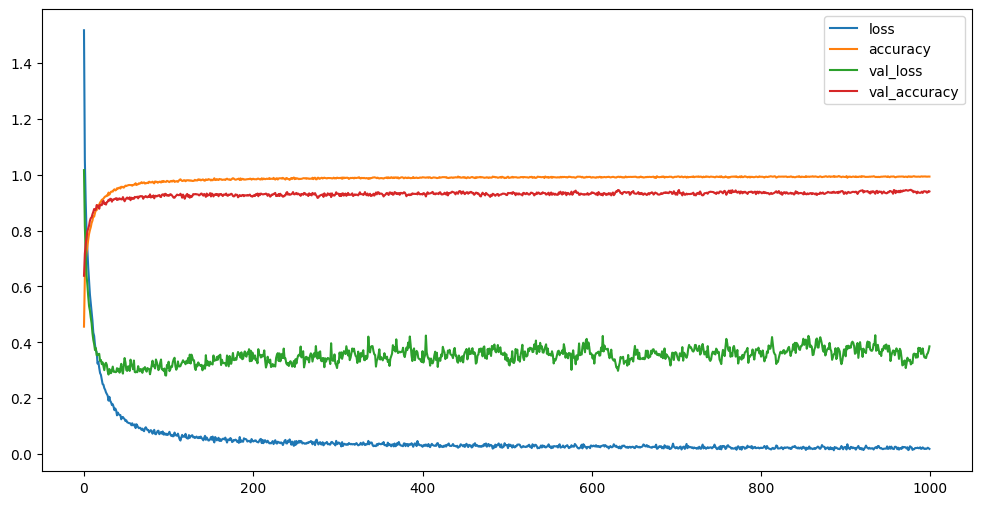

In [34]:
# Plotting results
plotData(test_fit)